In [2]:
import numpy as np
from numpy import linalg
import matplotlib.pyplot as plt
from scipy import signal
from scipy.io import wavfile
from sklearn.decomposition import FastICA, PCA
from typing import Tuple
import os
import glob
from IPython.display import Audio, display

In [3]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

In [4]:
%matplotlib inline

In [5]:
# create convenience function for plotting and playing audio
def show_audio(a: Tuple[int, np.ndarray])->None: # a: (sample_rate, audio_array)
    fig, ax = plt.subplots()
    time_axis = np.linspace(start=0, stop=(len(a[1])/a[0]),num=np.round(len(a[1])))
    ax.plot(time_axis, a[1])
    ax.set_xlabel('Time (seconds)')
    ax.set_ylabel('Amplitude')
    display(Audio(a[1], rate=a[0]))

In [6]:
# collect all the wav files
files = glob.glob('./data/mixed_data/*.wav')

In [7]:
samp_rates = []
sound_list = []

In [8]:
# collect sampling frequencies and audio signals
for f in files:
    samp_rate, sound = wavfile.read(f)
    samp_rates.append(samp_rate)
    sound_list.append(sound)

In [9]:
# store as numpy array
audio_array = np.array(sound_list)

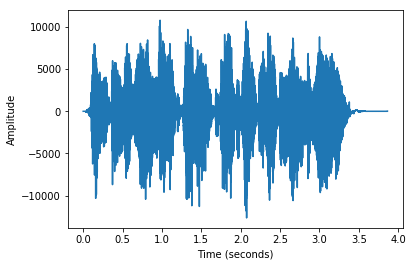

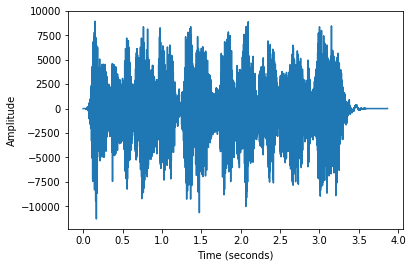

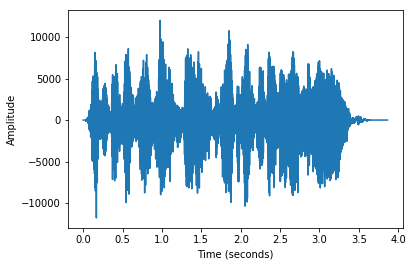

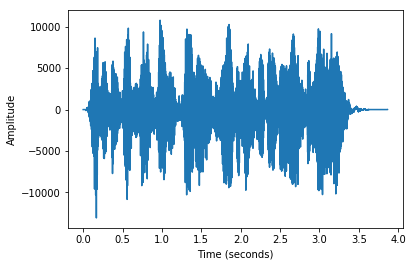

In [73]:
# listen and visualize sound waves as sanity check
for a in zip(samp_rates, sound_list):
    show_audio(a)
#     fig, ax = plt.subplots()
#     ax.plot(a[1])
#     Audio(a[1], rate=a[0])

In [10]:
ica = FastICA(n_components=4)

In [11]:
S_ = ica.fit_transform(audio_array.T)

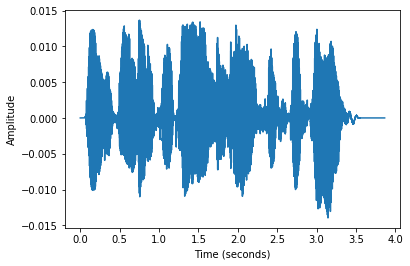

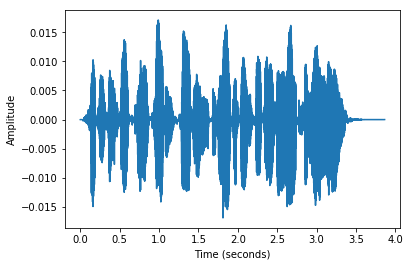

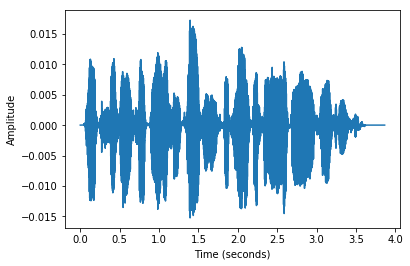

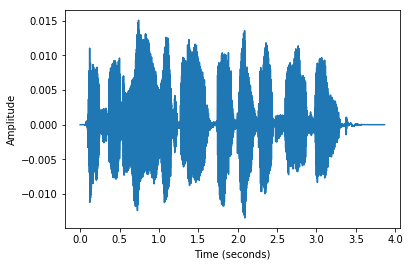

In [12]:
for row in S_.T:
    show_audio((samp_rate, row))

In [46]:
# Whiten data manually
X = audio_array
n, p = X.shape
n_components=min(n,p)
X_mean = X.mean(axis=-1)
X -= X_mean[:, np.newaxis]

# Whitening and preprocessing by PCA
u, d, _ = linalg.svd(X, full_matrices=False)

del _
K = (u / d).T[:n_components]  # see (6.33) p.140
del u, d
X1 = np.dot(K, X)
# see (13.6) p.267 Here X1 is white and data
# in X has been projected onto a subspace by PCA
X1 *= np.sqrt(p)

In [20]:
# test manual whitening
ica2 = FastICA(whiten=False)

In [21]:
S_2 = ica2.fit_transform(X1.T)

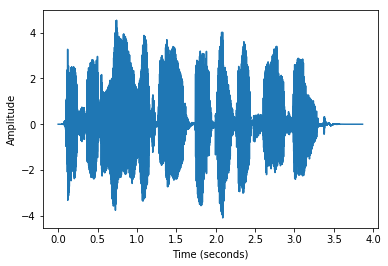

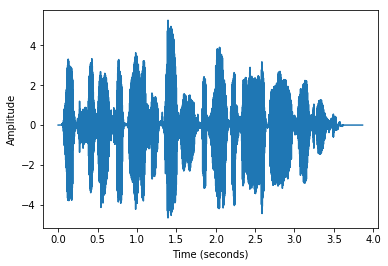

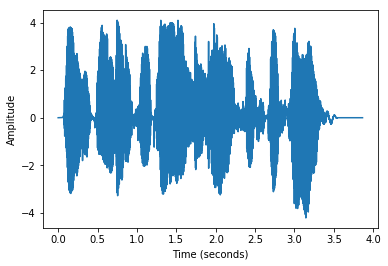

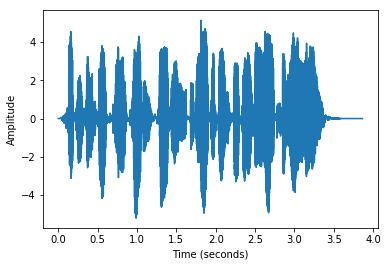

In [22]:
for row in S_2.T:
    show_audio((samp_rate, row))

In [31]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "last_expr"

In [32]:
import torch
import torch.utils.data as utils

In [60]:
X1 = torch.tensor(X1,dtype=torch.float)

In [61]:
X1 = X1[:,torch.randperm(X1.shape[1], dtype=torch.long)]

In [62]:
W = torch.eye(4,4, requires_grad=True, dtype=torch.float)

In [63]:
audio_dataset = utils.TensorDataset(torch.transpose(X1, 0, 1))
audio_dataloader = utils.DataLoader(audio_dataset, shuffle=False)

In [64]:
lr = 0.01

In [65]:
def sigmoid_der(Y: torch.Tensor)->torch.Tensor:
    a = torch.sigmoid(Y)
    b = 1 - torch.sigmoid(Y)
    return a*b

In [66]:
optimizer = torch.optim.SGD([W], lr=lr)

In [67]:
def _sym_decorrelation(W):
    """ Symmetric decorrelation
    i.e. W <- (W * W.T) ^{-1/2} * W
    """
    s, u = linalg.eigh(np.dot(W, W.T))
    # u (resp. s) contains the eigenvectors (resp. square roots of
    # the eigenvalues) of W * W.T
    return np.dot(np.dot(u * (1. / np.sqrt(s)), u.T), W)

In [68]:
prev_loss = 0
tol_count = 0

In [69]:
for t in range(1):
    for idx, x_t in enumerate(audio_dataloader):
        x_t = x_t[0]
        x_t = torch.transpose(x_t, 0, 1)
         # forward pass
        Y_pred = torch.mm(W, x_t)
        # compute loss
        # todo: try computing loss by loading time stamps in as training examples in shuffled order instead of whole matrix at once
        log_likelihood = torch.sum(torch.log(sigmoid_der(Y_pred))) + torch.log(torch.abs(torch.det(W)))
        loss = -log_likelihood
        print(t, loss)

        if torch.isnan(loss).any() or loss.item() == np.inf or loss.item() == -np.inf:
            print('Gradient vanished/exploded')
            raise Exception('Ded')
            break

        prev_loss = loss
        # compute gradient for gradient descent
        loss.backward()
        #print(W.grad)
        print(t, W.grad)
        # recompute W in 'descent' step of gradient descent
        optimizer.step()
        optimizer.zero_grad()
    
    # consider writing this in torch itself instead of messing with numpy? shouldn't make a difference.
    # alternatively, add a penalty to the loss for how far from orthogonal W is instead of forcing projection
#         with torch.no_grad():
#             W = W.detach().numpy()
#             W = _sym_decorrelation(W)
#             W = torch.tensor(W, requires_grad=True)
    # check for convergence
    if loss >= prev_loss - 0.0001:
        tol_count += 1
    if tol_count >= 3:
        break

0 tensor(6.1901)
0 tensor([[-0.8762,  0.1389,  0.1513,  0.3267],
        [ 0.1382, -0.8451,  0.1687,  0.3644],
        [ 0.1497,  0.1679, -0.8171,  0.3950],
        [ 0.2919,  0.3274,  0.3565, -0.2299]])
0 tensor(5.7809)
0 tensor([[-0.9874,  0.0059, -0.0468, -0.0118],
        [ 0.0058, -0.9784, -0.0841, -0.0194],
        [-0.0424, -0.0768, -0.5246,  0.0881],
        [-0.0117, -0.0192,  0.0931, -0.9787]])
0 tensor(6.3822)
0 tensor([[-0.6943, -0.1046, -0.4488,  0.4615],
        [-0.1111, -0.9427,  0.1699, -0.1801],
        [-0.4217,  0.1503, -0.3316, -0.6837],
        [ 0.4285, -0.1584, -0.6768, -0.2912]])
0 tensor(5.4644)
0 tensor([[-0.9751, -0.0003,  0.0031, -0.0068],
        [-0.0004, -0.9728, -0.0012, -0.0007],
        [ 0.0034, -0.0014, -0.9794,  0.0050],
        [-0.0074, -0.0009,  0.0047, -0.9834]])
0 tensor(6.3518)
0 tensor([[-0.0221,  0.2829, -0.3283,  0.6791],
        [ 0.3315, -0.8644, -0.1187,  0.2398],
        [-0.3756, -0.1160, -0.8412, -0.2731],
        [ 0.7230,  0.2175, 

0 tensor(4.3448)
0 tensor([[-0.7133, -0.0127, -0.0512,  0.0339],
        [-0.0084, -0.7198, -0.0238,  0.0171],
        [-0.0268, -0.0214, -0.6724,  0.0104],
        [ 0.0155,  0.0144, -0.0078, -0.7195]])
0 tensor(4.2777)
0 tensor([[-0.7134, -0.0175, -0.0294,  0.0334],
        [-0.0132, -0.7211, -0.0047,  0.0138],
        [-0.0058, -0.0024, -0.7343,  0.0268],
        [ 0.0158,  0.0118,  0.0071, -0.7099]])
0 tensor(7.0307)
0 tensor([[ 1.2342, -0.0888, -1.3968,  0.3738],
        [-0.2129, -0.7118,  0.1366, -0.0260],
        [-1.7028,  0.0599,  0.4639, -0.2715],
        [ 0.5684, -0.0125, -0.3812, -0.6190]])
0 tensor(6.5140)
0 tensor([[-0.3563,  0.4126,  0.6660,  0.6454],
        [ 0.4020, -0.2219,  0.7761,  0.7226],
        [ 0.5715,  0.6672,  0.3178,  1.0013],
        [ 0.5725,  0.6784,  1.0750,  0.2543]])
0 tensor(5.8001)
0 tensor([[-0.5494, -0.4076,  0.1823,  0.4530],
        [-0.3391,  0.0168, -0.3855, -0.8162],
        [ 0.1895, -0.4279, -0.5183,  0.5062],
        [ 0.3504, -0.7885, 

0 tensor([[-0.5484,  0.0358, -0.0310, -0.0376],
        [ 0.0458, -0.5340, -0.0402, -0.0479],
        [ 0.0035, -0.0328, -0.6271,  0.0416],
        [-0.0472, -0.0635,  0.0229, -0.5844]])
0 tensor(3.6169)
0 tensor([[-0.5793, -0.0088,  0.0122, -0.0062],
        [ 0.0009, -0.5930,  0.0154, -0.0054],
        [ 0.0402,  0.0198, -0.5734,  0.0179],
        [-0.0147, -0.0190, -0.0006, -0.6106]])
0 tensor(7.5676)
0 tensor([[-0.3836,  0.3181,  1.0243,  0.5553],
        [ 0.2479, -0.1743,  1.3059,  0.7095],
        [ 0.4672,  0.7412,  1.6579,  1.2724],
        [ 0.3587,  0.6100,  1.9531,  0.4572]])
0 tensor(6.4019)
0 tensor([[ 1.0721,  0.5933,  1.0440, -0.2554],
        [ 0.8531, -0.2805,  0.5377, -0.1360],
        [ 1.2756,  0.4565,  0.1489, -0.1766],
        [-0.4211, -0.1705, -0.2638, -0.5493]])
0 tensor(7.6532)
0 tensor([[ 0.8361,  1.9368,  0.5700, -0.2649],
        [ 1.5212,  1.5081,  0.6166, -0.2857],
        [ 0.7125,  0.9472, -0.3643, -0.1140],
        [-0.4314, -0.5936, -0.1762, -0.5320]

0 tensor([[-0.5589, -0.0059, -0.0034, -0.0124],
        [ 0.0060, -0.5758, -0.0099,  0.0211],
        [ 0.0380, -0.0086, -0.6109,  0.0102],
        [-0.0323,  0.0002,  0.0154, -0.5668]])
0 tensor(6.8513)
0 tensor([[-0.3044, -1.0615, -0.3333, -0.1845],
        [-0.5467,  1.7315,  0.7093,  0.3954],
        [-0.2634,  1.2464, -0.2179,  0.2129],
        [-0.2658,  0.9725,  0.3174, -0.4087]])
0 tensor(9.1038)
0 tensor([[ 1.5162, -0.6218, -0.1979, -2.1732],
        [-1.0731, -0.2577,  0.0870,  1.1459],
        [-0.3954,  0.1174, -0.5683,  0.4598],
        [-2.1068,  0.6161,  0.2080,  1.5981]])
0 tensor(3.8877)
0 tensor([[-0.3793,  0.0153, -0.1069, -0.2578],
        [ 0.0319, -0.5774, -0.0271, -0.0137],
        [-0.0651, -0.0217, -0.5466,  0.1513],
        [-0.2594, -0.0267,  0.1471, -0.2446]])
0 tensor(3.8224)
0 tensor([[-0.1820,  0.1389, -0.0929, -0.1334],
        [ 0.1630, -0.5210, -0.0517, -0.0367],
        [-0.0618, -0.0496, -0.5806,  0.0401],
        [-0.1642, -0.0575,  0.0446, -0.5218]

0 tensor([[ 0.0829, -0.0876, -0.8671,  0.5942],
        [-0.1332, -0.5342,  0.1714, -0.1162],
        [-0.7676,  0.0905,  0.4219, -0.6653],
        [ 0.5649, -0.0808, -0.7129, -0.0038]])
0 tensor(9.6410)
0 tensor([[ 0.4385, -1.1294, -0.8445,  2.1084],
        [-1.1852,  0.7661,  0.9550, -2.4810],
        [-0.8410,  0.9525,  0.1142, -1.7473],
        [ 1.2761, -1.4656, -1.0034,  2.1987]])
0 tensor(4.2428)
0 tensor([[-0.3179,  0.1956,  0.1619,  0.3060],
        [ 0.2277, -0.3717,  0.1654,  0.2903],
        [ 0.2522,  0.1796, -0.4061,  0.3478],
        [ 0.2994,  0.2727,  0.3185, -0.1332]])
0 tensor(3.2506)
0 tensor([[-0.5709, -0.0090, -0.0305, -0.0124],
        [ 0.0044, -0.5493, -0.0032,  0.0111],
        [ 0.0224, -0.0048, -0.5776,  0.0600],
        [-0.0451, -0.0042,  0.0575, -0.5624]])
0 tensor(8.0623)
0 tensor([[ 2.4888, -0.1804, -0.9779,  0.1923],
        [-0.5858, -0.5146,  0.1797, -0.0284],
        [-2.2878,  0.1248,  0.1402, -0.0951],
        [ 0.0148, -0.0075,  0.0385, -0.5565]

0 tensor(4.7968)
0 tensor([[ 0.2001,  0.4227,  0.6679,  0.0061],
        [ 0.5066, -0.2415,  0.4828,  0.0110],
        [ 0.7187,  0.4225,  0.0951,  0.0041],
        [ 0.0982,  0.0629,  0.1158, -0.5317]])
0 tensor(5.6404)
0 tensor([[-0.2792, -0.1416, -0.7432,  0.5044],
        [-0.1606, -0.4781,  0.4008, -0.2303],
        [-0.5307,  0.2155,  0.7670, -0.8573],
        [ 0.4374, -0.1687, -1.0575,  0.1965]])
0 tensor(3.1447)
0 tensor([[-0.5663, -0.0295, -0.0394,  0.0341],
        [-0.0003, -0.5363,  0.0157,  0.0331],
        [ 0.0166,  0.0079, -0.5529,  0.0381],
        [-0.0057,  0.0060,  0.0281, -0.5189]])
0 tensor(6.2177)
0 tensor([[-0.5302,  0.1837, -0.2879,  0.1006],
        [ 0.1933,  0.6641, -1.3772,  0.4127],
        [-0.1862, -1.2413,  0.8888, -0.3656],
        [ 0.0822,  0.5563, -0.6198, -0.3488]])
0 tensor(3.1240)
0 tensor([[-0.5630, -0.0302, -0.0396,  0.0321],
        [-0.0015, -0.5382,  0.0172,  0.0281],
        [ 0.0166,  0.0099, -0.5579,  0.0344],
        [-0.0077,  0.0012, 

0 tensor([[-0.5341, -0.0299, -0.1439,  0.0599],
        [ 0.0001, -0.5279, -0.0274,  0.0367],
        [-0.0836, -0.0394, -0.2874,  0.0024],
        [-0.0019,  0.0040,  0.0072, -0.5044]])
0 tensor(3.0400)
0 tensor([[-0.5674, -0.0493, -0.0566,  0.0381],
        [-0.0165, -0.5358,  0.0141,  0.0262],
        [ 0.0145,  0.0156, -0.5282,  0.0623],
        [-0.0192, -0.0057,  0.0495, -0.5137]])
0 tensor(3.0564)
0 tensor([[-0.5626, -0.0435, -0.0621,  0.0403],
        [-0.0100, -0.5224,  0.0014,  0.0313],
        [ 0.0074,  0.0019, -0.5122,  0.0558],
        [-0.0164, -0.0004,  0.0434, -0.5099]])
0 tensor(4.8951)
0 tensor([[-0.4890,  0.0734, -0.3469,  0.2247],
        [ 0.1242, -0.3035, -0.5327,  0.3773],
        [-0.2615, -0.4360,  0.5511, -0.6306],
        [ 0.1853,  0.3286, -0.7487,  0.0017]])
0 tensor(3.4941)
0 tensor([[-0.5442, -0.0294, -0.1310,  0.0126],
        [ 0.0019, -0.5123, -0.0623, -0.0002],
        [-0.0676, -0.0729, -0.1710,  0.1785],
        [-0.0584, -0.0486,  0.2143, -0.4583]

0 tensor(4.3441)
0 tensor([[-0.4439, -0.3126, -0.2165,  0.0106],
        [-0.2906,  0.2840,  0.4662,  0.0743],
        [-0.1922,  0.5739, -0.1825,  0.0869],
        [-0.1053,  0.1526,  0.1265, -0.5005]])
0 tensor(5.9152)
0 tensor([[-0.4127,  0.3047,  0.6542, -0.4667],
        [ 0.2335, -0.0744,  0.9512, -0.6564],
        [ 0.3278,  0.6439,  0.8650, -0.9305],
        [-0.2713, -0.5232, -1.0723,  0.2729]])
0 tensor(7.9696)
0 tensor([[ 1.5266,  0.5532,  1.0272, -1.4658],
        [ 1.0806, -0.2304,  0.5280, -0.7253],
        [ 1.4682,  0.3952,  0.2156, -0.9724],
        [-1.8752, -0.5165, -0.9134,  0.8075]])
0 tensor(3.7259)
0 tensor([[-0.4799,  0.0759, -0.1998,  0.1646],
        [ 0.1407, -0.3863, -0.2187,  0.2046],
        [-0.1464, -0.2033, -0.2010, -0.2123],
        [ 0.1143,  0.1593, -0.2360, -0.2855]])
0 tensor(2.9912)
0 tensor([[-0.5619, -0.0211, -0.0473,  0.0355],
        [ 0.0270, -0.5165, -0.0121,  0.0295],
        [ 0.0305,  0.0016, -0.5212,  0.0596],
        [-0.0337, -0.0122, 

0 tensor(5.7348)
0 tensor([[ 0.0543,  0.1541, -1.0208,  0.5028],
        [ 0.2272, -0.4525, -0.3471,  0.1722],
        [-0.8244, -0.2595,  0.8829, -0.6845],
        [ 0.4913,  0.1262, -0.9256, -0.0338]])
0 tensor(2.9638)
0 tensor([[-0.5200, -0.0170, -0.0653,  0.0180],
        [ 0.0337, -0.5086, -0.0259,  0.0091],
        [ 0.0030, -0.0134, -0.4869,  0.0086],
        [-0.0488, -0.0342, -0.0298, -0.4852]])
0 tensor(3.8433)
0 tensor([[-0.5224,  0.0210, -0.0124,  0.0405],
        [ 0.0714, -0.1584,  0.3025,  0.2951],
        [ 0.0611,  0.3204, -0.2175,  0.3057],
        [-0.0222,  0.3091,  0.3160, -0.2145]])
0 tensor(4.1094)
0 tensor([[-0.5207,  0.0462, -0.1190, -0.0024],
        [ 0.0697,  0.0090, -0.5630, -0.0678],
        [-0.0166, -0.5393,  0.0351,  0.1091],
        [-0.0711, -0.1607,  0.1207, -0.4838]])
0 tensor(3.2422)
0 tensor([[-0.4576, -0.0290, -0.1785, -0.0331],
        [ 0.0239, -0.5066, -0.0078,  0.0097],
        [-0.1043,  0.0114, -0.2735,  0.1105],
        [-0.1126, -0.0314, 

0 tensor(5.8777)
0 tensor([[-0.4948,  0.0269,  0.0085,  0.1270],
        [ 0.1209,  0.1034,  0.6858,  0.9230],
        [ 0.1277,  0.6870,  0.2659,  1.0348],
        [ 0.0768,  0.8157,  0.9445,  0.7505]])
0 tensor(3.3804)
0 tensor([[-0.4339,  0.0168,  0.0865,  0.1207],
        [ 0.0690, -0.4838,  0.0735,  0.0734],
        [ 0.1540,  0.1012, -0.2283,  0.1997],
        [ 0.0543,  0.0454,  0.2092, -0.3540]])
0 tensor(5.0144)
0 tensor([[-0.4823,  0.1214,  0.2620, -0.0421],
        [ 0.0841, -0.0571,  0.9170, -0.1839],
        [ 0.1067,  0.6662,  0.8531, -0.2678],
        [-0.0732, -0.2044, -0.3578, -0.4231]])
0 tensor(5.9592)
0 tensor([[-0.4354,  0.1850, -0.3798,  0.1905],
        [ 0.2587,  0.2788, -1.1193,  0.5869],
        [-0.2590, -0.9714,  0.8055, -0.6594],
        [ 0.1406,  0.6193, -0.9394, -0.0202]])
0 tensor(3.2805)
0 tensor([[-0.4690, -0.0889, -0.1337,  0.0743],
        [-0.0468, -0.4073,  0.1326, -0.0888],
        [-0.0686,  0.1347, -0.3281, -0.1037],
        [ 0.0072, -0.1360, 

0 tensor(8.7426)
0 tensor([[-0.1296,  0.7066,  0.6229,  1.3037],
        [ 0.5425,  0.5875,  0.9722,  1.8346],
        [ 0.5620,  1.0818,  0.4232,  1.8266],
        [ 0.6160,  1.3363,  1.2224,  1.8469]])
0 tensor(7.0694)
0 tensor([[ 1.2408,  0.2044, -1.4220,  0.5720],
        [ 0.0284, -0.5102, -0.0149,  0.0056],
        [-1.6502, -0.2472,  0.8112, -0.4900],
        [ 0.9712,  0.0848, -0.8368, -0.1723]])
0 tensor(2.8465)
0 tensor([[-0.4913, -0.0523, -0.0498,  0.0382],
        [ 0.0205, -0.5100, -0.0085,  0.0032],
        [ 0.0560,  0.0057, -0.5380,  0.0355],
        [-0.0508, -0.0664, -0.0276, -0.4858]])
0 tensor(2.8360)
0 tensor([[-0.4900, -0.0521, -0.0497,  0.0381],
        [ 0.0206, -0.5086, -0.0085,  0.0034],
        [ 0.0558,  0.0057, -0.5365,  0.0354],
        [-0.0506, -0.0661, -0.0275, -0.4846]])
0 tensor(8.1919)
0 tensor([[ 0.6144, -2.0297, -0.4584,  0.3791],
        [-1.3088,  1.8761,  0.4842, -0.4074],
        [-0.6243,  1.2248, -0.2829, -0.1749],
        [ 0.5303, -1.1070, 

0 tensor(6.3148)
0 tensor([[ 0.3128, -1.2246, -0.2942,  0.5454],
        [-1.0285,  1.0315,  0.2725, -0.6354],
        [-0.3306,  0.5576, -0.4136, -0.1877],
        [ 0.6378, -1.0545, -0.2213, -0.0665]])
0 tensor(7.3749)
0 tensor([[-0.4519, -0.2755,  0.8610, -0.5689],
        [-0.0005, -0.2908, -0.9816,  0.6571],
        [ 0.1656, -0.5277,  1.5828, -1.3492],
        [-0.1354,  0.3844, -1.8549,  0.7317]])
0 tensor(2.8789)
0 tensor([[-0.4952, -0.0491, -0.0668,  0.0503],
        [ 0.0452, -0.5210, -0.0279,  0.0223],
        [ 0.0634, -0.0119, -0.5276,  0.0609],
        [-0.0467, -0.0601, -0.0237, -0.4857]])
0 tensor(3.6582)
0 tensor([[-0.0275,  0.3190, -0.0242, -0.0826],
        [ 0.3692, -0.2640,  0.0016, -0.0703],
        [ 0.0226, -0.0442, -0.5303,  0.0712],
        [-0.1294, -0.1260, -0.0325, -0.4631]])
0 tensor(7.1490)
0 tensor([[-0.0751, -1.1405,  0.0167,  0.5504],
        [-0.7614,  1.5779, -0.1883, -0.9403],
        [ 0.1911, -0.3459, -0.4995,  0.2127],
        [ 0.5773, -1.6850, 

0 tensor([[-0.3783,  0.0598, -0.3591,  0.1300],
        [ 0.1838, -0.3705, -0.3546,  0.0841],
        [-0.2188, -0.3091,  0.1770, -0.0513],
        [ 0.0137, -0.0242, -0.1250, -0.4795]])
0 tensor(3.4680)
0 tensor([[-0.2136, -0.0595, -0.3498,  0.0267],
        [ 0.0312, -0.5087, -0.0032,  0.0327],
        [-0.2488, -0.0067, -0.2245,  0.1319],
        [-0.0916, -0.0630,  0.0352, -0.4801]])
0 tensor(6.5608)
0 tensor([[ 1.4781, -0.9081,  0.3979, -0.2855],
        [-1.5640,  0.1946, -0.4209,  0.3322],
        [ 0.4687, -0.1883, -0.4241, -0.0103],
        [-0.1901,  0.0083, -0.0712, -0.4618]])
0 tensor(3.9408)
0 tensor([[-0.3295, -0.2717,  0.2485, -0.1183],
        [-0.1342, -0.2471, -0.4191,  0.2678],
        [ 0.3029, -0.3455, -0.0142, -0.2416],
        [-0.1526,  0.1150, -0.3025, -0.3272]])
0 tensor(9.1446)
0 tensor([[ 1.4606,  1.5372,  0.5054, -1.6143],
        [ 1.8637,  0.9662,  0.5293, -1.5500],
        [ 0.4618,  0.3175, -0.4008, -0.2833],
        [-1.7141, -1.4425, -0.5438,  0.9833]

0 tensor(5.2395)
0 tensor([[-0.2948,  0.3959,  0.4930,  0.4964],
        [ 0.2963, -0.0212,  0.6499,  0.4559],
        [ 0.3634,  0.6297,  0.2530,  0.5859],
        [ 0.3190,  0.5755,  0.8057,  0.0814]])
0 tensor(6.8376)
0 tensor([[ 0.1512, -1.4512, -0.0518,  0.3469],
        [-0.9666,  1.6271, -0.0470, -0.3533],
        [-0.0855,  0.3423, -0.5371, -0.0004],
        [ 0.4163, -0.9627, -0.0206, -0.3379]])
0 tensor(5.1706)
0 tensor([[-0.5065, -0.1202, -0.0738,  0.1113],
        [-0.1313,  1.1243, -0.3291, -0.2253],
        [ 0.1218, -0.4658, -0.4263,  0.1294],
        [ 0.0407, -0.4708,  0.0369, -0.4319]])
0 tensor(5.0304)
0 tensor([[-0.2345, -0.6161, -0.0732, -0.3599],
        [-0.4346,  0.4776, -0.0153,  0.8385],
        [ 0.0714,  0.0132, -0.5257,  0.0444],
        [-0.4720,  0.8700, -0.0680,  0.2827]])
0 tensor(3.3159)
0 tensor([[-0.5149, -0.0427, -0.0551,  0.0908],
        [ 0.0518, -0.5025,  0.1125, -0.0106],
        [ 0.0402,  0.0934, -0.1848, -0.0555],
        [ 0.0026, -0.0965, 

0 tensor(3.0010)
0 tensor([[-0.5159, -0.0742, -0.0763,  0.1004],
        [ 0.0624, -0.5458,  0.0338,  0.0520],
        [ 0.0574,  0.0382, -0.5358,  0.0402],
        [-0.0183, -0.0666, -0.0671, -0.4876]])
0 tensor(8.1280)
0 tensor([[-0.3364,  0.4536, -0.9490,  0.3065],
        [ 0.4908,  0.7252, -2.0671,  0.5490],
        [-0.4618, -1.4999,  2.0108, -0.5620],
        [ 0.2709,  0.7905, -1.4851, -0.1508]])
0 tensor(5.2177)
0 tensor([[-0.1584,  0.5701,  0.2514,  0.6154],
        [ 0.4580,  0.1747,  0.4035,  0.6280],
        [ 0.2544,  0.3987, -0.3613,  0.3262],
        [ 0.4736,  0.8271,  0.3878,  0.2308]])
0 tensor(9.2972)
0 tensor([[-0.1002, -1.2549, -0.7245, -0.2647],
        [-0.8384,  2.0179,  1.4476,  0.8369],
        [-0.7527,  2.3667,  0.7385,  0.7568],
        [-0.7478,  2.0094,  1.0772,  0.1530]])
0 tensor(3.6832)
0 tensor([[-0.5126, -0.0763, -0.0700,  0.0935],
        [ 0.0724, -0.5191, -0.0406,  0.1204],
        [ 0.0253, -0.1020, -0.2496, -0.2807],
        [ 0.0184,  0.0716, 

0 tensor([[-0.4942, -0.0201,  0.0144,  0.1553],
        [ 0.1157, -0.4564,  0.1611,  0.2193],
        [ 0.1160,  0.1944, -0.1399,  0.4423],
        [ 0.0034,  0.1771,  0.4531, -0.0167]])
0 tensor(6.5312)
0 tensor([[ 0.5650, -0.2078,  0.6843,  1.2516],
        [-0.4895, -0.4528, -0.4266, -0.5866],
        [ 0.7092, -0.0746, -0.0809,  0.7794],
        [ 1.1748, -0.2284,  0.8102,  0.8632]])
0 tensor(14.9830)
0 tensor([[ 3.3155,  1.0585,  2.0189, -2.6547],
        [ 2.6178,  0.2069,  1.3767, -1.7327],
        [ 3.5561,  1.0341,  1.3799, -2.4095],
        [-3.6805, -1.1219, -2.0583,  2.0861]])
0 tensor(3.9460)
0 tensor([[-0.4964, -0.1453, -0.0298,  0.0801],
        [-0.0059,  0.0044, -0.4428,  0.0885],
        [ 0.1544, -0.4457, -0.1702,  0.0615],
        [-0.0565, -0.0387, -0.0770, -0.5010]])
0 tensor(3.2889)
0 tensor([[-0.3294,  0.0180,  0.0361,  0.0987],
        [ 0.1483, -0.5064,  0.0288,  0.0699],
        [ 0.1450,  0.0478, -0.4825,  0.0873],
        [ 0.0136, -0.0240, -0.0157, -0.4946

0 tensor([[ 0.2908, -0.5188, -0.7081,  0.7768],
        [-0.7532, -0.0528,  0.6811, -0.7264],
        [-0.9683,  0.6018,  0.2874, -0.8876],
        [ 0.8198, -0.5734, -0.8025,  0.2340]])
0 tensor(6.1741)
0 tensor([[ 1.2840, -0.5868, -0.5811, -0.3280],
        [-1.0122, -0.2189,  0.3114,  0.3070],
        [-1.0871,  0.3446, -0.2079,  0.3111],
        [-0.6618,  0.1025,  0.0506, -0.4206]])
0 tensor(3.4364)
0 tensor([[-0.3034, -0.1075, -0.1678,  0.1387],
        [ 0.0301, -0.5283,  0.0349,  0.0249],
        [-0.0735,  0.0370, -0.4662, -0.0018],
        [ 0.0349, -0.0933, -0.1534, -0.5196]])
0 tensor(3.1145)
0 tensor([[-0.5010, -0.0652, -0.0857,  0.0644],
        [ 0.1190, -0.5456, -0.0018,  0.0581],
        [ 0.0788,  0.0048, -0.5273,  0.0551],
        [-0.0533, -0.0743, -0.1165, -0.5508]])
0 tensor(3.5319)
0 tensor([[-0.4819, -0.0653, -0.1528,  0.0566],
        [ 0.1182, -0.5439, -0.0005,  0.0580],
        [-0.0286,  0.0059, -0.1198,  0.1010],
        [-0.0768, -0.0738, -0.0267, -0.5389]

0 tensor([[ 0.6077, -0.3429, -0.1449, -0.2333],
        [-0.4238, -0.3986,  0.0369,  0.2013],
        [-0.2399,  0.1025, -0.5067,  0.1613],
        [-0.3389, -0.0102, -0.1103, -0.4639]])
0 tensor(3.8415)
0 tensor([[-0.1406,  0.2393, -0.2430,  0.2114],
        [ 0.3328, -0.3486, -0.0800,  0.1252],
        [-0.1943, -0.1893, -0.4121, -0.0163],
        [ 0.1301,  0.0591, -0.1954, -0.4863]])
0 tensor(3.5288)
0 tensor([[-0.4317, -0.1861, -0.0870,  0.1175],
        [-0.0932, -0.1564, -0.0037, -0.0581],
        [ 0.0431,  0.0619, -0.5195,  0.0651],
        [ 0.0051, -0.1703, -0.1195, -0.5219]])
0 tensor(3.2498)
0 tensor([[-0.4974, -0.0662, -0.0907,  0.0818],
        [ 0.0888, -0.3656, -0.0421,  0.0953],
        [ 0.0726, -0.0443, -0.4936,  0.0543],
        [-0.0500, -0.0274, -0.1411, -0.5275]])
0 tensor(5.9743)
0 tensor([[-0.0643, -0.2663,  1.1010, -0.5453],
        [-0.0214, -0.4672, -0.3578,  0.2417],
        [ 0.6494, -0.2499,  1.1049, -0.7781],
        [-0.3375,  0.0549, -0.9385, -0.1126]

0 tensor(5.3324)
0 tensor([[-0.3785,  0.2463,  0.1705,  0.5878],
        [ 0.2974, -0.1256,  0.3820,  0.7353],
        [ 0.1837,  0.3165, -0.3100,  0.5248],
        [ 0.2820,  0.7052,  0.5362,  0.7434]])
0 tensor(3.1471)
0 tensor([[-0.5111, -0.0711, -0.0921,  0.0749],
        [ 0.1135, -0.5585,  0.0218,  0.0335],
        [ 0.0706,  0.0483, -0.5302,  0.0920],
        [-0.0524, -0.0871, -0.1198, -0.5342]])
0 tensor(5.2980)
0 tensor([[-0.3728, -0.0103, -0.5521,  0.1604],
        [ 0.1217, -0.5529, -0.0076,  0.0390],
        [-0.4141, -0.1668,  1.1011, -0.2115],
        [-0.0266, -0.0753, -0.2058, -0.5165]])
0 tensor(4.0364)
0 tensor([[-0.4387,  0.0929,  0.2110, -0.1090],
        [ 0.1867, -0.3802,  0.3438, -0.1620],
        [ 0.1868,  0.3176, -0.0361, -0.2086],
        [-0.0943, -0.1856, -0.3018, -0.4199]])
0 tensor(10.6527)
0 tensor([[ 1.3719,  1.7700, -0.2645,  2.3403],
        [ 1.6748,  0.9780, -0.1231,  1.9185],
        [-1.4183, -1.4130, -0.3942, -1.7036],
        [ 1.8998,  1.8268,

0 tensor(4.0689)
0 tensor([[-0.4071, -0.2848, -0.0799,  0.1266],
        [-0.2633,  0.3222, -0.0250, -0.1724],
        [ 0.0687,  0.0650, -0.5021,  0.0795],
        [ 0.0342, -0.2680, -0.1257, -0.4716]])
0 tensor(3.1343)
0 tensor([[-0.5007, -0.0773, -0.0811,  0.0706],
        [ 0.1208, -0.5224,  0.0143,  0.0572],
        [ 0.0729,  0.0298, -0.3711,  0.0963],
        [-0.0560, -0.0755, -0.1012, -0.5204]])
0 tensor(9.5186)
0 tensor([[-0.4994, -0.0775, -0.0313,  0.1136],
        [ 0.1338, -0.5263, -0.8210, -0.6014],
        [ 0.0551,  0.0256,  2.1720,  2.2355],
        [-0.0885, -0.0670,  2.5804,  1.6555]])
0 tensor(4.1313)
0 tensor([[-0.4946, -0.0727, -0.0286,  0.1203],
        [ 0.1201, -0.5250, -0.0435,  0.0186],
        [ 0.1169,  0.0605,  0.0293,  0.5610],
        [-0.0198, -0.0210,  0.5198,  0.0602]])
0 tensor(4.2080)
0 tensor([[-0.4484,  0.1758, -0.1097, -0.3064],
        [ 0.1980, -0.1144, -0.0390, -0.5449],
        [ 0.1025,  0.0765, -0.5103, -0.0052],
        [-0.1348, -0.5205, 

0 tensor([[-0.3096,  0.1302, -0.1305,  0.4050],
        [ 0.3228, -0.2720, -0.0708,  0.4288],
        [-0.0965, -0.2536, -0.4322, -0.3106],
        [ 0.3193,  0.3908, -0.2867,  0.1472]])
0 tensor(9.7878)
0 tensor([[ 1.6652,  0.8710, -2.3261,  1.0527],
        [ 1.1083, -0.0681, -1.0263,  0.5273],
        [-2.1881, -1.0154,  1.9162, -0.9576],
        [ 1.4293,  0.6035, -1.7001,  0.1618]])
0 tensor(9.7418)
0 tensor([[ 1.9782,  1.0660,  1.7164,  0.7472],
        [ 1.2627,  0.0284,  0.8162,  0.3926],
        [ 2.1238,  0.9709,  0.8853,  0.6572],
        [ 2.0948,  0.9508,  1.3912,  0.0796]])
0 tensor(7.3014)
0 tensor([[-0.4707,  0.0508, -0.2102,  0.1744],
        [ 0.4553,  0.8778, -1.2512,  1.0845],
        [-0.2148, -1.4603,  0.8274, -0.9785],
        [ 0.2303,  1.1433, -1.2436,  0.3641]])
0 tensor(3.0863)
0 tensor([[-0.5074, -0.1129, -0.0640,  0.0563],
        [ 0.1204, -0.5116,  0.0061,  0.0727],
        [ 0.1391,  0.0396, -0.5176,  0.1062],
        [-0.0589, -0.0711, -0.1489, -0.5151]

0 tensor(6.9522)
0 tensor([[-0.6902,  0.1204,  0.3668, -0.2436],
        [-0.5058,  0.3479,  1.4775, -0.9749],
        [-0.6137,  1.0584,  1.2345, -1.1447],
        [ 0.3781, -0.6511, -1.1576,  0.2446]])
0 tensor(9.5175)
0 tensor([[-0.5439, -0.6467,  0.6345, -0.2162],
        [ 0.2904,  1.2849, -2.3902,  1.0513],
        [ 0.0214, -1.8911,  1.9748, -0.8687],
        [ 0.0121,  1.0854, -1.6217,  0.1009]])
0 tensor(3.5896)
0 tensor([[-0.4005, -0.1414,  0.0680,  0.2100],
        [ 0.0919, -0.5218, -0.0825,  0.0073],
        [ 0.2398,  0.0155, -0.4443,  0.2493],
        [ 0.1252, -0.0845,  0.0927, -0.1949]])
0 tensor(9.7728)
0 tensor([[ 0.8696,  1.8435,  0.8721,  1.6404],
        [ 1.4665,  1.3530,  0.8715,  1.6170],
        [ 0.4274,  0.4089, -0.3523,  0.4401],
        [ 1.3749,  2.0259,  0.8389,  1.1817]])
0 tensor(7.1175)
0 tensor([[-0.2810,  0.7181, -0.5871,  0.3089],
        [ 0.6343,  1.3075, -1.1737,  0.6530],
        [-0.3054, -1.7469,  0.5902, -0.4028],
        [ 0.2011,  0.9991, 

0 tensor([[-0.4763, -0.1629,  0.1011,  0.0273],
        [ 0.1359, -0.5129, -0.0499,  0.1225],
        [ 0.1625, -0.0108, -0.0675, -0.0427],
        [-0.0630, -0.0539, -0.1889, -0.4478]])
0 tensor(2.9575)
0 tensor([[-0.4872, -0.1406, -0.0618,  0.0913],
        [ 0.1399, -0.5192,  0.0083,  0.0991],
        [ 0.1291,  0.0480, -0.5065,  0.1306],
        [-0.0585, -0.0616, -0.1307, -0.4693]])
0 tensor(10.3490)
0 tensor([[ 2.7227,  0.5068,  0.8450, -1.7780],
        [-0.3249, -0.6113, -0.1230,  0.3693],
        [ 2.1624,  0.4579,  0.0698, -1.0546],
        [-2.6563, -0.5854, -0.8648,  1.0452]])
0 tensor(4.2644)
0 tensor([[-0.3513,  0.1709, -0.3185,  0.2120],
        [ 0.3819,  0.0208, -0.4269,  0.2904],
        [-0.1600, -0.5864,  0.0094, -0.0953],
        [ 0.0744,  0.2267, -0.3623, -0.3670]])
0 tensor(7.6787)
0 tensor([[ 0.4304, -1.5795, -0.1750,  0.6475],
        [-1.4044,  1.8935,  0.1910, -0.8179],
        [-0.5117,  1.0484, -0.4291, -0.2479],
        [ 0.6135, -1.1085, -0.2070, -0.0714

0 tensor([[ 1.8086,  0.5480,  2.2970,  0.4885],
        [ 0.2146, -0.4888,  0.0877,  0.0981],
        [ 2.2629,  0.6939,  1.7451,  0.5078],
        [ 2.0365,  0.5517,  2.0709, -0.1005]])
0 tensor(4.5184)
0 tensor([[ 0.6848, -0.0905, -0.3558,  0.1213],
        [-0.3008, -0.5198,  0.1251,  0.0786],
        [-0.6233,  0.0370, -0.3313,  0.1281],
        [-0.0128, -0.0671, -0.1386, -0.4558]])
0 tensor(5.2891)
0 tensor([[-0.2257,  0.1121, -0.7010,  0.2776],
        [ 0.3632, -0.3147, -0.4525,  0.2293],
        [-0.5467, -0.5363,  1.0130, -0.3055],
        [ 0.0169,  0.0125, -0.3305, -0.3947]])
0 tensor(3.9351)
0 tensor([[-0.4625, -0.0874, -0.0575,  0.2100],
        [ 0.1878, -0.4518,  0.0719,  0.2287],
        [ 0.1198,  0.0697, -0.4887,  0.1628],
        [ 0.1061,  0.1954,  0.1177,  0.2803]])
0 tensor(4.6802)
0 tensor([[-0.4843, -0.1523, -0.1500,  0.0263],
        [ 0.1357, -0.4085,  0.2359,  0.3531],
        [ 0.0824,  0.2391, -0.0934,  0.6491],
        [-0.1320,  0.2508,  0.6019,  0.4631]

0 tensor(3.7568)
0 tensor([[-0.4727, -0.0966, -0.0429,  0.1679],
        [ 0.1565, -0.4205,  0.1669,  0.1941],
        [ 0.0953,  0.1763, -0.0840,  0.4244],
        [-0.0619,  0.1073,  0.3903, -0.0569]])
0 tensor(5.8973)
0 tensor([[ 0.2954,  0.4242, -0.1221, -1.3388],
        [ 0.6115, -0.1469,  0.0157, -0.7754],
        [ 0.2126,  0.1217, -0.4754, -0.0801],
        [-0.8249, -0.6190, -0.1210,  1.0186]])
0 tensor(2.9038)
0 tensor([[-0.4702, -0.1192, -0.1022,  0.1259],
        [ 0.1540, -0.4577,  0.0004,  0.0576],
        [ 0.1107,  0.0347, -0.4380,  0.1635],
        [-0.0340, -0.0898, -0.0699, -0.3858]])
0 tensor(5.7099)
0 tensor([[-0.1827, -0.1494, -0.3692,  0.6058],
        [-0.2371, -0.4222,  0.3922, -0.5778],
        [-0.6438,  0.1263,  0.2231, -1.1355],
        [ 0.6793, -0.1460, -0.8108,  0.7560]])
0 tensor(6.0612)
0 tensor([[ 0.1309, -0.8355, -0.2833,  0.4641],
        [-1.0525,  0.9855,  0.3896, -0.6020],
        [-0.6770,  0.9826, -0.2353, -0.3196],
        [ 0.3850, -0.5852, 

0 tensor([[-0.4306, -0.1133, -0.1870,  0.1549],
        [ 0.1625, -0.4960,  0.0477,  0.0864],
        [-0.1407, -0.0360,  0.1084, -0.1149],
        [-0.0156, -0.0640, -0.2348, -0.4235]])
0 tensor(4.1916)
0 tensor([[-0.4784, -0.1197, -0.0657,  0.1257],
        [ 0.0986, -0.3690,  0.3657,  0.2302],
        [-0.0351,  0.3213,  0.2609,  0.4111],
        [-0.2040,  0.1455,  0.5143, -0.2157]])
0 tensor(4.7196)
0 tensor([[-0.1087, -0.2064,  0.7760, -0.2665],
        [ 0.0904, -0.4713, -0.1785,  0.1840],
        [ 0.5685, -0.0291,  0.6052, -0.3383],
        [-0.1070, -0.0730, -0.2423, -0.4179]])
0 tensor(10.5371)
0 tensor([[ 0.3520, -0.4164, -1.2433, -2.8818],
        [ 0.0312, -0.4380,  0.2197,  0.6135],
        [-0.4343,  0.2600,  0.3105,  2.1559],
        [-1.0220,  0.2531,  1.2069,  3.0343]])
0 tensor(4.1794)
0 tensor([[-0.3906,  0.1644, -0.3661,  0.0307],
        [ 0.3282,  0.0700, -0.4973, -0.0702],
        [-0.0457, -0.5361,  0.0959,  0.3086],
        [-0.1180, -0.3136,  0.0767, -0.4029

0 tensor(4.0021)
0 tensor([[-0.2619, -0.0512,  0.2620, -0.4032],
        [ 0.2323, -0.4755,  0.1204, -0.0185],
        [ 0.3198,  0.1486, -0.1217, -0.3617],
        [-0.2297, -0.1471, -0.4383, -0.0596]])
0 tensor(7.4776)
0 tensor([[-0.0261,  0.5897,  1.2224,  0.9075],
        [ 0.5030,  0.0385,  1.0072,  0.7101],
        [ 0.6120,  0.8835,  1.0145,  1.0528],
        [ 0.4919,  0.8427,  1.5551,  0.5938]])
0 tensor(6.3499)
0 tensor([[-0.6784,  0.7923,  0.2679, -0.3999],
        [-0.2416,  1.2624,  0.7172, -0.8351],
        [-0.1880,  1.3612,  0.0325, -0.5602],
        [ 0.0500, -0.5866, -0.3492, -0.2003]])
0 tensor(3.1487)
0 tensor([[-0.4614, -0.0886, -0.1062,  0.0844],
        [ 0.1411, -0.2312, -0.0732,  0.0520],
        [ 0.1391, -0.0345, -0.4310,  0.1527],
        [-0.0660, -0.1133, -0.1445, -0.4607]])
0 tensor(5.7315)
0 tensor([[-0.4451, -0.2015, -0.0284,  0.0828],
        [ 0.0153,  0.8562, -1.1084,  0.2777],
        [ 0.2875, -1.2727,  0.6598, -0.0392],
        [-0.0956,  0.1239, 

0 tensor([[-0.0884, -0.8119, -0.1437,  0.2028],
        [-1.0220,  1.7540,  0.1555, -0.2024],
        [-0.2289,  0.7392, -0.4648,  0.0451],
        [-0.4504,  0.6063, -0.1241, -0.5533]])
0 tensor(3.3788)
0 tensor([[-0.4096, -0.0538, -0.2270,  0.1146],
        [ 0.2549, -0.4411, -0.0785,  0.1378],
        [-0.0122, -0.1183, -0.1636,  0.1072],
        [-0.0882, -0.0843, -0.1421, -0.4545]])
0 tensor(7.3108)
0 tensor([[ 0.2740,  1.5905, -0.0887, -1.2622],
        [ 0.9164,  1.1595,  0.0630, -1.2058],
        [ 0.1620,  0.1464, -0.4946,  0.0826],
        [-0.6051, -1.2987, -0.1710,  0.5230]])
0 tensor(5.5388)
0 tensor([[ 0.3834,  0.6516, -0.2804,  0.7555],
        [ 0.6934, -0.0576, -0.0577,  0.5102],
        [-0.5677, -0.5705, -0.3516, -0.3974],
        [ 0.7928,  0.7314, -0.3344,  0.2197]])
0 tensor(4.3308)
0 tensor([[-0.3741, -0.0658, -0.2755,  0.2201],
        [ 0.2360, -0.4850, -0.0321,  0.1799],
        [-0.2942, -0.2288,  0.3389, -0.4322],
        [ 0.1350,  0.0790, -0.5790, -0.1614]

0 tensor(6.1667)
0 tensor([[ 0.2425,  0.4942, -1.3255,  0.3288],
        [ 0.6622, -0.0513, -0.8343,  0.2481],
        [-0.8601, -0.8267,  1.2844, -0.1238],
        [-0.1374, -0.1559, -0.0141, -0.4676]])
0 tensor(8.6914)
0 tensor([[ 0.5247, -1.0551,  1.3543,  0.9254],
        [-1.0284,  0.6894, -1.7930, -0.8988],
        [ 1.2376, -0.9708,  1.1104,  1.0780],
        [ 1.1276, -1.2446,  1.6493,  0.5441]])
0 tensor(5.0689)
0 tensor([[-0.4733, -0.1087, -0.1696, -0.0830],
        [ 0.1078, -0.4492, -0.1644, -0.4385],
        [ 0.1607,  0.0759, -0.4839,  0.2916],
        [ 0.1453, -0.1783,  0.3754,  1.0169]])
0 tensor(4.1908)
0 tensor([[-0.4114,  0.0197, -0.0970,  0.2712],
        [ 0.2751, -0.0785,  0.0276,  0.5330],
        [ 0.0940, -0.1415, -0.5233, -0.0650],
        [ 0.0630,  0.5264, -0.1498,  0.1989]])
0 tensor(3.7682)
0 tensor([[-0.3655, -0.1570, -0.1683,  0.2141],
        [-0.0781, -0.3541,  0.2851, -0.2142],
        [-0.1936,  0.2437, -0.2001, -0.2368],
        [ 0.1503, -0.1960, 

0 tensor([[ 0.1817, -0.0959, -0.3317,  0.5832],
        [-0.1953, -0.5228,  0.1583, -0.2012],
        [-0.5549,  0.0169, -0.2158, -0.4027],
        [ 0.6641, -0.0692, -0.4655,  0.1150]])
0 tensor(6.2822)
0 tensor([[-0.4025, -0.2577, -0.1306,  0.0517],
        [-0.2865,  1.0876,  0.6441,  0.9421],
        [ 0.0628,  0.4306, -0.3590,  0.3400],
        [-0.5525,  1.4756,  0.4764,  0.4230]])
0 tensor(2.8856)
0 tensor([[-0.4404, -0.1307, -0.0789,  0.1194],
        [ 0.2018, -0.5020, -0.0044,  0.0903],
        [ 0.1768,  0.0574, -0.5096,  0.1400],
        [-0.0639, -0.1140, -0.1712, -0.4269]])
0 tensor(4.8189)
0 tensor([[ 0.1877,  0.5463,  0.3840,  0.5265],
        [ 0.5134, -0.1634,  0.2263,  0.2930],
        [ 0.2521,  0.1393, -0.4519,  0.1889],
        [ 0.5687,  0.5689,  0.2961, -0.0151]])
0 tensor(2.8724)
0 tensor([[-0.4396, -0.1319, -0.0799,  0.1181],
        [ 0.1998, -0.4999, -0.0047,  0.0894],
        [ 0.1753,  0.0570, -0.5065,  0.1391],
        [-0.0650, -0.1153, -0.1715, -0.4259]

0 tensor([[ 0.2090,  0.1268, -0.9615,  0.3863],
        [ 0.2651, -0.4536, -0.0915,  0.1182],
        [-0.9049, -0.3399,  0.8998, -0.1927],
        [ 0.0080, -0.0876, -0.2371, -0.4042]])
0 tensor(3.4870)
0 tensor([[-0.2724, -0.0818, -0.2689, -0.0657],
        [ 0.2353, -0.4681, -0.0420,  0.0586],
        [ 0.0330,  0.0322, -0.3642,  0.3375],
        [-0.2807, -0.1614,  0.0570, -0.1543]])
0 tensor(5.8021)
0 tensor([[ 0.7881,  0.6662,  0.2610, -1.0076],
        [ 0.8703, -0.0511,  0.1778, -0.5286],
        [ 0.4233,  0.2225, -0.4218, -0.0672],
        [-0.7200, -0.5316, -0.3418,  0.1973]])
0 tensor(2.8780)
0 tensor([[-0.4589, -0.1247, -0.0947,  0.1659],
        [ 0.2022, -0.4722, -0.0128,  0.0997],
        [ 0.1677,  0.0589, -0.4894,  0.1626],
        [-0.0515, -0.1055, -0.1559, -0.4176]])
0 tensor(3.7741)
0 tensor([[-0.3440, -0.2264, -0.1778,  0.2328],
        [-0.2466, -0.0787,  0.3158, -0.1722],
        [-0.1789,  0.3695, -0.2349, -0.0425],
        [ 0.0422, -0.1955, -0.2236, -0.3654]

0 tensor(5.8341)
0 tensor([[-0.1958, -0.7004,  0.5209, -0.0174],
        [-0.2744,  0.6114, -1.1611,  0.4167],
        [ 0.6408, -1.0121,  0.6761, -0.1851],
        [-0.1043, -0.0379, -0.2660, -0.3917]])
0 tensor(4.5845)
0 tensor([[-0.2750, -0.3512, -0.0998,  0.2796],
        [-0.5642,  0.5311, -0.0258, -0.4200],
        [ 0.0397,  0.2148, -0.4849,  0.0693],
        [ 0.2750, -0.5599, -0.1684, -0.1912]])
0 tensor(11.6942)
0 tensor([[-1.1456,  1.9657,  1.9441, -1.4096],
        [-0.6145,  2.0181,  2.4068, -1.7673],
        [-0.6525,  2.5035,  1.9086, -1.6872],
        [ 0.2100, -0.9550, -0.9883,  0.2090]])
0 tensor(2.8305)
0 tensor([[-0.4512, -0.1222, -0.1042,  0.1642],
        [ 0.2017, -0.4584, -0.0237,  0.0951],
        [ 0.1521,  0.0588, -0.4881,  0.1481],
        [-0.0584, -0.1210, -0.1716, -0.4038]])
0 tensor(3.2435)
0 tensor([[-0.4359, -0.1308,  0.0677,  0.0638],
        [ 0.2028, -0.4567, -0.0271,  0.1003],
        [ 0.1854,  0.0424, -0.1474, -0.0399],
        [-0.0709, -0.1191,

0 tensor([[-0.4213, -0.1266, -0.0933,  0.1550],
        [ 0.1909, -0.4410, -0.0204,  0.1076],
        [ 0.1671,  0.0696, -0.4681,  0.1691],
        [-0.0840, -0.1152, -0.1616, -0.4228]])
0 tensor(3.3906)
0 tensor([[-0.3412, -0.2489,  0.1287, -0.0166],
        [ 0.1246, -0.3389, -0.2023,  0.2487],
        [ 0.2856, -0.1086, -0.1529, -0.0820],
        [-0.1286, -0.0437, -0.2925, -0.3228]])
0 tensor(5.7903)
0 tensor([[ 0.8744, -0.7812, -0.0177,  0.6445],
        [-1.2897,  0.3099, -0.1049, -0.4533],
        [-0.2684,  0.2927, -0.5022,  0.0038],
        [ 0.8578, -0.5906, -0.1094, -0.0650]])
0 tensor(4.0578)
0 tensor([[-0.2328, -0.1580,  0.2214,  0.3906],
        [ 0.0099, -0.4072, -0.3244, -0.1228],
        [ 0.3855,  0.0324, -0.1159,  0.4409],
        [ 0.2873, -0.1795,  0.4545,  0.0465]])
0 tensor(5.0994)
0 tensor([[-0.4311, -0.0288, -0.0539,  0.2176],
        [ 0.0895,  0.5482,  0.3916,  0.7840],
        [ 0.1647,  0.1067, -0.4599,  0.1929],
        [-0.1996,  0.9764,  0.2866,  0.3248]

0 tensor(2.9208)
0 tensor([[-0.3996, -0.1515, -0.1023,  0.1123],
        [ 0.1910, -0.4193, -0.0033,  0.1688],
        [ 0.1849,  0.0734, -0.4932,  0.1632],
        [-0.1094, -0.0376, -0.1306, -0.2916]])
0 tensor(8.7666)
0 tensor([[ 0.1842, -0.4323,  0.4075,  1.1408],
        [-1.0763,  0.1973, -1.1073, -2.0573],
        [ 0.5369, -0.1015, -0.1867,  0.7754],
        [ 1.2784, -0.8148,  1.0057,  1.9367]])
0 tensor(3.9774)
0 tensor([[ 0.0611, -0.0742, -0.5750,  0.1970],
        [ 0.0357, -0.4709,  0.1534,  0.1024],
        [-0.4878, -0.0086,  0.2085,  0.0819],
        [-0.2152, -0.1283, -0.0546, -0.4351]])
0 tensor(4.5956)
0 tensor([[-0.3659,  0.0653, -0.3519,  0.0695],
        [ 0.3061,  0.1478, -0.7908, -0.0770],
        [ 0.0602, -0.6113,  0.4066,  0.4005],
        [-0.1676, -0.4892,  0.3144, -0.2929]])
0 tensor(3.6782)
0 tensor([[-0.1522,  0.0034,  0.4384, -0.0197],
        [ 0.2251, -0.4339,  0.0444,  0.1063],
        [ 0.4011,  0.1994, -0.0266,  0.0316],
        [-0.0131, -0.0648, 

0 tensor([[-0.2317, -0.2461, -0.2135,  0.2432],
        [-0.2199, -0.1875,  0.3144, -0.1084],
        [-0.2361,  0.3578, -0.1574, -0.0765],
        [-0.0351, -0.1296, -0.2123, -0.3859]])
0 tensor(10.4988)
0 tensor([[ 1.2149, -1.3178,  1.0949,  1.8722],
        [-1.7862,  0.9869, -1.4711, -1.9957],
        [ 1.1183, -0.6201,  0.2544,  1.1796],
        [ 1.9075, -1.5622,  1.3223,  1.7299]])
0 tensor(7.2690)
0 tensor([[ 1.2570,  0.6720,  0.1635,  1.3251],
        [ 0.3078, -0.4328,  0.0304,  0.2141],
        [-0.9396, -0.4648, -0.6272, -0.6309],
        [ 1.6057,  0.7528,  0.1001,  0.7957]])
0 tensor(3.5081)
0 tensor([[-0.3961, -0.1435, -0.0908,  0.1409],
        [ 0.2640, -0.2788, -0.2403,  0.2622],
        [ 0.0748, -0.2803,  0.0093, -0.0496],
        [-0.0802,  0.0134, -0.2989, -0.3681]])
0 tensor(6.1145)
0 tensor([[ 0.2688, -0.8903, -0.5155,  0.0944],
        [-0.9577,  0.8514,  0.7484,  0.2322],
        [-0.6427,  1.0066,  0.0623,  0.2242],
        [-0.9149,  0.8348,  0.3358, -0.3641

0 tensor(6.6930)
0 tensor([[ 1.0249,  0.5533,  0.8785,  1.0772],
        [ 0.0287, -0.5413, -0.1086,  0.0105],
        [ 0.2608,  0.1350, -0.3792,  0.2260],
        [ 1.3614,  0.5927,  0.8018,  0.5117]])
0 tensor(6.2642)
0 tensor([[-0.2996,  0.2131, -0.1233,  0.4830],
        [ 0.4905,  0.6832, -0.0536,  1.1710],
        [-0.1126, -0.9869, -0.3863, -0.8274],
        [ 0.2760,  1.2858, -0.2780,  0.8656]])
0 tensor(10.0530)
0 tensor([[-0.0108,  1.4593,  0.6821, -2.3219],
        [ 0.5614,  1.0901,  0.7659, -2.2702],
        [ 0.4749,  1.3899,  0.1934, -1.8357],
        [-0.4321, -1.5673, -0.9072,  1.7838]])
0 tensor(3.0857)
0 tensor([[-0.2952, -0.1290, -0.0776, -0.0557],
        [ 0.2000, -0.4606,  0.0067,  0.1085],
        [ 0.1961,  0.0947, -0.4341,  0.1024],
        [-0.1688, -0.1404, -0.2231, -0.2635]])
0 tensor(7.6578)
0 tensor([[ 0.6892, -0.3617, -1.2152,  0.7910],
        [-1.2587, -0.1748,  1.4956, -0.7276],
        [-1.5999,  0.4360,  1.3716, -0.8659],
        [ 0.3043, -0.2009,

0 tensor(5.9439)
0 tensor([[-0.3928, -0.2007, -0.1651,  0.0661],
        [ 0.2256, -0.3497,  0.2071,  0.4259],
        [ 0.2274,  0.2958, -0.1510,  0.6450],
        [ 0.1001,  0.5805,  0.9055,  1.2888]])
0 tensor(2.9328)
0 tensor([[-0.3799, -0.1574, -0.1002,  0.1677],
        [ 0.1899, -0.4801,  0.0064,  0.1142],
        [ 0.1700,  0.0919, -0.4579,  0.1612],
        [-0.0559, -0.1080, -0.1685, -0.3105]])
0 tensor(6.6608)
0 tensor([[-0.3396,  0.0946, -0.4948, -1.4784],
        [ 0.2233, -0.2734, -0.3097, -1.2069],
        [ 0.1813,  0.1407, -0.5186, -0.1046],
        [-0.1436, -0.4780,  0.3042,  1.7109]])
0 tensor(2.7914)
0 tensor([[-0.3794, -0.1587, -0.1010,  0.1650],
        [ 0.1898, -0.4772,  0.0079,  0.1196],
        [ 0.1737,  0.0967, -0.4498,  0.1774],
        [-0.0898, -0.1454, -0.2087, -0.4337]])
0 tensor(2.7808)
0 tensor([[-0.3790, -0.1585, -0.1008,  0.1649],
        [ 0.1893, -0.4759,  0.0079,  0.1192],
        [ 0.1732,  0.0965, -0.4486,  0.1768],
        [-0.0894, -0.1449, 

0 tensor(3.6267)
0 tensor([[-0.2936, -0.0998, -0.1572,  0.2858],
        [ 0.1651, -0.4998,  0.0391,  0.0882],
        [-0.1425, -0.1039, -0.2023, -0.2670],
        [ 0.1550,  0.0393, -0.4366, -0.1075]])
0 tensor(2.7839)
0 tensor([[-0.3720, -0.1602, -0.0883,  0.1747],
        [ 0.1844, -0.4829,  0.0229,  0.1163],
        [ 0.1503,  0.1229, -0.4513,  0.1465],
        [-0.0709, -0.1318, -0.2314, -0.4164]])
0 tensor(6.7804)
0 tensor([[-0.3603,  0.0312, -0.2594,  0.1969],
        [ 0.2836,  1.2213, -1.4930,  0.3256],
        [ 0.0435, -1.6911,  1.1624, -0.0789],
        [-0.0654, -0.0014, -0.3601, -0.4108]])
0 tensor(3.6581)
0 tensor([[-0.2331, -0.1623, -0.1770,  0.3105],
        [-0.0460, -0.4832,  0.1735, -0.1150],
        [-0.2257,  0.1318, -0.2122, -0.2295],
        [ 0.1783, -0.1393, -0.4008, -0.1750]])
0 tensor(8.5527)
0 tensor([[ 1.4449, -0.1393,  1.6952,  0.6418],
        [-1.1372, -0.4995, -1.2719, -0.2274],
        [ 1.3881,  0.1415,  0.7628,  0.4666],
        [ 1.6042, -0.1168, 

0 tensor([[-0.3826, -0.5397,  0.5190,  0.0847],
        [ 0.1521,  0.8700, -1.9844,  0.4007],
        [ 0.2330, -1.4050,  1.8208, -0.1870],
        [-0.0492, -0.5452,  0.3836, -0.4978]])
0 tensor(3.6587)
0 tensor([[-0.1402,  0.0028,  0.2012, -0.2687],
        [ 0.2865, -0.4241,  0.0971, -0.0218],
        [ 0.3206,  0.2059, -0.2899, -0.1191],
        [-0.1677, -0.1887, -0.3399, -0.2355]])
0 tensor(7.2664)
0 tensor([[-0.0942, -0.1179, -1.0959, -0.2132],
        [ 0.1719, -0.4623,  0.1635,  0.1534],
        [-0.5283,  0.0807,  1.7770,  1.0313],
        [-0.7426, -0.1740,  1.9821,  0.4544]])
0 tensor(3.1536)
0 tensor([[-0.2561, -0.0524, -0.2141,  0.2104],
        [ 0.2226, -0.4544,  0.0126,  0.0989],
        [-0.0454,  0.0023, -0.2975,  0.1093],
        [-0.0300, -0.1150, -0.2655, -0.3967]])
0 tensor(9.0052)
0 tensor([[ 1.6684,  0.7891,  1.2005, -1.6451],
        [ 1.0230, -0.0963,  0.5222, -0.6151],
        [ 1.7002,  0.8072,  0.4846, -1.2017],
        [-0.7970, -0.4619, -0.6884,  0.2398]

0 tensor([[-0.0422,  0.1514, -0.4857,  0.0215],
        [ 0.3807, -0.3465, -0.1222,  0.0257],
        [-0.2204, -0.1833, -0.1026,  0.3305],
        [-0.2021, -0.2462, -0.0876, -0.3298]])
0 tensor(11.0981)
0 tensor([[ 1.2308, -0.0125, -0.9011,  1.8507],
        [-1.6590, -0.5962,  0.9321, -1.8366],
        [-2.0791, -0.0607,  0.5943, -2.0997],
        [ 2.1229,  0.0293, -1.2810,  1.8170]])
0 tensor(2.7991)
0 tensor([[-0.4009, -0.1321, -0.1181,  0.1918],
        [ 0.2437, -0.4556,  0.0200,  0.0962],
        [ 0.1484,  0.1017, -0.4708,  0.1612],
        [-0.0630, -0.1304, -0.2331, -0.4018]])
0 tensor(3.6751)
0 tensor([[ 0.0756, -0.1364, -0.3302,  0.2677],
        [-0.0620, -0.4515,  0.1561,  0.0470],
        [-0.3470,  0.1061, -0.2483,  0.0813],
        [ 0.0420, -0.1311, -0.2794, -0.3840]])
0 tensor(9.3529)
0 tensor([[ 1.3448, -1.1995, -1.0588,  0.8385],
        [-2.1781,  1.0285,  1.3262, -0.8030],
        [-2.1950,  1.5357,  0.7965, -0.7096],
        [ 0.5206, -0.4869, -0.5468, -0.1834

0 tensor(4.4133)
0 tensor([[-0.3350,  0.1453, -0.3983,  0.2604],
        [ 0.3424,  0.2331, -0.6327,  0.2204],
        [-0.0023, -0.7208,  0.3457,  0.0259],
        [-0.0649, -0.0834, -0.2497, -0.3805]])
0 tensor(5.5401)
0 tensor([[-0.3920,  0.8214, -0.1275, -0.7507],
        [ 0.2166,  0.6741,  0.0183, -1.0218],
        [ 0.1358,  0.2604, -0.4671,  0.0420],
        [-0.0631, -0.9109, -0.2051,  0.3963]])
0 tensor(4.2389)
0 tensor([[-0.3666, -0.1586, -0.1269,  0.2148],
        [-0.3958,  0.5697,  0.1099, -0.2343],
        [-0.0039,  0.3437, -0.4453,  0.1118],
        [-0.0298, -0.1933, -0.2124, -0.3667]])
0 tensor(4.2525)
0 tensor([[-0.2248,  0.2133,  0.5288, -0.3868],
        [ 0.3311, -0.2121,  0.4485, -0.2944],
        [ 0.2809,  0.4398,  0.1433, -0.3665],
        [-0.0897, -0.1651, -0.2813, -0.3196]])
0 tensor(8.0775)
0 tensor([[ 1.7807,  1.0674,  1.1435, -0.2108],
        [ 0.6949, -0.1808,  0.2931,  0.0052],
        [ 0.4191,  0.2711, -0.2985,  0.1319],
        [ 1.6667,  0.8448, 

0 tensor([[-0.2245,  0.0583, -0.5811,  0.3822],
        [ 0.5369, -0.0878, -0.8531,  0.4677],
        [-0.6098, -0.8845,  1.8471, -0.6991],
        [ 0.0032,  0.0308, -0.4781, -0.2860]])
0 tensor(8.9280)
0 tensor([[-0.0850,  0.6706, -0.6928,  0.8594],
        [ 0.8358,  1.1696, -1.1432,  1.4511],
        [-0.5357, -1.8133,  0.8870, -1.3659],
        [ 0.5632,  1.7276, -1.4842,  1.0768]])
0 tensor(8.1910)
0 tensor([[ 2.2221,  0.6634,  0.8526, -0.9822],
        [-0.1679, -0.5886, -0.1452,  0.3236],
        [ 0.4161,  0.2056, -0.3877,  0.0833],
        [ 0.4617,  0.0766,  0.0121, -0.6466]])
0 tensor(4.7956)
0 tensor([[-0.3898, -0.1389, -0.0789,  0.2072],
        [ 0.1704, -0.4410,  0.3718,  0.1566],
        [-0.1304,  0.1872,  0.8296,  0.2883],
        [-0.3273, -0.0436,  0.8837, -0.3211]])
0 tensor(7.1706)
0 tensor([[-0.4936,  0.3616, -0.6755, -0.1953],
        [-0.0466,  0.8485, -1.4317, -0.9055],
        [ 0.4298, -1.0705,  0.8358,  1.1485],
        [ 0.2016, -1.3788,  1.2242,  0.6277]

0 tensor([[-0.3725, -0.1614, -0.1192,  0.1961],
        [ 0.2433, -0.4546, -0.0200,  0.1256],
        [ 0.1830,  0.1058, -0.4607,  0.2002],
        [-0.0865, -0.1281, -0.1975, -0.4071]])
0 tensor(8.4277)
0 tensor([[ 0.5089, -0.4234,  1.4669, -1.8624],
        [-0.0767, -0.3583, -0.5947,  0.8712],
        [ 1.0327, -0.1477,  1.0717, -1.7875],
        [-0.7542,  0.0712, -1.3999,  1.1547]])
0 tensor(9.7135)
0 tensor([[-0.6327,  1.8920, -0.6189, -1.7335],
        [-0.0519,  1.8675, -0.5812, -2.0637],
        [ 0.3006, -0.8482, -0.2308,  1.1068],
        [ 0.1863, -2.2698,  0.3237,  1.6114]])
0 tensor(6.0856)
0 tensor([[ 0.3899, -0.3575, -0.7674,  0.6659],
        [-0.9806, -0.1451,  1.0200, -0.6067],
        [-1.2514,  0.4744,  0.7528, -0.6613],
        [ 0.2914, -0.2207, -0.5149, -0.1844]])
0 tensor(5.6050)
0 tensor([[-0.6597,  0.3993, -0.0057, -0.1779],
        [-0.5582,  1.1080,  0.2999, -0.9311],
        [-0.1086,  0.6777, -0.3468, -0.1822],
        [ 0.2314, -0.7420, -0.3207,  0.0090]

0 tensor([[ 0.2771,  0.2593,  0.2529,  0.3838],
        [ 0.2338, -0.4782, -0.0173,  0.1277],
        [ 0.1105,  0.0628, -0.5342,  0.1681],
        [ 0.4988,  0.2149,  0.0891, -0.2859]])
0 tensor(7.7664)
0 tensor([[ 3.1779e-02,  5.7426e-01, -1.4084e+00,  1.2819e-01],
        [ 8.4061e-01,  5.4172e-01, -1.7041e+00, -9.5829e-05],
        [-6.4028e-01, -1.2734e+00,  1.8031e+00,  3.5769e-01],
        [-5.6603e-01, -9.5227e-01,  1.0548e+00, -3.2197e-01]])
0 tensor(5.6770)
0 tensor([[ 0.5942,  0.7495,  0.4360,  0.7094],
        [ 0.4992, -0.2296,  0.1373,  0.2563],
        [-0.1362, -0.1826, -0.6796,  0.0248],
        [ 0.9645,  0.8143,  0.3534,  0.0850]])
0 tensor(3.1040)
0 tensor([[-0.4274, -0.1943, -0.1432,  0.2214],
        [ 0.2272, -0.4787, -0.0163,  0.1265],
        [ 0.1916,  0.1203, -0.4918,  0.1807],
        [-0.0969, -0.1655, -0.2476, -0.4198]])
0 tensor(4.6201)
0 tensor([[ 0.3728, -0.2002,  0.5024,  0.2899],
        [-0.2918, -0.4730, -0.4347,  0.0813],
        [ 0.5129,  0.1173,

0 tensor([[ 0.0873, -0.4486,  0.2310,  0.2797],
        [-0.3021, -0.1472, -0.3838,  0.0432],
        [ 0.3708,  0.0254, -0.3374,  0.1749],
        [ 0.2060, -0.3051, -0.0539, -0.3789]])
0 tensor(5.7956)
0 tensor([[ 1.0794,  0.6949,  0.0987, -0.7424],
        [ 0.5824, -0.2745,  0.0710, -0.1079],
        [-0.1340, -0.0173, -0.5375,  0.3370],
        [-0.2909, -0.2623, -0.2937, -0.2735]])
0 tensor(4.1879)
0 tensor([[-0.3480, -0.2809,  0.4079, -0.0792],
        [ 0.2296, -0.4562, -0.0587,  0.1597],
        [ 0.2308, -0.0445,  0.3741, -0.3345],
        [-0.0821, -0.1053, -0.3887, -0.3437]])
0 tensor(3.2319)
0 tensor([[-0.3958, -0.1502, -0.1214,  0.2142],
        [ 0.1152, -0.2563,  0.1063,  0.0754],
        [ 0.1198,  0.2234, -0.4637,  0.1332],
        [-0.0970, -0.0884, -0.2400, -0.4229]])
0 tensor(2.9543)
0 tensor([[-0.3902, -0.1593, -0.1248,  0.2134],
        [ 0.2351, -0.4713,  0.0181,  0.1171],
        [ 0.1585,  0.1509, -0.4910,  0.1428],
        [-0.0707, -0.1307, -0.2572, -0.4040]

0 tensor([[-0.3423, -0.2675,  0.1488,  0.1947],
        [ 0.1788, -0.2173, -0.4647,  0.1094],
        [ 0.2481, -0.2586,  0.3683,  0.1284],
        [-0.0246, -0.3169,  0.1074, -0.3970]])
0 tensor(4.3665)
0 tensor([[ 0.4439, -0.3650,  0.0290,  0.4192],
        [-0.6031, -0.2219, -0.1277, -0.1247],
        [-0.1470,  0.2309, -0.5003,  0.0587],
        [ 0.4959, -0.2970, -0.1497, -0.2387]])
0 tensor(2.7040)
0 tensor([[-0.3707, -0.1429, -0.1002,  0.1971],
        [ 0.2331, -0.4483,  0.0049,  0.1025],
        [ 0.1545,  0.1483, -0.4511,  0.1405],
        [-0.0648, -0.1441, -0.2380, -0.3902]])
0 tensor(7.3986)
0 tensor([[-0.4505, -0.0868, -0.0219,  0.1246],
        [-1.0969,  0.4743,  1.2937, -1.0876],
        [-1.1697,  1.0653,  0.8336, -1.0447],
        [ 0.5528, -0.5717, -0.8361,  0.1635]])
0 tensor(3.1011)
0 tensor([[-0.0949, -0.0973, -0.1734,  0.1930],
        [ 0.1274, -0.4656,  0.0308,  0.1071],
        [-0.0267,  0.1152, -0.4022,  0.1458],
        [-0.0198, -0.1357, -0.2484, -0.3895]

0 tensor([[-0.3643, -0.1140, -0.0110,  0.2194],
        [ 0.2356, -0.4271,  0.0552,  0.1204],
        [ 0.1581,  0.1984, -0.1996,  0.2199],
        [-0.0835, -0.0872,  0.0292, -0.3580]])
0 tensor(2.7152)
0 tensor([[-0.3632, -0.1399, -0.1073,  0.2027],
        [ 0.2352, -0.4444, -0.0131,  0.1086],
        [ 0.1586,  0.1311, -0.4457,  0.1777],
        [-0.0824, -0.1541, -0.2186, -0.3988]])
0 tensor(3.4627)
0 tensor([[-0.3503, -0.1240, -0.0428,  0.2529],
        [ 0.2288, -0.4505, -0.0432,  0.0845],
        [ 0.1980,  0.1814, -0.2356,  0.3419],
        [ 0.0062, -0.0410,  0.2464, -0.0315]])
0 tensor(4.0055)
0 tensor([[-0.2269, -0.0404, -0.3976,  0.2353],
        [ 0.2645, -0.4196, -0.0788,  0.1157],
        [-0.2670, -0.1811,  0.4714,  0.0707],
        [-0.1916, -0.2336,  0.0167, -0.4249]])
0 tensor(8.4539)
0 tensor([[-0.3841, -0.0395,  0.0378,  0.3010],
        [-0.0285,  0.7020,  1.6387,  1.2512],
        [-0.1038,  1.2758,  1.2094,  1.3212],
        [-0.4149,  1.3004,  1.8815,  1.0572]

0 tensor([[-0.0956, -0.0314, -0.3935, -0.0001],
        [ 0.2398, -0.4259, -0.0365,  0.0785],
        [-0.1096,  0.0361, -0.1493,  0.3743],
        [-0.2989, -0.2488,  0.0054, -0.2528]])
0 tensor(4.6706)
0 tensor([[-0.2152,  0.0571, -0.4065,  0.3432],
        [ 0.3603, -0.2549, -0.2957,  0.2354],
        [-0.4001, -0.5688,  0.6810, -0.3858],
        [ 0.0278, -0.0180, -0.4531, -0.2713]])
0 tensor(2.6357)
0 tensor([[-0.3599, -0.1268, -0.1147,  0.1930],
        [ 0.2202, -0.4303, -0.0152,  0.0919],
        [ 0.1511,  0.1347, -0.4075,  0.1899],
        [-0.0972, -0.1717, -0.1880, -0.3925]])
0 tensor(14.4878)
0 tensor([[-1.0901,  1.1991,  3.5166, -0.8642],
        [-0.5922,  1.0433,  4.0176, -1.0824],
        [-0.6891,  1.6564,  3.7566, -1.0310],
        [-0.8336,  1.1634,  3.4610, -1.4639]])
0 tensor(6.5746)
0 tensor([[-0.2190, -0.1350, -0.3537,  0.3238],
        [-0.5630, -0.4067,  1.2862, -0.6437],
        [-1.0030,  0.1609,  1.4999, -0.9001],
        [ 0.1051, -0.1842, -0.5449, -0.2072

0 tensor([[ 0.2620, -0.0972, -0.2901,  0.2339],
        [-0.1613, -0.4433,  0.1000,  0.0736],
        [-0.3382,  0.1012, -0.2987,  0.1432],
        [ 0.0344, -0.1587, -0.2439, -0.3885]])
0 tensor(7.0169)
0 tensor([[-0.3738, -0.1130, -0.0387,  0.2495],
        [ 0.2116, -0.3445,  0.2793,  0.2743],
        [ 0.1506,  0.5916,  1.2781,  1.2695],
        [-0.1018,  0.3691,  1.7727,  0.8798]])
0 tensor(2.6380)
0 tensor([[-0.3727, -0.1318, -0.1090,  0.2038],
        [ 0.2123, -0.4208, -0.0070,  0.0902],
        [ 0.1574,  0.1271, -0.4408,  0.1637],
        [-0.0931, -0.1661, -0.2125, -0.3948]])
0 tensor(2.6965)
0 tensor([[-0.3424, -0.1205, -0.0959,  0.2212],
        [ 0.2015, -0.4237, -0.0115,  0.0838],
        [ 0.1495,  0.1240, -0.4430,  0.1587],
        [-0.0559, -0.1517, -0.1960, -0.3715]])
0 tensor(4.0769)
0 tensor([[-0.1420, -0.3011,  0.5599, -0.1481],
        [ 0.1174, -0.3492, -0.2809,  0.2338],
        [ 0.4321, -0.0775,  0.3647, -0.2590],
        [-0.0794, -0.1750, -0.1728, -0.4134]

0 tensor([[-0.3783, -0.1380, -0.1016,  0.2164],
        [ 0.2134, -0.4134, -0.0196,  0.0831],
        [ 0.1587,  0.1138, -0.4087,  0.1607],
        [-0.0946, -0.1702, -0.2086, -0.3956]])
0 tensor(2.5712)
0 tensor([[-0.3775, -0.1378, -0.1013,  0.2159],
        [ 0.2129, -0.4124, -0.0195,  0.0830],
        [ 0.1583,  0.1135, -0.4078,  0.1602],
        [-0.0944, -0.1697, -0.2081, -0.3946]])
0 tensor(2.5621)
0 tensor([[-0.3767, -0.1375, -0.1011,  0.2154],
        [ 0.2125, -0.4115, -0.0194,  0.0829],
        [ 0.1579,  0.1133, -0.4069,  0.1598],
        [-0.0942, -0.1692, -0.2077, -0.3937]])
0 tensor(7.5528)
0 tensor([[-0.0641, -0.3228, -0.2377,  0.4981],
        [-1.3410,  0.5139,  0.6621, -1.3277],
        [-1.2434,  0.9470,  0.2086, -1.1131],
        [ 1.1335, -0.8994, -0.7457,  0.7222]])
0 tensor(12.2666)
0 tensor([[ 0.6693, -0.8577,  3.0682, -1.9814],
        [-0.4321,  0.0362, -1.9859,  1.4484],
        [ 1.2166, -0.6169,  2.7969, -2.0572],
        [-0.2906, -0.0333, -0.7963,  0.0152

0 tensor(2.6229)
0 tensor([[-0.3730, -0.1366, -0.1030,  0.2114],
        [ 0.2135, -0.4230, -0.0015,  0.0793],
        [ 0.1468,  0.1417, -0.4027,  0.1742],
        [-0.1071, -0.1780, -0.2179, -0.4074]])
0 tensor(2.6400)
0 tensor([[-0.3721, -0.1361, -0.1025,  0.2114],
        [ 0.2133, -0.4212, -0.0006,  0.0806],
        [ 0.1469,  0.1421, -0.4007,  0.1754],
        [-0.1022, -0.1671, -0.2042, -0.3864]])
0 tensor(2.8932)
0 tensor([[-0.3717, -0.1334, -0.1056,  0.2105],
        [ 0.2009, -0.3102, -0.1229,  0.0763],
        [ 0.1608,  0.0022, -0.2490,  0.1768],
        [-0.1021, -0.2195, -0.1704, -0.4042]])
0 tensor(10.6863)
0 tensor([[ 0.9654,  0.5188, -0.2487, -2.9489],
        [ 1.0997,  0.0147, -0.0985, -2.0196],
        [ 0.4289,  0.2794, -0.4314, -0.4965],
        [-1.4128, -0.8165, -0.0735,  2.6848]])
0 tensor(5.2287)
0 tensor([[-0.3708, -0.1393, -0.1069,  0.2156],
        [ 0.2039, -0.3801,  0.1860,  0.1829],
        [ 0.0984,  0.3865,  0.7664,  0.8097],
        [-0.1586,  0.1075,

0 tensor([[ 0.1627,  0.1669,  0.1458,  0.4734],
        [ 0.1626, -0.4615, -0.0255,  0.0626],
        [-0.0060,  0.0310, -0.4916,  0.1019],
        [ 0.4691,  0.1711,  0.0330, -0.1245]])
0 tensor(14.1307)
0 tensor([[-0.4821,  2.5886, -2.1335, -1.1700],
        [ 0.1037,  2.7410, -2.3485, -1.5186],
        [ 0.2596, -2.9879,  1.8830,  1.7490],
        [-0.0054, -3.0861,  1.9332,  1.0881]])
0 tensor(3.9560)
0 tensor([[-0.3839, -0.1526, -0.1009,  0.2200],
        [-0.0549, -0.1196, -0.4214, -0.3507],
        [ 0.2758, -0.0229, -0.2231,  0.3772],
        [ 0.1707, -0.4901,  0.2126,  0.0684]])
0 tensor(3.2347)
0 tensor([[-0.3163, -0.1474, -0.0120,  0.3047],
        [ 0.1329, -0.4424, -0.1000, -0.0087],
        [ 0.1943,  0.1301, -0.3635,  0.2252],
        [ 0.0976, -0.1418,  0.0409, -0.1309]])
0 tensor(5.9502)
0 tensor([[-0.0898,  0.3400,  0.5453,  0.8047],
        [ 0.4128, -0.0992,  0.4457,  0.4918],
        [ 0.3447,  0.4602,  0.0126,  0.5615],
        [ 0.4795,  0.8386,  1.0708,  0.7887

0 tensor([[-0.3772, -0.2328, -0.1755,  0.0981],
        [ 0.2238, -0.0510,  0.3619,  0.6412],
        [ 0.1562,  0.2104, -0.3296,  0.2822],
        [-0.0548,  0.7145,  0.6153,  0.9173]])
0 tensor(5.2692)
0 tensor([[ 0.3035, -0.3851, -0.4158,  0.5050],
        [-0.8847, -0.0408,  0.5236, -0.3717],
        [-0.8959,  0.4962,  0.0916, -0.2758],
        [ 0.3409, -0.3323, -0.4456, -0.2391]])
0 tensor(6.6815)
0 tensor([[-0.3201,  1.0320, -0.3716,  0.3607],
        [ 0.3083,  1.6859, -0.5062,  0.3189],
        [ 0.0734, -1.6659,  0.0160, -0.0493],
        [-0.0356,  0.9504, -0.5096, -0.2845]])
0 tensor(6.8796)
0 tensor([[ 0.0137,  0.2532,  0.6900, -1.5622],
        [ 0.4524, -0.1840,  0.4885, -1.0433],
        [ 0.5010,  0.4830,  0.2862, -1.4417],
        [-0.3831, -0.4867, -0.8347,  0.9526]])
0 tensor(9.1104)
0 tensor([[-0.0281,  0.2627, -0.9065,  0.5576],
        [ 0.7027,  0.1528, -1.1665,  0.5469],
        [-1.0832, -1.3453,  2.5148, -1.0184],
        [ 0.1863,  0.1443, -0.8833, -0.1550]

0 tensor([[ 0.3013, -0.3561,  0.1032,  0.6402],
        [-0.7281, -0.1665, -0.2811, -0.4696],
        [-0.0554,  0.1908, -0.5034,  0.0386],
        [ 0.7303, -0.3964,  0.0116,  0.0779]])
0 tensor(3.5642)
0 tensor([[-0.1012,  0.0051, -0.3354,  0.2853],
        [ 0.2078, -0.4221, -0.0063,  0.0988],
        [-0.2553, -0.1243, -0.0878,  0.0783],
        [-0.0429, -0.1283, -0.2860, -0.4150]])
0 tensor(3.7530)
0 tensor([[-0.3649,  0.0550, -0.2447,  0.1761],
        [ 0.2649,  0.1016, -0.3534, -0.0032],
        [ 0.1189, -0.3354, -0.1284,  0.2648],
        [-0.1199, -0.2787, -0.1575, -0.4067]])
0 tensor(3.3912)
0 tensor([[ 0.0430,  0.0230, -0.0557, -0.0427],
        [ 0.2164, -0.4168, -0.0058,  0.0940],
        [ 0.1193,  0.1088, -0.4411,  0.2029],
        [-0.1489, -0.1844, -0.2351, -0.4023]])
0 tensor(3.0827)
0 tensor([[-0.3799, -0.1860, -0.1213,  0.1999],
        [ 0.1767, -0.3478,  0.0875,  0.1730],
        [ 0.1430,  0.1884, -0.3589,  0.2327],
        [-0.1611, -0.0413, -0.0673, -0.2975]

0 tensor([[-0.3846, -0.1419, -0.0925,  0.2046],
        [ 0.2163, -0.4007, -0.0049,  0.0952],
        [ 0.1617,  0.1159, -0.4204,  0.1607],
        [-0.0924, -0.1484, -0.2097, -0.3780]])
0 tensor(4.6491)
0 tensor([[-0.5475,  0.4537, -0.0557, -0.1029],
        [-0.1145,  0.8010,  0.0690, -0.5246],
        [ 0.1349,  0.2115, -0.4135,  0.1108],
        [-0.0196, -0.4157, -0.2273, -0.2425]])
0 tensor(10.2204)
0 tensor([[-0.3027,  0.6442, -0.8651,  0.3079],
        [ 0.4633,  2.0299, -2.3950,  0.4169],
        [-0.0921, -2.3678,  2.0216, -0.1674],
        [-0.1171, -0.3883,  0.0249, -0.4107]])
0 tensor(2.9313)
0 tensor([[-0.3737, -0.1344, -0.1087,  0.2130],
        [ 0.2247, -0.3957, -0.0226,  0.1077],
        [ 0.0363, -0.0034, -0.1632,  0.0206],
        [-0.0690, -0.1248, -0.2589, -0.3523]])
0 tensor(8.2870)
0 tensor([[ 1.6711, -0.8665, -0.6545,  0.7784],
        [-2.0974,  0.4105,  0.6330, -0.5513],
        [-1.8934,  0.8475,  0.1410, -0.4166],
        [ 1.0237, -0.5420, -0.5158, -0.0649

0 tensor([[-0.3647, -0.0990, -0.1651,  0.2256],
        [ 0.4792,  1.9126, -2.4043,  1.0097],
        [-0.1269, -2.3029,  2.0523, -0.7890],
        [ 0.0223,  0.8043, -1.2101,  0.0070]])
0 tensor(2.5879)
0 tensor([[-0.3702, -0.1528, -0.1092,  0.2039],
        [ 0.2070, -0.4137, -0.0120,  0.0943],
        [ 0.1558,  0.1244, -0.4400,  0.1651],
        [-0.0898, -0.1563, -0.2213, -0.3702]])
0 tensor(6.9456)
0 tensor([[ 0.8837, -0.3762, -1.0280,  0.6569],
        [-1.3443, -0.1358,  1.1256, -0.4671],
        [-1.5320,  0.4254,  0.7987, -0.4460],
        [ 0.2984, -0.2252, -0.5054, -0.2290]])
0 tensor(2.5860)
0 tensor([[-0.3707, -0.1517, -0.1076,  0.2024],
        [ 0.2096, -0.4124, -0.0136,  0.0950],
        [ 0.1606,  0.1228, -0.4405,  0.1659],
        [-0.0898, -0.1554, -0.2201, -0.3687]])
0 tensor(2.5768)
0 tensor([[-0.3700, -0.1514, -0.1074,  0.2020],
        [ 0.2092, -0.4115, -0.0135,  0.0948],
        [ 0.1602,  0.1225, -0.4393,  0.1655],
        [-0.0896, -0.1550, -0.2196, -0.3679]

0 tensor(2.6320)
0 tensor([[-0.3817, -0.1477, -0.1051,  0.2108],
        [ 0.2185, -0.4050, -0.0242,  0.0983],
        [ 0.1668,  0.1121, -0.4409,  0.1675],
        [-0.0682, -0.1644, -0.2322, -0.3800]])
0 tensor(3.0686)
0 tensor([[-0.2219, -0.2604,  0.0186,  0.1737],
        [ 0.0281, -0.2691, -0.1716,  0.1419],
        [ 0.2782,  0.0323, -0.3527,  0.1412],
        [-0.0335, -0.1886, -0.2047, -0.3872]])
0 tensor(4.0273)
0 tensor([[-0.4018, -0.1262, -0.1219,  0.1711],
        [-0.1183, -0.0788, -0.2904, -0.5137],
        [ 0.1750,  0.1028, -0.4312,  0.1838],
        [ 0.2643, -0.4845,  0.0328,  0.2263]])
0 tensor(7.2163)
0 tensor([[ 0.5823, -1.4031,  0.4855,  0.0841],
        [-1.1337,  1.3627, -0.8522,  0.2752],
        [ 1.1326, -1.1522,  0.1560,  0.0401],
        [-0.0433, -0.1956, -0.2155, -0.3821]])
0 tensor(3.7691)
0 tensor([[ 0.1388, -0.4375,  0.0125,  0.2085],
        [-0.4299, -0.0388, -0.1675,  0.0987],
        [ 0.2004,  0.0919, -0.4293,  0.1664],
        [ 0.0613, -0.2354, 

0 tensor(6.1256)
0 tensor([[ 0.5064,  0.1946,  1.2431,  0.5404],
        [-0.1124, -0.5362, -0.5137, -0.0295],
        [ 0.8930,  0.4104,  0.7096,  0.4330],
        [ 0.8813,  0.2166,  1.2260, -0.0079]])
0 tensor(5.9005)
0 tensor([[-0.1822, -0.4933, -0.0818,  0.2802],
        [-0.9006,  1.3356, -0.1956, -0.3286],
        [ 0.3211, -0.1511, -0.3813,  0.2173],
        [ 0.0817, -0.4343, -0.2091, -0.3085]])
0 tensor(6.1368)
0 tensor([[-0.4062, -0.2537, -0.2243,  0.0529],
        [ 0.2729, -0.0253,  0.4409,  0.7088],
        [ 0.1705,  0.2768, -0.2165,  0.4129],
        [ 0.0458,  0.8571,  0.9792,  1.2779]])
0 tensor(4.8916)
0 tensor([[-0.3893, -0.1674, -0.1532,  0.1844],
        [ 0.2135, -0.3941,  0.0725,  0.1281],
        [ 0.0187,  0.2764,  0.8044,  0.6213],
        [-0.2241, -0.0021,  1.0234,  0.1141]])
0 tensor(2.5930)
0 tensor([[-0.3923, -0.1621, -0.1162,  0.1981],
        [ 0.2220, -0.4043, -0.0109,  0.0956],
        [ 0.1489,  0.1136, -0.4099,  0.1500],
        [-0.0879, -0.1710, 

0 tensor([[-0.3969, -0.1540, -0.1226,  0.2171],
        [ 0.2166, -0.4118, -0.0186,  0.0932],
        [ 0.1442,  0.1106, -0.4179,  0.1550],
        [-0.0826, -0.1831, -0.2352, -0.3881]])
0 tensor(2.6979)
0 tensor([[-0.3916, -0.1496, -0.1321,  0.2170],
        [ 0.2189, -0.4083, -0.0247,  0.0933],
        [ 0.1259,  0.0937, -0.3764,  0.1529],
        [-0.0858, -0.1856, -0.2270, -0.3875]])
0 tensor(8.5857)
0 tensor([[-0.6621,  1.5788, -0.5496, -0.2401],
        [-0.2088,  2.3423, -0.6980, -0.6319],
        [ 0.4742, -2.0334,  0.1133,  0.7188],
        [ 0.0179, -0.8318, -0.0735, -0.2152]])
0 tensor(9.9349)
0 tensor([[ 0.8586,  1.3882,  0.9864,  2.1953],
        [ 0.4746, -0.0946,  0.2161,  0.5077],
        [-0.7811, -1.0266, -1.2334, -1.3079],
        [ 1.4895,  1.7537,  1.1551,  2.0970]])
0 tensor(8.6192)
0 tensor([[ 1.7462,  1.4724, -0.8694, -0.5401],
        [ 1.4326,  0.5121, -0.4412, -0.3352],
        [-1.8621, -1.4129,  0.2862,  0.8599],
        [-0.2737, -0.3286, -0.1701, -0.3250]

0 tensor(9.0906)
0 tensor([[-0.2121,  0.4583, -0.2001,  0.7535],
        [ 0.7355,  1.2699, -0.2612,  1.5377],
        [-0.4779, -1.9051, -0.0904, -1.5856],
        [ 0.5531,  1.9100, -0.5622,  1.3773]])
0 tensor(8.7560)
0 tensor([[ 0.1622,  0.5580, -1.6969, -0.0140],
        [ 0.7828,  0.3051, -1.5987, -0.1361],
        [-0.7854, -1.0663,  2.2204,  0.5276],
        [-0.7582, -1.0296,  1.6633, -0.0992]])
0 tensor(2.6843)
0 tensor([[-0.3964, -0.1602, -0.1003,  0.2334],
        [ 0.2116, -0.4187, -0.0026,  0.0988],
        [ 0.1379,  0.1191, -0.4088,  0.1187],
        [-0.0647, -0.1582, -0.2358, -0.3624]])
0 tensor(2.6357)
0 tensor([[-0.4000, -0.1618, -0.1022,  0.2265],
        [ 0.2163, -0.4154, -0.0003,  0.1056],
        [ 0.1438,  0.1217, -0.4050,  0.1272],
        [-0.0828, -0.1661, -0.2435, -0.3868]])
0 tensor(3.2845)
0 tensor([[ 0.0272, -0.1334, -0.2341, -0.0183],
        [ 0.0745, -0.4237,  0.0435,  0.1864],
        [-0.0556,  0.1083, -0.3425,  0.2411],
        [-0.2567, -0.1772, 

0 tensor([[ 2.3361,  0.4998, -0.7052, -0.2789],
        [-1.3289, -0.8031,  0.3575,  0.4163],
        [-2.3479, -0.4946,  0.1660,  0.6045],
        [ 0.3544, -0.0420, -0.3428, -0.4895]])
0 tensor(6.0035)
0 tensor([[ 0.7886, -0.9240,  0.5688,  0.3991],
        [-1.1631,  0.4819, -0.7756, -0.0752],
        [ 0.8172, -0.3231, -0.0209,  0.2285],
        [ 0.6467, -0.6291,  0.1718, -0.3000]])
0 tensor(10.7695)
0 tensor([[-1.2249,  0.8661,  0.7813, -0.6620],
        [-1.4407,  1.6267,  1.7608, -1.6678],
        [-1.5039,  2.1354,  1.3331, -1.6330],
        [ 0.3355, -0.6725, -0.6895,  0.0534]])
0 tensor(6.4516)
0 tensor([[-0.3489, -0.1522,  0.2244,  0.4177],
        [ 0.1621, -0.4411, -0.6075, -0.2274],
        [ 0.3515,  0.1399,  1.2590,  1.1043],
        [ 0.1310, -0.1117,  1.5958,  0.6680]])
0 tensor(7.3026)
0 tensor([[-0.0269, -0.4516,  1.4967, -1.0427],
        [ 0.1497, -0.3577, -0.3761,  0.4347],
        [ 0.5521, -0.2212,  1.3790, -1.2896],
        [-0.2389, -0.0278, -0.8922,  0.1128

0 tensor(7.6206)
0 tensor([[ 0.8999,  1.0950,  1.3811,  0.7018],
        [ 0.7548,  0.0933,  0.5958,  0.3172],
        [ 0.6867,  0.6496,  0.1909,  0.3659],
        [ 1.2134,  1.1443,  1.2707,  0.1033]])
0 tensor(5.6367)
0 tensor([[ 0.0823,  0.5819,  0.8674, -0.8301],
        [ 0.5452,  0.0833,  0.6411, -0.5794],
        [ 0.5395,  0.7423,  0.3719, -0.6878],
        [-0.1074, -0.1576, -0.2543, -0.3746]])
0 tensor(7.0255)
0 tensor([[-0.2856, -0.7660, -0.5422, -0.7814],
        [ 0.1116,  0.3383,  0.5570,  1.3904],
        [ 0.2017, -0.1287, -0.6064, -0.2661],
        [-0.2936,  1.0409,  0.6411,  1.6084]])
0 tensor(7.0817)
0 tensor([[-0.5919, -0.5785,  0.7152, -0.5222],
        [ 0.3294, -0.2289, -0.3735,  0.4612],
        [-0.2883, -0.7472,  1.3202, -1.4200],
        [ 0.1951,  0.4250, -1.3791,  0.6520]])
0 tensor(8.0772)
0 tensor([[-0.1290, -0.6522, -0.1091,  0.2623],
        [-1.2276,  2.4029,  0.0609, -0.0995],
        [ 0.4579, -0.4438, -0.4282,  0.2208],
        [-0.7958,  1.1937, 

0 tensor([[-0.4210, -0.1299, -0.0771,  0.2012],
        [-0.8495,  0.0457,  1.3782, -0.8395],
        [-1.1208,  0.6724,  1.1388, -0.9083],
        [-0.0461, -0.1827, -0.3233, -0.3526]])
0 tensor(9.9477)
0 tensor([[-0.2317,  1.9400,  0.6459,  1.0774],
        [ 0.4956,  2.3598,  1.0247,  1.2770],
        [ 0.0796, -0.9496, -0.8049, -0.2454],
        [ 0.1159,  2.6905,  0.7824,  0.7655]])
0 tensor(7.1735)
0 tensor([[-0.8540,  0.7901, -0.1232, -0.1390],
        [-0.9590,  2.0597, -0.0286, -0.8401],
        [ 0.1757,  0.0998, -0.4138,  0.2048],
        [ 0.0420, -0.4687, -0.2468, -0.2869]])
0 tensor(3.7720)
0 tensor([[-0.2252, -0.3732,  0.1643,  0.0414],
        [ 0.0910, -0.1919, -0.2933,  0.3319],
        [ 0.4004, -0.2023, -0.0252, -0.0620],
        [-0.1473, -0.1096, -0.3157, -0.3606]])
0 tensor(6.6952)
0 tensor([[ 0.0913,  0.5497,  0.5677,  1.1113],
        [ 0.5264, -0.0883,  0.3611,  0.5911],
        [ 0.0602, -0.0203, -0.5554,  0.0078],
        [ 0.7509,  1.0653,  0.9519,  1.1772]

0 tensor(10.0424)
0 tensor([[-0.4895, -0.6640,  2.6382, -1.7416],
        [ 0.2782, -0.4926,  0.3062, -0.0720],
        [ 0.0899, -0.4284,  2.6463, -1.9713],
        [-0.1066,  0.0286, -1.3078,  0.3781]])
0 tensor(5.6711)
0 tensor([[-0.3921,  0.7025,  0.2142,  0.3702],
        [ 0.3321,  1.0130,  0.5874,  0.4176],
        [ 0.1641,  0.1449, -0.4344,  0.2012],
        [-0.0861,  1.2438,  0.3088, -0.0889]])
0 tensor(5.6786)
0 tensor([[-0.5382, -0.0264, -0.1083,  0.0967],
        [-0.9023,  0.8258,  0.1318, -0.8932],
        [-0.3911,  0.7351, -0.3814, -0.2773],
        [ 0.4559, -0.8005, -0.2992,  0.1363]])
0 tensor(8.5805)
0 tensor([[ 0.1835,  1.0612, -1.8115, -0.0253],
        [ 0.9042,  0.8043, -1.7205, -0.0988],
        [-0.6209, -1.4428,  1.7742,  0.4926],
        [-0.6616, -1.2366,  1.2439, -0.1740]])
0 tensor(5.8479)
0 tensor([[ 0.7510,  0.6970,  0.7965,  0.6044],
        [ 0.4779, -0.3035,  0.1726,  0.1997],
        [ 0.2703,  0.2228, -0.3570,  0.2324],
        [ 1.0761,  0.7116,

0 tensor(2.8978)
0 tensor([[-0.4092, -0.1348, -0.1335,  0.2113],
        [ 0.2814, -0.4368,  0.0429,  0.1243],
        [ 0.1434,  0.1590, -0.4567,  0.1994],
        [-0.1134, -0.1553, -0.2480, -0.3889]])
0 tensor(8.6385)
0 tensor([[ 1.7760,  0.0907,  1.7983, -1.3782],
        [-0.2252, -0.4878, -0.4045,  0.4918],
        [ 1.9814,  0.3482,  1.1701, -1.1387],
        [ 0.0615, -0.1370, -0.0932, -0.5149]])
0 tensor(4.0637)
0 tensor([[ 0.0882,  0.0525,  0.4447, -0.2752],
        [ 0.3622, -0.4046,  0.1395,  0.0427],
        [ 0.4378,  0.2691, -0.1103, -0.0910],
        [-0.0816, -0.1429, -0.2108, -0.4174]])
0 tensor(4.5222)
0 tensor([[-0.3317, -0.2258, -0.0088,  0.2825],
        [-0.1773,  0.0878, -0.7091, -0.2525],
        [ 0.4736, -0.2238,  0.0929,  0.4752],
        [ 0.2903, -0.6137,  0.4167, -0.0555]])
0 tensor(7.5064)
0 tensor([[-0.4476, -0.0951, -0.1234,  0.1931],
        [-1.3441,  1.2876,  0.9167, -0.8927],
        [-1.2251,  1.6023,  0.2708, -0.6521],
        [-0.1997, -0.0613, 

0 tensor(9.6550)
0 tensor([[ 1.8568,  0.3372,  0.0678, -2.4127],
        [ 0.3587, -0.4314,  0.0440,  0.0219],
        [ 0.6431,  0.2680, -0.4353, -0.3916],
        [-2.0795, -0.5847, -0.4280,  1.9397]])
0 tensor(9.3196)
0 tensor([[-1.0251,  0.6086,  0.7887, -0.2923],
        [-1.1374,  1.2405,  2.0511, -1.0494],
        [-1.2195,  1.8242,  1.5071, -0.9832],
        [-0.6512,  0.5265,  0.5451, -0.8738]])
0 tensor(9.8199)
0 tensor([[ 2.3759,  1.1802,  1.2053,  0.5544],
        [-0.3077, -0.7285, -0.2437,  0.0667],
        [-0.7523, -0.2778, -0.9100,  0.0726],
        [ 2.5787,  1.1152,  0.9930, -0.0875]])
0 tensor(3.3098)
0 tensor([[-0.3571,  0.0358, -0.0744,  0.0993],
        [ 0.3120, -0.2802,  0.0654,  0.0119],
        [ 0.1644,  0.1745, -0.4720,  0.1660],
        [-0.0911, -0.1681, -0.2731, -0.3904]])
0 tensor(3.7179)
0 tensor([[-0.2576, -0.2450,  0.0016,  0.3345],
        [-0.0891, -0.2200, -0.2494, -0.1203],
        [ 0.2260,  0.1142, -0.4220,  0.2247],
        [ 0.2017, -0.3483, 

0 tensor([[-0.2496,  1.0046,  0.2491, -0.0660],
        [ 0.4146,  0.8481,  0.4231, -0.2082],
        [ 0.1880,  0.3715, -0.3978,  0.1201],
        [ 0.0087,  0.6108, -0.0230, -0.5920]])
0 tensor(6.5656)
0 tensor([[-0.1425, -0.4782,  0.0095,  0.4181],
        [-1.1320,  1.3677, -0.4955, -0.8757],
        [ 0.1765,  0.1586, -0.4481,  0.1804],
        [ 0.7101, -1.2067,  0.0632,  0.1916]])
0 tensor(8.3048)
0 tensor([[-0.4081,  0.0508, -0.5095,  0.0716],
        [ 0.1799,  0.5045, -2.0108, -0.6555],
        [ 0.2515, -0.9816,  2.0196,  1.1228],
        [-0.0020, -1.2738,  2.1451,  0.5316]])
0 tensor(8.0477)
0 tensor([[-0.6139, -0.0848,  0.9716,  0.1372],
        [-0.0794, -0.3665,  1.6372, -0.0063],
        [-0.4237,  0.3441,  2.3254, -0.0899],
        [-0.5753, -0.0137,  2.0652, -0.6046]])
0 tensor(5.7851)
0 tensor([[ 0.2472,  0.3594, -0.9974,  0.4715],
        [ 0.2586, -0.4546,  0.0402,  0.1406],
        [-0.9240, -0.6855,  1.0813, -0.2402],
        [ 0.0434, -0.0467, -0.4429, -0.3424]

0 tensor([[ 1.7555,  0.9333, -0.3298, -0.7383],
        [ 0.5600, -0.2744, -0.0201, -0.0068],
        [-1.1951, -0.5246, -0.2863,  0.7987],
        [-0.2626, -0.2485, -0.2181, -0.2990]])
0 tensor(3.1103)
0 tensor([[-0.3511, -0.1670, -0.0304,  0.2615],
        [ 0.1710, -0.3867, -0.1034,  0.0507],
        [ 0.2295,  0.1414, -0.3671,  0.2314],
        [ 0.0229, -0.2177, -0.0745, -0.2655]])
0 tensor(3.9130)
0 tensor([[-0.4355, -0.1216, -0.0830,  0.1483],
        [-0.1193, -0.2349,  0.0418, -0.4419],
        [-0.0548,  0.2900, -0.4226, -0.1840],
        [ 0.2598, -0.3399, -0.2626,  0.1612]])
0 tensor(7.3800)
0 tensor([[ 1.0002,  0.3892,  0.9027,  1.3310],
        [-0.5672, -0.7428, -0.5680, -0.5205],
        [-0.0156,  0.0911, -0.5777,  0.0247],
        [ 1.5232,  0.4634,  0.9113,  0.9102]])
0 tensor(4.6642)
0 tensor([[-0.3011,  0.1599,  0.0633,  0.4677],
        [ 0.3954,  0.0773,  0.2635,  0.5401],
        [ 0.1190, -0.0458, -0.5413,  0.0095],
        [ 0.1706,  0.7583,  0.2130,  0.3624]

0 tensor([[-0.3281, -0.7123,  0.0073, -0.0236],
        [ 0.0079,  1.5607, -0.4255,  1.1296],
        [ 0.3811, -1.6211, -0.0727, -0.6873],
        [-0.2972,  1.6751, -0.6457,  0.5020]])
0 tensor(4.9918)
0 tensor([[-0.4253, -0.3542,  0.4487,  0.0984],
        [ 0.2528, -0.3637, -0.3273,  0.2216],
        [ 0.0707, -0.2414,  1.0285, -0.1536],
        [-0.1384, -0.3497,  0.3285, -0.5375]])
0 tensor(2.9790)
0 tensor([[-0.3833, -0.1962, -0.1002,  0.2249],
        [ 0.2259, -0.4576,  0.0042,  0.1424],
        [ 0.1725,  0.1766, -0.4368,  0.1759],
        [-0.0914, -0.1805, -0.2578, -0.3971]])
0 tensor(7.3313)
0 tensor([[ 0.6486, -0.9526,  1.4857, -0.1671],
        [-0.7330,  0.2506, -1.4772,  0.5100],
        [ 1.2155, -0.5770,  1.1373, -0.2029],
        [ 0.4230, -0.5615,  0.5432, -0.5967]])
0 tensor(9.4696)
0 tensor([[ 1.0392, -0.0603,  2.3258, -1.4526],
        [-0.1030, -0.4864, -0.5621,  0.5349],
        [ 1.5612,  0.3135,  1.9054, -1.4410],
        [ 0.1940, -0.1537,  0.2393, -0.7387]

0 tensor(2.8065)
0 tensor([[-0.3588, -0.1645, -0.1109,  0.2203],
        [ 0.2398, -0.4358, -0.0058,  0.1444],
        [ 0.1755,  0.1536, -0.4700,  0.2019],
        [-0.0791, -0.1644, -0.2358, -0.3745]])
0 tensor(4.4749)
0 tensor([[-0.3927, -0.2936,  0.5050, -0.0506],
        [ 0.2465, -0.4075, -0.1344,  0.2004],
        [ 0.1048, -0.1097,  0.7808, -0.3475],
        [-0.0890, -0.2016, -0.0567, -0.4521]])
0 tensor(3.1647)
0 tensor([[-0.3361, -0.1478, -0.1353,  0.2488],
        [ 0.2191, -0.4478,  0.0164,  0.1167],
        [ 0.0212,  0.0409, -0.2998, -0.0066],
        [ 0.0117, -0.0971, -0.3364, -0.2492]])
0 tensor(12.5821)
0 tensor([[-1.0841,  0.1422,  0.0384, -3.1855],
        [-0.5441, -0.1038,  0.1553, -3.5188],
        [-0.5801,  0.4700, -0.3152, -3.3286],
        [ 0.7638, -0.5171, -0.4075,  3.5720]])
0 tensor(2.8533)
0 tensor([[-0.3551, -0.1644, -0.1134,  0.2240],
        [ 0.2388, -0.4330, -0.0065,  0.1519],
        [ 0.1737,  0.1537, -0.4549,  0.2193],
        [-0.0832, -0.1538,

0 tensor(3.3762)
0 tensor([[-0.1366, -0.0087, -0.1276,  0.3408],
        [ 0.2386, -0.4398, -0.0247,  0.1560],
        [-0.0019, -0.0140, -0.4540,  0.0997],
        [ 0.1502,  0.0110, -0.2496, -0.2610]])
0 tensor(7.1483)
0 tensor([[-0.5383, -0.5746,  0.7625, -0.1693],
        [ 0.4781,  0.0977, -1.2478,  0.7008],
        [-0.2992, -0.9469,  2.0012, -0.9031],
        [-0.0338, -0.0776, -0.4359, -0.2863]])
0 tensor(5.5079)
0 tensor([[ 0.6910,  0.0995,  0.6564, -0.8930],
        [ 0.0809, -0.4820, -0.1349,  0.3163],
        [ 0.7740,  0.3066, -0.0564, -0.4113],
        [-0.3647, -0.2496, -0.4342, -0.0747]])
0 tensor(8.3276)
0 tensor([[ 0.2491, -1.0371,  1.8838, -1.1451],
        [-0.2509,  0.2279, -1.5920,  1.2292],
        [ 0.8486, -0.7630,  1.6596, -1.2609],
        [-0.2795,  0.1119, -0.8866,  0.0752]])
0 tensor(2.8599)
0 tensor([[-0.3687, -0.1894, -0.1095,  0.2221],
        [ 0.2353, -0.4377, -0.0218,  0.1517],
        [ 0.1817,  0.1485, -0.4827,  0.2097],
        [-0.0737, -0.1693, 

0 tensor([[-0.3702, -0.0979,  0.0564,  0.3274],
        [ 0.2301, -0.1982,  0.5534,  0.5086],
        [ 0.1005,  0.6504,  0.7585,  0.9624],
        [-0.1682,  0.5558,  1.4637,  0.6823]])
0 tensor(5.8514)
0 tensor([[-0.4413, -0.2429,  0.0858,  0.0777],
        [ 0.2442, -0.4526,  0.0275,  0.1196],
        [-0.5125, -0.5115,  1.1498, -1.0411],
        [ 0.2869,  0.1847, -1.0722,  0.2708]])
0 tensor(2.7912)
0 tensor([[-0.3594, -0.1655, -0.1058,  0.2242],
        [ 0.2608, -0.4349, -0.0134,  0.1506],
        [ 0.1705,  0.1364, -0.4638,  0.1964],
        [-0.0729, -0.1563, -0.2209, -0.3800]])
0 tensor(2.7809)
0 tensor([[-0.3587, -0.1651, -0.1056,  0.2236],
        [ 0.2601, -0.4337, -0.0132,  0.1501],
        [ 0.1700,  0.1361, -0.4624,  0.1958],
        [-0.0728, -0.1560, -0.2205, -0.3791]])
0 tensor(11.1201)
0 tensor([[-0.8003, -0.1978,  0.5053, -0.4670],
        [-1.3437, -0.5524,  2.1996, -2.3509],
        [-1.6788, -0.0025,  2.0900, -2.6877],
        [ 1.5769, -0.0323, -2.4969,  2.1947

0 tensor([[-0.4030, -0.3332,  0.3575,  0.0879],
        [ 0.2673, -0.1801, -0.6082,  0.3007],
        [ 0.0817, -0.4243,  1.1689, -0.2154],
        [-0.1145, -0.3140,  0.2323, -0.4960]])
0 tensor(6.0087)
0 tensor([[ 0.2734,  1.0145, -0.8284,  0.3044],
        [ 0.8411,  0.6889, -0.6389,  0.2367],
        [-0.6137, -1.2377,  0.3735,  0.0722],
        [ 0.1881,  0.3573, -0.5379, -0.3371]])
0 tensor(7.2664)
0 tensor([[-0.3941, -0.1322, -0.1065,  0.2132],
        [-0.5200,  1.5071,  0.9546,  0.5309],
        [-0.1052,  0.8073, -0.1282,  0.3188],
        [-0.8015,  1.6320,  0.6490, -0.0185]])
0 tensor(4.0153)
0 tensor([[ 0.2001, -0.3022,  0.2488, -0.3359],
        [-0.0260, -0.3388, -0.1622,  0.3917],
        [ 0.4548,  0.0783, -0.2619, -0.0937],
        [-0.3231, -0.0979, -0.3841, -0.1620]])
0 tensor(5.3709)
0 tensor([[-0.3786, -0.0740, -0.2246,  0.2194],
        [ 0.2567,  0.5707, -1.0771,  0.2785],
        [ 0.1331, -0.9981,  0.8284,  0.0266],
        [-0.0932, -0.2609, -0.1137, -0.3926]

0 tensor([[-0.3583, -0.1587, -0.1156,  0.1910],
        [ 0.3821,  0.2035, -0.8549,  0.3980],
        [-0.1370, -0.9230,  1.1249, -0.2872],
        [-0.0964, -0.1538, -0.2230, -0.3829]])
0 tensor(3.5954)
0 tensor([[ 0.1560, -0.3704, -0.0996,  0.0981],
        [-0.2783, -0.2170,  0.0177,  0.2240],
        [ 0.0410,  0.2213, -0.4360,  0.1936],
        [-0.2146, -0.1108, -0.2181, -0.3633]])
0 tensor(3.4171)
0 tensor([[-0.1702,  0.0435,  0.0365,  0.3776],
        [ 0.2604, -0.3709,  0.0547,  0.1772],
        [ 0.1037,  0.1259, -0.4685,  0.1273],
        [ 0.2100,  0.1785,  0.0153, -0.0753]])
0 tensor(5.0754)
0 tensor([[ 0.9921,  0.0694,  0.3248, -0.4550],
        [-0.2667, -0.4981, -0.1312,  0.3672],
        [ 0.2844,  0.1996, -0.3892,  0.1098],
        [-0.2043, -0.1764, -0.2503, -0.3319]])
0 tensor(12.6061)
0 tensor([[ 3.9546,  1.1949,  0.7069, -0.9233],
        [-2.6830, -1.3266, -0.5235,  0.8830],
        [-2.2009, -0.5638, -0.8743,  0.7785],
        [ 1.8559,  0.4570,  0.1526, -0.8847

0 tensor([[ 0.0750,  0.0650,  0.4218, -0.1850],
        [ 0.2802, -0.3798,  0.1169,  0.0866],
        [ 0.4283,  0.3370, -0.1635, -0.0377],
        [-0.0315, -0.1089, -0.1429, -0.4319]])
0 tensor(7.2402)
0 tensor([[ 0.5281,  0.4254,  1.2676,  1.1259],
        [ 0.0797, -0.5021, -0.1588,  0.0132],
        [ 0.7179,  0.5625,  0.3677,  0.7376],
        [ 1.0397,  0.6119,  1.4962,  0.8087]])
0 tensor(8.9609)
0 tensor([[-0.6540,  0.1402,  0.0196, -0.0924],
        [-1.4506,  1.5377,  0.7976, -1.5662],
        [-1.2504,  1.8681,  0.1948, -1.2917],
        [ 0.6038, -0.9884, -0.5601,  0.3634]])
0 tensor(8.0588)
0 tensor([[ 0.7658,  0.8326,  0.8102, -1.7838],
        [ 0.9734,  0.2530,  0.6376, -1.1562],
        [ 0.9640,  0.8955,  0.1759, -1.1909],
        [-0.8115, -0.7670, -0.7910,  0.8337]])
0 tensor(4.5388)
0 tensor([[-0.2155, -0.5014,  0.6596, -0.1977],
        [ 0.1197, -0.2404, -0.3953,  0.3702],
        [ 0.3956, -0.2447,  0.5914, -0.3594],
        [-0.1254, -0.1153, -0.3065, -0.3340]

0 tensor(2.6436)
0 tensor([[-0.3666, -0.1576, -0.0977,  0.1842],
        [ 0.2307, -0.4076,  0.0066,  0.1387],
        [ 0.1638,  0.1764, -0.4237,  0.1717],
        [-0.0951, -0.1646, -0.2210, -0.3903]])
0 tensor(3.4426)
0 tensor([[-0.1287,  0.2593, -0.1690,  0.2325],
        [ 0.4071, -0.0960, -0.0467,  0.1746],
        [-0.0329, -0.1687, -0.3635,  0.1311],
        [ 0.0520,  0.0934, -0.2647, -0.3593]])
0 tensor(2.7902)
0 tensor([[-0.3483, -0.1634, -0.0652,  0.2046],
        [ 0.2032, -0.3981, -0.0415,  0.1063],
        [ 0.1891,  0.1682, -0.3744,  0.2020],
        [-0.0456, -0.1802, -0.1293, -0.3289]])
0 tensor(3.1204)
0 tensor([[-0.2352, -0.0460, -0.2094,  0.2560],
        [ 0.2343, -0.4008,  0.0018,  0.1407],
        [-0.0909, -0.0423, -0.2012,  0.0278],
        [-0.0083, -0.0900, -0.2944, -0.3393]])
0 tensor(7.3283)
0 tensor([[-0.4453, -0.6754,  0.3284, -0.2416],
        [ 0.4211,  0.8323, -1.0085,  1.1502],
        [-0.0997, -1.5105,  0.9637, -1.2109],
        [ 0.1172,  1.1945, 

0 tensor(2.7306)
0 tensor([[-0.3688, -0.1501, -0.1188,  0.1994],
        [ 0.2320, -0.4144,  0.0193,  0.1109],
        [ 0.1460,  0.1976, -0.4356,  0.1957],
        [-0.0951, -0.1943, -0.2252, -0.3971]])
0 tensor(7.1913)
0 tensor([[ 1.1267, -0.1692,  1.3442, -1.1590],
        [-0.2081, -0.4076, -0.4111,  0.5102],
        [ 1.3714,  0.1809,  0.7650, -0.9186],
        [-0.2478, -0.1917, -0.3746, -0.2570]])
0 tensor(8.2528)
0 tensor([[-0.4177,  1.1988,  0.4302,  0.6853],
        [ 0.1468,  1.9980,  1.0097,  0.9743],
        [ 0.1371,  0.3700, -0.3655,  0.2589],
        [-0.1798,  2.2348,  0.7728,  0.4755]])
0 tensor(4.4177)
0 tensor([[-0.4241, -0.0757, -0.0130,  0.1821],
        [-0.1212,  0.0581,  0.7285, -0.0166],
        [-0.1981,  0.6591,  0.2551,  0.0757],
        [-0.3268,  0.1146,  0.2429, -0.4783]])
0 tensor(9.5592)
0 tensor([[-0.5814, -0.8841,  2.5681, -1.4776],
        [ 0.1739, -0.6143,  0.7354, -0.3410],
        [-0.1123, -0.6872,  2.7997, -1.8216],
        [-0.0524, -0.0564, 

0 tensor([[ 0.2905,  0.1895,  0.3158, -1.1981],
        [ 0.5305, -0.2705,  0.1816, -0.4574],
        [ 0.4504,  0.3203, -0.2336, -0.4444],
        [-0.5691, -0.4144, -0.5326,  0.6227]])
0 tensor(6.7159)
0 tensor([[-0.4268, -0.0023, -0.2037,  0.2119],
        [-0.3719,  1.6295, -1.0018,  0.0621],
        [ 0.6748, -1.5983,  0.4209,  0.2697],
        [-0.0890, -0.1938, -0.2077, -0.3720]])
0 tensor(4.0981)
0 tensor([[-0.1406, -0.3538,  0.4941, -0.2224],
        [ 0.1583, -0.3356, -0.2379,  0.2961],
        [ 0.4294, -0.0842,  0.3170, -0.3216],
        [-0.1224, -0.1526, -0.2897, -0.3194]])
0 tensor(2.9541)
0 tensor([[-0.3805, -0.1413, -0.1233,  0.2240],
        [ 0.2490, -0.4126,  0.0002,  0.1316],
        [ 0.1453,  0.1875, -0.3766,  0.2524],
        [-0.0718, -0.1340, -0.0664, -0.2759]])
0 tensor(11.2981)
0 tensor([[-0.5348,  0.1009, -1.6859, -2.3130],
        [ 0.0903, -0.1601, -1.5965, -2.4692],
        [ 0.2591, -0.0298,  0.8082,  2.2461],
        [ 0.0965, -0.4792,  1.7006,  2.7504

0 tensor(7.6774)
0 tensor([[-0.7360,  1.7988, -0.0544, -1.0465],
        [-0.0798,  1.7570,  0.0582, -1.3117],
        [ 0.1798,  0.0528, -0.4566,  0.2879],
        [ 0.0942, -1.1567, -0.2433,  0.2741]])
0 tensor(8.3885)
0 tensor([[ 0.1669,  1.7645,  1.1529,  0.4697],
        [ 0.8411,  1.3495,  1.1968,  0.3797],
        [ 0.3319,  0.7360, -0.0724,  0.2883],
        [ 0.5337,  1.8268,  1.1216, -0.0981]])
0 tensor(10.3359)
0 tensor([[ 0.3232,  1.0082,  1.8535,  1.6116],
        [ 0.5172, -0.1038,  0.5963,  0.5663],
        [ 0.8130,  1.1866,  1.3105,  1.4635],
        [ 0.8784,  1.3080,  2.3482,  1.4566]])
0 tensor(3.3578)
0 tensor([[-0.4204, -0.0891, -0.0986,  0.2207],
        [ 0.1892, -0.1340,  0.1185,  0.1988],
        [ 0.1488,  0.1930, -0.4409,  0.2152],
        [-0.1621,  0.0855, -0.1191, -0.3146]])
0 tensor(2.9468)
0 tensor([[-0.3927, -0.1482, -0.1212,  0.1977],
        [ 0.2712, -0.4286, -0.0026,  0.1548],
        [ 0.1580,  0.1638, -0.4511,  0.2081],
        [-0.1015, -0.1491,

0 tensor([[-0.4028, -0.1579, -0.1435,  0.2191],
        [ 0.2624, -0.4466, -0.0106,  0.1341],
        [ 0.1468,  0.1515, -0.4488,  0.1982],
        [-0.0924, -0.1789, -0.2404, -0.3615]])
0 tensor(4.9023)
0 tensor([[-0.3330,  0.0077, -0.0239,  0.4185],
        [ 0.3507, -0.2312,  0.1437,  0.3928],
        [ 0.0724, -0.0268, -0.5757, -0.0177],
        [ 0.2566,  0.6602,  0.3643,  0.6539]])
0 tensor(8.1429)
0 tensor([[ 0.9015, -0.7439, -0.6872, -1.7537],
        [-0.4166, -0.1398,  0.2724,  1.1580],
        [ 0.0030,  0.2156, -0.3861,  0.4141],
        [-1.4230,  0.4178,  0.3152,  1.6500]])
0 tensor(3.3849)
0 tensor([[-0.2113, -0.2070,  0.1191, -0.0198],
        [ 0.2170, -0.4322, -0.0714,  0.1866],
        [ 0.3021,  0.1089, -0.2332,  0.0011],
        [-0.1259, -0.1724, -0.2918, -0.3200]])
0 tensor(4.8332)
0 tensor([[-0.4008, -0.1554, -0.1043,  0.2361],
        [ 0.2426, -0.4379, -0.3125,  0.0077],
        [ 0.2061,  0.1336,  0.5619,  0.6062],
        [-0.0178, -0.2016,  0.9218,  0.1074]

0 tensor(4.6590)
0 tensor([[-0.2878, -0.0745, -0.0084,  0.4487],
        [ 0.1744, -0.5385, -0.1062, -0.0395],
        [ 0.0674,  0.0942, -0.5287,  0.0199],
        [ 0.3823,  0.2424,  0.3472,  0.6823]])
0 tensor(2.9082)
0 tensor([[-0.3810, -0.1568, -0.1273,  0.2318],
        [ 0.2572, -0.4636, -0.0003,  0.1521],
        [ 0.1404,  0.1581, -0.4346,  0.1878],
        [-0.0891, -0.1708, -0.2495, -0.3999]])
0 tensor(2.9607)
0 tensor([[-0.3707, -0.1580, -0.1446,  0.2078],
        [ 0.2561, -0.4622,  0.0001,  0.1521],
        [ 0.1337,  0.1587, -0.4213,  0.2032],
        [-0.1058, -0.1689, -0.2194, -0.3603]])
0 tensor(6.1958)
0 tensor([[-0.3007,  0.0528, -0.1382,  0.4711],
        [ 0.4605,  0.0833, -0.0308,  0.7777],
        [-0.2745, -0.9434, -0.3708, -1.0810],
        [ 0.3920,  1.1066, -0.3210,  1.0716]])
0 tensor(3.3213)
0 tensor([[-0.1273, -0.0662, -0.1755, -0.0004],
        [ 0.2587, -0.4593, -0.0011,  0.1455],
        [ 0.0733,  0.1359, -0.4184,  0.2504],
        [-0.1972, -0.2133, 

0 tensor(7.5940)
0 tensor([[-0.3536, -0.2349, -0.1942,  0.1993],
        [-0.2522,  1.0366,  1.6135,  0.9047],
        [-0.2668,  1.3778,  0.9047,  0.7862],
        [-0.6393,  1.5116,  1.5534,  0.4301]])
0 tensor(3.4920)
0 tensor([[-0.3467, -0.2226, -0.1525,  0.2297],
        [ 0.0001, -0.0448,  0.1506,  0.1160],
        [ 0.0796,  0.2385, -0.3946,  0.1638],
        [-0.1723, -0.0289, -0.2129, -0.4162]])
0 tensor(3.1028)
0 tensor([[-0.3466, -0.1236, -0.1083,  0.1125],
        [ 0.2603, -0.4536, -0.0100,  0.0930],
        [ 0.1510,  0.1457, -0.4286,  0.1329],
        [-0.0941, -0.2264, -0.2937, -0.3316]])
0 tensor(4.1815)
0 tensor([[-0.3595, -0.2120, -0.1365,  0.2196],
        [-0.0346,  0.4964,  0.0260,  0.3070],
        [ 0.2470, -0.2427, -0.4569,  0.1195],
        [-0.2497,  0.4015, -0.2454, -0.3088]])
0 tensor(7.2980)
0 tensor([[ 1.1841,  0.9538,  0.9393,  1.0053],
        [-0.0038, -0.6698, -0.1987,  0.0328],
        [-0.3655, -0.2452, -0.7871, -0.0812],
        [ 1.4999,  0.9595, 

0 tensor([[ 0.3096, -0.7142, -0.3400,  0.6496],
        [-1.3915,  0.8859,  0.5306, -0.8825],
        [-1.0706,  1.1256, -0.0341, -0.5962],
        [ 0.4023, -0.5734, -0.4256, -0.0849]])
0 tensor(4.8151)
0 tensor([[ 0.8233,  0.1324,  0.4499, -0.1903],
        [-0.0987, -0.5218, -0.1706,  0.2787],
        [ 0.3325,  0.1863, -0.3446,  0.1171],
        [ 0.2147, -0.0860, -0.1085, -0.5137]])
0 tensor(5.2985)
0 tensor([[-0.3460, -0.1879, -0.0770,  0.2602],
        [-0.2454,  0.0324, -0.8635, -0.7278],
        [ 0.4552, -0.1527,  0.1057,  0.7361],
        [ 0.4418, -0.6820,  0.6906,  0.5794]])
0 tensor(5.1611)
0 tensor([[ 0.9505, -0.2182, -0.3989, -0.0181],
        [-0.6863, -0.3970,  0.1948,  0.3277],
        [-0.6975,  0.1744, -0.2522,  0.3282],
        [-0.3622, -0.1522, -0.2066, -0.3598]])
0 tensor(4.4168)
0 tensor([[-0.0344, -0.1490, -0.2694, -0.6917],
        [ 0.2709, -0.4328, -0.0145,  0.0992],
        [ 0.1853,  0.1413, -0.4480,  0.0763],
        [-0.4424, -0.1773, -0.1076,  0.5093]

0 tensor([[-0.3716, -0.1645, -0.1081,  0.2116],
        [ 0.2537, -0.4706, -0.0072,  0.1484],
        [ 0.1430,  0.1435, -0.4159,  0.1656],
        [-0.0905, -0.1858, -0.2674, -0.4232]])
0 tensor(3.0416)
0 tensor([[-0.3355, -0.1255, -0.1711,  0.1636],
        [ 0.2690, -0.4516, -0.0359,  0.1263],
        [ 0.1015,  0.0981, -0.3411,  0.2207],
        [-0.1221, -0.2200, -0.2095, -0.3791]])
0 tensor(5.6681)
0 tensor([[ 0.1138,  0.4569,  1.1648, -0.2527],
        [ 0.4696, -0.1889,  0.5646, -0.0607],
        [ 0.5837,  0.7088,  0.7461, -0.2580],
        [ 0.2014,  0.1890,  0.4998, -0.6998]])
0 tensor(2.8581)
0 tensor([[-0.3703, -0.1651, -0.1105,  0.2112],
        [ 0.2510, -0.4672, -0.0086,  0.1475],
        [ 0.1413,  0.1409, -0.4160,  0.1650],
        [-0.0902, -0.1851, -0.2671, -0.4192]])
0 tensor(7.2341)
0 tensor([[-0.0236, -1.0894, -0.4004, -0.3719],
        [-0.4580,  1.4278,  0.5857,  1.3401],
        [ 0.3363, -0.3815, -0.5789, -0.1643],
        [-0.8147,  1.7529,  0.3417,  0.8027]

0 tensor(13.3090)
0 tensor([[ 2.2819, -1.2851, -0.4660, -2.8870],
        [-2.0747,  0.5302,  0.3153,  2.8594],
        [ 0.5225, -0.0239, -0.4614, -0.2985],
        [-2.7107,  0.9355,  0.0831,  2.6697]])
0 tensor(8.6002)
0 tensor([[-0.3145, -0.3796, -0.1694,  0.1232],
        [-0.4241,  2.3121,  0.6447,  1.3037],
        [ 0.3967, -0.9662, -0.6628, -0.3036],
        [-0.7563,  2.5608,  0.3679,  0.7569]])
0 tensor(3.7550)
0 tensor([[-0.1084,  0.3015, -0.1175,  0.3466],
        [ 0.4101, -0.1987,  0.0074,  0.2052],
        [-0.1001, -0.2424, -0.4062,  0.0560],
        [ 0.1472,  0.2084, -0.2624, -0.2911]])
0 tensor(8.5708)
0 tensor([[-0.4497,  2.5312,  0.5018, -0.1159],
        [ 0.1594,  2.5968,  0.7149, -0.2551],
        [ 0.1324, -0.0678, -0.4557,  0.1922],
        [-0.1566,  2.1503,  0.2796, -0.6963]])
0 tensor(5.2313)
0 tensor([[-0.3749, -0.1638, -0.1765,  0.1742],
        [ 0.2295, -0.5164, -0.2077, -0.0309],
        [ 0.2075,  0.3055,  0.5169,  0.8566],
        [ 0.0295,  0.0285,

0 tensor([[-0.4829, -0.3610,  0.2202, -2.4083],
        [ 0.1488, -0.5975,  0.2151, -1.6325],
        [ 0.0101, -0.0726, -0.1062, -2.4309],
        [ 0.0751,  0.0483, -0.6013,  2.4792]])
0 tensor(6.0527)
0 tensor([[-0.2761, -0.1719, -0.3134,  0.1743],
        [ 0.0137, -0.3401,  0.7662,  0.2277],
        [-0.4091,  0.4074,  1.4420,  0.4014],
        [-0.5720,  0.0390,  1.3875, -0.1855]])
0 tensor(2.7078)
0 tensor([[-0.3395, -0.1415, -0.0997,  0.2003],
        [ 0.2442, -0.4473, -0.0034,  0.1322],
        [ 0.1531,  0.1433, -0.4289,  0.1702],
        [-0.0776, -0.1873, -0.2443, -0.3781]])
0 tensor(6.2316)
0 tensor([[ 0.8012,  0.3608,  1.0340,  0.7831],
        [-0.2286, -0.6539, -0.4727, -0.1095],
        [ 0.4922,  0.2923, -0.0905,  0.3431],
        [ 1.1037,  0.3303,  0.9264,  0.2194]])
0 tensor(6.3564)
0 tensor([[-0.2277,  0.3936, -0.2792,  0.5016],
        [ 0.5251,  0.8906, -0.4455,  0.8883],
        [-0.1890, -1.4728,  0.1082, -0.7462],
        [ 0.2291,  1.2871, -0.7431,  0.4509]

0 tensor(3.6972)
0 tensor([[-0.2141, -0.1369, -0.0721,  0.4053],
        [-0.0240, -0.4622, -0.0867, -0.1854],
        [-0.0246,  0.1374, -0.4882, -0.0070],
        [ 0.3312, -0.1650, -0.1133,  0.0814]])
0 tensor(6.5708)
0 tensor([[ 0.3897, -0.1328, -1.3329, -0.4211],
        [ 0.0338, -0.4503,  0.3271,  0.3006],
        [-0.7682,  0.1313,  1.0150,  0.9549],
        [-0.9572, -0.1995,  1.1793,  0.3647]])
0 tensor(7.8263)
0 tensor([[ 1.2617,  0.9468,  0.8681, -1.6220],
        [ 1.1269,  0.1458,  0.5285, -0.8761],
        [ 0.9330,  0.6728,  0.0379, -0.7090],
        [-0.5622, -0.5153, -0.5368,  0.1719]])
0 tensor(5.5701)
0 tensor([[-0.2608, -0.3209, -0.0978,  0.2993],
        [-0.7897,  1.1574, -0.2178, -0.5292],
        [ 0.2228,  0.0191, -0.4221,  0.2351],
        [ 0.2674, -0.7052, -0.1688, -0.1735]])
0 tensor(6.3113)
0 tensor([[-0.0409, -1.0069,  0.6291, -0.4376],
        [-0.1774,  0.6454, -0.9585,  0.9737],
        [ 0.6294, -1.1233,  0.6670, -0.7973],
        [-0.3537,  0.5601, 

0 tensor(2.9332)
0 tensor([[-0.3826, -0.1446, -0.1176,  0.2485],
        [ 0.2464, -0.4478,  0.0017,  0.1363],
        [ 0.1421,  0.1553, -0.4378,  0.1923],
        [-0.0785, -0.1915, -0.2546, -0.4330]])
0 tensor(3.2477)
0 tensor([[-0.2263,  0.0155, -0.0103,  0.0976],
        [ 0.3033, -0.3874,  0.0412,  0.0804],
        [ 0.1638,  0.1775, -0.4215,  0.1704],
        [-0.0620, -0.1740, -0.2427, -0.4475]])
0 tensor(11.9195)
0 tensor([[ 2.2624, -0.4155,  1.8992,  1.7966],
        [-2.3872, -0.1755, -2.0062, -1.4066],
        [ 1.1223,  0.0537,  0.3127,  0.7659],
        [ 2.6363, -0.4687,  1.8173,  1.1604]])
0 tensor(3.5911)
0 tensor([[ 0.0746,  0.0646, -0.0366,  0.2462],
        [ 0.1958, -0.4706, -0.0032,  0.1379],
        [-0.0268,  0.0794, -0.4664,  0.1892],
        [ 0.1238, -0.0926, -0.2212, -0.4318]])
0 tensor(5.1807)
0 tensor([[-0.2622,  0.0392, -0.1924,  0.5000],
        [ 0.3091, -0.3582, -0.0268,  0.2592],
        [-0.3753, -0.6024, -0.1390, -0.8752],
        [ 0.4257,  0.5666,

0 tensor([[ 0.0310,  0.1868,  0.0395,  0.6449],
        [ 0.2277, -0.4719, -0.0235,  0.1385],
        [-0.1689, -0.1485, -0.5258, -0.1341],
        [ 0.4600,  0.2998, -0.0826,  0.0821]])
0 tensor(9.1439)
0 tensor([[ 2.1363,  0.4100,  0.0809,  1.0493],
        [-1.7172, -0.9077, -0.1596, -0.4680],
        [-1.9365, -0.3445, -0.5632, -0.4835],
        [ 2.1461,  0.3259, -0.1135,  0.2552]])
0 tensor(3.8544)
0 tensor([[-0.3675, -0.1276, -0.1338,  0.2522],
        [ 0.2250, -0.0463, -0.3816,  0.1491],
        [ 0.1767, -0.3599,  0.0321,  0.1875],
        [-0.0839, -0.2555, -0.2137, -0.4524]])
0 tensor(5.2759)
0 tensor([[-0.3645, -0.1071, -0.1660,  0.2529],
        [ 0.2483,  0.3364, -0.9167,  0.1660],
        [ 0.1471, -0.8690,  0.7352,  0.1652],
        [-0.0880, -0.4385,  0.0130, -0.4554]])
0 tensor(3.0474)
0 tensor([[-0.3633, -0.1675, -0.1106,  0.2415],
        [ 0.2457, -0.4546, -0.0163,  0.1533],
        [ 0.1467,  0.1487, -0.3635,  0.2197],
        [-0.0922, -0.1679, -0.1761, -0.3687]

0 tensor(2.9986)
0 tensor([[-0.3224, -0.1735, -0.0895,  0.2439],
        [ 0.1373, -0.2990,  0.0308,  0.1102],
        [ 0.1235,  0.1686, -0.4029,  0.1354],
        [-0.0861, -0.1421, -0.2758, -0.4353]])
0 tensor(4.3800)
0 tensor([[-0.3331, -0.1812, -0.0690,  0.2392],
        [-0.1421,  0.6122, -0.4242,  0.0069],
        [ 0.4271, -0.5622, -0.1322,  0.2464],
        [-0.0873, -0.1296, -0.2840, -0.4345]])
0 tensor(3.6181)
0 tensor([[-0.3042, -0.0798, -0.0455,  0.3434],
        [ 0.2953, -0.4129,  0.0195,  0.2177],
        [ 0.0644, -0.0040, -0.4890, -0.0871],
        [ 0.1323,  0.1814, -0.0866,  0.1227]])
0 tensor(3.4192)
0 tensor([[-0.3452, -0.1474, -0.0815,  0.2327],
        [ 0.1971, -0.0724, -0.2294,  0.1771],
        [ 0.2257, -0.2271, -0.1873,  0.1276],
        [-0.0893, -0.1034, -0.3029, -0.4284]])
0 tensor(3.5871)
0 tensor([[-0.2760, -0.2144, -0.0895,  0.2800],
        [-0.2043,  0.0330,  0.0447, -0.1713],
        [ 0.0102,  0.2795, -0.3942,  0.0473],
        [ 0.0385, -0.2681, 

0 tensor(6.8578)
0 tensor([[ 0.8804,  0.8727,  0.1439, -1.4438],
        [ 0.9054,  0.0810,  0.1135, -0.6945],
        [ 0.3411,  0.2772, -0.3827, -0.0693],
        [-0.6784, -0.6485, -0.3590,  0.3945]])
0 tensor(5.3946)
0 tensor([[ 0.0466, -0.2061, -0.6920, -0.9977],
        [ 0.2873, -0.4476, -0.0206,  0.1188],
        [ 0.0546,  0.1512, -0.2278,  0.5230],
        [-0.5466, -0.0975,  0.4608,  1.0120]])
0 tensor(4.2590)
0 tensor([[-0.2696,  0.0013,  0.2105,  0.4334],
        [ 0.3065, -0.3746,  0.1305,  0.2582],
        [ 0.2539,  0.3064, -0.0933,  0.3985],
        [ 0.1244,  0.2892,  0.5768,  0.2275]])
0 tensor(6.9984)
0 tensor([[ 0.4778, -1.2955, -0.0764,  0.3236],
        [-1.3617,  1.8329,  0.0063, -0.0477],
        [ 0.4168, -0.2093, -0.4119,  0.1897],
        [-0.7432,  0.7451, -0.2552, -0.4817]])
0 tensor(4.8240)
0 tensor([[ 0.6610, -0.3463,  0.5251,  0.3189],
        [-0.5219, -0.2930, -0.4754,  0.0780],
        [ 0.5356,  0.0626, -0.1920,  0.1944],
        [ 0.5678, -0.2896, 

0 tensor(7.3917)
0 tensor([[ 0.0618,  0.3916,  0.6229,  1.1745],
        [ 0.2620, -0.4598, -0.0188,  0.1059],
        [ 0.1571,  0.1297, -0.4256,  0.1310],
        [ 0.7786,  0.9159,  1.1756,  1.5908]])
0 tensor(13.0640)
0 tensor([[ 2.4468, -3.0863, -1.0020, -0.8133],
        [-2.7072,  2.6940,  0.9975,  1.2253],
        [-1.0325,  1.4083, -0.0037,  0.5977],
        [-2.9397,  2.8399,  0.7187,  0.6669]])
0 tensor(10.4418)
0 tensor([[ 1.9166, -1.6223,  0.8966, -1.4112],
        [-1.8817,  0.9676, -0.9175,  1.6738],
        [ 2.1375, -1.1440,  0.4236, -1.2477],
        [-1.5597,  0.8007, -0.8614,  0.6772]])
0 tensor(7.0457)
0 tensor([[-0.3141,  1.2760,  0.0148,  0.5973],
        [ 0.3674,  1.6456,  0.1183,  0.6861],
        [ 0.1126, -1.3390, -0.4900, -0.2406],
        [-0.0010,  1.8567, -0.1198,  0.1637]])
0 tensor(5.2909)
0 tensor([[-0.2054,  0.0369,  0.7944,  0.3904],
        [ 0.2934, -0.4546,  0.0292,  0.1248],
        [ 0.3911,  0.3776,  0.7992,  0.3989],
        [ 0.1607,  0.0687

0 tensor(3.4299)
0 tensor([[-0.0269,  0.0239,  0.1115,  0.3717],
        [ 0.2055, -0.4956, -0.0567,  0.0670],
        [ 0.1119,  0.1147, -0.4161,  0.1270],
        [ 0.2751, -0.0347, -0.0630, -0.2012]])
0 tensor(6.6578)
0 tensor([[ 1.0386, -0.0752,  0.9827, -0.8685],
        [-0.0822, -0.4655, -0.2921,  0.4068],
        [ 1.2446,  0.1789,  0.4270, -0.6682],
        [-0.0549, -0.1985, -0.2351, -0.4177]])
0 tensor(2.6977)
0 tensor([[-0.3619, -0.1263, -0.0737,  0.1996],
        [ 0.2991, -0.4501, -0.0038,  0.1150],
        [ 0.1637,  0.1387, -0.3863,  0.1552],
        [-0.0905, -0.1992, -0.2613, -0.3894]])
0 tensor(4.0609)
0 tensor([[-0.2974, -0.1800, -0.1100,  0.2283],
        [-0.4068,  0.1463,  0.3987, -0.2070],
        [-0.3547,  0.5757, -0.0898, -0.0816],
        [-0.1017, -0.1889, -0.2541, -0.3936]])
0 tensor(7.6150)
0 tensor([[-0.4069, -0.1140, -0.0528,  0.1485],
        [-1.1882, -0.0703,  0.6562, -1.5026],
        [-1.3770,  0.5297,  0.2995, -1.5211],
        [ 1.2634, -0.5428, 

0 tensor(7.0141)
0 tensor([[-0.0616, -0.3758,  0.4126,  0.6015],
        [-0.5894,  0.2524, -1.3888, -0.9153],
        [ 0.8838, -0.4489,  0.7790,  1.0363],
        [ 0.8355, -0.9488,  1.1910,  0.6466]])
0 tensor(10.9213)
0 tensor([[ 0.6268,  0.3424,  2.8372, -0.1805],
        [ 0.3315, -0.4408,  0.1248,  0.0982],
        [ 1.1608,  0.6258,  2.5812, -0.2563],
        [ 0.8688,  0.2453,  2.5232, -0.8306]])
0 tensor(12.6228)
0 tensor([[-0.3869, -0.1008, -0.1107,  0.2179],
        [-1.1667,  1.8082, -2.6562, -1.7424],
        [ 1.5454, -2.0372,  2.1698,  1.9614],
        [ 1.3437, -2.4287,  2.3446,  1.3968]])
0 tensor(7.4888)
0 tensor([[ 0.3228,  1.9086, -0.2924, -0.6863],
        [ 0.9491,  1.4682, -0.1869, -0.7567],
        [-0.2824, -1.0964, -0.2667,  0.7347],
        [-0.0175,  0.0093, -0.2952, -0.5241]])
0 tensor(4.8639)
0 tensor([[ 0.7822, -0.4363,  0.2176, -0.4378],
        [-0.4156, -0.2824, -0.1647,  0.5383],
        [ 0.4476,  0.0701, -0.3179, -0.0129],
        [-0.3201, -0.1362

0 tensor([[-0.3802, -0.1424, -0.0936,  0.2345],
        [ 0.2702, -0.4291,  0.0070,  0.1264],
        [ 0.1433,  0.1255, -0.4166,  0.1651],
        [-0.1020, -0.1857, -0.3005, -0.4194]])
0 tensor(7.7721)
0 tensor([[ 0.0456, -1.1415,  1.1805, -0.5936],
        [-0.2133,  0.7075, -1.4403,  1.0664],
        [ 0.7221, -1.2371,  1.3209, -0.9634],
        [-0.3084,  0.3010, -0.9193, -0.0155]])
0 tensor(4.8648)
0 tensor([[ 0.8504,  0.2803, -0.2644, -0.1406],
        [ 0.0859, -0.4927,  0.0347,  0.1798],
        [-0.5912, -0.1201, -0.3178,  0.3914],
        [-0.0352, -0.1629, -0.3071, -0.4375]])
0 tensor(5.6673)
0 tensor([[ 0.0372,  0.9944,  0.3177,  0.6016],
        [ 0.6798,  0.6803,  0.4111,  0.4809],
        [-0.0710, -0.4426, -0.6252, -0.0170],
        [ 0.3875,  1.1370,  0.1822,  0.0106]])
0 tensor(9.8197)
0 tensor([[-0.3519, -0.3372, -0.1358,  0.1151],
        [-0.1712,  2.4160,  0.6159,  1.8620],
        [ 0.4622, -1.9529, -0.8611, -1.1060],
        [-0.5470,  2.6910,  0.3175,  1.3447]

0 tensor(3.1479)
0 tensor([[-0.3808, -0.1810, -0.1398,  0.2173],
        [ 0.2569, -0.4203,  0.0401,  0.1515],
        [ 0.1302,  0.1580, -0.3929,  0.2137],
        [-0.1023, -0.0924, -0.1185, -0.2068]])
0 tensor(6.5077)
0 tensor([[ 1.0666,  0.2850, -0.5183, -1.2710],
        [ 0.2282, -0.4381,  0.0278,  0.1580],
        [-0.4742, -0.0484, -0.2563,  0.8091],
        [-1.1692, -0.5159,  0.0039,  0.7145]])
0 tensor(2.8655)
0 tensor([[-0.3820, -0.1680, -0.1111,  0.2485],
        [ 0.2551, -0.4283,  0.0200,  0.1288],
        [ 0.1298,  0.1403, -0.4243,  0.1752],
        [-0.1026, -0.1818, -0.2940, -0.4023]])
0 tensor(5.7873)
0 tensor([[-0.3882,  1.2088, -0.0593, -0.5268],
        [ 0.2462,  1.1872,  0.0802, -0.7802],
        [ 0.1303,  0.0090, -0.4281,  0.2485],
        [-0.1017, -0.3098, -0.2979, -0.3289]])
0 tensor(11.3214)
0 tensor([[-1.3248,  0.6136,  0.5623, -1.8404],
        [-1.0689,  0.6667,  0.9618, -2.7950],
        [-1.1795,  1.2262,  0.5106, -2.7224],
        [ 1.1292, -1.2024,

0 tensor([[-0.2533, -0.4090,  0.6634, -0.2419],
        [ 0.2334, -0.3580, -0.2393,  0.3056],
        [ 0.3390, -0.2201,  0.7757, -0.5434],
        [-0.0989, -0.1802, -0.3010, -0.3837]])
0 tensor(14.5271)
0 tensor([[-1.7685,  1.3292,  2.3380, -1.5192],
        [-1.6082,  1.5890,  3.3687, -2.2568],
        [-1.7565,  2.1981,  2.9259, -2.2024],
        [-0.8914,  0.6709,  1.1333, -1.4086]])
0 tensor(3.0026)
0 tensor([[-0.3830, -0.1633, -0.1179,  0.2408],
        [ 0.2758, -0.4459,  0.0290,  0.1474],
        [ 0.1265,  0.1615, -0.3933,  0.2119],
        [-0.1022, -0.1798, -0.2437, -0.3901]])
0 tensor(5.1848)
0 tensor([[-0.5156,  0.2491, -0.0498,  0.2216],
        [-0.2369,  1.1422,  0.2742,  0.0733],
        [ 0.1719,  0.0403, -0.4518,  0.2111],
        [-0.3939,  0.7392, -0.1276, -0.4354]])
0 tensor(5.9562)
0 tensor([[ 0.5441, -0.7430, -0.0151, -1.0833],
        [-0.3044, -0.0860, -0.0490,  0.9773],
        [ 0.5775, -0.1249, -0.3839, -0.4269],
        [-0.9350,  0.3396, -0.3697,  0.8108

0 tensor([[-0.3611, -0.1658, -0.1056,  0.2683],
        [ 0.2300, -0.4896, -0.1157,  0.0112],
        [ 0.1551,  0.1416, -0.4033,  0.2210],
        [ 0.1584,  0.0611,  0.2771,  0.3831]])
0 tensor(3.3476)
0 tensor([[-0.2765, -0.1484, -0.1794,  0.3235],
        [ 0.1710, -0.4685,  0.0576,  0.0677],
        [-0.1087,  0.0666, -0.2514, -0.0203],
        [ 0.0361, -0.1553, -0.3542, -0.2814]])
0 tensor(5.8488)
0 tensor([[-0.0368, -0.2276, -0.7168,  0.3011],
        [-0.2178, -0.3560,  0.8824,  0.0738],
        [-0.7594,  0.2876,  1.2253,  0.0452],
        [-0.6539, -0.0898,  0.7582, -0.4775]])
0 tensor(2.8576)
0 tensor([[-0.3656, -0.1710, -0.1187,  0.2458],
        [ 0.2755, -0.4392, -0.0132,  0.1549],
        [ 0.1501,  0.1317, -0.4227,  0.1948],
        [-0.0837, -0.1867, -0.2745, -0.3823]])
0 tensor(8.5403)
0 tensor([[-0.3059,  0.1920,  0.1817,  0.6507],
        [ 0.4818,  0.8380,  1.0428,  1.5814],
        [ 0.0794, -0.3016, -0.7801, -0.2903],
        [ 0.2385,  1.7978,  1.3679,  1.8376]

0 tensor(3.1663)
0 tensor([[-0.3039, -0.2327, -0.1348,  0.1086],
        [ 0.2484, -0.4554, -0.0030,  0.1876],
        [ 0.1608,  0.1499, -0.4415,  0.1581],
        [-0.1614, -0.1617, -0.2366, -0.2099]])
0 tensor(4.6001)
0 tensor([[-0.4528, -0.2166,  0.4366, -0.1704],
        [ 0.2288, -0.4797,  0.2690, -0.0635],
        [ 0.0033,  0.1065,  0.5843, -0.5936],
        [-0.0568, -0.1990, -0.4385, -0.2261]])
0 tensor(4.0509)
0 tensor([[-0.3639, -0.2044, -0.1024,  0.2535],
        [-0.1726,  0.1760, -0.3298, -0.2656],
        [ 0.2732, -0.0258, -0.3472,  0.2995],
        [ 0.1588, -0.5565, -0.0888, -0.1320]])
0 tensor(5.6127)
0 tensor([[-0.4754, -0.2099, -0.0273,  0.0603],
        [-0.2066, -0.5627,  0.3731, -0.7016],
        [-0.5629,  0.0096,  0.1352, -1.0912],
        [ 0.5488, -0.0760, -0.7702,  0.7718]])
0 tensor(5.1534)
0 tensor([[-0.3422, -0.3072, -0.1035,  0.2103],
        [-0.0915,  0.9658, -0.0813,  0.5448],
        [ 0.3751, -0.7395, -0.3923, -0.0620],
        [-0.3679,  0.9250, 

0 tensor(5.9666)
0 tensor([[ 0.1983,  0.9862, -0.9415,  0.1234],
        [ 0.7955,  0.5334, -0.7188,  0.0614],
        [-0.5253, -1.1796,  0.5325,  0.3216],
        [-0.0801, -0.1557, -0.2733, -0.3977]])
0 tensor(9.2864)
0 tensor([[-0.4125, -0.4266,  0.0715,  0.0541],
        [ 0.5067,  1.6193, -1.3286,  1.5817],
        [-0.0857, -2.2407,  1.0953, -1.4739],
        [ 0.1303,  1.9885, -1.6503,  1.0992]])
0 tensor(4.2315)
0 tensor([[-0.3989, -0.1419, -0.0983,  0.2249],
        [-0.3056,  0.4509, -0.0433, -0.2284],
        [ 0.1627,  0.1869, -0.4635,  0.1957],
        [-0.0265, -0.2873, -0.2451, -0.3540]])
0 tensor(12.2383)
0 tensor([[-0.3830, -0.1642, -0.0981,  0.2333],
        [-1.1448,  1.5734,  3.0361,  0.5994],
        [-1.2717,  2.2111,  2.5569,  0.6393],
        [-1.5490,  1.8704,  2.8170,  0.0563]])
0 tensor(5.9047)
0 tensor([[-0.2155, -0.0938, -0.4206,  0.3551],
        [-0.0480, -0.6048,  0.6667, -0.0999],
        [-0.7976, -0.2168,  1.3969, -0.5099],
        [-0.1996, -0.2373,

0 tensor([[ 0.5275,  0.6105, -1.1733,  0.4654],
        [ 0.4735, -0.2857, -0.2304,  0.2138],
        [-1.0138, -0.8576,  0.9528, -0.1041],
        [-0.1102, -0.1859, -0.2207, -0.4046]])
0 tensor(5.1965)
0 tensor([[-0.4923,  0.1318, -0.0723,  0.1921],
        [-0.3133,  1.1755,  0.1393,  0.0148],
        [ 0.2611, -0.0580, -0.4735,  0.2368],
        [-0.3927,  0.6145, -0.1591, -0.4730]])
0 tensor(2.9566)
0 tensor([[-0.3789, -0.1750, -0.0994,  0.2193],
        [ 0.2823, -0.4534, -0.0056,  0.1609],
        [ 0.1760,  0.1723, -0.4516,  0.2152],
        [-0.1015, -0.1795, -0.2292, -0.4002]])
0 tensor(2.9455)
0 tensor([[-0.3780, -0.1746, -0.0991,  0.2188],
        [ 0.2814, -0.4521, -0.0055,  0.1604],
        [ 0.1754,  0.1717, -0.4503,  0.2144],
        [-0.1011, -0.1791, -0.2288, -0.3991]])
0 tensor(6.8617)
0 tensor([[-0.4061, -0.0703,  0.0387,  0.2894],
        [ 0.0265,  0.4595,  1.2010,  0.7831],
        [-0.0663,  1.0349,  0.6959,  0.8051],
        [-0.4382,  1.0305,  1.3744,  0.4300]

0 tensor([[-0.3812, -0.1658, -0.0971,  0.2400],
        [ 0.2541, -0.4598, -0.0223,  0.1133],
        [ 0.1547,  0.1645, -0.4380,  0.2026],
        [-0.0320, -0.1775, -0.1831, -0.3165]])
0 tensor(10.7843)
0 tensor([[ 0.2876, -0.6413, -1.9606, -0.8463],
        [-0.3229, -0.0381,  1.6338,  1.0904],
        [-0.8663,  0.8807,  2.3585,  1.8164],
        [-1.1337,  0.5620,  2.6637,  1.2819]])
0 tensor(8.0144)
0 tensor([[ 1.0208, -0.3386,  1.0276,  1.3021],
        [-1.2632, -0.2669, -1.2356, -1.0284],
        [ 0.6295,  0.1033, -0.0645,  0.5559],
        [ 1.6309, -0.3924,  1.1224,  0.9011]])
0 tensor(6.3036)
0 tensor([[ 0.4965, -1.0616, -0.5257, -0.5475],
        [-0.7477,  0.5812,  0.4863,  1.0378],
        [-0.0087,  0.3273, -0.3654,  0.3370],
        [-1.1401,  0.8950,  0.2577,  0.5270]])
0 tensor(8.4366)
0 tensor([[ 1.2962,  1.8187,  1.0156, -0.2686],
        [ 1.4460,  0.9108,  0.7719, -0.1998],
        [ 0.2149,  0.2308, -0.4024,  0.1759],
        [ 1.3187,  1.4501,  0.6756, -0.8086

0 tensor(8.9151)
0 tensor([[-0.9448,  0.3552,  1.0312, -0.4302],
        [-0.8082,  0.6014,  2.2642, -1.1261],
        [-0.9590,  1.2736,  1.9196, -1.1207],
        [-0.5592,  0.2618,  0.7370, -0.9964]])
0 tensor(7.4340)
0 tensor([[ 1.6789,  1.2062, -0.1253, -0.8879],
        [ 0.9531,  0.0052, -0.0053, -0.2156],
        [-0.9797, -0.5964, -0.4483,  0.8230],
        [-0.4092, -0.4097, -0.2487, -0.2694]])
0 tensor(4.0941)
0 tensor([[ 0.3036,  0.0924, -0.2187, -0.1371],
        [ 0.2128, -0.4740,  0.0047,  0.1755],
        [-0.1120,  0.0573, -0.4119,  0.3532],
        [-0.2602, -0.2637, -0.2247, -0.3518]])
0 tensor(3.0569)
0 tensor([[-0.4066, -0.1855, -0.1136,  0.2199],
        [ 0.2585, -0.4544, -0.0021,  0.1517],
        [ 0.1613,  0.1640, -0.4509,  0.2147],
        [-0.0913, -0.1970, -0.2488, -0.4352]])
0 tensor(3.4099)
0 tensor([[-0.3989, -0.1702, -0.1016,  0.2433],
        [ 0.2647, -0.4378,  0.0102,  0.1762],
        [ 0.1514,  0.1425, -0.4663,  0.1797],
        [-0.0115, -0.0198, 

0 tensor(3.0621)
0 tensor([[-0.4027, -0.1815, -0.1030,  0.2201],
        [ 0.2621, -0.4719, -0.0082,  0.1563],
        [ 0.1673,  0.1527, -0.4430,  0.2192],
        [-0.0909, -0.1923, -0.2456, -0.4390]])
0 tensor(5.3860)
0 tensor([[ 1.0430,  0.0409,  0.4074,  0.3025],
        [-0.5656, -0.5974, -0.3001,  0.1082],
        [ 0.1091,  0.1434, -0.4621,  0.2150],
        [ 0.7975, -0.0553,  0.0685, -0.3867]])
0 tensor(6.0263)
0 tensor([[ 0.3211, -0.4370,  1.1642, -0.6580],
        [-0.0566, -0.3562, -0.5645,  0.5404],
        [ 0.8967, -0.1060,  0.8352, -0.6634],
        [-0.0694, -0.1993, -0.2052, -0.4644]])
0 tensor(8.5903)
0 tensor([[ 1.6018,  1.7530,  0.4087, -1.4814],
        [ 1.7275,  0.9426,  0.3699, -1.0870],
        [-0.0286, -0.0325, -0.4923,  0.3822],
        [-0.3618, -0.4506, -0.3137, -0.2068]])
0 tensor(3.0625)
0 tensor([[-0.4083, -0.1868, -0.1071,  0.2249],
        [ 0.2599, -0.4695, -0.0065,  0.1565],
        [ 0.1632,  0.1522, -0.4417,  0.2184],
        [-0.0909, -0.1887, 

0 tensor([[ 1.6543, -1.0947,  0.6332, -0.3244],
        [-1.7915,  0.4402, -0.7494,  0.7018],
        [ 0.9953, -0.2261, -0.1179, -0.0314],
        [-0.1622, -0.1600, -0.2732, -0.3819]])
0 tensor(3.3968)
0 tensor([[-0.2150, -0.0340, -0.0443,  0.3077],
        [ 0.2527, -0.4645,  0.0008,  0.1346],
        [ 0.0556,  0.1169, -0.4640,  0.1923],
        [ 0.1037, -0.0700, -0.1677, -0.3521]])
0 tensor(5.2373)
0 tensor([[-0.3671, -0.1470,  0.0075,  0.4125],
        [ 0.0624, -0.5451, -0.3965, -0.3263],
        [ 0.2612,  0.2203, -0.1503,  0.5391],
        [ 0.4166,  0.0310,  0.7611,  0.7586]])
0 tensor(6.8886)
0 tensor([[-0.4302,  0.4126,  0.2403,  0.5968],
        [ 0.2811,  1.0548,  0.9643,  1.0311],
        [ 0.1200,  0.3960, -0.2844,  0.3489],
        [-0.0661,  1.6137,  0.8993,  0.6664]])
0 tensor(6.5281)
0 tensor([[-0.3065, -0.3437,  0.1541,  0.3750],
        [-0.3558,  0.3288, -1.3762, -0.4804],
        [ 0.7163, -0.6064,  0.9024,  0.8038],
        [ 0.5238, -0.9748,  1.1146,  0.2061]

0 tensor(8.1149)
0 tensor([[ 1.5674, -1.4519,  1.0771, -0.3594],
        [-1.7597,  0.8535, -1.1930,  0.7886],
        [ 1.6318, -0.7935,  0.4481, -0.2436],
        [-0.0099, -0.2303, -0.1917, -0.4391]])
0 tensor(8.4336)
0 tensor([[-0.5252,  0.1757, -0.2659,  0.2481],
        [-0.6328,  2.4776, -1.2232,  0.0328],
        [ 0.9270, -2.4198,  0.6529,  0.3320],
        [-0.2351,  0.3112, -0.4461, -0.4350]])
0 tensor(3.0663)
0 tensor([[-0.4195, -0.1653, -0.1200,  0.2614],
        [ 0.2655, -0.4638,  0.0326,  0.1524],
        [ 0.1315,  0.1804, -0.4553,  0.2246],
        [-0.0838, -0.1821, -0.2350, -0.4135]])
0 tensor(8.8789)
0 tensor([[ 0.4937,  0.8869, -1.3434,  1.3327],
        [ 0.3739, -0.3364, -0.1142,  0.2803],
        [-1.3524, -1.5312,  1.5369, -1.5204],
        [ 1.0665,  1.1445, -1.7776,  0.9396]])
0 tensor(3.6167)
0 tensor([[-0.3838, -0.1662, -0.1677,  0.2876],
        [ 0.1354, -0.4588,  0.2146,  0.0439],
        [-0.1139,  0.1931, -0.0954,  0.0179],
        [-0.0950, -0.1841, 

0 tensor(8.0732)
0 tensor([[ 0.4978, -0.8701, -0.8550,  0.5381],
        [-1.6051,  0.9159,  1.4758, -0.4078],
        [-1.5785,  1.4695,  0.9284, -0.3025],
        [-0.9333,  0.4496,  0.4485, -0.6488]])
0 tensor(3.0897)
0 tensor([[-0.4254, -0.1796, -0.1177,  0.2641],
        [ 0.2590, -0.4733, -0.0110,  0.1416],
        [ 0.1685,  0.1654, -0.4634,  0.2123],
        [-0.0622, -0.1998, -0.2454, -0.3905]])
0 tensor(4.2185)
0 tensor([[-0.4614, -0.0751, -0.1438,  0.2339],
        [-0.0659,  0.4345, -0.2414, -0.1144],
        [ 0.2864, -0.1663, -0.3777,  0.3050],
        [-0.0176, -0.3236, -0.2133, -0.3544]])
0 tensor(3.0722)
0 tensor([[-0.4229, -0.1789, -0.1168,  0.2625],
        [ 0.2584, -0.4731, -0.0098,  0.1417],
        [ 0.1673,  0.1651, -0.4608,  0.2106],
        [-0.0620, -0.1986, -0.2443, -0.3885]])
0 tensor(3.0606)
0 tensor([[-0.4217, -0.1783, -0.1165,  0.2617],
        [ 0.2576, -0.4716, -0.0097,  0.1413],
        [ 0.1668,  0.1646, -0.4594,  0.2099],
        [-0.0620, -0.1979, 

0 tensor(3.0685)
0 tensor([[-0.4253, -0.1800, -0.1203,  0.2676],
        [ 0.2580, -0.4568,  0.0083,  0.1507],
        [ 0.1499,  0.1618, -0.4489,  0.2161],
        [-0.0771, -0.1891, -0.2284, -0.4224]])
0 tensor(3.6279)
0 tensor([[-0.2139, -0.1130, -0.0236, -0.1699],
        [ 0.2953, -0.4434,  0.0257,  0.0713],
        [ 0.2257,  0.1854, -0.4127,  0.0571],
        [-0.2079, -0.2300, -0.2879, -0.1493]])
0 tensor(3.0562)
0 tensor([[-0.4232, -0.1790, -0.1201,  0.2678],
        [ 0.2553, -0.4546,  0.0089,  0.1482],
        [ 0.1459,  0.1594, -0.4445,  0.2104],
        [-0.0739, -0.1868, -0.2289, -0.4169]])
0 tensor(3.3651)
0 tensor([[-0.2046, -0.0571,  0.0273,  0.1175],
        [ 0.2763, -0.4413,  0.0219,  0.1356],
        [ 0.2023,  0.1902, -0.4090,  0.1777],
        [-0.0373, -0.1657, -0.2006, -0.4461]])
0 tensor(3.2482)
0 tensor([[-0.4230, -0.0842, -0.1344,  0.2016],
        [ 0.2531, -0.2905, -0.0175,  0.0397],
        [ 0.1484,  0.1266, -0.4388,  0.2361],
        [-0.0756, -0.2299, 

0 tensor([[-0.4059, -0.1762, -0.1047,  0.2295],
        [ 0.2344, -0.4283,  0.0158,  0.1414],
        [ 0.1793,  0.1665, -0.4559,  0.1984],
        [-0.0883, -0.1880, -0.2398, -0.4160]])
0 tensor(8.7475)
0 tensor([[ 1.4344,  0.2717,  1.7102,  1.0051],
        [-1.0697, -0.7443, -1.2704, -0.4091],
        [ 1.2578,  0.4283,  0.6100,  0.6529],
        [ 1.7854,  0.2670,  1.6076,  0.3730]])
0 tensor(2.9612)
0 tensor([[-0.4086, -0.1749, -0.1096,  0.2267],
        [ 0.2355, -0.4262,  0.0181,  0.1414],
        [ 0.1766,  0.1653, -0.4552,  0.1963],
        [-0.0941, -0.1880, -0.2474, -0.4187]])
0 tensor(4.9326)
0 tensor([[ 0.2024, -0.3217, -0.4297,  0.4834],
        [-0.7344, -0.1910,  0.5270, -0.2679],
        [-0.7726,  0.3938,  0.0443, -0.2045],
        [ 0.0694, -0.2269, -0.3325, -0.3486]])
0 tensor(6.1354)
0 tensor([[-0.2004,  0.0658, -0.4194,  0.4902],
        [ 0.3686, -0.2724, -0.1807,  0.3099],
        [-0.7498, -0.9078,  0.9376, -0.9904],
        [ 0.4837,  0.4800, -1.1120,  0.3220]

0 tensor([[ 1.8418, -1.2966,  1.2768,  1.7411],
        [-2.4394,  0.9265, -1.6555, -1.7009],
        [ 0.8214, -0.1637, -0.0379,  0.6495],
        [ 2.5019, -1.5291,  1.3838,  1.3604]])
0 tensor(7.0292)
0 tensor([[ 0.9362, -0.5864, -0.9010,  0.5169],
        [-1.4692,  0.1179,  1.0048, -0.2683],
        [-1.5195,  0.7075,  0.5210, -0.1817],
        [-0.4408, -0.0988, -0.0646, -0.4922]])
0 tensor(6.4531)
0 tensor([[-0.5274,  0.3379, -0.5461, -1.1159],
        [ 0.1004,  0.1478, -0.4659, -1.4270],
        [ 0.1744,  0.1487, -0.4340,  0.2490],
        [ 0.0438, -0.8309,  0.2763,  1.2683]])
0 tensor(9.5178)
0 tensor([[-0.3649,  0.1884, -0.7254,  0.1725],
        [ 0.4167,  1.0916, -2.6099, -0.0506],
        [-0.0275, -1.5502,  2.5208,  0.3997],
        [-0.2656, -1.5507,  2.0818, -0.2640]])
0 tensor(5.8777)
0 tensor([[ 0.7421, -1.0653, -0.0738,  0.0397],
        [-1.1838,  0.6991, -0.0401,  0.3411],
        [ 0.0148,  0.2935, -0.4637,  0.2197],
        [-0.6028,  0.1928, -0.2795, -0.3457]

0 tensor(9.7590)
0 tensor([[ 3.0188,  0.5531,  0.6846, -1.6208],
        [-1.5338, -0.8308, -0.4076,  1.0997],
        [-0.0335,  0.1005, -0.5054,  0.2999],
        [-1.0718, -0.3990, -0.5045,  0.1001]])
0 tensor(4.1861)
0 tensor([[-0.4343, -0.1506, -0.1330,  0.2362],
        [-0.1228,  0.4626, -0.0338,  0.0485],
        [ 0.2303, -0.0164, -0.4479,  0.2068],
        [-0.1861,  0.0084, -0.2848, -0.4403]])
0 tensor(4.2545)
0 tensor([[-0.5022,  0.2494, -0.1509,  0.0375],
        [ 0.0851,  0.4414, -0.0251, -0.2895],
        [ 0.1810,  0.0554, -0.4513,  0.2324],
        [-0.0847, -0.2935, -0.2683, -0.3721]])
0 tensor(3.9670)
0 tensor([[ 0.0534,  0.2100,  0.0419,  0.3985],
        [ 0.3068, -0.4090,  0.0370,  0.1557],
        [-0.0363, -0.0188, -0.5268,  0.1225],
        [ 0.3277,  0.1530, -0.1159, -0.2732]])
0 tensor(6.9754)
0 tensor([[ 0.1216,  0.5841,  1.4716, -1.0564],
        [ 0.5987,  0.0323,  1.0442, -0.6932],
        [ 0.6873,  0.8686,  1.0850, -1.0504],
        [-0.0420, -0.1070, 

0 tensor([[-0.4017, -0.1343,  0.3522, -0.1031],
        [ 0.2534, -0.4221,  0.1487,  0.0256],
        [ 0.2245,  0.1891,  0.1642, -0.2583],
        [-0.0952, -0.1906, -0.2771, -0.3675]])
0 tensor(6.8679)
0 tensor([[-0.4638,  0.4930, -0.4566,  0.1828],
        [ 0.1023,  1.6180, -1.0799,  0.0147],
        [ 0.3314, -1.6987,  0.5059,  0.2863],
        [-0.0997, -0.1016, -0.2867, -0.3959]])
0 tensor(2.9653)
0 tensor([[-0.4161, -0.1673, -0.1073,  0.2187],
        [ 0.2461, -0.4362,  0.0060,  0.1276],
        [ 0.2010,  0.1484, -0.4680,  0.1848],
        [-0.0905, -0.1810, -0.2307, -0.3764]])
0 tensor(4.1308)
0 tensor([[-0.4906, -0.0978,  0.3411, -0.1155],
        [ 0.1902, -0.3847,  0.3328, -0.1160],
        [ 0.0762,  0.2604,  0.2662, -0.3628],
        [-0.0798, -0.1990, -0.3188, -0.3306]])
0 tensor(3.1717)
0 tensor([[-0.4057, -0.1694, -0.1151,  0.2249],
        [ 0.1449, -0.3987,  0.0980,  0.0481],
        [ 0.0777,  0.1896, -0.3551,  0.0877],
        [-0.0674, -0.1953, -0.2628, -0.3682]

0 tensor([[ 0.9997,  0.5835,  0.2545, -0.1537],
        [ 0.3807, -0.3675,  0.0080,  0.1039],
        [-0.1360, -0.0710, -0.5371,  0.2661],
        [ 0.4849,  0.1179, -0.1088, -0.5465]])
0 tensor(6.9299)
0 tensor([[ 0.2518,  0.9407,  1.5595,  0.0781],
        [ 0.6291,  0.2002,  0.9428,  0.0547],
        [ 0.7078,  0.9866,  0.9091,  0.0642],
        [ 0.5186,  0.8439,  1.3143, -0.5250]])
0 tensor(3.4044)
0 tensor([[-0.3595, -0.1444, -0.1102,  0.2587],
        [ 0.1349, -0.4472, -0.0224, -0.0507],
        [ 0.0360,  0.0757, -0.4509, -0.0476],
        [ 0.1516, -0.1508, -0.2654, -0.0335]])
0 tensor(2.9776)
0 tensor([[-0.3859, -0.1502, -0.1131,  0.2126],
        [ 0.2578, -0.4264, -0.0207,  0.1419],
        [ 0.1856,  0.1006, -0.4461,  0.1881],
        [-0.0736, -0.1290, -0.1764, -0.2851]])
0 tensor(5.1625)
0 tensor([[-0.4654,  0.4397,  0.3020,  0.3008],
        [ 0.0960,  0.7359,  0.7899,  0.3016],
        [ 0.1205,  0.5571, -0.1292,  0.2440],
        [-0.2381,  0.9357,  0.5243, -0.2313]

0 tensor(4.7072)
0 tensor([[ 0.4802,  0.6164, -0.2075, -0.2920],
        [ 0.6974, -0.0269, -0.0729, -0.1402],
        [-0.2240, -0.2567, -0.3937,  0.4129],
        [-0.1526, -0.2414, -0.2524, -0.3708]])
0 tensor(5.0495)
0 tensor([[-0.3733, -0.1751, -0.1004,  0.2243],
        [-0.6343,  0.8055, -0.1473, -0.4847],
        [ 0.2245,  0.0627, -0.4374,  0.1945],
        [ 0.2019, -0.6089, -0.2146, -0.1965]])
0 tensor(2.8069)
0 tensor([[-0.3932, -0.1461, -0.1032,  0.2097],
        [ 0.2549, -0.4142, -0.0193,  0.1158],
        [ 0.1920,  0.1063, -0.4407,  0.1726],
        [-0.0998, -0.1939, -0.2572, -0.3992]])
0 tensor(5.8897)
0 tensor([[ 0.6048,  0.5778, -1.0929,  0.2292],
        [ 0.6768, -0.1064, -0.4387,  0.1239],
        [-1.0010, -0.7592,  0.7443,  0.1483],
        [-0.1562, -0.2344, -0.2002, -0.3993]])
0 tensor(2.7990)
0 tensor([[-0.3933, -0.1472, -0.1011,  0.2092],
        [ 0.2533, -0.4123, -0.0187,  0.1152],
        [ 0.1943,  0.1091, -0.4413,  0.1711],
        [-0.0992, -0.1927, 

0 tensor([[-0.3789, -0.1559, -0.0906,  0.2449],
        [ 0.2407, -0.4188, -0.0247,  0.1377],
        [ 0.1808,  0.0984, -0.4255,  0.1783],
        [-0.0689, -0.1758, -0.2516, -0.3941]])
0 tensor(2.7889)
0 tensor([[-0.3785, -0.1561, -0.0904,  0.2432],
        [ 0.2397, -0.4183, -0.0244,  0.1363],
        [ 0.1843,  0.1041, -0.4245,  0.1881],
        [-0.0753, -0.1847, -0.2508, -0.4095]])
0 tensor(2.7892)
0 tensor([[-0.3775, -0.1555, -0.0900,  0.2429],
        [ 0.2392, -0.4171, -0.0240,  0.1362],
        [ 0.1837,  0.1039, -0.4234,  0.1875],
        [-0.0734, -0.1799, -0.2449, -0.4002]])
0 tensor(6.8942)
0 tensor([[-0.3542, -0.0591,  0.1482,  0.4478],
        [ 0.2369, -0.4230, -0.0408,  0.1210],
        [ 0.3017,  0.6098,  0.8305,  1.2697],
        [ 0.1033,  0.5776,  1.6352,  1.2216]])
0 tensor(13.4614)
0 tensor([[-1.4592,  0.2138,  0.4234, -2.2724],
        [-1.4353,  0.1542,  0.7682, -3.7474],
        [-1.4989,  0.6756,  0.3730, -3.7161],
        [ 1.6247, -0.7635, -1.0609,  3.5346

0 tensor(3.3837)
0 tensor([[-0.2312, -0.1980, -0.2396,  0.2899],
        [-0.0141, -0.3465,  0.2173,  0.0572],
        [-0.1798,  0.1999, -0.0911,  0.0529],
        [-0.1191, -0.1576, -0.2066, -0.4106]])
0 tensor(3.4436)
0 tensor([[-0.3770, -0.0792, -0.1583,  0.2224],
        [ 0.1732,  0.0347, -0.2595,  0.0621],
        [ 0.2147, -0.2219, -0.2363,  0.2481],
        [-0.0781, -0.2118, -0.2134, -0.3877]])
0 tensor(5.8414)
0 tensor([[ 0.2685,  0.3128, -0.6910, -1.1561],
        [ 0.5635, -0.1621, -0.3141, -0.5858],
        [-0.1437, -0.1311, -0.1295,  0.8794],
        [-0.6921, -0.6203,  0.3170,  0.9414]])
0 tensor(5.1159)
0 tensor([[ 0.4362, -0.5699, -0.3957,  0.4904],
        [-0.9803,  0.2033,  0.4217, -0.2271],
        [-0.7318,  0.5651, -0.0958, -0.0987],
        [ 0.0250, -0.2187, -0.2775, -0.3645]])
0 tensor(4.6879)
0 tensor([[-0.3497, -0.2600, -0.1714,  0.1499],
        [ 0.1204,  0.2229,  0.3879,  0.7239],
        [ 0.1765,  0.0928, -0.4247,  0.1725],
        [-0.2391,  0.7335, 

0 tensor([[ 0.4170, -0.2465, -0.4397, -1.7244],
        [ 0.1703, -0.4072,  0.0396,  0.2544],
        [ 0.3904,  0.1373, -0.5113, -0.3680],
        [-0.8980, -0.0931,  0.1128,  1.6081]])
0 tensor(7.3502)
0 tensor([[ 1.3888, -1.2222,  0.3066, -0.4301],
        [-1.5797,  0.6452, -0.3799,  0.8055],
        [ 0.7914, -0.2053, -0.2821, -0.0840],
        [-0.8438,  0.2894, -0.4156, -0.0976]])
0 tensor(2.9920)
0 tensor([[-0.3848, -0.1811, -0.0878,  0.2270],
        [ 0.1811, -0.4071, -0.0352,  0.0297],
        [ 0.1757,  0.1533, -0.4213,  0.1342],
        [ 0.0041, -0.1655, -0.1310, -0.1604]])
0 tensor(6.4931)
0 tensor([[ 0.4285, -0.1035,  0.0216,  1.0157],
        [-0.9332, -0.5208, -0.1337, -0.9867],
        [-0.8789,  0.0514, -0.5546, -0.8804],
        [ 1.2955, -0.0239, -0.0649,  0.9560]])
0 tensor(3.6915)
0 tensor([[-0.3741, -0.2190, -0.0526, -0.2289],
        [ 0.2267, -0.4211,  0.0283, -0.0052],
        [ 0.1889,  0.1167, -0.3844, -0.2738],
        [-0.1008, -0.1009, -0.2921,  0.2639]

0 tensor([[-1.4068,  0.6225,  1.6696, -2.4060],
        [-0.8865,  0.4487,  1.9431, -2.7672],
        [-0.9686,  1.0425,  1.5532, -2.8030],
        [ 0.9264, -0.9603, -1.9857,  2.2304]])
0 tensor(2.7056)
0 tensor([[-0.3863, -0.1759, -0.0857,  0.2249],
        [ 0.2283, -0.4247,  0.0226,  0.1127],
        [ 0.1759,  0.1434, -0.4175,  0.1554],
        [-0.0825, -0.1685, -0.2469, -0.3728]])
0 tensor(2.6947)
0 tensor([[-0.3853, -0.1754, -0.0856,  0.2244],
        [ 0.2278, -0.4236,  0.0225,  0.1124],
        [ 0.1755,  0.1430, -0.4164,  0.1552],
        [-0.0825, -0.1686, -0.2468, -0.3728]])
0 tensor(5.3327)
0 tensor([[-0.2572, -0.3568, -0.0559,  0.3001],
        [-0.7683,  1.0007, -0.2090, -0.4846],
        [ 0.1480,  0.1812, -0.4217,  0.1387],
        [ 0.2336, -0.6198, -0.1728, -0.1826]])
0 tensor(10.4112)
0 tensor([[ 3.0352,  1.4542, -0.6581, -0.8676],
        [-0.2071, -0.6326,  0.0964,  0.2531],
        [-2.9272, -1.3352,  0.1052,  1.1443],
        [ 0.1881, -0.0384, -0.2911, -0.4577

0 tensor([[ 0.3598,  1.3035,  0.1622, -0.7317],
        [ 0.8612,  0.8028,  0.2351, -0.6699],
        [ 0.1168,  0.0184, -0.4447,  0.2247],
        [-0.0719, -0.1675, -0.2671, -0.3905]])
0 tensor(4.3694)
0 tensor([[-0.0592,  0.1338, -0.2789,  0.4838],
        [ 0.3075, -0.3804, -0.0212,  0.1814],
        [-0.4247, -0.4668, -0.0803, -0.3589],
        [ 0.3721,  0.2596, -0.5378,  0.0277]])
0 tensor(8.0879)
0 tensor([[-0.4984,  0.0036, -0.1713,  0.0632],
        [-1.2102,  1.4497, -0.7631, -1.5277],
        [ 0.2377,  0.0308, -0.3877,  0.2393],
        [ 1.1735, -1.8246,  0.4007,  1.0588]])
0 tensor(6.2498)
0 tensor([[ 1.1124, -1.1759,  0.2290,  0.1105],
        [-1.3966,  0.6828, -0.3498,  0.2525],
        [ 0.3801, -0.0239, -0.3766,  0.1441],
        [-0.1619, -0.1411, -0.2873, -0.3689]])
0 tensor(2.7609)
0 tensor([[-0.3655, -0.1674, -0.1001,  0.2152],
        [ 0.2555, -0.4424,  0.0184,  0.1344],
        [ 0.1665,  0.1211, -0.4229,  0.1589],
        [-0.0869, -0.1916, -0.2698, -0.3733]

0 tensor(9.9903)
0 tensor([[ 1.6493, -1.2665,  0.8685,  1.4116],
        [-2.1519,  0.8826, -1.1443, -1.2572],
        [ 0.1794,  0.1078, -0.4052,  0.1846],
        [ 2.1746, -1.4572,  0.8504,  0.9412]])
0 tensor(7.0606)
0 tensor([[-0.4966, -0.0028, -0.2529,  0.0068],
        [-0.7015,  0.5768, -0.9779, -1.4638],
        [ 0.4144, -0.1535, -0.1481,  0.5977],
        [ 0.8367, -1.1968,  0.7245,  1.1839]])
0 tensor(4.9356)
0 tensor([[-0.4432, -0.2133,  0.4501,  0.0288],
        [ 0.2458, -0.4491,  0.0485,  0.1336],
        [-0.0647, -0.0390,  1.0305, -0.3834],
        [-0.1408, -0.2373,  0.0881, -0.5061]])
0 tensor(4.0572)
0 tensor([[-0.2799, -0.1401, -0.2621, -0.4254],
        [ 0.2825, -0.4393, -0.0461, -0.1584],
        [ 0.1767,  0.1179, -0.4418,  0.0552],
        [-0.1845, -0.2178, -0.0441,  0.4962]])
0 tensor(4.1752)
0 tensor([[-0.4142, -0.0417, -0.0945,  0.2009],
        [-0.3047,  0.5778,  0.1185, -0.2538],
        [ 0.0579,  0.3092, -0.3946,  0.1001],
        [-0.1079, -0.1610, 

0 tensor(3.9023)
0 tensor([[-0.3382, -0.1284, -0.0943,  0.2410],
        [ 0.2179, -0.4371,  0.0601,  0.0945],
        [-0.2250, -0.1960,  0.2664, -0.3599],
        [ 0.0741, -0.0902, -0.4951, -0.1902]])
0 tensor(3.1709)
0 tensor([[-0.1221, -0.0605,  0.1323, -0.0116],
        [ 0.2412, -0.4178,  0.0260,  0.1200],
        [ 0.2805,  0.1613, -0.3081,  0.0532],
        [-0.0629, -0.2029, -0.2473, -0.3841]])
0 tensor(6.5253)
0 tensor([[ 0.6513, -0.0609,  0.7378,  1.0651],
        [-0.8125, -0.4911, -0.8535, -0.7555],
        [ 0.2168,  0.1307, -0.3786,  0.2044],
        [ 1.2112, -0.1145,  0.8157,  0.6925]])
0 tensor(2.6423)
0 tensor([[-0.3410, -0.1300, -0.0906,  0.2354],
        [ 0.2400, -0.4166,  0.0250,  0.1235],
        [ 0.1759,  0.1275, -0.4113,  0.1702],
        [-0.0726, -0.2033, -0.2545, -0.3780]])
0 tensor(2.9213)
0 tensor([[-0.2106, -0.0570,  0.0095,  0.2760],
        [ 0.2164, -0.4285,  0.0073,  0.1159],
        [ 0.1780,  0.1286, -0.4084,  0.1706],
        [ 0.0516, -0.1332, 

0 tensor([[ 0.5970, -0.0258, -0.2276, -0.7527],
        [ 0.1490, -0.4179,  0.0466,  0.2270],
        [-0.0626,  0.0954, -0.3769,  0.3914],
        [-0.6740, -0.2594, -0.1885,  0.2432]])
0 tensor(4.7462)
0 tensor([[ 0.2233,  0.1823, -0.8165, -0.0158],
        [ 0.3640, -0.3438, -0.1024,  0.0690],
        [-0.5683, -0.2650,  0.4511,  0.4992],
        [-0.4356, -0.3823,  0.1646, -0.2127]])
0 tensor(6.4273)
0 tensor([[ 1.4860, -0.2485, -0.5464, -0.1533],
        [-1.1983, -0.3146,  0.3692,  0.4436],
        [-1.3872,  0.2162, -0.0449,  0.5054],
        [-0.4368, -0.1703, -0.1716, -0.2975]])
0 tensor(3.2887)
0 tensor([[-0.3595, -0.1509, -0.1141,  0.2622],
        [-0.0328,  0.0604, -0.0184,  0.0217],
        [ 0.1732,  0.0915, -0.3977,  0.1686],
        [-0.0937, -0.1683, -0.2564, -0.3810]])
0 tensor(4.6271)
0 tensor([[-0.2680, -0.2327,  0.6846, -0.0611],
        [ 0.2219, -0.3782, -0.1753,  0.2057],
        [ 0.3122, -0.0360,  0.8173, -0.3218],
        [-0.0341, -0.2365,  0.0972, -0.5141]

0 tensor([[-0.2464,  0.5137,  0.3310,  0.3751],
        [ 0.3932,  0.2299,  0.5041,  0.2224],
        [ 0.1974,  0.3644, -0.2634,  0.2050],
        [ 0.0953,  0.6236,  0.3120, -0.2289]])
0 tensor(3.9995)
0 tensor([[-0.2647, -0.2315, -0.3053, -0.3271],
        [ 0.2758, -0.4533,  0.0071, -0.0097],
        [ 0.1623,  0.1299, -0.4368,  0.1039],
        [-0.2428, -0.0460,  0.0244,  0.4765]])
0 tensor(3.2277)
0 tensor([[-0.1897, -0.2322, -0.0652,  0.2853],
        [-0.0599, -0.2506, -0.0335,  0.0475],
        [ 0.1064,  0.1659, -0.4269,  0.1554],
        [ 0.0180, -0.2582, -0.2395, -0.3697]])
0 tensor(5.7597)
0 tensor([[ 1.2104,  0.6673,  0.0056, -0.5168],
        [ 0.4736, -0.3224,  0.0588, -0.0089],
        [-0.5833, -0.2258, -0.4687,  0.5188],
        [ 0.1695, -0.0814, -0.2436, -0.5027]])
0 tensor(11.7143)
0 tensor([[ 0.3876, -2.2795, -0.2015, -2.4462],
        [-0.5362,  1.7874,  0.1370,  2.8797],
        [ 0.9088, -1.9878, -0.5047, -2.5078],
        [-0.9567,  2.2710, -0.1554,  2.7209

0 tensor([[ 0.1659,  0.2985,  0.3422,  0.5088],
        [ 0.2501, -0.4287,  0.0632,  0.1135],
        [ 0.1192,  0.1421, -0.4469,  0.1586],
        [ 0.5316,  0.3109,  0.2806, -0.0870]])
0 tensor(3.4530)
0 tensor([[-0.3823, -0.1089, -0.1915,  0.2239],
        [ 0.2240, -0.3093, -0.2122,  0.0039],
        [ 0.1611, -0.0226, -0.0480,  0.3171],
        [-0.0832, -0.3513,  0.0593, -0.2597]])
0 tensor(8.4103)
0 tensor([[-0.3936, -0.1550, -0.1775,  0.1946],
        [-0.0652, -0.6969, -1.0148, -0.9824],
        [ 0.5240,  0.4898,  0.9248,  1.5471],
        [ 0.5331,  0.3482,  1.9822,  1.9044]])
0 tensor(7.2704)
0 tensor([[-0.3907,  1.8171,  0.0656, -0.8240],
        [ 0.2200,  1.7279,  0.2613, -1.0785],
        [ 0.1420,  0.4617, -0.3956,  0.0038],
        [-0.0977, -0.2537, -0.2697, -0.3532]])
0 tensor(7.6995)
0 tensor([[ 1.5911,  0.4997,  0.1381, -1.7657],
        [ 0.4418, -0.3734,  0.0787, -0.1026],
        [ 0.0543,  0.1327, -0.4351,  0.2589],
        [-1.3619, -0.6060, -0.4312,  0.9093]

0 tensor([[-0.2092,  1.4421, -1.2215, -0.3304],
        [ 0.4656,  1.4330, -1.2454, -0.6149],
        [-0.0786, -1.6482,  0.8041,  0.8839],
        [-0.2174, -1.2759,  0.5003,  0.0357]])
0 tensor(5.1673)
0 tensor([[ 0.5373,  0.0432,  0.2299, -1.0268],
        [ 0.3459, -0.4535,  0.1003, -0.0307],
        [ 0.3963,  0.2247, -0.3359, -0.1797],
        [-0.6223, -0.3001, -0.4480,  0.3664]])
0 tensor(8.9517)
0 tensor([[-0.1624,  0.4592, -1.5936, -1.4754],
        [ 0.4555,  0.0766, -1.2815, -1.5047],
        [-0.0859, -0.3884,  0.9337,  1.8467],
        [-0.3637, -0.9030,  1.4895,  1.7030]])
0 tensor(5.6193)
0 tensor([[-0.5058, -0.2104, -0.3175, -0.2179],
        [ 0.0577, -0.5926, -0.2227, -0.6738],
        [ 0.0275,  0.1077, -0.6020, -0.2509],
        [ 0.3012,  0.0608,  0.3632,  1.2864]])
0 tensor(8.8018)
0 tensor([[ 0.2452,  0.7064, -1.1016,  1.0580],
        [ 0.4441, -0.2035, -0.2437,  0.3629],
        [-1.1805, -1.5664,  1.5494, -1.4359],
        [ 0.9552,  1.1965, -1.8294,  0.9158]

0 tensor([[ 0.4547, -0.8895,  0.7832,  1.2137],
        [-1.6337,  1.1971, -1.9382, -1.9485],
        [ 0.9069, -0.5162,  0.3861,  1.0220],
        [ 1.7647, -1.7980,  1.7343,  1.6904]])
0 tensor(4.4083)
0 tensor([[-0.2705, -0.1932, -0.1801,  0.3767],
        [-0.3589, -0.2101,  0.4047, -0.3908],
        [-0.4635,  0.4071, -0.0826, -0.3653],
        [ 0.2059, -0.2797, -0.4205, -0.1143]])
0 tensor(4.8860)
0 tensor([[-0.3798, -0.1547, -0.1432,  0.2611],
        [ 0.2246, -0.4090,  0.2182,  0.2221],
        [ 0.1212,  0.3648,  0.3843,  0.6616],
        [-0.1145,  0.1351,  0.9330,  0.3426]])
0 tensor(2.8129)
0 tensor([[-0.3796, -0.1472, -0.1145,  0.2773],
        [ 0.2283, -0.4464,  0.0615,  0.1283],
        [ 0.1420,  0.1587, -0.4357,  0.1671],
        [-0.0818, -0.1550, -0.2455, -0.3589]])
0 tensor(2.8378)
0 tensor([[-0.3717, -0.1400, -0.1245,  0.2798],
        [ 0.2290, -0.4443,  0.0583,  0.1277],
        [ 0.1190,  0.1355, -0.4004,  0.1559],
        [-0.0809, -0.1583, -0.2566, -0.3679]

0 tensor(3.3238)
0 tensor([[-0.3317, -0.2152, -0.1941,  0.0781],
        [ 0.2196, -0.4221,  0.0791,  0.2059],
        [ 0.1607,  0.1584, -0.4482,  0.1897],
        [-0.2413, -0.0895, -0.1757, -0.1201]])
0 tensor(3.8678)
0 tensor([[-0.3866, -0.1861, -0.0818,  0.3036],
        [-0.0286, -0.2886, -0.2641, -0.2189],
        [ 0.2151,  0.1288, -0.4002,  0.2335],
        [ 0.2396, -0.3436,  0.1318,  0.0945]])
0 tensor(5.9992)
0 tensor([[-0.4307, -0.1656, -0.1203,  0.2459],
        [ 0.0515, -0.5575,  0.4788, -0.0759],
        [-0.6979, -0.3523,  1.3514, -0.7552],
        [ 0.0476, -0.0636, -0.5931, -0.1812]])
0 tensor(2.9133)
0 tensor([[-0.4256, -0.1630, -0.1278,  0.2494],
        [ 0.2543, -0.4376,  0.0549,  0.1420],
        [ 0.1706,  0.1536, -0.4548,  0.1765],
        [-0.1109, -0.1560, -0.2618, -0.3508]])
0 tensor(7.4539)
0 tensor([[-0.0706, -0.3321, -0.3331,  0.5158],
        [-1.4116,  0.3617,  1.0231, -1.1154],
        [-1.4694,  0.9389,  0.5003, -1.0616],
        [ 0.6640, -0.5270, 

0 tensor(7.9199)
0 tensor([[ 1.8564, -0.8747, -0.0560,  0.6942],
        [-2.1079,  0.3017, -0.0465, -0.3100],
        [-1.3516,  0.6189, -0.5147, -0.1154],
        [ 1.3162, -0.6068, -0.2224, -0.0915]])
0 tensor(4.5950)
0 tensor([[-0.3449, -0.2467, -0.1449,  0.2577],
        [-0.3292,  0.6314,  0.3741,  0.1608],
        [ 0.0589,  0.3605, -0.3958,  0.1837],
        [-0.4406,  0.5012, -0.0397, -0.3517]])
0 tensor(7.9907)
0 tensor([[ 0.3873,  0.4185,  1.9382, -1.4503],
        [ 0.5607, -0.2247,  0.8116, -0.5151],
        [ 0.9356,  0.6907,  1.5163, -1.4715],
        [-0.0252, -0.1261, -0.1218, -0.4739]])
0 tensor(7.4843)
0 tensor([[-0.3817, -0.1375, -0.0854,  0.3102],
        [ 0.3080, -0.3107,  0.2156,  0.4077],
        [ 0.2016,  0.1832, -0.3943,  0.2894],
        [ 0.3117,  0.9138,  1.3171,  1.6825]])
0 tensor(2.9565)
0 tensor([[-0.3897, -0.1621, -0.1219,  0.2621],
        [ 0.2579, -0.4468,  0.0141,  0.1473],
        [ 0.1760,  0.1204, -0.4723,  0.1718],
        [-0.0706, -0.1577, 

0 tensor(5.7413)
0 tensor([[ 1.1447,  0.6082,  0.5029, -0.7027],
        [ 0.3188, -0.4118,  0.0453,  0.0941],
        [ 0.2471,  0.1619, -0.4283,  0.1154],
        [ 0.3459,  0.0449, -0.0984, -0.6388]])
0 tensor(4.6900)
0 tensor([[-0.3844,  0.0268, -0.0597,  0.3917],
        [ 0.2486,  0.3499,  0.2284,  0.5615],
        [ 0.1728, -0.2529, -0.5566, -0.0374],
        [-0.0588,  0.8324,  0.0032,  0.1519]])
0 tensor(10.1424)
0 tensor([[ 2.6048, -0.1107, -0.9930,  0.4857],
        [-2.5172, -0.5008,  0.8281, -0.0393],
        [-2.7633,  0.0718,  0.4129, -0.0319],
        [ 1.4909, -0.1370, -0.7224, -0.2678]])
0 tensor(8.3151)
0 tensor([[ 0.6003,  0.9342, -0.5251,  1.2272],
        [ 0.6562,  0.0044, -0.1586,  0.5303],
        [-1.2019, -1.4080,  0.1263, -1.1497],
        [ 1.3032,  1.3522, -0.8367,  0.9293]])
0 tensor(3.4842)
0 tensor([[-0.3842, -0.0821, -0.0590,  0.3343],
        [ 0.2654, -0.2587,  0.1237,  0.2530],
        [ 0.1843,  0.1059, -0.4683,  0.1503],
        [-0.0335,  0.1832,

0 tensor([[-0.3575, -0.1243, -0.1601,  0.2596],
        [ 0.2642, -0.4280,  0.0135,  0.1496],
        [ 0.1210,  0.0777, -0.3866,  0.1754],
        [-0.1058, -0.1759, -0.2738, -0.3643]])
0 tensor(4.4779)
0 tensor([[-0.5521, -0.0086, -0.1094,  0.0118],
        [-0.2511,  0.0606,  0.0811, -0.6848],
        [-0.1100,  0.4068, -0.3939, -0.3096],
        [ 0.2591, -0.5407, -0.3140,  0.2473]])
0 tensor(7.5249)
0 tensor([[-0.3576, -0.1808, -0.1777,  0.2923],
        [-1.1127,  0.3156,  1.6859, -0.8056],
        [-1.2898,  0.9296,  1.3632, -0.8604],
        [-0.3395, -0.0498,  0.0112, -0.5256]])
0 tensor(2.9898)
0 tensor([[-0.3026, -0.1588, -0.1130,  0.2497],
        [ 0.2053, -0.4368,  0.0108,  0.1609],
        [ 0.1600,  0.1178, -0.4339,  0.1756],
        [-0.0908, -0.1768, -0.2671, -0.3650]])
0 tensor(6.4213)
0 tensor([[-0.0347, -0.6290, -0.9308, -0.5887],
        [-0.0327, -0.0623,  0.6554,  0.8276],
        [-0.1278,  0.5209,  0.2585,  0.8993],
        [-0.6871,  0.5774,  1.0159,  0.9963]

0 tensor([[-0.2500,  0.1111, -0.4787,  0.3285],
        [ 0.5377,  0.0840, -0.6926,  0.3038],
        [-0.3109, -0.8301,  0.8568, -0.0873],
        [-0.0692, -0.1326, -0.3572, -0.3754]])
0 tensor(3.4059)
0 tensor([[-0.3125, -0.2682, -0.0657,  0.2578],
        [ 0.0348, -0.0930, -0.1442,  0.1629],
        [ 0.2831, -0.0575, -0.3310,  0.1606],
        [-0.1095, -0.1635, -0.2955, -0.3883]])
0 tensor(5.8541)
0 tensor([[ 0.6301, -1.1429,  0.2790,  0.1390],
        [-1.0582,  0.8412, -0.4939,  0.3156],
        [ 0.7238, -0.4256, -0.1942,  0.0966],
        [-0.3051,  0.0200, -0.3670, -0.3629]])
0 tensor(3.2520)
0 tensor([[-0.4020, -0.0663,  0.0033,  0.2225],
        [ 0.2455, -0.3435,  0.1822,  0.1171],
        [ 0.1499,  0.2454, -0.2067,  0.1040],
        [-0.1123, -0.0916, -0.1469, -0.4242]])
0 tensor(6.5881)
0 tensor([[ 0.0604,  0.4176,  0.3466,  1.0222],
        [ 0.3717, -0.3093,  0.1401,  0.3449],
        [-0.2733, -0.4607, -0.8783, -0.6080],
        [ 0.8335,  0.9981,  0.6910,  1.2085]

0 tensor(2.8336)
0 tensor([[-0.3812, -0.1433, -0.1403,  0.2445],
        [ 0.2598, -0.4383,  0.0317,  0.1327],
        [ 0.1591,  0.1199, -0.4246,  0.1666],
        [-0.0904, -0.2004, -0.2731, -0.3688]])
0 tensor(3.8712)
0 tensor([[-0.3475, -0.1999, -0.1332,  0.2572],
        [-0.2235,  0.3457, -0.0818, -0.0638],
        [ 0.1979,  0.0563, -0.4143,  0.1821],
        [-0.0932, -0.1996, -0.2744, -0.3691]])
0 tensor(6.5031)
0 tensor([[-0.4746,  0.0109, -0.1639,  0.1783],
        [-0.9984,  1.6425, -0.2785, -0.7329],
        [ 0.2074,  0.0386, -0.4103,  0.1994],
        [ 0.2355, -0.7422, -0.1925, -0.1426]])
0 tensor(2.8977)
0 tensor([[-0.3852, -0.1240, -0.1414,  0.2075],
        [ 0.2558, -0.4166,  0.0320,  0.0897],
        [ 0.1561,  0.1268, -0.4217,  0.1521],
        [-0.0867, -0.2197, -0.2716, -0.3316]])
0 tensor(4.9779)
0 tensor([[-0.5782,  0.0915,  0.3017, -0.0278],
        [-0.1204,  0.0095,  0.8816, -0.3820],
        [-0.3060,  0.6661,  0.6094, -0.4631],
        [-0.1725, -0.1038, 

0 tensor([[-0.4400, -0.1340, -0.1750,  0.1181],
        [ 0.0187, -0.4134, -0.2211, -0.4531],
        [ 0.1408,  0.1499, -0.4577,  0.0524],
        [ 0.2592, -0.2593,  0.1038,  0.4806]])
0 tensor(3.7030)
0 tensor([[ 0.1060, -0.0281, -0.1407,  0.4016],
        [-0.0499, -0.5085,  0.0260,  0.0253],
        [-0.2330,  0.0471, -0.3889,  0.0436],
        [ 0.2916, -0.1303, -0.2622, -0.2555]])
0 tensor(10.2788)
0 tensor([[ 2.0798, -0.3736,  1.4332,  1.2418],
        [-2.2268, -0.2059, -1.5434, -0.8799],
        [ 0.5525,  0.1088, -0.1766,  0.3221],
        [ 2.4420, -0.4535,  1.3433,  0.6470]])
0 tensor(9.1377)
0 tensor([[-0.9026,  0.9142,  1.4705, -1.4822],
        [-0.2891,  0.6775,  1.7098, -1.7101],
        [-0.3692,  1.2976,  1.3454, -1.7167],
        [ 0.0389, -0.4769, -0.6500,  0.0591]])
0 tensor(3.2503)
0 tensor([[-0.1365, -0.0112,  0.0648,  0.2143],
        [ 0.2368, -0.4489,  0.0032,  0.1267],
        [ 0.2282,  0.1580, -0.3786,  0.1762],
        [ 0.0648, -0.1340, -0.1339, -0.3921

0 tensor(3.7594)
0 tensor([[-0.4007, -0.1923, -0.1147,  0.2646],
        [-0.1227,  0.0816, -0.1676, -0.1177],
        [ 0.2570,  0.0677, -0.3864,  0.2293],
        [ 0.0016, -0.3738, -0.1851, -0.2929]])
0 tensor(4.9634)
0 tensor([[-0.6148, -0.2152,  0.2349, -0.1414],
        [ 0.0871, -0.5086,  0.3767, -0.2364],
        [-0.2902, -0.0111,  0.5287, -0.8165],
        [ 0.0950, -0.1329, -0.6672,  0.0759]])
0 tensor(5.6517)
0 tensor([[-0.4673, -0.1005, -0.1831,  0.1912],
        [-0.4108,  0.4067, -0.8422, -0.7580],
        [ 0.5298, -0.2730,  0.0114,  0.6297],
        [ 0.4819, -0.9682,  0.5347,  0.4234]])
0 tensor(9.5019)
0 tensor([[-0.3846, -0.3083,  2.4920, -1.6589],
        [ 0.2761, -0.4931,  0.7445, -0.3819],
        [ 0.2406, -0.0204,  2.4037, -1.8566],
        [-0.1253, -0.1891, -0.4346, -0.2372]])
0 tensor(3.4855)
0 tensor([[-0.4170, -0.1556, -0.1720,  0.2371],
        [ 0.2661, -0.4504,  0.0256,  0.1306],
        [ 0.1407,  0.1583, -0.1009,  0.3025],
        [-0.1778, -0.1852, 

0 tensor([[-0.3966, -0.2184, -0.2783,  0.1422],
        [ 0.2480, -0.3741,  0.2631,  0.2917],
        [ 0.1737,  0.5126,  0.5196,  0.8566],
        [-0.1481,  0.3363,  1.1542,  0.6011]])
0 tensor(6.1792)
0 tensor([[-0.4143, -0.0928, -0.1110,  0.2642],
        [-0.1574,  1.3406,  0.5091,  0.6292],
        [ 0.1968,  0.1370, -0.4348,  0.1899],
        [-0.5063,  1.5154,  0.2038,  0.0990]])
0 tensor(6.9677)
0 tensor([[-0.2015, -0.6969,  0.1983,  0.2493],
        [-0.5107,  1.6241, -1.2309,  0.1185],
        [ 0.8540, -1.6546,  0.6719,  0.2085],
        [-0.0606, -0.3471, -0.1472, -0.3666]])
0 tensor(9.0317)
0 tensor([[-0.6177,  0.0367,  0.0667,  0.0787],
        [-1.5648,  1.1558,  1.6555, -1.2281],
        [-1.5995,  1.7504,  1.1519, -1.1488],
        [-0.3540,  0.0175, -0.0284, -0.5455]])
0 tensor(4.4181)
0 tensor([[-0.3190, -0.2968, -0.1143,  0.2656],
        [-0.3773,  0.6694, -0.0784, -0.0415],
        [ 0.2433,  0.0626, -0.4263,  0.2096],
        [-0.2053, -0.0333, -0.2555, -0.3916]

0 tensor([[ 0.0403, -1.1361,  0.4204,  0.1671],
        [-0.7129,  1.8628, -1.2313,  0.2903],
        [ 1.0362, -1.8904,  0.6881,  0.0499],
        [-0.2210,  0.1193, -0.3906, -0.3284]])
0 tensor(13.4471)
0 tensor([[ 0.2402,  0.4298,  3.0367, -2.9787],
        [ 0.6560, -0.0667,  2.1287, -1.9995],
        [ 0.8022,  0.7133,  2.7381, -3.0260],
        [-0.3793, -0.4376, -1.6788,  1.1267]])
0 tensor(6.6847)
0 tensor([[ 1.2495,  1.0350,  0.4068, -1.1001],
        [ 0.9983,  0.0989,  0.2801, -0.4880],
        [ 0.0901,  0.0594, -0.4604,  0.2832],
        [-0.1526, -0.2120, -0.2462, -0.3036]])
0 tensor(5.2855)
0 tensor([[ 0.2519,  1.1294, -0.2061, -0.2561],
        [ 0.7931,  0.6706, -0.0353, -0.3053],
        [-0.1537, -0.5733, -0.3830,  0.4762],
        [ 0.0287,  0.0887, -0.2439, -0.4500]])
0 tensor(9.0521)
0 tensor([[-0.3827, -0.2665, -0.0900,  0.1791],
        [ 0.4437,  1.8278, -0.7210,  1.5419],
        [-0.0131, -2.2119,  0.3517, -1.2511],
        [ 0.1047,  2.1713, -1.0039,  1.1018

0 tensor(4.0515)
0 tensor([[-0.3669, -0.2197, -0.0387,  0.2233],
        [ 0.2234,  0.0746, -0.5235,  0.2280],
        [ 0.2079, -0.4958,  0.2461,  0.0663],
        [-0.0869, -0.2549, -0.1714, -0.3718]])
0 tensor(4.9076)
0 tensor([[-0.5725,  0.1596,  0.3546, -0.0166],
        [-0.1508,  0.1474,  0.8780, -0.3429],
        [-0.2180,  0.7912,  0.4882, -0.3144],
        [-0.2513,  0.0634,  0.1249, -0.5584]])
0 tensor(2.8338)
0 tensor([[-0.3482, -0.1721, -0.1161,  0.2189],
        [ 0.2182, -0.4403,  0.0374,  0.1393],
        [ 0.1842,  0.1529, -0.4202,  0.2013],
        [-0.1112, -0.1753, -0.2179, -0.3372]])
0 tensor(3.7395)
0 tensor([[-0.3372, -0.0945, -0.0781,  0.3067],
        [ 0.2807, -0.3368,  0.0645,  0.2516],
        [ 0.1151, -0.0411, -0.4940, -0.0169],
        [ 0.1248,  0.3019, -0.0639,  0.1936]])
0 tensor(11.9081)
0 tensor([[ 0.6110, -0.0317,  2.9021,  0.9312],
        [-0.5413, -0.5493, -2.3545, -0.4275],
        [ 1.2641,  0.2851,  2.8641,  0.9561],
        [ 1.0098, -0.0474,

0 tensor(2.9451)
0 tensor([[-0.3755, -0.1263, -0.1014,  0.2277],
        [ 0.2825, -0.4644,  0.0226,  0.1089],
        [ 0.2131,  0.1663, -0.4467,  0.1984],
        [-0.0857, -0.2067, -0.2299, -0.3746]])
0 tensor(2.9212)
0 tensor([[-0.3718, -0.1247, -0.1006,  0.2255],
        [ 0.2819, -0.4627,  0.0227,  0.1088],
        [ 0.2121,  0.1654, -0.4457,  0.1974],
        [-0.0885, -0.2127, -0.2380, -0.3866]])
0 tensor(4.5867)
0 tensor([[-0.5938,  0.0381,  0.2240, -0.0393],
        [-0.1547, -0.1371,  0.6654, -0.4176],
        [-0.2944,  0.5418,  0.3028, -0.4152],
        [-0.0650, -0.2293, -0.2718, -0.3575]])
0 tensor(5.0352)
0 tensor([[-0.1028,  0.1129, -0.5782,  0.3438],
        [ 0.4274, -0.3313, -0.2382,  0.1738],
        [-0.5543, -0.5156,  0.9104, -0.1348],
        [-0.1931, -0.3042, -0.0512, -0.4303]])
0 tensor(2.9672)
0 tensor([[-0.3657, -0.1155, -0.1082,  0.2329],
        [ 0.2875, -0.4468,  0.0116,  0.1181],
        [ 0.1899,  0.1243, -0.4180,  0.1723],
        [-0.0771, -0.1925, 

0 tensor(4.0579)
0 tensor([[-0.3403, -0.1382, -0.0974,  0.2614],
        [ 0.0369, -0.4479, -0.2547, -0.2934],
        [ 0.2205,  0.1536, -0.4225,  0.2421],
        [ 0.2834, -0.2181,  0.1942,  0.2808]])
0 tensor(5.8662)
0 tensor([[ 1.3191,  0.0898,  0.4180, -0.5260],
        [-0.4022, -0.5383, -0.1983,  0.4105],
        [ 0.1973,  0.1525, -0.4434,  0.2130],
        [ 0.0109, -0.1999, -0.2238, -0.4498]])
0 tensor(7.0700)
0 tensor([[ 1.7440, -0.8230,  0.1320, -0.4882],
        [-1.6352,  0.1742, -0.2126,  0.7533],
        [-0.1436,  0.2648, -0.4824,  0.3265],
        [-0.6780, -0.0314, -0.3314, -0.2029]])
0 tensor(8.9959)
0 tensor([[ 2.6508,  0.2269, -0.1568, -0.8052],
        [-1.6338, -0.6755,  0.0398,  0.7593],
        [-1.8904, -0.0983, -0.4164,  0.9224],
        [-0.6393, -0.2787, -0.2561, -0.2129]])
0 tensor(5.6442)
0 tensor([[ 1.0092,  0.4634,  0.3641, -0.7259],
        [ 0.4527, -0.3716,  0.0782, -0.0115],
        [ 0.2666,  0.1782, -0.4171,  0.1650],
        [-0.1625, -0.2373, 

0 tensor([[-0.3746, -0.2018, -0.4020,  0.0786],
        [ 0.2659, -0.4319, -0.0015,  0.1090],
        [ 0.1007,  0.3878,  0.6867,  0.8166],
        [-0.2088,  0.1255,  1.1832,  0.4522]])
0 tensor(2.9216)
0 tensor([[-0.3939, -0.1427, -0.1328,  0.2212],
        [ 0.2633, -0.4278,  0.0167,  0.1157],
        [ 0.1695,  0.1230, -0.4058,  0.1620],
        [-0.1047, -0.2092, -0.2846, -0.3701]])
0 tensor(4.7799)
0 tensor([[-0.1308,  0.2037,  0.3140,  0.5889],
        [ 0.3105, -0.3636,  0.0958,  0.1831],
        [ 0.2308,  0.1962, -0.3546,  0.2523],
        [ 0.4385,  0.5116,  0.6626,  0.3918]])
0 tensor(4.2200)
0 tensor([[-0.3767, -0.1575, -0.1387,  0.2332],
        [-0.3936,  0.3152, -0.0534, -0.3526],
        [ 0.0645,  0.2574, -0.4544,  0.0980],
        [ 0.1221, -0.4676, -0.2627, -0.2069]])
0 tensor(11.7748)
0 tensor([[ 0.8131,  2.6187,  2.3078,  1.4422],
        [ 1.3680,  2.1082,  2.2607,  1.2376],
        [ 0.5215,  0.9133,  0.2555,  0.5270],
        [ 1.1706,  2.7199,  2.3124,  0.9248

0 tensor(9.1487)
0 tensor([[ 1.6574,  0.2939, -0.4296, -1.9565],
        [ 0.4197, -0.3698,  0.0007, -0.0577],
        [-0.5918, -0.0250, -0.2965,  1.0001],
        [-1.8955, -0.5726,  0.0150,  1.5785]])
0 tensor(3.1357)
0 tensor([[-0.3383, -0.2000,  0.0588,  0.0874],
        [ 0.2427, -0.3772, -0.0417,  0.1718],
        [ 0.2110,  0.0145, -0.1078, -0.0449],
        [-0.1045, -0.1743, -0.3113, -0.3173]])
0 tensor(5.1623)
0 tensor([[ 0.0228, -0.2291, -0.7551, -0.7325],
        [ 0.2861, -0.4126, -0.0332,  0.0337],
        [-0.0319,  0.1893, -0.0704,  0.6849],
        [-0.5568, -0.0742,  0.5055,  0.7853]])
0 tensor(5.9785)
0 tensor([[ 0.8245,  0.0828,  0.4569, -1.2145],
        [ 0.2827, -0.3964,  0.0422,  0.0822],
        [ 0.7134,  0.2319, -0.1501, -0.4785],
        [-0.7125, -0.3040, -0.5596,  0.3895]])
0 tensor(3.0706)
0 tensor([[-0.2937, -0.1115, -0.2368,  0.2049],
        [ 0.2388, -0.4040,  0.0448,  0.1240],
        [ 0.0051,  0.0921, -0.1133,  0.2131],
        [-0.1792, -0.2147, 

0 tensor([[ 0.2200,  1.8038, -0.0326, -0.4704],
        [ 0.8100,  1.4997,  0.1082, -0.5306],
        [-0.0919, -0.8129, -0.4748,  0.5086],
        [ 0.0742,  0.4331, -0.2450, -0.6089]])
0 tensor(9.8762)
0 tensor([[ 2.5833,  0.7601, -0.9112,  0.3739],
        [-1.3042, -0.8825,  0.4452,  0.0385],
        [-2.6639, -0.7392,  0.3392,  0.0131],
        [ 1.1879,  0.1926, -0.6244, -0.3101]])
0 tensor(10.0062)
0 tensor([[-0.2345,  0.7378, -0.2561, -2.6026],
        [ 0.3612,  0.3981, -0.1074, -2.4694],
        [ 0.2411,  0.5417, -0.4991, -1.1584],
        [-0.2228, -1.0515, -0.1345,  2.3571]])
0 tensor(7.6385)
0 tensor([[ 1.4085, -0.9192, -0.9374,  0.3946],
        [-1.7614,  0.4983,  0.9657, -0.0839],
        [-1.6735,  0.9607,  0.4392, -0.0174],
        [-0.8490,  0.1322,  0.0743, -0.4743]])
0 tensor(2.7436)
0 tensor([[-0.3482, -0.1295, -0.1147,  0.2022],
        [ 0.2619, -0.4096,  0.0184,  0.1366],
        [ 0.1913,  0.1226, -0.4326,  0.1858],
        [-0.1115, -0.1984, -0.2698, -0.3925

0 tensor(4.3109)
0 tensor([[ 0.4356,  0.0763,  0.1141, -0.4853],
        [ 0.2129, -0.4119, -0.0146,  0.1499],
        [ 0.3040,  0.1474, -0.4193,  0.0927],
        [-0.2865, -0.2713, -0.3277, -0.2251]])
0 tensor(6.3962)
0 tensor([[-0.0957, -0.4265, -0.8458, -1.3851],
        [ 0.3077, -0.4780, -0.2066, -0.2968],
        [ 0.1694,  0.1490, -0.3623,  0.3619],
        [-0.4212,  0.1312,  0.6551,  1.5919]])
0 tensor(3.9267)
0 tensor([[-0.2978, -0.1111, -0.2028,  0.2770],
        [ 0.2063, -0.4190,  0.0391,  0.1044],
        [-0.2781, -0.1389,  0.3165, -0.2065],
        [-0.0157, -0.1769, -0.3863, -0.3487]])
0 tensor(4.6021)
0 tensor([[ 0.6684,  0.1209, -0.5346, -0.1779],
        [ 0.0682, -0.4455,  0.0632,  0.1928],
        [-0.5282, -0.0705, -0.1354,  0.4649],
        [-0.3828, -0.2908, -0.1483, -0.2886]])
0 tensor(2.7907)
0 tensor([[-0.3661, -0.1472, -0.0935,  0.2219],
        [ 0.2351, -0.4011, -0.0080,  0.1278],
        [ 0.2008,  0.1185, -0.4449,  0.1823],
        [-0.0837, -0.2126, 

0 tensor([[-0.0869, -0.0657, -0.3269,  0.2430],
        [ 0.1326, -0.4292,  0.0960,  0.1139],
        [-0.2232,  0.0152, -0.0880,  0.1329],
        [-0.0958, -0.2054, -0.2459, -0.3879]])
0 tensor(8.5348)
0 tensor([[ 1.1729,  0.0804, -1.5394, -1.5839],
        [ 0.3377, -0.3850, -0.0871, -0.0051],
        [-1.0939, -0.0561,  0.7743,  1.6696],
        [-1.5732, -0.4174,  1.1459,  1.3736]])
0 tensor(10.7723)
0 tensor([[-1.2101,  0.4738, -0.0523, -1.7374],
        [-1.0204,  0.5189,  0.0677, -2.7948],
        [-0.8971,  0.9313, -0.3874, -2.3786],
        [ 1.1665, -1.1059, -0.3206,  2.4948]])
0 tensor(3.1470)
0 tensor([[-0.3213, -0.1699, -0.1210,  0.2500],
        [ 0.0178, -0.2840,  0.1619,  0.0220],
        [ 0.0082,  0.2306, -0.3050,  0.0730],
        [-0.0653, -0.1986, -0.2697, -0.3926]])
0 tensor(9.9578)
0 tensor([[ 0.8045,  0.8144,  2.4831, -0.8120],
        [ 0.6377, -0.0674,  0.9044, -0.2316],
        [ 1.3179,  1.0510,  2.0389, -0.8332],
        [ 0.8525,  0.5626,  1.7661, -1.2147

0 tensor(7.0175)
0 tensor([[ 0.9968, -1.3891,  0.3494, -0.1038],
        [-1.3653,  1.0247, -0.5287,  0.5192],
        [ 0.7959, -0.4257, -0.2187,  0.0227],
        [-0.5242,  0.1880, -0.4310, -0.3016]])
0 tensor(3.5881)
0 tensor([[-0.3791, -0.1577, -0.1192,  0.2322],
        [-0.0944, -0.1592,  0.2815, -0.1446],
        [-0.0996,  0.3345, -0.2117, -0.0494],
        [-0.0547, -0.2258, -0.3110, -0.3771]])
0 tensor(9.1634)
0 tensor([[-1.0362,  0.9184,  1.4063, -1.1003],
        [-0.5927,  0.9374,  1.9142, -1.5316],
        [-0.6526,  1.4748,  1.4733, -1.4874],
        [-0.0900, -0.1999, -0.2835, -0.4038]])
0 tensor(2.8132)
0 tensor([[-0.3721, -0.1626, -0.1252,  0.2376],
        [ 0.2286, -0.4024,  0.0153,  0.1276],
        [ 0.1737,  0.1256, -0.4359,  0.1818],
        [-0.0911, -0.1972, -0.2796, -0.4052]])
0 tensor(3.5830)
0 tensor([[-0.3713, -0.1480, -0.1143,  0.2499],
        [ 0.2279, -0.1760,  0.1825,  0.3319],
        [ 0.1732,  0.1293, -0.4318,  0.1849],
        [-0.0913,  0.2421, 

0 tensor(7.8960)
0 tensor([[-0.3796,  0.1673, -0.3905,  0.2780],
        [ 0.1959,  1.5548, -1.6322,  0.3866],
        [ 0.2320, -1.8844,  1.2676, -0.0917],
        [-0.1040, -0.0448, -0.3904, -0.3672]])
0 tensor(8.1273)
0 tensor([[-0.7738, -0.1756,  1.3893, -1.4345],
        [-0.0377, -0.4306,  1.1029, -1.0709],
        [-0.3242,  0.0971,  1.4424, -1.8820],
        [ 0.2155, -0.1735, -1.4428,  0.9149]])
0 tensor(2.7831)
0 tensor([[-0.3684, -0.1515, -0.1234,  0.2377],
        [ 0.2506, -0.4125,  0.0222,  0.1234],
        [ 0.1752,  0.1255, -0.4261,  0.1865],
        [-0.0995, -0.1916, -0.2630, -0.3876]])
0 tensor(9.2901)
0 tensor([[-0.1603, -0.2233, -1.5984, -0.6958],
        [ 0.3627, -0.4507, -0.7803, -0.3844],
        [-0.1891,  0.2519,  2.1647,  1.8237],
        [-0.4811, -0.0581,  2.4555,  1.3321]])
0 tensor(5.0076)
0 tensor([[-0.3793, -0.0775, -0.1958,  0.2287],
        [ 0.0962,  0.5130, -0.9108,  0.0142],
        [ 0.3267, -0.7834,  0.4901,  0.2895],
        [-0.0439, -0.5048, 

0 tensor([[-0.3671,  0.0198, -0.3212,  0.2467],
        [ 0.3598,  0.4600, -0.8815,  0.3002],
        [ 0.0613, -0.9311,  0.6875, -0.0226],
        [-0.1375, -0.2389, -0.2287, -0.4024]])
0 tensor(5.4052)
0 tensor([[ 0.1156, -0.1779,  0.2369,  0.7024],
        [-0.6478, -0.3633, -0.6662, -0.7693],
        [ 0.1585,  0.1271, -0.4233,  0.1721],
        [ 0.9682, -0.2527,  0.5604,  0.6861]])
0 tensor(5.9285)
0 tensor([[-0.3883, -0.1487, -0.1396,  0.2094],
        [-0.6548,  1.4246,  0.3427,  0.0675],
        [ 0.0839,  0.3110, -0.3756,  0.1840],
        [-0.6645,  0.8520, -0.0850, -0.4293]])
0 tensor(5.1483)
0 tensor([[ 1.1853,  0.1648,  0.2045,  0.0033],
        [-0.4303, -0.5513, -0.1337,  0.2164],
        [-0.3540,  0.0179, -0.5236,  0.2589],
        [ 0.3504, -0.1016, -0.1629, -0.4584]])
0 tensor(8.1483)
0 tensor([[-0.1225,  0.1388,  2.1830, -0.8952],
        [ 0.3582, -0.3096,  0.8116, -0.2517],
        [ 0.4655,  0.4417,  2.1136, -1.0083],
        [-0.0071, -0.0576,  0.8594, -0.9299]

0 tensor([[-0.4474, -0.2936, -0.3599, -0.6280],
        [ 0.2529, -0.4626, -0.0512, -0.1342],
        [ 0.1774,  0.0663, -0.5055, -0.1687],
        [-0.0505,  0.0683,  0.1554,  1.0699]])
0 tensor(7.3352)
0 tensor([[-0.3587,  0.3525,  0.1614,  0.5721],
        [ 0.4071,  1.1805,  0.9255,  1.2373],
        [ 0.1818, -0.0215, -0.4884,  0.0872],
        [ 0.0423,  1.6953,  0.8081,  0.9054]])
0 tensor(8.8214)
0 tensor([[ 0.9977, -0.1199, -0.9457, -2.1085],
        [ 0.2439, -0.4188,  0.0356,  0.1730],
        [-0.4028,  0.1112, -0.0539,  1.1824],
        [-1.5137, -0.2093,  0.5706,  1.9395]])
0 tensor(9.3295)
0 tensor([[-0.5668, -0.1532,  2.3206, -1.6205],
        [ 0.1961, -0.4175,  1.0483, -0.6393],
        [ 0.0170,  0.1243,  2.2680, -1.8391],
        [-0.0918, -0.1759, -0.6530, -0.0762]])
0 tensor(3.8402)
0 tensor([[-0.3757, -0.1229, -0.1543,  0.2734],
        [ 0.3115, -0.3650, -0.0311,  0.2080],
        [-0.1545, -0.2490, -0.0288, -0.3067],
        [ 0.0958,  0.0534, -0.4825, -0.0744]

0 tensor([[-0.4079, -0.1798, -0.1165,  0.2321],
        [ 0.2332, -0.4164,  0.0209,  0.1211],
        [ 0.1847,  0.1323, -0.4123,  0.2045],
        [-0.1139, -0.1938, -0.2330, -0.3762]])
0 tensor(3.7474)
0 tensor([[-0.4481,  0.1435, -0.1104,  0.1332],
        [ 0.1388,  0.3164,  0.0335, -0.1031],
        [ 0.1934,  0.0593, -0.4126,  0.2259],
        [-0.1249, -0.1151, -0.2342, -0.4047]])
0 tensor(10.9546)
0 tensor([[ 2.7524,  2.0677,  0.6397,  0.7385],
        [ 0.7591, -0.0413,  0.1468,  0.2055],
        [-2.2903, -1.6287, -1.0020, -0.1941],
        [ 2.9428,  1.9796,  0.4960,  0.1117]])
0 tensor(3.6129)
0 tensor([[-0.4119, -0.1729, -0.1042,  0.2425],
        [ 0.2603, -0.2777,  0.1258,  0.2683],
        [ 0.1895,  0.1448, -0.4017,  0.2149],
        [-0.0327,  0.2137,  0.0805,  0.0628]])
0 tensor(8.4987)
0 tensor([[ 2.0338,  0.8361, -1.2033, -0.4840],
        [-0.0235, -0.5214,  0.1332,  0.1932],
        [-2.1533, -0.8441,  0.6318,  0.8823],
        [-1.3145, -0.7011,  0.2953, -0.0355

0 tensor(4.3941)
0 tensor([[-0.1904,  0.3451, -0.2443,  0.3883],
        [ 0.5313,  0.2345, -0.1774,  0.3205],
        [-0.1448, -0.6341, -0.2005, -0.0451],
        [ 0.1829,  0.4254, -0.4352, -0.1999]])
0 tensor(13.9598)
0 tensor([[ 0.8317, -0.3756,  1.1774, -3.7907],
        [ 0.5035, -0.4761,  0.3001, -0.7401],
        [ 1.4231, -0.0488,  0.7901, -3.7500],
        [-1.3274, -0.0064, -1.4803,  3.5794]])
0 tensor(2.9623)
0 tensor([[-0.4256, -0.1814, -0.0818,  0.2368],
        [ 0.2310, -0.4345,  0.0323,  0.1177],
        [ 0.1888,  0.1363, -0.4305,  0.1623],
        [-0.0852, -0.1936, -0.2471, -0.3660]])
0 tensor(4.2386)
0 tensor([[ 0.2639,  0.0059, -0.5221, -0.1895],
        [ 0.1816, -0.4457,  0.0618,  0.1577],
        [-0.3098,  0.0044, -0.1174,  0.5097],
        [-0.5259, -0.3146,  0.0391, -0.1127]])
0 tensor(7.7241)
0 tensor([[-0.1465,  1.4840,  0.1314, -1.5320],
        [ 0.5130,  1.2609,  0.2480, -1.6846],
        [ 0.3106,  0.8270, -0.3507, -0.5471],
        [-0.2559, -1.1924,

0 tensor([[-0.4896, -0.9344, -0.1547, -0.3565],
        [ 0.4740,  2.6340,  0.2664,  2.6511],
        [-0.0251, -2.8017, -0.6650, -2.2046],
        [ 0.1363,  2.9763, -0.0100,  2.2072]])
0 tensor(2.9637)
0 tensor([[-0.4305, -0.1952, -0.0945,  0.2468],
        [ 0.2347, -0.4248,  0.0206,  0.1492],
        [ 0.2026,  0.1244, -0.4287,  0.1874],
        [-0.1111, -0.2071, -0.2632, -0.3940]])
0 tensor(2.9526)
0 tensor([[-0.4292, -0.1945, -0.0943,  0.2461],
        [ 0.2341, -0.4237,  0.0206,  0.1488],
        [ 0.2019,  0.1240, -0.4276,  0.1868],
        [-0.1107, -0.2065, -0.2625, -0.3929]])
0 tensor(3.2687)
0 tensor([[-0.4134, -0.1904, -0.1092,  0.2594],
        [ 0.1806, -0.4351,  0.0760,  0.0974],
        [ 0.0249,  0.0821, -0.2420,  0.0169],
        [-0.0584, -0.1936, -0.3162, -0.3419]])
0 tensor(3.5791)
0 tensor([[-0.3682, -0.2456, -0.2084, -0.0383],
        [ 0.2354, -0.4234,  0.0161,  0.1372],
        [ 0.2013,  0.1232, -0.4264,  0.1849],
        [-0.2101, -0.1156, -0.0651,  0.0929]

0 tensor(4.1365)
0 tensor([[-0.4528, -0.0775, -0.1412,  0.2061],
        [-0.1248,  0.4062, -0.2771, -0.2436],
        [ 0.3046, -0.1477, -0.3306,  0.3208],
        [ 0.0049, -0.4148, -0.1665, -0.2682]])
0 tensor(6.5025)
0 tensor([[-0.4269,  1.0081, -0.3292, -1.0290],
        [ 0.2180,  0.9736, -0.2490, -1.3518],
        [ 0.1919, -0.0477, -0.3906,  0.3665],
        [-0.0817, -1.1657, -0.0622,  0.6853]])
0 tensor(2.8114)
0 tensor([[-0.4096, -0.1716, -0.1071,  0.2526],
        [ 0.2363, -0.4073,  0.0109,  0.1494],
        [ 0.1892,  0.1074, -0.4186,  0.1974],
        [-0.0949, -0.1870, -0.2454, -0.3764]])
0 tensor(7.1756)
0 tensor([[-0.5187,  0.5729,  1.3043, -1.1874],
        [ 0.1351,  0.2729,  1.2995, -1.1654],
        [ 0.0670,  0.9282,  1.1398, -1.3917],
        [-0.0841, -0.2577, -0.3799, -0.2378]])
0 tensor(12.4526)
0 tensor([[ 0.8387, -2.6905,  0.5752, -0.7986],
        [-1.3196,  2.7340, -0.8465,  1.4668],
        [ 1.6109, -2.7708,  0.3611, -1.0016],
        [-1.5069,  2.6681,

0 tensor(5.3659)
0 tensor([[-0.3135, -0.5012,  0.0009,  0.0913],
        [-0.1075,  0.9067, -0.4570,  0.6734],
        [ 0.4455, -0.9643, -0.0282, -0.2639],
        [-0.3290,  0.6510, -0.5560, -0.0108]])
0 tensor(5.2355)
0 tensor([[-0.3529, -0.2197, -0.1493,  0.2595],
        [-0.7083,  0.7211,  0.5604, -0.3725],
        [-0.4683,  0.8723, -0.0623, -0.1275],
        [-0.2344, -0.0574, -0.1641, -0.4473]])
0 tensor(4.0389)
0 tensor([[ 0.3063, -0.1729, -0.4115,  0.1621],
        [-0.2097, -0.4084,  0.2059,  0.1585],
        [-0.4747,  0.1254, -0.1581,  0.2598],
        [-0.2457, -0.2146, -0.1798, -0.3631]])
0 tensor(2.8160)
0 tensor([[-0.3928, -0.1554, -0.1327,  0.2267],
        [ 0.2440, -0.4127,  0.0158,  0.1096],
        [ 0.1531,  0.1076, -0.4034,  0.2032],
        [-0.1073, -0.2211, -0.2278, -0.3707]])
0 tensor(7.5868)
0 tensor([[-0.4230, -0.2032, -0.1957,  0.1403],
        [ 0.1218, -0.6341, -0.3698, -0.3657],
        [ 0.3708,  0.5001,  0.2655,  1.0304],
        [ 0.4335,  0.7765, 

0 tensor(5.7699)
0 tensor([[-0.4905,  0.0274, -0.1240,  0.1572],
        [-0.7065,  1.2601, -0.1906, -0.5562],
        [ 0.1856,  0.1068, -0.4522,  0.1887],
        [ 0.1303, -0.5891, -0.2199, -0.2419]])
0 tensor(4.7501)
0 tensor([[ 0.0593, -0.2119, -0.4535,  0.4317],
        [-0.4550, -0.3453,  0.5865, -0.2053],
        [-0.7642,  0.2445,  0.2910, -0.2462],
        [ 0.0633, -0.2232, -0.3872, -0.3249]])
0 tensor(12.3069)
0 tensor([[ 2.7631,  2.3724,  0.8798, -2.2238],
        [ 2.8349,  1.6461,  0.8309, -1.9003],
        [ 0.3395,  0.2599, -0.4032,  0.0521],
        [ 0.1094, -0.0473, -0.2070, -0.5438]])
0 tensor(2.8974)
0 tensor([[-0.3886, -0.1681, -0.1016,  0.2355],
        [ 0.2470, -0.4331,  0.0259,  0.1157],
        [ 0.1747,  0.1276, -0.4529,  0.1799],
        [-0.0850, -0.2023, -0.2643, -0.3867]])
0 tensor(7.1273)
0 tensor([[-0.3895, -0.1606, -0.0953,  0.2394],
        [-0.1342,  1.0543,  1.3029,  1.0425],
        [-0.0499,  1.0020,  0.2999,  0.7249],
        [-0.5207,  1.4952,

0 tensor(4.2315)
0 tensor([[-0.2579, -0.3041, -0.2401, -0.4632],
        [ 0.2770, -0.4396,  0.0117,  0.1088],
        [ 0.2275,  0.0942, -0.4547,  0.0210],
        [-0.3473, -0.0316, -0.0399,  0.4677]])
0 tensor(7.9608)
0 tensor([[ 0.8889, -0.0964, -0.5140, -1.9887],
        [ 0.4395, -0.4291, -0.0411, -0.1599],
        [ 0.2416,  0.1285, -0.4356,  0.0815],
        [-1.3928, -0.2750,  0.1740,  1.7233]])
0 tensor(3.9482)
0 tensor([[ 0.1049,  0.2271,  0.3449,  0.2238],
        [ 0.3381, -0.3894,  0.0640,  0.1156],
        [ 0.3491,  0.2421, -0.2894,  0.1730],
        [ 0.2936,  0.0887,  0.0880, -0.3802]])
0 tensor(5.0245)
0 tensor([[-0.6267,  0.2093, -0.1249,  0.0177],
        [-0.4095,  0.8541, -0.1426, -0.5637],
        [ 0.2002,  0.1002, -0.4132,  0.1823],
        [ 0.0998, -0.6377, -0.1918, -0.1647]])
0 tensor(11.8930)
0 tensor([[ 2.2408, -1.9341,  1.6015,  0.9254],
        [-2.6677,  1.5168, -1.8383, -0.6697],
        [ 2.5006, -1.4126,  1.0420,  0.7872],
        [ 2.4576, -1.9274,

0 tensor(5.9418)
0 tensor([[-0.4343, -0.1121, -0.1141,  0.2012],
        [-0.6026,  0.6115, -0.8081, -0.9194],
        [ 0.4422, -0.1999, -0.1932,  0.5130],
        [ 0.6310, -1.0746,  0.4548,  0.4796]])
0 tensor(2.9267)
0 tensor([[-0.4027, -0.1489, -0.0844,  0.2372],
        [ 0.2630, -0.4383,  0.0383,  0.1248],
        [ 0.1700,  0.1302, -0.4559,  0.1863],
        [-0.0910, -0.1947, -0.2445, -0.3849]])
0 tensor(5.7061)
0 tensor([[-0.4063, -0.1536, -0.0797,  0.2272],
        [ 0.2256, -0.4776,  0.0722,  0.0490],
        [-0.4749, -0.5843,  0.1373, -1.1458],
        [ 0.5205,  0.4812, -0.8141,  0.8736]])
0 tensor(4.0033)
0 tensor([[ 0.2982,  0.2309,  0.1389,  0.2327],
        [ 0.2408, -0.4470,  0.0317,  0.1245],
        [ 0.0479,  0.0641, -0.4957,  0.1884],
        [ 0.3446,  0.0396, -0.1089, -0.3944]])
0 tensor(4.1533)
0 tensor([[-0.4071, -0.1440, -0.0753,  0.2331],
        [-0.0922, -0.1346,  0.5882, -0.0227],
        [-0.2488,  0.4868,  0.1984,  0.0128],
        [-0.2843, -0.0359, 

0 tensor([[ 0.0922,  0.4289, -0.2067,  0.9900],
        [ 0.5552, -0.0513, -0.0568,  0.6262],
        [-0.7667, -1.0994, -0.2135, -1.3220],
        [ 0.9173,  1.1084, -0.4896,  1.2145]])
0 tensor(2.9223)
0 tensor([[-0.3769, -0.1669, -0.0928,  0.2388],
        [ 0.2503, -0.4360,  0.0167,  0.1399],
        [ 0.1861,  0.1100, -0.4430,  0.1994],
        [-0.1130, -0.1988, -0.2395, -0.4293]])
0 tensor(4.9753)
0 tensor([[-0.1244, -0.1260, -0.3601,  0.4540],
        [-0.1750, -0.5031,  0.4684, -0.2248],
        [-0.7516, -0.0408,  0.5545, -0.6050],
        [ 0.2250, -0.1440, -0.5980, -0.1384]])
0 tensor(2.9109)
0 tensor([[-0.3756, -0.1660, -0.0921,  0.2373],
        [ 0.2501, -0.4336,  0.0160,  0.1399],
        [ 0.1884,  0.1097, -0.4432,  0.2009],
        [-0.1133, -0.1977, -0.2376, -0.4275]])
0 tensor(5.6316)
0 tensor([[ 0.5777, -0.0317, -0.3694, -1.1632],
        [ 0.2203, -0.4366,  0.0245,  0.1824],
        [ 0.0381,  0.0884, -0.3985,  0.4201],
        [-0.8940, -0.3069, -0.0095,  0.7218]

0 tensor(3.1709)
0 tensor([[-0.2833, -0.2098, -0.0339,  0.2402],
        [ 0.1690, -0.4616, -0.0309,  0.1411],
        [ 0.2161,  0.1128, -0.4319,  0.1782],
        [-0.0542, -0.2148, -0.2379, -0.4163]])
0 tensor(5.1502)
0 tensor([[-0.1485, -0.3566, -0.6146, -0.6649],
        [ 0.2424, -0.4641, -0.0050,  0.1189],
        [ 0.0957,  0.1725, -0.2328,  0.5432],
        [-0.4498, -0.0004,  0.4858,  0.8883]])
0 tensor(3.5919)
0 tensor([[-0.3916, -0.2042, -0.0705,  0.2643],
        [ 0.2146, -0.4726, -0.1170,  0.0413],
        [ 0.2320,  0.1335, -0.2370,  0.3349],
        [-0.0214, -0.1717,  0.1380, -0.1074]])
0 tensor(9.1327)
0 tensor([[-0.4249, -0.3885, -0.0377,  0.1025],
        [ 0.5805,  1.5890, -0.5745,  1.7728],
        [-0.1863, -2.1481,  0.1994, -1.6312],
        [ 0.2839,  2.0542, -0.9029,  1.3992]])
0 tensor(5.8532)
0 tensor([[-0.2773, -0.4582, -0.3164,  0.1088],
        [-0.2509,  0.5989,  0.9611,  0.7141],
        [-0.1524,  0.8712,  0.2361,  0.5952],
        [-0.6438,  0.9732, 

0 tensor([[-0.3916, -0.1900, -0.0792,  0.2156],
        [ 0.2348, -0.4678,  0.0617,  0.1133],
        [ 0.1561,  0.1391, -0.3886,  0.1481],
        [-0.1045, -0.2153, -0.2585, -0.4150]])
0 tensor(3.6008)
0 tensor([[-0.3859, -0.1811, -0.0870,  0.2268],
        [ 0.2874, -0.2908,  0.0123,  0.2817],
        [ 0.0781, -0.1836, -0.3459, -0.1298],
        [-0.0019,  0.1500, -0.3401, -0.0766]])
0 tensor(7.9791)
0 tensor([[ 0.6285, -1.3551, -0.9376, -0.6623],
        [-1.0073,  0.9625,  1.0971,  1.1965],
        [-0.6948,  1.1289,  0.3056,  0.9172],
        [-1.3772,  1.2455,  0.8129,  0.6884]])
0 tensor(3.5400)
0 tensor([[-0.3768, -0.2480,  0.0708, -0.0355],
        [ 0.2412, -0.4689,  0.0521,  0.1095],
        [ 0.1865,  0.0484, -0.1975, -0.1994],
        [-0.1095, -0.1652, -0.3919, -0.1958]])
0 tensor(4.3523)
0 tensor([[-0.1588, -0.0368,  0.5451, -0.3078],
        [ 0.2839, -0.4378,  0.1685,  0.0140],
        [ 0.3986,  0.2859,  0.2116, -0.3607],
        [-0.1040, -0.2208, -0.2709, -0.4048]

0 tensor(7.4487)
0 tensor([[-0.4703,  0.0219, -0.2146,  0.2312],
        [-0.3292,  1.7909, -1.3143, -0.0143],
        [ 0.6966, -1.9652,  0.8404,  0.2782],
        [ 0.0039, -0.5646, -0.0383, -0.3839]])
0 tensor(2.9350)
0 tensor([[-0.4198, -0.1676, -0.1009,  0.2407],
        [ 0.2593, -0.4810,  0.0430,  0.1063],
        [ 0.1533,  0.1277, -0.4080,  0.1667],
        [-0.0856, -0.2155, -0.2433, -0.3991]])
0 tensor(3.2744)
0 tensor([[-0.4042, -0.1372, -0.0700,  0.2793],
        [ 0.2643, -0.4674,  0.0551,  0.1219],
        [ 0.1567,  0.1350, -0.3993,  0.1763],
        [-0.0023, -0.0430, -0.0670, -0.1735]])
0 tensor(8.8852)
0 tensor([[-0.3827, -0.1044, -0.2090,  0.2905],
        [ 0.6921,  0.3018, -1.3113,  0.7443],
        [-0.7154, -1.4311,  2.2993, -1.1100],
        [ 0.1853,  0.2712, -1.0894, -0.0009]])
0 tensor(2.9385)
0 tensor([[-0.4164, -0.1667, -0.1005,  0.2384],
        [ 0.2566, -0.4787,  0.0437,  0.1043],
        [ 0.1527,  0.1352, -0.4013,  0.1738],
        [-0.0869, -0.2145, 

0 tensor([[-0.3754, -0.1360, -0.0839,  0.2331],
        [ 0.2513, -0.4537,  0.0543,  0.1041],
        [ 0.1499,  0.1278, -0.4226,  0.1543],
        [-0.0647, -0.1800, -0.2555, -0.3883]])
0 tensor(4.6451)
0 tensor([[ 0.5824,  0.5093, -0.4318, -0.0871],
        [ 0.4639, -0.3085, -0.0232,  0.0327],
        [-0.5689, -0.3580, -0.1644,  0.3936],
        [-0.0146, -0.1463, -0.2747, -0.4041]])
0 tensor(5.3568)
0 tensor([[-0.4360, -0.1484, -0.1427,  0.1439],
        [-0.1169, -0.3828, -0.5380, -0.8477],
        [ 0.1558,  0.1338, -0.4241,  0.1463],
        [ 0.4501, -0.2870,  0.5965,  0.9851]])
0 tensor(10.0157)
0 tensor([[-0.9632,  1.0505,  1.6023, -1.3681],
        [-0.3794,  0.8793,  1.9180, -1.6707],
        [-0.4877,  1.5098,  1.5036, -1.6846],
        [ 0.0289, -0.3964, -0.5558, -0.1012]])
0 tensor(12.9805)
0 tensor([[-0.7302,  0.1073,  0.0511, -0.1108],
        [-2.2138,  1.4973,  1.0559, -2.4914],
        [-2.2669,  2.0547,  0.5676, -2.4104],
        [ 2.0968, -1.9042, -1.1414,  1.908

0 tensor([[ 0.9012,  2.0773,  1.3107,  0.5093],
        [ 1.3084,  1.3512,  1.1905,  0.3593],
        [ 0.5104,  0.7002, -0.0945,  0.2520],
        [ 1.2189,  2.0518,  1.1488, -0.1245]])
0 tensor(4.1716)
0 tensor([[-0.0172,  0.0352,  0.4838, -0.2912],
        [ 0.3053, -0.4421,  0.1367,  0.0584],
        [ 0.4654,  0.2814, -0.0203, -0.2109],
        [-0.0479, -0.1633, -0.2013, -0.4325]])
0 tensor(3.2701)
0 tensor([[-0.3740, -0.1352, -0.0580,  0.2783],
        [ 0.2383, -0.4795,  0.0386,  0.1100],
        [ 0.1739,  0.1295, -0.4552,  0.1600],
        [ 0.0382, -0.0632, -0.0916, -0.1347]])
0 tensor(4.7470)
0 tensor([[-0.0818,  0.0306, -0.6304,  0.2328],
        [ 0.3000, -0.4364, -0.0380,  0.1349],
        [-0.4903, -0.2608,  0.7547,  0.1896],
        [-0.3484, -0.3387,  0.2473, -0.3919]])
0 tensor(7.3495)
0 tensor([[-0.0147, -0.9552, -0.3918, -0.2309],
        [-0.6102,  1.3638,  0.7632,  1.1985],
        [ 0.0475,  0.4336, -0.3290,  0.3525],
        [-0.9540,  1.7032,  0.4890,  0.6981]

0 tensor([[-0.2450, -0.0480, -0.0187,  0.4072],
        [ 0.2273, -0.4687,  0.0360,  0.1155],
        [ 0.0779,  0.0363, -0.4748,  0.0565],
        [ 0.2307,  0.1064, -0.0485,  0.0312]])
0 tensor(3.9738)
0 tensor([[-0.3605, -0.1591, -0.1614,  0.2134],
        [ 0.2541, -0.4525, -0.0187,  0.1146],
        [ 0.0560,  0.1177,  0.2888,  0.4317],
        [-0.1975, -0.1661,  0.4867, -0.1261]])
0 tensor(6.2102)
0 tensor([[ 0.3426, -0.1197, -0.5546, -1.4325],
        [ 0.3183, -0.4473, -0.0036, -0.0400],
        [ 0.1180,  0.1170, -0.3828,  0.3138],
        [-0.8125, -0.2035,  0.2511,  1.3422]])
0 tensor(3.5207)
0 tensor([[-0.4144,  0.1091, -0.0629,  0.1875],
        [ 0.1423,  0.1832,  0.1092,  0.0111],
        [ 0.1732,  0.1228, -0.4179,  0.1813],
        [-0.1117,  0.0643, -0.2036, -0.4237]])
0 tensor(3.0991)
0 tensor([[-0.2045, -0.1383,  0.0956,  0.1147],
        [ 0.2090, -0.4548,  0.0092,  0.1612],
        [ 0.2713,  0.1316, -0.3084,  0.1077],
        [-0.0439, -0.1585, -0.1904, -0.4017]

0 tensor(3.2378)
0 tensor([[-0.3886, -0.1584, -0.0849,  0.2214],
        [ 0.2497, -0.4267, -0.0157,  0.1030],
        [ 0.1999,  0.1301, -0.1565,  0.3104],
        [-0.0798, -0.1469,  0.1283, -0.1678]])
0 tensor(4.8502)
0 tensor([[ 0.7350, -0.7073,  0.2009,  0.0308],
        [-0.8993,  0.1386, -0.2526,  0.3303],
        [ 0.3216,  0.0596, -0.3627,  0.1464],
        [-0.1837, -0.1109, -0.2478, -0.3592]])
0 tensor(6.1523)
0 tensor([[-0.4549,  0.1393, -0.4664, -1.2325],
        [ 0.1973, -0.1619, -0.2857, -1.1532],
        [ 0.1655,  0.2083, -0.5011, -0.2316],
        [-0.0192, -0.5257,  0.2490,  1.4671]])
0 tensor(4.8827)
0 tensor([[-0.2841, -0.2667, -0.1016,  0.2881],
        [-0.7777,  0.6559,  0.1495, -0.5375],
        [-0.3115,  0.6438, -0.3481, -0.1557],
        [ 0.1277, -0.3886, -0.2489, -0.2254]])
0 tensor(8.7563)
0 tensor([[-0.4087, -0.0948, -0.1191,  0.2124],
        [-0.7165,  2.4789, -1.2706, -0.1564],
        [ 1.0474, -2.4535,  0.7736,  0.4346],
        [-0.2129,  0.1832, 

0 tensor([[ 0.9701,  1.3212,  2.1208,  2.2684],
        [ 0.4474, -0.2346,  0.3581,  0.4573],
        [ 0.8991,  0.9025,  0.7650,  1.2351],
        [ 1.5132,  1.6305,  2.4040,  2.0299]])
0 tensor(6.7770)
0 tensor([[ 0.6059, -1.1570,  0.3022,  0.6977],
        [-1.4138,  1.1255, -0.6693, -0.6169],
        [ 0.4726, -0.1592, -0.2778,  0.3082],
        [ 0.8931, -1.1129,  0.1789,  0.0942]])
0 tensor(4.2503)
0 tensor([[ 0.0632, -0.6578, -0.0097,  0.2174],
        [-0.5290,  0.3179, -0.1563,  0.1734],
        [ 0.2961,  0.0039, -0.3706,  0.1719],
        [-0.2206, -0.0383, -0.2642, -0.3644]])
0 tensor(3.2188)
0 tensor([[-0.3770, -0.2714, -0.1103,  0.1442],
        [ 0.2123, -0.3376,  0.0135,  0.2828],
        [ 0.2142,  0.0097, -0.3864,  0.0644],
        [-0.1577,  0.0347, -0.2532, -0.1700]])
0 tensor(2.8182)
0 tensor([[-0.3986, -0.1883, -0.1171,  0.2303],
        [ 0.2326, -0.4542,  0.0251,  0.1323],
        [ 0.1766,  0.1204, -0.3942,  0.1652],
        [-0.0950, -0.1605, -0.2370, -0.3544]

0 tensor(7.8384)
0 tensor([[-0.1367, -0.3506, -0.9194, -1.8469],
        [ 0.3042, -0.5225, -0.2146, -0.4583],
        [ 0.1873,  0.1177, -0.3801,  0.2138],
        [-0.3605,  0.0287,  0.7511,  2.0958]])
0 tensor(7.1181)
0 tensor([[-0.3310, -0.1913,  0.4748,  0.4360],
        [ 0.1945, -0.4676, -0.7843, -0.1713],
        [ 0.3001,  0.0974,  1.5747,  0.9125],
        [ 0.0227, -0.1819,  1.8205,  0.4064]])
0 tensor(3.0755)
0 tensor([[-0.3652, -0.1750, -0.1008,  0.2176],
        [ 0.1435, -0.1724, -0.0915,  0.0698],
        [ 0.2302, -0.0118, -0.3530,  0.1931],
        [-0.0818, -0.1915, -0.2222, -0.3615]])
0 tensor(5.5595)
0 tensor([[-0.3891, -0.2142, -0.0121,  0.1967],
        [ 0.3753, -0.3327, -0.3883,  0.2425],
        [-0.3802, -0.4661,  1.3048, -0.2924],
        [-0.2217, -0.2970,  0.1606, -0.4722]])
0 tensor(4.1520)
0 tensor([[-0.2448, -0.1171, -0.2499,  0.3105],
        [ 0.2089, -0.4879,  0.0605,  0.1089],
        [-0.3965, -0.2299,  0.3788, -0.2990],
        [ 0.0654, -0.0713, 

0 tensor(4.1603)
0 tensor([[-0.2478, -0.1379, -0.2202,  0.2900],
        [ 0.0936, -0.5185,  0.2300,  0.0003],
        [-0.4307, -0.0738,  0.4098, -0.3444],
        [ 0.0475, -0.1264, -0.4110, -0.2530]])
0 tensor(4.9297)
0 tensor([[ 0.3692,  0.5355,  0.4187,  0.6314],
        [ 0.3389, -0.3726,  0.1090,  0.1829],
        [ 0.0437, -0.0182, -0.4965,  0.0917],
        [ 0.7083,  0.6181,  0.3427,  0.1057]])
0 tensor(4.3275)
0 tensor([[-0.4380, -0.1857,  0.1907,  0.0744],
        [ 0.1751, -0.4826,  0.2224,  0.0353],
        [-0.1847,  0.0466,  0.6876, -0.3377],
        [-0.1219, -0.1756, -0.1336, -0.4128]])
0 tensor(4.3428)
0 tensor([[ 0.0702, -0.5684, -0.0871,  0.3464],
        [-0.6763,  0.4190,  0.0185, -0.1844],
        [-0.1009,  0.3858, -0.4055,  0.0783],
        [ 0.0537, -0.3078, -0.2286, -0.3180]])
0 tensor(9.0255)
0 tensor([[-0.7102,  0.0635,  0.1216, -0.2439],
        [-1.4026,  0.5550,  0.9994, -1.8881],
        [-1.4733,  1.1449,  0.5703, -1.8511],
        [ 1.2972, -1.0341, 

0 tensor([[-0.5103, -0.5116, -0.6148, -0.8397],
        [ 0.1472, -0.6145, -0.2197, -0.3897],
        [ 0.0322, -0.1461, -0.7657, -0.5847],
        [ 0.3658,  0.7202,  1.0636,  2.3280]])
0 tensor(2.6449)
0 tensor([[-0.3266, -0.1609, -0.1027,  0.2121],
        [ 0.2267, -0.4468,  0.0252,  0.1110],
        [ 0.1537,  0.1046, -0.3960,  0.1700],
        [-0.0872, -0.1829, -0.2607, -0.3919]])
0 tensor(7.1221)
0 tensor([[ 0.0574, -0.4814, -0.6015,  0.2816],
        [-0.9464,  0.5197,  1.5308, -0.1005],
        [-1.0881,  1.1268,  1.1996, -0.0541],
        [-0.9073,  0.4896,  0.7890, -0.5381]])
0 tensor(4.5239)
0 tensor([[ 0.2523, -0.5115, -0.1267,  0.4509],
        [-0.7476,  0.1412,  0.0639, -0.2916],
        [-0.3726,  0.4214, -0.3753, -0.0496],
        [ 0.3013, -0.4160, -0.2783, -0.2313]])
0 tensor(5.3028)
0 tensor([[-0.3810, -0.4201,  0.4337, -0.0698],
        [ 0.2933, -0.1300, -0.6297,  0.4520],
        [ 0.0360, -0.5791,  0.9975, -0.5622],
        [-0.0694, -0.0883, -0.4541, -0.2880]

0 tensor(2.7223)
0 tensor([[-0.3351, -0.1685, -0.0861,  0.1909],
        [ 0.2386, -0.4677,  0.0316,  0.0974],
        [ 0.1566,  0.1076, -0.3922,  0.1257],
        [-0.0838, -0.1878, -0.2787, -0.3566]])
0 tensor(4.8089)
0 tensor([[ 0.3407, -0.1688,  0.7947, -0.3200],
        [-0.0168, -0.4676, -0.3141,  0.3123],
        [ 0.6998,  0.1055,  0.3070, -0.2675],
        [ 0.0328, -0.1852, -0.1085, -0.4737]])
0 tensor(3.5036)
0 tensor([[ 0.0438,  0.3124, -0.0396,  0.0723],
        [ 0.3948, -0.2679,  0.0499,  0.0526],
        [ 0.0427, -0.0473, -0.4217,  0.1992],
        [ 0.0229, -0.0418, -0.2521, -0.4177]])
0 tensor(5.7918)
0 tensor([[-0.0110, -0.7953, -0.4231, -0.9557],
        [ 0.0229, -0.0427,  0.2486,  0.8954],
        [ 0.2950, -0.1563, -0.5401, -0.3308],
        [-0.5074,  0.6330,  0.1608,  1.1458]])
0 tensor(4.9051)
0 tensor([[ 0.4587,  0.5874,  0.1411,  0.6291],
        [ 0.3433, -0.3656,  0.0578,  0.1619],
        [-0.3688, -0.4012, -0.5601, -0.1249],
        [ 0.7173,  0.5819, 

0 tensor(8.1802)
0 tensor([[ 1.9775,  0.1567, -0.8399, -0.8120],
        [-1.1177, -0.6164,  0.4594,  0.6959],
        [-1.7518, -0.1679,  0.2233,  1.0119],
        [-1.3269, -0.3536,  0.1311,  0.1654]])
0 tensor(3.3167)
0 tensor([[-0.3234, -0.1657, -0.1001,  0.2422],
        [ 0.0771, -0.4375,  0.1133, -0.0739],
        [-0.1094,  0.0816, -0.2292, -0.1792],
        [ 0.1066, -0.1662, -0.3848, -0.1560]])
0 tensor(12.1866)
0 tensor([[ 2.2632, -0.7177,  1.9033,  1.5308],
        [-2.4443,  0.1390, -2.0165, -1.2487],
        [ 1.2305, -0.1183,  0.3950,  0.6816],
        [ 2.5890, -0.7458,  1.7779,  0.9713]])
0 tensor(10.7041)
0 tensor([[ 2.8427,  0.9985,  0.7697, -2.0271],
        [-0.5197, -0.7011, -0.1747,  0.6312],
        [ 0.9076,  0.3665, -0.2073, -0.3543],
        [-1.0820, -0.5365, -0.5376,  0.3087]])
0 tensor(2.9650)
0 tensor([[-0.3884, -0.1072, -0.0364,  0.1739],
        [ 0.1642, -0.3030,  0.1462,  0.0036],
        [ 0.1170,  0.2162, -0.2914,  0.0627],
        [-0.1012, -0.1723

0 tensor([[ 1.9162, -0.0800,  0.9651,  0.2822],
        [-1.7366, -0.5289, -0.8521,  0.0731],
        [ 0.1023,  0.1156, -0.4328,  0.1330],
        [ 1.7835, -0.1130,  0.5682, -0.3817]])
0 tensor(3.6296)
0 tensor([[-0.2928, -0.2048, -0.0930,  0.3081],
        [-0.1563, -0.2700,  0.1231, -0.2204],
        [-0.1442,  0.2659, -0.3354, -0.1327],
        [ 0.1490, -0.2989, -0.3354, -0.2079]])
0 tensor(3.4763)
0 tensor([[-0.2246, -0.1467, -0.3061,  0.1685],
        [ 0.2039, -0.4505,  0.0897,  0.1142],
        [-0.0949,  0.0657,  0.0557,  0.2977],
        [-0.2506, -0.2198, -0.0202, -0.3076]])
0 tensor(7.5427)
0 tensor([[-0.2504,  0.2415, -0.9081, -1.8970],
        [ 0.3204, -0.0973, -0.6473, -1.7023],
        [ 0.1908,  0.1681, -0.4979, -0.1283],
        [-0.2115, -0.6513,  0.6391,  1.9981]])
0 tensor(3.8842)
0 tensor([[-0.3608, -0.1787, -0.1726,  0.1788],
        [ 0.2255, -0.4537, -0.1265, -0.0371],
        [ 0.1819,  0.1405,  0.0476,  0.4843],
        [-0.0799, -0.1467,  0.4415,  0.1689]

0 tensor(13.0672)
0 tensor([[ 3.2609, -1.8732,  1.6885, -1.1150],
        [-3.3171,  1.2480, -1.6953,  1.4354],
        [ 2.9797, -1.2056,  0.9824, -0.8941],
        [-0.5737,  0.0329, -0.5117, -0.2351]])
0 tensor(4.2557)
0 tensor([[ 0.0042, -0.3235, -0.4261, -0.4191],
        [ 0.1618, -0.4049,  0.1963,  0.3266],
        [ 0.0504,  0.1835, -0.2958,  0.3463],
        [-0.5400,  0.0162,  0.0720,  0.3158]])
0 tensor(4.2858)
0 tensor([[ 0.1832, -0.2277,  0.4843, -0.3028],
        [ 0.1253, -0.4408, -0.0939,  0.2602],
        [ 0.5791,  0.0650,  0.0299, -0.2464],
        [-0.1580, -0.1765, -0.3316, -0.3625]])
0 tensor(6.9247)
0 tensor([[ 1.0055, -1.5037,  0.2816,  0.3013],
        [-1.7187,  1.5154, -0.4766, -0.0048],
        [ 0.1585,  0.1373, -0.4003,  0.1413],
        [-0.1079, -0.1895, -0.2841, -0.4014]])
0 tensor(4.3485)
0 tensor([[-0.0521, -0.1715, -0.5754, -0.3666],
        [ 0.2831, -0.4676,  0.1117,  0.1316],
        [-0.0608,  0.1478, -0.0652,  0.5603],
        [-0.4992, -0.1457,

0 tensor([[ 0.8602,  0.4835, -0.5427, -0.2235],
        [ 0.4264, -0.3877,  0.0288,  0.0802],
        [-0.7704, -0.3727, -0.0571,  0.4970],
        [-0.2293, -0.2301, -0.2182, -0.3518]])
0 tensor(2.8731)
0 tensor([[-0.3743, -0.1466, -0.0901,  0.2190],
        [ 0.2888, -0.4563,  0.0794,  0.1221],
        [ 0.1660,  0.1032, -0.3915,  0.1120],
        [-0.0887, -0.1568, -0.2744, -0.3650]])
0 tensor(5.1840)
0 tensor([[-0.3634, -0.1708, -0.0877,  0.2163],
        [-0.2475,  1.1033, -0.1175,  0.3959],
        [ 0.4244, -0.5638, -0.3216,  0.0329],
        [-0.4641,  0.8662, -0.3903, -0.2154]])
0 tensor(4.6889)
0 tensor([[ 0.0953,  0.2006,  0.7342,  0.3528],
        [ 0.3084, -0.4442,  0.1071,  0.1300],
        [ 0.5285,  0.3696,  0.1960,  0.2470],
        [ 0.3802,  0.1917,  0.5986, -0.2554]])
0 tensor(11.4524)
0 tensor([[-0.1394,  0.2931, -1.7280, -0.3055],
        [ 0.6700,  0.2622, -2.5984, -0.7343],
        [-0.3316, -0.8644,  3.2523,  1.3247],
        [-0.6127, -1.1261,  3.3071,  0.7536

0 tensor(12.3703)
0 tensor([[ 3.6295,  1.6167, -0.7159, -0.7375],
        [-0.5494, -0.8278,  0.1815,  0.3086],
        [-3.6426, -1.5717,  0.1849,  1.1079],
        [ 1.3059,  0.4410, -0.4485, -0.7226]])
0 tensor(6.7753)
0 tensor([[ 1.2020,  0.7764,  1.0533,  0.0343],
        [ 0.2379, -0.4802,  0.0366,  0.1134],
        [ 0.7470,  0.4585, -0.0214,  0.1032],
        [ 1.2476,  0.6153,  0.7320, -0.5518]])
0 tensor(3.8428)
0 tensor([[-0.2964, -0.2684,  0.1367, -0.2671],
        [ 0.2559, -0.4563,  0.0379,  0.1465],
        [ 0.2939,  0.0341, -0.1806, -0.3322],
        [-0.1656, -0.0941, -0.4258,  0.0388]])
0 tensor(4.1541)
0 tensor([[ 0.2123, -0.3832,  0.4191, -0.1126],
        [-0.1289, -0.3208, -0.2808,  0.3370],
        [ 0.5905, -0.0051, -0.0784, -0.0534],
        [-0.0445, -0.1949, -0.1931, -0.4077]])
0 tensor(3.3043)
0 tensor([[-0.3636, -0.1694, -0.1158,  0.2519],
        [ 0.1133, -0.4357,  0.1885,  0.0038],
        [-0.0611,  0.1807, -0.1768, -0.0122],
        [-0.0454, -0.1857,

0 tensor(4.3719)
0 tensor([[ 0.0748, -0.6531, -0.1526, -0.0999],
        [-0.3683,  0.2579,  0.1083,  0.5673],
        [ 0.2473,  0.0745, -0.4051,  0.1430],
        [-0.6001,  0.3753, -0.1744,  0.0091]])
0 tensor(11.3134)
0 tensor([[ 2.7639,  1.6574,  0.7864, -2.4626],
        [ 1.8686,  0.5035,  0.4923, -1.2732],
        [ 0.8066,  0.4593, -0.2313, -0.3422],
        [-1.3312, -0.8977, -0.5820,  0.7010]])
0 tensor(3.9738)
0 tensor([[-0.4747,  0.3085,  0.1635,  0.0060],
        [ 0.1358,  0.2259,  0.4034, -0.2197],
        [ 0.1329,  0.5050, -0.1796, -0.0256],
        [-0.1257,  0.0204, -0.1189, -0.4636]])
0 tensor(2.7106)
0 tensor([[-0.3805, -0.1681, -0.1041,  0.2425],
        [ 0.2625, -0.4253,  0.0371,  0.1043],
        [ 0.2089,  0.1127, -0.3987,  0.1689],
        [-0.0869, -0.1769, -0.2295, -0.3645]])
0 tensor(3.2937)
0 tensor([[-0.2398, -0.2606, -0.0896,  0.2951],
        [-0.1361, -0.1598, -0.0037, -0.0473],
        [ 0.1066,  0.1801, -0.4082,  0.1298],
        [ 0.0433, -0.2629,

0 tensor(6.5741)
0 tensor([[ 0.7744, -0.1020,  1.2124, -0.9439],
        [-0.1890, -0.4710, -0.4693,  0.5822],
        [ 1.2304,  0.1821,  0.7555, -0.8559],
        [-0.0280, -0.1656, -0.1308, -0.4498]])
0 tensor(2.7798)
0 tensor([[-0.3983, -0.1771, -0.1084,  0.2526],
        [ 0.2665, -0.4402,  0.0440,  0.1165],
        [ 0.2127,  0.1160, -0.3880,  0.1810],
        [-0.0980, -0.1699, -0.2093, -0.3773]])
0 tensor(4.0314)
0 tensor([[-0.3148,  0.1311,  0.1322,  0.4042],
        [ 0.3502, -0.1236,  0.2904,  0.2722],
        [ 0.2539,  0.2721, -0.2650,  0.2579],
        [ 0.0685,  0.4511,  0.2759, -0.0694]])
0 tensor(5.6884)
0 tensor([[-0.6017, -0.1246,  0.8240, -0.2046],
        [ 0.1776, -0.4164,  0.4390, -0.0779],
        [-0.1440,  0.2056,  1.2261, -0.6081],
        [-0.2029, -0.1439,  0.2673, -0.6091]])
0 tensor(4.7954)
0 tensor([[ 0.0764, -0.3203,  0.4074, -0.7637],
        [ 0.1333, -0.3978, -0.1010,  0.3971],
        [ 0.5897, -0.0016,  0.0255, -0.6339],
        [-0.4030, -0.0772, 

0 tensor(3.2194)
0 tensor([[-0.3502, -0.1451, -0.1289,  0.2761],
        [ 0.2547, -0.4445,  0.0420,  0.0795],
        [-0.0258, -0.0216, -0.1395, -0.0106],
        [ 0.0073, -0.1376, -0.2986, -0.3153]])
0 tensor(2.7447)
0 tensor([[-0.3954, -0.1751, -0.0773,  0.2437],
        [ 0.2619, -0.4381,  0.0331,  0.0848],
        [ 0.2184,  0.1392, -0.4117,  0.1574],
        [-0.0629, -0.1833, -0.2198, -0.3628]])
0 tensor(8.2130)
0 tensor([[ 0.1863, -0.1716,  0.5751,  1.0743],
        [-0.8399, -0.4428, -1.2042, -1.4918],
        [ 0.4237,  0.1398, -0.1792,  0.4520],
        [ 1.2228, -0.1759,  1.2253,  1.4787]])
0 tensor(2.7409)
0 tensor([[-0.3940, -0.1740, -0.0779,  0.2419],
        [ 0.2628, -0.4364,  0.0349,  0.0862],
        [ 0.2169,  0.1383, -0.4097,  0.1567],
        [-0.0675, -0.1809, -0.2226, -0.3644]])
0 tensor(6.3597)
0 tensor([[-0.4693, -0.1983,  0.0579,  0.1893],
        [-0.0580, -0.5386,  0.6036, -0.1323],
        [-0.9131, -0.2269,  1.5980, -0.6141],
        [-0.1724, -0.2143, 

0 tensor([[-0.5410, -0.4959,  0.1728, -0.2233],
        [ 0.5643,  0.1101, -0.4109,  0.8916],
        [-0.4706, -1.1589,  0.6181, -1.6197],
        [ 0.5780,  1.0667, -1.1985,  1.3742]])
0 tensor(9.9720)
0 tensor([[ 2.1315, -1.2836, -1.0711,  0.8507],
        [-2.7291,  0.8910,  1.2144, -0.6296],
        [-2.6850,  1.4162,  0.7256, -0.5400],
        [-0.0396, -0.1834, -0.2215, -0.3421]])
0 tensor(2.7162)
0 tensor([[-0.3712, -0.1712, -0.0854,  0.2276],
        [ 0.2786, -0.4426,  0.0301,  0.1176],
        [ 0.2241,  0.1242, -0.4188,  0.1828],
        [-0.0810, -0.1646, -0.2048, -0.3516]])
0 tensor(2.7093)
0 tensor([[-0.3703, -0.1708, -0.0853,  0.2272],
        [ 0.2777, -0.4414,  0.0301,  0.1172],
        [ 0.2233,  0.1240, -0.4175,  0.1824],
        [-0.0804, -0.1634, -0.2030, -0.3490]])
0 tensor(3.9988)
0 tensor([[-0.3862, -0.2522,  0.0626, -0.3357],
        [ 0.2743, -0.4528,  0.0530,  0.0298],
        [ 0.2044,  0.0356, -0.2576, -0.4234],
        [-0.0588, -0.0578, -0.3962,  0.3803]

0 tensor([[ 0.9158, -1.1089, -0.1086,  0.1977],
        [-1.4540,  0.8583,  0.0478,  0.1406],
        [-0.3956,  0.5464, -0.4062,  0.1883],
        [-0.5036,  0.1509, -0.2101, -0.3266]])
0 tensor(5.8535)
0 tensor([[-0.3656, -0.0471, -0.1664,  0.2754],
        [ 0.2975,  0.9574, -0.6822,  0.7113],
        [ 0.1481, -1.2820,  0.3394, -0.4487],
        [-0.0555,  0.9041, -0.7767,  0.1390]])
0 tensor(6.7509)
0 tensor([[-0.2971, -0.4580,  1.1627, -1.2004],
        [ 0.2511, -0.3811, -0.0632,  0.2238],
        [ 0.2692, -0.2228,  1.0423, -1.4510],
        [-0.1391,  0.0647, -1.1573,  0.7298]])
0 tensor(2.7103)
0 tensor([[-0.3269, -0.1686, -0.1376,  0.2330],
        [ 0.1946, -0.3908,  0.0919,  0.0914],
        [ 0.0978,  0.1405, -0.3435,  0.1684],
        [-0.1058, -0.1535, -0.1928, -0.3392]])
0 tensor(2.5488)
0 tensor([[-0.3668, -0.1583, -0.1073,  0.2265],
        [ 0.2561, -0.4050,  0.0459,  0.1003],
        [ 0.1865,  0.1184, -0.4083,  0.1810],
        [-0.0854, -0.1581, -0.2074, -0.3356]

0 tensor([[-0.3205, -0.1061, -0.3844,  0.1275],
        [ 0.3344, -0.3661, -0.1608,  0.0276],
        [ 0.0201, -0.0715,  0.2088,  0.4179],
        [-0.2587, -0.3248,  0.3124, -0.1301]])
0 tensor(3.6821)
0 tensor([[-0.4593, -0.1004, -0.1197,  0.1675],
        [-0.1723,  0.1127,  0.0540, -0.2976],
        [ 0.0381,  0.2874, -0.4071,  0.0419],
        [ 0.0492, -0.3628, -0.2253, -0.1911]])
0 tensor(4.2605)
0 tensor([[ 0.0070, -0.3118, -0.1351, -0.5379],
        [ 0.1680, -0.3931,  0.0554,  0.3250],
        [ 0.2813,  0.0802, -0.4108, -0.0164],
        [-0.5105, -0.0359, -0.2086,  0.4264]])
0 tensor(2.7027)
0 tensor([[-0.3883, -0.1831, -0.1195,  0.2318],
        [ 0.2771, -0.4275,  0.0510,  0.1112],
        [ 0.1826,  0.1117, -0.4061,  0.1739],
        [-0.1146, -0.1634, -0.2234, -0.3415]])
0 tensor(4.2268)
0 tensor([[-0.4503, -0.1620,  0.3608,  0.0265],
        [ 0.2558, -0.4197,  0.2069,  0.0442],
        [ 0.0467,  0.1558,  0.6259, -0.2668],
        [-0.1478, -0.1521,  0.0328, -0.4500]

0 tensor([[ 2.1209,  0.4881, -1.7664,  0.0273],
        [-1.0440, -0.7765,  0.9096,  0.1996],
        [-2.3783, -0.5556,  1.2548,  0.3899],
        [-0.9572, -0.3965,  0.3278, -0.2835]])
0 tensor(4.6458)
0 tensor([[-0.2852, -0.0728,  0.0051,  0.4231],
        [ 0.2278, -0.4704, -0.0067,  0.0112],
        [ 0.1356,  0.0794, -0.4663,  0.1081],
        [ 0.3757,  0.3434,  0.4542,  0.6482]])
0 tensor(6.1391)
0 tensor([[ 0.4723,  0.3039,  1.0173, -1.1521],
        [ 0.4522, -0.3241,  0.3000, -0.2176],
        [ 0.8571,  0.4991,  0.5108, -0.9543],
        [-0.3146, -0.2893, -0.5190, -0.0100]])
0 tensor(3.8329)
0 tensor([[-0.3807, -0.1760, -0.1108,  0.2295],
        [ 0.2913, -0.3995, -0.0204,  0.1292],
        [-0.1278, -0.1919,  0.3036, -0.2459],
        [-0.0427, -0.1081, -0.3834, -0.2676]])
0 tensor(4.3652)
0 tensor([[-0.3851, -0.1677, -0.1034,  0.2293],
        [ 0.0400, -0.4023,  0.4811, -0.0789],
        [-0.3755,  0.1731,  0.6352, -0.2309],
        [-0.1938, -0.1608, -0.0572, -0.4228]

0 tensor(4.1241)
0 tensor([[-0.4759,  0.0251, -0.1844,  0.1259],
        [-0.2452,  0.4322, -0.1941, -0.3756],
        [ 0.1892,  0.0799, -0.4088,  0.1808],
        [ 0.1207, -0.5497, -0.1354, -0.1470]])
0 tensor(5.2172)
0 tensor([[ 0.8401, -0.4173, -0.3612,  0.3508],
        [-1.0241, -0.1510,  0.2926, -0.0593],
        [-0.9995,  0.3626, -0.1948,  0.0389],
        [ 0.2137, -0.2450, -0.2988, -0.3086]])
0 tensor(8.2752)
0 tensor([[ 1.1542, -1.5517, -0.2354,  0.4245],
        [-2.1092,  1.7487,  0.2097, -0.2385],
        [-1.3135,  1.4713, -0.3147, -0.0347],
        [-0.2866, -0.0058, -0.2259, -0.3663]])
0 tensor(3.7282)
0 tensor([[ 0.3179, -0.3589, -0.0028,  0.1413],
        [-0.3725, -0.2391, -0.0754,  0.1534],
        [ 0.0220,  0.1547, -0.4437,  0.1804],
        [ 0.0022, -0.2068, -0.2196, -0.3523]])
0 tensor(9.5286)
0 tensor([[-0.7548, -0.7121,  1.5222, -0.5906],
        [ 0.5624, -0.0149, -1.1853,  0.6821],
        [-0.5891, -0.9942,  2.8633, -1.4474],
        [ 0.0850,  0.0893, 

0 tensor([[ 0.7718, -1.6992,  1.8900, -1.0339],
        [-0.9040,  1.0681, -1.9972,  1.3537],
        [ 1.3965, -1.4637,  1.6928, -1.1655],
        [-0.5275,  0.3728, -0.9838,  0.1267]])
0 tensor(3.8125)
0 tensor([[ 0.2801, -0.3309, -0.1294, -0.0664],
        [-0.1868, -0.3659,  0.0490,  0.2759],
        [ 0.0116,  0.1737, -0.4359,  0.2380],
        [-0.3289, -0.1360, -0.2364, -0.2376]])
0 tensor(10.1145)
0 tensor([[-0.1952,  1.3188,  2.4287, -0.4190],
        [ 0.4335,  0.8652,  2.2975, -0.4924],
        [ 0.3677,  1.7058,  2.2219, -0.5036],
        [ 0.0770,  1.2310,  2.1634, -0.9433]])
0 tensor(5.2992)
0 tensor([[-0.5357,  0.0925, -0.1048,  0.1573],
        [-0.6406,  1.2044,  0.1730, -0.3239],
        [-0.0662,  0.5682, -0.4080,  0.0632],
        [-0.1367, -0.1216, -0.2378, -0.3520]])
0 tensor(5.8416)
0 tensor([[ 0.3173,  0.2781, -0.6584, -0.9900],
        [ 0.5398, -0.2881, -0.1688, -0.3935],
        [-0.1238, -0.0668, -0.2178,  0.6801],
        [-0.7539, -0.6278,  0.2550,  0.8033

0 tensor(7.6182)
0 tensor([[-0.6389,  0.0566, -0.2856, -0.1251],
        [-0.9030,  0.6415, -0.8128, -1.6166],
        [-0.0171,  0.2930, -0.5515, -0.1114],
        [ 1.0706, -1.2487,  0.6017,  1.3453]])
0 tensor(5.6061)
0 tensor([[-0.3857, -0.1769, -0.0996,  0.2451],
        [ 0.2385, -0.4929, -0.0264, -0.0038],
        [ 0.1564,  0.1170, -0.4326,  0.1314],
        [ 0.3165,  0.4538,  0.7561,  1.1061]])
0 tensor(3.0141)
0 tensor([[-0.3855, -0.1714, -0.1062,  0.2435],
        [ 0.2610, -0.3261, -0.0625,  0.1225],
        [ 0.1680, -0.0310, -0.2833,  0.1191],
        [-0.0911, -0.1512, -0.2614, -0.3533]])
0 tensor(2.7596)
0 tensor([[-0.3807, -0.1712, -0.0951,  0.2433],
        [ 0.2670, -0.4450,  0.0459,  0.0983],
        [ 0.1621,  0.1266, -0.4160,  0.1507],
        [-0.0855, -0.1581, -0.2404, -0.3535]])
0 tensor(5.0501)
0 tensor([[-0.4552, -0.3315,  0.5690, -0.1509],
        [ 0.2722, -0.4300, -0.0269,  0.1385],
        [ 0.0169, -0.1857,  0.9244, -0.6351],
        [-0.0680, -0.1178, 

0 tensor([[-0.0793, -0.7371,  0.3392,  0.2444],
        [-0.5892,  1.0314, -1.1447,  0.1581],
        [ 0.9018, -1.1413,  0.5924,  0.1065],
        [ 0.0428, -0.3933, -0.0696, -0.3890]])
0 tensor(5.4422)
0 tensor([[-0.3457, -0.1704, -0.2565,  0.2882],
        [ 0.1104, -0.4723,  0.4614,  0.0354],
        [-0.5133, -0.0432,  1.2497, -0.1317],
        [-0.3378, -0.2179,  0.3497, -0.4822]])
0 tensor(5.7005)
0 tensor([[ 0.6338,  0.1292,  1.0192, -0.7969],
        [ 0.2012, -0.4517, -0.0409,  0.1821],
        [ 0.9742,  0.3734,  0.4550, -0.6879],
        [-0.0664, -0.1476, -0.2284, -0.4092]])
0 tensor(7.1577)
0 tensor([[-0.7577,  0.2963, -0.1898, -0.0754],
        [-1.0965,  1.4445, -0.2684, -1.2187],
        [-0.2256,  0.6382, -0.5222, -0.2113],
        [ 0.8232, -1.4109, -0.0533,  0.5093]])
0 tensor(6.4506)
0 tensor([[-0.0567,  0.3790,  0.3907,  0.9447],
        [ 0.5008, -0.0699,  0.3621,  0.5471],
        [-0.0129, -0.1426, -0.6727, -0.1690],
        [ 0.6336,  1.0327,  0.7948,  1.0533]

0 tensor(4.8523)
0 tensor([[-0.3576, -0.1375, -0.0829,  0.3501],
        [ 0.3448, -0.2789,  0.1438,  0.3826],
        [ 0.0053, -0.1549, -0.5888, -0.2864],
        [ 0.2329,  0.5716,  0.1700,  0.7404]])
0 tensor(5.0917)
0 tensor([[-0.4726,  0.1390, -0.4872, -0.5460],
        [ 0.1597, -0.0583, -0.3910, -0.8283],
        [ 0.1581,  0.0579, -0.3399,  0.3346],
        [ 0.0347, -0.6601,  0.3225,  0.8612]])
0 tensor(7.8306)
0 tensor([[-0.4977,  0.1493, -0.0081,  0.3311],
        [-0.5496,  1.9804,  0.7990,  0.6144],
        [-0.0284,  0.6288, -0.2648,  0.2608],
        [-0.8598,  2.1182,  0.4525,  0.0799]])
0 tensor(2.9743)
0 tensor([[-0.3795, -0.1944, -0.1216,  0.2599],
        [ 0.2620, -0.4557,  0.0496,  0.1144],
        [ 0.1028,  0.1155, -0.2902,  0.1542],
        [-0.1146, -0.1528, -0.2037, -0.3848]])
0 tensor(4.0520)
0 tensor([[-0.3626,  0.2311, -0.0449,  0.3293],
        [ 0.2967,  0.3344,  0.1696,  0.2445],
        [ 0.1285, -0.1038, -0.4563,  0.1195],
        [-0.0727,  0.5333, 

0 tensor(5.6864)
0 tensor([[-0.3877, -0.3014, -0.2513,  0.0031],
        [ 0.2961, -0.2356,  0.3092,  0.5700],
        [ 0.1462,  0.1269, -0.4301,  0.1552],
        [ 0.0278,  0.6322,  0.6628,  1.1668]])
0 tensor(3.2191)
0 tensor([[-0.1763, -0.2882,  0.0115,  0.2604],
        [ 0.0139, -0.3154, -0.1049,  0.1074],
        [ 0.2170,  0.0870, -0.3832,  0.1621],
        [-0.0026, -0.1976, -0.1855, -0.3828]])
0 tensor(4.3177)
0 tensor([[-0.3658, -0.2220, -0.0373,  0.2412],
        [ 0.2529, -0.0339, -0.5526,  0.2286],
        [ 0.1562, -0.5454,  0.5186, -0.0211],
        [-0.0938, -0.2097, -0.1468, -0.4027]])
0 tensor(8.1638)
0 tensor([[ 1.8445, -0.0631,  1.4239, -0.8394],
        [-1.2234, -0.5343, -0.9791,  0.8466],
        [ 1.6464,  0.2055,  0.6111, -0.5826],
        [ 0.8329, -0.0956,  0.4005, -0.8422]])
0 tensor(2.7901)
0 tensor([[-0.3710, -0.1712, -0.1104,  0.2543],
        [ 0.2604, -0.4595,  0.0477,  0.1128],
        [ 0.1427,  0.1308, -0.4281,  0.1598],
        [-0.0953, -0.1415, 

0 tensor([[-0.4001, -0.1851, -0.1058,  0.2716],
        [ 0.2622, -0.4558,  0.0313,  0.0950],
        [ 0.1817,  0.1359, -0.4505,  0.1708],
        [-0.0768, -0.1465, -0.2375, -0.3792]])
0 tensor(4.4107)
0 tensor([[-0.0286, -0.4578,  0.5699, -0.0026],
        [-0.0378, -0.2469, -0.4942,  0.3166],
        [ 0.5924, -0.1467,  0.2680, -0.1348],
        [ 0.0313, -0.2178, -0.0525, -0.4586]])
0 tensor(6.8404)
0 tensor([[ 0.0899, -0.1069,  0.5221,  0.9945],
        [-0.3734, -0.5651, -0.7629, -0.8361],
        [ 0.2753,  0.1631, -0.3493,  0.3020],
        [ 0.9689,  0.0315,  1.0841,  1.1592]])
0 tensor(10.3579)
0 tensor([[ 0.0418, -1.0176,  2.1011,  0.3897],
        [-0.3293,  0.6487, -2.8968, -0.0615],
        [ 0.8457, -1.0995,  2.8424,  0.3444],
        [ 0.5335, -1.2914,  2.8083, -0.2162]])
0 tensor(13.6033)
0 tensor([[-0.4764,  0.7337,  0.8628,  1.1328],
        [ 0.0435,  2.1870,  2.8359,  2.5846],
        [ 0.0197,  2.0298,  1.4988,  1.9274],
        [-0.3136,  2.6532,  2.6831,  2.239

0 tensor([[-0.5346, -0.1455,  0.6597,  0.3195],
        [ 0.1556, -0.4224,  0.6357,  0.1528],
        [-0.2325,  0.3267,  2.2046,  0.3861],
        [-0.4698,  0.0010,  2.2040, -0.1757]])
0 tensor(4.4536)
0 tensor([[ 0.5736,  0.4708,  0.0298,  0.0442],
        [ 0.3468, -0.3957,  0.0528,  0.0816],
        [-0.1791, -0.1029, -0.4929,  0.2398],
        [ 0.3478,  0.1236, -0.1930, -0.4734]])
0 tensor(8.1069)
0 tensor([[-0.9701,  0.7092,  0.1358, -0.2506],
        [-1.1564,  1.8380,  0.6418, -1.1755],
        [-0.8840,  1.8904,  0.0147, -0.8093],
        [ 0.2798, -0.7652, -0.4063, -0.0489]])
0 tensor(3.9325)
0 tensor([[-0.4201, -0.2044, -0.0958,  0.2438],
        [ 0.2073, -0.4983,  0.0809,  0.0365],
        [-0.1297, -0.0950, -0.1130, -0.3554],
        [ 0.1483,  0.0067, -0.4943,  0.0054]])
0 tensor(9.0739)
0 tensor([[-0.8258,  1.4029, -0.8968, -1.1856],
        [-0.3159,  1.7292, -1.0528, -1.8627],
        [ 0.4103, -0.7348, -0.0086,  0.9513],
        [ 0.4372, -2.1903,  0.7548,  1.4377]

0 tensor(5.0432)
0 tensor([[ 0.5304,  0.4367,  0.6902,  0.2698],
        [ 0.2757, -0.4732,  0.0249,  0.1259],
        [ 0.4229,  0.2772, -0.2453,  0.1738],
        [ 0.7187,  0.3475,  0.4147, -0.3747]])
0 tensor(3.0718)
0 tensor([[-0.4314, -0.1937, -0.1219,  0.2450],
        [ 0.2755, -0.4711,  0.0255,  0.1259],
        [ 0.1828,  0.1199, -0.4461,  0.1671],
        [-0.0927, -0.1808, -0.2654, -0.3860]])
0 tensor(4.7567)
0 tensor([[-0.1665,  0.0227, -0.5059,  0.3617],
        [ 0.3718, -0.3901, -0.1167,  0.1686],
        [-0.5026, -0.4414,  0.5543, -0.1384],
        [-0.0189, -0.1228, -0.3800, -0.3594]])
0 tensor(6.7297)
0 tensor([[-0.2490,  0.0975,  0.1936,  0.7157],
        [ 0.3365, -0.3670,  0.1351,  0.2896],
        [ 0.0591, -0.0799, -0.6634, -0.1598],
        [ 0.6030,  0.9387,  0.9440,  1.4325]])
0 tensor(3.0487)
0 tensor([[-0.4286, -0.1932, -0.1205,  0.2420],
        [ 0.2725, -0.4673,  0.0252,  0.1241],
        [ 0.1836,  0.1211, -0.4447,  0.1670],
        [-0.0967, -0.1875, 

0 tensor(3.7924)
0 tensor([[-0.4305, -0.2062, -0.0847,  0.2487],
        [ 0.2935, -0.4398, -0.0881,  0.1328],
        [ 0.0272, -0.0374,  0.2448,  0.1316],
        [-0.1535, -0.2455,  0.0247, -0.3899]])
0 tensor(9.6805)
0 tensor([[-0.3608,  0.5632, -0.2710,  0.5867],
        [ 0.4993,  2.2722, -0.6077,  1.3355],
        [-0.0341, -2.5880,  0.1999, -1.0347],
        [ 0.1488,  2.5256, -0.8695,  0.8176]])
0 tensor(6.6490)
0 tensor([[ 1.3154, -0.5017,  0.1951, -1.1120],
        [-0.9346, -0.2686, -0.1760,  1.0573],
        [ 0.7431,  0.0413, -0.3338, -0.2581],
        [-1.2191,  0.0098, -0.4352,  0.5086]])
0 tensor(2.9705)
0 tensor([[-0.4295, -0.2010, -0.0950,  0.2510],
        [ 0.2638, -0.4726,  0.0233,  0.1206],
        [ 0.1983,  0.1338, -0.4232,  0.1663],
        [-0.0819, -0.1844, -0.2456, -0.3782]])
0 tensor(5.4062)
0 tensor([[-0.4928, -0.2663,  0.0821,  0.1757],
        [ 0.3404, -0.3921, -0.1887,  0.2096],
        [-0.3580, -0.4342,  1.1008, -0.4760],
        [-0.0619, -0.1635, 

0 tensor([[-0.4126, -0.1765, -0.0788,  0.2422],
        [ 0.3017, -0.4888,  0.0390,  0.1433],
        [ 0.2018,  0.1283, -0.4554,  0.1857],
        [-0.0853, -0.1596, -0.2513, -0.3872]])
0 tensor(8.2910)
0 tensor([[ 2.4596,  0.3484,  0.6452, -1.1064],
        [-1.2021, -0.7617, -0.3401,  0.8483],
        [ 0.6654,  0.2127, -0.3370, -0.0328],
        [ 0.1403, -0.1181, -0.1938, -0.4920]])
0 tensor(4.0232)
0 tensor([[-0.2757, -0.2468,  0.3513, -0.1243],
        [ 0.2731, -0.4713, -0.0476,  0.2155],
        [ 0.3712,  0.0413,  0.0611, -0.2520],
        [-0.1146, -0.1440, -0.3396, -0.3091]])
0 tensor(5.6465)
0 tensor([[-0.5668,  0.9357,  0.3275,  0.0322],
        [ 0.0923,  1.0775,  0.6173, -0.1575],
        [ 0.1266,  0.6732, -0.2508,  0.0811],
        [-0.2272,  0.9084,  0.1454, -0.5882]])
0 tensor(4.5222)
0 tensor([[-0.3029, -0.2357, -0.4183, -0.0930],
        [ 0.2899, -0.4830,  0.0660,  0.1707],
        [ 0.0707,  0.1937, -0.0773,  0.5620],
        [-0.3433, -0.0231,  0.5077,  0.3789]

0 tensor([[ 1.5429,  0.9581, -1.5215,  0.2661],
        [ 0.4879, -0.3583, -0.1168,  0.1500],
        [-1.8086, -1.0612,  1.0465,  0.1326],
        [ 0.0867, -0.0536, -0.3869, -0.3547]])
0 tensor(3.2237)
0 tensor([[-0.4110, -0.1667, -0.0528,  0.2084],
        [ 0.1751, -0.3638,  0.1789,  0.0847],
        [ 0.0977,  0.2432, -0.3108,  0.1212],
        [-0.1333, -0.1132, -0.1970, -0.3819]])
0 tensor(5.3719)
0 tensor([[ 1.0988,  0.3536,  0.2548,  0.2566],
        [-0.1909, -0.6466, -0.0666,  0.1314],
        [-0.2515, -0.0394, -0.5552,  0.1698],
        [ 0.9307,  0.2093, -0.0271, -0.3303]])
0 tensor(9.2164)
0 tensor([[ 0.4153, -0.3957, -0.8277,  0.7353],
        [-1.9179,  0.0961,  2.0726, -1.2618],
        [-2.1559,  0.7391,  1.7342, -1.3283],
        [ 0.5599, -0.3285, -0.8569,  0.0605]])
0 tensor(3.3395)
0 tensor([[-0.3931, -0.1415, -0.1153,  0.2159],
        [ 0.3100, -0.2943, -0.1491,  0.1555],
        [ 0.1832, -0.1203, -0.2155,  0.1757],
        [-0.0960, -0.1755, -0.2336, -0.3575]

0 tensor(5.7967)
0 tensor([[-0.3991,  0.6342, -0.4823,  0.2591],
        [ 0.2866,  1.1540, -0.7797,  0.1869],
        [ 0.2028, -1.3595,  0.2657,  0.1378],
        [-0.0775,  0.3517, -0.5368, -0.3432]])
0 tensor(3.9531)
0 tensor([[ 0.2069,  0.1345, -0.2876,  0.2270],
        [ 0.2713, -0.5057,  0.0594,  0.1262],
        [-0.2711, -0.1042, -0.3209,  0.1936],
        [ 0.0990, -0.0945, -0.3276, -0.3625]])
0 tensor(3.3241)
0 tensor([[-0.3913, -0.1793, -0.0226,  0.2250],
        [ 0.2956, -0.4615, -0.0504,  0.1323],
        [ 0.1963,  0.0426, -0.1946,  0.1724],
        [-0.0710, -0.2163, -0.1400, -0.3695]])
0 tensor(4.0002)
0 tensor([[-0.3697, -0.2258, -0.0908,  0.2027],
        [ 0.0809,  0.1445,  0.1555,  0.3806],
        [ 0.2354, -0.0068, -0.5005,  0.1378],
        [-0.2801,  0.4297, -0.1656, -0.1149]])
0 tensor(3.3461)
0 tensor([[-0.3896, -0.1550, -0.0733,  0.2360],
        [ 0.2999, -0.4553,  0.0836,  0.1655],
        [ 0.1904,  0.1282, -0.4734,  0.1948],
        [-0.0529, -0.0056, 

0 tensor([[-0.2388, -0.2512, -0.3345,  0.2222],
        [-0.4823,  0.0222,  1.4544,  0.0773],
        [-0.8345,  0.7662,  1.5042,  0.1342],
        [-0.9642,  0.3708,  1.4078, -0.3952]])
0 tensor(6.9097)
0 tensor([[-0.3525, -0.3469,  0.1708,  0.2036],
        [ 0.1233,  0.8383, -1.7507,  0.1948],
        [ 0.3691, -1.2686,  1.4692,  0.1083],
        [-0.0013, -0.8411,  0.6621, -0.3852]])
0 tensor(4.6025)
0 tensor([[-0.0924, -0.1739,  0.2130,  0.5062],
        [-0.1684, -0.4375, -0.4239, -0.3426],
        [ 0.2728,  0.1181, -0.3849,  0.2601],
        [ 0.5886, -0.1981,  0.4417,  0.3501]])
0 tensor(3.6448)
0 tensor([[-0.4623,  0.1425, -0.0136,  0.0895],
        [ 0.0930,  0.1736,  0.1731, -0.1306],
        [ 0.1609,  0.2679, -0.4225,  0.1294],
        [-0.1052, -0.0936, -0.2374, -0.3801]])
0 tensor(2.8032)
0 tensor([[-0.3715, -0.1656, -0.0801,  0.2129],
        [ 0.2740, -0.4495,  0.0382,  0.1196],
        [ 0.2035,  0.1190, -0.4532,  0.1885],
        [-0.0803, -0.1782, -0.2551, -0.3453]

0 tensor(2.6935)
0 tensor([[-0.3801, -0.1443, -0.0877,  0.2086],
        [ 0.2774, -0.4224,  0.0423,  0.1085],
        [ 0.1880,  0.1209, -0.4278,  0.1786],
        [-0.0718, -0.1805, -0.2483, -0.3473]])
0 tensor(4.6358)
0 tensor([[-0.5269,  0.0469, -0.1952, -0.0110],
        [-0.2653,  0.2795, -0.3528, -0.6961],
        [ 0.1805,  0.1295, -0.4317,  0.1679],
        [ 0.3612, -0.7398,  0.0677,  0.2959]])
0 tensor(8.9419)
0 tensor([[ 1.1470, -1.2423, -1.3349, -0.5629],
        [-1.4524,  0.8236,  1.4579,  0.9846],
        [-1.3623,  1.2359,  0.8415,  0.9607],
        [-1.8586,  1.1077,  1.2134,  0.5558]])
0 tensor(3.4561)
0 tensor([[-0.1868, -0.2095, -0.2023,  0.2673],
        [-0.1112, -0.2868,  0.2773, -0.0100],
        [-0.2375,  0.2669, -0.1680,  0.0472],
        [-0.0766, -0.1778, -0.2452, -0.3514]])
0 tensor(5.3961)
0 tensor([[-0.4092, -0.1770, -0.1701,  0.0885],
        [ 0.1847, -0.5461, -0.2587, -0.3049],
        [ 0.2095,  0.1397, -0.3723,  0.2521],
        [ 0.2654,  0.2359, 

0 tensor([[-0.3927, -0.1239, -0.0870,  0.2257],
        [ 0.2683, -0.4187,  0.0454,  0.0916],
        [ 0.1857,  0.1267, -0.4199,  0.1628],
        [-0.0588, -0.1832, -0.2554, -0.3675]])
0 tensor(4.0006)
0 tensor([[-0.3821, -0.0823,  0.0698,  0.3099],
        [ 0.2656, -0.4258,  0.0143,  0.0748],
        [ 0.2166,  0.2614,  0.0910,  0.4381],
        [-0.0080,  0.0357,  0.5697,  0.0790]])
0 tensor(4.5346)
0 tensor([[-0.3434, -0.1825, -0.0856,  0.2448],
        [-0.6017,  0.6611,  0.0217, -0.2782],
        [-0.0127,  0.3705, -0.4243,  0.0776],
        [ 0.0411, -0.3069, -0.2537, -0.3242]])
0 tensor(6.2922)
0 tensor([[-0.5291, -0.0739, -0.0319,  0.0574],
        [-0.7725, -0.0494,  0.4558, -1.1553],
        [-0.8553,  0.4934, -0.0075, -1.0851],
        [ 0.8616, -0.5084, -0.6191,  0.7378]])
0 tensor(7.7184)
0 tensor([[-0.2768,  1.6356, -0.6659,  0.2375],
        [ 0.4203,  1.9301, -0.7296,  0.1148],
        [ 0.0535, -1.9494,  0.2654,  0.1474],
        [ 0.0168,  1.0254, -0.6521, -0.3573]

0 tensor([[-0.6077, -0.0383,  0.4107,  0.1348],
        [-0.1164, -0.2882,  0.8679, -0.0728],
        [-0.5494,  0.3859,  1.2705, -0.1975],
        [-0.4569, -0.0460,  0.6497, -0.5855]])
0 tensor(11.2976)
0 tensor([[ 0.0306,  0.3138, -0.2243,  1.0179],
        [ 0.1341, -0.5601,  0.0727, -0.1467],
        [-1.4475, -1.5818,  0.2180, -2.9512],
        [ 1.6486,  1.5209, -0.9124,  2.7500]])
0 tensor(4.5187)
0 tensor([[-0.2755,  0.4948,  0.2028,  0.4541],
        [ 0.4031,  0.2759,  0.3188,  0.3610],
        [ 0.2244,  0.0471, -0.4722,  0.1471],
        [ 0.1157,  0.6897,  0.1350, -0.0793]])
0 tensor(5.6212)
0 tensor([[ 0.4875,  0.0923,  0.7255, -0.9444],
        [ 0.3483, -0.4030,  0.0893,  0.0004],
        [ 0.8578,  0.2620,  0.1139, -0.6601],
        [-0.2079, -0.2304, -0.3831, -0.1925]])
0 tensor(4.6381)
0 tensor([[ 0.5262,  0.2542, -0.5621, -0.4350],
        [ 0.5075, -0.3245, -0.1121, -0.0684],
        [-0.3347, -0.1122, -0.1293,  0.5894],
        [-0.5094, -0.3766,  0.0060, -0.0663

0 tensor([[-0.7064,  1.5762,  0.1614, -0.8230],
        [-0.1236,  1.5381,  0.3207, -1.1167],
        [ 0.0873,  0.7495, -0.3402, -0.2108],
        [ 0.0107, -0.5790, -0.2877, -0.1400]])
0 tensor(8.4572)
0 tensor([[-0.3727, -0.3556,  0.0770,  0.1285],
        [ 0.2743,  1.7300, -1.5665,  1.0383],
        [ 0.2023, -2.1409,  1.2110, -0.7760],
        [-0.0587,  1.1982, -1.2475,  0.2171]])
0 tensor(5.5574)
0 tensor([[ 0.2596, -0.5832, -0.0072,  0.5636],
        [-1.0944,  0.5387, -0.1555, -0.6185],
        [-0.2511,  0.4545, -0.4990, -0.0601],
        [ 0.7880, -0.8179, -0.1134,  0.0786]])
0 tensor(7.6903)
0 tensor([[ 1.1282,  1.0823,  0.9228,  1.0376],
        [ 0.2949, -0.4314,  0.0458,  0.1242],
        [-0.0997, -0.1329, -0.6460,  0.0183],
        [ 1.4892,  1.0540,  0.8245,  0.4654]])
0 tensor(4.6485)
0 tensor([[-0.3974, -0.1332,  0.0086,  0.2259],
        [ 0.3070, -0.4379, -0.1404,  0.1064],
        [-0.0896,  0.0148,  0.8504,  0.2117],
        [-0.2793, -0.2696,  0.6646, -0.3598]

0 tensor(2.7434)
0 tensor([[-0.3509, -0.1350, -0.0944,  0.2072],
        [ 0.2441, -0.4388,  0.0534,  0.1298],
        [ 0.1973,  0.1206, -0.4271,  0.1740],
        [-0.0916, -0.1880, -0.2656, -0.3875]])
0 tensor(7.4330)
0 tensor([[ 0.0424,  1.9998, -0.0403, -0.6790],
        [ 0.6434,  1.7364,  0.1082, -0.7728],
        [ 0.1037, -0.3857, -0.4388,  0.3835],
        [ 0.0069,  0.3466, -0.2513, -0.6081]])
0 tensor(6.4374)
0 tensor([[ 0.1479, -0.2570, -0.9130, -1.3950],
        [ 0.3277, -0.4633, -0.0891, -0.1472],
        [ 0.0484,  0.1562, -0.1815,  0.6490],
        [-0.6461, -0.0559,  0.6474,  1.3988]])
0 tensor(8.1669)
0 tensor([[ 0.3427,  1.3698,  1.1392, -1.2683],
        [ 0.8298,  0.8402,  1.0999, -1.1250],
        [ 0.7358,  1.2936,  0.5336, -0.9780],
        [ 0.0363,  0.0852, -0.0439, -0.6559]])
0 tensor(11.3535)
0 tensor([[ 2.5215,  0.3977,  1.5797, -2.0496],
        [-0.9777, -0.6721, -0.6602,  1.0922],
        [ 2.4255,  0.5374,  0.8761, -1.5837],
        [-0.6202, -0.2868,

0 tensor([[ 0.5860, -0.0140,  1.4141,  0.8500],
        [-0.5262, -0.5489, -1.2477, -0.4053],
        [ 0.8640,  0.1794,  0.6446,  0.6350],
        [ 1.0075, -0.0586,  1.4725,  0.3621]])
0 tensor(7.1314)
0 tensor([[-0.4661,  0.6506, -0.3418,  0.2252],
        [-0.1259,  1.9331, -0.6763,  0.1642],
        [ 0.4989, -1.8309,  0.1178,  0.1465],
        [-0.2427,  0.8925, -0.6179, -0.3585]])
0 tensor(6.9376)
0 tensor([[-0.3556,  0.0431,  1.4028,  0.2627],
        [ 0.2503, -0.4758, -0.1792,  0.1183],
        [ 0.1717,  0.3854,  1.9894,  0.2580],
        [-0.0916,  0.0651,  1.9397, -0.3006]])
0 tensor(5.2376)
0 tensor([[-0.3995,  0.1162, -0.2189,  0.1896],
        [-0.1036,  1.0672, -0.6196, -0.0076],
        [ 0.4369, -0.9593, -0.0076,  0.2677],
        [-0.0988, -0.0818, -0.3502, -0.3849]])
0 tensor(12.8754)
0 tensor([[-0.2100, -0.6627,  0.6756,  0.3426],
        [-0.3545,  1.9753, -3.6027, -0.4824],
        [ 0.7954, -2.3376,  3.1823,  0.7834],
        [ 0.4615, -2.3498,  2.9167,  0.1635

0 tensor(3.8434)
0 tensor([[-0.3453, -0.1448, -0.1555,  0.1835],
        [ 0.2095, -0.4730, -0.1278, -0.0250],
        [ 0.2090,  0.1420, -0.2180,  0.3980],
        [ 0.0257, -0.1425,  0.3530,  0.1602]])
0 tensor(5.6653)
0 tensor([[-0.5376, -0.1730,  0.3936, -0.1291],
        [-0.0080, -0.4981,  0.7102, -0.2901],
        [-0.4580,  0.0285,  1.1133, -0.9017],
        [ 0.0670, -0.1599, -0.6985, -0.1365]])
0 tensor(4.3061)
0 tensor([[ 0.1857,  0.4713, -0.0278, -0.3683],
        [ 0.4963, -0.1606,  0.1111, -0.1377],
        [ 0.1195,  0.0703, -0.4812,  0.2322],
        [-0.1397, -0.2433, -0.3080, -0.3494]])
0 tensor(7.3926)
0 tensor([[-0.3913,  0.3583, -1.2311, -1.3665],
        [ 0.1839,  0.0797, -1.1270, -1.5515],
        [ 0.1961, -0.1618,  0.1640,  1.0838],
        [-0.0186, -0.8296,  1.1404,  1.6393]])
0 tensor(3.3642)
0 tensor([[-0.2636, -0.0371, -0.0954,  0.3224],
        [ 0.2763, -0.4068,  0.0800,  0.1999],
        [ 0.0698, -0.0145, -0.4961,  0.0441],
        [ 0.0696,  0.0518, 

0 tensor(9.1959)
0 tensor([[ 0.1821, -0.6951,  0.5511,  0.8552],
        [-1.3206,  1.1314, -1.8444, -1.6291],
        [ 0.9807, -0.7090,  0.5307,  1.0759],
        [ 1.4210, -1.6633,  1.5194,  1.2993]])
0 tensor(2.9384)
0 tensor([[-0.3604, -0.1643, -0.1163,  0.2153],
        [ 0.2429, -0.4093,  0.0680,  0.1776],
        [ 0.1728,  0.0839, -0.4574,  0.1354],
        [-0.0924, -0.1224, -0.2928, -0.3424]])
0 tensor(5.4266)
0 tensor([[ 1.0233,  0.4082,  0.5152, -0.4810],
        [ 0.1630, -0.4652,  0.0243,  0.1928],
        [ 0.2945,  0.1508, -0.3953,  0.0901],
        [ 0.2277, -0.0445, -0.1621, -0.5565]])
0 tensor(4.0848)
0 tensor([[-0.2545,  0.2337, -0.3981,  0.1931],
        [ 0.4087,  0.1210, -0.3447,  0.0885],
        [-0.0134, -0.5193,  0.0064,  0.2223],
        [-0.0591, -0.0978, -0.3519, -0.4046]])
0 tensor(11.0698)
0 tensor([[ 0.3305, -0.8196,  0.8451,  1.0844],
        [-1.5615,  1.3092, -2.4267, -2.0608],
        [ 1.3379, -1.0249,  1.1607,  1.5846],
        [ 1.7022, -1.8803,

0 tensor(5.1104)
0 tensor([[ 0.5451, -0.8339,  0.1028,  0.1924],
        [-0.9777,  0.5060, -0.2165,  0.1985],
        [ 0.1957,  0.0918, -0.4352,  0.1649],
        [-0.2280, -0.0411, -0.3135, -0.3720]])
0 tensor(6.1398)
0 tensor([[ 1.0283,  0.7297,  0.8553, -0.7198],
        [ 0.6435, -0.1551,  0.3307, -0.1309],
        [ 0.7279,  0.4486, -0.0618, -0.2090],
        [ 0.4213,  0.1568,  0.0614, -0.7165]])
0 tensor(8.3333)
0 tensor([[ 0.6645, -0.7383,  2.0175, -0.9103],
        [-0.5631,  0.0540, -1.5857,  1.0267],
        [ 1.2428, -0.4973,  1.7333, -1.0065],
        [-0.0402, -0.1741, -0.2035, -0.4173]])
0 tensor(5.5990)
0 tensor([[-0.2968,  0.0060, -0.2904,  0.3738],
        [ 0.5078,  0.0594, -0.4738,  0.5437],
        [-0.3718, -0.8519,  0.6691, -0.6765],
        [ 0.2682,  0.4574, -0.9858,  0.1619]])
0 tensor(6.4562)
0 tensor([[ 1.4845,  0.8404,  0.1620, -0.7977],
        [ 0.6674, -0.1791,  0.1240, -0.0983],
        [-0.4421, -0.2144, -0.5344,  0.5115],
        [ 0.0921, -0.0637, 

0 tensor([[ 3.2577,  1.1849, -0.3557,  0.1101],
        [-1.3723, -1.0386,  0.1494,  0.2091],
        [-3.1738, -1.1439, -0.2132,  0.3219],
        [ 2.6556,  0.8756, -0.4329, -0.4575]])
0 tensor(5.8543)
0 tensor([[-0.3421, -0.3464, -0.0321,  0.2723],
        [-0.5338,  1.3112, -0.6791, -0.1812],
        [ 0.6610, -0.8798, -0.0386,  0.3868],
        [-0.0432, -0.2495, -0.1994, -0.3361]])
0 tensor(6.9827)
0 tensor([[ 0.9022,  0.0154,  0.0440, -1.6667],
        [ 0.1167, -0.4579,  0.0255,  0.3435],
        [ 0.6964,  0.1873, -0.3933, -0.5013],
        [-1.2410, -0.3139, -0.3681,  1.3097]])
0 tensor(11.5023)
0 tensor([[-0.3692,  2.5132, -1.6506, -0.4585],
        [ 0.3128,  3.0326, -1.9580, -0.7595],
        [ 0.1515, -3.2418,  1.4886,  1.0771],
        [-0.1105, -1.3639,  0.4612, -0.0381]])
0 tensor(10.4303)
0 tensor([[ 3.0320,  0.0704, -1.3189,  0.4179],
        [-2.7766, -0.6679,  1.1184,  0.0034],
        [-3.2004, -0.1270,  0.7598,  0.0255],
        [ 0.4508, -0.1025, -0.4328, -0.330

0 tensor(6.5090)
0 tensor([[-0.3110,  1.5578, -0.2427, -0.6294],
        [ 0.3249,  1.6096, -0.1107, -0.8769],
        [ 0.1916, -0.2213, -0.4320,  0.3779],
        [-0.1031, -0.2650, -0.2294, -0.3025]])
0 tensor(6.9694)
0 tensor([[-0.4077, -0.1839, -0.0830,  0.2295],
        [-0.6588, -0.4297,  1.5010, -0.5970],
        [-1.1241,  0.1562,  1.7273, -0.9266],
        [-0.2048, -0.1466, -0.0614, -0.4508]])
0 tensor(9.3465)
0 tensor([[ 1.1089,  1.7824,  0.6342,  1.3222],
        [ 1.2768,  0.9382,  0.5695,  0.9050],
        [-0.7744, -1.1524, -0.9470, -0.5118],
        [ 1.5439,  1.9943,  0.5614,  0.8230]])
0 tensor(4.0510)
0 tensor([[ 0.2978, -0.3946,  0.1604,  0.1618],
        [-0.4117, -0.2541, -0.1800,  0.2103],
        [ 0.2747,  0.1232, -0.4419,  0.1942],
        [ 0.0469, -0.1987, -0.1823, -0.3758]])
0 tensor(2.8708)
0 tensor([[-0.4001, -0.1874, -0.0998,  0.2349],
        [ 0.2206, -0.4399,  0.0555,  0.1431],
        [ 0.2145,  0.1402, -0.4626,  0.1999],
        [-0.1014, -0.1545, 

0 tensor([[-0.4120, -0.1761, -0.1015,  0.2375],
        [ 0.1717, -0.3613,  0.0097,  0.0488],
        [ 0.2128,  0.1342, -0.4763,  0.1898],
        [-0.0436, -0.1963, -0.2008, -0.2780]])
0 tensor(4.4607)
0 tensor([[-0.4298, -0.1655, -0.0643,  0.2309],
        [ 0.1667, -0.3933,  0.3735,  0.1434],
        [-0.0988,  0.2515,  0.6071,  0.2169],
        [-0.3670, -0.0448,  0.6392, -0.3264]])
0 tensor(6.7374)
0 tensor([[ 0.8652,  0.2632, -0.1840,  1.1145],
        [-0.5829, -0.7122,  0.1095, -0.4445],
        [-1.2826, -0.3786, -0.3811, -0.8419],
        [ 1.5663,  0.4217, -0.3416,  0.8130]])
0 tensor(7.5071)
0 tensor([[ 0.4087,  0.3289, -1.7197, -0.3494],
        [ 0.6165, -0.2116, -0.6377, -0.1104],
        [-0.8288, -0.5047,  1.5784,  0.9283],
        [-1.0919, -0.7346,  1.6713,  0.3353]])
0 tensor(4.7138)
0 tensor([[-0.5293,  0.5407, -0.0723, -0.0323],
        [ 0.0680,  0.8171,  0.1081, -0.3171],
        [ 0.2216,  0.1598, -0.4774,  0.1815],
        [-0.1498,  0.1077, -0.2299, -0.4386]

0 tensor(5.9457)
0 tensor([[ 1.0915,  0.7616, -0.2361, -0.9826],
        [ 0.8045, -0.1069,  0.0251, -0.2978],
        [-0.2191, -0.1243, -0.4503,  0.5525],
        [-0.7340, -0.5197, -0.1831,  0.1376]])
0 tensor(3.0470)
0 tensor([[-0.4520, -0.1810, -0.0989,  0.2619],
        [ 0.2538, -0.4411,  0.0734,  0.1449],
        [ 0.2361,  0.1534, -0.4891,  0.1843],
        [-0.1091, -0.1379, -0.2366, -0.3627]])
0 tensor(3.0330)
0 tensor([[-0.4505, -0.1804, -0.0988,  0.2612],
        [ 0.2530, -0.4400,  0.0728,  0.1442],
        [ 0.2351,  0.1528, -0.4874,  0.1838],
        [-0.1091, -0.1387, -0.2369, -0.3634]])
0 tensor(5.8329)
0 tensor([[ 1.2722,  0.6465, -0.7506, -0.3286],
        [ 0.3659, -0.3842,  0.0294,  0.1048],
        [-1.1535, -0.5141,  0.0399,  0.6582],
        [-0.4119, -0.2840, -0.1216, -0.2589]])
0 tensor(3.0263)
0 tensor([[-0.4535, -0.1823, -0.0951,  0.2616],
        [ 0.2512, -0.4378,  0.0723,  0.1433],
        [ 0.2377,  0.1536, -0.4865,  0.1814],
        [-0.1080, -0.1381, 

0 tensor(4.7442)
0 tensor([[-0.2817,  0.2466, -0.5996, -0.1257],
        [ 0.3913,  0.0568, -0.5633, -0.3429],
        [ 0.0584, -0.3701,  0.1368,  0.6627],
        [-0.2592, -0.6852,  0.4238,  0.1482]])
0 tensor(6.0602)
0 tensor([[-0.2065, -0.0116, -0.5208,  0.3822],
        [ 0.3874, -0.3390, -0.2650,  0.2313],
        [-0.7767, -0.6119,  1.5850, -0.4544],
        [-0.1997, -0.2281, -0.0037, -0.4145]])
0 tensor(3.1980)
0 tensor([[-0.2573,  0.0096, -0.2137,  0.1853],
        [ 0.3196, -0.3539, -0.0111,  0.0934],
        [ 0.0939, -0.0033, -0.3848,  0.2489],
        [-0.1108, -0.1661, -0.2047, -0.3414]])
0 tensor(7.9531)
0 tensor([[-0.3874, -0.1077,  0.0329,  0.3634],
        [ 0.2548, -0.3795,  0.2435,  0.2838],
        [ 0.3568,  0.6608,  0.9865,  1.3241],
        [ 0.1069,  0.5903,  1.8327,  1.2447]])
0 tensor(2.8553)
0 tensor([[-0.4007, -0.1593, -0.1107,  0.2509],
        [ 0.2346, -0.4492,  0.0478,  0.1312],
        [ 0.2109,  0.1330, -0.4680,  0.1924],
        [-0.0972, -0.1522, 

0 tensor([[-0.3620, -0.1369, -0.1290,  0.2233],
        [ 0.2333, -0.4241,  0.0280,  0.1147],
        [ 0.1892,  0.1038, -0.4061,  0.1988],
        [-0.1083, -0.1643, -0.1956, -0.3433]])
0 tensor(6.5361)
0 tensor([[ 0.3256, -1.2198, -0.0199, -0.5537],
        [-0.6663,  0.8856, -0.0612,  1.1032],
        [ 0.5777, -0.4037, -0.3952, -0.2147],
        [-0.9238,  1.0789, -0.3031,  0.5687]])
0 tensor(16.8093)
0 tensor([[ 2.9295,  0.1822,  3.0607,  1.9966],
        [-2.9602, -0.7572, -2.9924, -1.5675],
        [ 2.5349,  0.3629,  1.7708,  1.4068],
        [ 3.2570,  0.1863,  2.9773,  1.4183]])
0 tensor(4.3285)
0 tensor([[-0.3749, -0.1645, -0.1681,  0.2304],
        [ 0.0978, -0.3666,  0.3933,  0.1644],
        [-0.1303,  0.3049,  0.4876,  0.3053],
        [-0.4032,  0.0046,  0.5877, -0.2442]])
0 tensor(3.2746)
0 tensor([[-0.3741, -0.1605, -0.1384,  0.2465],
        [ 0.0891, -0.3828,  0.2340,  0.0634],
        [-0.0326,  0.2154, -0.0965,  0.0841],
        [-0.1709, -0.1253, -0.1229, -0.3804

0 tensor(5.0744)
0 tensor([[ 0.9473,  0.3724,  0.0582, -0.6796],
        [ 0.3097, -0.3801,  0.0369,  0.0697],
        [-0.0029,  0.0178, -0.4553,  0.3263],
        [-0.4214, -0.2671, -0.2650, -0.1386]])
0 tensor(8.0912)
0 tensor([[-0.7991,  2.0042,  0.0321, -0.8004],
        [-0.2797,  2.2270,  0.2066, -1.1378],
        [ 0.1632,  0.3724, -0.4074,  0.0476],
        [-0.0923, -0.2039, -0.2274, -0.3251]])
0 tensor(7.1889)
0 tensor([[ 1.2159,  0.3104,  1.0614,  0.9539],
        [-0.6762, -0.6751, -0.6414, -0.2846],
        [ 0.3551,  0.1420, -0.3214,  0.2402],
        [ 1.5923,  0.3429,  1.0255,  0.4166]])
0 tensor(4.7600)
0 tensor([[-0.3942, -0.2091,  0.0549,  0.2350],
        [ 0.2706, -0.1428, -0.7295,  0.0894],
        [ 0.1473, -0.3557,  0.8492,  0.2392],
        [-0.1511, -0.4378,  0.5951, -0.3136]])
0 tensor(5.0194)
0 tensor([[-0.3928, -0.1653, -0.0954,  0.2124],
        [ 0.4816,  0.1272, -0.6124,  0.5251],
        [-0.1955, -0.7776,  0.6154, -0.4731],
        [ 0.0846,  0.2722, 

0 tensor(2.7419)
0 tensor([[-0.3974, -0.1311, -0.1140,  0.2340],
        [ 0.2360, -0.4160,  0.0226,  0.0977],
        [ 0.2104,  0.1200, -0.4393,  0.2014],
        [-0.0941, -0.1627, -0.2217, -0.3672]])
0 tensor(7.6450)
0 tensor([[ 0.4776,  1.2062,  1.0520,  1.0251],
        [ 0.8376,  0.5062,  0.8258,  0.6430],
        [ 0.3439,  0.3248, -0.2592,  0.3222],
        [ 0.9251,  1.3963,  1.1376,  0.5565]])
0 tensor(11.9527)
0 tensor([[ 0.3605, -0.4792, -1.2497,  0.4207],
        [-1.9224,  0.5688,  3.2509, -0.4388],
        [-2.0637,  1.1568,  2.9668, -0.3648],
        [-2.0813,  0.7392,  2.7483, -0.8597]])
0 tensor(3.0565)
0 tensor([[-0.3947, -0.1267, -0.1479,  0.1223],
        [ 0.2396, -0.4145, -0.0074,  0.0208],
        [ 0.2182,  0.1118, -0.4500,  0.1882],
        [-0.0981, -0.1795, -0.1595, -0.1487]])
0 tensor(6.6545)
0 tensor([[-0.3889, -0.1238, -0.1075,  0.2511],
        [ 0.1622, -0.5040, -0.0468, -0.1067],
        [-0.1665, -0.3327, -0.7673, -0.8393],
        [ 0.6560,  0.6981,

0 tensor([[ 0.3301, -0.5867,  1.8236, -1.1961],
        [-0.1835, -0.2122, -1.0044,  0.8587],
        [ 0.9852, -0.2784,  1.5485, -1.2541],
        [-0.2481, -0.1094, -0.5544, -0.1239]])
0 tensor(2.8777)
0 tensor([[-0.4223, -0.1754, -0.1400,  0.2327],
        [ 0.2154, -0.4286,  0.0367,  0.1009],
        [ 0.2156,  0.1404, -0.4537,  0.2037],
        [-0.1198, -0.1770, -0.2203, -0.3625]])
0 tensor(4.7535)
0 tensor([[ 0.0888,  0.0903, -0.7840,  0.2237],
        [ 0.2711, -0.3985, -0.0345,  0.0996],
        [-0.6196, -0.2941,  0.6028,  0.2170],
        [-0.4610, -0.3552,  0.2100, -0.3583]])
0 tensor(3.2289)
0 tensor([[-0.4392, -0.1929, -0.1191,  0.1911],
        [ 0.2103, -0.4306,  0.0406,  0.0916],
        [ 0.1203,  0.0447, -0.3557, -0.0156],
        [-0.0269, -0.0856, -0.3151, -0.1566]])
0 tensor(2.8538)
0 tensor([[-0.4197, -0.1742, -0.1373,  0.2315],
        [ 0.2138, -0.4257,  0.0365,  0.1002],
        [ 0.2167,  0.1405, -0.4533,  0.2016],
        [-0.1190, -0.1769, -0.2205, -0.3630]

0 tensor(2.8339)
0 tensor([[-0.4258, -0.1455, -0.1458,  0.2338],
        [ 0.2323, -0.4263,  0.0495,  0.0956],
        [ 0.1885,  0.1352, -0.4328,  0.2058],
        [-0.1136, -0.1759, -0.2252, -0.3713]])
0 tensor(4.3210)
0 tensor([[-0.2373,  0.3062,  0.4232, -0.3379],
        [ 0.3726, -0.0858,  0.4770, -0.3341],
        [ 0.3361,  0.4916,  0.0179, -0.2465],
        [-0.1046, -0.1548, -0.1988, -0.3966]])
0 tensor(6.3622)
0 tensor([[ 1.0218,  0.8405,  0.1617,  0.9119],
        [ 0.3347, -0.3540,  0.0704,  0.1448],
        [-0.9090, -0.6150, -0.6654, -0.3082],
        [ 1.4016,  0.8587,  0.0984,  0.3403]])
0 tensor(5.5195)
0 tensor([[ 1.3298, -0.2606,  0.3954, -0.1769],
        [-1.0572, -0.3420, -0.3489,  0.3955],
        [ 0.0315,  0.1447, -0.4790,  0.2429],
        [ 0.2364, -0.2001, -0.1154, -0.4529]])
0 tensor(7.3366)
0 tensor([[ 1.7825,  0.5447, -0.9532, -0.2723],
        [-0.1827, -0.5531,  0.1998,  0.1900],
        [-1.8920, -0.5164,  0.3283,  0.6794],
        [-0.8669, -0.4113, 

0 tensor([[ 0.2424, -0.1897, -0.7240,  0.6145],
        [-0.8064, -0.4470,  0.9663, -0.4466],
        [-1.3299,  0.1665,  0.9532, -0.6681],
        [ 0.0397, -0.1735, -0.3935, -0.3078]])
0 tensor(7.7347)
0 tensor([[ 1.0711, -0.4858,  0.1511,  1.3102],
        [-1.7306, -0.0604, -0.3274, -1.2695],
        [-1.2681,  0.4366, -0.7009, -0.8616],
        [ 1.8146, -0.5781,  0.1256,  0.9937]])
0 tensor(5.6937)
0 tensor([[ 0.4816,  0.5266,  0.9814,  0.3711],
        [ 0.3753, -0.3651,  0.2245,  0.1628],
        [ 0.7090,  0.4982,  0.1903,  0.2805],
        [ 0.7710,  0.5270,  0.8661, -0.2677]])
0 tensor(3.0027)
0 tensor([[-0.4239, -0.1713, -0.1394,  0.2351],
        [ 0.2335, -0.4724,  0.0499,  0.1412],
        [ 0.2191,  0.1210, -0.4133,  0.2067],
        [-0.1322, -0.1688, -0.2508, -0.4016]])
0 tensor(7.7405)
0 tensor([[ 2.1979, -0.3764, -0.2425,  0.0029],
        [-2.0322, -0.2933,  0.1392,  0.3408],
        [-1.7941,  0.2786, -0.3327,  0.3838],
        [-0.1736, -0.1650, -0.2485, -0.3968]

0 tensor(6.8736)
0 tensor([[ 0.8766,  1.0745, -0.7999, -0.9117],
        [ 1.1649,  0.4112, -0.4541, -0.7008],
        [-0.7710, -0.8252,  0.0737,  1.0613],
        [-0.8532, -0.8859,  0.1277,  0.2849]])
0 tensor(11.8200)
0 tensor([[ 2.1758, -0.6484, -2.1324, -1.5363],
        [-1.7302, -0.1037,  1.5478,  1.4750],
        [-2.3014,  0.5773,  1.5064,  1.9095],
        [-2.6811,  0.3171,  1.7337,  1.3854]])
0 tensor(3.0280)
0 tensor([[-0.4349, -0.1573, -0.1127,  0.2534],
        [ 0.2338, -0.4709,  0.0296,  0.1263],
        [ 0.2158,  0.1037, -0.4350,  0.1777],
        [-0.0866, -0.1696, -0.2709, -0.3925]])
0 tensor(3.0089)
0 tensor([[-0.4336, -0.1569, -0.1125,  0.2527],
        [ 0.2339, -0.4696,  0.0282,  0.1264],
        [ 0.2189,  0.1033, -0.4406,  0.1799],
        [-0.0861, -0.1691, -0.2706, -0.3912]])
0 tensor(4.4684)
0 tensor([[-0.2414, -0.2036, -0.4971, -0.2718],
        [ 0.2550, -0.4736, -0.0158,  0.0662],
        [ 0.0979,  0.1328, -0.1970,  0.5093],
        [-0.4005, -0.0910,

0 tensor([[-0.0092, -0.4853,  1.5888, -0.9206],
        [ 0.0817, -0.3324, -0.5359,  0.5220],
        [ 0.6866, -0.2223,  1.4170, -1.0971],
        [-0.1245, -0.1269, -0.4221, -0.2903]])
0 tensor(4.0538)
0 tensor([[-0.1171, -0.2751, -0.1313,  0.4246],
        [-0.3886, -0.2172,  0.0691, -0.2082],
        [-0.1777,  0.2797, -0.4428, -0.0175],
        [ 0.2725, -0.2879, -0.2722, -0.2105]])
0 tensor(4.2902)
0 tensor([[-0.2817, -0.1917, -0.1960, -0.4579],
        [ 0.2591, -0.4495,  0.0362, -0.0128],
        [ 0.2782,  0.1210, -0.4838, -0.1006],
        [-0.2846, -0.1116, -0.1654,  0.5073]])
0 tensor(6.8674)
0 tensor([[-0.0337, -0.2331, -0.5530,  0.4843],
        [-1.0432, -0.1987,  1.4114, -0.6052],
        [-1.3463,  0.4328,  1.2168, -0.6980],
        [-0.0905, -0.1550, -0.2530, -0.4039]])
0 tensor(8.6411)
0 tensor([[-0.6746, -0.5331,  1.1758, -0.0245],
        [ 0.5374,  0.0460, -1.6236,  0.4782],
        [-0.3814, -0.8245,  2.8237, -0.5107],
        [-0.4418, -0.7266,  1.6964, -0.8182]

0 tensor(3.4685)
0 tensor([[-0.4054, -0.1481, -0.1126,  0.2262],
        [ 0.2469, -0.4386,  0.0183,  0.1136],
        [ 0.0239, -0.0127, -0.0577, -0.0027],
        [-0.0712, -0.1763, -0.3038, -0.3946]])
0 tensor(6.9215)
0 tensor([[ 0.5904, -1.0879,  1.2292, -0.4602],
        [-0.7391,  0.4796, -1.2831,  0.7790],
        [ 1.1827, -0.7768,  0.8627, -0.4793],
        [-0.0464, -0.2244, -0.2205, -0.4352]])
0 tensor(3.0604)
0 tensor([[-0.4054, -0.1442, -0.1162,  0.2279],
        [ 0.2398, -0.4414,  0.0494,  0.1098],
        [ 0.2029,  0.1585, -0.4381,  0.2115],
        [-0.0864, -0.1563, -0.2107, -0.3586]])
0 tensor(4.4825)
0 tensor([[-0.2438,  0.0593, -0.4067,  0.3281],
        [ 0.4233, -0.2118, -0.2926,  0.2181],
        [-0.3185, -0.5129,  0.4862, -0.1335],
        [-0.0359, -0.1251, -0.3592, -0.3757]])
0 tensor(4.8630)
0 tensor([[-0.4799, -0.2411,  0.1951,  0.1140],
        [ 0.2923, -0.3760, -0.1791,  0.1811],
        [-0.1472, -0.2947,  0.9710, -0.3204],
        [-0.1359, -0.2515, 

0 tensor(8.0012)
0 tensor([[ 1.0788,  0.8626, -1.9174, -0.0599],
        [ 0.7631, -0.0878, -0.6074,  0.0004],
        [-1.4442, -0.9763,  1.5780,  0.4991],
        [-1.0409, -0.8535,  0.9361, -0.2132]])
0 tensor(3.4271)
0 tensor([[-0.2923, -0.1973, -0.0846,  0.2937],
        [-0.0509, -0.3118, -0.0272, -0.1235],
        [ 0.1031,  0.2061, -0.4714,  0.1089],
        [ 0.1342, -0.2877, -0.2025, -0.2315]])
0 tensor(5.2161)
0 tensor([[ 0.0450,  0.8633, -0.6573,  0.0498],
        [ 0.6927,  0.6232, -0.5390, -0.0771],
        [-0.2610, -0.9211,  0.1388,  0.3634],
        [-0.0905, -0.2206, -0.2340, -0.3890]])
0 tensor(4.6461)
0 tensor([[-0.3229, -0.3419, -0.2484, -0.5209],
        [ 0.2382, -0.4668,  0.0329,  0.0429],
        [ 0.2356,  0.0580, -0.5246, -0.2204],
        [-0.1802,  0.1240, -0.0213,  0.8094]])
0 tensor(2.8858)
0 tensor([[-0.3864, -0.1515, -0.1058,  0.2195],
        [ 0.2326, -0.4504,  0.0441,  0.1013],
        [ 0.1996,  0.1610, -0.4457,  0.1834],
        [-0.0721, -0.1792, 

0 tensor(6.3185)
0 tensor([[-0.3233, -0.3536, -0.6807, -0.4423],
        [ 0.2265, -0.3980,  0.1093,  0.1949],
        [ 0.1162,  0.3884,  0.2428,  0.9833],
        [-0.2744,  0.3326,  1.1659,  1.2578]])
0 tensor(3.7904)
0 tensor([[-0.2935,  0.0213, -0.0063,  0.3991],
        [ 0.3022, -0.3112,  0.1086,  0.2306],
        [ 0.1442,  0.0387, -0.5078,  0.0730],
        [ 0.1997,  0.2929,  0.0360,  0.0978]])
0 tensor(3.8846)
0 tensor([[-0.1673,  0.0142, -0.2689,  0.3970],
        [ 0.2297, -0.4238,  0.0438,  0.1110],
        [-0.3151, -0.2319, -0.0879, -0.2249],
        [ 0.2418,  0.0631, -0.4680, -0.1339]])
0 tensor(2.8133)
0 tensor([[-0.3978, -0.1517, -0.1122,  0.2160],
        [ 0.2337, -0.4194,  0.0404,  0.1144],
        [ 0.2091,  0.1445, -0.4412,  0.1840],
        [-0.0834, -0.1701, -0.2475, -0.3868]])
0 tensor(2.8134)
0 tensor([[-0.3969, -0.1512, -0.1119,  0.2155],
        [ 0.2301, -0.4148,  0.0451,  0.1140],
        [ 0.2055,  0.1474, -0.4354,  0.1834],
        [-0.0853, -0.1672, 

0 tensor(4.9966)
0 tensor([[-0.0882, -0.6644, -0.1223,  0.1203],
        [-0.5442,  0.8512,  0.0520,  0.3938],
        [ 0.2899, -0.0403, -0.4057,  0.1280],
        [-0.4989,  0.5239, -0.2485, -0.2527]])
0 tensor(12.0192)
0 tensor([[ 1.7939, -2.3856, -1.1547, -0.5755],
        [-2.2889,  2.1366,  1.2240,  1.0391],
        [-1.6870,  2.0374,  0.4951,  0.8570],
        [-2.4283,  2.2191,  0.8604,  0.4618]])
0 tensor(2.7629)
0 tensor([[-0.3908, -0.1620, -0.1084,  0.2316],
        [ 0.2276, -0.4203,  0.0182,  0.1079],
        [ 0.1894,  0.1277, -0.4021,  0.1632],
        [-0.0738, -0.1745, -0.2660, -0.4073]])
0 tensor(5.5666)
0 tensor([[-0.4389, -0.2012,  0.0148,  0.1846],
        [ 0.2809, -0.3759, -0.1165,  0.1585],
        [-0.4747, -0.4078,  1.2608, -0.4641],
        [-0.1123, -0.2051, -0.1687, -0.4427]])
0 tensor(2.9401)
0 tensor([[-0.3920, -0.1555, -0.1292,  0.2023],
        [ 0.2194, -0.4057, -0.0292,  0.0445],
        [ 0.1935,  0.1217, -0.3794,  0.1969],
        [-0.0593, -0.1989,

0 tensor([[-0.3672, -0.2616, -0.0219,  0.2143],
        [ 0.1332,  0.9090, -1.2093,  0.2317],
        [ 0.2706, -1.2241,  0.8718,  0.0524],
        [-0.0595, -0.4170, -0.0159, -0.4273]])
0 tensor(5.0601)
0 tensor([[-0.0091, -0.3519, -0.0449,  0.5436],
        [-0.7517,  0.0804, -0.1488, -0.7444],
        [-0.2786,  0.3864, -0.4914, -0.2317],
        [ 0.6942, -0.5633, -0.1068,  0.2760]])
0 tensor(3.8421)
0 tensor([[-0.3923, -0.1850, -0.2216,  0.0153],
        [ 0.1940, -0.4377, -0.0986, -0.1211],
        [ 0.1901,  0.1523, -0.3810,  0.2253],
        [ 0.0047, -0.0881,  0.1964,  0.4184]])
0 tensor(6.0820)
0 tensor([[-0.3260, -0.1861, -0.0806,  0.3002],
        [-0.6181, -0.0158, -0.5213, -1.3436],
        [-0.0899,  0.2785, -0.5858, -0.3016],
        [ 0.8101, -0.5905,  0.3355,  1.1405]])
0 tensor(2.7047)
0 tensor([[-0.3702, -0.1642, -0.1100,  0.2211],
        [ 0.2181, -0.4141,  0.0275,  0.1147],
        [ 0.1851,  0.1466, -0.4041,  0.1782],
        [-0.0789, -0.1657, -0.2470, -0.4084]

0 tensor(4.2009)
0 tensor([[-0.3970, -0.1421, -0.1820,  0.1536],
        [ 0.0264, -0.2189, -0.4529, -0.4443],
        [ 0.2716,  0.0470, -0.2270,  0.3975],
        [ 0.1775, -0.4416,  0.3222,  0.2691]])
0 tensor(6.8015)
0 tensor([[ 0.3235,  0.6526, -0.1544,  1.1091],
        [ 0.4402, -0.1760,  0.0117,  0.3638],
        [-0.8371, -1.0685, -0.3845, -1.1420],
        [ 1.0354,  1.1150, -0.3029,  1.0312]])
0 tensor(6.8681)
0 tensor([[ 1.4898,  0.5595, -1.0381,  0.0808],
        [-0.2601, -0.6141,  0.2576,  0.1249],
        [-1.6610, -0.5848,  0.4815,  0.3059],
        [-0.1899, -0.2332, -0.2049, -0.3873]])
0 tensor(8.8158)
0 tensor([[ 0.2705, -0.3886, -1.2421,  0.1140],
        [-0.9274, -0.0286,  2.0088,  0.2646],
        [-1.3148,  0.6523,  2.1761,  0.4026],
        [-1.4199,  0.2710,  2.0561, -0.1916]])
0 tensor(3.0419)
0 tensor([[-0.3666, -0.1987, -0.0387,  0.1898],
        [ 0.2174, -0.3895, -0.0725,  0.1122],
        [ 0.2246,  0.0576, -0.2337,  0.1216],
        [-0.0669, -0.2063, 

0 tensor([[-0.3696, -0.1698, -0.1223,  0.2004],
        [ 0.2366, -0.3863,  0.0133,  0.1270],
        [ 0.2152,  0.0892, -0.4513,  0.1325],
        [-0.0732, -0.1191, -0.2793, -0.3286]])
0 tensor(5.1694)
0 tensor([[ 0.1236, -0.2033, -0.6219, -0.9194],
        [ 0.2762, -0.4168, -0.0198,  0.0077],
        [ 0.0924,  0.1328, -0.3354,  0.4443],
        [-0.6231, -0.1129,  0.2884,  0.8917]])
0 tensor(6.7778)
0 tensor([[ 0.0789,  0.1318,  0.1897,  1.0288],
        [-0.2418, -0.7119, -0.3176, -0.7649],
        [-0.4349, -0.2800, -0.8952, -0.9637],
        [ 1.0183,  0.4974,  0.4692,  1.5015]])
0 tensor(9.5808)
0 tensor([[-0.5311,  1.8403,  1.0724,  0.8245],
        [ 0.0296,  2.2436,  1.6092,  0.8842],
        [ 0.1383,  1.0120,  0.0859,  0.4422],
        [-0.2766,  2.4729,  1.3140,  0.3823]])
0 tensor(3.9171)
0 tensor([[-0.0455, -0.1872, -0.3484,  0.3308],
        [-0.2028, -0.3676,  0.3150, -0.0521],
        [-0.4214,  0.1877, -0.0160, -0.0248],
        [ 0.0053, -0.1899, -0.3300, -0.3883]

0 tensor(5.5204)
0 tensor([[-0.0657,  0.8638,  0.2742, -0.8136],
        [ 0.5553,  0.5039,  0.3698, -0.8567],
        [ 0.3050,  0.4056, -0.3183, -0.1578],
        [-0.1633, -0.4237, -0.4118, -0.1419]])
0 tensor(3.8230)
0 tensor([[-0.3832, -0.1034, -0.1757,  0.2692],
        [ 0.3283, -0.1061, -0.3209,  0.2234],
        [ 0.0997, -0.3462,  0.0308,  0.0037],
        [-0.0632, -0.0972, -0.3793, -0.3886]])
0 tensor(7.3737)
0 tensor([[ 0.7084,  1.6079,  0.3052, -0.9064],
        [ 1.2412,  1.1619,  0.3943, -0.9306],
        [-0.0431, -0.2980, -0.5405,  0.4330],
        [ 0.0780,  0.0859, -0.2434, -0.5787]])
0 tensor(3.3846)
0 tensor([[-0.3286, -0.0850, -0.1316,  0.3415],
        [ 0.2805, -0.3816,  0.0042,  0.1400],
        [ 0.0538, -0.0564, -0.4412, -0.0238],
        [ 0.1012,  0.0172, -0.3059, -0.1689]])
0 tensor(3.2177)
0 tensor([[-0.3635, -0.1731, -0.1406,  0.2674],
        [ 0.0443, -0.2323,  0.0773,  0.0027],
        [ 0.1018,  0.1727, -0.4069,  0.1268],
        [-0.0537, -0.1842, 

0 tensor([[-0.3862, -0.1509, -0.1141,  0.2816],
        [ 0.2388, -0.4233,  0.0117,  0.1030],
        [ 0.1793,  0.1048, -0.4304,  0.1619],
        [ 0.0364,  0.0258,  0.0330,  0.0333]])
0 tensor(3.1711)
0 tensor([[-0.2558, -0.1119, -0.2608,  0.1775],
        [ 0.2422, -0.4197,  0.0114,  0.1044],
        [ 0.0328,  0.0537, -0.2860,  0.2524],
        [-0.1648, -0.1906, -0.2197, -0.3540]])
0 tensor(3.1910)
0 tensor([[-0.3915, -0.1672, -0.1492,  0.2404],
        [ 0.2380, -0.4133,  0.0332,  0.1216],
        [ 0.1783,  0.1391, -0.3318,  0.2443],
        [-0.0912, -0.0727, -0.0378, -0.1853]])
0 tensor(3.8606)
0 tensor([[-0.3900, -0.1528, -0.0988,  0.2747],
        [ 0.2382, -0.4162,  0.0246,  0.1122],
        [ 0.1918,  0.2079, -0.0221,  0.4235],
        [-0.0631,  0.0213,  0.4314,  0.0654]])
0 tensor(2.8209)
0 tensor([[-0.3900, -0.1610, -0.1327,  0.2522],
        [ 0.2373, -0.4178,  0.0142,  0.1053],
        [ 0.1802,  0.1074, -0.4215,  0.1674],
        [-0.0832, -0.1604, -0.2950, -0.3979]

0 tensor(8.2077)
0 tensor([[ 2.2041,  0.7484,  1.1779, -0.4758],
        [-0.3953, -0.6695, -0.3115,  0.2864],
        [ 0.4159,  0.1996, -0.3115,  0.0895],
        [ 1.7512,  0.4697,  0.6198, -0.9035]])
0 tensor(4.7409)
0 tensor([[ 0.2370,  0.1631, -0.6483,  0.3575],
        [ 0.2178, -0.4640,  0.0569,  0.0958],
        [-0.7529, -0.3335,  0.3312, -0.0164],
        [ 0.0677, -0.0876, -0.4141, -0.3713]])
0 tensor(5.9963)
0 tensor([[-0.7632,  0.4555,  0.5483, -0.4601],
        [-0.2371,  0.4068,  0.9591, -0.8755],
        [-0.3157,  0.9564,  0.5018, -0.8148],
        [ 0.0257, -0.3384, -0.4913, -0.1900]])
0 tensor(6.8979)
0 tensor([[ 1.3667, -0.7260, -0.5935,  0.4562],
        [-1.7242,  0.2069,  0.5429, -0.1361],
        [-1.6027,  0.6974,  0.0426, -0.0610],
        [ 0.2394, -0.2628, -0.3758, -0.3574]])
0 tensor(2.9474)
0 tensor([[-0.4104, -0.1484, -0.1158,  0.2339],
        [ 0.2670, -0.4417,  0.0217,  0.1020],
        [ 0.1676,  0.1131, -0.3921,  0.1305],
        [-0.0776, -0.1579, 

0 tensor(2.7675)
0 tensor([[-0.3763, -0.1719, -0.1118,  0.2509],
        [ 0.2182, -0.4275,  0.0167,  0.1161],
        [ 0.1708,  0.1306, -0.4218,  0.1543],
        [-0.0724, -0.1529, -0.2805, -0.3933]])
0 tensor(6.3506)
0 tensor([[-0.3020, -0.4675,  1.1787,  0.0195],
        [ 0.1644, -0.2115, -0.9200,  0.2832],
        [ 0.2894, -0.3490,  1.6681, -0.2193],
        [-0.0074, -0.4155,  0.8630, -0.5977]])
0 tensor(3.1571)
0 tensor([[-0.3890, -0.1876, -0.0509,  0.2205],
        [ 0.2204, -0.4223,  0.0058,  0.1210],
        [ 0.0982,  0.0448, -0.1098,  0.0067],
        [-0.0710, -0.1496, -0.2917, -0.3876]])
0 tensor(4.6831)
0 tensor([[-0.4337, -0.3018,  0.2002,  0.1023],
        [ 0.2764, -0.2939, -0.2932,  0.2607],
        [-0.0627, -0.3794,  0.7893, -0.4145],
        [-0.0481, -0.0966, -0.4128, -0.3294]])
0 tensor(2.7517)
0 tensor([[-0.3734, -0.1693, -0.1133,  0.2487],
        [ 0.2169, -0.4238,  0.0185,  0.1145],
        [ 0.1676,  0.1323, -0.4276,  0.1557],
        [-0.0727, -0.1510, 

0 tensor(3.2747)
0 tensor([[-0.2167,  0.0052,  0.0949,  0.2863],
        [ 0.2698, -0.3908,  0.0646,  0.1163],
        [ 0.2166,  0.1769, -0.3949,  0.1711],
        [ 0.1333,  0.0422, -0.0389, -0.2981]])
0 tensor(9.2555)
0 tensor([[-0.8308,  1.4211,  0.7934, -1.5665],
        [-0.2318,  1.3199,  1.0089, -1.8578],
        [-0.2290,  1.7115,  0.4561, -1.5962],
        [ 0.1924, -1.1458, -0.8153,  0.7598]])
0 tensor(12.3140)
0 tensor([[ 0.7023,  1.3799,  1.4026, -2.8344],
        [ 1.2333,  0.9761,  1.3853, -2.6558],
        [ 1.2234,  1.6002,  0.9868, -2.7019],
        [-0.9257, -1.3416, -1.4121,  1.9933]])
0 tensor(10.9757)
0 tensor([[-0.2421, -1.3765,  2.4966, -0.3429],
        [ 0.0405,  1.0035, -3.0864,  0.8123],
        [ 0.4052, -1.4798,  3.1037, -0.6198],
        [ 0.0586, -1.1293,  1.8872, -0.8451]])
0 tensor(3.8935)
0 tensor([[-0.3559, -0.3505,  0.0149,  0.1740],
        [ 0.0857,  0.1196, -0.3699,  0.3222],
        [ 0.3243, -0.3814, -0.0525, -0.0296],
        [-0.1220,  0.0292

0 tensor([[ 1.1902, -0.0736, -0.3009,  0.0896],
        [-0.9009, -0.4859,  0.1579,  0.2232],
        [-0.9281,  0.0575, -0.2854,  0.2745],
        [ 0.0545, -0.1332, -0.2689, -0.3774]])
0 tensor(3.0798)
0 tensor([[-0.3874, -0.1559, -0.0707,  0.2700],
        [ 0.2400, -0.4030,  0.0308,  0.1318],
        [ 0.1892,  0.1397, -0.4046,  0.1892],
        [ 0.0044, -0.0237, -0.0616, -0.1672]])
0 tensor(3.8756)
0 tensor([[-0.1533, -0.0667,  0.2676,  0.4237],
        [ 0.1441, -0.4483, -0.1140,  0.0522],
        [ 0.3280,  0.1970, -0.1985,  0.2885],
        [ 0.3257,  0.0438,  0.3692, -0.0428]])
0 tensor(2.7131)
0 tensor([[-0.4055, -0.1800, -0.1107,  0.2274],
        [ 0.2350, -0.4063,  0.0226,  0.1225],
        [ 0.1819,  0.1312, -0.4151,  0.1756],
        [-0.0900, -0.1428, -0.2520, -0.3635]])
0 tensor(5.7825)
0 tensor([[ 1.2333,  0.3998,  0.6989,  0.2508],
        [-0.3598, -0.6155, -0.2711,  0.1135],
        [ 0.1276,  0.1118, -0.4407,  0.1744],
        [ 1.2234,  0.3220,  0.3975, -0.3435]

0 tensor([[ 2.1557, -0.7845,  2.0639,  1.3419],
        [-2.3892,  0.2071, -2.2074, -1.0126],
        [ 1.7570, -0.2322,  0.9454,  0.8824],
        [ 2.5510, -0.7714,  2.0269,  0.7567]])
0 tensor(12.2393)
0 tensor([[ 1.8020,  0.1939, -0.3802,  2.3063],
        [-2.3167, -0.8383,  0.3196, -2.2687],
        [-2.5712, -0.3105, -0.1145, -2.3675],
        [ 2.6631,  0.3154, -0.5428,  2.1983]])
0 tensor(5.5532)
0 tensor([[-0.4201, -0.1356, -0.1525,  0.2388],
        [-0.0098,  1.1023, -0.6291,  0.4259],
        [ 0.3795, -1.1138,  0.1384, -0.0528],
        [-0.2070,  0.5021, -0.5220, -0.2572]])
0 tensor(2.7988)
0 tensor([[-0.4127, -0.1736, -0.1351,  0.2304],
        [ 0.2358, -0.4161,  0.0398,  0.1184],
        [ 0.1746,  0.1478, -0.4162,  0.2017],
        [-0.1018, -0.1440, -0.2369, -0.3868]])
0 tensor(2.7904)
0 tensor([[-0.4116, -0.1731, -0.1347,  0.2299],
        [ 0.2352, -0.4150,  0.0397,  0.1183],
        [ 0.1742,  0.1473, -0.4152,  0.2010],
        [-0.1011, -0.1430, -0.2356, -0.3846

0 tensor([[ 0.1696, -0.1075, -0.0337, -0.5034],
        [ 0.1817, -0.4072,  0.0204,  0.1997],
        [ 0.2856,  0.1522, -0.3963,  0.0811],
        [-0.4703, -0.1819, -0.3032,  0.0862]])
0 tensor(9.0183)
0 tensor([[-0.7240,  0.0015, -0.2172, -0.3150],
        [-1.2446,  0.3560, -0.3452, -2.3462],
        [-0.8753,  0.6846, -0.6819, -1.5677],
        [ 1.4102, -0.9104,  0.1452,  2.1087]])
0 tensor(2.7537)
0 tensor([[-0.4005, -0.1618, -0.1352,  0.2178],
        [ 0.2484, -0.4011,  0.0311,  0.1250],
        [ 0.1935,  0.1415, -0.4111,  0.2010],
        [-0.1005, -0.1433, -0.2349, -0.3906]])
0 tensor(3.7351)
0 tensor([[-0.2935, -0.2708, -0.1627,  0.2453],
        [-0.2850,  0.1495,  0.1708, -0.0160],
        [ 0.0092,  0.3307, -0.3619,  0.1519],
        [-0.1964, -0.0437, -0.2092, -0.4150]])
0 tensor(9.1745)
0 tensor([[ 1.9487,  0.1507,  1.5445,  1.1321],
        [-1.6697, -0.6551, -1.3415, -0.6234],
        [ 0.6933,  0.2067, -0.0512,  0.3951],
        [ 2.2667,  0.1712,  1.4586,  0.5342]

0 tensor(5.9051)
0 tensor([[-0.7691,  0.0938,  0.5651, -0.4062],
        [-0.3173,  0.0067,  1.1144, -0.8170],
        [-0.4854,  0.6073,  0.8715, -0.9472],
        [-0.0130, -0.2031, -0.4374, -0.2405]])
0 tensor(7.9426)
0 tensor([[-0.5910, -0.6868,  0.0476, -1.5959],
        [ 0.2792, -0.3249, -0.0041,  0.3661],
        [-0.0474, -0.5288, -0.1919, -2.0898],
        [ 0.1650,  0.6029, -0.5224,  2.1532]])
0 tensor(3.2340)
0 tensor([[-0.3917, -0.1539, -0.1354,  0.2301],
        [ 0.2614, -0.3801,  0.0260,  0.1621],
        [ 0.1654,  0.0970, -0.4619,  0.1150],
        [ 0.0109,  0.0101, -0.1307, -0.0748]])
0 tensor(3.9415)
0 tensor([[ 0.3148,  0.1860, -0.2093, -0.2023],
        [ 0.3249, -0.3533,  0.0120,  0.1010],
        [-0.0880, -0.0030, -0.4021,  0.3642],
        [-0.2929, -0.2303, -0.2351, -0.2946]])
0 tensor(9.6989)
0 tensor([[-0.5583,  1.2814,  1.9163, -1.4209],
        [ 0.0912,  1.0609,  2.0829, -1.4995],
        [ 0.0315,  1.5952,  1.6535, -1.4578],
        [-0.1587,  0.3378, 

0 tensor(3.9104)
0 tensor([[ 0.0861,  0.3549,  0.0608,  0.3223],
        [ 0.4674, -0.1940,  0.1072,  0.1693],
        [-0.0111, -0.0612, -0.4871,  0.1519],
        [ 0.2893,  0.2591, -0.1040, -0.3231]])
0 tensor(4.2994)
0 tensor([[-0.5272, -0.1331,  0.2242, -0.1387],
        [ 0.1301, -0.3911,  0.3712, -0.2262],
        [-0.1178,  0.1735,  0.3481, -0.5870],
        [ 0.0026, -0.1524, -0.4902, -0.1587]])
0 tensor(7.9148)
0 tensor([[-0.0989, -1.0286,  1.5828, -0.6376],
        [-0.0286,  0.4755, -1.6910,  0.9895],
        [ 0.5609, -1.0241,  1.8469, -0.9424],
        [-0.1036, -0.0974, -0.3363, -0.3588]])
0 tensor(6.0668)
0 tensor([[ 1.0698, -0.8450, -0.3798, -0.0782],
        [-1.3275,  0.3528,  0.3005,  0.4531],
        [-0.6692,  0.5427, -0.2742,  0.3692],
        [-0.9290,  0.2607, -0.1077, -0.2270]])
0 tensor(9.7781)
0 tensor([[-0.7351,  1.2422,  0.4623,  0.5591],
        [-0.4236,  2.3964,  1.2215,  0.8020],
        [ 0.0326,  0.7120, -0.1737,  0.3332],
        [-0.7642,  2.6045, 

0 tensor([[-0.2981, -0.2249, -0.3753, -0.3954],
        [ 0.3098, -0.4528, -0.0819, -0.0299],
        [ 0.1871,  0.1144, -0.4177,  0.1906],
        [-0.2455, -0.0699,  0.1173,  0.5657]])
0 tensor(11.0849)
0 tensor([[-0.0861,  1.1483, -1.4064, -2.5092],
        [ 0.5988,  0.8612, -1.3003, -2.6065],
        [-0.0117, -0.7073,  0.3905,  1.9085],
        [-0.4053, -1.5332,  1.0472,  2.4117]])
0 tensor(3.2712)
0 tensor([[-0.3966, -0.1438, -0.1140,  0.2446],
        [ 0.2918, -0.4158, -0.0064,  0.1537],
        [ 0.1643,  0.0634, -0.4506,  0.0990],
        [-0.0052, -0.0205, -0.1872, -0.1677]])
0 tensor(9.5083)
0 tensor([[-0.4017, -0.1601, -0.1463,  0.2057],
        [ 0.2526, -0.5885, -0.7835, -0.4693],
        [ 0.2851,  0.6372,  2.1974,  2.1948],
        [ 0.0351,  0.4122,  2.6710,  1.8498]])
0 tensor(11.3498)
0 tensor([[ 0.9517, -0.5946,  0.8340, -3.0626],
        [-0.0692, -0.3208, -0.2663,  0.9688],
        [ 1.4613, -0.3003,  0.4792, -2.9219],
        [-1.3726,  0.2448, -1.2132,  2.725

0 tensor(16.3366)
0 tensor([[ 2.8196, -1.1021,  3.1473,  1.3588],
        [-2.9426,  0.5015, -3.2699, -0.9940],
        [ 3.1912, -0.7458,  2.6593,  1.2436],
        [ 3.1278, -1.0974,  3.0016,  0.7015]])
0 tensor(7.4010)
0 tensor([[-0.3992, -0.1410, -0.1150,  0.2475],
        [ 0.0591,  1.2265,  0.9349,  1.5147],
        [ 0.2258, -0.2078, -0.5914, -0.0947],
        [-0.3346,  1.7043,  0.7613,  1.1166]])
0 tensor(7.6065)
0 tensor([[ 0.1757,  1.8090, -0.6221, -0.5701],
        [ 0.8599,  1.5854, -0.5020, -0.6858],
        [-0.3058, -1.5525,  0.0209,  0.8669],
        [-0.1867, -0.4920, -0.1981, -0.2988]])
0 tensor(9.5829)
0 tensor([[-0.3635, -0.2439,  0.4045,  0.4545],
        [ 0.1524, -0.1640, -1.9343, -0.6911],
        [ 0.3632, -0.2914,  2.5593,  1.4431],
        [ 0.0912, -0.5909,  2.7011,  0.8370]])
0 tensor(4.6829)
0 tensor([[ 0.6490,  0.3465,  0.1479,  0.4074],
        [ 0.1335, -0.5102, -0.0253,  0.1119],
        [-0.3273, -0.1141, -0.5404,  0.0939],
        [ 0.6366,  0.1995,

0 tensor(3.0524)
0 tensor([[-0.4203, -0.1829, -0.1510,  0.2395],
        [ 0.2755, -0.4824,  0.0211,  0.1299],
        [ 0.1725,  0.1526, -0.4052,  0.1620],
        [-0.1027, -0.1722, -0.2918, -0.4166]])
0 tensor(5.9765)
0 tensor([[-0.5033, -0.4525,  0.7045, -0.1881],
        [ 0.2988, -0.4034, -0.2241,  0.2518],
        [ 0.0043, -0.3862,  1.2993, -0.6891],
        [-0.0981, -0.1582, -0.3335, -0.3942]])
0 tensor(8.3027)
0 tensor([[ 0.3506, -0.3526, -0.9900, -2.2774],
        [ 0.3093, -0.4874, -0.0172,  0.0126],
        [ 0.1548,  0.1566, -0.3899,  0.2171],
        [-0.9220,  0.0115,  0.6046,  2.2707]])
0 tensor(4.0151)
0 tensor([[-0.4190, -0.1811, -0.1492,  0.2442],
        [ 0.1709, -0.4472, -0.2378, -0.1484],
        [ 0.2402,  0.1316, -0.2301,  0.3519],
        [ 0.1224, -0.2368,  0.2685,  0.1766]])
0 tensor(3.0457)
0 tensor([[-0.4171, -0.1798, -0.1484,  0.2434],
        [ 0.2723, -0.4766,  0.0220,  0.1289],
        [ 0.1703,  0.1523, -0.4061,  0.1625],
        [-0.0972, -0.1687, 

0 tensor(3.5432)
0 tensor([[-0.3629, -0.1387, -0.1686,  0.2226],
        [ 0.2696, -0.2645, -0.2520,  0.1057],
        [ 0.1519, -0.1792, -0.0106,  0.2014],
        [-0.0849, -0.2801, -0.1270, -0.3925]])
0 tensor(7.4320)
0 tensor([[-0.9241,  0.5416,  0.2326, -0.9229],
        [-0.6229,  0.6332,  0.5870, -1.6827],
        [-0.6097,  1.1450,  0.0850, -1.4135],
        [ 0.6271, -1.0607, -0.7230,  1.0461]])
0 tensor(12.1069)
0 tensor([[-0.1697,  1.0530, -1.7015,  0.0962],
        [ 0.6606,  2.0639, -3.2603, -0.1440],
        [-0.2525, -2.5220,  3.0201,  0.4668],
        [-0.4169, -2.3054,  2.4875, -0.1736]])
0 tensor(4.2209)
0 tensor([[-0.3524, -0.1618, -0.1490,  0.2367],
        [ 0.2412, -0.5062,  0.0560,  0.1112],
        [-0.2377, -0.2039,  0.4151, -0.2966],
        [-0.0105, -0.0972, -0.4086, -0.3224]])
0 tensor(2.9173)
0 tensor([[-0.3604, -0.1694, -0.1303,  0.2259],
        [ 0.2579, -0.4885,  0.0194,  0.1310],
        [ 0.1699,  0.1686, -0.4320,  0.1750],
        [-0.0796, -0.1602,

0 tensor(3.0515)
0 tensor([[-0.3911, -0.1811, -0.1222,  0.2228],
        [ 0.2744, -0.4848,  0.0082,  0.1258],
        [ 0.2164,  0.1737, -0.4454,  0.1965],
        [-0.1016, -0.1721, -0.2493, -0.4087]])
0 tensor(6.5764)
0 tensor([[ 0.1803,  0.3075, -0.1061,  0.9906],
        [ 0.1565, -0.5833,  0.0049, -0.0322],
        [-0.8025, -0.6979, -0.4723, -1.1753],
        [ 1.1008,  0.8569, -0.2155,  1.2114]])
0 tensor(7.1751)
0 tensor([[ 1.7073,  0.6714, -1.0288,  0.1999],
        [-0.3918, -0.7516,  0.2955,  0.1316],
        [-1.8361, -0.6598,  0.4453,  0.2189],
        [-0.0131, -0.1369, -0.2876, -0.4121]])
0 tensor(3.7035)
0 tensor([[-0.2957,  0.1838, -0.1871, -0.0224],
        [ 0.3687, -0.1300, -0.0578, -0.1063],
        [ 0.1897,  0.0480, -0.4210,  0.2835],
        [-0.1446, -0.3141, -0.2204, -0.3177]])
0 tensor(4.0417)
0 tensor([[-0.0488, -0.0582,  0.1508, -0.3898],
        [ 0.3045, -0.4674,  0.0332,  0.0677],
        [ 0.3828,  0.2335, -0.3206, -0.0820],
        [-0.2557, -0.2273, 

0 tensor([[-0.5607, -0.0945,  0.3132, -0.0973],
        [ 0.0637, -0.3572,  0.5173, -0.2398],
        [-0.1460,  0.3383,  0.5249, -0.5027],
        [-0.1047, -0.1613, -0.2366, -0.3881]])
0 tensor(6.1455)
0 tensor([[-0.2121, -0.5609, -0.5596, -0.9736],
        [ 0.1935, -0.3169,  0.1512,  0.5831],
        [ 0.2252,  0.1247, -0.4591,  0.1003],
        [-0.3683,  0.4066,  0.3891,  1.4218]])
0 tensor(3.3531)
0 tensor([[-0.3789, -0.1264, -0.1951,  0.2375],
        [ 0.2840, -0.2804, -0.1670,  0.1192],
        [ 0.1716, -0.0734, -0.1956,  0.2396],
        [-0.1165, -0.2357, -0.1572, -0.3847]])
0 tensor(3.7575)
0 tensor([[ 0.2224,  0.1191, -0.1764,  0.1699],
        [ 0.2079, -0.4749,  0.0047,  0.1496],
        [-0.1458, -0.0158, -0.4015,  0.2486],
        [ 0.0239, -0.0976, -0.2374, -0.4102]])
0 tensor(8.4799)
0 tensor([[ 0.0788,  0.7519,  1.6887, -1.8109],
        [ 0.5895,  0.2186,  1.3171, -1.3328],
        [ 0.6534,  1.0465,  1.3268, -1.7565],
        [-0.2001, -0.3521, -0.6073,  0.0303]

0 tensor([[ 0.2132,  0.0427, -0.7383,  0.5565],
        [-0.1514, -0.5969,  0.4070, -0.0846],
        [-1.1172, -0.3049,  0.9088, -0.4559],
        [ 0.1842, -0.0847, -0.4795, -0.2890]])
0 tensor(5.1057)
0 tensor([[-0.3369, -0.5459,  0.3399, -0.4532],
        [ 0.2251, -0.2288, -0.2830,  0.5391],
        [ 0.3056, -0.4363,  0.2946, -0.8836],
        [-0.1290,  0.2390, -0.7298,  0.3466]])
0 tensor(8.5477)
0 tensor([[-0.0104, -0.5186,  0.6428,  0.8291],
        [-0.6242,  0.3517, -1.7437, -1.1715],
        [ 0.9646, -0.5556,  1.0887,  1.2800],
        [ 0.8832, -1.0203,  1.6022,  0.9553]])
0 tensor(2.9061)
0 tensor([[-0.4031, -0.1605, -0.1267,  0.2591],
        [ 0.2664, -0.4571, -0.0006,  0.1157],
        [ 0.1990,  0.1342, -0.3946,  0.1750],
        [-0.0601, -0.1621, -0.2430, -0.4061]])
0 tensor(3.9606)
0 tensor([[-0.3899, -0.1232, -0.0149,  0.3448],
        [ 0.2650, -0.4573, -0.0048,  0.1117],
        [ 0.2326,  0.2325, -0.1088,  0.4026],
        [ 0.0090,  0.0506,  0.4019,  0.0922]

0 tensor([[-0.0770, -0.1698, -0.5814,  0.2624],
        [-0.1250, -0.4436,  0.5336,  0.0804],
        [-0.6478,  0.1855,  0.7385,  0.1368],
        [-0.4919, -0.1739,  0.3194, -0.4366]])
0 tensor(5.9575)
0 tensor([[ 0.0182,  0.0417, -0.1445,  0.7856],
        [-0.2546, -0.7072, -0.0001, -0.5786],
        [-0.7032, -0.2842, -0.4289, -1.0041],
        [ 0.9814,  0.3222, -0.2711,  0.9827]])
0 tensor(5.0350)
0 tensor([[ 0.7403,  0.6164,  0.3542, -0.2925],
        [ 0.5295, -0.2719,  0.1136, -0.0202],
        [ 0.1105,  0.0924, -0.4735,  0.2350],
        [ 0.2465,  0.0298, -0.1232, -0.5621]])
0 tensor(5.1357)
0 tensor([[ 0.9970,  0.4287,  0.0330, -0.3269],
        [ 0.2010, -0.4791, -0.0111,  0.1299],
        [-0.3222, -0.0671, -0.4984,  0.4050],
        [ 0.0089, -0.1538, -0.2524, -0.4441]])
0 tensor(6.8877)
0 tensor([[-0.4078, -0.6469, -0.4026, -0.6028],
        [ 0.2708,  0.0411,  0.2613,  0.9628],
        [ 0.1884, -0.4471, -0.7539, -0.8540],
        [-0.0471,  1.0728,  0.4147,  1.7825]

0 tensor(3.7178)
0 tensor([[-0.2614, -0.1042, -0.3120,  0.2607],
        [ 0.2118, -0.4614,  0.0630,  0.0823],
        [-0.2169, -0.0448,  0.1973,  0.0604],
        [-0.1436, -0.2191, -0.1433, -0.4101]])
0 tensor(3.0143)
0 tensor([[-0.3678, -0.1541, -0.1442,  0.2370],
        [ 0.2323, -0.4522,  0.0246,  0.0776],
        [ 0.1056,  0.0942, -0.3385,  0.0740],
        [-0.0276, -0.1538, -0.2951, -0.3354]])
0 tensor(4.6033)
0 tensor([[-0.3812, -0.1929, -0.1649,  0.1727],
        [ 0.2669, -0.2977,  0.1442,  0.3241],
        [ 0.1828,  0.0887, -0.4825,  0.0756],
        [ 0.0379,  0.4920,  0.3586,  0.6938]])
0 tensor(6.3552)
0 tensor([[-0.5222, -0.0338, -0.0346,  0.1049],
        [-0.9718,  0.5944,  0.8390, -0.9022],
        [-0.8956,  1.0822,  0.3179, -0.7105],
        [ 0.3121, -0.5115, -0.5131, -0.0756]])
0 tensor(4.0209)
0 tensor([[-0.3822, -0.1991, -0.2725, -0.0049],
        [ 0.2395, -0.4720, -0.0896, -0.0719],
        [ 0.1980,  0.1675, -0.3672,  0.2747],
        [-0.0417, -0.0409, 

0 tensor(4.6454)
0 tensor([[-0.3682, -0.1760, -0.0589,  0.2403],
        [ 0.2513, -0.4372, -0.0408,  0.1007],
        [-0.0368,  0.1067,  0.7724,  0.3910],
        [-0.2796, -0.1944,  0.8312, -0.1732]])
0 tensor(2.9888)
0 tensor([[-0.3527, -0.1780, -0.1387,  0.2183],
        [ 0.2393, -0.4263,  0.0300,  0.1302],
        [ 0.1944,  0.1666, -0.3752,  0.2194],
        [-0.0836, -0.0764, -0.0658, -0.2048]])
0 tensor(3.6951)
0 tensor([[-0.2312, -0.2040,  0.3847,  0.0308],
        [ 0.2104, -0.4286, -0.1200,  0.1574],
        [ 0.3435,  0.1052,  0.1949, -0.0601],
        [-0.0186, -0.1740, -0.0206, -0.4453]])
0 tensor(6.5401)
0 tensor([[ 0.0882,  0.2199,  0.1646,  0.9822],
        [ 0.0280, -0.6241, -0.1339, -0.2555],
        [-0.3598, -0.3535, -0.7940, -0.7809],
        [ 0.9109,  0.7120,  0.4216,  1.3184]])
0 tensor(2.6934)
0 tensor([[-0.3523, -0.1724, -0.1298,  0.2250],
        [ 0.2397, -0.4339,  0.0080,  0.1084],
        [ 0.1977,  0.1426, -0.4202,  0.1753],
        [-0.0727, -0.1625, 

0 tensor(4.4539)
0 tensor([[-0.3254, -0.2465, -0.1917,  0.1151],
        [ 0.2240, -0.1295,  0.2941,  0.5279],
        [ 0.1977,  0.1734, -0.3563,  0.2426],
        [-0.1481,  0.5380,  0.4125,  0.5167]])
0 tensor(2.6882)
0 tensor([[-0.3318, -0.1696, -0.1190,  0.2139],
        [ 0.2525, -0.4457, -0.0064,  0.1157],
        [ 0.2022,  0.1175, -0.4081,  0.1699],
        [-0.0837, -0.1595, -0.2476, -0.3872]])
0 tensor(3.1332)
0 tensor([[-0.3314, -0.1693, -0.1191,  0.2129],
        [ 0.2358, -0.4571, -0.0425,  0.0595],
        [ 0.2051,  0.1199, -0.3994,  0.1813],
        [ 0.0107, -0.0849, -0.0329, -0.0566]])
0 tensor(2.6807)
0 tensor([[-0.3306, -0.1688, -0.1185,  0.2130],
        [ 0.2515, -0.4429, -0.0066,  0.1156],
        [ 0.1975,  0.1135, -0.4001,  0.1640],
        [-0.0825, -0.1577, -0.2487, -0.3847]])
0 tensor(2.7627)
0 tensor([[-0.3283, -0.1660, -0.1131,  0.2186],
        [ 0.2495, -0.4433, -0.0089,  0.1113],
        [ 0.2031,  0.1204, -0.3971,  0.1777],
        [-0.0645, -0.1320, 

0 tensor([[-0.3427, -0.1950, -0.1459,  0.1839],
        [ 0.2385, -0.4748, -0.0224,  0.0936],
        [ 0.1682,  0.0793, -0.4690,  0.0805],
        [ 0.1027,  0.1002,  0.1348,  0.3560]])
0 tensor(4.3654)
0 tensor([[-0.4713,  0.1947, -0.2486, -0.1091],
        [-0.0617,  0.4029, -0.2684, -0.5942],
        [ 0.2431, -0.0364, -0.3759,  0.2914],
        [ 0.1138, -0.7189, -0.0811,  0.0928]])
0 tensor(3.0850)
0 tensor([[-0.3080, -0.2568, -0.1288,  0.1632],
        [ 0.1894, -0.2916, -0.0000,  0.2537],
        [ 0.2195,  0.0262, -0.4196,  0.1097],
        [-0.1471,  0.0078, -0.2577, -0.2700]])
0 tensor(7.9152)
0 tensor([[ 1.1370,  0.7394,  1.4653,  1.1384],
        [-0.2071, -0.7448, -0.4924, -0.1494],
        [ 0.4782,  0.2911, -0.1061,  0.3486],
        [ 1.4519,  0.8105,  1.4152,  0.5877]])
0 tensor(4.9499)
0 tensor([[ 0.4481,  0.6106,  0.4847, -0.6358],
        [ 0.5214, -0.1799,  0.2174, -0.1577],
        [ 0.4196,  0.3441, -0.2368, -0.0840],
        [-0.1149, -0.1807, -0.2770, -0.3597]

0 tensor(2.7598)
0 tensor([[-0.3654, -0.1690, -0.1299,  0.2231],
        [ 0.2519, -0.4524, -0.0002,  0.1171],
        [ 0.1865,  0.1134, -0.4183,  0.1708],
        [-0.0771, -0.1638, -0.2435, -0.3798]])
0 tensor(6.4865)
0 tensor([[ 0.7766, -1.2466, -0.4691, -0.2071],
        [-1.1995,  0.9193,  0.4315,  0.6630],
        [-0.3004,  0.5727, -0.2725,  0.3535],
        [-1.1762,  0.8750,  0.0841,  0.0350]])
0 tensor(2.9502)
0 tensor([[-0.3701, -0.1748, -0.1210,  0.2108],
        [ 0.2625, -0.4406, -0.0140,  0.1335],
        [ 0.1483,  0.0406, -0.3512,  0.0606],
        [-0.0474, -0.1142, -0.2895, -0.3026]])
0 tensor(9.2581)
0 tensor([[ 0.4610, -0.1482,  1.2690, -2.2451],
        [ 0.2853, -0.4516,  0.0497,  0.0221],
        [ 0.9754,  0.1294,  0.9192, -2.1888],
        [-0.7773, -0.1797, -1.4317,  1.7216]])
0 tensor(7.3557)
0 tensor([[-0.8595,  1.5248,  0.5299, -0.8944],
        [-0.3494,  1.6125,  0.8051, -1.2588],
        [-0.2058,  1.4483,  0.1051, -0.7136],
        [ 0.0415, -0.5582, 

0 tensor([[-0.3612,  1.7572, -0.6206, -0.6590],
        [ 0.2557,  1.7589, -0.5544, -0.9225],
        [ 0.1765, -1.4105, -0.0134,  0.8855],
        [-0.0844, -1.0666, -0.0200,  0.0201]])
0 tensor(6.4495)
0 tensor([[-0.4817,  0.1389, -0.0689,  0.2350],
        [-0.6916,  1.7973,  0.4781,  0.1199],
        [ 0.0327,  0.4462, -0.3340,  0.1752],
        [-0.7208,  1.3455,  0.0589, -0.3961]])
0 tensor(2.7858)
0 tensor([[-0.3558, -0.1582, -0.1297,  0.2336],
        [ 0.2601, -0.4673,  0.0121,  0.1124],
        [ 0.1721,  0.1119, -0.3987,  0.1742],
        [-0.0855, -0.1653, -0.2490, -0.3992]])
0 tensor(8.8598)
0 tensor([[ 1.5510, -0.4886,  0.2118, -2.0622],
        [-0.9071, -0.2635, -0.1967,  1.5167],
        [ 0.8734, -0.0099, -0.2752, -0.6708],
        [-1.7688,  0.1274, -0.5515,  1.6292]])
0 tensor(2.7840)
0 tensor([[-0.3589, -0.1537, -0.1298,  0.2396],
        [ 0.2601, -0.4658,  0.0124,  0.1094],
        [ 0.1711,  0.1123, -0.3999,  0.1743],
        [-0.0820, -0.1666, -0.2490, -0.4016]

0 tensor([[-0.3429, -0.1738, -0.1272,  0.2447],
        [-0.3469,  0.0901,  0.5650, -0.1627],
        [-0.3484,  0.6151,  0.0986, -0.0670],
        [-0.2245, -0.0188, -0.1075, -0.4713]])
0 tensor(3.2426)
0 tensor([[-0.3755, -0.1053, -0.1153,  0.2323],
        [ 0.1143, -0.0175, -0.0228,  0.0804],
        [ 0.2211,  0.0311, -0.3970,  0.1896],
        [-0.1048, -0.0702, -0.2470, -0.4095]])
0 tensor(2.7510)
0 tensor([[-0.3564, -0.1575, -0.1111,  0.2347],
        [ 0.2498, -0.4481,  0.0076,  0.1131],
        [ 0.1900,  0.1275, -0.4028,  0.1818],
        [-0.0800, -0.1486, -0.2409, -0.4023]])
0 tensor(9.5313)
0 tensor([[ 1.0630, -1.4237,  0.6513, -1.8218],
        [-1.0535,  0.7140, -0.6917,  1.9993],
        [ 1.4138, -0.9638,  0.2554, -1.5919],
        [-1.3583,  0.9915, -0.9268,  1.4506]])
0 tensor(7.8497)
0 tensor([[ 0.1607, -0.5814, -0.5716,  0.3573],
        [-1.4271,  0.9322,  1.4881, -0.2690],
        [-1.4380,  1.4678,  1.0299, -0.1805],
        [-1.0409,  0.6422,  0.6114, -0.6215]

0 tensor(6.3069)
0 tensor([[ 0.1144,  1.3990,  0.0029,  0.5042],
        [ 0.7436,  1.1743,  0.1551,  0.3677],
        [-0.1805, -0.9757, -0.5013, -0.0092],
        [ 0.3776,  1.3353, -0.1209, -0.1367]])
0 tensor(6.0582)
0 tensor([[-0.3367,  0.3281,  0.4690,  0.6008],
        [ 0.2850,  0.2851,  0.9106,  0.6375],
        [ 0.1996,  0.7862,  0.3592,  0.6661],
        [-0.0224,  0.9586,  1.1227,  0.4530]])
0 tensor(2.8060)
0 tensor([[-0.3608, -0.1573, -0.1228,  0.2335],
        [ 0.2404, -0.4460,  0.0275,  0.0766],
        [ 0.1437,  0.1403, -0.3930,  0.1511],
        [-0.0661, -0.1565, -0.2560, -0.3718]])
0 tensor(3.6995)
0 tensor([[ 0.2695, -0.2922, -0.0768,  0.0916],
        [-0.2469, -0.3366, -0.0119,  0.1942],
        [-0.0132,  0.1903, -0.4216,  0.2253],
        [-0.0833, -0.1643, -0.2437, -0.3951]])
0 tensor(4.7539)
0 tensor([[-0.3812, -0.1746, -0.0561,  0.2143],
        [ 0.2569, -0.4308, -0.0138,  0.0943],
        [-0.2442, -0.2196,  0.9590, -0.1669],
        [-0.2095, -0.2805, 

0 tensor([[ 0.8411,  2.2461,  0.2295, -0.3062],
        [ 1.3779,  1.7711,  0.3354, -0.3994],
        [-0.4820, -1.1740, -0.5820,  0.4566],
        [ 0.6635,  1.3036, -0.0390, -0.7054]])
0 tensor(6.4418)
0 tensor([[-0.4566, -0.0849, -0.1816,  0.0816],
        [-0.6547,  0.3573, -0.6939, -1.3449],
        [ 0.1033,  0.1900, -0.4495,  0.0629],
        [ 0.8463, -0.9832,  0.4709,  1.0607]])
0 tensor(4.0167)
0 tensor([[-0.0950,  0.0442, -0.5404, -0.0477],
        [ 0.3627, -0.3763, -0.1429, -0.0119],
        [-0.1649, -0.1261,  0.1316,  0.4982],
        [-0.3559, -0.3705,  0.1849, -0.1180]])
0 tensor(4.6822)
0 tensor([[-0.0271,  0.0218,  0.3000,  0.6638],
        [ 0.0713, -0.5534, -0.2054, -0.1547],
        [ 0.1924,  0.1381, -0.3712,  0.1959],
        [ 0.5764,  0.1904,  0.5385,  0.4662]])
0 tensor(6.2178)
0 tensor([[-0.2436,  0.0058,  0.3532, -1.3585],
        [ 0.3208, -0.3668,  0.2568, -0.7119],
        [ 0.2887,  0.2827,  0.0385, -1.2886],
        [-0.1966, -0.3189, -0.6917,  1.1011]

0 tensor(10.9354)
0 tensor([[ 2.5480,  0.6275,  1.6170, -1.9097],
        [-0.5503, -0.6879, -0.4517,  0.7309],
        [ 2.4623,  0.7631,  0.9332, -1.4647],
        [-0.3616, -0.2201, -0.4085, -0.1985]])
0 tensor(10.0926)
0 tensor([[-0.4396, -1.0274,  1.0841, -0.1610],
        [ 0.4132,  1.5026, -2.6865,  0.9791],
        [ 0.0363, -2.0382,  2.6208, -0.7618],
        [-0.1055, -0.3744,  0.0686, -0.4926]])
0 tensor(5.4596)
0 tensor([[ 0.7907,  0.1458,  0.5529, -0.8368],
        [ 0.1894, -0.4891, -0.0088,  0.2086],
        [ 0.7110,  0.2939, -0.1149, -0.2898],
        [-0.3543, -0.2153, -0.3985, -0.1556]])
0 tensor(8.2310)
0 tensor([[ 0.2052,  2.0479,  0.8541,  0.1040],
        [ 0.8491,  1.6981,  0.9915,  0.0216],
        [ 0.2599,  0.4427, -0.2885,  0.1680],
        [ 0.4581,  1.9194,  0.6610, -0.4955]])
0 tensor(4.1523)
0 tensor([[-0.1832, -0.2514, -0.0163,  0.4104],
        [-0.2621, -0.2374, -0.2414, -0.4060],
        [ 0.0702,  0.2038, -0.4726,  0.0690],
        [ 0.4793, -0.3955

0 tensor(2.9154)
0 tensor([[-0.3713, -0.1436, -0.0957,  0.2301],
        [ 0.2793, -0.4422,  0.0449,  0.1371],
        [ 0.1679,  0.1492, -0.4038,  0.1632],
        [-0.0459, -0.0829, -0.1929, -0.3117]])
0 tensor(2.8477)
0 tensor([[-0.3279, -0.1287, -0.1112,  0.1793],
        [ 0.2783, -0.4436,  0.0402,  0.1277],
        [ 0.1596,  0.1488, -0.3953,  0.1815],
        [-0.0977, -0.1429, -0.2445, -0.3928]])
0 tensor(2.7606)
0 tensor([[-0.3855, -0.1616, -0.1115,  0.2036],
        [ 0.2732, -0.4448,  0.0399,  0.1291],
        [ 0.1746,  0.1571, -0.3943,  0.1745],
        [-0.0965, -0.1421, -0.2439, -0.3922]])
0 tensor(5.1311)
0 tensor([[ 0.5691,  0.0073, -0.5256,  0.5759],
        [-0.4802, -0.5765,  0.3666, -0.1654],
        [-1.0748, -0.0641,  0.1492, -0.3140],
        [ 0.4073, -0.0529, -0.4621, -0.1944]])
0 tensor(2.8028)
0 tensor([[-0.3818, -0.1561, -0.1158,  0.2059],
        [ 0.2763, -0.4388,  0.0352,  0.1317],
        [ 0.1555,  0.1310, -0.3657,  0.1545],
        [-0.0910, -0.1345, 

0 tensor([[ 0.0125,  0.0734,  1.3873, -1.5441],
        [ 0.4732, -0.3538,  0.5957, -0.5335],
        [ 0.6114,  0.3531,  1.0959, -1.5771],
        [-0.2920, -0.2259, -0.9038,  0.4083]])
0 tensor(2.7781)
0 tensor([[-0.4051, -0.1419, -0.0982,  0.2103],
        [ 0.3114, -0.4352,  0.0267,  0.1367],
        [ 0.1897,  0.1360, -0.3955,  0.1836],
        [-0.1005, -0.1271, -0.2308, -0.3802]])
0 tensor(6.8679)
0 tensor([[-0.1646,  1.0964,  0.7337,  0.5807],
        [ 0.5762,  0.9325,  0.9468,  0.5449],
        [ 0.2620,  0.5150, -0.1404,  0.2969],
        [ 0.2019,  1.4313,  0.8175,  0.0871]])
0 tensor(7.9170)
0 tensor([[-0.3926,  0.5566, -0.6636,  0.2716],
        [ 0.3449,  1.5807, -1.5889,  0.3142],
        [ 0.1490, -1.9669,  1.2846, -0.0034],
        [-0.1022, -0.1287, -0.2375, -0.3783]])
0 tensor(2.7745)
0 tensor([[-0.4043, -0.1454, -0.1018,  0.2091],
        [ 0.3069, -0.4403,  0.0275,  0.1352],
        [ 0.1869,  0.1399, -0.3988,  0.1821],
        [-0.1018, -0.1313, -0.2348, -0.3776]

0 tensor([[-0.4431, -0.1259, -0.0611,  0.1317],
        [ 0.1473, -0.3478,  0.1797, -0.0620],
        [ 0.0018,  0.2261, -0.2073, -0.0835],
        [-0.0386, -0.1668, -0.3080, -0.2751]])
0 tensor(4.7372)
0 tensor([[-0.4026, -0.1717, -0.0821,  0.1951],
        [ 0.3688, -0.3183, -0.2185,  0.2568],
        [-0.2694, -0.3994,  0.8491, -0.3919],
        [-0.0841, -0.1102, -0.2855, -0.3486]])
0 tensor(5.6133)
0 tensor([[ 0.5780,  0.1827,  1.1135, -0.5699],
        [ 0.2762, -0.4189,  0.0126,  0.1503],
        [ 0.9260,  0.3891,  0.5252, -0.4026],
        [ 0.2138, -0.0221,  0.1760, -0.6307]])
0 tensor(5.1246)
0 tensor([[ 1.0162,  0.4872,  0.3938, -0.1375],
        [ 0.2725, -0.4198,  0.0172,  0.1470],
        [ 0.0129,  0.0520, -0.4890,  0.2425],
        [ 0.5198,  0.1520,  0.0005, -0.5285]])
0 tensor(6.0620)
0 tensor([[-0.2175, -0.1584,  0.0272,  0.5018],
        [-0.3844, -0.4035, -0.5814, -0.9589],
        [ 0.0777,  0.1321, -0.5205,  0.0216],
        [ 0.8896, -0.1492,  0.6678,  1.2763]

0 tensor([[ 0.8224, -0.1362,  0.4921, -0.3025],
        [-0.3270, -0.4578, -0.2835,  0.3988],
        [ 0.5652,  0.1638, -0.2589,  0.0481],
        [ 0.0185, -0.1502, -0.1653, -0.4513]])
0 tensor(2.9603)
0 tensor([[-0.3731, -0.1833, -0.1256,  0.2000],
        [ 0.2562, -0.4246,  0.0269,  0.1629],
        [ 0.1919,  0.1543, -0.4443,  0.2107],
        [-0.1277, -0.1216, -0.2065, -0.3494]])
0 tensor(6.8333)
0 tensor([[-0.4038, -0.2357, -0.0970,  0.1388],
        [ 0.5566,  0.3748, -0.2214,  1.1225],
        [-0.2692, -1.1342, -0.0681, -1.3454],
        [ 0.3898,  1.2323, -0.6335,  1.2782]])
0 tensor(3.8153)
0 tensor([[-1.9320e-01, -3.1207e-01, -1.8326e-01,  2.8021e-01],
        [-3.0936e-01,  8.5235e-06,  2.2405e-01, -5.3606e-02],
        [-1.0413e-01,  3.8327e-01, -3.3724e-01,  1.1152e-01],
        [-1.5350e-01, -1.2251e-01, -2.0978e-01, -4.1320e-01]])
0 tensor(3.7010)
0 tensor([[-0.3721, -0.1737, -0.1144,  0.2253],
        [-0.1085, -0.1802, -0.0466, -0.3129],
        [ 0.0774,  0.2350,

0 tensor([[-0.3826, -0.1563, -0.1355,  0.2443],
        [ 0.1836,  0.7924, -1.0928,  0.2991],
        [ 0.2656, -1.1703,  0.7652,  0.0279],
        [-0.0937, -0.2186, -0.1597, -0.4096]])
0 tensor(4.8982)
0 tensor([[-0.3890, -0.1648, -0.0889,  0.2482],
        [ 0.2027, -0.4379,  0.2988,  0.1823],
        [-0.0804,  0.1974,  0.7960,  0.3909],
        [-0.3342, -0.1102,  0.8832, -0.2250]])
0 tensor(2.8985)
0 tensor([[-0.3801, -0.1652, -0.1260,  0.2419],
        [ 0.2593, -0.4429,  0.0280,  0.1402],
        [ 0.1820,  0.1671, -0.4483,  0.1969],
        [-0.0971, -0.1351, -0.2334, -0.3948]])
0 tensor(3.6168)
0 tensor([[-0.3760, -0.1696, -0.1141,  0.2490],
        [ 0.1872, -0.3378, -0.2310, -0.0347],
        [ 0.2568,  0.0568, -0.1740,  0.3801],
        [ 0.0175, -0.3041,  0.1824, -0.1158]])
0 tensor(3.2814)
0 tensor([[-0.2550, -0.0733, -0.2791,  0.1453],
        [ 0.2839, -0.4218, -0.0040,  0.1194],
        [ 0.0424,  0.0641, -0.2740,  0.3019],
        [-0.1943, -0.2073, -0.1144, -0.3213]

0 tensor([[ 2.3855, -0.3878,  0.2924, -1.2311],
        [-2.1630, -0.2494, -0.3402,  1.4314],
        [-0.0271,  0.1650, -0.4763,  0.3181],
        [-1.5161, -0.0235, -0.4481,  0.3727]])
0 tensor(5.9449)
0 tensor([[ 1.0812,  0.7515, -0.7897, -0.1104],
        [ 0.4297, -0.3107, -0.0754,  0.1012],
        [-1.1191, -0.6860,  0.1670,  0.5184],
        [-0.1844, -0.2020, -0.1857, -0.3689]])
0 tensor(2.8149)
0 tensor([[-0.3688, -0.1731, -0.1126,  0.2402],
        [ 0.2333, -0.4345,  0.0160,  0.1481],
        [ 0.1915,  0.1496, -0.4435,  0.2003],
        [-0.0792, -0.1348, -0.2342, -0.3933]])
0 tensor(3.6500)
0 tensor([[-0.3720, -0.1648, -0.1199,  0.2323],
        [ 0.0577, -0.0918, -0.3188, -0.1710],
        [ 0.2771, -0.0190, -0.2775,  0.3565],
        [ 0.0650, -0.4156,  0.0417, -0.1302]])
0 tensor(2.8000)
0 tensor([[-0.3662, -0.1717, -0.1118,  0.2382],
        [ 0.2327, -0.4331,  0.0169,  0.1479],
        [ 0.1901,  0.1491, -0.4414,  0.1987],
        [-0.0792, -0.1338, -0.2340, -0.3918]

0 tensor([[-0.0090, -0.1308, -0.1417,  0.5516],
        [-0.1880, -0.4880,  0.0210, -0.2336],
        [-0.2639,  0.0935, -0.4517, -0.2176],
        [ 0.4818, -0.0707, -0.2655,  0.1381]])
0 tensor(8.5543)
0 tensor([[-0.2718, -0.3266, -0.1838,  0.2511],
        [-1.2017,  2.1984,  0.9517, -0.2216],
        [-0.5668,  1.5519,  0.0367,  0.0081],
        [-1.1537,  1.7922,  0.4511, -0.6783]])
0 tensor(3.1652)
0 tensor([[-0.2529, -0.1891, -0.1785,  0.0654],
        [ 0.2094, -0.4325,  0.0119,  0.1872],
        [ 0.1796,  0.1556, -0.4585,  0.2274],
        [-0.1897, -0.1420, -0.2023, -0.2442]])
0 tensor(3.2640)
0 tensor([[-0.3437, -0.1684, -0.1217,  0.2496],
        [ 0.2316, -0.4316,  0.0036,  0.1559],
        [ 0.1715,  0.1268, -0.4879,  0.1470],
        [ 0.0116, -0.0089, -0.1162, -0.0905]])
0 tensor(4.6705)
0 tensor([[ 0.0210, -0.3562, -0.0635,  0.5525],
        [-0.6091, -0.0285, -0.1488, -0.5814],
        [-0.1284,  0.3074, -0.5190, -0.0742],
        [ 0.5763, -0.4755, -0.1264,  0.1872]

0 tensor(4.7489)
0 tensor([[ 0.5847, -0.3286,  0.1769, -0.5165],
        [-0.2738, -0.3957, -0.1707,  0.5374],
        [ 0.4071,  0.1236, -0.3657,  0.0303],
        [-0.4449, -0.1364, -0.3484, -0.1063]])
0 tensor(12.0718)
0 tensor([[-0.5104,  3.9951,  0.9061, -0.3674],
        [ 0.0833,  3.9325,  1.0761, -0.5118],
        [ 0.1903,  0.1100, -0.4448,  0.2101],
        [-0.2276,  3.6325,  0.7043, -0.9410]])
0 tensor(7.8216)
0 tensor([[ 1.8879,  0.6918,  0.3087, -1.3670],
        [-0.3272, -0.7118, -0.1211,  0.5260],
        [-0.1515,  0.0160, -0.4989,  0.4458],
        [-0.9577, -0.5418, -0.4040,  0.2299]])
0 tensor(2.9102)
0 tensor([[-0.3588, -0.2091, -0.1259,  0.2372],
        [ 0.2436, -0.4804, -0.0098,  0.1178],
        [ 0.1879,  0.1522, -0.4317,  0.2025],
        [-0.0842, -0.1903, -0.2340, -0.3926]])
0 tensor(8.2191)
0 tensor([[-0.1450,  0.1377, -0.2290,  0.6904],
        [ 0.5255, -0.0199, -0.1469,  0.7193],
        [-0.8101, -1.4687,  0.0538, -1.9233],
        [ 0.9385,  1.4716,

0 tensor(3.1663)
0 tensor([[-0.3649, -0.1828, -0.1213,  0.2178],
        [ 0.2599, -0.4789, -0.0462,  0.0715],
        [ 0.2006,  0.1444, -0.3919,  0.2279],
        [-0.0381, -0.1892, -0.1078, -0.2355]])
0 tensor(3.0530)
0 tensor([[-0.3639, -0.1823, -0.1205,  0.2179],
        [ 0.2709, -0.4795, -0.0177,  0.1024],
        [ 0.1928,  0.1466, -0.4065,  0.2097],
        [-0.0649, -0.1781, -0.1644, -0.2988]])
0 tensor(5.4745)
0 tensor([[ 0.6731,  0.1858,  0.7573, -0.7302],
        [ 0.1957, -0.5035, -0.0655,  0.1970],
        [ 0.7803,  0.3540,  0.0762, -0.3580],
        [-0.1265, -0.2028, -0.2821, -0.3592]])
0 tensor(2.9009)
0 tensor([[-0.3643, -0.1817, -0.1226,  0.2194],
        [ 0.2754, -0.4734,  0.0028,  0.1230],
        [ 0.1842,  0.1424, -0.4274,  0.1864],
        [-0.0913, -0.1898, -0.2519, -0.3901]])
0 tensor(3.0326)
0 tensor([[-0.3636, -0.1813, -0.1224,  0.2188],
        [ 0.2743, -0.4724,  0.0022,  0.1216],
        [ 0.1828,  0.1404, -0.4283,  0.1825],
        [-0.0637, -0.1367, 

0 tensor(3.8772)
0 tensor([[-0.3739, -0.3025,  0.0212, -0.1261],
        [ 0.2575, -0.4516, -0.0133,  0.1579],
        [ 0.1656, -0.0652, -0.2079, -0.4102],
        [-0.0522,  0.0046, -0.4430,  0.1633]])
0 tensor(5.1049)
0 tensor([[-0.2958, -0.0867, -0.0360,  0.4428],
        [ 0.1955, -0.5422, -0.0633, -0.0540],
        [-0.0108, -0.1136, -0.6131, -0.3597],
        [ 0.4189,  0.4446,  0.2671,  0.9757]])
0 tensor(7.2797)
0 tensor([[ 1.1260,  0.5594,  1.2877,  0.6311],
        [-0.3263, -0.7490, -0.5443, -0.0323],
        [ 0.7193,  0.4003,  0.0956,  0.3208],
        [ 1.3934,  0.5335,  1.1231, -0.0298]])
0 tensor(7.4584)
0 tensor([[-0.3692, -0.2014, -0.0815,  0.2380],
        [ 0.4331,  0.9617, -1.6783,  0.5469],
        [-0.0320, -1.5429,  1.5688, -0.3253],
        [-0.0904, -0.3446, -0.0636, -0.4534]])
0 tensor(5.8297)
0 tensor([[-0.2623, -0.3754, -0.1325,  0.2486],
        [-0.7578,  1.5049,  0.2118,  0.0819],
        [ 0.1638,  0.1646, -0.4118,  0.1806],
        [-0.5461,  0.7370, 

0 tensor([[-0.3504, -0.1826, -0.1285,  0.2381],
        [ 0.2406, -0.4529, -0.0165,  0.1277],
        [ 0.1773,  0.1135, -0.4355,  0.1808],
        [-0.0812, -0.1941, -0.2773, -0.4103]])
0 tensor(5.1639)
0 tensor([[ 0.5154, -0.3254,  0.5487,  0.5473],
        [-0.6052, -0.3115, -0.6775, -0.1753],
        [ 0.4517,  0.0678, -0.2193,  0.2787],
        [ 0.7457, -0.3304,  0.3703, -0.1131]])
0 tensor(4.1189)
0 tensor([[ 0.3289,  0.2713,  0.0106,  0.3652],
        [ 0.2020, -0.4768, -0.0226,  0.1202],
        [-0.1903, -0.1304, -0.5090,  0.1101],
        [ 0.3867,  0.1203, -0.1808, -0.3197]])
0 tensor(3.1507)
0 tensor([[-0.3709, -0.1293, -0.1485,  0.1902],
        [ 0.1761, -0.2731, -0.0792, -0.0240],
        [ 0.1873,  0.0828, -0.4210,  0.2057],
        [-0.0507, -0.2838, -0.2432, -0.3297]])
0 tensor(7.1961)
0 tensor([[-0.8598,  1.3627,  0.5309, -0.6823],
        [-0.4546,  1.6596,  0.8868, -1.1247],
        [-0.2736,  1.4766,  0.1512, -0.6308],
        [-0.0647, -0.2500, -0.3009, -0.3725]

0 tensor(3.1574)
0 tensor([[-0.2488, -0.1385,  0.0037,  0.0354],
        [ 0.2588, -0.4464, -0.0046,  0.1163],
        [ 0.2404,  0.1424, -0.3606,  0.0806],
        [-0.1141, -0.2025, -0.2990, -0.3588]])
0 tensor(3.6662)
0 tensor([[-0.2905, -0.2969,  0.1533,  0.1513],
        [ 0.1725, -0.3134, -0.3151,  0.1920],
        [ 0.3189, -0.1025,  0.0938,  0.0531],
        [-0.0510, -0.2494, -0.1369, -0.4306]])
0 tensor(8.0356)
0 tensor([[ 0.8333,  0.9977, -1.5988, -0.5741],
        [ 1.0222,  0.3077, -0.9524, -0.3861],
        [-1.0630, -1.0958,  1.1042,  0.9923],
        [-0.9763, -1.0648,  0.8286,  0.1878]])
0 tensor(3.7723)
0 tensor([[-0.2939, -0.2258, -0.1498,  0.2700],
        [-0.2268, -0.1352,  0.2009, -0.2315],
        [-0.1663,  0.3492, -0.2802, -0.0841],
        [ 0.0849, -0.2991, -0.3423, -0.2747]])
0 tensor(2.9288)
0 tensor([[-0.3689, -0.1822, -0.1073,  0.2092],
        [ 0.2530, -0.4454, -0.0026,  0.1196],
        [ 0.1549,  0.1052, -0.3570,  0.1223],
        [-0.0808, -0.1855, 

0 tensor([[-0.3380, -0.1557, -0.1466,  0.2526],
        [ 0.3083, -0.4129, -0.0751,  0.1814],
        [-0.3258, -0.3719,  0.5042, -0.5328],
        [ 0.1435,  0.0332, -0.6501, -0.1107]])
0 tensor(4.5476)
0 tensor([[-0.1842, -0.5284,  0.1621,  0.1380],
        [-0.1007,  0.3362, -0.6174,  0.3301],
        [ 0.5211, -0.6001,  0.1319, -0.0118],
        [-0.0966, -0.1043, -0.3141, -0.3845]])
0 tensor(2.8489)
0 tensor([[-0.3527, -0.1694, -0.1164,  0.2302],
        [ 0.2698, -0.4491, -0.0032,  0.1268],
        [ 0.1795,  0.1219, -0.4142,  0.1797],
        [-0.0676, -0.1659, -0.2436, -0.3921]])
0 tensor(3.4860)
0 tensor([[-0.4211, -0.0814, -0.0439,  0.1587],
        [ 0.0224, -0.1349,  0.2586, -0.1245],
        [-0.0090,  0.3598, -0.2274, -0.0198],
        [-0.0576, -0.1785, -0.2710, -0.3907]])
0 tensor(4.2212)
0 tensor([[-0.2335,  0.2238, -0.4383,  0.1674],
        [ 0.4323,  0.0987, -0.4501,  0.0416],
        [-0.0259, -0.5705,  0.1360,  0.2808],
        [-0.1001, -0.2823, -0.1677, -0.3801]

0 tensor([[-0.3660, -0.1715, -0.1308,  0.2300],
        [ 0.2659, -0.4535,  0.0127,  0.1428],
        [ 0.1704,  0.1400, -0.4507,  0.1682],
        [-0.0770, -0.1485, -0.2650, -0.3875]])
0 tensor(5.1823)
0 tensor([[ 0.0664, -0.7719,  0.5599, -0.2306],
        [-0.1938,  0.1867, -0.7214,  0.6314],
        [ 0.6804, -0.5709,  0.3671, -0.3762],
        [-0.2549,  0.0997, -0.5491, -0.1968]])
0 tensor(5.2455)
0 tensor([[-0.5506,  0.0855,  0.0239,  0.0839],
        [-0.5673,  0.6936,  0.7136, -0.5165],
        [-0.4339,  0.9694,  0.0548, -0.3054],
        [-0.1587, -0.0350, -0.1942, -0.4508]])
0 tensor(3.3579)
0 tensor([[-0.2913, -0.2540, -0.1324,  0.2509],
        [-0.0422, -0.0952,  0.0143,  0.0524],
        [ 0.1391,  0.1739, -0.4502,  0.1612],
        [-0.0823, -0.1409, -0.2626, -0.3867]])
0 tensor(5.4646)
0 tensor([[-0.1301, -0.6418,  0.1408,  0.2296],
        [-0.4390,  0.9773, -0.8126,  0.1404],
        [ 0.7104, -0.9589,  0.1828,  0.1705],
        [-0.0799, -0.1397, -0.2666, -0.3839]

0 tensor(6.7901)
0 tensor([[-0.6084,  0.0274,  0.0214,  0.0344],
        [-0.9442,  0.7178,  0.9299, -1.1081],
        [-0.9655,  1.2646,  0.4133, -0.9644],
        [ 0.3812, -0.6214, -0.6029,  0.0785]])
0 tensor(3.9995)
0 tensor([[-0.3370, -0.1079, -0.0301,  0.3875],
        [ 0.2690, -0.4922,  0.0115,  0.1323],
        [ 0.1552,  0.1423, -0.4367,  0.1788],
        [ 0.1710,  0.1680,  0.2157,  0.1996]])
0 tensor(3.2014)
0 tensor([[-0.3539, -0.2046, -0.1677,  0.2648],
        [ 0.1556, -0.4324,  0.0929,  0.0900],
        [ 0.0399,  0.2035, -0.3489,  0.1381],
        [-0.0863, -0.1587, -0.2497, -0.3933]])
0 tensor(6.5393)
0 tensor([[-0.3157, -0.1154, -0.3478,  0.3170],
        [ 0.2868, -0.4723, -0.0407,  0.1482],
        [-0.6350, -0.5531,  1.7143, -0.5132],
        [-0.2098, -0.2778,  0.1017, -0.5047]])
0 tensor(6.3837)
0 tensor([[ 0.1978, -1.0910,  0.5342,  0.2033],
        [-0.7445,  1.0700, -1.1415,  0.2085],
        [ 1.0058, -1.1613,  0.5295,  0.1165],
        [ 0.1416, -0.5001, 

0 tensor(12.3374)
0 tensor([[-0.9214,  1.0380, -1.0705, -3.1167],
        [-0.3065,  0.8279, -1.0322, -3.5002],
        [ 0.0282,  0.5187, -0.7730, -0.8703],
        [ 0.5337, -1.5064,  0.7792,  3.3390]])
0 tensor(8.6750)
0 tensor([[ 1.8928, -1.0086,  0.7750,  0.9818],
        [-2.0997,  0.4046, -0.9393, -0.6276],
        [ 0.0185,  0.2094, -0.5452,  0.1179],
        [ 2.0157, -0.9376,  0.5446,  0.2769]])
0 tensor(3.0556)
0 tensor([[-0.3828, -0.1648, -0.1216,  0.2418],
        [ 0.2876, -0.4781,  0.0018,  0.1478],
        [ 0.1959,  0.1431, -0.4735,  0.1752],
        [-0.0726, -0.1635, -0.2772, -0.4003]])
0 tensor(5.3589)
0 tensor([[-0.5840, -0.2125,  0.2855, -0.4850],
        [ 0.1392, -0.5116,  0.2985, -0.3823],
        [-0.1531,  0.0598,  0.2294, -1.0771],
        [ 0.2122, -0.0953, -0.8495,  0.6236]])
0 tensor(3.0440)
0 tensor([[-0.3806, -0.1640, -0.1218,  0.2422],
        [ 0.2860, -0.4750,  0.0011,  0.1485],
        [ 0.1957,  0.1423, -0.4724,  0.1787],
        [-0.0729, -0.1627,

0 tensor([[-0.0917,  0.2906,  0.2240,  0.8452],
        [ 0.3680, -0.3098,  0.1226,  0.3415],
        [-0.1053, -0.3133, -0.7832, -0.4382],
        [ 0.6559,  0.9662,  0.5773,  1.1514]])
0 tensor(2.9572)
0 tensor([[-0.3874, -0.1702, -0.1125,  0.2292],
        [ 0.2625, -0.4712,  0.0038,  0.1240],
        [ 0.1892,  0.1452, -0.4466,  0.1739],
        [-0.0800, -0.1759, -0.2499, -0.3657]])
0 tensor(7.0281)
0 tensor([[ 0.3809, -0.3979, -0.5107,  0.7346],
        [-1.3793,  0.0181,  0.8560, -0.9586],
        [-1.4819,  0.6412,  0.4218, -0.9285],
        [ 0.9621, -0.4936, -0.8033,  0.3090]])
0 tensor(3.3943)
0 tensor([[-0.3925, -0.1760, -0.1238,  0.2048],
        [ 0.2555, -0.4830, -0.0222,  0.0824],
        [ 0.1879,  0.1362, -0.4585,  0.1535],
        [ 0.0025, -0.0732, -0.0669, -0.0296]])
0 tensor(6.1131)
0 tensor([[ 1.1677,  0.5827,  0.5912, -0.8731],
        [ 0.4054, -0.4002,  0.0654,  0.0278],
        [ 0.5769,  0.3285, -0.2712, -0.0958],
        [-0.0839, -0.1813, -0.2585, -0.3814]

0 tensor(4.0904)
0 tensor([[-0.1390, -0.4184,  0.3494, -0.1187],
        [ 0.0862, -0.2676, -0.3083,  0.3474],
        [ 0.4832, -0.1536,  0.1024, -0.2244],
        [-0.1385, -0.1356, -0.3573, -0.3162]])
0 tensor(7.1457)
0 tensor([[-0.3983,  0.7940,  0.4313,  0.6907],
        [ 0.2639,  1.3502,  1.0343,  0.9881],
        [ 0.1863,  0.3032, -0.3308,  0.2463],
        [-0.0801,  1.8021,  0.8872,  0.5828]])
0 tensor(12.2684)
0 tensor([[ 3.0606, -1.9503,  1.2659,  0.6922],
        [-3.2653,  1.3799, -1.4044, -0.3647],
        [ 1.3529, -0.4641,  0.0432,  0.3243],
        [ 2.7761, -1.6774,  0.8825, -0.0049]])
0 tensor(4.3877)
0 tensor([[-0.1621,  0.2980,  0.4070, -0.4206],
        [ 0.4233, -0.1663,  0.3394, -0.2840],
        [ 0.3501,  0.4507, -0.0623, -0.2730],
        [-0.1111, -0.2457, -0.3176, -0.3209]])
0 tensor(2.8930)
0 tensor([[-0.4025, -0.1567, -0.1215,  0.2235],
        [ 0.2720, -0.4474,  0.0119,  0.1150],
        [ 0.1831,  0.1387, -0.4222,  0.1667],
        [-0.0840, -0.1953,

0 tensor([[ 1.4956,  1.1043,  0.6830, -1.6077],
        [ 1.2078,  0.1972,  0.4128, -0.7777],
        [ 0.7450,  0.5159, -0.1665, -0.3829],
        [-0.7048, -0.5894, -0.5073,  0.1852]])
0 tensor(2.8133)
0 tensor([[-0.3838, -0.1664, -0.1200,  0.2211],
        [ 0.2720, -0.4329,  0.0138,  0.1302],
        [ 0.1746,  0.1309, -0.4087,  0.1702],
        [-0.1115, -0.1887, -0.2537, -0.3895]])
0 tensor(7.9323)
0 tensor([[ 0.8518,  0.3149,  1.9599, -0.5575],
        [ 0.1489, -0.4793, -0.1921,  0.2069],
        [ 1.3362,  0.5832,  1.5497, -0.5627],
        [ 0.7217,  0.1361,  1.1498, -0.9134]])
0 tensor(2.9180)
0 tensor([[-0.3250, -0.1721, -0.1501,  0.2220],
        [ 0.2226, -0.4263,  0.0333,  0.1288],
        [ 0.1112,  0.1347, -0.3874,  0.1693],
        [-0.1190, -0.1877, -0.2527, -0.3871]])
0 tensor(6.8028)
0 tensor([[ 1.3544,  0.3784,  0.3778, -1.3598],
        [ 0.2150, -0.4466, -0.0019,  0.1790],
        [ 0.5108,  0.2355, -0.3123, -0.1392],
        [-1.0031, -0.4671, -0.5128,  0.4243]

0 tensor(7.0920)
0 tensor([[-0.2990, -0.3516, -0.1333,  0.2179],
        [-0.9509,  2.0773,  0.0910,  0.1634],
        [ 0.4884, -0.5275, -0.4350,  0.1623],
        [-0.8423,  1.3246, -0.2095, -0.3462]])
0 tensor(5.8225)
0 tensor([[-0.2184, -0.3167, -0.2216,  0.3042],
        [-1.0158,  0.6867,  0.7377, -0.5283],
        [-0.8887,  1.0471,  0.1843, -0.3512],
        [-0.1012, -0.2013, -0.2549, -0.3784]])
0 tensor(9.2139)
0 tensor([[ 1.9479, -0.8218, -0.4485, -1.6126],
        [-1.6165,  0.0909,  0.2668,  1.6053],
        [-0.4204,  0.2914, -0.3314,  0.6380],
        [-2.2196,  0.3861,  0.0348,  1.2973]])
0 tensor(5.1065)
0 tensor([[-0.3931, -0.1453, -0.1201,  0.2369],
        [ 0.1749,  0.6580,  0.1876,  0.7630],
        [ 0.2344, -0.5325, -0.5224, -0.2163],
        [-0.2117,  1.0450, -0.0494,  0.3677]])
0 tensor(5.7736)
0 tensor([[-0.2340, -0.5912, -0.2818, -0.0362],
        [-0.2172,  0.9199,  0.5109,  0.9435],
        [ 0.2284, -0.0348, -0.4713,  0.0750],
        [-0.6257,  1.2538, 

0 tensor(6.5224)
0 tensor([[-0.5926,  1.5323, -0.0795, -0.6212],
        [ 0.0226,  1.5584,  0.0812, -0.8994],
        [ 0.1742,  0.0617, -0.4190,  0.2122],
        [-0.0417, -0.5206, -0.2772, -0.2335]])
0 tensor(7.2701)
0 tensor([[-0.3588, -0.4175, -0.5784, -0.2476],
        [ 0.2574, -0.2232,  0.4459,  0.5561],
        [ 0.1195,  0.7119,  0.5695,  1.1996],
        [-0.1634,  0.8521,  1.5585,  1.5155]])
0 tensor(6.4914)
0 tensor([[-0.4211,  0.2586, -0.0935,  0.3918],
        [ 0.0727,  1.5011,  0.1697,  0.9098],
        [ 0.2975, -1.1525, -0.5108, -0.3499],
        [-0.2772,  1.7152, -0.1330,  0.3814]])
0 tensor(2.8966)
0 tensor([[-0.3776, -0.1540, -0.1234,  0.2251],
        [ 0.2750, -0.4707,  0.0256,  0.1149],
        [ 0.1637,  0.1418, -0.4151,  0.1711],
        [-0.0782, -0.2144, -0.2731, -0.3949]])
0 tensor(6.5006)
0 tensor([[-0.2600, -0.4836,  0.1833,  0.2353],
        [-0.2607,  1.0425, -1.3779,  0.0653],
        [ 0.6882, -1.3420,  0.9632,  0.2191],
        [ 0.1257, -0.7895, 

0 tensor([[-0.3689, -0.1517, -0.1041,  0.2058],
        [ 0.2844, -0.4454,  0.0324,  0.1230],
        [ 0.1738,  0.1341, -0.4024,  0.1621],
        [-0.0798, -0.1784, -0.2599, -0.3585]])
0 tensor(5.1987)
0 tensor([[-0.1424,  0.6226,  0.0647, -0.9114],
        [ 0.4679,  0.1899,  0.1728, -0.7967],
        [ 0.2519,  0.3982, -0.3515, -0.2051],
        [-0.2120, -0.6303, -0.3553,  0.2903]])
0 tensor(5.6498)
0 tensor([[ 1.1265, -0.2544,  0.7651, -0.1678],
        [-0.7221, -0.3753, -0.5601,  0.3901],
        [ 0.7711,  0.0930, -0.0606,  0.0251],
        [ 0.5015, -0.2171,  0.0888, -0.5198]])
0 tensor(4.5657)
0 tensor([[-0.4296, -0.2220,  0.1675,  0.1209],
        [ 0.3080, -0.4160, -0.0771,  0.1668],
        [-0.0972, -0.1827,  0.8392, -0.2573],
        [-0.1335, -0.2374, -0.0127, -0.4519]])
0 tensor(11.8813)
0 tensor([[ 2.4499, -1.0841,  2.2430, -0.6720],
        [-2.4178,  0.4526, -2.2273,  0.9823],
        [ 2.7483, -0.7188,  1.7404, -0.6339],
        [ 1.5276, -0.7090,  1.0925, -0.8755

0 tensor(2.8468)
0 tensor([[-0.3844, -0.1468, -0.1212,  0.2171],
        [ 0.2759, -0.4316,  0.0281,  0.1105],
        [ 0.1665,  0.1590, -0.4258,  0.1763],
        [-0.0812, -0.1827, -0.2461, -0.3377]])
0 tensor(9.9444)
0 tensor([[ 0.5504,  1.7913,  1.3941, -1.7923],
        [ 1.1437,  1.3726,  1.4362, -1.7613],
        [ 0.9091,  1.7023,  0.7774, -1.4331],
        [ 0.0208,  0.0338, -0.0874, -0.5804]])
0 tensor(2.9237)
0 tensor([[-0.3602, -0.1493, -0.1502,  0.1872],
        [ 0.2791, -0.4351,  0.0202,  0.1157],
        [ 0.1580,  0.1517, -0.4167,  0.1996],
        [-0.1074, -0.1853, -0.2173, -0.2954]])
0 tensor(2.8285)
0 tensor([[-0.3825, -0.1573, -0.1229,  0.2423],
        [ 0.2726, -0.4360,  0.0267,  0.1287],
        [ 0.1596,  0.1466, -0.4221,  0.1688],
        [-0.0723, -0.1653, -0.2518, -0.3450]])
0 tensor(3.5796)
0 tensor([[-0.3806, -0.1572, -0.1270,  0.2411],
        [ 0.2529, -0.4349,  0.1003,  0.1322],
        [ 0.0144,  0.1522,  0.1614,  0.2102],
        [-0.1820, -0.1751, 

0 tensor(3.4898)
0 tensor([[-0.4627, -0.0427, -0.1021,  0.1282],
        [-0.0049, -0.0345,  0.0820, -0.2249],
        [ 0.0924,  0.2950, -0.4014,  0.0591],
        [-0.0089, -0.3009, -0.2489, -0.2529]])
0 tensor(2.8977)
0 tensor([[-0.3916, -0.1513, -0.0860,  0.2161],
        [ 0.2668, -0.4242,  0.0502,  0.1268],
        [ 0.1589,  0.1635, -0.3083,  0.1361],
        [-0.1036, -0.1747, -0.2075, -0.3775]])
0 tensor(3.1526)
0 tensor([[-0.3849, -0.1499, -0.1134,  0.2267],
        [ 0.2466, -0.4170,  0.1030,  0.1366],
        [ 0.0887,  0.1882, -0.1298,  0.1870],
        [-0.1596, -0.1591, -0.0419, -0.3602]])
0 tensor(4.4953)
0 tensor([[ 0.2685, -0.1321, -0.6286,  0.1808],
        [-0.2168, -0.4345,  0.4128,  0.1672],
        [-0.6800,  0.1425,  0.2623,  0.2352],
        [-0.4778, -0.1834,  0.0682, -0.3404]])
0 tensor(2.7541)
0 tensor([[-0.3796, -0.1498, -0.1140,  0.2262],
        [ 0.2666, -0.4200,  0.0288,  0.1327],
        [ 0.1820,  0.1653, -0.4168,  0.1742],
        [-0.0957, -0.1729, 

0 tensor(3.7946)
0 tensor([[-0.3921, -0.0859, -0.1353,  0.2152],
        [-0.0149,  0.3837, -0.1297,  0.0584],
        [ 0.2689, -0.1482, -0.3629,  0.1934],
        [-0.1399, -0.0534, -0.2795, -0.3873]])
0 tensor(2.7828)
0 tensor([[-0.3671, -0.1580, -0.1226,  0.2210],
        [ 0.2604, -0.4437,  0.0123,  0.1298],
        [ 0.1654,  0.1611, -0.4149,  0.1662],
        [-0.0906, -0.2000, -0.2536, -0.3736]])
0 tensor(6.3019)
0 tensor([[ 0.4934, -1.1176,  0.1032, -0.9025],
        [-0.5136,  0.4211, -0.1906,  1.1395],
        [ 0.7218, -0.4612, -0.2678, -0.5617],
        [-0.9137,  0.7199, -0.4689,  0.7027]])
0 tensor(2.7781)
0 tensor([[-0.3673, -0.1549, -0.1227,  0.2226],
        [ 0.2611, -0.4438,  0.0130,  0.1263],
        [ 0.1634,  0.1618, -0.4133,  0.1670],
        [-0.0882, -0.2014, -0.2515, -0.3746]])
0 tensor(2.7680)
0 tensor([[-0.3665, -0.1545, -0.1224,  0.2221],
        [ 0.2604, -0.4425,  0.0129,  0.1260],
        [ 0.1630,  0.1613, -0.4123,  0.1666],
        [-0.0880, -0.2008, 

0 tensor([[-0.3948,  0.5920,  0.1087,  0.0713],
        [ 0.2339,  0.5704,  0.3134, -0.0728],
        [ 0.1621,  0.2390, -0.3700,  0.1373],
        [-0.1056,  0.3576, -0.0996, -0.5194]])
0 tensor(4.1901)
0 tensor([[-0.0333,  0.1912,  0.3343,  0.5250],
        [ 0.2974, -0.4254,  0.0537,  0.1721],
        [ 0.2332,  0.2215, -0.3041,  0.2159],
        [ 0.3832,  0.2923,  0.3612,  0.0123]])
0 tensor(3.2825)
0 tensor([[-0.1179, -0.0007, -0.1182, -0.0622],
        [ 0.3213, -0.4196,  0.0176,  0.0902],
        [ 0.1365,  0.1338, -0.3916,  0.1891],
        [-0.1718, -0.2424, -0.2517, -0.2960]])
0 tensor(3.4541)
0 tensor([[-0.3575, -0.1880, -0.0886,  0.2237],
        [ 0.1836, -0.0192, -0.1603,  0.2478],
        [ 0.2402, -0.2244, -0.2346,  0.0692],
        [-0.1203, -0.0156, -0.3290, -0.3580]])
0 tensor(5.9557)
0 tensor([[ 1.3921,  0.4920,  0.0110, -0.5598],
        [ 0.0084, -0.5444,  0.0037,  0.2664],
        [-0.5829, -0.1222, -0.4407,  0.4915],
        [-0.0602, -0.1803, -0.2535, -0.4079]

0 tensor([[-0.3735, -0.1328, -0.0968,  0.1995],
        [ 0.2517, -0.3758,  0.0363,  0.1201],
        [ 0.1736,  0.1722, -0.3892,  0.1715],
        [-0.1127, -0.1931, -0.2526, -0.4265]])
0 tensor(5.9493)
0 tensor([[-0.5543,  0.2007, -0.0432,  0.1190],
        [-0.6731,  1.4346,  0.3428, -0.3964],
        [-0.0754,  0.6582, -0.3058,  0.0322],
        [-0.4310,  0.4491, -0.1408, -0.6200]])
0 tensor(6.8302)
0 tensor([[ 0.7664,  1.4124, -0.1818,  0.6907],
        [ 1.0185,  0.6349, -0.0300,  0.4710],
        [-0.8888, -1.3216, -0.3211, -0.2503],
        [ 0.9310,  1.2637, -0.3191, -0.0036]])
0 tensor(5.1180)
0 tensor([[ 0.6488,  0.7554,  0.3378, -0.4829],
        [ 0.6695, -0.0498,  0.2015, -0.1298],
        [ 0.2229,  0.2046, -0.3702,  0.1496],
        [ 0.0890, -0.0075, -0.1608, -0.5691]])
0 tensor(3.0461)
0 tensor([[-0.3742, -0.1752, -0.1043,  0.2263],
        [ 0.2230, -0.4336,  0.0628,  0.1282],
        [ 0.0800,  0.1425, -0.2508,  0.0793],
        [-0.1055, -0.1906, -0.2614, -0.4166]

0 tensor([[ 0.0349,  2.8363, -1.1305, -0.3474],
        [ 0.7068,  2.8324, -1.0778, -0.4808],
        [-0.2592, -2.9462,  0.6559,  0.7678],
        [-0.0393,  0.2463, -0.3860, -0.4815]])
0 tensor(6.2486)
0 tensor([[-0.2841, -0.3119, -0.1002,  0.2659],
        [-0.9898,  1.5758, -0.1910, -0.4752],
        [ 0.2800, -0.0047, -0.3786,  0.2305],
        [-0.0502, -0.2677, -0.2296, -0.3739]])
0 tensor(4.6277)
0 tensor([[ 0.7181, -0.2668,  0.0981, -0.4283],
        [-0.3252, -0.3668, -0.0892,  0.4781],
        [ 0.2322,  0.1608, -0.3845,  0.1423],
        [-0.4674, -0.1509, -0.3096, -0.1802]])
0 tensor(11.3244)
0 tensor([[ 1.0775, -0.7265,  2.6854, -1.7842],
        [-0.5474, -0.1097, -1.5196,  1.2387],
        [ 1.6300, -0.4042,  2.4058, -1.8260],
        [-0.1178, -0.1798, -0.2743, -0.3697]])
0 tensor(3.3433)
0 tensor([[-0.0985, -0.0535,  0.0576,  0.3408],
        [ 0.1484, -0.4617, -0.0421,  0.0881],
        [ 0.1587,  0.1662, -0.4065,  0.1776],
        [ 0.1974, -0.0850, -0.0498, -0.2742

0 tensor([[-0.3822, -0.1656, -0.1366,  0.2146],
        [ 0.2539, -0.4408, -0.0116,  0.1271],
        [ 0.1520,  0.1652, -0.1524,  0.3180],
        [-0.1183, -0.1942,  0.0857, -0.2148]])
0 tensor(3.6271)
0 tensor([[-0.3762, -0.1353, -0.0721,  0.2779],
        [ 0.2679, -0.3707,  0.1019,  0.2522],
        [ 0.1815,  0.1955, -0.3878,  0.1924],
        [ 0.0084,  0.1771,  0.1138,  0.0938]])
0 tensor(2.8030)
0 tensor([[-0.3838, -0.1668, -0.1034,  0.2325],
        [ 0.2481, -0.4412,  0.0312,  0.1511],
        [ 0.1771,  0.1804, -0.4011,  0.1716],
        [-0.0851, -0.1737, -0.2310, -0.3977]])
0 tensor(6.8274)
0 tensor([[ 1.2389,  0.4202,  0.2312, -1.5272],
        [ 0.4110, -0.3808,  0.0647, -0.0268],
        [ 0.4955,  0.2951, -0.3344, -0.1747],
        [-1.0700, -0.5296, -0.4337,  0.6719]])
0 tensor(6.4101)
0 tensor([[-0.5302, -0.4576,  0.2087, -0.1476],
        [ 0.3615, -0.2083, -0.2165,  0.4558],
        [-0.3773, -0.9307,  0.7916, -1.2979],
        [ 0.3450,  0.6868, -1.1522,  0.7398]

0 tensor([[-0.3765, -0.1546, -0.0976,  0.2341],
        [ 0.2472, -0.4500,  0.0164,  0.1424],
        [ 0.1832,  0.1829, -0.4131,  0.1683],
        [-0.0672, -0.1837, -0.2418, -0.3955]])
0 tensor(2.8128)
0 tensor([[-0.3756, -0.1542, -0.0975,  0.2335],
        [ 0.2466, -0.4487,  0.0163,  0.1421],
        [ 0.1827,  0.1822, -0.4120,  0.1679],
        [-0.0671, -0.1832, -0.2413, -0.3945]])
0 tensor(3.0905)
0 tensor([[-0.3664, -0.2022, -0.0931,  0.1919],
        [ 0.2267, -0.3359,  0.0063,  0.2362],
        [ 0.1998,  0.0803, -0.4020,  0.0816],
        [-0.0948, -0.0217, -0.2551, -0.2570]])
0 tensor(8.5853)
0 tensor([[ 0.6241, -1.4654, -0.6866, -1.6765],
        [-0.6823,  0.7733,  0.5640,  1.9156],
        [ 0.3948, -0.0989, -0.5359, -0.2404],
        [-1.1976,  1.3041,  0.4276,  1.7703]])
0 tensor(4.1721)
0 tensor([[ 0.2197,  0.2798,  0.2961,  0.4048],
        [ 0.2383, -0.4546,  0.0095,  0.1348],
        [ 0.1467,  0.1570, -0.4312,  0.1580],
        [ 0.4895,  0.2100,  0.1230, -0.2412]

0 tensor(4.2692)
0 tensor([[-0.4653,  0.0010, -0.1027,  0.1851],
        [-0.2393,  0.6137,  0.1134, -0.1665],
        [ 0.1444,  0.2562, -0.3917,  0.1431],
        [-0.1630, -0.0443, -0.2388, -0.4439]])
0 tensor(2.8434)
0 tensor([[-0.3932, -0.1503, -0.1170,  0.2295],
        [ 0.2527, -0.4364,  0.0120,  0.1444],
        [ 0.1829,  0.1724, -0.3988,  0.1672],
        [-0.0900, -0.1967, -0.2517, -0.3951]])
0 tensor(6.3271)
0 tensor([[-0.3240, -0.3336, -0.1922,  0.1667],
        [-0.3926,  1.3015,  0.7245,  0.7324],
        [ 0.0739,  0.4643, -0.2779,  0.2659],
        [-0.7077,  1.4665,  0.4303,  0.1676]])
0 tensor(3.3476)
0 tensor([[-0.0833, -0.2632, -0.1768,  0.0923],
        [ 0.0165, -0.3512,  0.0559,  0.2465],
        [ 0.0817,  0.2084, -0.3773,  0.2108],
        [-0.2444, -0.1430, -0.2232, -0.3276]])
0 tensor(6.7275)
0 tensor([[-0.3121, -0.4310,  0.1627,  0.2761],
        [-0.1547,  1.0197, -1.4294, -0.1055],
        [ 0.5911, -1.2924,  1.0481,  0.4134],
        [ 0.1364, -1.0008, 

0 tensor(4.5527)
0 tensor([[-0.3655, -0.0897, -0.0652,  0.2945],
        [ 0.2750, -0.4687,  0.0074,  0.1077],
        [ 0.1924,  0.2695, -0.2366,  0.3557],
        [ 0.1385,  0.2777,  0.5808,  0.5748]])
0 tensor(2.7983)
0 tensor([[-0.3807, -0.1250, -0.1274,  0.2225],
        [ 0.2784, -0.4578,  0.0239,  0.1265],
        [ 0.1503,  0.1768, -0.3983,  0.1691],
        [-0.0765, -0.1951, -0.2548, -0.3809]])
0 tensor(2.7881)
0 tensor([[-0.3798, -0.1248, -0.1271,  0.2220],
        [ 0.2775, -0.4564,  0.0237,  0.1263],
        [ 0.1500,  0.1762, -0.3974,  0.1687],
        [-0.0764, -0.1945, -0.2542, -0.3799]])
0 tensor(8.5280)
0 tensor([[-0.7197, -0.4949,  1.4066, -1.4045],
        [ 0.0558, -0.6948,  1.0170, -0.9274],
        [-0.2838, -0.2954,  1.5545, -1.9005],
        [ 0.2076,  0.1144, -1.5306,  0.9751]])
0 tensor(2.7883)
0 tensor([[-0.3778, -0.1247, -0.1280,  0.2242],
        [ 0.2758, -0.4536,  0.0229,  0.1266],
        [ 0.1501,  0.1748, -0.3995,  0.1764],
        [-0.0761, -0.1931, 

0 tensor([[ 0.7162,  1.4815, -0.2603, -0.3119],
        [ 1.0964,  0.7803, -0.0775, -0.2897],
        [-0.6503, -1.0035, -0.3194,  0.5729],
        [ 0.2457,  0.2835, -0.2943, -0.5315]])
0 tensor(2.8209)
0 tensor([[-0.3580, -0.1334, -0.1358,  0.2261],
        [ 0.2668, -0.4481,  0.0233,  0.1272],
        [ 0.1374,  0.1772, -0.4101,  0.1774],
        [-0.0808, -0.1927, -0.2512, -0.3651]])
0 tensor(4.1379)
0 tensor([[-0.4440,  0.4305, -0.1767, -0.1053],
        [ 0.1591,  0.4127, -0.0523, -0.3892],
        [ 0.1620,  0.0567, -0.4033,  0.2444],
        [-0.0472, -0.4005, -0.2360, -0.2426]])
0 tensor(2.7794)
0 tensor([[-0.3718, -0.1386, -0.1267,  0.2359],
        [ 0.2663, -0.4476,  0.0228,  0.1278],
        [ 0.1464,  0.1793, -0.4130,  0.1700],
        [-0.0735, -0.1893, -0.2538, -0.3681]])
0 tensor(2.9968)
0 tensor([[-0.3497, -0.1449, -0.1807,  0.1886],
        [ 0.2637, -0.4457,  0.0273,  0.1316],
        [ 0.1179,  0.1874, -0.3396,  0.2319],
        [-0.1234, -0.1735, -0.1249, -0.2569]

0 tensor(2.8113)
0 tensor([[-0.3781, -0.1621, -0.1147,  0.2411],
        [ 0.2617, -0.4499,  0.0009,  0.1444],
        [ 0.1704,  0.1604, -0.4176,  0.1554],
        [-0.0599, -0.1896, -0.2589, -0.3539]])
0 tensor(7.4025)
0 tensor([[-0.2701, -0.0243, -0.4309,  0.3012],
        [ 0.5308, -0.1113, -0.7777,  0.2973],
        [-0.6985, -0.9402,  2.1198, -0.3375],
        [-0.3617, -0.5673,  0.6147, -0.5245]])
0 tensor(8.1239)
0 tensor([[ 1.5823, -1.2373, -0.6382,  0.6524],
        [-2.1304,  0.8655,  0.6420, -0.3594],
        [-1.7806,  1.2358,  0.1000, -0.2564],
        [ 0.0361, -0.2417, -0.2845, -0.3332]])
0 tensor(5.8461)
0 tensor([[ 0.4598,  0.7571,  0.7243, -0.9551],
        [ 0.7559,  0.0800,  0.4803, -0.5414],
        [ 0.6219,  0.6467,  0.0188, -0.4748],
        [-0.0785, -0.2066, -0.2751, -0.3282]])
0 tensor(2.9998)
0 tensor([[-0.3191, -0.1373, -0.0608,  0.1172],
        [ 0.2809, -0.4441,  0.0065,  0.1257],
        [ 0.2049,  0.1720, -0.3985,  0.1002],
        [-0.0855, -0.1972, 

0 tensor(2.8346)
0 tensor([[-0.3806, -0.1464, -0.1214,  0.2486],
        [ 0.2807, -0.4334,  0.0062,  0.1371],
        [ 0.1673,  0.1752, -0.4447,  0.1689],
        [-0.0613, -0.1836, -0.2465, -0.3568]])
0 tensor(3.3494)
0 tensor([[-0.2765, -0.2206,  0.0191,  0.2915],
        [ 0.1068, -0.3072, -0.2291,  0.0638],
        [ 0.2901,  0.0857, -0.2759,  0.2204],
        [ 0.0888, -0.2915, -0.0419, -0.2927]])
0 tensor(15.9552)
0 tensor([[-1.5022,  1.3093,  0.1180, -3.8342],
        [-0.9017,  1.0989,  0.2584, -4.1559],
        [-0.9044,  1.5609, -0.2147, -3.7216],
        [ 1.1190, -1.7115, -0.4971,  3.9342]])
0 tensor(4.6705)
0 tensor([[-0.0527,  0.8040,  0.2176, -0.2848],
        [ 0.5589,  0.3820,  0.2948, -0.3118],
        [ 0.1754,  0.1978, -0.4343,  0.1597],
        [ 0.0357,  0.1111, -0.1378, -0.5305]])
0 tensor(5.5296)
0 tensor([[-0.0098, -0.0999, -0.5207, -1.0514],
        [ 0.4108, -0.4170, -0.1404, -0.3160],
        [ 0.1347,  0.1672, -0.4082,  0.2861],
        [-0.4844, -0.2361,

0 tensor([[-0.3794, -0.2000, -0.1569,  0.2088],
        [ 0.3307,  0.0776,  0.3753,  0.8173],
        [ 0.1286, -0.1278, -0.6520, -0.2222],
        [ 0.0754,  1.1058,  0.7107,  1.3450]])
0 tensor(4.3034)
0 tensor([[-0.2291, -0.3595, -0.1125,  0.2996],
        [-0.4593,  0.5660, -0.0836, -0.0693],
        [ 0.2265,  0.0798, -0.4235,  0.1906],
        [-0.0891, -0.1541, -0.2463, -0.3732]])
0 tensor(9.4657)
0 tensor([[-0.3730,  0.1362,  0.1148,  0.5590],
        [ 0.2796,  1.2459,  1.3712,  1.8445],
        [ 0.1603,  0.2665, -0.3501,  0.2700],
        [-0.0597,  2.0294,  1.5685,  1.8830]])
0 tensor(4.4294)
0 tensor([[-0.2064,  0.2936,  0.5024, -0.4302],
        [ 0.3887, -0.1268,  0.4248, -0.3275],
        [ 0.2865,  0.5148,  0.0517, -0.3524],
        [-0.0635, -0.1966, -0.2494, -0.3660]])
0 tensor(2.8351)
0 tensor([[-0.3722, -0.1618, -0.1295,  0.2578],
        [ 0.2748, -0.4350, -0.0045,  0.1398],
        [ 0.1592,  0.1673, -0.4287,  0.1717],
        [-0.0629, -0.1946, -0.2467, -0.3674]

0 tensor(3.7972)
0 tensor([[-0.3638, -0.1300, -0.1816,  0.2560],
        [ 0.3245, -0.2944, -0.2709,  0.1572],
        [ 0.0040, -0.2382,  0.2742,  0.1049],
        [-0.0923, -0.2947, -0.0996, -0.3759]])
0 tensor(4.6087)
0 tensor([[-0.0148,  0.4273, -0.5899,  0.1805],
        [ 0.5582,  0.0439, -0.3959,  0.0809],
        [-0.3476, -0.6904,  0.2527,  0.2542],
        [-0.0604, -0.2144, -0.2505, -0.3624]])
0 tensor(6.4842)
0 tensor([[-0.4078, -0.2776, -0.2672,  0.0154],
        [ 0.2378, -0.5258, -0.1289, -0.0464],
        [ 0.1564,  0.1098, -0.4695,  0.0688],
        [ 0.1902,  0.7030,  0.9563,  1.5419]])
0 tensor(4.6939)
0 tensor([[-0.2872, -0.2000, -0.0318,  0.3855],
        [-0.2321, -0.2438, -0.4810, -0.6080],
        [ 0.1925,  0.1398, -0.3900,  0.1919],
        [ 0.5142, -0.4285,  0.2831,  0.4942]])
0 tensor(4.5774)
0 tensor([[ 0.4092, -0.2334, -0.0731,  0.5543],
        [-0.6129, -0.3593, -0.0589, -0.2008],
        [-0.4074,  0.1999, -0.4453, -0.0701],
        [ 0.6360, -0.2651, 

0 tensor(8.6726)
0 tensor([[ 1.0608, -0.2204, -1.0219,  0.9681],
        [-1.7735, -0.3221,  1.2715, -0.9054],
        [-2.0445,  0.2427,  0.9829, -0.9823],
        [ 1.1160, -0.2464, -1.0009,  0.2375]])
0 tensor(8.1200)
0 tensor([[ 0.3730, -1.0347, -0.0775,  0.5560],
        [-1.8619,  2.0697, -0.1251, -0.7777],
        [ 0.0358,  0.3006, -0.4053,  0.0865],
        [ 0.4306, -0.7721, -0.2333, -0.1507]])
0 tensor(11.6975)
0 tensor([[-0.6348, -0.0280, -0.0889, -0.0646],
        [-2.0569,  0.7673,  0.2780, -2.6122],
        [-2.0005,  1.2424, -0.1339, -2.4100],
        [ 2.2017, -1.3412, -0.5352,  2.3070]])
0 tensor(3.2212)
0 tensor([[-0.3903, -0.0303, -0.0386,  0.2575],
        [ 0.2715, -0.1752,  0.1482,  0.1995],
        [ 0.1697,  0.1908, -0.3663,  0.1584],
        [-0.0891,  0.0887, -0.0774, -0.3078]])
0 tensor(2.7635)
0 tensor([[-0.3813, -0.1549, -0.1190,  0.2304],
        [ 0.2860, -0.4156, -0.0078,  0.1473],
        [ 0.1721,  0.1426, -0.3965,  0.1472],
        [-0.0660, -0.1807,

0 tensor([[-0.3815, -0.1743, -0.1766,  0.2031],
        [ 0.2998, -0.4164, -0.0338,  0.1289],
        [ 0.1444,  0.1420, -0.3235,  0.2183],
        [-0.1070, -0.1732, -0.1037, -0.2298]])
0 tensor(2.8545)
0 tensor([[-0.3882, -0.1492, -0.1327,  0.2546],
        [ 0.3021, -0.4120, -0.0359,  0.1308],
        [ 0.1447,  0.0858, -0.3892,  0.1177],
        [-0.0286, -0.1857, -0.2664, -0.3366]])
0 tensor(6.8178)
0 tensor([[ 0.3212, -1.1019,  0.4671,  0.1405],
        [-0.8838,  1.1380, -1.0173,  0.2968],
        [ 1.2085, -1.2429,  0.4643,  0.0007],
        [-0.0044, -0.2792, -0.2164, -0.3718]])
0 tensor(7.0414)
0 tensor([[-0.5731, -0.5175, -0.1030, -0.6687],
        [ 0.2036, -0.6155, -0.0153, -0.3780],
        [-0.1834, -0.5941, -0.3447, -1.6672],
        [ 0.3516,  0.6053, -0.3178,  1.7200]])
0 tensor(7.9847)
0 tensor([[-0.2764, -0.2269, -0.4132, -2.0002],
        [ 0.3880, -0.4672, -0.2394, -1.5338],
        [ 0.2368,  0.0825, -0.5612, -1.1347],
        [-0.1890, -0.1370,  0.0704,  2.1992]

0 tensor(3.7533)
0 tensor([[-0.3599, -0.1931, -0.2491,  0.2200],
        [ 0.1424, -0.2745,  0.3163,  0.1895],
        [-0.1271,  0.3202,  0.1451,  0.2321],
        [-0.3028, -0.0512,  0.1618, -0.3295]])
0 tensor(13.6910)
0 tensor([[ 0.1018, -0.6726, -1.1548,  0.0821],
        [-1.4626,  1.4005,  3.4724,  0.6680],
        [-1.6664,  1.9606,  3.1684,  0.6964],
        [-1.8879,  1.6209,  3.2792,  0.1475]])
0 tensor(5.2613)
0 tensor([[-0.3424, -0.2589, -0.1830,  0.2257],
        [-0.5701,  1.0815,  0.3090,  0.2073],
        [ 0.1966,  0.0377, -0.4259,  0.1583],
        [-0.6283,  0.7111, -0.0795, -0.3459]])
0 tensor(4.9948)
0 tensor([[ 0.2375,  0.4238,  0.1278,  0.7542],
        [ 0.2918, -0.4079, -0.0162,  0.1354],
        [-0.3912, -0.3802, -0.6534, -0.2849],
        [ 0.7698,  0.5660,  0.1072,  0.3175]])
0 tensor(6.2575)
0 tensor([[ 0.5325,  0.9306, -0.3498,  0.6938],
        [ 0.7442,  0.1208, -0.0990,  0.3660],
        [-0.8974, -1.1105, -0.1947, -0.3628],
        [ 0.8052,  0.8244,

0 tensor(4.3773)
0 tensor([[-0.2789, -0.0730, -0.4563, -0.4052],
        [ 0.3505, -0.3336, -0.2538, -0.3152],
        [ 0.1214,  0.0665, -0.2544,  0.4767],
        [-0.2000, -0.3553,  0.1932,  0.5347]])
0 tensor(7.0073)
0 tensor([[-0.3563, -0.5273,  0.1162,  0.0167],
        [ 0.2260,  0.9209, -0.9840,  0.9964],
        [ 0.2298, -1.4459,  0.7285, -0.8126],
        [-0.1122,  0.8401, -1.0145,  0.2878]])
0 tensor(4.1051)
0 tensor([[-0.3472, -0.2664, -0.2818,  0.0738],
        [ 0.2663, -0.3477,  0.0749,  0.2614],
        [ 0.1325,  0.2368, -0.2150,  0.3953],
        [-0.1726,  0.2044,  0.3961,  0.3712]])
0 tensor(6.1605)
0 tensor([[ 1.3044, -0.7174,  0.2535, -0.5177],
        [-1.2030,  0.0733, -0.3681,  0.8207],
        [ 0.5747, -0.0156, -0.3041, -0.0064],
        [-0.6781, -0.0117, -0.3984, -0.1031]])
0 tensor(2.7653)
0 tensor([[-0.3731, -0.1716, -0.1377,  0.2410],
        [ 0.2837, -0.4088, -0.0208,  0.1473],
        [ 0.1614,  0.1183, -0.3995,  0.1799],
        [-0.0654, -0.2101, 

0 tensor(6.5359)
0 tensor([[-0.1414, -0.8018,  0.4432,  0.1373],
        [-0.2548,  0.9664, -1.2413,  0.4222],
        [ 0.7109, -1.2261,  0.8230, -0.0772],
        [ 0.0016, -0.3469, -0.0983, -0.4361]])
0 tensor(4.0867)
0 tensor([[-0.3818, -0.1911, -0.0976,  0.2481],
        [ 0.2520, -0.4297,  0.0212,  0.1180],
        [-0.2021, -0.2298,  0.2076, -0.4454],
        [ 0.1245, -0.0218, -0.5152, -0.1090]])
0 tensor(2.8570)
0 tensor([[-0.3730, -0.1827, -0.1086,  0.2610],
        [ 0.2670, -0.4135, -0.0042,  0.1430],
        [ 0.1893,  0.1529, -0.4100,  0.2016],
        [-0.0522, -0.1907, -0.2210, -0.3915]])
0 tensor(5.3191)
0 tensor([[ 0.0870,  1.1257,  0.2747, -0.3411],
        [ 0.6701,  0.7378,  0.3337, -0.3842],
        [ 0.1667,  0.0901, -0.4278,  0.2283],
        [ 0.1284,  0.3265, -0.0766, -0.6434]])
0 tensor(3.2892)
0 tensor([[-0.3178, -0.0460, -0.0373,  0.3457],
        [ 0.3028, -0.3172,  0.0460,  0.2036],
        [ 0.1709,  0.1083, -0.4312,  0.1726],
        [ 0.0543,  0.0837, 

0 tensor([[-0.3572, -0.1973, -0.0981,  0.2516],
        [-0.6363,  1.2784, -0.3614, -0.2731],
        [ 0.5413, -0.5353, -0.2693,  0.3351],
        [-0.0347, -0.2244, -0.2474, -0.3740]])
0 tensor(9.0708)
0 tensor([[-0.5780, -1.0482,  1.6129, -0.7545],
        [ 0.4524,  0.3487, -1.4897,  1.0130],
        [-0.1630, -1.2464,  2.3282, -1.4339],
        [ 0.0738,  0.3313, -1.2813,  0.2181]])
0 tensor(3.8575)
0 tensor([[-0.3046, -0.3403, -0.0038,  0.2012],
        [ 0.0476,  0.1719, -0.3426,  0.2973],
        [ 0.3623, -0.3530, -0.1177,  0.0351],
        [-0.1104, -0.0364, -0.3456, -0.3387]])
0 tensor(4.3606)
0 tensor([[-0.2533, -0.2779,  0.5900, -0.0041],
        [ 0.2315, -0.3790, -0.2174,  0.2194],
        [ 0.3347,  0.0039,  0.5906, -0.1919],
        [ 0.0028, -0.2414,  0.0814, -0.5000]])
0 tensor(3.3641)
0 tensor([[-0.3744, -0.1581, -0.1030,  0.2432],
        [ 0.0097,  0.0534,  0.0620,  0.0640],
        [ 0.1625,  0.1659, -0.4235,  0.1723],
        [-0.1130, -0.0803, -0.2392, -0.3962]

0 tensor([[ 0.2160,  0.7745,  1.3131, -1.2763],
        [ 0.7216,  0.3078,  1.1385, -1.0219],
        [ 0.6851,  1.0198,  0.7965, -1.1961],
        [-0.0438, -0.1329, -0.2341, -0.4668]])
0 tensor(4.4326)
0 tensor([[-0.4156, -0.1007, -0.0821,  0.2587],
        [-0.1752,  0.4767,  0.4285,  0.2214],
        [ 0.0411,  0.4251, -0.3546,  0.1696],
        [-0.3713,  0.4456, -0.0278, -0.3524]])
0 tensor(4.8893)
0 tensor([[-0.1511, -0.3137, -0.2759,  0.3181],
        [-0.6144,  0.1378,  0.6843, -0.1147],
        [-0.5899,  0.6543,  0.0843, -0.0696],
        [-0.2992, -0.0236, -0.1193, -0.4743]])
0 tensor(3.0449)
0 tensor([[-0.3821, -0.1462, -0.0929,  0.2603],
        [ 0.2600, -0.3509,  0.0963,  0.1651],
        [ 0.1582,  0.2019, -0.4408,  0.1547],
        [-0.0748, -0.0897, -0.2261, -0.3742]])
0 tensor(3.6737)
0 tensor([[-0.1218, -0.1767, -0.3390,  0.2279],
        [ 0.0059, -0.4045,  0.2813,  0.1634],
        [-0.2505,  0.1949, -0.0874,  0.1835],
        [-0.2157, -0.1654, -0.1517, -0.3910]

0 tensor([[-0.1802, -0.4298, -0.0607,  0.2663],
        [-0.4653,  0.4830, -0.2138,  0.0529],
        [ 0.3339, -0.0405, -0.3764,  0.1755],
        [-0.1466, -0.0715, -0.2912, -0.3807]])
0 tensor(2.8860)
0 tensor([[-0.3961, -0.1519, -0.1310,  0.2489],
        [ 0.2871, -0.4101,  0.0365,  0.1357],
        [ 0.1527,  0.1583, -0.4365,  0.1497],
        [-0.0445, -0.1538, -0.2537, -0.3549]])
0 tensor(7.2108)
0 tensor([[ 1.4017,  0.5264,  0.9809,  0.8751],
        [-0.6209, -0.7514, -0.5248, -0.1813],
        [-0.2588,  0.0029, -0.6905,  0.0075],
        [ 1.7578,  0.5261,  0.8633,  0.2718]])
0 tensor(3.7094)
0 tensor([[-0.0578, -0.0989, -0.0016, -0.3106],
        [ 0.3211, -0.4000,  0.0506,  0.0999],
        [ 0.2810,  0.1812, -0.3837, -0.0307],
        [-0.2849, -0.2002, -0.3475, -0.0449]])
0 tensor(3.2476)
0 tensor([[-0.4276, -0.0239, -0.1933,  0.1096],
        [ 0.2712, -0.1883, -0.0458, -0.0629],
        [ 0.1650,  0.1091, -0.4088,  0.2031],
        [-0.0601, -0.2756, -0.2198, -0.2654]

0 tensor(3.2561)
0 tensor([[-0.4053, -0.1238, -0.1312,  0.2432],
        [ 0.3039, -0.1824, -0.1596,  0.1814],
        [ 0.1775, -0.1374, -0.1555,  0.0945],
        [-0.0527, -0.1265, -0.2732, -0.3633]])
0 tensor(9.0573)
0 tensor([[-0.3485, -0.1087,  0.6901,  0.6731],
        [ 0.2079, -0.4381, -1.1901, -0.5197],
        [ 0.3693,  0.2544,  2.1345,  1.5308],
        [ 0.1367, -0.0543,  2.4843,  1.0978]])
0 tensor(2.7470)
0 tensor([[-0.4039, -0.1411, -0.1150,  0.2381],
        [ 0.2928, -0.3881,  0.0288,  0.1372],
        [ 0.1887,  0.1514, -0.4191,  0.1535],
        [-0.0560, -0.1631, -0.2457, -0.3725]])
0 tensor(7.1604)
0 tensor([[ 2.1484,  0.0169,  0.5876, -0.6426],
        [-1.4315, -0.4938, -0.4458,  0.7313],
        [ 0.1623,  0.1495, -0.4252,  0.1621],
        [ 0.3470, -0.1379, -0.1342, -0.5106]])
0 tensor(7.7127)
0 tensor([[-0.2390,  0.2008,  0.4768,  0.9104],
        [ 0.3028, -0.3704,  0.0583,  0.1685],
        [ 0.3188,  0.4109,  0.0373,  0.6671],
        [ 0.4610,  0.8661, 

0 tensor([[-0.4641, -0.3221,  0.0446,  0.0601],
        [ 0.4760,  0.0850, -0.4972,  0.6297],
        [-0.2422, -0.9390,  0.7516, -0.9638],
        [ 0.2275,  0.5891, -1.0995,  0.4201]])
0 tensor(5.6119)
0 tensor([[ 1.2278, -0.4108, -0.4083, -0.0584],
        [-1.1608, -0.1614,  0.2608,  0.3946],
        [-0.8792,  0.3094, -0.2397,  0.3515],
        [-0.5919, -0.0908, -0.1861, -0.2787]])
0 tensor(5.3831)
0 tensor([[-0.1104,  0.1538, -0.2006,  0.6186],
        [ 0.3324, -0.3447,  0.0035,  0.1888],
        [-0.5363, -0.6213, -0.2459, -0.7940],
        [ 0.6713,  0.6163, -0.4531,  0.6147]])
0 tensor(4.9010)
0 tensor([[-0.0324, -0.1893, -0.2945,  0.4776],
        [-0.6149, -0.3077,  0.4176, -0.4744],
        [-0.8302,  0.2325,  0.0338, -0.5187],
        [ 0.5081, -0.2225, -0.5315,  0.0186]])
0 tensor(5.9568)
0 tensor([[-0.6101, -0.0229,  0.3349,  0.1313],
        [-0.2707, -0.0188,  1.2739, -0.1226],
        [-0.5604,  0.6290,  1.2507, -0.1786],
        [-0.5669,  0.1475,  0.8329, -0.5997]

0 tensor([[ 0.4063, -1.0728,  0.6116, -0.0134],
        [-0.8198,  0.7991, -1.0069,  0.4744],
        [ 1.0986, -0.8262,  0.4321, -0.0984],
        [-0.1155, -0.1589, -0.2879, -0.3658]])
0 tensor(4.1843)
0 tensor([[-0.2300, -0.3061, -0.1300,  0.3447],
        [-0.4939,  0.1276, -0.0569, -0.3212],
        [-0.0186,  0.3026, -0.4335,  0.0643],
        [ 0.2316, -0.4067, -0.2265, -0.1919]])
0 tensor(8.2224)
0 tensor([[-0.5016,  0.8462, -0.1976,  0.4838],
        [ 0.0429,  2.2003, -0.1087,  0.7437],
        [ 0.3801, -1.9141, -0.3102, -0.3046],
        [-0.2967,  2.1308, -0.3707,  0.1740]])
0 tensor(9.5459)
0 tensor([[ 0.5455,  1.3824,  0.6639, -2.2934],
        [ 1.1375,  1.0100,  0.7500, -2.1560],
        [ 0.7490,  1.0867,  0.0650, -1.3026],
        [-0.7669, -1.3233, -0.8373,  1.4426]])
0 tensor(6.3577)
0 tensor([[-0.4119, -0.2210, -0.1006,  0.2389],
        [ 0.4684,  0.3978, -1.2271,  0.3968],
        [-0.0893, -1.0174,  1.4192, -0.2006],
        [-0.1548, -0.4976,  0.2139, -0.4766]

0 tensor(11.7132)
0 tensor([[ 0.0172,  3.1196,  0.3612, -2.1318],
        [ 0.6620,  2.9218,  0.4808, -2.2681],
        [ 0.2561,  0.6455, -0.3384, -0.1945],
        [-0.1763, -1.0950, -0.3837,  0.2734]])
0 tensor(2.8054)
0 tensor([[-0.3832, -0.1955, -0.1056,  0.2587],
        [ 0.2581, -0.4074,  0.0113,  0.1327],
        [ 0.1969,  0.1611, -0.4054,  0.1541],
        [-0.0642, -0.1792, -0.2493, -0.3757]])
0 tensor(2.7856)
0 tensor([[-0.3823, -0.1951, -0.1057,  0.2577],
        [ 0.2575, -0.4062,  0.0115,  0.1325],
        [ 0.1963,  0.1605, -0.4045,  0.1536],
        [-0.0657, -0.1821, -0.2539, -0.3819]])
0 tensor(5.9522)
0 tensor([[ 0.9173,  0.2311,  0.9448, -0.7816],
        [ 0.0042, -0.4880, -0.1930,  0.3344],
        [ 1.0352,  0.4352,  0.2755, -0.5182],
        [ 0.1398, -0.1143, -0.0872, -0.5453]])
0 tensor(6.1803)
0 tensor([[-0.6719, -0.3914,  0.7407, -0.3312],
        [ 0.1251, -0.4939,  0.3988, -0.1370],
        [-0.3824, -0.2342,  1.2950, -1.0256],
        [ 0.0879, -0.0764,

0 tensor([[-0.0456,  0.2963, -0.0468,  0.8185],
        [ 0.3188, -0.3320,  0.0368,  0.2615],
        [-0.4240, -0.7120, -0.5109, -0.8563],
        [ 0.7394,  0.9791, -0.1053,  0.9446]])
0 tensor(9.3973)
0 tensor([[-0.1069, -1.1511, -0.0340, -0.0684],
        [-0.6596,  2.6358, -0.1942,  1.1663],
        [ 0.8733, -2.0942, -0.2461, -0.5845],
        [-0.9164,  2.6515, -0.4396,  0.5461]])
0 tensor(3.7564)
0 tensor([[-0.0914,  0.0740,  0.2464,  0.3177],
        [ 0.2610, -0.4314,  0.0406,  0.1405],
        [ 0.2971,  0.2945, -0.2889,  0.2046],
        [ 0.2207,  0.0620,  0.1098, -0.3375]])
0 tensor(8.1994)
0 tensor([[ 2.2342,  0.8495,  0.2766, -1.4991],
        [-0.2949, -0.6591, -0.0515,  0.4999],
        [-0.2480,  0.0199, -0.4729,  0.4737],
        [-0.9244, -0.5536, -0.3573,  0.1620]])
0 tensor(4.0910)
0 tensor([[-0.4022,  0.1876,  0.1651,  0.2674],
        [ 0.2348,  0.1195,  0.4086,  0.1615],
        [ 0.1872,  0.4935, -0.2055,  0.1909],
        [-0.0831,  0.3572,  0.1538, -0.3817]

0 tensor([[ 0.2213,  0.8639,  0.0813,  0.8323],
        [ 0.6702,  0.2883,  0.1585,  0.5211],
        [-0.3472, -0.7346, -0.6199, -0.2964],
        [ 0.7321,  1.1507,  0.0109,  0.3208]])
0 tensor(4.9696)
0 tensor([[-0.4099, -0.2038, -0.1471,  0.2485],
        [ 0.2431, -0.4141,  0.0535,  0.1475],
        [-0.0534,  0.2048,  0.7826,  0.4974],
        [-0.3211, -0.2064,  0.8644, -0.1505]])
0 tensor(3.0488)
0 tensor([[-0.4123, -0.2028, -0.1297,  0.2520],
        [ 0.2499, -0.4135,  0.0187,  0.1387],
        [ 0.2018,  0.1870, -0.4379,  0.2015],
        [-0.0845, -0.2214, -0.2629, -0.4218]])
0 tensor(3.0372)
0 tensor([[-0.4111, -0.2022, -0.1294,  0.2513],
        [ 0.2493, -0.4124,  0.0186,  0.1384],
        [ 0.2012,  0.1863, -0.4366,  0.2008],
        [-0.0841, -0.2207, -0.2622, -0.4205]])
0 tensor(8.4022)
0 tensor([[-0.2862,  0.6566, -0.8292, -1.9610],
        [ 0.3756,  0.4682, -0.6991, -2.1290],
        [ 0.1777,  0.0278, -0.3066,  0.6067],
        [-0.2185, -1.1539,  0.5007,  1.9882]

0 tensor(3.0525)
0 tensor([[-0.4236, -0.1837, -0.1218,  0.2422],
        [ 0.2744, -0.4332, -0.0071,  0.1352],
        [ 0.2051,  0.1467, -0.4348,  0.1770],
        [-0.0639, -0.2156, -0.2697, -0.4012]])
0 tensor(4.6262)
0 tensor([[-0.3876,  0.1494, -0.2792,  0.2733],
        [ 0.3683,  0.4728, -0.4345,  0.2225],
        [ 0.1099, -0.7566, -0.0066,  0.0894],
        [-0.0377,  0.0499, -0.4024, -0.3829]])
0 tensor(8.9881)
0 tensor([[ 1.3998,  0.8334,  0.1429,  1.7696],
        [-0.9770, -1.1309, -0.1864, -0.9143],
        [-1.6987, -0.9144, -0.7094, -1.4216],
        [ 2.0664,  0.9718,  0.0351,  1.3826]])
0 tensor(4.2353)
0 tensor([[-0.4397, -0.1979, -0.0864,  0.2236],
        [ 0.3037, -0.4040, -0.0775,  0.1636],
        [-0.1517, -0.1791,  0.4500, -0.1579],
        [-0.0867, -0.2320, -0.2448, -0.4228]])
0 tensor(3.0370)
0 tensor([[-0.4245, -0.1846, -0.1203,  0.2360],
        [ 0.2734, -0.4297, -0.0051,  0.1357],
        [ 0.2097,  0.1506, -0.4338,  0.1795],
        [-0.0750, -0.2207, 

0 tensor(3.1432)
0 tensor([[-0.4282, -0.1326, -0.1385,  0.2691],
        [ 0.2927, -0.4207,  0.0150,  0.1035],
        [ 0.1743,  0.1442, -0.4411,  0.1570],
        [-0.0187, -0.1778, -0.2429, -0.3727]])
0 tensor(8.2107)
0 tensor([[ 0.8714,  0.7211, -0.3884, -2.0332],
        [ 1.2542,  0.2185, -0.1622, -1.5778],
        [-0.0692, -0.0115, -0.3860,  0.6084],
        [-1.2058, -0.9900, -0.0644,  1.5805]])
0 tensor(5.2222)
0 tensor([[ 0.4645, -0.5058, -0.3138,  0.4069],
        [-1.0595,  0.1100,  0.2655, -0.1198],
        [-0.7482,  0.5203, -0.2580,  0.0155],
        [ 0.1313, -0.2933, -0.3102, -0.4046]])
0 tensor(7.8678)
0 tensor([[-0.3467, -0.6473, -0.5355, -0.4484],
        [ 0.0975,  0.6193,  0.8300,  1.5761],
        [ 0.2126, -0.0021, -0.5527, -0.0515],
        [-0.3804,  1.5304,  1.1000,  2.0466]])
0 tensor(3.7480)
0 tensor([[-0.4295, -0.1510, -0.1288,  0.2771],
        [ 0.1471, -0.3806, -0.2030, -0.1919],
        [ 0.2135,  0.1451, -0.3836,  0.2308],
        [ 0.1567, -0.2851, 

0 tensor([[ 0.0464,  1.3429,  1.2091, -1.2109],
        [ 0.6962,  0.9811,  1.2885, -1.2285],
        [ 0.4995,  1.2302,  0.5865, -0.8924],
        [ 0.0077,  0.0807, -0.0038, -0.7017]])
0 tensor(5.6634)
0 tensor([[-0.2859,  0.0410,  0.0742,  0.6153],
        [ 0.2731, -0.4184, -0.0051,  0.1124],
        [ 0.1465,  0.0872, -0.4773,  0.1193],
        [ 0.4173,  0.6472,  0.7941,  1.1165]])
0 tensor(7.0866)
0 tensor([[-0.7218, -0.1720,  0.2004, -0.3425],
        [-0.4750, -0.4451,  0.8751, -1.2724],
        [-0.8395,  0.0727,  0.7287, -1.6906],
        [ 0.7107, -0.1620, -1.1706,  1.0474]])
0 tensor(7.4046)
0 tensor([[ 1.1380, -1.1495, -0.3236,  0.6362],
        [-1.9223,  1.0236,  0.2306, -0.4006],
        [-1.1669,  0.9937, -0.2938, -0.1303],
        [ 0.0731, -0.3027, -0.2795, -0.3902]])
0 tensor(9.0443)
0 tensor([[-0.6767,  0.3163,  0.0324,  0.2221],
        [-1.3304,  2.3333,  1.1784, -0.0780],
        [-0.7765,  1.7341,  0.2602,  0.0694],
        [-1.3990,  2.0287,  0.6902, -0.6035]

0 tensor([[-0.3770, -0.1553, -0.1341,  0.2395],
        [ 0.2882, -0.4184, -0.0071,  0.1532],
        [ 0.1963,  0.1263, -0.3908,  0.2123],
        [-0.0929, -0.1706, -0.2014, -0.3974]])
0 tensor(3.2807)
0 tensor([[-0.3484, -0.0439, -0.2020,  0.2280],
        [ 0.3332, -0.2329, -0.1164,  0.1370],
        [ 0.1424, -0.0916, -0.2884,  0.2123],
        [-0.0931, -0.1796, -0.2522, -0.4316]])
0 tensor(3.1898)
0 tensor([[-0.3288, -0.0907, -0.1283,  0.3022],
        [ 0.3133, -0.3792, -0.0027,  0.1899],
        [ 0.1223,  0.0193, -0.4233,  0.0928],
        [ 0.0164, -0.0307, -0.2318, -0.2747]])
0 tensor(2.8734)
0 tensor([[-0.3746, -0.1553, -0.1351,  0.2361],
        [ 0.2853, -0.4157, -0.0067,  0.1514],
        [ 0.1939,  0.1194, -0.4113,  0.1935],
        [-0.0941, -0.1843, -0.2480, -0.4290]])
0 tensor(9.2698)
0 tensor([[-0.9238, -0.0534,  1.6366, -2.0027],
        [-0.1342, -0.3373,  1.3412, -1.5521],
        [-0.4374,  0.2357,  1.6204, -2.3731],
        [ 0.3543, -0.2665, -1.6900,  1.3951]

0 tensor(3.2435)
0 tensor([[-0.3315, -0.1463, -0.1591,  0.2865],
        [ 0.2337, -0.4510,  0.0115,  0.1010],
        [ 0.0083,  0.0253, -0.3268, -0.0336],
        [ 0.0537, -0.0885, -0.3186, -0.2201]])
0 tensor(3.4830)
0 tensor([[-0.3698, -0.1704, -0.1472,  0.2297],
        [ 0.2671, -0.4299, -0.0045,  0.1453],
        [ 0.1735,  0.1806, -0.1639,  0.3547],
        [-0.1065, -0.0746,  0.1925, -0.1164]])
0 tensor(8.0241)
0 tensor([[ 1.7750, -1.0324,  0.9218,  0.2876],
        [-1.9038,  0.4457, -1.0783,  0.0905],
        [ 1.0912, -0.2415,  0.0254,  0.2076],
        [ 1.1961, -0.6856,  0.3933, -0.3654]])
0 tensor(4.1855)
0 tensor([[-0.1055, -0.3477, -0.4010,  0.1624],
        [-0.2035, -0.1073,  0.4606,  0.2713],
        [-0.2706,  0.4323,  0.0199,  0.3072],
        [-0.5199,  0.1256,  0.1784, -0.2796]])
0 tensor(6.2325)
0 tensor([[-0.1929, -0.4945, -0.7645, -0.6305],
        [ 0.1789, -0.2593,  0.3199,  0.5901],
        [ 0.0408,  0.3839,  0.0726,  0.8677],
        [-0.4309,  0.4596, 

0 tensor(2.9508)
0 tensor([[-0.3883, -0.2045, -0.1292,  0.2260],
        [ 0.2481, -0.4409, -0.0005,  0.1330],
        [ 0.2017,  0.1563, -0.4082,  0.1807],
        [-0.0881, -0.1638, -0.1867, -0.3242]])
0 tensor(3.9844)
0 tensor([[-0.2402,  0.2063,  0.0946, -0.4026],
        [ 0.3497, -0.1548,  0.1537, -0.3076],
        [ 0.2641,  0.3317, -0.3153, -0.1031],
        [-0.1644, -0.3769, -0.3315, -0.0980]])
0 tensor(13.3704)
0 tensor([[-0.5473,  2.6302, -1.6932, -0.6688],
        [ 0.0266,  3.4246, -2.1387, -1.0955],
        [ 0.4169, -3.6545,  1.6987,  1.3882],
        [ 0.0584, -2.8920,  1.2696,  0.4693]])
0 tensor(3.2914)
0 tensor([[-0.3703, -0.2142, -0.0440,  0.2656],
        [ 0.2220, -0.4374, -0.0942,  0.1043],
        [ 0.2460,  0.1354, -0.1935,  0.2525],
        [-0.0438, -0.2123,  0.0232, -0.2978]])
0 tensor(10.8693)
0 tensor([[-0.2765,  0.1364, -0.5514,  0.3120],
        [ 0.9852,  1.8862, -2.9343,  0.6639],
        [-0.6116, -2.3926,  2.8058, -0.4012],
        [-0.2836, -0.7763

0 tensor([[-0.3900, -0.2036, -0.1194,  0.2407],
        [-0.3326,  0.8195,  0.1834,  0.0385],
        [ 0.1739,  0.2422, -0.4251,  0.1588],
        [-0.3473,  0.3477, -0.1679, -0.4639]])
0 tensor(3.3819)
0 tensor([[-0.3856, -0.2539, -0.1518,  0.1088],
        [ 0.2454, -0.4336,  0.0212,  0.1678],
        [ 0.2057,  0.1472, -0.4503,  0.0934],
        [-0.0996, -0.0695, -0.1507, -0.0493]])
0 tensor(5.1885)
0 tensor([[-0.4350, -0.5674,  0.4251, -0.4265],
        [ 0.2664, -0.2859, -0.2148,  0.4345],
        [ 0.1245, -0.3968,  0.4331, -0.8941],
        [-0.0467,  0.1920, -0.8162,  0.2937]])
0 tensor(8.0087)
0 tensor([[-0.2515, -0.1742, -0.3744,  0.3025],
        [-0.4589, -0.6238,  1.3726, -0.1786],
        [-1.2214, -0.2084,  2.3147, -0.4981],
        [-0.7911, -0.3711,  1.0957, -0.7378]])
0 tensor(5.3852)
0 tensor([[ 0.2359,  0.2112, -0.7337,  0.5223],
        [ 0.1416, -0.5054,  0.1182,  0.1024],
        [-0.9372, -0.6090,  0.6969, -0.3548],
        [ 0.2407,  0.0437, -0.5736, -0.2590]

0 tensor(4.9474)
0 tensor([[-0.0373,  0.2168, -0.1394,  0.6274],
        [ 0.4048, -0.2276,  0.0150,  0.3258],
        [-0.3879, -0.5557, -0.4214, -0.5551],
        [ 0.6160,  0.6709, -0.2597,  0.4801]])
0 tensor(7.2660)
0 tensor([[-0.2572,  0.9518,  0.8249,  0.6885],
        [ 0.4197,  1.1014,  1.2788,  0.7778],
        [ 0.2931,  0.9227,  0.2199,  0.4944],
        [ 0.0838,  1.5665,  1.2202,  0.3396]])
0 tensor(2.8612)
0 tensor([[-0.3824, -0.1931, -0.1301,  0.2057],
        [ 0.2539, -0.4045,  0.0173,  0.1434],
        [ 0.2049,  0.1502, -0.4078,  0.1655],
        [-0.1090, -0.1896, -0.2451, -0.3985]])
0 tensor(7.1426)
0 tensor([[-0.4518, -0.2512, -0.0269,  0.1182],
        [ 0.1973, -0.4498,  0.1005,  0.0738],
        [-0.9903, -0.8279,  1.4050, -1.3100],
        [ 0.6547,  0.4311, -1.4189,  0.5443]])
0 tensor(7.1361)
0 tensor([[-0.4565, -0.0661, -0.1538,  0.1514],
        [-1.0917,  1.8162, -0.3074, -0.8038],
        [ 0.4343, -0.2184, -0.3765,  0.3316],
        [ 0.2043, -0.7054, 

0 tensor([[-0.2508, -0.3393, -0.2191, -0.0416],
        [ 0.1398, -0.2355,  0.0915,  0.3854],
        [ 0.2157,  0.0838, -0.4295,  0.1178],
        [-0.2735,  0.1273, -0.0790,  0.0985]])
0 tensor(7.9435)
0 tensor([[-0.2698, -0.2235, -0.2012,  0.2776],
        [-1.4768,  0.5786,  1.5299, -1.1086],
        [-1.5280,  1.0864,  1.1231, -1.0906],
        [ 0.1244, -0.2884, -0.4324, -0.2260]])
0 tensor(2.7710)
0 tensor([[-0.3535, -0.1743, -0.1238,  0.2172],
        [ 0.2421, -0.3898,  0.0005,  0.1454],
        [ 0.2013,  0.1156, -0.4072,  0.1775],
        [-0.0622, -0.1283, -0.1745, -0.2817]])
0 tensor(6.5987)
0 tensor([[-0.4584, -0.1346, -0.2453, -0.0257],
        [-0.4749, -0.1159, -0.8173, -1.4914],
        [ 0.1894,  0.1153, -0.4238,  0.1468],
        [ 0.7341, -0.4828,  0.6805,  1.4858]])
0 tensor(2.6397)
0 tensor([[-0.3496, -0.1723, -0.1222,  0.2158],
        [ 0.2422, -0.3894,  0.0016,  0.1471],
        [ 0.1988,  0.1114, -0.4114,  0.1688],
        [-0.0793, -0.1676, -0.2476, -0.3767]

0 tensor([[-0.5809,  0.0597,  0.1889,  0.0757],
        [-0.8960,  0.6100,  1.6356, -0.5580],
        [-1.0118,  1.1474,  1.2561, -0.5333],
        [-0.7119,  0.3911,  0.6535, -0.7244]])
0 tensor(6.7691)
0 tensor([[ 1.0981, -0.9150, -0.7397,  0.2005],
        [-1.4926,  0.5390,  0.7364,  0.1490],
        [-1.2783,  0.8892,  0.1917,  0.1880],
        [-1.0130,  0.3389,  0.1516, -0.3367]])
0 tensor(4.9309)
0 tensor([[ 0.1442, -0.2930, -0.3597,  0.5044],
        [-0.7953, -0.0762,  0.4806, -0.4954],
        [-0.8749,  0.4315,  0.0586, -0.4483],
        [ 0.4203, -0.3101, -0.4566, -0.0530]])
0 tensor(2.5562)
0 tensor([[-0.3450, -0.1444, -0.1410,  0.2154],
        [ 0.2662, -0.3958,  0.0092,  0.1310],
        [ 0.1788,  0.1137, -0.4073,  0.1741],
        [-0.0783, -0.1549, -0.2264, -0.3404]])
0 tensor(5.5018)
0 tensor([[ 0.2006,  0.3648,  0.2429,  0.8863],
        [ 0.2485, -0.4114, -0.0039,  0.1088],
        [-0.2344, -0.2734, -0.6993, -0.3369],
        [ 0.8042,  0.6655,  0.3876,  0.7415]

0 tensor([[ 1.7661,  1.0354, -1.3059, -0.4446],
        [ 0.5630, -0.2281, -0.1590,  0.0411],
        [-1.8830, -1.0420,  0.7186,  0.8407],
        [-1.0442, -0.6890,  0.3039, -0.0336]])
0 tensor(4.6002)
0 tensor([[-0.0574, -0.5895,  0.1174,  0.2205],
        [-0.3994,  0.6149, -0.6072,  0.1461],
        [ 0.5973, -0.5286, -0.0187,  0.1801],
        [-0.0609, -0.1758, -0.2063, -0.3390]])
0 tensor(5.3720)
0 tensor([[ 0.2181,  0.8590, -0.0637,  0.5341],
        [ 0.6983,  0.4132,  0.0819,  0.3901],
        [-0.3079, -0.7630, -0.4904, -0.0896],
        [ 0.5185,  0.9568, -0.1352, -0.0003]])
0 tensor(6.7154)
0 tensor([[-0.3240, -0.1103, -0.2091,  0.2398],
        [ 0.5145,  0.6909, -1.4840,  0.5689],
        [-0.1596, -1.2749,  1.5025, -0.3678],
        [-0.0822, -0.1442, -0.2266, -0.3377]])
0 tensor(3.8085)
0 tensor([[-0.3207, -0.0298, -0.0565,  0.3160],
        [ 0.2832, -0.1017,  0.2353,  0.3672],
        [ 0.1772,  0.1277, -0.4243,  0.1794],
        [-0.0176,  0.4470,  0.1998,  0.1089]

0 tensor([[ 1.8735, -0.7607,  0.2297,  0.9390],
        [-2.1193,  0.2221, -0.4034, -0.6004],
        [-1.3113,  0.5174, -0.6959, -0.2595],
        [ 1.7924, -0.6419,  0.1065,  0.2469]])
0 tensor(4.4278)
0 tensor([[ 0.5201,  0.2993,  0.5948, -0.2919],
        [ 0.2958, -0.3906,  0.0528,  0.1189],
        [ 0.4314,  0.2588, -0.2049,  0.0450],
        [ 0.2095,  0.0142,  0.0275, -0.5168]])
0 tensor(3.1378)
0 tensor([[-0.3574, -0.1499, -0.1453,  0.2682],
        [ 0.2553, -0.4115,  0.0163,  0.1372],
        [ 0.1744,  0.1297, -0.4151,  0.2192],
        [ 0.0126, -0.0170,  0.0034, -0.0754]])
0 tensor(2.6614)
0 tensor([[-0.3677, -0.1632, -0.1703,  0.2384],
        [ 0.2562, -0.4085,  0.0199,  0.1409],
        [ 0.1674,  0.1212, -0.4293,  0.2010],
        [-0.0874, -0.1403, -0.2280, -0.3383]])
0 tensor(2.6518)
0 tensor([[-0.3668, -0.1628, -0.1697,  0.2378],
        [ 0.2556, -0.4075,  0.0198,  0.1404],
        [ 0.1670,  0.1210, -0.4281,  0.2004],
        [-0.0872, -0.1401, -0.2276, -0.3376]

0 tensor([[ 1.2218,  0.1800,  0.3959, -1.2807],
        [-0.1742, -0.5307, -0.1203,  0.5283],
        [ 0.4753,  0.2107, -0.3052, -0.0800],
        [-1.0499, -0.3815, -0.5543,  0.5550]])
0 tensor(5.1349)
0 tensor([[ 0.7562,  0.2684,  0.7166, -0.7100],
        [ 0.1592, -0.4661, -0.0411,  0.2012],
        [ 0.6940,  0.3503, -0.0107, -0.2311],
        [-0.0835, -0.1546, -0.2182, -0.3615]])
0 tensor(8.8534)
0 tensor([[-0.3011, -1.0612,  0.8167, -0.1574],
        [ 0.0678,  1.4686, -2.1127,  1.0074],
        [ 0.3664, -1.8788,  1.8673, -0.7345],
        [-0.1145,  0.1371, -0.5508, -0.2218]])
0 tensor(3.0719)
0 tensor([[-0.4077, -0.1446, -0.1684,  0.1894],
        [ 0.1565, -0.2774,  0.0029, -0.0544],
        [ 0.1636,  0.1691, -0.4149,  0.1767],
        [-0.0314, -0.2538, -0.2040, -0.2432]])
0 tensor(2.8092)
0 tensor([[-0.3825, -0.1913, -0.1546,  0.2402],
        [ 0.2397, -0.4332,  0.0398,  0.1205],
        [ 0.1541,  0.1442, -0.3609,  0.1731],
        [-0.0873, -0.1557, -0.2181, -0.3571]

0 tensor(3.7361)
0 tensor([[-0.3763, -0.2622, -0.1614, -0.1811],
        [ 0.2501, -0.4108,  0.0342,  0.1093],
        [ 0.2103,  0.0889, -0.4077, -0.1115],
        [-0.1309, -0.0131, -0.2185,  0.3355]])
0 tensor(7.3757)
0 tensor([[-0.6861,  0.1733, -0.0224,  0.0096],
        [-1.2340,  1.4255,  0.7251, -0.9719],
        [-0.9531,  1.5637,  0.1304, -0.6569],
        [-0.1047, -0.1330, -0.2191, -0.3746]])
0 tensor(4.9727)
0 tensor([[-0.3276, -0.1522, -0.2273,  0.3029],
        [-0.0442, -0.5333,  0.3320, -0.2117],
        [-0.6577, -0.2093,  0.4634, -0.7899],
        [ 0.3988,  0.0534, -0.7232,  0.2012]])
0 tensor(4.0189)
0 tensor([[-0.3454, -0.2252,  0.0149,  0.2964],
        [ 0.1205, -0.2949, -0.4074, -0.0617],
        [ 0.3583,  0.0063,  0.1381,  0.4341],
        [ 0.1142, -0.3277,  0.4571, -0.0638]])
0 tensor(9.2201)
0 tensor([[ 1.2185,  1.0123,  1.7208, -1.9037],
        [ 1.1376,  0.2470,  1.0607, -1.0355],
        [ 1.5780,  1.1692,  1.2033, -1.6265],
        [-0.3391, -0.3338, 

0 tensor([[-0.3670,  0.3215, -0.0657,  0.0251],
        [ 0.2958,  0.2493,  0.1508, -0.1707],
        [ 0.1964,  0.1606, -0.4127,  0.1694],
        [-0.0757, -0.0507, -0.2075, -0.3910]])
0 tensor(5.3481)
0 tensor([[ 1.2614,  0.5568,  0.3098, -0.2952],
        [ 0.0218, -0.5130, -0.0215,  0.1896],
        [-0.2914, -0.0608, -0.5466,  0.3285],
        [ 0.4651,  0.0909, -0.0729, -0.5234]])
0 tensor(2.9290)
0 tensor([[-0.4054, -0.1918, -0.1662,  0.2255],
        [ 0.2472, -0.4111,  0.0412,  0.1167],
        [ 0.1943,  0.1643, -0.3857,  0.1994],
        [-0.0907, -0.1195, -0.1172, -0.2210]])
0 tensor(4.6711)
0 tensor([[-0.3421, -0.2124, -0.1831,  0.2935],
        [-0.5570, -0.0749,  0.4674, -0.5170],
        [-0.5788,  0.4789,  0.0013, -0.4403],
        [ 0.2768, -0.3034, -0.4149, -0.0609]])
0 tensor(10.8233)
0 tensor([[ 1.4222, -0.7317,  1.1413,  1.6836],
        [-2.1020,  0.2928, -1.6205, -1.7362],
        [ 0.2535,  0.1377, -0.3700,  0.2153],
        [ 2.2901, -0.8625,  1.4538,  1.5278

0 tensor([[ 0.1483,  0.1843, -0.2230,  0.1924],
        [ 0.2995, -0.3925,  0.0505,  0.1086],
        [-0.2055, -0.0783, -0.3754,  0.2007],
        [ 0.0858, -0.0300, -0.2413, -0.3444]])
0 tensor(8.8717)
0 tensor([[-0.6462,  0.0120, -0.2787, -0.1522],
        [-1.2073,  0.5267, -0.6553, -2.0304],
        [-0.5315,  0.6154, -0.7653, -0.8544],
        [ 1.4034, -1.0886,  0.4992,  1.8325]])
0 tensor(8.9305)
0 tensor([[-0.3223, -0.0852, -0.0263,  0.4203],
        [ 0.1709, -0.5342, -0.1533, -0.1982],
        [ 0.1641,  0.1527, -0.4449,  0.1400],
        [ 0.7038,  0.8343,  1.4702,  2.2198]])
0 tensor(5.5653)
0 tensor([[-0.4775, -0.0871, -0.0381,  0.1750],
        [-0.6155,  0.2131,  1.0683, -0.3913],
        [-0.7306,  0.8049,  0.6140, -0.3494],
        [-0.4085,  0.0881,  0.1457, -0.5231]])
0 tensor(10.4720)
0 tensor([[ 0.2470, -1.3619, -0.9538, -0.9322],
        [-0.7145,  1.4820,  1.3162,  1.9468],
        [-0.2008,  0.8865,  0.0586,  0.8708],
        [-1.1277,  1.8643,  1.1146,  1.5937

0 tensor(4.1395)
0 tensor([[-0.0667,  0.1142,  0.0705,  0.5484],
        [ 0.2894, -0.4036,  0.0434,  0.1432],
        [ 0.0186,  0.0052, -0.5016, -0.0085],
        [ 0.4586,  0.3860,  0.1567,  0.2620]])
0 tensor(2.6353)
0 tensor([[-0.3512, -0.1631, -0.1339,  0.2160],
        [ 0.2689, -0.4219,  0.0285,  0.1192],
        [ 0.1705,  0.1551, -0.3816,  0.1785],
        [-0.1034, -0.1514, -0.2013, -0.3448]])
0 tensor(4.0549)
0 tensor([[ 0.0859,  0.2244,  0.0315,  0.5378],
        [ 0.3050, -0.3881,  0.0425,  0.1463],
        [-0.1166, -0.1011, -0.4956, -0.0401],
        [ 0.5076,  0.3849,  0.0008,  0.0781]])
0 tensor(8.6656)
0 tensor([[ 1.4868,  1.7280,  0.5003, -1.5589],
        [ 1.6529,  1.0037,  0.4976, -1.2170],
        [ 0.0389,  0.0151, -0.4391,  0.3077],
        [-0.4171, -0.4766, -0.3173, -0.0407]])
0 tensor(4.9769)
0 tensor([[-0.4281, -0.2214, -0.2163,  0.0041],
        [ 0.1519, -0.4997, -0.1280, -0.2555],
        [ 0.1119,  0.1135, -0.4856, -0.0592],
        [ 0.3135,  0.1362, 

0 tensor([[-0.3482, -1.3972,  1.8017, -0.4403],
        [ 0.2587,  1.2049, -2.5645,  1.0534],
        [ 0.1679, -1.7847,  2.6781, -0.9064],
        [-0.0891, -0.4876,  0.3090, -0.5526]])
0 tensor(3.6970)
0 tensor([[-0.2695, -0.3202, -0.0589,  0.2502],
        [-0.1238,  0.2755, -0.2835,  0.0700],
        [ 0.3445, -0.1720, -0.2440,  0.2055],
        [-0.0749, -0.1794, -0.2044, -0.3646]])
0 tensor(2.6762)
0 tensor([[-0.3472, -0.1717, -0.1247,  0.2358],
        [ 0.2603, -0.4500,  0.0406,  0.1374],
        [ 0.1626,  0.1705, -0.3961,  0.1731],
        [-0.0884, -0.1531, -0.2156, -0.3662]])
0 tensor(4.5364)
0 tensor([[ 0.4667, -0.7098,  0.2254,  0.2335],
        [-0.7219,  0.2014, -0.3818,  0.1392],
        [ 0.3523,  0.0441, -0.3134,  0.1722],
        [ 0.1114, -0.2850, -0.1293, -0.3658]])
0 tensor(8.1000)
0 tensor([[ 1.7779,  1.4778,  0.3645, -1.2540],
        [ 1.1840,  0.2659,  0.2540, -0.5095],
        [-0.5971, -0.4183, -0.5692,  0.7035],
        [-0.0156, -0.0958, -0.1983, -0.4155]

0 tensor(5.2216)
0 tensor([[-0.4251, -0.2870, -0.2989, -0.0699],
        [ 0.2732, -0.3773,  0.0779,  0.2214],
        [ 0.1608,  0.1468, -0.4016,  0.1517],
        [ 0.1429,  0.4038,  0.5455,  1.0828]])
0 tensor(4.6292)
0 tensor([[-0.3018, -0.0437, -0.3433,  0.2733],
        [ 0.3968, -0.1538, -0.3761,  0.2249],
        [-0.2178, -0.5440,  0.7528, -0.0526],
        [-0.1797, -0.2787, -0.0335, -0.4139]])
0 tensor(3.6988)
0 tensor([[-0.3468, -0.2754,  0.2263,  0.0144],
        [ 0.2513, -0.3772, -0.0631,  0.2014],
        [ 0.2073, -0.0355,  0.2731, -0.2206],
        [-0.1146, -0.1536, -0.2444, -0.3645]])
0 tensor(2.6617)
0 tensor([[-0.3691, -0.1690, -0.1375,  0.2316],
        [ 0.2571, -0.4053,  0.0366,  0.1413],
        [ 0.1645,  0.1575, -0.3902,  0.1760],
        [-0.1132, -0.1578, -0.2284, -0.3729]])
0 tensor(6.8532)
0 tensor([[ 1.8331,  0.6159,  0.3491, -0.8524],
        [-0.3052, -0.6044, -0.0877,  0.4172],
        [-0.5290, -0.0900, -0.5425,  0.5167],
        [-0.2016, -0.1892, 

0 tensor([[ 0.0255,  0.3480, -1.0081, -1.3751],
        [ 0.5362, -0.0751, -0.5312, -0.8893],
        [-0.0746, -0.1249,  0.1170,  1.1144],
        [-0.5771, -0.7338,  0.7337,  1.3812]])
0 tensor(2.8014)
0 tensor([[-0.3978, -0.1767, -0.1184,  0.2245],
        [ 0.2586, -0.4127,  0.0469,  0.1364],
        [ 0.1641,  0.1837, -0.3901,  0.1551],
        [-0.1107, -0.1564, -0.2425, -0.3757]])
0 tensor(5.3234)
0 tensor([[-0.3752, -0.1482, -0.1619,  0.2491],
        [ 0.3530, -0.2899, -0.1460,  0.2462],
        [-0.4800, -0.6891,  0.9356, -0.6000],
        [ 0.0872,  0.1078, -0.6469, -0.1438]])
0 tensor(2.9204)
0 tensor([[-0.4006, -0.1700, -0.1159,  0.2199],
        [ 0.1821, -0.3245,  0.0772,  0.0815],
        [ 0.1408,  0.2258, -0.3926,  0.1416],
        [-0.1104, -0.1566, -0.2403, -0.3745]])
0 tensor(5.8649)
0 tensor([[-0.6288,  0.5523, -0.1834,  0.0490],
        [-0.3732,  1.5562, -0.1362, -0.3323],
        [ 0.3454, -0.3383, -0.3613,  0.2932],
        [-0.2627,  0.3166, -0.2820, -0.4871]

0 tensor(3.6618)
0 tensor([[-0.3806,  0.2165, -0.0756,  0.0766],
        [ 0.2700,  0.2040,  0.0849, -0.0858],
        [ 0.1777,  0.1341, -0.4085,  0.1849],
        [-0.0954, -0.0495, -0.2423, -0.4430]])
0 tensor(8.0049)
0 tensor([[ 0.3403,  1.0015,  1.3344, -1.4344],
        [ 0.8345,  0.5530,  1.1900, -1.1894],
        [ 0.8287,  1.2365,  0.8707, -1.3036],
        [-0.0653, -0.1087, -0.1840, -0.4760]])
0 tensor(6.3240)
0 tensor([[-0.3748, -0.0615, -0.1888,  0.3070],
        [ 0.4777,  0.9637, -0.6693,  0.8168],
        [-0.1022, -1.4368,  0.4136, -0.6160],
        [ 0.1121,  1.0590, -0.8694,  0.1948]])
0 tensor(4.8728)
0 tensor([[-0.0774,  0.5586, -0.6492, -0.1661],
        [ 0.5616,  0.3518, -0.5105, -0.2566],
        [-0.1823, -0.6644,  0.1933,  0.6267],
        [-0.2934, -0.6242,  0.0690, -0.1503]])
0 tensor(9.7772)
0 tensor([[ 1.4135,  1.5160, -2.3301,  0.5443],
        [ 0.7659,  0.0886, -0.6207,  0.2426],
        [-1.9311, -1.8081,  2.1733, -0.1875],
        [-0.3656, -0.4183, 

0 tensor(3.9872)
0 tensor([[-0.0109, -0.1527, -0.2856, -0.4208],
        [ 0.2294, -0.3974,  0.0192,  0.1573],
        [ 0.1290,  0.1742, -0.4264,  0.2264],
        [-0.4306, -0.1885, -0.1319,  0.2725]])
0 tensor(2.8040)
0 tensor([[-0.3820, -0.1710, -0.1454,  0.2628],
        [ 0.2376, -0.3960,  0.0161,  0.1407],
        [ 0.1525,  0.1739, -0.4295,  0.1783],
        [-0.0788, -0.1707, -0.2620, -0.3741]])
0 tensor(9.1227)
0 tensor([[-0.3609,  1.2385,  1.4849, -1.7057],
        [ 0.2574,  1.0179,  1.6497, -1.8328],
        [ 0.1733,  1.5262,  1.1298, -1.7093],
        [-0.0805, -0.3331, -0.4516, -0.1452]])
0 tensor(7.5518)
0 tensor([[ 1.3064,  0.9594, -1.4634,  0.1906],
        [ 0.1988, -0.4227,  0.0410,  0.1468],
        [-1.6398, -1.0344,  0.9607,  0.2649],
        [-0.1824, -0.2395, -0.1806, -0.3677]])
0 tensor(2.8115)
0 tensor([[-0.3827, -0.1757, -0.1468,  0.2674],
        [ 0.2359, -0.3965,  0.0115,  0.1447],
        [ 0.1590,  0.1738, -0.4387,  0.1816],
        [-0.0775, -0.1688, 

0 tensor(5.0106)
0 tensor([[ 0.1031, -0.3239, -0.4236,  0.4369],
        [-0.7642, -0.0422,  0.6228, -0.2674],
        [-0.8157,  0.5156,  0.1534, -0.2243],
        [-0.0488, -0.1801, -0.2808, -0.3604]])
0 tensor(3.6525)
0 tensor([[-0.3739, -0.1810, -0.1798,  0.1983],
        [ 0.2574, -0.3482,  0.0985,  0.2371],
        [ 0.1587,  0.2203, -0.3487,  0.2528],
        [-0.0869,  0.1197,  0.1948,  0.1453]])
0 tensor(4.8874)
0 tensor([[-0.3058, -0.2438, -0.2298,  0.2273],
        [-0.3143,  0.3482,  0.7839,  0.2832],
        [-0.2474,  0.7035,  0.1228,  0.2662],
        [-0.5829,  0.4920,  0.4170, -0.2456]])
0 tensor(8.4713)
0 tensor([[-1.1081,  1.8272,  0.2465, -0.8897],
        [-0.7049,  2.1989,  0.5157, -1.3464],
        [-0.1906,  1.1167, -0.2414, -0.3770],
        [-0.0396, -0.2661, -0.2834, -0.3162]])
0 tensor(4.1353)
0 tensor([[-0.3832, -0.1676, -0.1196,  0.2271],
        [ 0.2268, -0.4412,  0.0633,  0.0942],
        [-0.2284, -0.2363,  0.2348, -0.4570],
        [ 0.1159,  0.0274, 

0 tensor([[-0.2251, -0.1501, -0.1359,  0.2654],
        [ 0.1497, -0.4397,  0.0060,  0.1354],
        [ 0.0587,  0.1670, -0.4254,  0.1584],
        [-0.0135, -0.1770, -0.2600, -0.3657]])
0 tensor(11.1500)
0 tensor([[ 0.2727,  2.8895,  0.8918,  0.8082],
        [ 0.9570,  2.7911,  1.1145,  0.7117],
        [-0.2760, -1.7247, -1.0651, -0.1801],
        [ 0.6478,  3.1027,  0.8567,  0.2212]])
0 tensor(6.4035)
0 tensor([[-0.5635, -0.4220,  0.2329, -0.2431],
        [ 0.1533, -0.5830,  0.2310, -0.1520],
        [-0.3593, -0.5796,  0.7304, -1.3489],
        [ 0.3204,  0.4050, -1.1704,  0.8248]])
0 tensor(7.1423)
0 tensor([[-0.3946, -0.4372,  0.6356,  0.2128],
        [ 0.2469, -0.0191, -1.2144,  0.2115],
        [ 0.1421, -0.6583,  2.0256,  0.0102],
        [-0.0729, -0.7801,  1.4617, -0.4753]])
0 tensor(7.2690)
0 tensor([[ 0.1575, -0.8554, -0.9875, -0.5085],
        [-0.4741,  0.4617,  1.1075,  1.1407],
        [-0.4322,  0.8890,  0.4396,  0.9577],
        [-0.9776,  0.9359,  1.1009,  0.8924

0 tensor(12.1511)
0 tensor([[ 2.7605, -1.1674, -0.1595, -2.0278],
        [-2.7303,  0.5333,  0.0327,  2.2728],
        [-0.2247,  0.2994, -0.4115,  0.4370],
        [-3.0803,  0.7844, -0.2348,  1.8001]])
0 tensor(5.2277)
0 tensor([[-0.2916, -0.0413, -0.3922,  0.3336],
        [ 0.2366, -0.4426,  0.0677,  0.1092],
        [-0.5254, -0.4779,  1.0386, -0.3442],
        [-0.0996, -0.1975, -0.1962, -0.3735]])
0 tensor(2.7748)
0 tensor([[-0.4068, -0.1546, -0.1411,  0.2444],
        [ 0.2594, -0.4185,  0.0171,  0.1268],
        [ 0.1501,  0.1814, -0.4146,  0.1695],
        [-0.0747, -0.1729, -0.2490, -0.3539]])
0 tensor(3.8415)
0 tensor([[-4.2764e-01, -1.7008e-01, -1.2040e-01,  2.0210e-01],
        [ 1.5898e-01, -4.8953e-01,  1.0930e-01, -6.2903e-02],
        [-1.4654e-01, -3.3435e-02, -1.3897e-01, -3.9397e-01],
        [ 1.6402e-01, -3.4869e-06, -4.6947e-01,  1.0006e-01]])
0 tensor(11.8614)
0 tensor([[ 0.2190, -2.0863,  0.5364, -2.2445],
        [-0.3427,  1.4458, -0.6354,  2.5235],
       

0 tensor([[-0.7035,  0.4574,  0.1886,  0.1746],
        [-0.8006,  1.7104,  1.2330, -0.0593],
        [-0.5379,  1.5633,  0.3430,  0.0513],
        [-0.9536,  1.5793,  0.7283, -0.5072]])
0 tensor(3.1356)
0 tensor([[-0.4252, -0.1259, -0.1217,  0.2015],
        [ 0.1538, -0.3346,  0.1648,  0.0100],
        [ 0.0416,  0.2621, -0.2935,  0.0519],
        [-0.0712, -0.1755, -0.2769, -0.3481]])
0 tensor(2.8749)
0 tensor([[-0.3967, -0.1430, -0.1552,  0.2292],
        [ 0.2198, -0.3949,  0.0515,  0.0948],
        [ 0.1099,  0.1982, -0.4090,  0.1391],
        [-0.0667, -0.1744, -0.2760, -0.3458]])
0 tensor(6.1775)
0 tensor([[ 0.2962, -0.1749, -0.9434,  0.3664],
        [-0.7316, -0.3587,  1.1482, -0.0763],
        [-1.1520,  0.2472,  1.0435, -0.0940],
        [-0.6259, -0.1444,  0.3571, -0.4640]])
0 tensor(2.8081)
0 tensor([[-0.4003, -0.1408, -0.1498,  0.2247],
        [ 0.2560, -0.4078,  0.0231,  0.1184],
        [ 0.1454,  0.1773, -0.4338,  0.1537],
        [-0.0671, -0.1664, -0.2739, -0.3392]

0 tensor(9.0716)
0 tensor([[ 2.4622,  0.1512,  0.1737,  0.6347],
        [-2.1419, -0.6849, -0.2626, -0.1984],
        [-2.1046, -0.0524, -0.7267, -0.1311],
        [ 1.9843,  0.0482, -0.0253, -0.0775]])
0 tensor(5.5395)
0 tensor([[ 1.2642, -0.0642, -0.0312,  0.1267],
        [-0.8310, -0.4862, -0.0643,  0.2160],
        [-0.7358,  0.1392, -0.5275,  0.2500],
        [ 0.2483, -0.1503, -0.2443, -0.3986]])
0 tensor(3.1392)
0 tensor([[-0.2865, -0.1861, -0.2080,  0.1923],
        [ 0.1732, -0.3836,  0.0746,  0.1831],
        [ 0.1023,  0.2134, -0.4207,  0.2175],
        [-0.1752, -0.1299, -0.2340, -0.3546]])
0 tensor(4.8541)
0 tensor([[-0.4468, -0.0013, -0.1395,  0.2014],
        [-0.3622,  0.9044,  0.2355, -0.0286],
        [ 0.1370,  0.2492, -0.4413,  0.1873],
        [-0.3821,  0.4291, -0.1764, -0.4571]])
0 tensor(2.9073)
0 tensor([[-0.3789, -0.1411, -0.1612,  0.2198],
        [ 0.2772, -0.4342,  0.0228,  0.1511],
        [ 0.1692,  0.1802, -0.4507,  0.1957],
        [-0.0966, -0.1655, 

0 tensor(2.9927)
0 tensor([[-0.3672, -0.1480, -0.1668,  0.2313],
        [ 0.2969, -0.4540,  0.0260,  0.1653],
        [ 0.1804,  0.1663, -0.4456,  0.2297],
        [-0.1129, -0.1641, -0.2697, -0.3901]])
0 tensor(10.3227)
0 tensor([[ 2.2399,  1.4838,  1.8487,  0.5022],
        [ 0.4685, -0.3445,  0.1593,  0.1826],
        [-0.0317,  0.0334, -0.6078,  0.2068],
        [ 2.4279,  1.4265,  1.6949, -0.1245]])
0 tensor(7.3207)
0 tensor([[-0.4433, -0.1029, -0.2295,  0.1264],
        [-0.9711,  0.4418, -1.0127, -1.6547],
        [ 0.2713,  0.1000, -0.3675,  0.3604],
        [ 1.1662, -1.0726,  0.7800,  1.4541]])
0 tensor(3.7890)
0 tensor([[-0.2837, -0.2259, -0.2211, -0.1934],
        [ 0.2933, -0.4483,  0.0327,  0.1956],
        [ 0.2034,  0.1439, -0.4557,  0.1097],
        [-0.2356, -0.0685, -0.2108,  0.1509]])
0 tensor(4.0156)
0 tensor([[ 0.0800, -0.2395,  0.0290,  0.4780],
        [-0.2532, -0.3441, -0.2139, -0.1368],
        [ 0.0449,  0.1901, -0.4992,  0.1529],
        [ 0.4038, -0.2662,

0 tensor(3.4221)
0 tensor([[-0.1331, -0.1573,  0.1053,  0.0417],
        [ 0.2223, -0.4629, -0.0566,  0.2158],
        [ 0.2924,  0.1379, -0.2868,  0.1178],
        [-0.0680, -0.1745, -0.2669, -0.4157]])
0 tensor(3.8619)
0 tensor([[ 0.1054,  0.1234,  0.1330,  0.3874],
        [ 0.2299, -0.4879, -0.0233,  0.1547],
        [ 0.0566,  0.0673, -0.4966,  0.1881],
        [ 0.3194,  0.0715, -0.0345, -0.2718]])
0 tensor(3.6830)
0 tensor([[-0.3116, -0.0391, -0.0546,  0.3528],
        [ 0.3154, -0.3455,  0.0965,  0.2785],
        [ 0.1500,  0.0844, -0.4677,  0.1739],
        [ 0.0644,  0.2221,  0.0396, -0.0182]])
0 tensor(7.9783)
0 tensor([[ 1.5711,  0.3100, -0.6691, -1.2655],
        [-0.0984, -0.5485,  0.1034,  0.4563],
        [-1.1592, -0.1873, -0.0677,  1.2582],
        [-1.5753, -0.5387,  0.1182,  0.7617]])
0 tensor(2.9387)
0 tensor([[-0.3597, -0.1592, -0.1476,  0.2389],
        [ 0.2716, -0.4569,  0.0037,  0.1667],
        [ 0.1697,  0.1359, -0.4240,  0.2216],
        [-0.0801, -0.1746, 

0 tensor(2.9498)
0 tensor([[-0.3669, -0.1461, -0.1362,  0.2332],
        [ 0.2638, -0.4486,  0.0184,  0.1467],
        [ 0.1774,  0.1612, -0.4334,  0.2165],
        [-0.0619, -0.1814, -0.2790, -0.4070]])
0 tensor(3.1265)
0 tensor([[-0.3777, -0.0960, -0.0613,  0.1821],
        [ 0.2507, -0.3934,  0.0987,  0.0912],
        [ 0.1632,  0.2209, -0.3428,  0.1537],
        [-0.0654, -0.1635, -0.2533, -0.4254]])
0 tensor(2.9296)
0 tensor([[-0.3622, -0.1446, -0.1344,  0.2296],
        [ 0.2626, -0.4466,  0.0171,  0.1457],
        [ 0.1773,  0.1594, -0.4329,  0.2144],
        [-0.0611, -0.1816, -0.2804, -0.4054]])
0 tensor(7.6043)
0 tensor([[-0.1263, -0.8397, -0.5961, -0.4716],
        [-0.2362,  1.0067,  0.9803,  1.6156],
        [ 0.1834,  0.1390, -0.4450,  0.1939],
        [-0.6596,  1.5645,  0.8785,  1.3632]])
0 tensor(2.9266)
0 tensor([[-0.3643, -0.1439, -0.1345,  0.2318],
        [ 0.2631, -0.4472,  0.0157,  0.1424],
        [ 0.1759,  0.1585, -0.4306,  0.2133],
        [-0.0561, -0.1857, 

0 tensor(3.1369)
0 tensor([[-0.2695, -0.0472, -0.0024,  0.2901],
        [ 0.2515, -0.4279,  0.0209,  0.1458],
        [ 0.1802,  0.1732, -0.3974,  0.2183],
        [ 0.0647, -0.0619, -0.0947, -0.3047]])
0 tensor(2.9928)
0 tensor([[-0.3693, -0.1277, -0.0986,  0.2138],
        [ 0.2105, -0.4044,  0.0948,  0.1046],
        [ 0.1098,  0.2070, -0.2768,  0.1475],
        [-0.0708, -0.1716, -0.2268, -0.4056]])
0 tensor(6.0232)
0 tensor([[ 0.7070,  0.7217, -1.0637,  0.1614],
        [ 0.5689, -0.1690, -0.2752,  0.1199],
        [-0.9996, -0.7880,  0.6040,  0.2802],
        [-0.2374, -0.3366, -0.1095, -0.3738]])
0 tensor(3.3956)
0 tensor([[-0.2035, -0.0275, -0.0818,  0.3914],
        [ 0.1935, -0.4686, -0.0050,  0.0880],
        [ 0.0145,  0.0451, -0.4681,  0.0411],
        [ 0.2121,  0.0108, -0.1855, -0.1005]])
0 tensor(8.4470)
0 tensor([[-0.2649,  0.4489, -0.3899,  0.5582],
        [ 0.5624,  1.6574, -0.9070,  1.3127],
        [-0.1876, -2.1556,  0.5997, -1.0943],
        [ 0.2581,  1.8398, 

0 tensor(5.6030)
0 tensor([[ 1.0708, -0.6282,  0.3506,  0.0749],
        [-1.1162,  0.0091, -0.4256,  0.2666],
        [ 0.2962,  0.1374, -0.3823,  0.1837],
        [ 0.3676, -0.3181, -0.1273, -0.4097]])
0 tensor(10.6945)
0 tensor([[ 2.9553,  1.3886,  1.1396, -0.6110],
        [-0.6388, -0.8410, -0.3220,  0.3468],
        [-0.6752, -0.2275, -0.7400,  0.4104],
        [ 2.6343,  1.0562,  0.7481, -1.0371]])
0 tensor(4.7243)
0 tensor([[-0.1923,  0.8588, -0.1901, -0.0938],
        [ 0.4567,  0.7592, -0.0805, -0.2398],
        [ 0.0843, -0.3867, -0.3730,  0.3663],
        [-0.0141, -0.0477, -0.2668, -0.4094]])
0 tensor(2.7745)
0 tensor([[-0.3782, -0.1626, -0.1136,  0.2200],
        [ 0.2374, -0.4341,  0.0089,  0.1264],
        [ 0.1830,  0.1694, -0.4115,  0.1863],
        [-0.0363, -0.1819, -0.2580, -0.3593]])
0 tensor(2.8808)
0 tensor([[-0.3408, -0.1817, -0.1452,  0.1836],
        [ 0.2120, -0.4193,  0.0306,  0.1513],
        [ 0.1640,  0.1846, -0.3936,  0.2141],
        [-0.0944, -0.1562,

0 tensor(2.7899)
0 tensor([[-0.3706, -0.1742, -0.1199,  0.2183],
        [ 0.2344, -0.4290, -0.0131,  0.1450],
        [ 0.1984,  0.1520, -0.4048,  0.2196],
        [-0.0624, -0.1926, -0.2525, -0.3846]])
0 tensor(5.6507)
0 tensor([[-0.4240, -0.2439, -0.0762,  0.0863],
        [ 0.2198, -0.4460, -0.0016,  0.1104],
        [-0.4002, -0.6232,  0.0762, -1.2342],
        [ 0.5084,  0.5474, -0.7101,  1.0030]])
0 tensor(8.3482)
0 tensor([[-0.0075,  0.1099, -0.2514,  0.8396],
        [-0.3405, -0.8760,  0.1966, -0.8435],
        [-1.1792, -0.9256,  0.0989, -2.1494],
        [ 1.3213,  0.8910, -0.7557,  1.9970]])
0 tensor(2.7970)
0 tensor([[-0.3687, -0.1730, -0.1190,  0.2162],
        [ 0.2338, -0.4250, -0.0129,  0.1453],
        [ 0.2038,  0.1557, -0.4045,  0.2293],
        [-0.0683, -0.1951, -0.2484, -0.3922]])
0 tensor(4.8066)
0 tensor([[ 0.5348, -0.3932, -0.4628,  0.3913],
        [-0.7988, -0.1715,  0.3806, -0.0559],
        [-0.7116,  0.3789, -0.0549,  0.0506],
        [-0.1511, -0.1742, 

0 tensor([[-0.3597, -0.1944, -0.1107,  0.2364],
        [ 0.1488, -0.3189, -0.0943,  0.0612],
        [ 0.2198,  0.1149, -0.3882,  0.2441],
        [-0.0179, -0.2520, -0.1813, -0.2985]])
0 tensor(3.4405)
0 tensor([[-0.3643, -0.1726, -0.1052,  0.2422],
        [ 0.2265, -0.3293,  0.0642,  0.2499],
        [ 0.1996,  0.1650, -0.3893,  0.2410],
        [-0.0405,  0.1683,  0.1004,  0.0419]])
0 tensor(2.6732)
0 tensor([[-0.3642, -0.1844, -0.1163,  0.2279],
        [ 0.2204, -0.4216, -0.0212,  0.1464],
        [ 0.1977,  0.1443, -0.4069,  0.2179],
        [-0.0622, -0.1876, -0.2260, -0.3508]])
0 tensor(5.2978)
0 tensor([[ 0.2033,  0.2842,  0.9512,  0.2928],
        [ 0.1608, -0.4693, -0.1322,  0.1391],
        [ 0.6151,  0.4892,  0.3812,  0.2654],
        [ 0.5330,  0.3043,  0.8949, -0.2813]])
0 tensor(2.6637)
0 tensor([[-0.3639, -0.1842, -0.1184,  0.2268],
        [ 0.2192, -0.4196, -0.0213,  0.1455],
        [ 0.1958,  0.1431, -0.4064,  0.2165],
        [-0.0630, -0.1874, -0.2277, -0.3492]

0 tensor([[-0.8775,  0.4495,  0.7638, -0.5845],
        [-0.6039,  0.6167,  1.4781, -1.2019],
        [-0.6454,  1.2018,  1.0500, -1.1280],
        [-0.0867, -0.1641, -0.2135, -0.3893]])
0 tensor(4.2711)
0 tensor([[-0.1797,  0.1565, -0.5388, -0.0103],
        [ 0.4245, -0.1075, -0.4122, -0.0774],
        [-0.0525, -0.2932,  0.0841,  0.5382],
        [-0.2677, -0.5400,  0.1776, -0.1097]])
0 tensor(2.8386)
0 tensor([[-0.3715, -0.1823, -0.1301,  0.2281],
        [ 0.2366, -0.4364, -0.0148,  0.1545],
        [ 0.1966,  0.1467, -0.4442,  0.2274],
        [-0.0670, -0.1862, -0.2469, -0.3576]])
0 tensor(7.9273)
0 tensor([[ 1.8265, -1.1229, -0.2917,  0.5896],
        [-2.1152,  0.5719,  0.1587, -0.2334],
        [-1.2277,  0.7562, -0.3379, -0.0080],
        [ 0.3617, -0.3692, -0.2780, -0.2862]])
0 tensor(5.9519)
0 tensor([[-0.2933,  0.0473, -0.4519,  0.2753],
        [ 0.5351,  0.3871, -1.1836,  0.3325],
        [-0.2092, -1.0041,  1.1899, -0.0214],
        [-0.2016, -0.5639,  0.2921, -0.4378]

0 tensor([[-0.3512, -0.1689, -0.1697,  0.2104],
        [ 0.2394, -0.4233, -0.0057,  0.1549],
        [ 0.0866,  0.1672, -0.0166,  0.3664],
        [-0.1731, -0.1454,  0.2305, -0.1917]])
0 tensor(4.5369)
0 tensor([[-0.3145, -0.2225, -0.1073,  0.2845],
        [-0.5073,  0.3944,  0.0307, -0.5544],
        [-0.0316,  0.3926, -0.4347, -0.0154],
        [ 0.2710, -0.5191, -0.2802, -0.0793]])
0 tensor(4.6039)
0 tensor([[-0.3338, -0.0595,  0.0257,  0.3989],
        [ 0.2616, -0.3541,  0.0803,  0.2647],
        [ 0.1953,  0.1341, -0.4529,  0.1915],
        [ 0.1437,  0.4355,  0.4911,  0.5783]])
0 tensor(5.1539)
0 tensor([[-0.4261, -0.2531,  0.1051,  0.1468],
        [ 0.3699, -0.2305, -0.4560,  0.3416],
        [-0.2473, -0.5121,  1.0937, -0.4318],
        [-0.0599, -0.1953, -0.2159, -0.4006]])
0 tensor(4.7571)
0 tensor([[-0.3431, -0.1786, -0.1592,  0.2261],
        [-0.0024, -0.2534,  0.6048,  0.2279],
        [-0.2511,  0.4537,  0.6845,  0.3378],
        [-0.4691,  0.1205,  0.8043, -0.2515]

0 tensor(4.5186)
0 tensor([[-0.4312, -0.0499, -0.0172,  0.1929],
        [-0.3177,  0.5465,  0.6346,  0.0070],
        [-0.1166,  0.6820, -0.0711,  0.1118],
        [-0.3804,  0.4072,  0.1168, -0.4438]])
0 tensor(2.7651)
0 tensor([[-0.3635, -0.1704, -0.0903,  0.2016],
        [ 0.2441, -0.4402, -0.0089,  0.1340],
        [ 0.1914,  0.1330, -0.4156,  0.1683],
        [-0.0430, -0.1813, -0.2729, -0.3593]])
0 tensor(13.6300)
0 tensor([[ 2.6943,  0.4451,  1.3002,  2.2431],
        [-2.6804, -1.0259, -1.3449, -1.8124],
        [-1.8438, -0.2734, -1.3550, -1.1745],
        [ 3.0577,  0.4407,  1.1489,  1.7008]])
0 tensor(2.7577)
0 tensor([[-0.3681, -0.1683, -0.0955,  0.2033],
        [ 0.2489, -0.4372, -0.0091,  0.1380],
        [ 0.1960,  0.1354, -0.4235,  0.1836],
        [-0.0547, -0.1816, -0.2671, -0.3695]])
0 tensor(3.9349)
0 tensor([[-0.3671, -0.1678, -0.0961,  0.2030],
        [ 0.2107, -0.4496,  0.0782,  0.1142],
        [-0.1957, -0.0064,  0.4858, -0.0610],
        [-0.1525, -0.2169,

0 tensor(8.7328)
0 tensor([[-0.1698, -1.3862,  1.1631, -1.1002],
        [ 0.0519,  0.8325, -1.3018,  1.4849],
        [ 0.4486, -1.4033,  1.1741, -1.4441],
        [-0.2491,  0.9640, -1.4222,  0.8301]])
0 tensor(4.1441)
0 tensor([[ 0.6027,  0.0750, -0.0270, -0.1167],
        [-0.0010, -0.4925, -0.0240,  0.2273],
        [-0.0032,  0.0962, -0.4239,  0.2632],
        [-0.0696, -0.1754, -0.2551, -0.3755]])
0 tensor(2.7210)
0 tensor([[-0.3670, -0.1666, -0.0864,  0.1930],
        [ 0.2548, -0.4274, -0.0081,  0.1448],
        [ 0.1967,  0.1458, -0.4105,  0.1986],
        [-0.0648, -0.1738, -0.2542, -0.3761]])
0 tensor(3.7124)
0 tensor([[ 0.2296, -0.2221, -0.0693,  0.3539],
        [-0.2847, -0.3757, -0.0235, -0.0014],
        [-0.0907,  0.1724, -0.4177,  0.1205],
        [ 0.2405, -0.2020, -0.2449, -0.2926]])
0 tensor(13.5877)
0 tensor([[ 1.1868, -1.6892,  2.9700, -1.2103],
        [-1.2438,  1.0446, -2.9562,  1.4972],
        [ 1.7656, -1.3940,  2.6789, -1.2186],
        [ 0.4037, -0.6326,

0 tensor([[-0.2712, -0.2024, -0.0409, -0.1802],
        [ 0.2729, -0.4295,  0.0155,  0.1366],
        [ 0.2393,  0.1282, -0.3637, -0.0402],
        [-0.1698, -0.1317, -0.3215, -0.0274]])
0 tensor(5.4245)
0 tensor([[ 0.9808,  0.5911,  0.4079, -0.5365],
        [ 0.4527, -0.3231,  0.0830,  0.0536],
        [ 0.2762,  0.2100, -0.3671,  0.1468],
        [ 0.0557, -0.0924, -0.2084, -0.4429]])
0 tensor(2.7253)
0 tensor([[-0.3706, -0.1659, -0.1076,  0.1881],
        [ 0.2667, -0.4257,  0.0124,  0.1524],
        [ 0.1733,  0.1523, -0.4051,  0.2011],
        [-0.0772, -0.1665, -0.2586, -0.3706]])
0 tensor(4.0823)
0 tensor([[-0.3622, -0.2214, -0.2451,  0.0372],
        [ 0.2638, -0.4088,  0.0512,  0.1944],
        [ 0.1622,  0.2296, -0.2126,  0.4099],
        [-0.1149,  0.1110,  0.4250,  0.3769]])
0 tensor(7.6812)
0 tensor([[ 0.4381, -0.2466, -0.7615, -1.9216],
        [ 0.3410, -0.4310, -0.0491, -0.0465],
        [ 0.2150,  0.1471, -0.4380,  0.0884],
        [-0.9154, -0.0816,  0.4212,  1.8220]

0 tensor([[-0.2907,  1.1004,  0.0629,  0.9266],
        [ 0.4429,  2.2715,  0.3486,  1.7320],
        [ 0.0229, -2.2242, -0.6775, -1.2294],
        [ 0.1252,  2.6570,  0.1004,  1.3203]])
0 tensor(3.6343)
0 tensor([[-0.3548, -0.1740, -0.0811,  0.1979],
        [-0.1994,  0.1679, -0.1625, -0.2451],
        [ 0.2022,  0.1415, -0.3791,  0.2077],
        [ 0.1278, -0.4085, -0.1633, -0.1993]])
0 tensor(4.7895)
0 tensor([[-0.3355, -0.2532, -0.0683,  0.1710],
        [-0.2428,  0.9870, -0.2517,  0.2875],
        [ 0.4717, -0.6401, -0.2284,  0.1024],
        [-0.3026,  0.4994, -0.3699, -0.2827]])
0 tensor(5.6298)
0 tensor([[-0.6688,  0.8171, -0.1656, -0.1563],
        [-0.3106,  1.4458, -0.1246, -0.5218],
        [ 0.2905, -0.1900, -0.3572,  0.3160],
        [-0.0532, -0.1982, -0.2366, -0.3435]])
0 tensor(5.8817)
0 tensor([[-0.3293,  0.1777, -0.4312,  0.1889],
        [ 0.4078,  0.7139, -1.1681,  0.1575],
        [ 0.0078, -1.1858,  1.0315,  0.1619],
        [-0.1262, -0.6607,  0.2800, -0.3645]

0 tensor(2.8170)
0 tensor([[-0.4099, -0.1587, -0.1003,  0.1955],
        [ 0.2749, -0.4250,  0.0216,  0.1342],
        [ 0.1851,  0.1552, -0.4130,  0.1807],
        [-0.0766, -0.1629, -0.2623, -0.3656]])
0 tensor(5.8441)
0 tensor([[ 0.0735,  0.9700,  0.8185,  0.2197],
        [ 0.6691,  0.4979,  0.7722,  0.1506],
        [ 0.3774,  0.6062, -0.0445,  0.1902],
        [ 0.4053,  0.9575,  0.6508, -0.3494]])
0 tensor(9.2957)
0 tensor([[ 0.0012, -0.4980, -1.7134, -1.4508],
        [ 0.2694, -0.4241,  0.0265,  0.1438],
        [-0.2526,  0.5039,  1.2790,  1.9212],
        [-0.6604,  0.3084,  2.0115,  1.9709]])
0 tensor(5.4108)
0 tensor([[ 0.6017,  0.8247,  0.6059, -0.4358],
        [ 0.8013,  0.0927,  0.3898, -0.1987],
        [ 0.4739,  0.4352, -0.2115, -0.0026],
        [ 0.2989,  0.1972, -0.0112, -0.6033]])
0 tensor(4.0715)
0 tensor([[-0.4138, -0.1707, -0.1014,  0.2021],
        [ 0.3243, -0.0069, -0.3787,  0.3152],
        [ 0.0964, -0.5039,  0.2094, -0.1021],
        [-0.0516, -0.0187, 

0 tensor(6.0283)
0 tensor([[ 0.8525, -0.2971, -0.7725,  0.5301],
        [-1.1942, -0.2606,  0.7804, -0.2654],
        [-1.4332,  0.3410,  0.4571, -0.2525],
        [ 0.1795, -0.1941, -0.3845, -0.3153]])
0 tensor(6.9936)
0 tensor([[ 0.2185,  0.6133,  0.6309,  1.2599],
        [ 0.2879, -0.4117,  0.0018,  0.1370],
        [-0.1562, -0.2721, -0.8224, -0.4206],
        [ 0.9110,  1.0026,  0.8420,  1.2427]])
0 tensor(3.7435)
0 tensor([[-0.0364,  0.2484,  0.2907,  0.1604],
        [ 0.3992, -0.2902,  0.1170,  0.1005],
        [ 0.2732,  0.2438, -0.3330,  0.1590],
        [ 0.2072,  0.1052, -0.0009, -0.4032]])
0 tensor(5.0201)
0 tensor([[-0.3591, -0.1201, -0.1888,  0.2356],
        [ 0.2628, -0.4331,  0.0069,  0.1072],
        [-0.5030, -0.3564,  1.0048, -0.3392],
        [-0.0868, -0.2007, -0.1844, -0.4024]])
0 tensor(11.5416)
0 tensor([[ 2.5423, -0.1738,  1.6171,  1.3166],
        [-2.5545, -0.4057, -1.6540, -0.9556],
        [ 0.6469,  0.1523, -0.1556,  0.3410],
        [ 2.8976, -0.1909,

0 tensor([[-0.3935, -0.1783, -0.0948,  0.1733],
        [ 0.2473, -0.4131, -0.0043,  0.1050],
        [ 0.1732,  0.1479, -0.3857,  0.1356],
        [-0.0557, -0.1573, -0.2549, -0.3105]])
0 tensor(2.6310)
0 tensor([[-0.3870, -0.1750, -0.1000,  0.1790],
        [ 0.2505, -0.4095, -0.0077,  0.1142],
        [ 0.1846,  0.1567, -0.3954,  0.1719],
        [-0.0704, -0.1662, -0.2405, -0.3386]])
0 tensor(2.6263)
0 tensor([[-0.3876, -0.1736, -0.0958,  0.1871],
        [ 0.2494, -0.4080, -0.0055,  0.1165],
        [ 0.1828,  0.1589, -0.3823,  0.1775],
        [-0.0689, -0.1631, -0.2274, -0.3458]])
0 tensor(8.6272)
0 tensor([[-0.3632, -0.2110,  0.6391,  0.4539],
        [ 0.2099, -0.3451, -1.2370, -0.3313],
        [ 0.2639,  0.0270,  2.1541,  1.0991],
        [ 0.0152, -0.2982,  2.3688,  0.5989]])
0 tensor(5.7024)
0 tensor([[ 0.9429,  1.0627, -0.4307, -0.0298],
        [ 0.8707,  0.1722, -0.1615,  0.0149],
        [-0.9050, -0.8540, -0.1261,  0.3474],
        [ 0.2269,  0.1105, -0.3221, -0.3991]

0 tensor([[-0.3833, -0.1731, -0.1003,  0.1889],
        [ 0.2471, -0.3866, -0.0027,  0.1200],
        [ 0.1761,  0.1527, -0.3766,  0.1651],
        [-0.0747, -0.1521, -0.2470, -0.3618]])
0 tensor(4.2958)
0 tensor([[-0.4432, -0.0542, -0.0805,  0.1684],
        [-0.3292,  0.7370,  0.1826, -0.0716],
        [ 0.1393,  0.2231, -0.3641,  0.1526],
        [-0.2454,  0.1816, -0.1914, -0.4178]])
0 tensor(6.9639)
0 tensor([[-0.2153,  0.9319, -0.4477,  0.4208],
        [ 0.5377,  1.5449, -0.6119,  0.5266],
        [-0.1139, -1.7704,  0.2303, -0.2404],
        [ 0.1252,  1.1730, -0.6632, -0.0813]])
0 tensor(8.5956)
0 tensor([[-0.4824, -0.4987, -0.5821, -0.6377],
        [ 0.2593, -0.3464,  0.0645,  0.2326],
        [ 0.1287,  0.0049, -0.6003, -0.2196],
        [ 0.2679,  0.9427,  1.3863,  2.4283]])
0 tensor(6.6821)
0 tensor([[-0.4477, -0.3157,  0.0170,  0.0288],
        [ 0.4951,  0.1361, -0.4335,  0.7055],
        [-0.4293, -1.1159,  0.6669, -1.2540],
        [ 0.4260,  0.8956, -1.1077,  0.8068]

0 tensor(7.0436)
0 tensor([[-0.4116, -0.5780, -0.3310, -0.4637],
        [ 0.3025,  0.3271,  0.3477,  1.3213],
        [ 0.1414, -0.5030, -0.7559, -0.8423],
        [-0.0378,  1.1591,  0.3656,  1.7156]])
0 tensor(13.3235)
0 tensor([[-0.4629, -0.1115, -0.0587,  0.1570],
        [-2.4390,  1.5295,  2.9965, -1.7008],
        [-2.5339,  2.0965,  2.5427, -1.6062],
        [-1.5732,  0.8917,  1.3831, -1.4179]])
0 tensor(3.2229)
0 tensor([[-0.3922, -0.1564, -0.0908,  0.2136],
        [ 0.2756, -0.4104,  0.0092,  0.1441],
        [ 0.1732,  0.1796, -0.2525,  0.2732],
        [-0.0968, -0.1413, -0.0369, -0.3681]])
0 tensor(7.1636)
0 tensor([[ 0.6999,  1.1593,  1.2389,  0.6378],
        [ 0.8518,  0.2874,  0.7211,  0.3701],
        [ 0.4473,  0.4850, -0.1104,  0.3388],
        [ 1.0110,  1.1718,  1.1412,  0.0283]])
0 tensor(6.8419)
0 tensor([[-0.9072,  1.0321, -0.0095, -0.4786],
        [-0.6085,  1.6371,  0.2149, -1.0262],
        [ 0.0545,  0.4349, -0.4216,  0.0706],
        [ 0.1008, -0.6239,

0 tensor(4.9057)
0 tensor([[-0.3196, -0.2270, -0.0570,  0.3006],
        [-0.3913,  0.0536, -0.5285, -0.7126],
        [ 0.2323,  0.1189, -0.3765,  0.2940],
        [ 0.5621, -0.6307,  0.2712,  0.4435]])
0 tensor(2.8231)
0 tensor([[-0.3974, -0.1695, -0.1210,  0.1987],
        [ 0.2625, -0.4198,  0.0056,  0.1304],
        [ 0.1567,  0.1728, -0.4365,  0.1967],
        [-0.0788, -0.1653, -0.2516, -0.3819]])
0 tensor(2.8354)
0 tensor([[-0.3945, -0.1697, -0.1252,  0.1962],
        [ 0.2604, -0.4182,  0.0089,  0.1317],
        [ 0.1518,  0.1738, -0.4245,  0.2013],
        [-0.0845, -0.1629, -0.2370, -0.3743]])
0 tensor(5.9047)
0 tensor([[ 0.2214, -0.5932, -0.6621,  0.1242],
        [-0.8348,  0.3366,  0.9680,  0.2607],
        [-0.7818,  0.8172,  0.3895,  0.3075],
        [-0.9599,  0.4423,  0.5239, -0.2748]])
0 tensor(3.1182)
0 tensor([[-0.2844, -0.0921, -0.1373,  0.2784],
        [ 0.2414, -0.4334,  0.0061,  0.1126],
        [ 0.0196,  0.0760, -0.4122,  0.0941],
        [ 0.0580, -0.0740, 

0 tensor([[-0.0118, -0.4105, -0.1439,  0.1170],
        [-0.2550, -0.0960,  0.0243,  0.2142],
        [ 0.1333,  0.1835, -0.4131,  0.2018],
        [-0.2573, -0.0644, -0.2302, -0.3325]])
0 tensor(4.7357)
0 tensor([[-0.2000,  0.6045, -0.2434, -0.4888],
        [ 0.4996,  0.3354, -0.1550, -0.5369],
        [ 0.1185, -0.0663, -0.3776,  0.3859],
        [-0.2136, -0.6537, -0.1607,  0.0596]])
0 tensor(3.2145)
0 tensor([[-0.4163, -0.1803, -0.1273,  0.1674],
        [ 0.2796, -0.3913,  0.0222,  0.1674],
        [ 0.1750,  0.1867, -0.3621,  0.2450],
        [-0.1021, -0.0216, -0.0010, -0.1195]])
0 tensor(2.7732)
0 tensor([[-0.4172, -0.1676, -0.1071,  0.1870],
        [ 0.2835, -0.4173, -0.0221,  0.1229],
        [ 0.1800,  0.1538, -0.4144,  0.1913],
        [-0.0755, -0.1694, -0.2442, -0.3605]])
0 tensor(6.9981)
0 tensor([[-0.1988, -0.2365, -0.3568,  0.3138],
        [-1.0967,  0.0232,  1.5644, -0.6845],
        [-1.3511,  0.6411,  1.3471, -0.7046],
        [-0.3698, -0.0760,  0.0939, -0.5333]

0 tensor([[-0.4323, -0.1642, -0.1134,  0.2204],
        [ 0.3863, -0.2967, -0.3489,  0.1990],
        [-0.6193, -0.8105,  2.2265, -0.5967],
        [-0.2996, -0.4805,  0.5592, -0.6114]])
0 tensor(2.9079)
0 tensor([[-0.4305, -0.1632, -0.1149,  0.2204],
        [ 0.2840, -0.4242, -0.0002,  0.0971],
        [ 0.1556,  0.1743, -0.4434,  0.1813],
        [-0.0593, -0.1753, -0.2661, -0.3692]])
0 tensor(2.8941)
0 tensor([[-0.4292, -0.1628, -0.1143,  0.2199],
        [ 0.2833, -0.4229, -0.0006,  0.0972],
        [ 0.1574,  0.1756, -0.4474,  0.1830],
        [-0.0588, -0.1736, -0.2638, -0.3663]])
0 tensor(4.0837)
0 tensor([[-0.3918, -0.1028, -0.3078,  0.1649],
        [ 0.3327, -0.3387, -0.2697,  0.0216],
        [ 0.0132, -0.0625,  0.3238,  0.3987],
        [-0.1803, -0.3743,  0.3829, -0.1861]])
0 tensor(6.0674)
0 tensor([[-0.4171,  0.3517, -0.5093,  0.2692],
        [ 0.3090,  1.0382, -1.1234,  0.2402],
        [ 0.1276, -1.3832,  0.7530,  0.0287],
        [-0.0593, -0.1955, -0.2482, -0.3695]

0 tensor([[-0.4074, -0.3105, -0.0390,  0.0487],
        [ 0.2567, -0.3283, -0.0562,  0.2506],
        [ 0.1341, -0.1441, -0.2048, -0.2547],
        [-0.0793,  0.0893, -0.4567, -0.0194]])
0 tensor(5.6076)
0 tensor([[-0.3230, -0.0424, -0.2887,  0.3308],
        [ 0.3906, -0.1797, -0.2705,  0.3280],
        [-0.4488, -0.8970,  0.8000, -0.7428],
        [ 0.2251,  0.3884, -0.9171,  0.1108]])
0 tensor(12.8710)
0 tensor([[ 0.9530, -0.6790,  0.4762, -3.4601],
        [ 0.2379, -0.4250,  0.0088,  0.1536],
        [ 1.3944, -0.2648,  0.1201, -3.2051],
        [-1.4380,  0.3076, -0.8643,  3.2838]])
0 tensor(6.1383)
0 tensor([[ 1.0810, -1.0081,  0.2333,  0.2477],
        [-1.4651,  0.5210, -0.3976,  0.0747],
        [ 0.1568,  0.1797, -0.4283,  0.1836],
        [ 0.2444, -0.3640, -0.1860, -0.3729]])
0 tensor(6.0744)
0 tensor([[-0.4927, -0.3419, -0.2610, -0.1944],
        [ 0.1908, -0.5503, -0.0873, -0.1994],
        [-0.0484, -0.1568, -0.7295, -0.7116],
        [ 0.3120,  0.5392,  0.3606,  1.4928

0 tensor(3.9584)
0 tensor([[ 0.1915,  0.1649, -0.0609,  0.4495],
        [ 0.1361, -0.5057, -0.0215,  0.0743],
        [-0.2549, -0.0679, -0.4866,  0.0615],
        [ 0.3859,  0.1121, -0.1710, -0.1859]])
0 tensor(10.3118)
0 tensor([[ 1.6358, -1.3223, -1.2049,  0.8804],
        [-2.3893,  1.0313,  1.3542, -0.7495],
        [-2.3882,  1.5785,  0.8820, -0.6124],
        [-0.7288,  0.1607,  0.0669, -0.5894]])
0 tensor(10.9973)
0 tensor([[-0.8782, -0.1967, -0.6673, -0.9926],
        [-1.0193, -0.4580, -1.3770, -3.0980],
        [-0.2631,  0.1620, -0.8632, -0.8161],
        [ 1.2963, -0.1611,  1.2537,  3.1543]])
0 tensor(8.5661)
0 tensor([[-0.3075, -0.1435, -0.5842,  0.2045],
        [ 0.1843, -0.4742,  0.3402,  0.1283],
        [-0.4816, -0.1367,  2.4898,  0.2467],
        [-0.6882, -0.4560,  2.4026, -0.3740]])
0 tensor(3.0502)
0 tensor([[-0.3679, -0.1724, -0.0854,  0.2106],
        [ 0.2566, -0.4379, -0.0127,  0.1249],
        [ 0.1828,  0.1822, -0.3562,  0.2238],
        [-0.0746, -0.1602

0 tensor([[-0.2848, -0.2604, -0.2392,  0.2544],
        [-1.1290,  0.5664,  1.4593, -0.6150],
        [-1.1804,  1.1326,  1.0168, -0.5233],
        [-0.7685,  0.2872,  0.4408, -0.7570]])
0 tensor(4.7689)
0 tensor([[-0.3429, -0.0832, -0.0121,  0.3507],
        [ 0.3492, -0.2738,  0.1510,  0.3780],
        [ 0.2105,  0.2017, -0.3823,  0.2784],
        [ 0.2148,  0.4960,  0.5078,  0.6351]])
0 tensor(2.8728)
0 tensor([[-0.3932, -0.1822, -0.1233,  0.1933],
        [ 0.2728, -0.4192, -0.0131,  0.1463],
        [ 0.1914,  0.1656, -0.4211,  0.2213],
        [-0.1264, -0.1655, -0.2334, -0.4083]])
0 tensor(3.1812)
0 tensor([[-0.4091, -0.1814, -0.0838,  0.1725],
        [ 0.2367, -0.4175,  0.0688,  0.1029],
        [ 0.0814,  0.1670, -0.1670,  0.0878],
        [-0.1393, -0.1648, -0.2017, -0.4235]])
0 tensor(4.1337)
0 tensor([[-0.3829, -0.1650, -0.0931,  0.2264],
        [ 0.2887, -0.3828,  0.0493,  0.2163],
        [ 0.2345,  0.2515, -0.2613,  0.3999],
        [ 0.0528,  0.1853,  0.4054,  0.3185]

0 tensor(2.8537)
0 tensor([[-0.3708, -0.1824, -0.1253,  0.2017],
        [ 0.2669, -0.4335,  0.0033,  0.1284],
        [ 0.1682,  0.1624, -0.4425,  0.1920],
        [-0.1036, -0.1620, -0.2595, -0.3919]])
0 tensor(2.9796)
0 tensor([[-0.3601, -0.1987, -0.0751,  0.1885],
        [ 0.2586, -0.4195, -0.0348,  0.1378],
        [ 0.1894,  0.1250, -0.3319,  0.1633],
        [-0.0979, -0.1706, -0.2319, -0.3979]])
0 tensor(9.6989)
0 tensor([[ 2.0540,  0.8262,  2.0332, -0.1277],
        [-0.5116, -0.7543, -0.6886,  0.2330],
        [ 1.7550,  0.8218,  0.9737, -0.0244],
        [ 2.0562,  0.7367,  1.6645, -0.6828]])
0 tensor(2.8646)
0 tensor([[-0.3746, -0.1822, -0.1337,  0.1996],
        [ 0.2658, -0.4293,  0.0052,  0.1284],
        [ 0.1647,  0.1606, -0.4422,  0.1898],
        [-0.1036, -0.1551, -0.2551, -0.3773]])
0 tensor(6.0174)
0 tensor([[-0.3920,  0.1215,  0.7969,  0.2787],
        [ 0.2466, -0.1266,  0.9312,  0.2060],
        [ 0.1315,  0.7041,  1.2279,  0.3319],
        [-0.1385,  0.3812, 

0 tensor(3.8144)
0 tensor([[-0.4242, -0.1529, -0.1880,  0.1264],
        [ 0.0804, -0.3089, -0.1709, -0.2639],
        [ 0.1305,  0.1848, -0.4886,  0.1538],
        [ 0.1319, -0.3409, -0.0499,  0.1226]])
0 tensor(11.0223)
0 tensor([[ 0.4044,  2.2873,  1.0586,  1.6447],
        [ 1.1218,  2.2417,  1.3233,  1.6955],
        [-0.3813, -1.4856, -1.2802, -0.7705],
        [ 0.8312,  2.8058,  1.1587,  1.3074]])
0 tensor(3.4746)
0 tensor([[-0.3570, -0.2094, -0.1502,  0.2398],
        [ 0.0083, -0.2761,  0.0521, -0.0941],
        [ 0.0207,  0.2642, -0.4500,  0.0709],
        [ 0.0076, -0.2515, -0.3029, -0.2903]])
0 tensor(6.0898)
0 tensor([[ 0.2244, -0.0315,  1.0326, -1.1244],
        [ 0.3571, -0.4343,  0.1910, -0.0668],
        [ 0.6896,  0.3177,  0.5909, -1.0223],
        [-0.3763, -0.2354, -0.7986,  0.1895]])
0 tensor(6.3212)
0 tensor([[-0.2435, -0.6557, -0.5601, -0.3402],
        [ 0.0232,  0.3546,  0.7282,  1.1205],
        [ 0.1025,  0.3130, -0.3469,  0.3573],
        [-0.4492,  0.9827,

0 tensor(4.3831)
0 tensor([[-0.4408, -0.3038,  0.2045,  0.0577],
        [ 0.2725, -0.4056, -0.0679,  0.1699],
        [ 0.0414, -0.1653,  0.5454, -0.3702],
        [-0.1047, -0.1318, -0.3792, -0.3556]])
0 tensor(2.9830)
0 tensor([[-0.4030, -0.1924, -0.1291,  0.2411],
        [ 0.2634, -0.4299,  0.0090,  0.1271],
        [ 0.1503,  0.1646, -0.4501,  0.1782],
        [-0.1149, -0.1636, -0.2809, -0.4081]])
0 tensor(2.9719)
0 tensor([[-0.4019, -0.1919, -0.1287,  0.2405],
        [ 0.2627, -0.4287,  0.0089,  0.1267],
        [ 0.1500,  0.1642, -0.4487,  0.1777],
        [-0.1145, -0.1632, -0.2800, -0.4069]])
0 tensor(3.8689)
0 tensor([[-0.4207, -0.0033,  0.0746, -0.1998],
        [ 0.2441, -0.2579,  0.1919, -0.2706],
        [ 0.1316,  0.3348, -0.2628, -0.2229],
        [-0.1012, -0.2848, -0.4108, -0.1206]])
0 tensor(10.6137)
0 tensor([[ 1.9270, -0.3022,  2.4143,  0.6680],
        [-1.8206, -0.3277, -2.2672, -0.2555],
        [ 2.1298,  0.0684,  1.7176,  0.5418],
        [ 2.1776, -0.2713,

0 tensor([[-0.4446, -0.3492, -0.2398, -0.1176],
        [ 0.2982, -0.3109,  0.0772,  0.3489],
        [ 0.0343, -0.2244, -0.7194, -0.6422],
        [ 0.2196,  0.6989,  0.3452,  1.4355]])
0 tensor(4.5403)
0 tensor([[-0.3925,  0.4156,  0.0477,  0.3000],
        [ 0.2405,  0.6299,  0.2953,  0.2134],
        [ 0.1753,  0.0233, -0.4840,  0.1697],
        [-0.1066,  0.5845, -0.0560, -0.3541]])
0 tensor(7.6692)
0 tensor([[ 2.0281,  0.6575,  0.6405, -1.1728],
        [-0.3616, -0.6382, -0.1973,  0.4746],
        [ 0.2916,  0.2073, -0.4048,  0.1131],
        [-0.0973, -0.1859, -0.2734, -0.4250]])
0 tensor(4.2216)
0 tensor([[-0.2985, -0.3129, -0.3474, -0.2543],
        [ 0.2391, -0.3960,  0.0427,  0.2097],
        [ 0.1658,  0.1745, -0.4259,  0.2163],
        [-0.2594,  0.0645,  0.1484,  0.5021]])
0 tensor(8.1213)
0 tensor([[-0.3777, -0.1414, -0.2496,  0.2180],
        [ 0.3725,  0.0432, -1.6135, -0.2304],
        [-0.0232, -0.6119,  2.2549,  0.7521],
        [-0.2704, -0.8943,  2.1912,  0.0937]

0 tensor(5.6567)
0 tensor([[-0.5127,  0.3401, -0.4722, -0.8038],
        [ 0.0660,  0.2331, -0.4143, -1.1864],
        [ 0.1611,  0.1428, -0.4257,  0.2290],
        [ 0.0729, -0.8416,  0.1627,  0.9212]])
0 tensor(3.0088)
0 tensor([[-0.2868, -0.1188, -0.0968,  0.1912],
        [ 0.2549, -0.4062,  0.0220,  0.1129],
        [ 0.1492,  0.1658, -0.4437,  0.1775],
        [-0.1024, -0.1710, -0.2773, -0.4214]])
0 tensor(3.4479)
0 tensor([[-0.3868,  0.0528, -0.0100,  0.1581],
        [ 0.2138, -0.0435,  0.2003, -0.0162],
        [ 0.1444,  0.2842, -0.3840,  0.1316],
        [-0.1169, -0.0569, -0.2203, -0.4599]])
0 tensor(2.8668)
0 tensor([[-0.3682, -0.1803, -0.1248,  0.2436],
        [ 0.2415, -0.4142,  0.0170,  0.1205],
        [ 0.1529,  0.1677, -0.4399,  0.1739],
        [-0.1076, -0.1747, -0.2778, -0.4151]])
0 tensor(5.3874)
0 tensor([[-0.3608, -0.1625, -0.1471,  0.2551],
        [ 0.4117,  0.0384, -0.5745,  0.4371],
        [-0.2331, -0.8528,  0.8971, -0.5425],
        [ 0.0130,  0.1437, 

0 tensor(8.4200)
0 tensor([[ 0.8557, -1.2878, -0.4137,  0.5685],
        [-2.0392,  1.7335,  0.5877, -0.5344],
        [-1.1810,  1.4342, -0.0913, -0.2016],
        [-0.4967,  0.1649, -0.1571, -0.5256]])
0 tensor(3.8446)
0 tensor([[-0.3429, -0.2424,  0.0666,  0.2113],
        [ 0.2230, -0.1996, -0.4122,  0.1440],
        [ 0.2838, -0.1707,  0.2039,  0.1699],
        [-0.0769, -0.3294,  0.0223, -0.4246]])
0 tensor(4.6081)
0 tensor([[-0.0537,  0.5097, -0.5570,  0.1089],
        [ 0.5790,  0.2355, -0.4479,  0.0256],
        [-0.1840, -0.6431,  0.1091,  0.3221],
        [-0.1479, -0.2568, -0.2057, -0.4023]])
0 tensor(2.8668)
0 tensor([[-0.3609, -0.1542, -0.0954,  0.2182],
        [ 0.2773, -0.4072, -0.0061,  0.1295],
        [ 0.1937,  0.1649, -0.4436,  0.1907],
        [-0.1105, -0.1827, -0.2499, -0.4110]])
0 tensor(3.2833)
0 tensor([[-0.4056, -0.1523, -0.0847,  0.1367],
        [ 0.1679, -0.3938,  0.0309, -0.0795],
        [ 0.0821,  0.1768, -0.4049, -0.0228],
        [ 0.0232, -0.2011, 

0 tensor([[-0.3557, -0.1890, -0.0748,  0.2011],
        [ 0.3248, -0.2377, -0.3181,  0.2604],
        [ 0.0460, -0.3447,  0.3061, -0.1249],
        [-0.0878, -0.1498, -0.3035, -0.3530]])
0 tensor(4.9274)
0 tensor([[ 0.7520,  0.0013, -0.5017, -0.3271],
        [-0.0985, -0.4865,  0.1100,  0.3239],
        [-0.5304,  0.0495, -0.2065,  0.5313],
        [-0.6063, -0.2617, -0.0678, -0.1229]])
0 tensor(3.5648)
0 tensor([[-0.0061,  0.0722,  0.2630, -0.0305],
        [ 0.3193, -0.4043,  0.0291,  0.1042],
        [ 0.2993,  0.2371, -0.2885,  0.0830],
        [-0.0034, -0.1279, -0.1364, -0.4455]])
0 tensor(5.7490)
0 tensor([[ 0.8472,  0.9983,  0.2571,  0.2671],
        [ 0.6603, -0.0608,  0.1044,  0.1491],
        [-0.4283, -0.4229, -0.6309,  0.1615],
        [ 0.8265,  0.7006,  0.0542, -0.3419]])
0 tensor(12.0645)
0 tensor([[ 2.7375,  2.0678,  0.6677,  0.7782],
        [ 0.3924, -0.3460,  0.0116,  0.1556],
        [-2.4193, -1.7132, -1.1040, -0.2824],
        [ 2.9107,  1.9772,  0.5323,  0.1665

0 tensor([[-0.1524,  0.3444, -1.1942, -0.4310],
        [ 0.4362,  0.1275, -1.1594, -0.5426],
        [-0.1178, -0.6071,  1.2347,  1.1554],
        [-0.3771, -0.9190,  1.3961,  0.5960]])
0 tensor(7.6755)
0 tensor([[-0.2507, -0.0878,  0.3441,  0.5648],
        [ 0.1346, -0.4963, -0.5355, -0.2693],
        [ 0.5025,  0.4526,  1.2886,  1.5009],
        [ 0.3450,  0.2139,  2.0454,  1.3989]])
0 tensor(6.7229)
0 tensor([[-0.1219, -0.1755,  0.1966,  0.6275],
        [-0.5044, -0.3510, -1.0279, -1.2687],
        [ 0.3181,  0.1610, -0.2462,  0.4359],
        [ 0.8757, -0.2299,  1.0930,  1.4717]])
0 tensor(6.7383)
0 tensor([[-0.1323, -0.6031, -0.0910,  0.2150],
        [-0.7562,  1.7729, -0.0424,  0.1672],
        [ 0.5245, -0.6144, -0.4383,  0.1396],
        [-0.7105,  1.1801, -0.3004, -0.3864]])
0 tensor(4.8376)
0 tensor([[ 0.7251,  0.2024,  0.4689,  0.3936],
        [-0.1508, -0.5467, -0.2012,  0.0855],
        [ 0.0872,  0.1470, -0.4973,  0.1319],
        [ 0.7336,  0.1306,  0.1816, -0.2555]

0 tensor(3.5011)
0 tensor([[-0.0587, -0.1960, -0.0760, -0.1926],
        [ 0.1609, -0.4084,  0.0117,  0.2175],
        [ 0.2228,  0.1820, -0.4533,  0.0436],
        [-0.2914, -0.1536, -0.3087, -0.1482]])
0 tensor(3.1537)
0 tensor([[-0.3171, -0.2262,  0.0634,  0.1042],
        [ 0.2108, -0.3969, -0.0295,  0.1631],
        [ 0.2234,  0.1125, -0.2361, -0.0134],
        [-0.1139, -0.1578, -0.3226, -0.3710]])
0 tensor(4.5208)
0 tensor([[ 0.3436,  0.0998, -0.7595, -0.1601],
        [ 0.0695, -0.4702,  0.1601,  0.2138],
        [-0.5245, -0.0727,  0.1715,  0.4831],
        [-0.5229, -0.3275,  0.0980, -0.1721]])
0 tensor(7.6928)
0 tensor([[ 1.1186,  0.1058,  1.3729, -1.2717],
        [ 0.0706, -0.4390, -0.1343,  0.2854],
        [ 1.3962,  0.4145,  0.7721, -1.1096],
        [-0.4028, -0.2237, -0.5867, -0.0909]])
0 tensor(3.2945)
0 tensor([[-0.3264, -0.2520, -0.0414,  0.2236],
        [ 0.0762, -0.1073, -0.2294,  0.1007],
        [ 0.2608, -0.0221, -0.2891,  0.1475],
        [-0.0805, -0.2126, 

0 tensor(5.8765)
0 tensor([[ 0.1947, -0.7670, -0.1426,  0.3870],
        [-1.1465,  1.1614,  0.0982, -0.3315],
        [-0.1882,  0.5432, -0.3972,  0.0226],
        [ 0.0016, -0.2885, -0.2720, -0.3621]])
0 tensor(13.6969)
0 tensor([[ 1.4867,  3.4483, -0.1684, -1.8000],
        [ 2.0580,  3.1181, -0.0689, -1.8609],
        [-1.2882, -2.6601, -0.3694,  1.7073],
        [-0.1398, -0.3002, -0.2630, -0.3274]])
0 tensor(9.1573)
0 tensor([[ 0.7069, -0.2307, -1.0354, -2.5058],
        [ 0.3804, -0.4451, -0.1189, -0.2180],
        [ 0.0033,  0.1729, -0.2917,  0.5060],
        [-1.1513, -0.1192,  0.6825,  2.3614]])
0 tensor(3.6185)
0 tensor([[-0.0011, -0.3053, -0.0138,  0.3565],
        [-0.2690, -0.2217, -0.1233, -0.0785],
        [ 0.0537,  0.2024, -0.4433,  0.0908],
        [ 0.2103, -0.3092, -0.1973, -0.2802]])
0 tensor(4.0463)
0 tensor([[-0.2239, -0.2879, -0.3297, -0.3753],
        [ 0.2443, -0.4309,  0.0055,  0.1403],
        [ 0.1560,  0.1556, -0.4318,  0.0969],
        [-0.2707,  0.0031,

0 tensor([[-0.0962,  0.0154, -0.0460, -0.4166],
        [ 0.3284, -0.3651,  0.0323, -0.0854],
        [ 0.2050,  0.2124, -0.4040, -0.0270],
        [-0.2660, -0.2947, -0.3100,  0.0205]])
0 tensor(7.3324)
0 tensor([[-0.5808, -0.0302, -0.0831, -0.1078],
        [-0.9449,  0.2768,  0.1746, -1.6679],
        [-0.8397,  0.7410, -0.2850, -1.3360],
        [ 0.9951, -0.8255, -0.4176,  1.2635]])
0 tensor(8.5132)
0 tensor([[ 0.1983,  0.3467,  1.8977, -1.4855],
        [ 0.5754, -0.1191,  1.2157, -0.8917],
        [ 0.6910,  0.6701,  1.5868, -1.5631],
        [-0.1523, -0.2288, -0.4620, -0.2291]])
0 tensor(2.9308)
0 tensor([[-0.3642, -0.1150, -0.1231,  0.2277],
        [ 0.2215, -0.2648, -0.0097,  0.1221],
        [ 0.1413,  0.1034, -0.4184,  0.1576],
        [-0.1018, -0.1391, -0.2669, -0.4011]])
0 tensor(5.2147)
0 tensor([[-0.5252,  0.8101, -0.1564, -0.2758],
        [-0.0185,  1.0779, -0.0530, -0.6458],
        [ 0.1770, -0.0882, -0.4133,  0.2814],
        [-0.0571, -0.4087, -0.2530, -0.2755]

0 tensor(9.5163)
0 tensor([[ 1.1351,  0.0848, -0.1643, -2.6441],
        [ 0.5135, -0.3774, -0.0009, -0.3907],
        [ 0.5273,  0.2323, -0.4456, -0.5930],
        [-1.5226, -0.4326, -0.2206,  2.3385]])
0 tensor(2.7948)
0 tensor([[-0.3568, -0.1593, -0.1207,  0.2320],
        [ 0.2387, -0.4212,  0.0070,  0.1373],
        [ 0.1398,  0.1683, -0.4332,  0.1525],
        [-0.0951, -0.1982, -0.2612, -0.4105]])
0 tensor(2.8618)
0 tensor([[-0.3564, -0.1591, -0.1198,  0.2310],
        [ 0.2284, -0.4244,  0.0201,  0.1231],
        [ 0.1092,  0.1546, -0.3910,  0.1088],
        [-0.0833, -0.1926, -0.2761, -0.3929]])
0 tensor(3.1238)
0 tensor([[-0.3591, -0.1614, -0.1239,  0.2201],
        [ 0.2117, -0.4387, -0.0200,  0.0619],
        [ 0.1173,  0.1507, -0.4537,  0.0885],
        [ 0.0055, -0.1209, -0.1563, -0.1200]])
0 tensor(2.7696)
0 tensor([[-0.3545, -0.1581, -0.1197,  0.2306],
        [ 0.2372, -0.4178,  0.0068,  0.1366],
        [ 0.1391,  0.1669, -0.4299,  0.1515],
        [-0.0941, -0.1954, 

0 tensor(8.3192)
0 tensor([[ 1.2313,  1.7531, -0.1707,  0.6888],
        [ 1.0737,  0.5895, -0.0215,  0.3625],
        [-1.3536, -1.6115, -0.3393, -0.2964],
        [ 1.3880,  1.5544, -0.3357,  0.0070]])
0 tensor(5.9179)
0 tensor([[ 0.3023,  0.2867, -1.1760,  0.0074],
        [ 0.2329, -0.4148,  0.0067,  0.1194],
        [-0.8182, -0.4582,  1.1450,  0.4550],
        [-0.5828, -0.5279,  0.5383, -0.2407]])
0 tensor(2.8650)
0 tensor([[-0.3619, -0.1535, -0.0947,  0.2389],
        [ 0.1754, -0.3838, -0.0272,  0.0434],
        [ 0.1443,  0.1730, -0.4082,  0.1267],
        [-0.0326, -0.2311, -0.2280, -0.3352]])
0 tensor(6.7858)
0 tensor([[-0.6275,  0.4445,  0.2882,  0.1549],
        [-0.5364,  1.3076,  1.1327, -0.1064],
        [-0.4213,  1.4514,  0.4206, -0.0424],
        [-0.5996,  0.9744,  0.4893, -0.5641]])
0 tensor(8.4544)
0 tensor([[-0.1143, -0.1401,  0.0906,  0.6926],
        [-0.9947, -0.4752, -0.9126, -2.1338],
        [-0.5329,  0.1400, -0.9202, -1.1238],
        [ 1.2691, -0.1386, 

0 tensor(2.9675)
0 tensor([[-0.3724, -0.1742, -0.1073,  0.2337],
        [ 0.2405, -0.4113,  0.0248,  0.1631],
        [ 0.1387,  0.1398, -0.4040,  0.0942],
        [-0.1057, -0.1426, -0.3087, -0.4090]])
0 tensor(4.1302)
0 tensor([[ 0.0145,  0.1212,  0.4328,  0.4640],
        [ 0.2497, -0.4205,  0.0608,  0.1598],
        [ 0.3126,  0.3140, -0.2120,  0.2183],
        [ 0.3496,  0.1869,  0.3519, -0.1445]])
0 tensor(9.6219)
0 tensor([[-0.9550,  0.8396,  1.6111, -0.9936],
        [-0.4578,  0.7771,  2.0713, -1.3007],
        [-0.5489,  1.4265,  1.6496, -1.3566],
        [-0.2265,  0.0165,  0.0303, -0.6554]])
0 tensor(7.0336)
0 tensor([[ 0.7284,  1.2016, -0.2501,  0.9462],
        [ 0.7449,  0.2099, -0.0352,  0.4854],
        [-1.0630, -1.3445, -0.2742, -0.6656],
        [ 1.1003,  1.3537, -0.4501,  0.3680]])
0 tensor(4.2602)
0 tensor([[ 0.4080, -0.3684,  0.2473,  0.2537],
        [-0.4638, -0.2737, -0.2829,  0.1275],
        [ 0.2524,  0.1685, -0.3886,  0.1316],
        [ 0.1862, -0.2519, 

0 tensor(7.3858)
0 tensor([[-0.3775, -0.1824, -0.0896,  0.2433],
        [-0.0932,  0.3349, -1.6729, -0.7484],
        [ 0.5262, -0.6661,  1.4172,  1.1062],
        [ 0.2531, -1.0626,  1.6012,  0.5794]])
0 tensor(3.3074)
0 tensor([[-0.1670, -0.1743,  0.1415,  0.1750],
        [ 0.1594, -0.4428, -0.0788,  0.1509],
        [ 0.2992,  0.1865, -0.2689,  0.1065],
        [-0.0165, -0.1972, -0.1549, -0.4212]])
0 tensor(3.1508)
0 tensor([[-0.3989, -0.1414, -0.0459,  0.2162],
        [ 0.1884, -0.3649,  0.1497,  0.0870],
        [ 0.1081,  0.2798, -0.2505,  0.0916],
        [-0.1352, -0.1576, -0.1930, -0.4151]])
0 tensor(3.1143)
0 tensor([[-0.3799, -0.2223, -0.0952,  0.1647],
        [ 0.2356, -0.4039,  0.0009,  0.1806],
        [ 0.1617,  0.0970, -0.4038,  0.0194],
        [-0.1071, -0.0766, -0.2895, -0.2235]])
0 tensor(12.1246)
0 tensor([[-1.1986, -0.3222,  0.2338, -2.7694],
        [-0.6355, -0.5973,  0.3675, -3.0497],
        [-0.7851,  0.0118, -0.0294, -3.3274],
        [ 0.8708, -0.0174,

0 tensor(5.6158)
0 tensor([[ 1.2000, -0.0487,  0.2245, -0.5740],
        [-0.5518, -0.5256, -0.1756,  0.5306],
        [ 0.0995,  0.1779, -0.4270,  0.1761],
        [-0.2923, -0.2255, -0.3108, -0.2988]])
0 tensor(2.8534)
0 tensor([[-0.3669, -0.1719, -0.1179,  0.2326],
        [ 0.2442, -0.4610, -0.0015,  0.1202],
        [ 0.1495,  0.1813, -0.4150,  0.1499],
        [-0.0965, -0.2092, -0.2672, -0.3983]])
0 tensor(5.5589)
0 tensor([[ 0.2581,  1.2046,  0.1124, -0.6265],
        [ 0.7666,  0.6934,  0.1912, -0.5996],
        [ 0.0599, -0.0161, -0.4469,  0.2723],
        [-0.1074, -0.2330, -0.2706, -0.3820]])
0 tensor(3.2235)
0 tensor([[-0.3692, -0.1341, -0.1162,  0.2464],
        [ 0.2231, -0.1728,  0.0087,  0.2104],
        [ 0.1585,  0.0360, -0.4182,  0.1042],
        [-0.1112,  0.0215, -0.2574, -0.3253]])
0 tensor(12.8592)
0 tensor([[ 2.5082,  2.4922, -2.2902,  0.0329],
        [ 1.3734,  0.5893, -0.8576,  0.0421],
        [-2.7440, -2.5036,  1.7751,  0.3502],
        [ 0.3624,  0.2170,

0 tensor([[ 0.3714,  1.4336,  0.8375, -1.4326],
        [ 0.8748,  0.9545,  0.8434, -1.3307],
        [ 0.5579,  1.1059,  0.1494, -0.8180],
        [-0.1946, -0.3752, -0.3598, -0.1948]])
0 tensor(5.0979)
0 tensor([[-0.4502, -0.0618, -0.0285,  0.1437],
        [-0.5243,  0.3368,  0.6802, -0.5771],
        [-0.5167,  0.8556,  0.1788, -0.4653],
        [-0.0218, -0.2642, -0.3158, -0.3209]])
0 tensor(4.2868)
0 tensor([[-0.3846, -0.1594, -0.2290,  0.0911],
        [ 0.1395, -0.4332, -0.2999, -0.2604],
        [ 0.2187,  0.1591, -0.1753,  0.4616],
        [ 0.1288, -0.2252,  0.4454,  0.5272]])
0 tensor(3.3477)
0 tensor([[-0.1336, -0.2709,  0.0200,  0.3281],
        [-0.0507, -0.3102, -0.1907,  0.0213],
        [ 0.2128,  0.1393, -0.3565,  0.1817],
        [ 0.1054, -0.2792, -0.1043, -0.3119]])
0 tensor(5.3045)
0 tensor([[ 1.0313,  0.2678,  0.2963, -0.5984],
        [-0.0521, -0.5446, -0.0884,  0.3216],
        [ 0.1131,  0.1662, -0.4111,  0.1668],
        [-0.1374, -0.1850, -0.2512, -0.3803]

0 tensor(4.8223)
0 tensor([[ 0.8879,  0.3625,  0.1122, -0.3667],
        [ 0.1239, -0.4771, -0.0460,  0.1940],
        [-0.1040,  0.0415, -0.4586,  0.2700],
        [ 0.0162, -0.1266, -0.2215, -0.4413]])
0 tensor(3.4648)
0 tensor([[-0.1185,  0.2881,  0.0898,  0.0364],
        [ 0.3952, -0.1356,  0.1023,  0.0097],
        [ 0.1646,  0.1617, -0.4069,  0.1383],
        [-0.0157, -0.0184, -0.1728, -0.4533]])
0 tensor(2.6848)
0 tensor([[-0.3573, -0.1613, -0.1071,  0.2331],
        [ 0.2392, -0.4265, -0.0255,  0.1373],
        [ 0.1591,  0.1517, -0.4102,  0.1422],
        [-0.0987, -0.1744, -0.2407, -0.3838]])
0 tensor(2.6788)
0 tensor([[-0.3566, -0.1595, -0.1060,  0.2323],
        [ 0.2384, -0.4231, -0.0239,  0.1364],
        [ 0.1586,  0.1521, -0.4087,  0.1417],
        [-0.0986, -0.1728, -0.2393, -0.3831]])
0 tensor(5.7426)
0 tensor([[ 0.9541, -0.5505,  0.3041,  0.6107],
        [-1.1709, -0.0047, -0.4671, -0.2707],
        [ 0.0643,  0.1790, -0.4378,  0.1144],
        [ 0.9717, -0.4922, 

0 tensor(3.7712)
0 tensor([[-0.3738, -0.1494, -0.1219, -0.2786],
        [ 0.2060, -0.4206, -0.0276, -0.1923],
        [ 0.1327,  0.1714, -0.4189, -0.1802],
        [-0.0438, -0.1946, -0.2124,  0.3811]])
0 tensor(4.1040)
0 tensor([[-0.2437, -0.3448, -0.1150,  0.2350],
        [-0.2996,  0.6024,  0.0078,  0.0855],
        [ 0.2315,  0.0145, -0.4143,  0.1559],
        [-0.2498,  0.1218, -0.2216, -0.4019]])
0 tensor(8.2188)
0 tensor([[ 1.6815,  0.6994, -1.3008,  0.5724],
        [-0.8650, -0.9001,  0.6269, -0.0517],
        [-1.9543, -0.7425,  0.8365, -0.2149],
        [ 0.7508,  0.1933, -0.7309, -0.2400]])
0 tensor(5.7705)
0 tensor([[-0.3603, -0.1684, -0.0727,  0.2035],
        [-0.3114, -0.5269,  0.8830, -0.3824],
        [-0.7785, -0.0064,  1.1552, -0.7505],
        [ 0.0747, -0.1392, -0.5195, -0.2181]])
0 tensor(4.2062)
0 tensor([[-0.1503, -0.1991, -0.3647,  0.2696],
        [-0.1704, -0.3541,  0.5272,  0.0386],
        [-0.4593,  0.2770,  0.4380, -0.0011],
        [-0.3035, -0.1324, 

0 tensor([[-0.2833, -0.1252, -0.6965, -0.0301],
        [ 0.2891, -0.4115, -0.4375, -0.0701],
        [-0.1464,  0.0047,  2.2585,  1.4159],
        [-0.4178, -0.3176,  2.4120,  0.8516]])
0 tensor(9.2429)
0 tensor([[ 2.0459,  0.0976,  1.3977, -1.3638],
        [-1.1563, -0.5832, -0.8956,  1.0694],
        [ 1.9325,  0.3444,  0.7162, -1.0444],
        [ 0.3838, -0.1135,  0.0698, -0.7455]])
0 tensor(8.0130)
0 tensor([[ 0.2092,  0.7904,  1.8742, -0.1814],
        [ 0.6019,  0.1711,  1.2479, -0.1510],
        [ 0.7142,  1.0820,  1.5496, -0.2775],
        [ 0.3995,  0.6834,  1.5431, -0.8036]])
0 tensor(3.2890)
0 tensor([[-0.3564, -0.1563, -0.1110,  0.2584],
        [ 0.2434, -0.4198,  0.0087,  0.1584],
        [ 0.1735,  0.2025, -0.2844,  0.2605],
        [-0.0655, -0.0201,  0.0923, -0.0827]])
0 tensor(5.4598)
0 tensor([[ 0.8021,  0.6043,  0.7000,  0.3835],
        [ 0.2582, -0.4198, -0.0089,  0.1292],
        [ 0.1982,  0.1784, -0.3686,  0.1535],
        [ 0.9232,  0.5114,  0.4842, -0.2949]

0 tensor([[-0.4073, -0.2348, -0.0185, -0.0041],
        [ 0.2362, -0.4344, -0.0097,  0.0867],
        [ 0.0682, -0.0431, -0.1926, -0.3759],
        [-0.0216,  0.0006, -0.4429,  0.0764]])
0 tensor(2.7224)
0 tensor([[-0.3637, -0.1415, -0.1165,  0.2416],
        [ 0.2405, -0.4223, -0.0216,  0.1159],
        [ 0.1518,  0.1496, -0.4122,  0.1482],
        [-0.0911, -0.1685, -0.2351, -0.3942]])
0 tensor(2.7004)
0 tensor([[-0.3671, -0.1445, -0.1215,  0.2393],
        [ 0.2397, -0.4215, -0.0219,  0.1155],
        [ 0.1502,  0.1482, -0.4128,  0.1474],
        [-0.0959, -0.1720, -0.2408, -0.3953]])
0 tensor(5.5996)
0 tensor([[ 0.5862,  0.1414,  1.0658,  0.3795],
        [-0.0714, -0.5135, -0.4087,  0.0693],
        [ 0.7798,  0.3368,  0.3732,  0.2401],
        [ 0.8091,  0.0998,  0.8874, -0.2605]])
0 tensor(7.3629)
0 tensor([[-0.3687, -0.1237, -0.1349,  0.2441],
        [ 0.1365,  1.5626, -1.0623,  0.7249],
        [ 0.2532, -1.8808,  0.6529, -0.4777],
        [-0.1601,  1.0381, -0.8779, -0.0215]

0 tensor(6.0472)
0 tensor([[-3.5316e-01, -1.5187e-01, -1.1102e-01,  2.8175e-01],
        [ 2.2669e-01, -4.1176e-01, -7.2096e-05,  1.3390e-01],
        [-2.0130e-01, -3.6421e-01, -6.6169e-01, -9.1943e-01],
        [ 5.0518e-01,  7.6598e-01,  2.0299e-01,  1.4857e+00]])
0 tensor(12.7211)
0 tensor([[-0.4929, -0.0910,  0.0419,  0.1395],
        [-2.0468,  0.9530,  2.8209, -1.7411],
        [-2.1261,  1.5501,  2.4165, -1.6917],
        [-0.1857, -0.1188, -0.1159, -0.4770]])
0 tensor(6.6110)
0 tensor([[-0.3271, -0.1329, -0.2511,  0.2593],
        [ 0.2493, -0.3962, -0.0982,  0.1313],
        [-0.4544, -0.4542,  1.8485, -0.0656],
        [-0.4697, -0.5503,  1.1595, -0.5533]])
0 tensor(7.8326)
0 tensor([[-0.1381, -0.8167, -0.5067, -0.2441],
        [-0.3775,  1.3278,  1.0361,  1.4395],
        [-0.0168,  0.6658, -0.1306,  0.5474],
        [-0.7321,  1.6653,  0.8745,  0.9784]])
0 tensor(11.3023)
0 tensor([[ 2.1158, -1.5371, -0.7625, -1.5803],
        [-2.2194,  0.9304,  0.6248,  1.9209],
       

0 tensor(2.9076)
0 tensor([[-0.3661, -0.1746, -0.1231,  0.2672],
        [ 0.2085, -0.3755, -0.0086,  0.1216],
        [ 0.1508,  0.1564, -0.4550,  0.1565],
        [-0.0809, -0.1342, -0.2464, -0.3999]])
0 tensor(7.2188)
0 tensor([[-0.0755,  0.3007, -0.4843,  0.7221],
        [ 0.5976,  0.1918, -0.4935,  0.7188],
        [-0.6841, -1.2820,  0.5890, -1.1712],
        [ 0.6764,  1.1290, -1.1910,  0.7967]])
0 tensor(2.8706)
0 tensor([[-0.3598, -0.1830, -0.1268,  0.2701],
        [ 0.2285, -0.4313, -0.0351,  0.1331],
        [ 0.1525,  0.1428, -0.4617,  0.1504],
        [-0.0650, -0.1384, -0.2479, -0.3687]])
0 tensor(6.9005)
0 tensor([[-0.3381, -0.2323, -0.0010,  0.3356],
        [-0.0252,  0.1460, -1.5053, -0.6636],
        [ 0.4464, -0.5043,  1.2082,  1.0694],
        [ 0.2294, -0.8402,  1.5196,  0.5665]])
0 tensor(4.4976)
0 tensor([[-0.0748,  0.0393, -0.3283,  0.5425],
        [ 0.1601, -0.4835,  0.0179,  0.0695],
        [-0.4629, -0.3343, -0.0216, -0.4409],
        [ 0.4060,  0.2322, 

0 tensor(3.4725)
0 tensor([[-0.3765,  0.0590, -0.1332,  0.1053],
        [ 0.2007,  0.0079, -0.0547, -0.1088],
        [ 0.1804,  0.0692, -0.4869,  0.1961],
        [-0.0826, -0.2339, -0.2764, -0.3575]])
0 tensor(5.1058)
0 tensor([[-0.0010,  0.7786,  0.1046, -0.7659],
        [ 0.5333,  0.3849,  0.1532, -0.7141],
        [ 0.2021,  0.2250, -0.4698,  0.0713],
        [-0.2293, -0.5397, -0.3689,  0.0004]])
0 tensor(3.0260)
0 tensor([[-0.3112, -0.1499, -0.0642,  0.2721],
        [ 0.2284, -0.4267, -0.0455,  0.1299],
        [ 0.1825,  0.1548, -0.4741,  0.1577],
        [-0.0222, -0.1103, -0.1903, -0.3528]])
0 tensor(4.0600)
0 tensor([[-0.3652, -0.1858, -0.0902,  0.2385],
        [ 0.2000, -0.4334,  0.0838,  0.1261],
        [-0.1024,  0.0533,  0.5662,  0.0962],
        [-0.2133, -0.2010,  0.2031, -0.4216]])
0 tensor(6.6346)
0 tensor([[-0.3607, -0.1866, -0.1150,  0.2323],
        [ 0.1098, -0.5236,  0.1761, -0.0401],
        [-0.7824, -0.6534,  1.2024, -1.1968],
        [ 0.5845,  0.4056, 

0 tensor(5.9848)
0 tensor([[ 0.1636,  0.4572,  0.7811,  0.8454],
        [ 0.4333, -0.2626,  0.2524,  0.3054],
        [ 0.3440,  0.3928, -0.1831,  0.3863],
        [ 0.6933,  0.7166,  1.0704,  0.4981]])
0 tensor(4.4804)
0 tensor([[-0.3925, -0.1727, -0.2035,  0.1856],
        [ 0.2682, -0.3841,  0.1537,  0.2489],
        [ 0.1599,  0.3444, -0.0200,  0.5191],
        [-0.1114,  0.1392,  0.6586,  0.2761]])
0 tensor(5.2487)
0 tensor([[ 0.8693,  0.4417,  0.3120, -0.6075],
        [ 0.4146, -0.3709,  0.0325,  0.0254],
        [ 0.1522,  0.1865, -0.4883,  0.1865],
        [-0.1757, -0.1953, -0.2887, -0.3464]])
0 tensor(3.0446)
0 tensor([[-0.3953, -0.1541, -0.1394,  0.2285],
        [ 0.2588, -0.4424, -0.0092,  0.1108],
        [ 0.1342,  0.1783, -0.4482,  0.1426],
        [-0.0994, -0.1594, -0.2810, -0.3709]])
0 tensor(6.4596)
0 tensor([[-0.2529, -0.2929, -0.0044,  0.3812],
        [-0.7543,  0.5848, -1.0220, -0.9776],
        [ 0.6152, -0.2690, -0.0343,  0.6731],
        [ 0.8443, -1.1209, 

0 tensor(10.7024)
0 tensor([[-1.2216,  1.0545, -0.5348, -1.1856],
        [-1.3381,  1.7968, -0.7596, -2.5118],
        [ 0.0085,  0.4333, -0.5478, -0.0776],
        [ 1.4249, -2.3546,  0.4720,  2.1667]])
0 tensor(5.7011)
0 tensor([[ 0.2978,  0.2188, -0.6302,  0.7200],
        [-0.2185, -0.7250,  0.3485, -0.2119],
        [-1.0198, -0.4373,  0.4066, -0.6984],
        [ 0.6638,  0.2671, -0.8411,  0.1820]])
0 tensor(9.4250)
0 tensor([[ 2.4455, -0.7973,  1.2454, -0.2156],
        [-2.3682,  0.1397, -1.2852,  0.5466],
        [ 1.2663, -0.0372,  0.0634,  0.0087],
        [ 1.3871, -0.5100,  0.4781, -0.6316]])
0 tensor(3.1038)
0 tensor([[-0.3792, -0.1488, -0.1388,  0.2184],
        [ 0.2614, -0.4517,  0.0143,  0.1564],
        [ 0.1642,  0.2193, -0.4697,  0.1845],
        [-0.1141, -0.1105, -0.1985, -0.3199]])
0 tensor(5.8318)
0 tensor([[-0.3398, -0.0635, -0.0775,  0.3430],
        [ 0.3993, -0.1586,  0.2139,  0.5855],
        [ 0.0105, -0.1158, -0.7053, -0.3084],
        [ 0.3593,  0.8774,

0 tensor([[ 1.7185, -1.8646, -0.0703, -1.9415],
        [-1.7838,  1.2014, -0.0304,  2.2559],
        [ 0.9862, -0.4365, -0.4489, -0.6853],
        [-2.1369,  1.5134, -0.2972,  1.7019]])
0 tensor(4.1185)
0 tensor([[ 0.0173, -0.5395,  0.0559,  0.2527],
        [-0.3786,  0.1645, -0.2585,  0.1237],
        [ 0.3220,  0.0790, -0.3979,  0.1709],
        [-0.0474, -0.2140, -0.2255, -0.4084]])
0 tensor(2.9727)
0 tensor([[-0.3775, -0.1401, -0.1167,  0.2411],
        [ 0.2473, -0.4658,  0.0149,  0.1407],
        [ 0.1661,  0.2347, -0.4643,  0.1661],
        [-0.1073, -0.1529, -0.2511, -0.4089]])
0 tensor(4.7263)
0 tensor([[-0.4288, -0.4112,  0.3105, -0.0099],
        [ 0.2779, -0.3017, -0.2413,  0.2903],
        [ 0.0259, -0.4945,  0.6825, -0.5061],
        [-0.0733,  0.0227, -0.5263, -0.2460]])
0 tensor(7.7676)
0 tensor([[ 0.8467, -1.0855, -0.6241, -1.3679],
        [-0.8202,  0.3619,  0.4577,  1.5417],
        [ 0.0184,  0.3491, -0.4042,  0.3610],
        [-1.3644,  0.8212,  0.2725,  1.2476]

0 tensor(4.6872)
0 tensor([[-0.4142, -0.2043, -0.1322,  0.1386],
        [ 0.2767, -0.4193,  0.0156,  0.2191],
        [-0.0546, -0.1701, -0.4855, -0.5388],
        [ 0.2257,  0.4377, -0.1771,  0.7180]])
0 tensor(5.1848)
0 tensor([[-0.0495, -0.6995, -0.1880,  0.1089],
        [-0.5266,  0.8502,  0.1598,  0.4748],
        [ 0.2211,  0.0978, -0.4515,  0.1452],
        [-0.6500,  0.7632, -0.1427, -0.1624]])
0 tensor(3.8904)
0 tensor([[ 0.3192, -0.2673,  0.0522, -0.0208],
        [-0.1540, -0.3855, -0.0936,  0.3037],
        [ 0.1681,  0.2029, -0.4348,  0.1672],
        [-0.1355, -0.1434, -0.2545, -0.3772]])
0 tensor(10.1106)
0 tensor([[ 0.6214, -0.9104, -1.1980, -2.6429],
        [-0.2502, -0.0685,  0.5534,  1.6080],
        [ 0.0292,  0.3008, -0.3015,  0.5354],
        [-1.1565,  0.6564,  0.8825,  2.6486]])
0 tensor(6.3280)
0 tensor([[ 1.0172,  1.1173, -0.6839, -0.2219],
        [ 0.8085,  0.0401, -0.2111, -0.0419],
        [-1.0922, -0.9172,  0.0641,  0.5921],
        [ 0.0038, -0.0617,

0 tensor([[-0.3741, -0.1829, -0.1609,  0.2306],
        [ 0.0222, -0.0010,  0.2692,  0.2527],
        [ 0.0619,  0.3240, -0.3231,  0.1929],
        [-0.2812,  0.2075, -0.0249, -0.2634]])
0 tensor(12.0209)
0 tensor([[ 0.0688,  0.9552, -1.6584, -2.8996],
        [ 0.6943,  0.5849, -1.4360, -2.8221],
        [-0.1676, -0.5395,  0.5919,  2.2182],
        [-0.5707, -1.2875,  1.3335,  2.8931]])
0 tensor(4.0904)
0 tensor([[-0.2492, -0.3014, -0.3679, -0.1413],
        [ 0.1597, -0.3382,  0.1513,  0.3762],
        [ 0.0859,  0.2379, -0.3260,  0.2892],
        [-0.3678,  0.1579,  0.2013,  0.3648]])
0 tensor(4.4429)
0 tensor([[ 0.2327,  0.5159,  0.4595,  0.1414],
        [ 0.5325, -0.1498,  0.2584,  0.0828],
        [ 0.2162,  0.2570, -0.3423,  0.1339],
        [ 0.4034,  0.3529,  0.1939, -0.4593]])
0 tensor(2.7798)
0 tensor([[-0.3991, -0.1400, -0.1272,  0.2488],
        [ 0.2522, -0.4384, -0.0011,  0.1302],
        [ 0.1398,  0.1776, -0.4118,  0.1466],
        [-0.0830, -0.1512, -0.2567, -0.3753

0 tensor(4.7277)
0 tensor([[-0.2990, -0.0735, -0.2324,  0.3545],
        [ 0.1914, -0.5034,  0.0383,  0.0811],
        [-0.4824, -0.4262,  0.2617, -0.6158],
        [ 0.3036,  0.2071, -0.6526,  0.1033]])
0 tensor(10.0688)
0 tensor([[ 1.2654,  2.2078, -1.0457, -1.1649],
        [ 1.7262,  1.6602, -0.8328, -1.0891],
        [-1.4252, -2.0866,  0.4893,  1.4794],
        [-1.0024, -1.4559,  0.2519,  0.3704]])
0 tensor(3.1559)
0 tensor([[-0.3875, -0.1358, -0.0698,  0.2736],
        [ 0.2591, -0.4160,  0.0329,  0.1871],
        [ 0.1736,  0.2070, -0.3503,  0.1804],
        [-0.0322, -0.0070, -0.0497, -0.2291]])
0 tensor(2.8048)
0 tensor([[-0.4044, -0.1782, -0.1215,  0.2321],
        [ 0.2421, -0.4536, -0.0142,  0.1496],
        [ 0.1609,  0.1771, -0.3850,  0.1522],
        [-0.0997, -0.1684, -0.2448, -0.3818]])
0 tensor(5.2485)
0 tensor([[-0.4921, -0.1769,  0.6590, -0.4368],
        [ 0.1875, -0.4518,  0.4609, -0.2578],
        [ 0.0297,  0.1777,  0.7655, -0.8331],
        [-0.0693, -0.1682,

0 tensor([[-0.3922, -0.1500, -0.1124,  0.2322],
        [ 0.2371, -0.4317,  0.0019,  0.1269],
        [ 0.1479,  0.1986, -0.3597,  0.1684],
        [-0.0897, -0.1523, -0.1959, -0.3566]])
0 tensor(7.1627)
0 tensor([[-0.4619, -0.3764,  1.0260,  0.2079],
        [ 0.2563, -0.3758, -0.2842,  0.1289],
        [ 0.0126, -0.3021,  2.0625,  0.0893],
        [-0.1950, -0.5565,  1.7477, -0.4242]])
0 tensor(7.4064)
0 tensor([[ 0.7781, -1.2915, -0.5963, -0.9133],
        [-1.0232,  0.8024,  0.5207,  1.3592],
        [ 0.1355,  0.2204, -0.4100,  0.1714],
        [-1.3644,  1.1056,  0.2852,  0.8875]])
0 tensor(3.4900)
0 tensor([[-0.3558, -0.1719, -0.2374,  0.0235],
        [ 0.2480, -0.4357, -0.0290,  0.0879],
        [ 0.1446,  0.2056, -0.3636,  0.2355],
        [-0.1619, -0.0952,  0.0590,  0.1245]])
0 tensor(6.1278)
0 tensor([[-0.3099,  0.1210,  0.4192,  0.6405],
        [ 0.3146, -0.1985,  0.4460,  0.4712],
        [ 0.2829,  0.5836,  0.3462,  0.7372],
        [ 0.1798,  0.6386,  1.3047,  0.8282]

0 tensor([[-0.1937,  2.7421,  0.2671, -1.2469],
        [ 0.4478,  2.5544,  0.3832, -1.4141],
        [ 0.1498,  0.0611, -0.4354,  0.2187],
        [-0.0970, -0.3158, -0.2854, -0.3448]])
0 tensor(3.9385)
0 tensor([[ 0.0841,  0.1580, -0.2393,  0.4241],
        [ 0.1171, -0.4972,  0.0267,  0.0611],
        [-0.4005, -0.1434, -0.2635, -0.0848],
        [ 0.3034,  0.0604, -0.3733, -0.2516]])
0 tensor(4.0589)
0 tensor([[-0.2351,  0.0494, -0.2700,  0.3659],
        [ 0.2667, -0.3842, -0.0378,  0.1370],
        [-0.3268, -0.3683,  0.0684, -0.2727],
        [ 0.1588,  0.1077, -0.5110, -0.1992]])
0 tensor(3.2726)
0 tensor([[-0.3831,  0.0784, -0.0958,  0.1494],
        [ 0.2564, -0.0769,  0.0132, -0.0097],
        [ 0.1584,  0.1503, -0.4177,  0.1647],
        [-0.0866, -0.1526, -0.2636, -0.4202]])
0 tensor(2.8033)
0 tensor([[-0.3972, -0.1435, -0.1074,  0.2249],
        [ 0.2324, -0.4219, -0.0052,  0.1086],
        [ 0.1619,  0.2068, -0.4136,  0.1448],
        [-0.0885, -0.1829, -0.2645, -0.4085]

0 tensor([[-0.4312, -0.1994, -0.1441,  0.1441],
        [ 0.2412, -0.4232, -0.0231,  0.1144],
        [ 0.1417,  0.1024, -0.4784, -0.0502],
        [ 0.0850,  0.2263,  0.1512,  0.5583]])
0 tensor(5.7964)
0 tensor([[-0.4045, -0.6457,  0.2222, -0.1425],
        [ 0.2275,  0.4547, -0.5982,  0.8160],
        [ 0.1960, -1.0510,  0.4242, -0.8306],
        [-0.0939,  0.6846, -0.8163,  0.2713]])
0 tensor(9.2550)
0 tensor([[ 0.6840,  1.8760,  0.2810, -1.9793],
        [ 1.2920,  1.5275,  0.3485, -2.0116],
        [ 0.3139,  0.4470, -0.3465, -0.1307],
        [-0.6898, -1.3071, -0.4602,  0.8307]])
0 tensor(5.8405)
0 tensor([[ 1.3986, -0.3865, -0.0874, -0.3830],
        [-1.2165, -0.2411, -0.0308,  0.6378],
        [-0.3251,  0.2497, -0.3985,  0.3275],
        [-0.4174, -0.1299, -0.2488, -0.2919]])
0 tensor(3.9450)
0 tensor([[-0.4020, -0.2815,  0.2026,  0.1789],
        [ 0.2326, -0.3374, -0.2296,  0.1769],
        [ 0.2108, -0.1181,  0.3657, -0.0365],
        [-0.0671, -0.2568, -0.0342, -0.4626]

0 tensor([[-0.2836, -1.0028,  0.8478,  0.1905],
        [-0.1556,  1.8576, -2.5278,  0.2546],
        [ 0.5957, -2.1531,  2.1708, -0.0041],
        [ 0.1354, -1.2534,  0.8985, -0.4782]])
0 tensor(4.9901)
0 tensor([[-0.4065, -0.2148, -0.0743,  0.2562],
        [-0.2963,  0.8563, -0.5295, -0.1022],
        [ 0.5075, -0.5896, -0.1031,  0.2731],
        [ 0.0203, -0.3615, -0.2149, -0.3786]])
0 tensor(9.2714)
0 tensor([[-0.1538,  0.6091, -1.3941, -0.1161],
        [ 0.7447,  0.8935, -2.2510, -0.5138],
        [-0.4232, -1.4009,  2.2996,  0.9006],
        [-0.5644, -1.5315,  2.0292,  0.2380]])
0 tensor(6.5503)
0 tensor([[-0.4719, -0.1408, -0.0563,  0.2147],
        [-0.7634, -0.2919,  1.2142, -0.7126],
        [-1.0159,  0.3349,  0.9977, -0.8278],
        [ 0.2587, -0.2147, -0.6708, -0.1533]])
0 tensor(4.4208)
0 tensor([[-0.4619, -0.0992, -0.1189,  0.2134],
        [-0.2382,  0.3962, -0.3439, -0.4211],
        [ 0.2811,  0.0140, -0.3565,  0.2552],
        [ 0.1920, -0.5861, -0.1206, -0.1377]

0 tensor(7.3900)
0 tensor([[ 0.3463, -0.3911,  0.9136, -1.5846],
        [ 0.3075, -0.4225,  0.0323,  0.0405],
        [ 0.9073, -0.0705,  0.5283, -1.5420],
        [-0.6526,  0.0152, -1.0463,  1.0019]])
0 tensor(4.5096)
0 tensor([[-0.1828, -0.4167, -0.0655,  0.2868],
        [-0.5865,  0.6015, -0.1345, -0.1253],
        [ 0.2910,  0.0396, -0.4119,  0.1931],
        [-0.0016, -0.2546, -0.2639, -0.3540]])
0 tensor(7.5645)
0 tensor([[ 0.6422,  1.5486,  0.7211,  0.7964],
        [ 1.0751,  0.8714,  0.6040,  0.5730],
        [-0.3220, -0.6354, -0.8148, -0.1160],
        [ 1.0515,  1.6037,  0.5919,  0.2403]])
0 tensor(2.8163)
0 tensor([[-0.4187, -0.1420, -0.0985,  0.2141],
        [ 0.2675, -0.4118, -0.0187,  0.1308],
        [ 0.1825,  0.1682, -0.4238,  0.1603],
        [-0.0701, -0.1819, -0.2729, -0.3732]])
0 tensor(3.4580)
0 tensor([[-0.3998, -0.0936, -0.0373,  0.2768],
        [ 0.2814, -0.3708,  0.0321,  0.1830],
        [ 0.1877,  0.1836, -0.4026,  0.1807],
        [ 0.0319,  0.0946, 

0 tensor([[-0.6114,  0.1882, -0.0798,  0.1340],
        [-1.5494,  2.6159,  0.1431, -0.9744],
        [-0.1380,  0.6989, -0.4106, -0.0257],
        [ 0.3091, -0.7796, -0.3192, -0.1756]])
0 tensor(5.7114)
0 tensor([[ 0.7271, -0.9237, -0.3973,  0.0371],
        [-1.2141,  0.5705,  0.3704,  0.3900],
        [-0.3859,  0.5617, -0.2910,  0.2604],
        [-0.6623,  0.2394, -0.1243, -0.2699]])
0 tensor(9.6650)
0 tensor([[-0.6731, -0.8164,  2.3567, -1.4158],
        [ 0.1620, -0.6580,  0.8233, -0.4582],
        [-0.1469, -0.6265,  2.5237, -1.8567],
        [ 0.0741,  0.1138, -1.3744,  0.3528]])
0 tensor(11.1505)
0 tensor([[-0.0230,  0.3670, -0.1745,  1.1137],
        [-0.1634, -0.9642,  0.0649, -0.7930],
        [-1.2115, -1.6033, -0.1723, -2.8464],
        [ 1.3524,  1.6293, -0.5590,  2.6678]])
0 tensor(3.9715)
0 tensor([[ 0.0209, -0.1906, -0.2022, -0.4105],
        [ 0.2235, -0.4228, -0.0097,  0.1505],
        [ 0.2107,  0.1831, -0.4522,  0.1035],
        [-0.4143, -0.1472, -0.1950,  0.1700

0 tensor([[-0.4598, -0.4635,  0.9315, -0.4644],
        [ 0.2596, -0.4393,  0.0172,  0.1021],
        [ 0.0492, -0.3400,  1.2725, -0.9732],
        [-0.0533, -0.0952, -0.5527, -0.2140]])
0 tensor(5.8014)
0 tensor([[-0.3990,  0.2307, -0.5276,  0.1210],
        [ 0.2504,  0.5912, -1.1368, -0.2153],
        [ 0.1634, -0.9371,  0.7988,  0.5531],
        [-0.0626, -0.8928,  0.5089, -0.1618]])
0 tensor(3.5466)
0 tensor([[-0.4249, -0.0570, -0.1320,  0.2194],
        [ 0.0856,  0.0902, -0.1431, -0.0257],
        [ 0.2124, -0.0050, -0.3817,  0.2368],
        [-0.0512, -0.2296, -0.2681, -0.3816]])
0 tensor(5.0249)
0 tensor([[-0.2998, -0.4773,  0.2676,  0.1338],
        [ 0.0475,  0.3148, -0.8596,  0.3739],
        [ 0.4161, -0.7551,  0.6360, -0.1294],
        [-0.0430, -0.2671, -0.1751, -0.4276]])
0 tensor(3.4885)
0 tensor([[-0.1138,  0.0792, -0.0303, -0.1186],
        [ 0.3601, -0.3505,  0.0233, -0.0097],
        [ 0.1715,  0.1960, -0.4236,  0.1571],
        [-0.1365, -0.2277, -0.2999, -0.3077]

0 tensor(4.7631)
0 tensor([[-0.3788,  0.0244,  0.4016,  0.3173],
        [ 0.2422, -0.2653,  0.4665,  0.2105],
        [ 0.1684,  0.5340,  0.5392,  0.3682],
        [-0.0788,  0.2229,  0.8730, -0.1800]])
0 tensor(3.9319)
0 tensor([[-0.3938, -0.1591, -0.0698,  0.2135],
        [ 0.1295, -0.4519,  0.2657,  0.0336],
        [-0.1635,  0.1322,  0.3802, -0.0780],
        [-0.1563, -0.1991, -0.0893, -0.4466]])
0 tensor(2.8809)
0 tensor([[-0.3761, -0.1561, -0.1113,  0.2268],
        [ 0.2420, -0.4331, -0.0159,  0.1262],
        [ 0.1701,  0.1834, -0.4499,  0.1956],
        [-0.0763, -0.1862, -0.2872, -0.3801]])
0 tensor(10.1936)
0 tensor([[ 2.8123,  0.8708, -1.0254, -0.1727],
        [-1.6725, -1.0483,  0.5332,  0.3655],
        [-2.8648, -0.7944,  0.4219,  0.5749],
        [ 0.2392, -0.0841, -0.3769, -0.4186]])
0 tensor(7.7004)
0 tensor([[-0.5009, -0.1086,  0.0447,  0.1196],
        [-1.1314,  0.1331,  1.7625, -1.1101],
        [-1.2675,  0.7754,  1.4191, -1.1035],
        [ 0.0573, -0.2398,

0 tensor(5.7069)
0 tensor([[ 0.4300, -0.8330, -0.2149,  0.4415],
        [-1.2543,  0.8298,  0.2049, -0.3400],
        [-0.3976,  0.6650, -0.3747,  0.0030],
        [ 0.0173, -0.2773, -0.3143, -0.3333]])
0 tensor(6.6042)
0 tensor([[-0.4894,  0.0839, -0.0814,  0.1636],
        [-0.7892,  1.9586,  0.1843, -0.0808],
        [ 0.4174, -0.3474, -0.4972,  0.2336],
        [-0.6401,  1.0400, -0.1987, -0.4812]])
0 tensor(11.6495)
0 tensor([[ 3.0216,  1.4919, -1.3583,  0.9193],
        [-1.1028, -1.1373,  0.5020, -0.1582],
        [-3.2151, -1.4593,  0.8019, -0.5480],
        [ 2.3780,  1.0080, -1.2104,  0.1659]])
0 tensor(4.9149)
0 tensor([[-0.3858, -0.1662, -0.0980,  0.1836],
        [-0.5360,  0.9903, -0.0169, -0.1886],
        [ 0.2870,  0.0194, -0.4537,  0.2265],
        [-0.1742, -0.0513, -0.2956, -0.3984]])
0 tensor(3.5629)
0 tensor([[-0.3887, -0.1486, -0.1083,  0.1831],
        [ 0.2953, -0.4651, -0.0196,  0.1451],
        [-0.0046,  0.0040,  0.0756,  0.0427],
        [-0.1297, -0.2126,

0 tensor(5.9148)
0 tensor([[-0.2018,  0.1659, -0.3004,  0.4735],
        [ 0.5561,  0.0184, -0.3280,  0.6077],
        [-0.4885, -1.1085,  0.3746, -0.9669],
        [ 0.4191,  0.8229, -0.9260,  0.5321]])
0 tensor(7.4180)
0 tensor([[-0.5438, -0.1809, -0.6871, -0.5740],
        [-0.0119, -0.5458, -0.9897, -1.1367],
        [ 0.3863,  0.2228,  0.2276,  1.0942],
        [ 0.4111, -0.0994,  1.4018,  1.7673]])
0 tensor(4.6431)
0 tensor([[-0.3410, -0.2318, -0.2587,  0.0600],
        [ 0.2519, -0.3232,  0.3004,  0.3815],
        [ 0.1201,  0.4188, -0.0091,  0.5658],
        [-0.2316,  0.3118,  0.6536,  0.3288]])
0 tensor(7.3446)
0 tensor([[-0.3764,  1.2158, -0.8202,  0.1188],
        [ 0.2656,  1.7859, -1.2046,  0.0296],
        [ 0.2019, -2.0213,  0.7200,  0.3261],
        [-0.1049, -0.3946, -0.1779, -0.4031]])
0 tensor(3.9843)
0 tensor([[-0.2182, -0.3834, -0.0806,  0.1745],
        [-0.1918,  0.3050, -0.0632,  0.1753],
        [ 0.2842,  0.0112, -0.4326,  0.2100],
        [-0.2332,  0.0151, 

0 tensor(5.2949)
0 tensor([[-0.1731, -0.4959, -0.5405, -0.3870],
        [ 0.1158, -0.1579,  0.3818,  0.6209],
        [ 0.0838,  0.3326, -0.2515,  0.4454],
        [-0.4992,  0.5162,  0.6084,  0.7487]])
0 tensor(7.3760)
0 tensor([[ 1.4529, -0.5177, -0.8075,  0.8191],
        [-1.8064, -0.0278,  0.8176, -0.5924],
        [-1.8873,  0.6009,  0.3568, -0.5146],
        [ 0.7373, -0.3471, -0.5839, -0.0936]])
0 tensor(10.2211)
0 tensor([[ 1.9710, -1.4582,  0.0712, -1.7276],
        [-1.8257,  0.7302, -0.1499,  1.8582],
        [ 1.3897, -0.5024, -0.3667, -0.7896],
        [-2.2463,  1.0321, -0.4086,  1.3806]])
0 tensor(4.0568)
0 tensor([[-0.3885, -0.1361, -0.0896,  0.1989],
        [-0.3002,  0.2459, -0.0992, -0.3099],
        [ 0.1411,  0.2210, -0.4540,  0.1636],
        [ 0.1604, -0.4659, -0.2220, -0.2036]])
0 tensor(3.1042)
0 tensor([[-0.3206, -0.0526, -0.1529,  0.1978],
        [ 0.3377, -0.4347, -0.0292,  0.1237],
        [ 0.0946,  0.0788, -0.3706,  0.1887],
        [-0.0790, -0.1729,

0 tensor(7.2146)
0 tensor([[ 1.5281,  0.9421, -0.6763, -0.4085],
        [ 0.5907, -0.2770, -0.1000,  0.0033],
        [-1.4410, -0.7356,  0.0679,  0.7160],
        [-0.4289, -0.3841, -0.1531, -0.2847]])
0 tensor(4.0607)
0 tensor([[-0.3360, -0.2518, -0.2913, -0.2539],
        [ 0.2756, -0.4708, -0.0274,  0.0489],
        [ 0.1601,  0.1645, -0.4267,  0.1739],
        [-0.1682,  0.0213,  0.1100,  0.4743]])
0 tensor(5.1880)
0 tensor([[ 0.2665, -0.2153, -0.1433, -1.0527],
        [ 0.2810, -0.4566, -0.0044,  0.0839],
        [ 0.3263,  0.1503, -0.4257, -0.1305],
        [-0.6563, -0.1261, -0.2147,  0.7093]])
0 tensor(4.9730)
0 tensor([[-0.4751,  0.0860, -0.0362,  0.1924],
        [-0.4009,  1.0211,  0.4109,  0.0166],
        [ 0.0103,  0.4923, -0.3225,  0.1819],
        [-0.4183,  0.5204, -0.0521, -0.4365]])
0 tensor(5.7890)
0 tensor([[ 0.8948, -0.0426,  0.0157, -1.1033],
        [ 0.1141, -0.4688, -0.0198,  0.2658],
        [ 0.3171,  0.1815, -0.3975,  0.0346],
        [-0.8990, -0.2548, 

0 tensor([[ 0.8900,  1.3194,  1.0344, -1.6106],
        [ 1.3125,  0.7241,  0.8920, -1.3526],
        [ 0.9347,  1.0175,  0.2593, -0.8955],
        [-0.3897, -0.5330, -0.5277,  0.0581]])
0 tensor(5.2611)
0 tensor([[-0.3689, -0.1193, -0.4307,  0.0417],
        [ 0.3075, -0.4205, -0.4622, -0.1160],
        [ 0.0962,  0.0639,  0.6794,  0.7844],
        [-0.1660, -0.2751,  1.0309,  0.3100]])
0 tensor(7.4850)
0 tensor([[-0.3755, -0.1041, -0.0683,  0.2708],
        [ 0.3587, -0.2095,  0.2643,  0.5153],
        [ 0.1751,  0.1716, -0.3920,  0.2486],
        [ 0.3359,  1.0938,  1.3242,  1.7873]])
0 tensor(17.4397)
0 tensor([[-1.7609, -0.5685,  0.3732, -4.1811],
        [-1.2322, -0.9184,  0.5033, -4.7162],
        [-1.4395, -0.3595,  0.1383, -4.9280],
        [ 1.5291,  0.3135, -0.8340,  4.7837]])
0 tensor(12.0923)
0 tensor([[-0.5035,  0.3832, -1.8364, -1.0689],
        [ 0.0967,  0.3607, -2.6901, -1.8580],
        [ 0.3621, -0.7289,  2.4046,  2.3194],
        [ 0.1131, -1.0824,  2.6925,  1.799

0 tensor([[-0.2992, -0.1640, -0.1795, -0.0291],
        [ 0.3050, -0.4772, -0.0478,  0.1040],
        [ 0.1847,  0.1229, -0.4453,  0.1917],
        [-0.1861, -0.1695, -0.1826, -0.1238]])
0 tensor(8.0042)
0 tensor([[ 1.5960,  1.3727,  0.8370, -1.0438],
        [ 1.3268,  0.3179,  0.4479, -0.5281],
        [ 0.4614,  0.3360, -0.3124,  0.0156],
        [ 0.4264,  0.2086, -0.0297, -0.7282]])
0 tensor(10.4531)
0 tensor([[ 1.7444,  1.8661,  1.9134, -0.8942],
        [ 1.6795,  0.8391,  1.2692, -0.5949],
        [ 1.5282,  1.3980,  0.8300, -0.5075],
        [ 1.5822,  1.3955,  1.3024, -1.2699]])
0 tensor(6.1214)
0 tensor([[-0.6641,  0.1811,  0.2570,  0.0519],
        [-0.6635,  0.7665,  1.2888, -0.4580],
        [-0.6988,  1.2644,  0.7841, -0.3459],
        [-0.4540,  0.3080,  0.2538, -0.6361]])
0 tensor(4.1238)
0 tensor([[-0.3841,  0.0093, -0.3198, -0.1980],
        [ 0.3040, -0.2903, -0.2618, -0.3115],
        [ 0.1800,  0.0406, -0.3643,  0.3648],
        [-0.0898, -0.4524,  0.0291,  0.2192

0 tensor(3.8519)
0 tensor([[-0.2431, -0.1987, -0.0821,  0.3501],
        [-0.0799, -0.4056, -0.1565, -0.2481],
        [ 0.0661,  0.1550, -0.4848,  0.0870],
        [ 0.3156, -0.2815, -0.1476,  0.0085]])
0 tensor(3.7687)
0 tensor([[-0.3840, -0.2086, -0.1568,  0.1608],
        [ 0.2620, -0.3112,  0.0904,  0.2925],
        [ 0.1883,  0.1683, -0.4141,  0.2556],
        [-0.1288,  0.1982,  0.1087,  0.0513]])
0 tensor(2.9986)
0 tensor([[-0.3859, -0.1738, -0.1248,  0.1994],
        [ 0.2738, -0.4621, -0.0496,  0.1189],
        [ 0.1905,  0.1336, -0.4445,  0.2157],
        [-0.0943, -0.2131, -0.2703, -0.4162]])
0 tensor(4.0125)
0 tensor([[-0.3865, -0.1847, -0.1455,  0.1785],
        [ 0.2759, -0.4372, -0.0056,  0.1612],
        [ 0.2030,  0.2369, -0.2508,  0.4025],
        [-0.0514,  0.1219,  0.3515,  0.1904]])
0 tensor(6.7591)
0 tensor([[ 0.1456, -0.3657,  0.1822, -1.6962],
        [ 0.3045, -0.4712, -0.0304,  0.0021],
        [ 0.5714, -0.0062, -0.2212, -1.1533],
        [-0.6055, -0.0261, 

0 tensor([[-0.3783,  0.2829,  0.3100,  0.6365],
        [ 0.3124,  1.2634,  1.4635,  1.7081],
        [ 0.2068,  0.6684,  0.0288,  0.6741],
        [-0.0197,  1.9801,  1.6023,  1.5756]])
0 tensor(2.9232)
0 tensor([[-0.3922, -0.1872, -0.0931,  0.2080],
        [ 0.2569, -0.4705, -0.0234,  0.1294],
        [ 0.1893,  0.1448, -0.4187,  0.1969],
        [-0.0872, -0.1941, -0.2601, -0.3989]])
0 tensor(6.8251)
0 tensor([[-0.6168,  0.0166,  1.2799, -0.2485],
        [ 0.0970, -0.3256,  0.9459, -0.1928],
        [-0.1693,  0.4670,  1.7619, -0.5276],
        [-0.2921, -0.0086,  0.9891, -0.8126]])
0 tensor(5.1246)
0 tensor([[ 0.0110,  0.9947,  0.0539, -0.5375],
        [ 0.6159,  0.5921,  0.1078, -0.5396],
        [ 0.1623,  0.0642, -0.4332,  0.2459],
        [-0.1499, -0.3798, -0.2841, -0.2790]])
0 tensor(4.9836)
0 tensor([[ 0.3792,  0.5709,  0.1292, -0.7607],
        [ 0.6142, -0.1145,  0.0792, -0.3230],
        [ 0.2967,  0.2483, -0.3907,  0.0595],
        [-0.3586, -0.4620, -0.3393, -0.0523]

0 tensor([[-0.3650, -0.1680, -0.1123,  0.1970],
        [ 0.2557, -0.4571, -0.0157,  0.1245],
        [ 0.1585,  0.1237, -0.4150,  0.1904],
        [-0.0881, -0.1980, -0.2757, -0.3837]])
0 tensor(3.4370)
0 tensor([[-0.3550, -0.1750, -0.0999,  0.2106],
        [ 0.0830, -0.3170, -0.2410, -0.1355],
        [ 0.2143,  0.0781, -0.3402,  0.2748],
        [ 0.1020, -0.3505, -0.0261, -0.0962]])
0 tensor(4.2362)
0 tensor([[-0.3585, -0.1390, -0.1477,  0.2070],
        [ 0.3206, -0.0864, -0.4859,  0.2649],
        [ 0.0421, -0.5222,  0.4127, -0.0568],
        [-0.0916, -0.2157, -0.2500, -0.3899]])
0 tensor(3.1075)
0 tensor([[-0.3592, -0.1366, -0.1588,  0.1842],
        [ 0.2633, -0.3746, -0.1392,  0.0930],
        [ 0.1425, -0.0019, -0.2141,  0.2386],
        [-0.0960, -0.2655, -0.1640, -0.3544]])
0 tensor(8.9997)
0 tensor([[ 0.9248, -0.5270, -1.9143,  0.0650],
        [-1.0678, -0.0828,  1.8382,  0.2577],
        [-1.5389,  0.6004,  1.9632,  0.3606],
        [-1.5404,  0.2124,  1.7625, -0.2334]

0 tensor(3.2157)
0 tensor([[-0.3841, -0.2198, -0.1075,  0.0876],
        [ 0.2533, -0.4426, -0.0016,  0.1463],
        [ 0.1450,  0.0350, -0.4158, -0.0159],
        [-0.0454, -0.0363, -0.2530, -0.0213]])
0 tensor(3.9086)
0 tensor([[-0.3630, -0.1685, -0.1196,  0.1975],
        [ 0.2185, -0.4622,  0.0765,  0.1041],
        [-0.1806, -0.0171,  0.4600, -0.0879],
        [-0.1568, -0.2183, -0.0983, -0.4117]])
0 tensor(8.5314)
0 tensor([[-0.3690, -0.1695, -0.1031,  0.1925],
        [ 0.0576,  2.0925, -0.7086,  1.0481],
        [ 0.3569, -2.3403,  0.2769, -0.7123],
        [-0.2548,  2.0036, -0.8752,  0.4353]])
0 tensor(8.0064)
0 tensor([[ 0.2448, -1.1296, -1.0334, -1.5804],
        [-0.1626,  0.1893,  0.6252,  1.3144],
        [ 0.1560,  0.1515, -0.3875,  0.2226],
        [-0.8190,  0.9479,  0.8461,  1.7510]])
0 tensor(7.0867)
0 tensor([[-0.3385,  0.3549, -0.5733,  0.2118],
        [ 0.3454,  1.2017, -1.4913,  0.1821],
        [ 0.0679, -1.6415,  1.1854,  0.1172],
        [-0.1086, -0.6299, 

0 tensor(7.5751)
0 tensor([[-0.2705, -0.3868, -0.1566,  0.2282],
        [-1.1646,  2.1362,  0.6541, -0.2426],
        [-0.4566,  1.3111, -0.1626,  0.0330],
        [-0.8385,  1.1670,  0.0630, -0.5868]])
0 tensor(7.6759)
0 tensor([[ 1.2767,  0.1990,  0.9034,  1.3217],
        [-1.1789, -0.8037, -0.8600, -0.8426],
        [-0.2363,  0.0660, -0.6894, -0.0776],
        [ 1.7304,  0.2143,  0.8391,  0.8452]])
0 tensor(3.3752)
0 tensor([[-0.3886,  0.0017,  0.0243,  0.0994],
        [ 0.2377, -0.2410,  0.1750,  0.0025],
        [ 0.1592,  0.3034, -0.3397,  0.1179],
        [-0.1043, -0.1494, -0.2355, -0.4266]])
0 tensor(2.9374)
0 tensor([[-0.3809, -0.1842, -0.1085,  0.1967],
        [ 0.2456, -0.4713,  0.0094,  0.1237],
        [ 0.1641,  0.1575, -0.4422,  0.1935],
        [-0.1018, -0.2081, -0.2771, -0.3944]])
0 tensor(4.0124)
0 tensor([[-0.3452, -0.1509, -0.2034,  0.2207],
        [ 0.2609, -0.4548, -0.0342,  0.1345],
        [-0.1467, -0.1350,  0.4066, -0.0238],
        [-0.1584, -0.2609, 

0 tensor(3.5715)
0 tensor([[-0.2616,  0.2002, -0.1595, -0.0990],
        [ 0.3846, -0.1501, -0.0151, -0.1435],
        [ 0.1239,  0.0903, -0.3960,  0.2217],
        [-0.1444, -0.3370, -0.2487, -0.2590]])
0 tensor(2.8606)
0 tensor([[-0.4099, -0.1729, -0.1085,  0.2101],
        [ 0.2603, -0.4580,  0.0257,  0.1127],
        [ 0.1455,  0.1512, -0.3834,  0.1660],
        [-0.0867, -0.1903, -0.2604, -0.3808]])
0 tensor(4.7207)
0 tensor([[-0.5560, -0.0215,  0.0285,  0.0484],
        [-0.3113,  0.1271,  0.5612, -0.5124],
        [-0.3778,  0.6916,  0.0920, -0.4084],
        [ 0.0297, -0.3063, -0.3745, -0.2533]])
0 tensor(6.1412)
0 tensor([[ 0.6021, -0.4002, -1.0036,  0.0263],
        [-0.7264, -0.2335,  0.8972,  0.2934],
        [-1.1176,  0.4383,  0.7194,  0.3991],
        [-0.9837,  0.0151,  0.5299, -0.2151]])
0 tensor(2.8756)
0 tensor([[-0.4085, -0.1707, -0.1078,  0.2100],
        [ 0.2569, -0.4575,  0.0294,  0.1076],
        [ 0.1328,  0.1453, -0.3742,  0.1464],
        [-0.0799, -0.1875, 

0 tensor(5.1867)
0 tensor([[-0.4837, -0.2877,  0.1867,  0.1047],
        [ 0.3298, -0.3329, -0.2924,  0.2348],
        [-0.1434, -0.4082,  1.0764, -0.3596],
        [-0.1113, -0.2252, -0.1734, -0.3969]])
0 tensor(5.8198)
0 tensor([[-0.1374, -0.6131, -0.5016, -0.9269],
        [ 0.1736, -0.3079,  0.1443,  0.4861],
        [ 0.2751, -0.0256, -0.5606, -0.2657],
        [-0.4783,  0.4146,  0.2593,  1.2070]])
0 tensor(6.2589)
0 tensor([[-0.0230,  0.4332, -1.0445,  0.1350],
        [ 0.6792,  0.1961, -0.9590,  0.0459],
        [-0.5361, -0.9498,  1.2453,  0.2909],
        [-0.4016, -0.6721,  0.4640, -0.3041]])
0 tensor(5.0359)
0 tensor([[ 0.5077,  0.5084, -0.5974,  0.3427],
        [ 0.4027, -0.3406, -0.0517,  0.1453],
        [-0.8705, -0.6309,  0.1285,  0.0061],
        [ 0.2928,  0.0943, -0.4754, -0.3089]])
0 tensor(5.5039)
0 tensor([[ 0.2682,  0.4461,  0.6488,  0.8004],
        [ 0.2465, -0.4567,  0.0078,  0.1131],
        [ 0.1747,  0.1432, -0.4171,  0.1566],
        [ 0.8470,  0.6617, 

0 tensor(5.5551)
0 tensor([[-0.3640,  0.0323, -0.3418,  0.2074],
        [ 0.3890,  0.4744, -1.0131,  0.1641],
        [ 0.0134, -1.0483,  0.8792,  0.1301],
        [-0.1091, -0.4768,  0.0402, -0.3587]])
0 tensor(3.0376)
0 tensor([[-0.3931, -0.1808, -0.0985,  0.2058],
        [ 0.2570, -0.4238,  0.0555,  0.1764],
        [ 0.1716,  0.1627, -0.3740,  0.1846],
        [-0.0814, -0.0608, -0.1126, -0.2313]])
0 tensor(3.7284)
0 tensor([[-0.4756,  0.1230, -0.0663,  0.0958],
        [ 0.0426,  0.3330,  0.1069, -0.1332],
        [ 0.1577,  0.1912, -0.3959,  0.1408],
        [-0.0936, -0.1158, -0.2493, -0.3785]])
0 tensor(8.8502)
0 tensor([[ 1.0149,  0.9551,  2.0703,  0.4632],
        [ 0.1974, -0.5168, -0.0866,  0.1277],
        [ 1.3128,  1.0593,  1.3617,  0.3728],
        [ 1.3373,  0.9441,  1.9191, -0.0864]])
0 tensor(4.8746)
0 tensor([[-0.5051, -0.1845,  0.5146, -0.0927],
        [ 0.2047, -0.4639,  0.3063, -0.0007],
        [-0.0629,  0.1388,  0.8973, -0.4503],
        [-0.1028, -0.1998, 

0 tensor(6.4045)
0 tensor([[ 1.4438, -0.4138, -0.5321,  0.2809],
        [-1.4430, -0.2203,  0.4043,  0.0764],
        [-1.4842,  0.3809, -0.0460,  0.1249],
        [ 0.0402, -0.2145, -0.2680, -0.3527]])
0 tensor(3.8848)
0 tensor([[ 0.2193,  0.2330,  0.2120,  0.1872],
        [ 0.2834, -0.4534,  0.0261,  0.1272],
        [ 0.1264,  0.1296, -0.4295,  0.1758],
        [ 0.3478,  0.0472, -0.0348, -0.3787]])
0 tensor(2.9778)
0 tensor([[-0.3787, -0.1504, -0.1443,  0.1453],
        [ 0.2781, -0.4587,  0.0143,  0.1122],
        [ 0.1535,  0.1485, -0.4082,  0.1835],
        [-0.1048, -0.2020, -0.2106, -0.2592]])
0 tensor(7.3044)
0 tensor([[-0.4681,  0.3933, -0.6472,  0.0608],
        [ 0.1111,  1.1544, -1.5522, -0.3533],
        [ 0.3175, -1.4726,  1.1699,  0.6565],
        [ 0.0500, -1.3175,  0.8461, -0.0201]])
0 tensor(4.4206)
0 tensor([[-0.3274, -0.0467,  0.0089,  0.4139],
        [ 0.2162, -0.5261, -0.0516,  0.0116],
        [ 0.1014,  0.0831, -0.4949,  0.0460],
        [ 0.3274,  0.2791, 

0 tensor([[-0.3422,  0.6494, -0.3740, -1.0050],
        [ 0.3369,  0.4039, -0.2661, -1.1955],
        [ 0.1631,  0.1984, -0.4469,  0.0872],
        [-0.1220, -0.9889,  0.0041,  0.8849]])
0 tensor(8.2207)
0 tensor([[-0.3741,  1.3721,  0.6475,  0.7788],
        [ 0.3151,  1.8023,  1.1392,  0.9466],
        [ 0.1539, -0.0373, -0.5173,  0.1053],
        [ 0.0016,  2.2280,  0.9486,  0.5543]])
0 tensor(2.9815)
0 tensor([[-0.3869, -0.1468, -0.1598,  0.1817],
        [ 0.2659, -0.4497,  0.0066,  0.1105],
        [ 0.1294,  0.1461, -0.3577,  0.2222],
        [-0.1024, -0.1988, -0.1486, -0.2546]])
0 tensor(4.7659)
0 tensor([[-0.3665, -0.1864, -0.0624,  0.2673],
        [-0.2996,  0.1403, -0.6144, -0.5436],
        [ 0.3277, -0.0364, -0.2336,  0.3718],
        [ 0.4480, -0.7314,  0.3025,  0.2535]])
0 tensor(2.7764)
0 tensor([[-0.4062, -0.1434, -0.1080,  0.2187],
        [ 0.2618, -0.4481,  0.0181,  0.1191],
        [ 0.1565,  0.1424, -0.4247,  0.1700],
        [-0.0557, -0.2024, -0.2635, -0.3398]

0 tensor(12.3417)
0 tensor([[ 0.5145, -0.8456,  0.7151,  1.1841],
        [-1.9611,  1.2886, -2.0881, -2.2760],
        [ 1.1724, -0.6610,  0.5254,  1.3036],
        [ 2.1493, -1.9259,  1.8276,  2.0500]])
0 tensor(4.3480)
0 tensor([[-0.2014,  0.0498, -0.0117,  0.4955],
        [ 0.2298, -0.4939, -0.0045,  0.0743],
        [-0.0844, -0.1055, -0.5981, -0.1668],
        [ 0.4182,  0.3338,  0.0572,  0.4144]])
0 tensor(4.9665)
0 tensor([[-0.0550, -0.5256, -0.3059,  0.2331],
        [-0.6770,  0.6521,  0.5251,  0.0748],
        [-0.3384,  0.6985, -0.1897,  0.1561],
        [-0.5864,  0.3984,  0.0006, -0.3893]])
0 tensor(11.5226)
0 tensor([[ 1.6898,  1.2889, -1.2150, -2.0301],
        [ 1.7459,  0.5705, -0.7488, -1.4535],
        [-1.5782, -1.0533,  0.4564,  2.0506],
        [-1.9737, -1.5142,  0.7233,  1.7033]])
0 tensor(7.1723)
0 tensor([[ 1.4035,  1.1903, -0.5627, -0.3626],
        [ 0.9587,  0.0660, -0.1452, -0.0817],
        [-1.3511, -0.9810, -0.0789,  0.6696],
        [ 0.0623, -0.0949

0 tensor([[-0.3763, -0.1630, -0.1152,  0.2187],
        [ 0.2593, -0.4421,  0.0331,  0.1563],
        [ 0.1546,  0.1414, -0.4246,  0.1945],
        [-0.0843, -0.1822, -0.2570, -0.3597]])
0 tensor(4.9297)
0 tensor([[ 0.9535,  0.3473, -0.1174, -0.0036],
        [-0.0214, -0.5483,  0.0335,  0.2025],
        [-0.5858, -0.1429, -0.4221,  0.3175],
        [ 0.2128, -0.0679, -0.2570, -0.4084]])
0 tensor(5.9055)
0 tensor([[ 1.4841,  0.0631, -0.0568, -0.1554],
        [-0.8328, -0.5721, -0.0008,  0.3740],
        [-0.7872,  0.0265, -0.4516,  0.3823],
        [ 0.0252, -0.1682, -0.2523, -0.3801]])
0 tensor(3.5528)
0 tensor([[-0.3654, -0.2130, -0.1052,  0.2089],
        [ 0.0655,  0.1372, -0.0602,  0.2517],
        [ 0.2435, -0.1178, -0.3799,  0.1494],
        [-0.1840,  0.1133, -0.3024, -0.3077]])
0 tensor(7.5462)
0 tensor([[-0.1021,  1.4880,  1.2004, -0.6857],
        [ 0.5306,  1.1636,  1.3078, -0.7223],
        [ 0.3777,  1.4526,  0.6233, -0.5247],
        [ 0.1046,  0.9344,  0.6335, -0.9667]

0 tensor(6.7110)
0 tensor([[ 0.9634,  1.1681,  0.7513, -1.0973],
        [ 1.0461,  0.3409,  0.4813, -0.6047],
        [ 0.7629,  0.7084, -0.0611, -0.4035],
        [ 0.0461, -0.0631, -0.1928, -0.4618]])
0 tensor(5.3878)
0 tensor([[ 0.8658,  0.2268,  0.8170, -0.4074],
        [-0.0487, -0.5451, -0.2274,  0.3123],
        [ 0.8629,  0.3510,  0.0718, -0.1789],
        [ 0.3529, -0.0372,  0.0402, -0.5608]])
0 tensor(4.8293)
0 tensor([[-0.3854, -0.1636, -0.0556,  0.2928],
        [ 0.2574, -0.4480, -0.0137,  0.1398],
        [ 0.1356,  0.0475, -0.5147,  0.0322],
        [ 0.2307,  0.4069,  0.4690,  0.7409]])
0 tensor(3.0224)
0 tensor([[-0.2587, -0.2086, -0.0505,  0.1291],
        [ 0.2072, -0.4339, -0.0209,  0.1925],
        [ 0.2121,  0.1167, -0.4095,  0.1392],
        [-0.1080, -0.1764, -0.2771, -0.3231]])
0 tensor(8.7424)
0 tensor([[ 0.5064,  1.1256,  2.1095, -0.7234],
        [ 0.7923,  0.3376,  1.2907, -0.4041],
        [ 1.0319,  1.3724,  1.6704, -0.7361],
        [ 0.6438,  0.8621, 

0 tensor(5.2738)
0 tensor([[ 0.8491, -0.0719, -0.1472, -0.7089],
        [-0.1859, -0.5028,  0.0106,  0.4914],
        [ 0.0515,  0.1305, -0.4358,  0.3008],
        [-0.8082, -0.2953, -0.2328,  0.1949]])
0 tensor(4.8423)
0 tensor([[ 0.0514,  0.0392, -0.5658, -0.6183],
        [ 0.4102, -0.3605, -0.1574, -0.1375],
        [-0.0161,  0.0325, -0.2389,  0.5765],
        [-0.5253, -0.4701,  0.2111,  0.5067]])
0 tensor(11.1147)
0 tensor([[ 3.1438, -1.1279,  0.7776, -0.1992],
        [-3.2434,  0.4570, -0.8818,  0.5767],
        [ 0.6886,  0.0121, -0.3084,  0.1424],
        [ 0.9165, -0.4634, -0.0045, -0.4792]])
0 tensor(5.7076)
0 tensor([[ 0.5262,  0.0343,  0.9786, -0.8386],
        [ 0.1398, -0.4827, -0.1520,  0.2996],
        [ 0.9204,  0.3468,  0.4494, -0.6641],
        [-0.1487, -0.2240, -0.3351, -0.2779]])
0 tensor(2.9730)
0 tensor([[-0.3928, -0.2139, -0.1156,  0.2335],
        [ 0.2625, -0.4480,  0.0103,  0.1430],
        [ 0.1464,  0.1365, -0.3969,  0.1790],
        [-0.0777, -0.2041,

0 tensor(5.8654)
0 tensor([[-0.2933, -0.0495,  0.0954,  0.5086],
        [ 0.2152, -0.5613, -0.1118, -0.0362],
        [ 0.1861,  0.1864, -0.3620,  0.2711],
        [ 0.4176,  0.6034,  0.8259,  1.0780]])
0 tensor(2.8611)
0 tensor([[-0.3855, -0.2025, -0.1062,  0.2342],
        [ 0.2739, -0.4617,  0.0170,  0.1382],
        [ 0.1630,  0.1487, -0.4100,  0.2039],
        [-0.0726, -0.2043, -0.2358, -0.3617]])
0 tensor(3.8721)
0 tensor([[-0.2559, -0.1922,  0.3212, -0.2088],
        [ 0.2819, -0.4595,  0.0461,  0.1078],
        [ 0.3072,  0.1591,  0.0709, -0.2937],
        [-0.1030, -0.2060, -0.3370, -0.2556]])
0 tensor(4.6397)
0 tensor([[-0.4032, -0.2211,  0.4625,  0.0478],
        [ 0.2720, -0.4590,  0.0265,  0.1345],
        [ 0.1207,  0.1053,  0.8078, -0.1943],
        [-0.0907, -0.2222,  0.3142, -0.5400]])
0 tensor(5.1374)
0 tensor([[ 0.7096,  0.3590, -0.5283, -0.4903],
        [ 0.3482, -0.4180, -0.0127,  0.0865],
        [-0.5358, -0.2099, -0.1433,  0.6663],
        [-0.6541, -0.5007, 

0 tensor(6.0786)
0 tensor([[-0.7642,  0.2761,  0.4834, -0.3417],
        [-0.3953,  0.3674,  1.0818, -0.8382],
        [-0.5535,  1.0040,  0.6728, -0.8190],
        [-0.0993, -0.1905, -0.2472, -0.3672]])
0 tensor(2.8301)
0 tensor([[-0.3754, -0.1883, -0.1135,  0.2125],
        [ 0.2909, -0.4550,  0.0235,  0.1442],
        [ 0.1502,  0.1595, -0.4103,  0.1873],
        [-0.0965, -0.1929, -0.2504, -0.3628]])
0 tensor(10.1520)
0 tensor([[ 1.9961,  0.1293,  1.4553, -2.0037],
        [-0.6578, -0.5804, -0.6037,  1.0296],
        [ 2.1719,  0.4295,  0.9285, -1.7032],
        [-1.2673, -0.3490, -1.0247,  0.7327]])
0 tensor(13.0950)
0 tensor([[ 1.4275,  1.3723,  3.1908, -1.1677],
        [ 1.1916,  0.3240,  1.6761, -0.5505],
        [ 1.9170,  1.6846,  2.8316, -1.1696],
        [ 1.5332,  1.2109,  2.7350, -1.6127]])
0 tensor(11.4203)
0 tensor([[ 0.8526, -0.5494, -0.1587,  1.4084],
        [-2.3674,  0.3202,  0.0821, -2.4131],
        [-2.3398,  0.8777, -0.3615, -2.1997],
        [ 2.5083, -0.953

0 tensor([[ 1.1662,  0.9677,  1.2016,  0.9752],
        [ 0.1311, -0.5171, -0.1031,  0.0666],
        [ 0.2695,  0.2365, -0.3116,  0.2607],
        [ 1.4994,  0.9885,  1.1263,  0.4046]])
0 tensor(6.1496)
0 tensor([[ 0.7414,  0.6986,  0.8860,  0.8979],
        [ 0.1875, -0.4775, -0.0582,  0.0836],
        [ 0.2059,  0.1914, -0.3626,  0.2346],
        [ 1.1413,  0.7742,  0.8741,  0.3772]])
0 tensor(6.3450)
0 tensor([[-0.4307, -0.0117, -0.2212,  0.2043],
        [-0.2533,  1.3520, -1.0174,  0.0635],
        [ 0.6311, -1.4146,  0.5237,  0.2716],
        [-0.0778, -0.3147, -0.1856, -0.3825]])
0 tensor(3.3402)
0 tensor([[-0.3981, -0.0586, -0.1765,  0.1940],
        [ 0.2203, -0.0284, -0.1451,  0.0823],
        [ 0.1942, -0.0934, -0.2935,  0.2407],
        [-0.1106, -0.2092, -0.2486, -0.3848]])
0 tensor(3.0708)
0 tensor([[-0.3959, -0.1580, -0.1252,  0.1918],
        [ 0.1396, -0.2786,  0.0186, -0.0216],
        [ 0.1198,  0.1912, -0.4078,  0.1612],
        [-0.0503, -0.2568, -0.2488, -0.3141]

0 tensor(6.3135)
0 tensor([[ 1.0741,  1.0782, -0.5818, -0.3047],
        [ 0.8512,  0.1140, -0.1705, -0.0891],
        [-1.0237, -0.8594, -0.0203,  0.6070],
        [-0.1677, -0.2510, -0.2236, -0.3367]])
0 tensor(8.3705)
0 tensor([[ 0.0134,  0.2238,  0.5189,  1.0521],
        [-0.1047, -0.7750, -0.5714, -0.6856],
        [ 0.1509,  0.1575, -0.4153,  0.1783],
        [ 0.9790,  0.9291,  1.5422,  2.0579]])
0 tensor(2.6555)
0 tensor([[-0.3615, -0.1661, -0.1079,  0.2039],
        [ 0.2531, -0.4014,  0.0269,  0.1233],
        [ 0.1549,  0.1613, -0.4073,  0.1872],
        [-0.0963, -0.1854, -0.2503, -0.3645]])
0 tensor(4.9035)
0 tensor([[-0.3982, -0.0501,  0.3851,  0.2175],
        [ 0.2143, -0.2826,  0.5287,  0.1372],
        [ 0.0573,  0.4611,  0.8726,  0.2232],
        [-0.1840,  0.0833,  0.8973, -0.3337]])
0 tensor(2.7231)
0 tensor([[-0.3170, -0.1714, -0.1167,  0.2119],
        [ 0.2047, -0.3935,  0.0351,  0.1131],
        [ 0.1184,  0.1641, -0.4014,  0.1790],
        [-0.0876, -0.1879, 

0 tensor([[-0.4186,  0.6897, -0.6090, -0.0029],
        [ 0.0858,  1.2252, -0.9459, -0.2457],
        [ 0.2987, -1.3203,  0.5073,  0.5319],
        [-0.0486, -0.6785,  0.0761, -0.2573]])
0 tensor(3.6434)
0 tensor([[-0.3200, -0.1438, -0.1192,  0.2114],
        [ 0.2213, -0.4372,  0.0815,  0.0890],
        [-0.2058, -0.1674,  0.1488, -0.3485],
        [ 0.0436, -0.0322, -0.4473, -0.1575]])
0 tensor(4.7159)
0 tensor([[ 0.6607, -0.0835,  0.3428,  0.6334],
        [-0.5414, -0.4644, -0.3200, -0.2165],
        [-0.0559,  0.1435, -0.4710,  0.0969],
        [ 0.8461, -0.0975,  0.1938,  0.0443]])
0 tensor(7.5593)
0 tensor([[ 1.7659,  0.8419,  0.9902, -0.2631],
        [-0.0565, -0.5535, -0.1252,  0.2029],
        [ 0.4371,  0.2948, -0.2282,  0.1243],
        [ 1.3751,  0.5367,  0.5384, -0.6967]])
0 tensor(6.2688)
0 tensor([[ 0.8960,  1.2246,  0.0121, -0.6855],
        [ 1.0326,  0.4681,  0.1104, -0.4194],
        [-0.3325, -0.3807, -0.4238,  0.5282],
        [-0.0951, -0.1548, -0.2312, -0.3820]

0 tensor(5.9991)
0 tensor([[ 0.5038, -1.0066, -0.3976, -0.5713],
        [-0.7268,  0.5065,  0.3655,  0.9702],
        [ 0.0194,  0.2855, -0.3353,  0.2912],
        [-1.0766,  0.7465,  0.0840,  0.4989]])
0 tensor(4.2061)
0 tensor([[-0.3596, -0.3177, -0.2878, -0.2937],
        [ 0.2534, -0.4315,  0.0218,  0.0537],
        [ 0.1586,  0.1104, -0.4401,  0.0049],
        [-0.1174,  0.1097,  0.1386,  0.6730]])
0 tensor(9.2945)
0 tensor([[-0.5747, -0.0634,  0.0805,  0.0382],
        [-1.5058,  0.5704,  1.6735, -1.3327],
        [-1.6252,  1.1552,  1.2741, -1.2855],
        [ 0.1509, -0.3200, -0.4626, -0.1806]])
0 tensor(6.4871)
0 tensor([[-0.1781, -0.6909, -0.5906, -1.2550],
        [ 0.2106, -0.3014,  0.1463,  0.4361],
        [ 0.2245, -0.0250, -0.5494, -0.3324],
        [-0.3556,  0.5276,  0.4296,  1.6464]])
0 tensor(3.5097)
0 tensor([[-0.3948, -0.2483,  0.0977,  0.0539],
        [ 0.2564, -0.4067,  0.0134,  0.1279],
        [ 0.0988, -0.0366,  0.1478, -0.2129],
        [-0.0741, -0.1575, 

0 tensor(7.4699)
0 tensor([[-0.4502,  1.7565, -0.5930, -0.4628],
        [ 0.1597,  1.9515, -0.5757, -0.7304],
        [ 0.2216, -1.4628,  0.0319,  0.7398],
        [-0.0477, -0.6863, -0.1282, -0.2087]])
0 tensor(6.8072)
0 tensor([[ 0.2903,  0.6051,  0.0261,  1.1501],
        [ 0.2389, -0.4326,  0.0270,  0.0926],
        [-0.7895, -0.9663, -0.5581, -1.1568],
        [ 1.0281,  1.1007, -0.0466,  1.1477]])
0 tensor(6.8281)
0 tensor([[-0.4392, -0.2618,  0.0252,  0.1115],
        [ 0.2740, -0.3875, -0.0169,  0.1492],
        [-0.6688, -0.8847,  1.2039, -1.2238],
        [ 0.4247,  0.4252, -1.1988,  0.4478]])
0 tensor(12.3999)
0 tensor([[ 1.0302,  1.8253, -1.3319, -2.4785],
        [ 1.5617,  1.4581, -1.1239, -2.4155],
        [-0.9305, -1.4026,  0.5791,  2.2730],
        [-1.4167, -2.1190,  0.9312,  2.2006]])
0 tensor(6.0775)
0 tensor([[ 1.1544, -0.4363, -0.5540,  0.2134],
        [-1.2957, -0.1683,  0.4992,  0.1266],
        [-1.2599,  0.3923,  0.0473,  0.1826],
        [-0.2962, -0.1551,

0 tensor(2.9828)
0 tensor([[-0.3182, -0.1547, -0.0132,  0.2525],
        [ 0.2466, -0.4143, -0.0074,  0.1119],
        [ 0.2064,  0.1603, -0.3474,  0.1889],
        [-0.0171, -0.1476, -0.1633, -0.3606]])
0 tensor(6.2101)
0 tensor([[-0.0713, -0.4727, -0.9095, -1.1673],
        [ 0.2459, -0.3985,  0.0359,  0.1593],
        [ 0.1090,  0.2015, -0.2394,  0.4774],
        [-0.4672,  0.2015,  0.7913,  1.4835]])
0 tensor(3.2014)
0 tensor([[-0.0679, -0.1811, -0.0352,  0.0475],
        [ 0.1416, -0.4070, -0.0153,  0.1858],
        [ 0.2007,  0.1374, -0.4099,  0.1509],
        [-0.1231, -0.1883, -0.3055, -0.3698]])
0 tensor(4.8809)
0 tensor([[-0.2580, -0.0337,  0.0093,  0.4828],
        [ 0.2471, -0.4152,  0.0039,  0.0991],
        [-0.0560, -0.1945, -0.6686, -0.3993],
        [ 0.4209,  0.5308,  0.2558,  0.8302]])
0 tensor(2.7677)
0 tensor([[-0.3600, -0.1823, -0.1044,  0.2271],
        [ 0.2532, -0.4043,  0.0114,  0.1156],
        [ 0.1723,  0.1370, -0.4141,  0.1681],
        [-0.0759, -0.1892, 

0 tensor([[-0.3642, -0.1712, -0.1219,  0.2240],
        [ 0.2690, -0.4104,  0.0134,  0.1174],
        [ 0.1572,  0.1516, -0.4311,  0.1910],
        [-0.0846, -0.1809, -0.2653, -0.3709]])
0 tensor(4.4142)
0 tensor([[ 0.0760, -0.5055, -0.1765,  0.3166],
        [-0.6933,  0.3231,  0.1337, -0.0866],
        [-0.1818,  0.4091, -0.3876,  0.1187],
        [-0.0947, -0.1725, -0.2634, -0.3722]])
0 tensor(9.9961)
0 tensor([[-0.4738,  1.2004,  1.9203,  0.4447],
        [ 0.1413,  1.1927,  2.4002,  0.3767],
        [ 0.0236,  1.8057,  2.0367,  0.4578],
        [-0.2270,  1.5925,  2.3762, -0.0824]])
0 tensor(2.7721)
0 tensor([[-0.3624, -0.1724, -0.1245,  0.2229],
        [ 0.2700, -0.4128,  0.0075,  0.1177],
        [ 0.1569,  0.1454, -0.4341,  0.1902],
        [-0.0835, -0.1856, -0.2718, -0.3673]])
0 tensor(4.0000)
0 tensor([[-0.3931,  0.0962, -0.2604,  0.1897],
        [ 0.1795,  0.3517, -0.3805,  0.0243],
        [ 0.2256, -0.4421, -0.1344,  0.2613],
        [-0.0782, -0.2291, -0.2487, -0.3611]

0 tensor(2.7670)
0 tensor([[-0.3648, -0.1738, -0.1244,  0.2234],
        [ 0.2686, -0.4272, -0.0167,  0.1030],
        [ 0.1626,  0.1314, -0.4308,  0.1756],
        [-0.0715, -0.1987, -0.2865, -0.3552]])
0 tensor(9.3130)
0 tensor([[-0.3952, -0.0138, -0.1214,  0.2826],
        [-0.3061,  2.5127,  0.0305,  1.2023],
        [ 0.6467, -2.3496, -0.4693, -0.7530],
        [-0.6188,  2.6051, -0.2408,  0.6943]])
0 tensor(3.1828)
0 tensor([[-0.2394,  0.0072,  0.0089,  0.2832],
        [ 0.3070, -0.3771,  0.0267,  0.1171],
        [ 0.1460,  0.1119, -0.4454,  0.1689],
        [ 0.0720,  0.0039, -0.1314, -0.2868]])
0 tensor(6.2671)
0 tensor([[-0.2164, -0.2464, -0.6462,  0.0734],
        [ 0.1453, -0.3728,  0.4190,  0.2207],
        [-0.3650,  0.3967,  1.4523,  0.7093],
        [-0.5925,  0.0557,  1.5791,  0.1717]])
0 tensor(6.6938)
0 tensor([[-0.4953,  0.4645, -0.5195,  0.0855],
        [-0.1072,  1.3540, -1.1283, -0.2834],
        [ 0.4939, -1.4495,  0.5530,  0.5109],
        [ 0.0925, -0.9767, 

0 tensor([[-0.3836, -0.1673, -0.1148,  0.2328],
        [ 0.2629, -0.4097,  0.0085,  0.1159],
        [ 0.1629,  0.1413, -0.4259,  0.1769],
        [-0.0835, -0.1738, -0.2754, -0.3590]])
0 tensor(3.0633)
0 tensor([[-0.3879, -0.1715, -0.1030,  0.2243],
        [ 0.2576, -0.4127,  0.0186,  0.1086],
        [ 0.0635,  0.0546, -0.2073,  0.0251],
        [-0.0621, -0.1549, -0.3212, -0.3258]])
0 tensor(3.6962)
0 tensor([[-0.2218, -0.0799, -0.0538,  0.4163],
        [ 0.1315, -0.4782, -0.0406, -0.0347],
        [-0.0548,  0.0232, -0.5061, -0.0741],
        [ 0.3382,  0.0554, -0.1148,  0.1288]])
0 tensor(7.1028)
0 tensor([[ 1.3155, -0.1125,  1.4062, -0.6365],
        [-0.7420, -0.4384, -0.8902,  0.6282],
        [ 1.4734,  0.1824,  0.7518, -0.4936],
        [ 0.6078, -0.1512,  0.3465, -0.7115]])
0 tensor(4.8587)
0 tensor([[ 0.2630, -0.0215,  0.0742, -0.9241],
        [ 0.3376, -0.3892,  0.0331, -0.0204],
        [ 0.4224,  0.1992, -0.3461, -0.2918],
        [-0.5582, -0.2770, -0.4156,  0.4877]

0 tensor([[-0.4382,  1.5913, -1.2368, -0.9537],
        [ 0.2484,  1.7269, -1.4287, -1.3344],
        [ 0.2308, -1.7562,  0.8151,  1.4514],
        [-0.0435, -2.0344,  0.9337,  0.8733]])
0 tensor(4.8045)
0 tensor([[ 0.4810, -0.5215, -0.4148,  0.2878],
        [-0.9079,  0.0408,  0.4190,  0.0486],
        [-0.6470,  0.4677, -0.1051,  0.1252],
        [-0.2240, -0.1324, -0.2121, -0.3771]])
0 tensor(5.6788)
0 tensor([[-0.4759, -0.1241,  0.3557,  0.2891],
        [ 0.2633, -0.4106,  0.1015,  0.1328],
        [-0.0389,  0.3138,  1.2749,  0.3830],
        [-0.2942, -0.0262,  1.2959, -0.1747]])
0 tensor(2.9873)
0 tensor([[-0.4103, -0.1680, -0.0514,  0.2396],
        [ 0.2798, -0.4237, -0.0355,  0.1152],
        [ 0.2086,  0.1395, -0.3312,  0.1883],
        [-0.0649, -0.1859, -0.1832, -0.3526]])
0 tensor(2.8424)
0 tensor([[-0.4106, -0.1698, -0.0825,  0.2340],
        [ 0.2795, -0.4216, -0.0230,  0.1169],
        [ 0.2035,  0.1324, -0.4232,  0.1729],
        [-0.0690, -0.1919, -0.2713, -0.3660]

0 tensor(4.2366)
0 tensor([[-0.4042,  0.4930,  0.0192,  0.0839],
        [ 0.2476,  0.5529,  0.1737, -0.0787],
        [ 0.1735,  0.0551, -0.4393,  0.1828],
        [-0.0936,  0.2374, -0.2065, -0.4697]])
0 tensor(10.4215)
0 tensor([[ 2.7904,  1.2224,  1.3016,  0.1480],
        [-1.1584, -1.0681, -0.6195,  0.1732],
        [-0.3772, -0.0884, -0.6622,  0.1751],
        [ 2.8830,  1.1328,  1.0273, -0.4550]])
0 tensor(2.8582)
0 tensor([[-0.3959, -0.1805, -0.0973,  0.2253],
        [ 0.2720, -0.4363,  0.0087,  0.1367],
        [ 0.1711,  0.1529, -0.4202,  0.1611],
        [-0.0885, -0.1758, -0.2763, -0.3799]])
0 tensor(4.1901)
0 tensor([[-0.3890, -0.1784, -0.1046,  0.2312],
        [ 0.0626, -0.4911,  0.2721, -0.0878],
        [-0.3601,  0.0098,  0.2511, -0.4095],
        [ 0.0979, -0.1253, -0.5106, -0.1790]])
0 tensor(5.0398)
0 tensor([[-0.4899,  0.1191, -0.1723,  0.1687],
        [-0.2113,  1.0689, -0.3721, -0.1428],
        [ 0.4293, -0.6504, -0.2165,  0.3113],
        [-0.1161, -0.0884,

0 tensor([[-0.2252,  0.0957,  0.1877,  0.4153],
        [ 0.3194, -0.3283,  0.1219,  0.1734],
        [ 0.1987,  0.2360, -0.3155,  0.2402],
        [ 0.1938,  0.2382,  0.2345, -0.1009]])
0 tensor(2.7609)
0 tensor([[-0.3832, -0.1617, -0.1106,  0.2354],
        [ 0.2604, -0.4216,  0.0124,  0.1076],
        [ 0.1492,  0.1559, -0.4068,  0.1842],
        [-0.0641, -0.1795, -0.2495, -0.3901]])
0 tensor(6.9062)
0 tensor([[ 0.1346,  1.6131,  0.0827, -0.9821],
        [ 0.7624,  1.3051,  0.2000, -1.0759],
        [ 0.1047,  0.0037, -0.4223,  0.2879],
        [-0.1579, -0.5010, -0.2845, -0.1698]])
0 tensor(5.2757)
0 tensor([[-0.0480, -0.6737, -0.1602,  0.1321],
        [-0.6900,  1.0172,  0.1538,  0.4083],
        [ 0.2149,  0.0547, -0.4147,  0.1623],
        [-0.6419,  0.6993, -0.1626, -0.2078]])
0 tensor(6.1499)
0 tensor([[-0.3935, -0.4069, -0.4175, -0.3428],
        [ 0.2632, -0.3643,  0.0902,  0.2565],
        [ 0.1458,  0.1064, -0.4657,  0.0661],
        [-0.0252,  0.6263,  0.7739,  1.5378]

0 tensor([[ 1.3437, -0.5805,  0.2035,  0.9142],
        [-1.6605,  0.0447, -0.3487, -0.6520],
        [-0.7446,  0.3634, -0.5692, -0.1829],
        [ 1.5860, -0.5970,  0.0465,  0.2776]])
0 tensor(3.3395)
0 tensor([[-0.1836,  0.0251, -0.1265,  0.3528],
        [ 0.2948, -0.4139, -0.0077,  0.1309],
        [-0.0501, -0.0624, -0.3790,  0.0406],
        [ 0.1557,  0.0119, -0.2729, -0.2378]])
0 tensor(5.0311)
0 tensor([[-0.6257,  0.4936, -0.0176,  0.0237],
        [-0.2999,  1.0972,  0.1949, -0.3583],
        [ 0.1387,  0.2257, -0.3930,  0.1537],
        [-0.1499,  0.0301, -0.2170, -0.4468]])
0 tensor(5.0795)
0 tensor([[-0.3768, -0.1466, -0.1063,  0.2365],
        [ 0.3300, -0.3430, -0.0531,  0.2542],
        [-0.2719, -0.5870, -0.0302, -0.8911],
        [ 0.3579,  0.5058, -0.6035,  0.6510]])
0 tensor(3.2891)
0 tensor([[-0.3511, -0.1202, -0.0953,  0.2826],
        [ 0.2625, -0.4453, -0.0083,  0.0975],
        [ 0.0734,  0.0250, -0.4264, -0.0109],
        [ 0.1073,  0.0113, -0.2033, -0.0340]

0 tensor(2.7724)
0 tensor([[-0.3286, -0.1508, -0.1108,  0.2217],
        [ 0.2454, -0.4358, -0.0009,  0.1308],
        [ 0.1348,  0.1415, -0.4321,  0.1864],
        [-0.0633, -0.1827, -0.2462, -0.3579]])
0 tensor(3.8651)
0 tensor([[-0.4059, -0.0776, -0.1091,  0.2087],
        [-0.1926,  0.4357,  0.0732, -0.1069],
        [ 0.1220,  0.1802, -0.4268,  0.1740],
        [-0.1142, -0.0934, -0.2388, -0.3802]])
0 tensor(7.1416)
0 tensor([[ 0.3650,  1.8307, -0.1783, -0.0159],
        [ 0.9538,  1.4578, -0.0595, -0.1055],
        [-0.4227, -1.3932, -0.3801,  0.3733],
        [ 0.3983,  1.0846, -0.2859, -0.5116]])
0 tensor(6.0262)
0 tensor([[-0.4624,  0.0326, -0.0943,  0.1911],
        [-0.7925,  1.6476,  0.2200, -0.2781],
        [ 0.0806,  0.2669, -0.4150,  0.1596],
        [-0.4031,  0.4817, -0.1750, -0.4840]])
0 tensor(4.0119)
0 tensor([[-0.3032, -0.2592, -0.0955,  0.2534],
        [-0.3068,  0.4676, -0.1713, -0.1050],
        [ 0.2501, -0.0308, -0.3941,  0.2275],
        [-0.0091, -0.2800, 

0 tensor([[-0.5437,  0.3507, -0.1416, -0.0605],
        [-0.2061,  0.8242, -0.0960, -0.5660],
        [ 0.1635,  0.1337, -0.4275,  0.1796],
        [ 0.0688, -0.5209, -0.2230, -0.1619]])
0 tensor(3.1046)
0 tensor([[-0.3520, -0.2015, -0.1133,  0.1866],
        [ 0.2434, -0.3913,  0.0478,  0.2045],
        [ 0.1577,  0.1246, -0.4489,  0.1197],
        [-0.0766,  0.0188, -0.1377, -0.0938]])
0 tensor(9.4590)
0 tensor([[ 0.3309, -0.0019,  2.4712, -1.5312],
        [ 0.3794, -0.4058,  0.5110, -0.2041],
        [ 0.8474,  0.3281,  2.1682, -1.6145],
        [ 0.0299, -0.1437,  0.0778, -0.5852]])
0 tensor(3.4590)
0 tensor([[-0.3547, -0.1722, -0.0994,  0.2319],
        [ 0.0061, -0.3282,  0.0132, -0.2230],
        [-0.0034,  0.2250, -0.4354, -0.0605],
        [ 0.1797, -0.2736, -0.2505, -0.0021]])
0 tensor(3.9472)
0 tensor([[ 0.2747, -0.0001, -0.4178,  0.2673],
        [-0.0503, -0.5175,  0.1669,  0.1182],
        [-0.4890, -0.0209, -0.1074,  0.1334],
        [ 0.0170, -0.1440, -0.2917, -0.3522]

0 tensor(15.6458)
0 tensor([[-1.0924,  0.6102,  1.5959, -0.1278],
        [-1.4956,  1.4595,  4.1884, -0.7212],
        [-1.6282,  2.0852,  3.7432, -0.7106],
        [-1.7889,  1.7042,  3.7697, -1.2259]])
0 tensor(4.8867)
0 tensor([[-0.0226,  0.1551, -0.3510,  0.5893],
        [ 0.2709, -0.4413,  0.0224,  0.1694],
        [-0.5306, -0.5156, -0.0128, -0.5219],
        [ 0.4721,  0.4011, -0.6274,  0.2054]])
0 tensor(8.2345)
0 tensor([[ 2.3074,  0.2630, -0.0002, -0.6178],
        [-1.6185, -0.7645, -0.0605,  0.7571],
        [-1.4512, -0.1122, -0.5285,  0.6875],
        [-0.2352, -0.1769, -0.2700, -0.3237]])
0 tensor(6.5130)
0 tensor([[ 0.0673, -0.0452,  1.6374, -0.7528],
        [ 0.3209, -0.4310,  0.2721,  0.0201],
        [ 0.6112,  0.2987,  1.4243, -0.8738],
        [ 0.0267, -0.1168,  0.1891, -0.6235]])
0 tensor(2.8647)
0 tensor([[-0.3706, -0.1819, -0.1298,  0.2370],
        [ 0.2598, -0.4485,  0.0284,  0.1563],
        [ 0.1439,  0.1520, -0.4558,  0.1795],
        [-0.0847, -0.1502,

0 tensor(7.0507)
0 tensor([[-0.8187,  0.0257,  0.6180, -0.7079],
        [-0.3810, -0.1685,  1.0825, -1.2383],
        [-0.5812,  0.5073,  0.7648, -1.4147],
        [ 0.4479, -0.4094, -1.0878,  0.7043]])
0 tensor(5.6987)
0 tensor([[ 0.0046, -0.1469,  0.3896,  0.7309],
        [-0.2998, -0.4887, -0.7001, -0.6258],
        [ 0.2989,  0.1813, -0.2858,  0.3423],
        [ 0.7752, -0.1322,  0.8207,  0.7451]])
0 tensor(9.3377)
0 tensor([[ 1.7674,  1.1682,  1.8135, -0.6616],
        [ 0.6333, -0.2226,  0.3575, -0.0281],
        [ 1.5790,  1.0553,  0.8073, -0.4191],
        [ 1.6485,  0.8848,  1.2714, -1.0707]])
0 tensor(6.2291)
0 tensor([[-0.5058, -0.4815,  0.5803, -0.1023],
        [ 0.3450, -0.2482, -0.4334,  0.3378],
        [-0.2038, -0.7320,  1.5709, -0.7831],
        [ 0.0039, -0.0175, -0.6323, -0.1932]])
0 tensor(13.1546)
0 tensor([[-0.6805,  0.6171, -1.2947, -0.6006],
        [-0.5298,  1.6275, -3.0840, -2.0391],
        [ 0.9212, -1.8226,  2.5225,  2.2415],
        [ 0.7305, -2.2674,

0 tensor(3.4538)
0 tensor([[-0.1476,  0.0056, -0.0801,  0.3472],
        [ 0.2814, -0.4570,  0.0260,  0.1590],
        [ 0.0157,  0.0372, -0.4863,  0.0980],
        [ 0.1844,  0.0214, -0.2087, -0.2617]])
0 tensor(13.7421)
0 tensor([[-0.0580, -0.3594,  1.8211,  1.2344],
        [-0.2951, -0.1065, -3.4499, -1.6320],
        [ 0.8619, -0.2599,  3.6778,  2.3055],
        [ 0.6469, -0.5724,  3.9586,  1.7936]])
0 tensor(8.8846)
0 tensor([[-0.0706, -0.1075, -1.5187, -0.5104],
        [ 0.3620, -0.4375, -0.2889, -0.0078],
        [-0.4347,  0.0399,  2.2016,  1.5855],
        [-0.6845, -0.2682,  2.5092,  1.0912]])
0 tensor(2.9531)
0 tensor([[-0.3829, -0.1666, -0.1188,  0.2323],
        [ 0.2884, -0.4501,  0.0351,  0.1638],
        [ 0.1654,  0.1541, -0.4764,  0.1621],
        [-0.0609, -0.1485, -0.2696, -0.3831]])
0 tensor(6.2249)
0 tensor([[-0.2988,  0.0002, -0.2325,  0.4135],
        [ 0.4746, -0.0745, -0.2213,  0.5719],
        [-0.3869, -0.9503,  0.2809, -1.0440],
        [ 0.4491,  0.8714,

0 tensor([[-0.0540,  0.7613,  0.4115, -0.7372],
        [ 0.5291,  0.3477,  0.4480, -0.6369],
        [ 0.3232,  0.6103, -0.2064, -0.2993],
        [-0.0858, -0.2060, -0.2767, -0.3194]])
0 tensor(2.8508)
0 tensor([[-0.3815, -0.1827, -0.1045,  0.2451],
        [ 0.2561, -0.4346,  0.0197,  0.1779],
        [ 0.1668,  0.1612, -0.4502,  0.1671],
        [-0.0648, -0.1459, -0.2433, -0.3809]])
0 tensor(2.8465)
0 tensor([[-0.3806, -0.1821, -0.1041,  0.2445],
        [ 0.2553, -0.4328,  0.0209,  0.1779],
        [ 0.1660,  0.1616, -0.4468,  0.1678],
        [-0.0654, -0.1438, -0.2384, -0.3778]])
0 tensor(3.2687)
0 tensor([[-0.3760, -0.1770, -0.0888,  0.2606],
        [ 0.2495, -0.4387, -0.0026,  0.1524],
        [ 0.1771,  0.1743, -0.4009,  0.2176],
        [-0.0034, -0.0691,  0.0119, -0.0998]])
0 tensor(12.5352)
0 tensor([[ 3.1594,  2.3352, -1.1672, -0.8318],
        [ 1.4899,  0.4480, -0.3519, -0.1993],
        [-3.2950, -2.3012,  0.5935,  1.2169],
        [ 0.8811,  0.5271, -0.5264, -0.6660

0 tensor([[-0.4038, -0.1710, -0.1066,  0.2111],
        [ 0.2816, -0.4376,  0.0007,  0.1685],
        [ 0.1876,  0.1354, -0.4242,  0.1660],
        [-0.0735, -0.1610, -0.2312, -0.3697]])
0 tensor(9.3294)
0 tensor([[ 2.4752,  1.4787,  1.1103, -0.6015],
        [ 0.7364, -0.1752,  0.1934,  0.0394],
        [ 0.2381,  0.1644, -0.4016,  0.1511],
        [ 2.1062,  1.0884,  0.6907, -0.9840]])
0 tensor(5.8089)
0 tensor([[ 0.6271, -1.0646,  0.2396,  0.3839],
        [-1.1997,  0.8327, -0.5004, -0.0818],
        [ 0.6923, -0.2981, -0.2505,  0.2503],
        [ 0.1426, -0.3485, -0.1578, -0.3316]])
0 tensor(8.0355)
0 tensor([[-0.3496, -0.4431,  0.0687,  0.1945],
        [-0.2176,  1.7955, -1.5011,  0.2871],
        [ 0.6821, -2.0740,  1.0675,  0.0459],
        [-0.1659,  0.2419, -0.5029, -0.3458]])
0 tensor(6.2041)
0 tensor([[ 1.4432,  0.9713,  0.0618, -0.2286],
        [ 0.6036, -0.2454,  0.0377,  0.0901],
        [-0.7973, -0.4670, -0.5153,  0.3967],
        [ 0.6661,  0.2973, -0.1612, -0.5416]

0 tensor(2.8271)
0 tensor([[-0.4073, -0.1532, -0.1119,  0.2083],
        [ 0.2837, -0.4258,  0.0097,  0.1341],
        [ 0.1718,  0.1436, -0.4073,  0.1802],
        [-0.0700, -0.1811, -0.2280, -0.3829]])
0 tensor(6.6048)
0 tensor([[ 1.1090,  1.2540,  0.6214, -0.3360],
        [ 1.1257,  0.3579,  0.4176, -0.1688],
        [ 0.1003,  0.0755, -0.4540,  0.2047],
        [ 0.8286,  0.6524,  0.1986, -0.7049]])
0 tensor(2.8097)
0 tensor([[-0.4082, -0.1577, -0.1138,  0.2080],
        [ 0.2813, -0.4247,  0.0092,  0.1336],
        [ 0.1735,  0.1437, -0.4173,  0.1777],
        [-0.0682, -0.1797, -0.2335, -0.3786]])
0 tensor(13.0375)
0 tensor([[ 0.4638,  0.7774, -0.8936, -3.5822],
        [ 1.0705,  0.4245, -0.6984, -3.3048],
        [ 0.2457,  0.2213, -0.4812, -0.1387],
        [-0.9447, -1.1211,  0.5494,  3.4302]])
0 tensor(4.6037)
0 tensor([[-0.4415, -0.1411, -0.0734,  0.1914],
        [-0.3335, -0.0651,  0.6963, -0.2966],
        [-0.5099,  0.5436,  0.3496, -0.3067],
        [-0.1340, -0.1365,

0 tensor([[ 0.4497, -0.1952,  0.1363, -0.3045],
        [-0.0845, -0.4482, -0.1084,  0.3869],
        [ 0.3324,  0.1253, -0.3736,  0.0789],
        [-0.2586, -0.1753, -0.3105, -0.2761]])
0 tensor(8.9378)
0 tensor([[-0.0858,  0.1088,  0.2748, -2.5314],
        [ 0.4613, -0.2687,  0.2494, -1.6524],
        [ 0.4300,  0.3749, -0.0854, -2.2136],
        [-0.3750, -0.4678, -0.6469,  2.4132]])
0 tensor(6.0161)
0 tensor([[-0.2559, -0.2715, -0.1785,  0.3725],
        [-0.9768,  0.4431,  0.5978, -1.0047],
        [-0.8944,  0.8964,  0.0953, -0.8103],
        [ 0.5335, -0.6128, -0.5435,  0.1606]])
0 tensor(3.1768)
0 tensor([[-0.3303, -0.2011, -0.0639,  0.0890],
        [ 0.2610, -0.4521, -0.0131,  0.1847],
        [ 0.2115,  0.1079, -0.3841,  0.0743],
        [-0.1144, -0.1563, -0.2905, -0.2776]])
0 tensor(5.2826)
0 tensor([[ 0.4917,  0.1375,  0.1563, -1.1103],
        [ 0.3697, -0.4167,  0.0249,  0.0055],
        [ 0.4597,  0.2290, -0.3311, -0.2569],
        [-0.6256, -0.3744, -0.4206,  0.4564]

0 tensor([[-0.1900, -0.3290, -0.2592,  0.3347],
        [-0.5624,  0.1685,  0.6129, -0.2836],
        [-0.6031,  0.6862,  0.1367, -0.2320],
        [-0.1190, -0.1425, -0.2365, -0.4181]])
0 tensor(7.2942)
0 tensor([[-0.4092,  0.6914,  1.3620, -1.2095],
        [ 0.2464,  0.2814,  1.2579, -1.0675],
        [ 0.1169,  1.0442,  1.1545, -1.3624],
        [-0.0660, -0.3129, -0.4983, -0.1703]])
0 tensor(4.2395)
0 tensor([[-0.3672, -0.1843, -0.1124,  0.2616],
        [ 0.2477, -0.5059, -0.0867,  0.0462],
        [ 0.1626,  0.1206, -0.3972,  0.2036],
        [ 0.1449,  0.1245,  0.3521,  0.4870]])
0 tensor(4.1014)
0 tensor([[-0.3770, -0.2303, -0.2229,  0.1177],
        [ 0.2740, -0.4747, -0.0293,  0.1301],
        [ 0.1612,  0.1592, -0.2975,  0.3255],
        [-0.0364,  0.0773,  0.3509,  0.3975]])
0 tensor(4.5997)
0 tensor([[ 0.6661, -0.0893,  0.2579, -0.3945],
        [-0.1338, -0.5029, -0.1558,  0.4105],
        [ 0.3605,  0.1293, -0.3417,  0.0438],
        [-0.2173, -0.1918, -0.3253, -0.3046]

0 tensor([[ 0.3194,  0.6202,  0.9210,  0.8704],
        [ 0.4514, -0.2441,  0.2994,  0.3300],
        [ 0.3051,  0.3076, -0.1787,  0.2899],
        [ 0.7967,  0.8474,  1.0155,  0.4446]])
0 tensor(3.8782)
0 tensor([[-0.0818, -0.1160, -0.3581,  0.3172],
        [ 0.0463, -0.4895,  0.2307,  0.0882],
        [-0.4452,  0.0082,  0.0870, -0.0564],
        [-0.0321, -0.1442, -0.3218, -0.3580]])
0 tensor(3.4408)
0 tensor([[-0.2240, -0.1747,  0.2159, -0.0121],
        [ 0.2597, -0.4411,  0.0117,  0.1861],
        [ 0.3118,  0.1349, -0.0793, -0.0812],
        [-0.0919, -0.1555, -0.2847, -0.3693]])
0 tensor(5.7864)
0 tensor([[-0.4136, -0.3170,  0.1257,  0.1388],
        [ 0.3818,  0.0598, -0.7974,  0.4340],
        [-0.0577, -0.8296,  1.2096, -0.3723],
        [-0.0685, -0.0698, -0.4179, -0.3288]])
0 tensor(5.9378)
0 tensor([[ 0.0489, -0.0145, -0.7349,  0.4242],
        [-0.0805, -0.5727,  0.5561, -0.0090],
        [-0.9434, -0.2783,  1.1811, -0.3867],
        [-0.1064, -0.1621, -0.2455, -0.3835]

0 tensor([[ 0.9149,  0.9035,  0.1244, -0.2312],
        [ 0.7335, -0.0287,  0.1281,  0.0114],
        [-0.3637, -0.2967, -0.4926,  0.3391],
        [ 0.3600,  0.2256, -0.1863, -0.5347]])
0 tensor(7.8441)
0 tensor([[-0.8861,  0.3248,  0.8461, -0.4166],
        [-0.6392,  0.4822,  1.7572, -0.9454],
        [-0.8229,  1.0900,  1.4358, -1.0248],
        [-0.4033,  0.1325,  0.2928, -0.7424]])
0 tensor(8.0431)
0 tensor([[ 0.0389,  0.1806, -1.0573,  0.4674],
        [ 0.4116, -0.2946, -0.2784,  0.2566],
        [-1.0091, -0.8694,  2.2459, -0.5672],
        [-0.3481, -0.3720,  0.2875, -0.5305]])
0 tensor(8.3493)
0 tensor([[-0.4984, -0.0835, -0.0134,  0.1032],
        [-1.4508,  0.8751,  1.4139, -1.2539],
        [-1.5390,  1.4001,  0.9461, -1.2325],
        [-0.0231, -0.2204, -0.3335, -0.3092]])
0 tensor(7.4605)
0 tensor([[ 1.1183,  1.2334,  1.1148, -0.9642],
        [ 1.1198,  0.3812,  0.7289, -0.4897],
        [ 0.9556,  0.8804,  0.2452, -0.4536],
        [ 0.4825,  0.3919,  0.2118, -0.8325]

0 tensor(4.6473)
0 tensor([[ 0.5628, -0.1827,  0.0660, -0.5793],
        [-0.0601, -0.4366, -0.0343,  0.4604],
        [ 0.3387,  0.1509, -0.3617,  0.0542],
        [-0.5956, -0.1752, -0.3378,  0.0060]])
0 tensor(4.0625)
0 tensor([[-0.4363, -0.0474,  0.2255, -0.2940],
        [ 0.2595, -0.3420,  0.2657, -0.1894],
        [ 0.1337,  0.3126,  0.0178, -0.4374],
        [-0.0937, -0.2383, -0.4069, -0.1521]])
0 tensor(3.7367)
0 tensor([[ 0.1459, -0.2113, -0.2248,  0.2732],
        [-0.1704, -0.4099,  0.1183,  0.1411],
        [-0.2646,  0.1741, -0.3043,  0.1605],
        [-0.0956, -0.1756, -0.2491, -0.3964]])
0 tensor(6.2518)
0 tensor([[-0.0965,  0.8681,  0.8795,  0.3589],
        [ 0.5682,  0.5399,  0.9474,  0.3015],
        [ 0.3870,  0.8880,  0.3069,  0.2897],
        [ 0.2689,  1.0860,  0.9459, -0.2364]])
0 tensor(5.0692)
0 tensor([[-0.0550, -0.7415,  0.3884, -0.1355],
        [-0.1657,  0.2680, -0.6063,  0.6314],
        [ 0.6513, -0.6213,  0.2982, -0.3010],
        [-0.2884,  0.1111, 

0 tensor(3.5803)
0 tensor([[-0.4146, -0.1659, -0.1457,  0.2286],
        [ 0.2824, -0.4113, -0.0294,  0.1370],
        [ 0.1270,  0.1208,  0.0770,  0.3222],
        [-0.1202, -0.1960,  0.1981, -0.2385]])
0 tensor(2.9738)
0 tensor([[-0.4192, -0.1631, -0.1476,  0.2157],
        [ 0.2554, -0.4018, -0.0025,  0.0963],
        [ 0.1548,  0.1418, -0.4003,  0.1864],
        [-0.0567, -0.1937, -0.1967, -0.2718]])
0 tensor(5.7929)
0 tensor([[-0.4094, -0.1706, -0.1407,  0.2296],
        [-0.5963,  1.0417,  0.7199,  0.0949],
        [-0.2813,  0.8622, -0.0663,  0.1465],
        [-0.7434,  0.9034,  0.2467, -0.4194]])
0 tensor(2.8980)
0 tensor([[-0.4114, -0.1647, -0.1374,  0.2292],
        [ 0.2798, -0.4125,  0.0357,  0.1593],
        [ 0.1522,  0.1460, -0.3984,  0.1831],
        [-0.0868, -0.1445, -0.2127, -0.3219]])
0 tensor(2.8738)
0 tensor([[-0.4133, -0.1664, -0.1357,  0.2204],
        [ 0.2734, -0.4171,  0.0336,  0.1415],
        [ 0.1362,  0.1325, -0.3967,  0.1374],
        [-0.0786, -0.1641, 

0 tensor([[-0.4231, -0.1581, -0.1326,  0.2524],
        [ 0.2673, -0.4295,  0.0298,  0.1429],
        [ 0.1390,  0.1547, -0.4069,  0.1879],
        [-0.0719, -0.1738, -0.2431, -0.3759]])
0 tensor(7.4411)
0 tensor([[-0.2944, -0.6215, -0.6748, -0.5018],
        [ 0.0948,  0.1962,  0.7605,  1.1572],
        [ 0.0433,  0.5015,  0.0003,  0.7513],
        [-0.4028,  1.0293,  1.1646,  1.5787]])
0 tensor(5.4309)
0 tensor([[-0.2044,  1.0499,  0.3273,  0.0647],
        [ 0.5061,  0.9042,  0.5347, -0.0652],
        [ 0.1494,  0.2130, -0.3826,  0.1773],
        [ 0.1210,  0.8754,  0.1534, -0.5425]])
0 tensor(4.4128)
0 tensor([[-0.3292, -0.2706, -0.1081,  0.3099],
        [-0.4920,  0.4879, -0.1692, -0.3420],
        [ 0.1225,  0.1726, -0.4083,  0.1758],
        [ 0.1625, -0.4592, -0.1869, -0.2305]])
0 tensor(5.8060)
0 tensor([[-0.1718,  0.0227,  0.2685,  0.7359],
        [ 0.0356, -0.6003, -0.3445, -0.3090],
        [ 0.1934,  0.1932, -0.3143,  0.2935],
        [ 0.6386,  0.3390,  0.8939,  1.0067]

0 tensor(2.7831)
0 tensor([[-0.4021, -0.1573, -0.1187,  0.2385],
        [ 0.2501, -0.4226,  0.0113,  0.1512],
        [ 0.1539,  0.1357, -0.3890,  0.2012],
        [-0.0798, -0.1748, -0.2330, -0.3866]])
0 tensor(6.7655)
0 tensor([[-0.0968, -0.2162, -0.4588,  0.4839],
        [-0.8896, -0.1999,  1.2862, -0.7701],
        [-1.2128,  0.4037,  1.1365, -0.9042],
        [ 0.0019, -0.1898, -0.3246, -0.3198]])
0 tensor(4.5748)
0 tensor([[-0.3662, -0.1454, -0.1031,  0.3081],
        [-0.0248, -0.5110, -0.1074, -0.4217],
        [-0.1133,  0.0467, -0.5139, -0.3635],
        [ 0.4706,  0.0048, -0.0010,  0.7576]])
0 tensor(5.8879)
0 tensor([[-0.4532, -0.0781, -0.1404,  0.1789],
        [-0.7487,  1.0342, -0.4234, -0.9170],
        [ 0.2996, -0.0665, -0.3373,  0.3541],
        [ 0.5313, -1.0636,  0.0320,  0.2682]])
0 tensor(3.7554)
0 tensor([[-0.3305, -0.1147, -0.3194,  0.1636],
        [ 0.2862, -0.4030, -0.0861,  0.1216],
        [-0.0266,  0.0215,  0.1618,  0.4039],
        [-0.2379, -0.2662, 

0 tensor(6.9511)
0 tensor([[ 0.6207,  0.7461, -0.4851, -1.4745],
        [ 0.9757,  0.1429, -0.2285, -0.9790],
        [-0.1932, -0.1586, -0.2671,  0.7757],
        [-0.9430, -0.9144,  0.0799,  1.0242]])
0 tensor(4.8521)
0 tensor([[-0.5588,  0.0432, -0.1114,  0.0456],
        [-0.4972,  0.5427,  0.0120, -0.7768],
        [-0.1011,  0.4833, -0.3987, -0.1237],
        [ 0.3230, -0.6801, -0.2280,  0.0855]])
0 tensor(6.9036)
0 tensor([[ 0.4802, -0.2231, -0.1300, -1.7951],
        [ 0.3819, -0.4598,  0.0197, -0.0662],
        [ 0.5513,  0.1099, -0.4034, -0.6823],
        [-0.9520, -0.0901, -0.2124,  1.5820]])
0 tensor(2.8397)
0 tensor([[-0.4137, -0.1405, -0.1094,  0.2232],
        [ 0.2821, -0.4494,  0.0218,  0.1561],
        [ 0.1623,  0.1453, -0.3936,  0.1934],
        [-0.0746, -0.1705, -0.2319, -0.3954]])
0 tensor(4.8154)
0 tensor([[-0.2995,  0.0742,  0.1693,  0.5286],
        [ 0.3308, -0.3539,  0.1441,  0.2901],
        [ 0.2175,  0.2505, -0.2557,  0.3435],
        [ 0.2651,  0.4736, 

0 tensor(2.9968)
0 tensor([[-0.3845, -0.1697, -0.1258,  0.1669],
        [ 0.2718, -0.4613,  0.0064,  0.1743],
        [ 0.1636,  0.1315, -0.4030,  0.1776],
        [-0.1092, -0.1450, -0.2210, -0.2912]])
0 tensor(3.9431)
0 tensor([[ 0.1058, -0.5003,  0.1284,  0.2115],
        [-0.3325, -0.0645, -0.2766,  0.2110],
        [ 0.3988, -0.0254, -0.2864,  0.1781],
        [-0.0025, -0.2008, -0.2028, -0.3968]])
0 tensor(7.7060)
0 tensor([[ 2.2580, -0.0529,  0.4889, -0.8542],
        [-1.5762, -0.5375, -0.4083,  0.9369],
        [ 0.2008,  0.1334, -0.3893,  0.1725],
        [-0.3438, -0.1590, -0.2992, -0.2844]])
0 tensor(3.2387)
0 tensor([[-0.3919, -0.1624, -0.1507,  0.2409],
        [ 0.2440, -0.4592,  0.0689,  0.1738],
        [ 0.0250,  0.1297, -0.1146,  0.1682],
        [-0.1408, -0.1486, -0.1140, -0.4000]])
0 tensor(7.0457)
0 tensor([[ 1.8860, -0.5901,  0.3527, -0.5818],
        [-1.6585, -0.0975, -0.3825,  0.8666],
        [ 0.3673,  0.0922, -0.3552,  0.1141],
        [-0.6067, -0.0496, 

0 tensor([[ 0.6595,  2.9694, -0.8457, -0.7550],
        [ 1.3289,  2.7216, -0.7297, -0.8439],
        [-0.8614, -2.8237,  0.3266,  1.0995],
        [ 0.0985,  0.3652, -0.3652, -0.5495]])
0 tensor(3.7270)
0 tensor([[-0.3405, -0.2086, -0.1140,  0.3029],
        [-0.1905, -0.2304,  0.1062, -0.2841],
        [-0.1776,  0.3103, -0.3133, -0.1627],
        [ 0.1996, -0.3008, -0.2939, -0.1031]])
0 tensor(5.2879)
0 tensor([[ 0.6035,  1.0852,  0.1859, -0.2970],
        [ 0.9109,  0.3774,  0.2081, -0.1936],
        [-0.0891, -0.1525, -0.4445,  0.2915],
        [ 0.3317,  0.3509, -0.1224, -0.5975]])
0 tensor(14.2627)
0 tensor([[-0.6374, -0.0330,  0.1577,  0.0507],
        [-2.3763,  1.2292,  3.0325, -1.9552],
        [-2.4783,  1.8285,  2.6467, -1.9490],
        [-0.7194,  0.2450,  0.4936, -0.8933]])
0 tensor(7.0957)
0 tensor([[-0.5992,  0.1525,  1.2464, -0.2889],
        [ 0.0750, -0.1430,  1.2743, -0.3313],
        [-0.1243,  0.6357,  1.6445, -0.6130],
        [-0.2478,  0.1286,  0.9521, -0.8395

0 tensor(2.9262)
0 tensor([[-0.4139, -0.1890, -0.1231,  0.2435],
        [ 0.2283, -0.4829,  0.0040,  0.1580],
        [ 0.1515,  0.1397, -0.4152,  0.1646],
        [-0.0716, -0.1582, -0.2669, -0.3930]])
0 tensor(4.7373)
0 tensor([[ 0.4995, -0.3239,  0.2725, -0.5636],
        [-0.1898, -0.4193, -0.1769,  0.5265],
        [ 0.5777,  0.0760, -0.2294, -0.2128],
        [-0.4695, -0.0987, -0.4386, -0.0403]])
0 tensor(10.1008)
0 tensor([[ 2.1989, -0.3634, -1.2765,  0.9519],
        [-2.3810, -0.3036,  1.1552, -0.5500],
        [-2.6114,  0.3261,  0.8049, -0.5829],
        [ 0.9899, -0.2294, -0.7330, -0.1047]])
0 tensor(4.0218)
0 tensor([[-0.3967, -0.1531, -0.0222,  0.3272],
        [ 0.2260, -0.4905, -0.0323,  0.1278],
        [ 0.2087,  0.2107, -0.1906,  0.3586],
        [ 0.0787,  0.0575,  0.3980,  0.1763]])
0 tensor(10.0499)
0 tensor([[ 0.8458,  0.9992, -2.4554, -0.0432],
        [ 0.9563,  0.1996, -1.3323, -0.0053],
        [-1.4127, -1.3331,  2.4851,  0.5190],
        [-1.2313, -1.2435

0 tensor(8.4046)
0 tensor([[ 2.4538, -0.4195,  0.4116, -0.4802],
        [-2.4405, -0.2866, -0.4835,  0.8074],
        [-0.1256,  0.1874, -0.4975,  0.2367],
        [-0.0656, -0.1665, -0.2668, -0.3747]])
0 tensor(4.4012)
0 tensor([[-0.4581, -0.0621, -0.2035,  0.2216],
        [ 0.1974,  0.4784, -0.4817,  0.0525],
        [ 0.2004, -0.6222, -0.0334,  0.2410],
        [-0.0778, -0.1689, -0.2664, -0.3704]])
0 tensor(6.6353)
0 tensor([[-0.4321, -0.1363, -0.2092,  0.2589],
        [ 0.5490,  0.7773, -1.3066,  0.4742],
        [-0.2512, -1.4449,  1.2608, -0.2601],
        [-0.0203,  0.0442, -0.4877, -0.3159]])
0 tensor(5.3557)
0 tensor([[-0.4493, -0.4048,  0.7580, -0.3738],
        [ 0.2070, -0.4698,  0.0112,  0.1483],
        [ 0.1972, -0.1061,  0.8798, -0.7597],
        [-0.0789, -0.0969, -0.5860, -0.1475]])
0 tensor(3.0806)
0 tensor([[-0.3898, -0.1869, -0.0902,  0.1860],
        [ 0.2109, -0.4654,  0.0095,  0.1469],
        [ 0.2041,  0.1799, -0.4364,  0.1491],
        [-0.0831, -0.1668, 

0 tensor([[ 1.6449,  0.6452, -0.0905, -2.5620],
        [ 1.0697, -0.1190,  0.0275, -1.0026],
        [ 0.3943,  0.2619, -0.4622, -0.1021],
        [-1.9726, -0.9189, -0.3221,  2.1730]])
0 tensor(3.8933)
0 tensor([[-0.5124, -0.0705, -0.0086,  0.1271],
        [ 0.0375, -0.1776,  0.3460, -0.2015],
        [ 0.0068,  0.4209, -0.1604, -0.1136],
        [-0.0393, -0.1913, -0.3082, -0.3801]])
0 tensor(6.7061)
0 tensor([[-0.0048,  0.3449, -0.1247,  0.9780],
        [ 0.2765, -0.3898,  0.0079,  0.2135],
        [-0.6509, -0.8223, -0.4938, -1.1991],
        [ 0.8970,  0.9833, -0.2418,  1.1842]])
0 tensor(3.1466)
0 tensor([[-0.4301, -0.1687, -0.1479,  0.2597],
        [ 0.2286, -0.4458,  0.0047,  0.1332],
        [ 0.1466,  0.1436, -0.4174,  0.1591],
        [-0.0522, -0.1591, -0.2854, -0.4061]])
0 tensor(4.0192)
0 tensor([[-0.4357, -0.2035, -0.2079,  0.1552],
        [ 0.2268, -0.4500, -0.0042,  0.1172],
        [ 0.1809,  0.2026, -0.4017,  0.2760],
        [-0.0587,  0.0358,  0.2164,  0.2757]

0 tensor(7.4501)
0 tensor([[ 0.0269,  1.5901,  0.0389, -1.3264],
        [ 0.6970,  1.3811,  0.1803, -1.4655],
        [ 0.2148,  0.3124, -0.4107,  0.0580],
        [-0.3073, -1.0581, -0.3387,  0.3942]])
0 tensor(7.5356)
0 tensor([[ 1.0031,  1.6168,  0.2307, -1.3108],
        [ 1.4679,  1.1279,  0.3200, -1.2063],
        [ 0.0302, -0.0183, -0.4596,  0.3462],
        [-0.3932, -0.5553, -0.3333, -0.0587]])
0 tensor(3.9106)
0 tensor([[ 0.0272, -0.1121, -0.2362, -0.3635],
        [ 0.1998, -0.4261,  0.0165,  0.1643],
        [ 0.1327,  0.1562, -0.4124,  0.2442],
        [-0.4488, -0.2067, -0.1622,  0.0891]])
0 tensor(5.8058)
0 tensor([[ 0.5640,  0.6340,  1.0234,  0.2927],
        [ 0.4823, -0.2103,  0.3099,  0.1473],
        [ 0.6263,  0.5289,  0.0980,  0.2117],
        [ 0.8644,  0.6067,  0.8208, -0.3579]])
0 tensor(5.0854)
0 tensor([[-0.3064,  0.2924,  0.7926, -0.1321],
        [ 0.3270, -0.0374,  0.7584, -0.1689],
        [ 0.3171,  0.6828,  0.5971, -0.2238],
        [ 0.0198,  0.1750, 

0 tensor(3.1803)
0 tensor([[-0.4061, -0.2062, -0.1409,  0.2372],
        [ 0.0704, -0.2393,  0.0237,  0.0805],
        [ 0.1478,  0.1894, -0.4402,  0.1793],
        [-0.0745, -0.1629, -0.2501, -0.3962]])
0 tensor(5.4357)
0 tensor([[-0.4002, -0.1548, -0.0653,  0.3355],
        [-0.0124, -0.5158, -0.4794, -0.5947],
        [ 0.2123,  0.1856, -0.3379,  0.3270],
        [ 0.3994, -0.0174,  0.7129,  0.9783]])
0 tensor(5.0954)
0 tensor([[-0.3283, -0.3235, -0.1332,  0.2834],
        [-0.6502,  0.8639, -0.0270, -0.3296],
        [ 0.0560,  0.3265, -0.4439,  0.1274],
        [ 0.0586, -0.3585, -0.2467, -0.3346]])
0 tensor(2.9625)
0 tensor([[-0.4349, -0.1667, -0.1353,  0.2259],
        [ 0.2183, -0.4377,  0.0216,  0.0935],
        [ 0.1431,  0.1590, -0.4145,  0.1409],
        [-0.0515, -0.1710, -0.2664, -0.3700]])
0 tensor(2.8902)
0 tensor([[-0.4318, -0.1653, -0.1372,  0.2292],
        [ 0.2247, -0.4334,  0.0131,  0.1076],
        [ 0.1620,  0.1670, -0.4366,  0.1798],
        [-0.0635, -0.1759, 

0 tensor(2.9380)
0 tensor([[-0.4261, -0.1768, -0.1363,  0.2474],
        [ 0.2190, -0.4556,  0.0085,  0.1322],
        [ 0.1772,  0.1628, -0.4429,  0.1987],
        [-0.0554, -0.1678, -0.2308, -0.3876]])
0 tensor(5.8431)
0 tensor([[ 0.6751,  0.0056, -0.0971, -1.3072],
        [ 0.2572, -0.4479,  0.0099,  0.0773],
        [ 0.3152,  0.1851, -0.4368,  0.0026],
        [-1.0008, -0.3236, -0.2637,  0.9487]])
0 tensor(6.5476)
0 tensor([[-0.2352, -0.5852, -0.2379,  0.1725],
        [-0.6930,  1.4927,  0.4958,  0.5065],
        [ 0.0730,  0.3816, -0.3853,  0.2404],
        [-0.8082,  1.4452,  0.1738, -0.0784]])
0 tensor(5.1219)
0 tensor([[ 0.0716, -0.3429,  0.6049,  0.4741],
        [-0.2833, -0.2872, -0.7427, -0.0971],
        [ 0.6235,  0.0099,  0.2274,  0.3989],
        [ 0.5677, -0.3784,  0.6911, -0.1106]])
0 tensor(5.1299)
0 tensor([[-0.3964, -0.1550, -0.2005,  0.2785],
        [ 0.1242, -0.5182,  0.2186,  0.0337],
        [-0.4897, -0.2623,  1.0022, -0.4585],
        [-0.0602, -0.1726, 

0 tensor([[-0.2873, -0.2801, -0.2692,  0.2837],
        [-0.4983,  0.0350,  0.6952, -0.1222],
        [-0.5203,  0.6526,  0.2409, -0.0328],
        [-0.3522,  0.0011,  0.0295, -0.4809]])
0 tensor(3.7929)
0 tensor([[-0.2867, -0.1474,  0.3088,  0.1216],
        [ 0.2261, -0.4623, -0.0458,  0.1313],
        [ 0.3789,  0.2004,  0.0560,  0.0765],
        [ 0.0356, -0.1660,  0.0676, -0.4655]])
0 tensor(5.1230)
0 tensor([[-0.1403, -0.2651, -0.3885,  0.3773],
        [-0.6301, -0.1916,  0.7702, -0.3012],
        [-0.8118,  0.4792,  0.4581, -0.2851],
        [-0.1350, -0.1644, -0.1762, -0.4175]])
0 tensor(3.3612)
0 tensor([[-0.4406, -0.0259, -0.0588,  0.0579],
        [ 0.2501, -0.2866,  0.0705, -0.0826],
        [ 0.2015,  0.2445, -0.3999,  0.1124],
        [-0.0771, -0.2516, -0.2572, -0.3056]])
0 tensor(5.6520)
0 tensor([[-0.3104,  0.0510,  0.5760,  0.5131],
        [ 0.2607, -0.4293,  0.0856,  0.1552],
        [ 0.4036,  0.5104,  0.6392,  0.6370],
        [ 0.1979,  0.2725,  1.1929,  0.1934]

0 tensor(9.0385)
0 tensor([[-0.2074, -0.2078, -1.0650, -0.2448],
        [ 0.2916, -0.5035, -0.1730,  0.0757],
        [-0.3972,  0.1920,  2.1439,  1.4909],
        [-0.7039, -0.1395,  2.4066,  0.9283]])
0 tensor(9.1277)
0 tensor([[-0.5724,  0.1432,  0.8693,  0.4641],
        [ 0.0095,  0.0629,  1.6379,  0.5497],
        [-0.1959,  1.0879,  2.2780,  0.8402],
        [-0.4924,  0.7778,  2.5237,  0.2546]])
0 tensor(3.9112)
0 tensor([[-0.3638, -0.1903, -0.0313,  0.3377],
        [ 0.1281, -0.5081, -0.1763, -0.0544],
        [ 0.2371,  0.1557, -0.3956,  0.2528],
        [ 0.1992, -0.1579,  0.1308,  0.0870]])
0 tensor(5.6568)
0 tensor([[ 0.6572, -0.5885, -0.2452, -0.8165],
        [-0.4311, -0.2492,  0.0751,  0.8183],
        [ 0.2717,  0.1281, -0.4480,  0.1290],
        [-1.0126,  0.1626, -0.1491,  0.4950]])
0 tensor(3.0968)
0 tensor([[-0.4266, -0.1914, -0.1164,  0.2311],
        [ 0.2514, -0.4971, -0.0057,  0.1576],
        [ 0.2028,  0.1525, -0.4386,  0.1943],
        [-0.0801, -0.1774, 

0 tensor(7.7880)
0 tensor([[-0.2898,  0.4023, -1.1708, -1.2234],
        [ 0.3361,  0.1496, -1.1336, -1.4079],
        [ 0.0981, -0.3131,  0.4521,  1.3977],
        [-0.2000, -0.9138,  1.1748,  1.5494]])
0 tensor(2.8263)
0 tensor([[-0.3814, -0.1576, -0.1113,  0.2109],
        [ 0.2353, -0.4556,  0.0125,  0.1440],
        [ 0.1755,  0.1581, -0.4381,  0.1897],
        [-0.0750, -0.1585, -0.2504, -0.3808]])
0 tensor(6.6783)
0 tensor([[ 1.0678,  0.3175, -0.8286, -1.0500],
        [ 0.2557, -0.4474,  0.0020,  0.1253],
        [-0.7721, -0.1529,  0.0324,  1.0133],
        [-1.2671, -0.5490,  0.3409,  0.6577]])
0 tensor(3.9976)
0 tensor([[-0.0271, -0.3512,  0.0639,  0.4230],
        [-0.3488, -0.1370, -0.2680, -0.1997],
        [ 0.1713,  0.1603, -0.4396,  0.1841],
        [ 0.3612, -0.3924, -0.0422, -0.1254]])
0 tensor(7.4867)
0 tensor([[-0.6331,  1.8873,  0.2360, -0.3589],
        [-0.0888,  2.1950,  0.4586, -0.5957],
        [ 0.1607,  0.2801, -0.4153,  0.1522],
        [-0.2311,  1.1336, 

0 tensor([[-0.5094,  0.4158,  1.8455,  0.2182],
        [ 0.1107,  0.1145,  2.0171,  0.1576],
        [-0.0292,  0.9992,  2.4937,  0.2148],
        [-0.2821,  0.6509,  2.5840, -0.3559]])
0 tensor(8.2235)
0 tensor([[-0.5270,  2.0452, -0.5597, -0.2037],
        [ 0.0403,  2.5259, -0.5840, -0.4098],
        [ 0.3157, -2.0770,  0.0152,  0.5950],
        [-0.1389,  0.5057, -0.3960, -0.5062]])
0 tensor(5.0671)
0 tensor([[-0.4012, -0.2605, -0.2558, -0.0270],
        [ 0.2569, -0.3828,  0.1364,  0.3150],
        [ 0.1657,  0.1582, -0.4353,  0.1883],
        [ 0.0377,  0.4571,  0.5571,  0.9091]])
0 tensor(7.6798)
0 tensor([[-0.3722, -0.1282, -0.0517,  0.2475],
        [ 0.2625, -0.3653,  0.3030,  0.3616],
        [ 0.2975,  0.7155,  1.0919,  1.4137],
        [ 0.0956,  0.6253,  1.9136,  1.3641]])
0 tensor(3.5966)
0 tensor([[-0.1353, -0.1110, -0.3531,  0.2314],
        [ 0.0960, -0.4890,  0.1649,  0.1172],
        [-0.2452,  0.0882, -0.0303,  0.1256],
        [-0.1698, -0.1843, -0.1895, -0.3971]

0 tensor(11.4115)
0 tensor([[ 1.4008, -0.6198, -0.6411, -2.9304],
        [-0.4529, -0.2811,  0.2269,  1.3412],
        [ 0.7157,  0.0226, -0.6022, -0.7966],
        [-1.8476,  0.3011,  0.2854,  2.7696]])
0 tensor(2.8655)
0 tensor([[-0.3705, -0.1488, -0.1166,  0.1869],
        [ 0.2326, -0.4579,  0.0064,  0.1153],
        [ 0.1654,  0.1643, -0.4222,  0.1876],
        [-0.0856, -0.1713, -0.2114, -0.3036]])
0 tensor(3.4028)
0 tensor([[-0.3082, -0.2828, -0.1425,  0.1350],
        [ 0.0741, -0.1481,  0.1256,  0.3182],
        [ 0.1734,  0.1532, -0.4360,  0.1647],
        [-0.2388,  0.1618, -0.1420, -0.1691]])
0 tensor(5.9377)
0 tensor([[ 0.5451,  0.4362,  1.1444,  0.4098],
        [ 0.2170, -0.4655, -0.0003,  0.1266],
        [ 0.6792,  0.4919,  0.2611,  0.2805],
        [ 0.8400,  0.4189,  0.9786, -0.1725]])
0 tensor(3.9680)
0 tensor([[-0.4567,  0.1165, -0.1919, -0.0855],
        [ 0.0635,  0.0827, -0.1706, -0.4735],
        [ 0.1643,  0.1679, -0.4324,  0.1663],
        [ 0.0459, -0.5644,

0 tensor(2.7170)
0 tensor([[-0.3685, -0.1446, -0.0903,  0.2137],
        [ 0.2324, -0.4370,  0.0078,  0.1320],
        [ 0.1747,  0.1410, -0.4270,  0.1738],
        [-0.0769, -0.1738, -0.2664, -0.3669]])
0 tensor(3.9517)
0 tensor([[-0.3678, -0.1670, -0.1115,  0.1866],
        [ 0.2326, -0.2321,  0.2000,  0.3713],
        [ 0.1743,  0.1533, -0.4139,  0.1883],
        [-0.0747,  0.3775,  0.2540,  0.2819]])
0 tensor(3.1773)
0 tensor([[-0.3604, -0.1443, -0.1207,  0.2048],
        [ 0.2304, -0.4351,  0.0117,  0.1320],
        [ 0.1033,  0.1441, -0.0954,  0.2585],
        [-0.1403, -0.1709,  0.0316, -0.2894]])
0 tensor(2.6955)
0 tensor([[-0.3662, -0.1436, -0.0897,  0.2124],
        [ 0.2307, -0.4340,  0.0073,  0.1305],
        [ 0.1735,  0.1398, -0.4246,  0.1723],
        [-0.0762, -0.1741, -0.2664, -0.3661]])
0 tensor(3.9766)
0 tensor([[-0.4359, -0.1518, -0.0667,  0.0517],
        [ 0.0409, -0.4557,  0.0688, -0.3008],
        [-0.0957,  0.1069, -0.3362, -0.4400],
        [ 0.2371, -0.1358, 

0 tensor(2.7121)
0 tensor([[-0.3627, -0.1213, -0.0996,  0.1980],
        [ 0.2494, -0.4405,  0.0150,  0.1193],
        [ 0.1672,  0.1454, -0.4159,  0.1817],
        [-0.0843, -0.1897, -0.2647, -0.3813]])
0 tensor(3.3557)
0 tensor([[-0.2693,  0.2130, -0.0301, -0.0376],
        [ 0.3306, -0.1439,  0.0762, -0.0888],
        [ 0.1739,  0.1707, -0.4095,  0.1631],
        [-0.0904, -0.2121, -0.2688, -0.3642]])
0 tensor(2.6952)
0 tensor([[-0.3614, -0.1216, -0.0993,  0.1978],
        [ 0.2478, -0.4388,  0.0147,  0.1194],
        [ 0.1664,  0.1445, -0.4138,  0.1808],
        [-0.0839, -0.1885, -0.2633, -0.3794]])
0 tensor(4.4366)
0 tensor([[-0.3357, -0.1180, -0.1421,  0.2186],
        [ 0.0020, -0.4707,  0.4370, -0.0887],
        [-0.4493,  0.0611,  0.6472, -0.3414],
        [-0.0955, -0.1896, -0.2423, -0.3885]])
0 tensor(9.6251)
0 tensor([[ 0.0065, -0.9359,  2.6178, -1.2392],
        [ 0.0658, -0.0339, -1.3284,  0.8290],
        [ 0.5621, -0.7341,  2.5124, -1.3660],
        [-0.0409, -0.2819, 

0 tensor([[-0.1496, -0.2120,  0.5386, -0.0872],
        [ 0.1847, -0.4099, -0.1516,  0.1907],
        [ 0.4144,  0.0421,  0.3711, -0.1604],
        [-0.0212, -0.2050, -0.0558, -0.4404]])
0 tensor(4.4929)
0 tensor([[-0.3865, -0.1730, -0.0836,  0.1363],
        [ 0.2856, -0.3441, -0.0353,  0.2441],
        [-0.1889, -0.4614, -0.0993, -0.6982],
        [ 0.2433,  0.3875, -0.5329,  0.4787]])
0 tensor(2.7661)
0 tensor([[-0.3592, -0.1211, -0.0839,  0.2072],
        [ 0.2411, -0.4122,  0.0251,  0.1380],
        [ 0.1620,  0.1486, -0.3733,  0.1903],
        [-0.0584, -0.0919, -0.1333, -0.2515]])
0 tensor(4.9846)
0 tensor([[ 0.4972,  0.5766,  0.7754, -0.1866],
        [ 0.5225, -0.1885,  0.2984, -0.0050],
        [ 0.5546,  0.4627,  0.0143, -0.0011],
        [ 0.4068,  0.2274,  0.2531, -0.5713]])
0 tensor(2.5723)
0 tensor([[-0.3637, -0.1361, -0.1040,  0.1914],
        [ 0.2347, -0.4250,  0.0053,  0.1209],
        [ 0.1517,  0.1276, -0.3869,  0.1645],
        [-0.0849, -0.1779, -0.2550, -0.3465]

0 tensor([[-0.3658, -0.1436, -0.1040,  0.1737],
        [ 0.2220, -0.4174, -0.0094,  0.1064],
        [ 0.1583,  0.1361, -0.3859,  0.1645],
        [-0.0957, -0.2173, -0.2546, -0.3506]])
0 tensor(6.9761)
0 tensor([[ 0.4274, -1.1571, -0.1286,  0.3961],
        [-1.4260,  1.6912,  0.0425, -0.3563],
        [-0.0843,  0.4455, -0.3774,  0.0961],
        [-0.0797, -0.2367, -0.2545, -0.3455]])
0 tensor(6.7650)
0 tensor([[-0.2943, -0.3847,  0.0321,  0.1738],
        [-0.3373,  1.5069, -1.0869,  0.1019],
        [ 0.6747, -1.6308,  0.6035,  0.1684],
        [-0.0332, -0.4257, -0.1363, -0.3485]])
0 tensor(2.5235)
0 tensor([[-0.3645, -0.1417, -0.1035,  0.1729],
        [ 0.2273, -0.4232, -0.0058,  0.1063],
        [ 0.1567,  0.1380, -0.3855,  0.1639],
        [-0.0937, -0.2154, -0.2510, -0.3467]])
0 tensor(4.0327)
0 tensor([[-0.2162,  0.0337,  0.3185,  0.3650],
        [ 0.2153, -0.4357, -0.0384,  0.0914],
        [ 0.3337,  0.3482,  0.1224,  0.3944],
        [ 0.2085,  0.1434,  0.6122,  0.0462]

0 tensor([[-0.3844, -0.1603, -0.0874,  0.1870],
        [ 0.2295, -0.4345, -0.0009,  0.1176],
        [ 0.1790,  0.1381, -0.4149,  0.1325],
        [-0.0804, -0.2010, -0.2805, -0.3545]])
0 tensor(2.9353)
0 tensor([[-0.3883, -0.1672, -0.0844,  0.1758],
        [ 0.2308, -0.4305, -0.0019,  0.1216],
        [ 0.1196,  0.0472, -0.3793, -0.0012],
        [-0.0195, -0.1070, -0.3152, -0.2161]])
0 tensor(11.9334)
0 tensor([[ 3.3279, -1.4594,  0.4773, -0.5906],
        [-3.4533,  0.8577, -0.5607,  0.8881],
        [ 0.5260,  0.0157, -0.3599,  0.0596],
        [-0.7009,  0.0175, -0.3732, -0.2233]])
0 tensor(2.6909)
0 tensor([[-0.3769, -0.1530, -0.0798,  0.1922],
        [ 0.2279, -0.4362, -0.0045,  0.1126],
        [ 0.1795,  0.1369, -0.4110,  0.1324],
        [-0.0678, -0.1983, -0.2705, -0.3490]])
0 tensor(4.9219)
0 tensor([[-0.6257,  0.1021,  0.1427, -0.1262],
        [-0.3385,  0.1869,  0.5599, -0.6466],
        [-0.3398,  0.6970,  0.0942, -0.5553],
        [ 0.1518, -0.4494, -0.5026, -0.0449

0 tensor([[-0.3648, -0.1208,  0.2671,  0.2418],
        [ 0.2394, -0.4276,  0.0231,  0.1532],
        [ 0.1833,  0.2056,  0.5074,  0.2078],
        [-0.0834, -0.1055,  0.4444, -0.3292]])
0 tensor(4.8097)
0 tensor([[ 0.4177,  0.0544, -0.1004, -0.8822],
        [ 0.2938, -0.4141, -0.0024,  0.0736],
        [ 0.2808,  0.1507, -0.4017, -0.0056],
        [-0.6268, -0.3130, -0.2722,  0.3716]])
0 tensor(6.0815)
0 tensor([[ 0.8061,  1.1380,  0.2546, -0.8811],
        [ 1.0260,  0.4381,  0.2324, -0.5876],
        [ 0.0923,  0.0372, -0.4227,  0.2220],
        [-0.0772, -0.1538, -0.2700, -0.3888]])
0 tensor(5.3332)
0 tensor([[ 0.7929, -0.2607,  0.8123,  0.1299],
        [-0.5927, -0.3553, -0.6485,  0.2185],
        [ 0.8161,  0.0636,  0.1062,  0.0982],
        [ 0.6230, -0.2344,  0.2843, -0.4303]])
0 tensor(11.7763)
0 tensor([[ 0.7537, -2.2432, -1.2129, -0.7492],
        [-1.3688,  2.5449,  1.5875,  1.5365],
        [-0.4068,  1.1827,  0.1682,  0.6446],
        [-1.6954,  2.7936,  1.3088,  1.0088

0 tensor([[ 0.9905,  0.2911, -0.1506, -1.2970],
        [ 0.4109, -0.3570, -0.0083, -0.0689],
        [ 0.1378,  0.1378, -0.4267,  0.1988],
        [-1.0607, -0.5158, -0.2485,  0.6755]])
0 tensor(7.9036)
0 tensor([[ 0.3498,  0.0690,  0.6853,  1.2624],
        [-0.8664, -0.7584, -1.1708, -1.4192],
        [ 0.0640,  0.1151, -0.5428,  0.0058],
        [ 1.3430,  0.2522,  1.2530,  1.6492]])
0 tensor(5.4741)
0 tensor([[-0.4543, -0.1412, -0.3182, -0.0027],
        [ 0.0024, -0.3358, -0.7948, -0.6935],
        [ 0.3447,  0.0913,  0.1637,  0.7678],
        [ 0.2481, -0.3172,  0.9306,  0.8725]])
0 tensor(6.0339)
0 tensor([[-0.4526, -0.2765, -0.3030, -0.0623],
        [ 0.1917, -0.4910, -0.1362, -0.0643],
        [ 0.1863,  0.1757, -0.3790,  0.2231],
        [ 0.2914,  0.5380,  0.9980,  1.4209]])
0 tensor(3.8666)
0 tensor([[ 0.2840,  0.1857, -0.0459, -0.2172],
        [ 0.3113, -0.3718,  0.0072,  0.0775],
        [ 0.0713,  0.0969, -0.4334,  0.2212],
        [-0.1855, -0.2374, -0.2970, -0.3401]

0 tensor([[-0.3827, -0.1619, -0.0743,  0.2213],
        [ 0.2448, -0.4155,  0.0222,  0.1360],
        [ 0.1678,  0.1693, -0.3176,  0.1700],
        [-0.1171, -0.1817, -0.1977, -0.3762]])
0 tensor(8.5593)
0 tensor([[ 1.5280,  1.0496, -1.3464,  0.9813],
        [-0.2015, -0.6985,  0.3094, -0.0442],
        [-2.0004, -1.2191,  1.0421, -0.7151],
        [ 1.3125,  0.7168, -1.2029,  0.1803]])
0 tensor(2.7388)
0 tensor([[-0.3845, -0.1643, -0.0822,  0.2169],
        [ 0.2449, -0.4137,  0.0138,  0.1339],
        [ 0.1849,  0.1673, -0.3997,  0.1573],
        [-0.1116, -0.1867, -0.2609, -0.3874]])
0 tensor(2.7289)
0 tensor([[-0.3836, -0.1638, -0.0821,  0.2165],
        [ 0.2443, -0.4127,  0.0137,  0.1336],
        [ 0.1844,  0.1668, -0.3988,  0.1570],
        [-0.1112, -0.1862, -0.2602, -0.3864]])
0 tensor(3.4108)
0 tensor([[-0.4136, -0.1991, -0.1253,  0.0783],
        [ 0.2212, -0.4376, -0.0178,  0.0331],
        [ 0.1503,  0.1276, -0.4447,  0.0074],
        [ 0.0107, -0.0453, -0.0895,  0.1561]

0 tensor(5.4323)
0 tensor([[ 0.2846, -0.1240, -0.7788, -0.9928],
        [ 0.3306, -0.4089, -0.0547, -0.0174],
        [-0.0704,  0.1481, -0.1895,  0.5824],
        [-0.7566, -0.2029,  0.3969,  0.8450]])
0 tensor(5.2948)
0 tensor([[-0.4059, -0.0787, -0.1058,  0.2124],
        [-0.4510,  1.1148, -0.4996, -0.1876],
        [ 0.5262, -0.6080, -0.1825,  0.2870],
        [-0.0323, -0.3058, -0.2608, -0.3582]])
0 tensor(3.3475)
0 tensor([[-0.3542, -0.1571, -0.0756,  0.2425],
        [-0.0291, -0.1352, -0.1162, -0.1238],
        [ 0.1657,  0.1565, -0.4411,  0.1362],
        [ 0.0618, -0.3314, -0.2305, -0.2623]])
0 tensor(2.7613)
0 tensor([[-0.3785, -0.1329, -0.0871,  0.2220],
        [ 0.2624, -0.4116,  0.0185,  0.1081],
        [ 0.1696,  0.1520, -0.4378,  0.1395],
        [-0.0855, -0.1909, -0.2975, -0.3784]])
0 tensor(8.9653)
0 tensor([[-1.1794,  0.6178,  0.4018, -0.7892],
        [-1.1745,  0.9338,  0.8940, -1.7025],
        [-1.1642,  1.3997,  0.3764, -1.5417],
        [ 0.8939, -1.1070, 

0 tensor(2.9827)
0 tensor([[-0.3820, -0.1448, -0.0857,  0.2437],
        [ 0.2626, -0.4261,  0.0193,  0.1356],
        [ 0.1731,  0.1551, -0.4170,  0.1488],
        [-0.0739, -0.1355, -0.2199, -0.3047]])
0 tensor(3.6800)
0 tensor([[-0.3042,  0.3099, -0.0328, -0.0057],
        [ 0.3446,  0.0645,  0.0753, -0.1339],
        [ 0.1674,  0.1287, -0.4234,  0.1556],
        [-0.0896, -0.1501, -0.2963, -0.4168]])
0 tensor(6.1182)
0 tensor([[-0.4061, -0.0211,  0.0112,  0.3132],
        [ 0.0140,  0.8514,  1.0363,  0.8882],
        [ 0.0865,  0.5922, -0.0671,  0.4046],
        [-0.3778,  1.2799,  0.8744,  0.4777]])
0 tensor(3.7984)
0 tensor([[-0.4087,  0.2596, -0.1329, -0.0322],
        [ 0.2183,  0.1698, -0.0523, -0.2695],
        [ 0.1755,  0.0805, -0.4119,  0.1884],
        [-0.0853, -0.3315, -0.2893, -0.3048]])
0 tensor(2.8362)
0 tensor([[-0.3799, -0.1487, -0.0902,  0.2372],
        [ 0.2587, -0.4316,  0.0105,  0.1281],
        [ 0.1703,  0.1498, -0.4180,  0.1422],
        [-0.0945, -0.1940, 

0 tensor([[-0.3580, -0.1343, -0.0968,  0.2366],
        [ 0.2527, -0.4438,  0.0124,  0.1169],
        [ 0.1596,  0.1595, -0.4096,  0.1650],
        [-0.0929, -0.1976, -0.2711, -0.3760]])
0 tensor(3.7356)
0 tensor([[-0.3353, -0.2353, -0.2204, -0.1677],
        [ 0.2557, -0.4586, -0.0068,  0.0523],
        [ 0.1670,  0.1177, -0.4624,  0.0032],
        [-0.1347, -0.0225, -0.0677,  0.3317]])
0 tensor(4.9900)
0 tensor([[-0.3572, -0.1345, -0.1009,  0.2358],
        [ 0.0536, -0.4799,  0.4953, -0.0068],
        [-0.4346,  0.0419,  1.0325, -0.2054],
        [-0.2805, -0.2350,  0.1775, -0.4936]])
0 tensor(6.0965)
0 tensor([[ 0.0154, -0.0082, -0.6345,  0.4694],
        [-0.2624, -0.6142,  0.7491, -0.2070],
        [-0.9922, -0.2337,  1.2372, -0.5611],
        [ 0.0180, -0.1603, -0.4383, -0.3062]])
0 tensor(7.8485)
0 tensor([[-0.3685, -0.1274, -0.0468,  0.2415],
        [-0.0107, -0.2936,  1.1489,  0.2693],
        [-0.4454,  0.4938,  2.2251,  0.5204],
        [-0.6679,  0.1214,  2.2212, -0.0398]

0 tensor(6.3642)
0 tensor([[-0.4308, -0.3569,  0.5264,  0.0879],
        [ 0.3793, -0.0908, -0.9470,  0.3821],
        [-0.0656, -0.6256,  1.7272, -0.3028],
        [-0.2119, -0.5210,  0.6789, -0.6120]])
0 tensor(2.9763)
0 tensor([[-0.3702, -0.1127, -0.0848,  0.2179],
        [ 0.2360, -0.3856,  0.0627,  0.1169],
        [ 0.1511,  0.1897, -0.3853,  0.1597],
        [-0.1089, -0.1748, -0.2556, -0.3987]])
0 tensor(8.5348)
0 tensor([[ 0.8550,  1.0863, -1.4010,  1.1360],
        [ 0.8144,  0.1201, -0.5790,  0.5661],
        [-1.4651, -1.5054,  1.3182, -1.0253],
        [ 1.0577,  0.9823, -1.5042,  0.4736]])
0 tensor(9.4165)
0 tensor([[-0.3149, -0.2086, -0.0507,  0.2739],
        [-1.0078,  1.9196, -1.7098, -1.0734],
        [ 1.2780, -1.8503,  1.0237,  1.2570],
        [ 0.9335, -2.0947,  1.1306,  0.6134]])
0 tensor(6.2174)
0 tensor([[-0.3038, -0.1550, -0.0544,  0.3179],
        [-0.6015, -0.0308, -0.8622, -1.2513],
        [ 0.2806,  0.1145, -0.3491,  0.3540],
        [ 0.8575, -0.6255, 

0 tensor([[-0.2933, -0.1412, -0.1194,  0.3369],
        [-0.0300, -0.4055,  0.0693, -0.1698],
        [-0.1320,  0.1544, -0.3731, -0.1734],
        [ 0.2360, -0.1696, -0.3435, -0.0192]])
0 tensor(2.8685)
0 tensor([[-0.3761, -0.1397, -0.1013,  0.2398],
        [ 0.2615, -0.4086,  0.0069,  0.1667],
        [ 0.1918,  0.1495, -0.4410,  0.2002],
        [-0.0968, -0.1646, -0.2716, -0.4021]])
0 tensor(4.5107)
0 tensor([[-0.2302, -0.2300, -0.0999,  0.3770],
        [-0.5621,  0.1065,  0.0004, -0.6155],
        [-0.1828,  0.3829, -0.4428, -0.1557],
        [ 0.4172, -0.4853, -0.2668,  0.0869]])
0 tensor(2.8560)
0 tensor([[-0.3746, -0.1390, -0.1009,  0.2384],
        [ 0.2626, -0.4078,  0.0068,  0.1681],
        [ 0.1918,  0.1483, -0.4385,  0.2001],
        [-0.0977, -0.1633, -0.2702, -0.4013]])
0 tensor(3.7753)
0 tensor([[-0.3390, -0.1880, -0.0919,  0.2596],
        [-0.1808,  0.2218, -0.1049, -0.1101],
        [ 0.2356,  0.0847, -0.4260,  0.2274],
        [-0.0443, -0.2384, -0.2561, -0.3669]

0 tensor([[ 1.3204, -0.9179,  3.7961, -0.9041],
        [-1.2339,  0.2253, -3.3961,  1.1899],
        [ 1.8820, -0.5966,  3.5029, -0.9952],
        [ 1.3438, -0.7888,  3.0314, -1.3939]])
0 tensor(6.1792)
0 tensor([[-0.1456, -0.0070, -0.5651,  0.4369],
        [ 0.1474, -0.4921,  0.1996,  0.0964],
        [-0.8166, -0.5398,  1.4689, -0.5425],
        [-0.0956, -0.1608, -0.2663, -0.4051]])
0 tensor(4.7378)
0 tensor([[-0.4988, -0.1887,  0.4623, -0.2596],
        [ 0.1685, -0.4349,  0.3675, -0.1538],
        [-0.0398,  0.1235,  0.5767, -0.7371],
        [-0.0363, -0.1483, -0.5300, -0.1700]])
0 tensor(6.3159)
0 tensor([[ 0.5530,  0.8106,  1.0300, -1.0106],
        [ 0.7646,  0.1287,  0.6591, -0.5514],
        [ 0.7616,  0.7757,  0.2845, -0.6208],
        [ 0.1218,  0.0670, -0.0126, -0.6907]])
0 tensor(4.8894)
0 tensor([[-0.3653, -0.1365, -0.3616, -0.6620],
        [ 0.2479, -0.4010, -0.1322, -0.3933],
        [ 0.1771,  0.1659, -0.5179, -0.1067],
        [-0.1053, -0.2096,  0.0830,  1.0014]

0 tensor(2.8013)
0 tensor([[-0.3935, -0.1432, -0.1154,  0.2489],
        [ 0.2508, -0.4022,  0.0145,  0.1364],
        [ 0.1799,  0.1563, -0.4376,  0.1841],
        [-0.0910, -0.1554, -0.2590, -0.3619]])
0 tensor(9.4367)
0 tensor([[ 0.0307,  1.8002, -0.6405, -1.8895],
        [ 0.6768,  1.5580, -0.5158, -2.0203],
        [ 0.0104, -0.6204, -0.2261,  1.0382],
        [-0.4472, -1.7894,  0.1792,  1.4281]])
0 tensor(9.5010)
0 tensor([[ 0.6365,  1.8623, -1.4635, -1.0819],
        [ 1.2467,  1.5443, -1.2942, -1.1542],
        [-0.8122, -1.7789,  0.8664,  1.4684],
        [-0.7948, -1.5292,  0.6612,  0.5438]])
0 tensor(2.9853)
0 tensor([[-0.3923, -0.1617, -0.1228,  0.2366],
        [ 0.2437, -0.3997,  0.0358,  0.1642],
        [ 0.1800,  0.1668, -0.4297,  0.1892],
        [-0.0999, -0.0974, -0.1762, -0.2548]])
0 tensor(7.4460)
0 tensor([[-0.2293, -0.1863, -0.2725,  0.3946],
        [-1.1932, -0.1033,  1.4746, -1.0685],
        [-1.3905,  0.4936,  1.1510, -1.1480],
        [ 0.4156, -0.2589, 

0 tensor(3.0947)
0 tensor([[-0.2549, -0.0795, -0.0348,  0.3163],
        [ 0.2042, -0.4356,  0.0193,  0.1174],
        [ 0.1292,  0.1495, -0.4654,  0.1371],
        [ 0.0727, -0.0646, -0.1914, -0.2779]])
0 tensor(6.4607)
0 tensor([[ 1.3761,  0.8845,  0.1206,  0.3409],
        [-0.0959, -0.6132, -0.0123,  0.1080],
        [-0.9465, -0.4919, -0.5760,  0.1050],
        [ 1.2815,  0.6357, -0.1020, -0.3003]])
0 tensor(4.7433)
0 tensor([[-0.4334,  0.0095, -0.0732,  0.2158],
        [-0.2824,  0.9415,  0.1475, -0.0706],
        [ 0.1672,  0.2181, -0.4365,  0.1639],
        [-0.2520,  0.2806, -0.2235, -0.4433]])
0 tensor(3.6766)
0 tensor([[ 0.0386, -0.3824, -0.1251,  0.2227],
        [-0.3150, -0.1483,  0.0713,  0.1490],
        [ 0.0119,  0.2744, -0.4232,  0.1753],
        [-0.1209, -0.1675, -0.2614, -0.3733]])
0 tensor(3.1020)
0 tensor([[-0.2634, -0.2623, -0.0745,  0.2379],
        [ 0.0188, -0.2475, -0.0039,  0.1298],
        [ 0.1774,  0.1870, -0.4366,  0.1674],
        [-0.0901, -0.1793, 

0 tensor(3.6497)
0 tensor([[-0.3416, -0.2326, -0.0165,  0.1996],
        [ 0.1758, -0.0172, -0.4024,  0.1961],
        [ 0.2378, -0.3031,  0.0260,  0.0792],
        [-0.0842, -0.2267, -0.2456, -0.3839]])
0 tensor(5.3183)
0 tensor([[ 0.3006,  1.1523, -0.1125,  0.0324],
        [ 0.7825,  0.7063, -0.0120, -0.0439],
        [-0.2155, -0.6353, -0.4333,  0.2864],
        [ 0.2388,  0.4531, -0.2789, -0.4692]])
0 tensor(2.7190)
0 tensor([[-0.3514, -0.1565, -0.0962,  0.2153],
        [ 0.2229, -0.4142,  0.0018,  0.1129],
        [ 0.1803,  0.1592, -0.4418,  0.1747],
        [-0.0878, -0.2016, -0.2701, -0.3765]])
0 tensor(3.1041)
0 tensor([[-0.3786, -0.1037, -0.0837,  0.1856],
        [ 0.0806, -0.1465,  0.0643, -0.0363],
        [ 0.1448,  0.2245, -0.4252,  0.1375],
        [-0.0752, -0.2242, -0.2748, -0.3626]])
0 tensor(2.8667)
0 tensor([[-0.2616, -0.1692, -0.1259,  0.2233],
        [ 0.1338, -0.3993,  0.0319,  0.1042],
        [ 0.1052,  0.1693, -0.4141,  0.1665],
        [-0.0805, -0.2014, 

0 tensor(2.8491)
0 tensor([[-0.3467, -0.1503, -0.0943,  0.2181],
        [ 0.2492, -0.4257,  0.0133,  0.1268],
        [ 0.1796,  0.1820, -0.4885,  0.1836],
        [-0.0760, -0.1824, -0.2783, -0.3826]])
0 tensor(5.2289)
0 tensor([[-0.3276, -0.1370, -0.1382,  0.2343],
        [ 0.1289, -0.5089,  0.3001,  0.0179],
        [-0.5392, -0.3249,  1.2353, -0.4686],
        [-0.0983, -0.1978, -0.2237, -0.4020]])
0 tensor(4.3751)
0 tensor([[ 0.1676, -0.6247, -0.0116,  0.1960],
        [-0.5613,  0.3261, -0.1169,  0.1596],
        [ 0.2414,  0.1262, -0.4813,  0.1823],
        [-0.1584, -0.1046, -0.2904, -0.3771]])
0 tensor(4.5208)
0 tensor([[-0.1259,  0.0813,  0.7516,  0.2411],
        [ 0.2834, -0.3888,  0.1430,  0.1294],
        [ 0.3926,  0.4038,  0.3280,  0.2076],
        [ 0.1649,  0.0703,  0.6482, -0.3531]])
0 tensor(5.0966)
0 tensor([[ 0.6914, -0.3962, -0.6211,  0.1769],
        [-0.7965, -0.1735,  0.5434,  0.1653],
        [-0.7485,  0.4015, -0.0199,  0.2191],
        [-0.3962, -0.1049, 

0 tensor([[-0.7116,  1.1810, -0.2078, -1.2037],
        [-0.1561,  1.1087, -0.1224, -1.5457],
        [ 0.1171,  0.3753, -0.4917, -0.0499],
        [ 0.2467, -1.2917, -0.1720,  0.8081]])
0 tensor(3.5909)
0 tensor([[-0.3448, -0.1369, -0.0590,  0.2260],
        [ 0.2849, -0.3358, -0.2508,  0.1021],
        [ 0.1516, -0.0437,  0.1426,  0.2464],
        [-0.0809, -0.3043,  0.1041, -0.3657]])
0 tensor(13.6653)
0 tensor([[ 1.1399, -0.4574,  3.7911,  0.3111],
        [-0.9751, -0.1376, -3.2598,  0.0491],
        [ 1.6787, -0.1857,  3.4594,  0.2840],
        [ 1.4202, -0.5191,  3.6237, -0.3069]])
0 tensor(6.7071)
0 tensor([[ 0.0709, -0.4331,  0.0829,  0.5988],
        [-1.1573,  0.6466, -0.6201, -1.1734],
        [-0.0025,  0.2820, -0.5609,  0.0350],
        [ 1.1659, -1.1015,  0.2724,  0.7235]])
0 tensor(3.7125)
0 tensor([[-0.3463,  0.1811,  0.2212,  0.1626],
        [ 0.2773, -0.0976,  0.3578,  0.0672],
        [ 0.1704,  0.3708, -0.2500,  0.1506],
        [-0.0722,  0.1034,  0.0275, -0.4510

0 tensor(5.9616)
0 tensor([[ 1.0734,  0.4956,  0.0554, -0.8879],
        [ 0.4352, -0.3691,  0.0324,  0.0541],
        [-0.0280,  0.0538, -0.4673,  0.3371],
        [-0.4758, -0.3429, -0.2982, -0.0821]])
0 tensor(5.8042)
0 tensor([[ 0.7403,  0.1075, -0.2849, -1.1146],
        [ 0.2924, -0.4343,  0.0135,  0.1576],
        [ 0.0367,  0.1123, -0.4212,  0.3463],
        [-0.8827, -0.3498, -0.1171,  0.5906]])
0 tensor(13.0175)
0 tensor([[ 1.5807,  1.1389,  2.1975, -2.7377],
        [ 1.5095,  0.3811,  1.4829, -1.7163],
        [ 1.9946,  1.3526,  1.7285, -2.6181],
        [-0.4895, -0.4355, -0.7331,  0.2330]])
0 tensor(4.3853)
0 tensor([[-0.2533, -0.0243,  0.0449,  0.4331],
        [ 0.2775, -0.4356,  0.0142,  0.1771],
        [ 0.1393,  0.0980, -0.4989,  0.1117],
        [ 0.2842,  0.3258,  0.3609,  0.5097]])
0 tensor(4.9608)
0 tensor([[ 0.2955, -0.2954, -0.3667,  0.6055],
        [-0.7446, -0.1871,  0.4407, -0.4390],
        [-0.8421,  0.3848, -0.0225, -0.4236],
        [ 0.4117, -0.2922,

0 tensor(3.4171)
0 tensor([[-0.3565, -0.1416, -0.1011,  0.2041],
        [ 0.2400, -0.4480, -0.0489,  0.0557],
        [ 0.1732,  0.1391, -0.4511,  0.1708],
        [ 0.0695, -0.0744,  0.0246,  0.1130]])
0 tensor(5.7374)
0 tensor([[ 0.6016,  0.3405,  0.7506, -0.9817],
        [ 0.4792, -0.3270,  0.1917, -0.0837],
        [ 0.7474,  0.4280,  0.0619, -0.5375],
        [-0.1870, -0.1991, -0.3217, -0.2575]])
0 tensor(7.5884)
0 tensor([[ 0.9159,  0.4964,  1.2918,  1.2211],
        [-0.1784, -0.6558, -0.4846, -0.1874],
        [ 0.5378,  0.3217, -0.0466,  0.4702],
        [ 1.3360,  0.5655,  1.3250,  0.7532]])
0 tensor(3.2728)
0 tensor([[-0.2277, -0.1281, -0.2672,  0.2017],
        [ 0.2187, -0.4306,  0.0996,  0.1826],
        [-0.0540,  0.1200, -0.1156,  0.2319],
        [-0.2255, -0.1651, -0.0686, -0.3476]])
0 tensor(2.7406)
0 tensor([[-0.3501, -0.1385, -0.0929,  0.2259],
        [ 0.2775, -0.4242,  0.0152,  0.1700],
        [ 0.1759,  0.1398, -0.4403,  0.1852],
        [-0.1001, -0.1540, 

0 tensor(3.2493)
0 tensor([[-0.2360,  0.0797, -0.1383,  0.1890],
        [ 0.3601, -0.2945,  0.0066,  0.1248],
        [ 0.1018,  0.0504, -0.4661,  0.2153],
        [-0.0554, -0.0799, -0.2591, -0.3826]])
0 tensor(9.4424)
0 tensor([[-0.0781,  1.1119, -1.5693,  0.3924],
        [ 0.7894,  1.8046, -2.5895,  0.4345],
        [-0.3886, -2.2785,  2.3810, -0.1177],
        [-0.1557, -0.4023,  0.0430, -0.3968]])
0 tensor(2.8931)
0 tensor([[-0.3648, -0.1441, -0.1000,  0.2349],
        [ 0.2750, -0.4395,  0.0344,  0.1548],
        [ 0.1737,  0.1834, -0.4927,  0.1864],
        [-0.0979, -0.1522, -0.2443, -0.3621]])
0 tensor(4.1377)
0 tensor([[-0.4451, -0.2364,  0.2921, -0.0818],
        [ 0.2451, -0.4716,  0.1744,  0.0407],
        [ 0.0041, -0.0103,  0.3263, -0.4733],
        [-0.0457, -0.0935, -0.5004, -0.1589]])
0 tensor(4.2435)
0 tensor([[ 0.2866,  0.3569,  0.1183, -0.3538],
        [ 0.4734, -0.2830,  0.1008, -0.0274],
        [ 0.1918,  0.1969, -0.4857,  0.1711],
        [-0.1034, -0.1575, 

0 tensor(4.2758)
0 tensor([[ 0.4629,  0.3793,  0.1400,  0.1118],
        [ 0.3372, -0.3922,  0.0603,  0.1246],
        [-0.0341,  0.0798, -0.5261,  0.2010],
        [ 0.3662,  0.1239, -0.1062, -0.4322]])
0 tensor(7.0346)
0 tensor([[ 1.3004, -0.1570,  1.2301, -1.0812],
        [-0.3522, -0.4302, -0.4503,  0.6181],
        [ 1.4046,  0.1950,  0.5144, -0.7969],
        [-0.1656, -0.1658, -0.2910, -0.3133]])
0 tensor(10.1874)
0 tensor([[-0.1461, -0.2187, -0.3975,  0.4182],
        [-1.8386,  0.1752,  2.4558, -1.3681],
        [-1.9951,  0.8223,  2.0004, -1.3622],
        [ 0.0043, -0.1966, -0.3642, -0.2845]])
0 tensor(5.5042)
0 tensor([[ 0.0518,  0.2166, -0.5146,  0.6300],
        [ 0.1308, -0.5484,  0.1652,  0.0116],
        [-0.8406, -0.6235,  0.4364, -0.7036],
        [ 0.6282,  0.4299, -0.9008,  0.2786]])
0 tensor(7.4923)
0 tensor([[ 0.3868,  0.7332, -1.5164,  0.6342],
        [ 0.5854, -0.0785, -0.5274,  0.2939],
        [-1.1722, -1.3146,  1.9426, -0.5000],
        [ 0.0311, -0.0133,

0 tensor(6.5957)
0 tensor([[ 0.5209,  1.4000,  0.1913, -0.8973],
        [ 1.0227,  0.9005,  0.2664, -0.8091],
        [ 0.0782, -0.0208, -0.5079,  0.3354],
        [-0.0778, -0.1228, -0.2415, -0.4232]])
0 tensor(4.2233)
0 tensor([[ 0.3484, -0.1373, -0.3159,  0.4167],
        [-0.3807, -0.4394,  0.1937, -0.0154],
        [-0.5008,  0.1496, -0.2731,  0.0203],
        [ 0.1788, -0.1669, -0.3328, -0.3105]])
0 tensor(2.8992)
0 tensor([[-0.3769, -0.1616, -0.1099,  0.2336],
        [ 0.2648, -0.4163,  0.0106,  0.1466],
        [ 0.1910,  0.1726, -0.4678,  0.1938],
        [-0.1092, -0.1763, -0.2505, -0.3821]])
0 tensor(3.1913)
0 tensor([[-0.2176, -0.0566, -0.1489,  0.2892],
        [ 0.2554, -0.4210,  0.0127,  0.1431],
        [ 0.0376,  0.0711, -0.4285,  0.1390],
        [ 0.0057, -0.1002, -0.2783, -0.3405]])
0 tensor(3.7086)
0 tensor([[-0.3459, -0.1768, -0.1140,  0.2616],
        [-0.1638, -0.1878,  0.0784, -0.2751],
        [-0.0392,  0.2933, -0.4285, -0.0333],
        [ 0.1489, -0.3122, 

0 tensor(9.8517)
0 tensor([[-0.5590, -0.1671, -0.1035, -0.1423],
        [-1.1046, -0.7255, -0.0462, -2.4495],
        [-1.2206, -0.1364, -0.4925, -2.4123],
        [ 1.5049,  0.1343, -0.1876,  2.5419]])
0 tensor(5.3069)
0 tensor([[-0.3242, -0.0549, -0.1089,  0.3175],
        [ 0.4040, -0.1804, -0.0452,  0.4386],
        [-0.2057, -0.6707, -0.3012, -0.8693],
        [ 0.3866,  0.7794, -0.4076,  0.8682]])
0 tensor(7.3130)
0 tensor([[-0.7056,  1.6789, -0.3248, -0.2541],
        [-0.2002,  2.0553, -0.3157, -0.5526],
        [ 0.4487, -1.1671, -0.2772,  0.5514],
        [-0.1062, -0.0740, -0.2520, -0.4200]])
0 tensor(3.3824)
0 tensor([[-0.3781, -0.1109, -0.1603,  0.1199],
        [ 0.2395, -0.4127, -0.1159, -0.0821],
        [ 0.2052,  0.1518, -0.4048,  0.2621],
        [-0.0072, -0.2517, -0.0122, -0.0147]])
0 tensor(8.5332)
0 tensor([[-0.1408,  0.5794, -1.2631,  0.0770],
        [ 0.6612,  0.8183, -2.0797, -0.1536],
        [-0.2670, -1.3443,  2.0471,  0.5147],
        [-0.4395, -1.3704, 

0 tensor(8.1919)
0 tensor([[ 0.5882, -1.0670, -1.0598, -0.0280],
        [-1.2862,  1.1176,  1.5736,  0.5381],
        [-1.2285,  1.5419,  0.9405,  0.5679],
        [-1.5289,  1.2070,  1.1628, -0.0276]])
0 tensor(4.3897)
0 tensor([[-0.3732, -0.1765, -0.1914,  0.1114],
        [ 0.2744, -0.4961, -0.0758,  0.0094],
        [ 0.1810,  0.1696, -0.4252,  0.2433],
        [ 0.0960,  0.1898,  0.3790,  0.5903]])
0 tensor(12.5241)
0 tensor([[-0.8007,  4.0120,  0.9418, -0.4554],
        [-0.1721,  3.8448,  1.0937, -0.5861],
        [ 0.2055, -0.1662, -0.5366,  0.2449],
        [-0.4777,  3.3540,  0.6409, -0.9962]])
0 tensor(3.7035)
0 tensor([[-0.1003,  0.1800, -0.0734,  0.3903],
        [ 0.3652, -0.3713,  0.0014,  0.1662],
        [-0.0200, -0.0916, -0.4907,  0.0646],
        [ 0.1777,  0.1093, -0.2262, -0.2298]])
0 tensor(10.7791)
0 tensor([[ 0.3777, -0.3679, -0.2644, -3.2351],
        [ 0.6211, -0.5710, -0.0784, -1.4621],
        [ 0.6181,  0.0063, -0.5418, -1.9263],
        [-0.8227,  0.0029

0 tensor([[-0.3823, -0.1406, -0.1047,  0.2270],
        [ 0.2855, -0.4420, -0.0000,  0.1444],
        [ 0.1781,  0.1664, -0.4404,  0.1903],
        [-0.1002, -0.1852, -0.2669, -0.4221]])
0 tensor(3.0635)
0 tensor([[-0.3793, -0.1470, -0.1093,  0.2250],
        [ 0.2950, -0.4738, -0.0242,  0.1367],
        [ 0.1813,  0.1539, -0.4478,  0.1871],
        [-0.0904, -0.2149, -0.2882, -0.4274]])
0 tensor(3.8065)
0 tensor([[-0.4164, -0.2332, -0.0328, -0.0076],
        [ 0.2886, -0.4845, -0.0132,  0.1035],
        [ 0.1036, -0.0224, -0.2915, -0.2854],
        [-0.0170, -0.0473, -0.4344,  0.0215]])
0 tensor(3.0558)
0 tensor([[-0.3745, -0.1456, -0.1091,  0.2273],
        [ 0.2893, -0.4714, -0.0237,  0.1326],
        [ 0.1757,  0.1527, -0.4456,  0.1829],
        [-0.0840, -0.2125, -0.2860, -0.4204]])
0 tensor(3.3588)
0 tensor([[-0.2857, -0.1019, -0.2026,  0.2527],
        [ 0.2723, -0.4787, -0.0032,  0.1295],
        [-0.0140,  0.0593, -0.2442,  0.1255],
        [-0.0814, -0.2089, -0.2938, -0.4222]

0 tensor([[-0.3749, -0.2372, -0.1715,  0.1521],
        [ 0.2600, -0.2732,  0.1756,  0.4096],
        [ 0.1833,  0.1895, -0.4093,  0.2191],
        [-0.2126,  0.3152,  0.1398,  0.1333]])
0 tensor(4.6471)
0 tensor([[ 0.6502, -0.5410, -0.1196,  0.1548],
        [-0.6730, -0.1386,  0.0006,  0.2359],
        [-0.1200,  0.2708, -0.4307,  0.2079],
        [-0.1190, -0.1721, -0.2639, -0.4091]])
0 tensor(3.1046)
0 tensor([[-0.3950, -0.1589, -0.1090,  0.2348],
        [ 0.3198, -0.4989, -0.0087,  0.1595],
        [ 0.1911,  0.1566, -0.4327,  0.1833],
        [-0.0811, -0.1767, -0.2540, -0.3960]])
0 tensor(6.2195)
0 tensor([[-0.2025, -0.2453,  0.1435,  0.5338],
        [-0.4047, -0.1708, -0.9621, -0.9737],
        [ 0.5302,  0.0029,  0.0165,  0.7148],
        [ 0.8015, -0.5835,  0.9045,  0.9770]])
0 tensor(5.0600)
0 tensor([[-0.0682, -0.0904, -0.1308,  0.5998],
        [-0.2037, -0.6063,  0.0290, -0.4297],
        [-0.5457,  0.0030, -0.3821, -0.6476],
        [ 0.7751, -0.0012, -0.3232,  0.5607]

0 tensor([[ 0.2876, -0.2874,  0.6127,  0.0065],
        [-0.1041, -0.3713, -0.4249,  0.2688],
        [ 0.6627,  0.0608,  0.0917, -0.0007],
        [ 0.2007, -0.2367,  0.0249, -0.5144]])
0 tensor(2.9438)
0 tensor([[-0.3828, -0.1587, -0.1140,  0.2423],
        [ 0.2795, -0.4435, -0.0085,  0.1330],
        [ 0.1778,  0.1530, -0.4315,  0.1694],
        [-0.0760, -0.1833, -0.2741, -0.4156]])
0 tensor(6.1940)
0 tensor([[-0.2885, -0.3468, -0.1940,  0.1910],
        [-0.5805,  1.2931,  0.7299,  0.5991],
        [ 0.0205,  0.4693, -0.2956,  0.2541],
        [-0.8287,  1.3377,  0.3736, -0.0058]])
0 tensor(9.6466)
0 tensor([[ 0.7912, -2.0798,  1.0981, -0.2070],
        [-1.2242,  2.0213, -1.5664,  0.7054],
        [ 1.6134, -2.2034,  1.0544, -0.3808],
        [-0.3508,  0.2682, -0.5607, -0.3089]])
0 tensor(10.4446)
0 tensor([[ 1.4551, -1.3337,  2.1930, -0.9126],
        [-1.4169,  0.6402, -2.1438,  1.1954],
        [ 1.9892, -1.0097,  1.8491, -0.9708],
        [ 0.3674, -0.4688,  0.2804, -0.6909

0 tensor([[-0.2404, -0.2707, -0.0693,  0.2362],
        [ 0.0275, -0.2578, -0.0634,  0.1170],
        [ 0.2084,  0.1737, -0.4462,  0.1862],
        [-0.0567, -0.1952, -0.2308, -0.3896]])
0 tensor(3.6603)
0 tensor([[-0.0953, -0.2633, -0.2838,  0.2310],
        [-0.1436, -0.2967,  0.2592,  0.1241],
        [-0.1739,  0.3238, -0.2423,  0.1876],
        [-0.2296, -0.1218, -0.1482, -0.3880]])
0 tensor(2.8751)
0 tensor([[-0.3723, -0.1628, -0.1154,  0.2325],
        [ 0.2566, -0.4399,  0.0166,  0.1209],
        [ 0.1787,  0.1958, -0.4544,  0.1844],
        [-0.0795, -0.1754, -0.2383, -0.3881]])
0 tensor(3.3196)
0 tensor([[-0.1240, -0.0177,  0.0571,  0.2575],
        [ 0.2404, -0.4477,  0.0056,  0.1190],
        [ 0.1886,  0.2011, -0.4458,  0.1849],
        [ 0.1060, -0.0665, -0.1087, -0.3681]])
0 tensor(6.3973)
0 tensor([[ 0.1096,  0.3540,  1.1291,  0.7423],
        [ 0.3054, -0.3835,  0.1460,  0.1736],
        [ 0.5917,  0.6389,  0.6199,  0.6233],
        [ 0.5552,  0.5070,  1.4054,  0.2884]

0 tensor([[-0.4016, -0.1539, -0.1043,  0.2306],
        [ 0.2766, -0.4376,  0.0283,  0.1299],
        [ 0.1825,  0.1865, -0.4528,  0.1573],
        [-0.0858, -0.1696, -0.2652, -0.3873]])
0 tensor(4.9692)
0 tensor([[-0.5727,  0.6274, -0.0546, -0.0090],
        [-0.0371,  0.9824,  0.1180, -0.3047],
        [ 0.1951,  0.1264, -0.4552,  0.1752],
        [-0.1526,  0.1347, -0.2452, -0.4793]])
0 tensor(4.5519)
0 tensor([[-0.3545, -0.1930, -0.1320,  0.2517],
        [-0.5058,  0.2321,  0.5124, -0.2482],
        [-0.3792,  0.6678, -0.1019, -0.1154],
        [-0.1494, -0.1142, -0.2240, -0.4162]])
0 tensor(4.2086)
0 tensor([[-0.3537, -0.2231, -0.1159,  0.2353],
        [-0.3147,  0.4713,  0.1867,  0.0517],
        [ 0.0954,  0.3178, -0.4260,  0.1450],
        [-0.2906,  0.1478, -0.2071, -0.4118]])
0 tensor(2.9244)
0 tensor([[-0.3977, -0.1531, -0.1033,  0.2289],
        [ 0.2776, -0.4411,  0.0246,  0.1312],
        [ 0.1817,  0.1835, -0.4482,  0.1565],
        [-0.0817, -0.1634, -0.2539, -0.3710]

0 tensor([[-0.4108, -0.1425, -0.1087,  0.2092],
        [ 0.2829, -0.4238,  0.0160,  0.1303],
        [ 0.1706,  0.1671, -0.4376,  0.1460],
        [-0.0881, -0.1933, -0.2935, -0.4018]])
0 tensor(6.9068)
0 tensor([[-0.4671, -0.2282, -0.0749,  0.0737],
        [ 0.2885, -0.4131,  0.0121,  0.1451],
        [-0.5584, -0.9249, -0.0103, -1.5685],
        [ 0.6454,  0.9058, -0.7216,  1.3248]])
0 tensor(7.2764)
0 tensor([[ 1.4893,  1.2026,  0.9305,  0.0523],
        [ 0.8759, -0.0003,  0.3413,  0.0807],
        [ 0.0418,  0.0770, -0.5072,  0.1603],
        [ 1.4423,  0.8900,  0.5479, -0.5301]])
0 tensor(7.2289)
0 tensor([[-0.6991, -0.1365, -0.3461, -0.4954],
        [-0.4797, -0.3933, -0.6058, -1.7302],
        [-0.2650,  0.1843, -0.7915, -0.9177],
        [ 0.8182, -0.2306,  0.4527,  1.8235]])
0 tensor(4.4822)
0 tensor([[-0.4757, -0.1853,  0.2257,  0.1317],
        [ 0.2485, -0.4396,  0.1839,  0.0954],
        [-0.0570,  0.0315,  0.7533, -0.1131],
        [-0.1673, -0.2390,  0.0850, -0.4940]

0 tensor(4.3098)
0 tensor([[ 0.1829,  0.2190, -0.0192,  0.5827],
        [ 0.0937, -0.5347, -0.0221,  0.0260],
        [-0.3251, -0.1568, -0.5083, -0.1483],
        [ 0.5622,  0.1964, -0.1791, -0.0119]])
0 tensor(3.2389)
0 tensor([[-0.4005, -0.1572, -0.1189,  0.2171],
        [ 0.1940, -0.2038, -0.0997,  0.1199],
        [ 0.2073,  0.0210, -0.3568,  0.1648],
        [-0.0992, -0.2222, -0.2939, -0.4232]])
0 tensor(4.1552)
0 tensor([[-0.4732, -0.1353,  0.1086,  0.1350],
        [ 0.1274, -0.3878,  0.3888, -0.0124],
        [-0.1127,  0.2540,  0.4316, -0.1488],
        [-0.1584, -0.2102, -0.1007, -0.4897]])
0 tensor(3.5482)
0 tensor([[-0.2721, -0.0352,  0.0277,  0.3725],
        [ 0.2341, -0.4461, -0.0174,  0.1026],
        [ 0.1576,  0.1518, -0.4366,  0.1467],
        [ 0.1739,  0.0364,  0.0236, -0.0847]])
0 tensor(4.5376)
0 tensor([[-0.4016, -0.1466, -0.1223,  0.2137],
        [-0.1593,  0.6561, -0.4113, -0.0475],
        [ 0.3997, -0.4459, -0.1888,  0.2578],
        [-0.0740, -0.2889, 

0 tensor(3.0542)
0 tensor([[-0.3676, -0.1534, -0.1125,  0.1239],
        [ 0.2548, -0.4154,  0.0184,  0.0736],
        [ 0.1677,  0.1556, -0.4416,  0.0938],
        [-0.0975, -0.2170, -0.2954, -0.2868]])
0 tensor(5.0357)
0 tensor([[-0.2589,  0.2319, -0.3959,  0.3849],
        [ 0.4885,  0.2911, -0.4883,  0.3794],
        [-0.2236, -0.9452,  0.3407, -0.2631],
        [ 0.1140,  0.3268, -0.6733, -0.1964]])
0 tensor(9.5647)
0 tensor([[ 2.2651, -0.6092,  0.2375, -1.8845],
        [-1.8535, -0.0615, -0.2624,  1.7894],
        [ 0.8208,  0.0433, -0.3546, -0.3832],
        [-2.1815,  0.1459, -0.5691,  1.2885]])
0 tensor(7.8870)
0 tensor([[-0.9364,  0.8942,  0.0949, -0.1993],
        [-1.0003,  2.0091,  0.5082, -0.9205],
        [-0.4695,  1.3723, -0.1961, -0.3686],
        [-0.0786, -0.1939, -0.2827, -0.4073]])
0 tensor(4.6475)
0 tensor([[-0.3324,  0.1939,  0.6446, -0.2168],
        [ 0.2975, -0.1577,  0.5963, -0.2385],
        [ 0.2269,  0.5369,  0.3978, -0.3606],
        [-0.0514, -0.1252, 

0 tensor([[ 2.9219, -0.4990, -0.4309, -1.1050],
        [-2.8711, -0.1436,  0.3018,  1.4223],
        [-2.3310,  0.4110, -0.2022,  1.2021],
        [-1.9184, -0.0387, -0.0936,  0.3681]])
0 tensor(2.9742)
0 tensor([[-0.4199, -0.1770, -0.1242,  0.2853],
        [ 0.2419, -0.4404,  0.0184,  0.1260],
        [ 0.1470,  0.1735, -0.4258,  0.1699],
        [-0.0719, -0.2149, -0.2610, -0.3993]])
0 tensor(5.5170)
0 tensor([[ 0.3679,  0.9632, -0.1797,  0.5214],
        [ 0.6968,  0.2208, -0.0141,  0.2630],
        [-0.5858, -0.8884, -0.3726, -0.0513],
        [ 0.6502,  0.8319, -0.3116, -0.1807]])
0 tensor(3.7146)
0 tensor([[-0.4173, -0.1706, -0.0893,  0.3044],
        [ 0.2380, -0.4457, -0.0032,  0.1113],
        [ 0.1679,  0.2517, -0.1348,  0.3546],
        [-0.0387, -0.0809,  0.2541, -0.0690]])
0 tensor(8.1496)
0 tensor([[ 0.6093,  1.5054,  1.5807, -0.4807],
        [ 1.0548,  0.8985,  1.3706, -0.4804],
        [ 0.9074,  1.4195,  0.8356, -0.3947],
        [ 0.7795,  1.1820,  1.1538, -1.0303]

0 tensor([[-0.1698,  0.0300, -0.0707,  0.4459],
        [ 0.2150, -0.5033, -0.0133,  0.0758],
        [-0.0875, -0.0380, -0.4900, -0.0268],
        [ 0.3234,  0.0715, -0.2550, -0.1298]])
0 tensor(3.9610)
0 tensor([[-0.3621, -0.1471, -0.1843,  0.3166],
        [ 0.1324, -0.5077,  0.1644,  0.0158],
        [-0.2551,  0.0087,  0.0669, -0.1541],
        [ 0.0489, -0.1824, -0.4245, -0.3107]])
0 tensor(6.9789)
0 tensor([[ 1.0216,  0.6365,  1.4511,  0.1365],
        [ 0.0934, -0.5546, -0.1999,  0.1324],
        [ 1.0391,  0.6449,  0.4430,  0.0832],
        [ 1.2450,  0.5051,  1.0998, -0.5028]])
0 tensor(6.6397)
0 tensor([[-0.3851,  0.9986, -0.7036, -0.0308],
        [ 0.3572,  1.4214, -0.9705, -0.3515],
        [ 0.1081, -1.5001,  0.3927,  0.5738],
        [-0.0825, -0.5964, -0.1000, -0.2948]])
0 tensor(4.9311)
0 tensor([[-0.3775,  0.1562, -0.2455,  0.3651],
        [ 0.4324,  0.4501, -0.4032,  0.3971],
        [-0.0107, -0.9194,  0.0146, -0.1803],
        [ 0.0553,  0.4602, -0.5911, -0.1772]

0 tensor([[ 2.3529,  1.0135, -0.3534, -0.8286],
        [-0.3773, -0.6957,  0.0547,  0.3852],
        [-2.0469, -0.8019, -0.2434,  1.0405],
        [ 0.2007, -0.0844, -0.2971, -0.4905]])
0 tensor(7.0113)
0 tensor([[-0.4270, -0.1400, -0.1413,  0.2584],
        [-0.4275,  1.2637, -1.2613, -0.6488],
        [ 0.6996, -1.2095,  0.5823,  0.7876],
        [ 0.3654, -1.3054,  0.5515,  0.1326]])
0 tensor(7.0797)
0 tensor([[-0.4352, -0.0911, -0.1298,  0.2757],
        [-0.4515,  1.9843, -0.5340,  0.1025],
        [ 0.6662, -1.6070, -0.0423,  0.1793],
        [-0.3749,  0.8772, -0.5148, -0.3985]])
0 tensor(6.3959)
0 tensor([[-0.4018, -0.2084, -0.1196,  0.2647],
        [-0.1789,  1.2896,  0.6804,  0.8734],
        [ 0.2023, -0.0049, -0.5006,  0.0819],
        [-0.4931,  1.5640,  0.4120,  0.3687]])
0 tensor(8.5344)
0 tensor([[ 1.4524, -0.1792,  1.4214, -1.7026],
        [-0.5378, -0.4430, -0.6311,  0.9618],
        [ 1.7937,  0.1605,  0.9069, -1.5837],
        [-0.6940, -0.2045, -0.7899,  0.2852]

0 tensor([[-0.2367, -0.1713, -0.4083,  0.3603],
        [-0.5800, -0.4337,  1.4487, -0.3225],
        [-1.1292,  0.1404,  1.8228, -0.5721],
        [-0.4737, -0.1854,  0.4332, -0.6095]])
0 tensor(5.3089)
0 tensor([[ 0.7373,  0.0407, -0.8086,  0.3247],
        [-0.4335, -0.5575,  0.4219,  0.1139],
        [-1.1196, -0.0976,  0.3508,  0.0991],
        [-0.0583, -0.1815, -0.2716, -0.3788]])
0 tensor(3.5169)
0 tensor([[-0.4156, -0.1486, -0.0405,  0.2861],
        [ 0.2570, -0.4026,  0.0677,  0.1832],
        [ 0.1805,  0.2344, -0.2006,  0.2807],
        [-0.0846, -0.0320,  0.1516, -0.1983]])
0 tensor(7.7897)
0 tensor([[-0.3881, -0.2603, -0.1498,  0.2104],
        [-0.2731,  1.5621,  1.0461,  1.2164],
        [ 0.1903,  0.1392, -0.4519,  0.1697],
        [-0.6290,  1.9114,  0.8402,  0.7427]])
0 tensor(4.2918)
0 tensor([[-0.4148, -0.2064, -0.2119,  0.1301],
        [ 0.2571, -0.4594, -0.0905,  0.0505],
        [ 0.1950,  0.2020, -0.2682,  0.3813],
        [-0.0425,  0.0468,  0.4433,  0.4466]

0 tensor([[-0.4180, -0.1466, -0.1136,  0.1491],
        [ 0.0964, -0.3774, -0.0553, -0.2111],
        [ 0.0777,  0.1793, -0.4615, -0.0457],
        [ 0.1340, -0.2470, -0.1791,  0.0941]])
0 tensor(2.7536)
0 tensor([[-0.3786, -0.1572, -0.0963,  0.2336],
        [ 0.2520, -0.4209,  0.0142,  0.1338],
        [ 0.1652,  0.1538, -0.4213,  0.1482],
        [-0.0769, -0.1863, -0.2722, -0.3713]])
0 tensor(4.1027)
0 tensor([[-0.3416, -0.1436, -0.1249,  0.2778],
        [ 0.0214, -0.5038,  0.1974, -0.1509],
        [-0.3384, -0.0306, -0.0192, -0.4740],
        [ 0.2664, -0.0604, -0.5450,  0.0537]])
0 tensor(4.0621)
0 tensor([[-0.4218, -0.2077,  0.0559,  0.1654],
        [ 0.2524, -0.4172,  0.0098,  0.1354],
        [-0.1043, -0.1550,  0.4935, -0.2539],
        [-0.0650, -0.1715, -0.3120, -0.3520]])
0 tensor(4.7414)
0 tensor([[-0.3615, -0.2249, -0.0483,  0.2286],
        [ 0.0309,  0.6215, -0.7029,  0.1836],
        [ 0.3732, -0.8270,  0.2553,  0.1028],
        [-0.0899, -0.1247, -0.3113, -0.3666]

0 tensor([[ 1.3161,  1.7684,  0.4278, -2.9239],
        [ 1.8364,  1.3765,  0.5067, -2.8167],
        [ 0.8861,  0.9813, -0.2045, -1.1847],
        [-1.5014, -1.7763, -0.6908,  2.2753]])
0 tensor(2.7149)
0 tensor([[-0.3786, -0.1479, -0.1023,  0.2357],
        [ 0.2480, -0.4146,  0.0105,  0.1363],
        [ 0.1619,  0.1645, -0.4293,  0.1596],
        [-0.0851, -0.1780, -0.2479, -0.3566]])
0 tensor(8.1560)
0 tensor([[-0.4372, -0.2212,  0.0980,  0.1795],
        [ 0.3976, -0.2276, -0.4955,  0.2769],
        [-0.7385, -0.9503,  2.6028, -0.6845],
        [-0.3426, -0.4965,  0.6202, -0.5973]])
0 tensor(2.7140)
0 tensor([[-0.3769, -0.1473, -0.1019,  0.2346],
        [ 0.2467, -0.4128,  0.0112,  0.1356],
        [ 0.1624,  0.1666, -0.4361,  0.1598],
        [-0.0846, -0.1769, -0.2476, -0.3549]])
0 tensor(8.8580)
0 tensor([[ 0.2606,  0.4351, -1.8300,  0.0999],
        [ 0.5642, -0.1209, -0.8525,  0.0683],
        [-0.9502, -0.8507,  2.5848,  0.3938],
        [-0.9939, -1.0080,  2.2223, -0.1624]

0 tensor(13.3492)
0 tensor([[ 3.5476, -0.7132,  1.6617, -0.2150],
        [-3.6245,  0.1816, -1.7233,  0.5683],
        [ 2.3309, -0.1626,  0.5289, -0.0962],
        [ 2.9344, -0.6030,  1.0851, -0.6952]])
0 tensor(2.9029)
0 tensor([[-0.3963, -0.1399, -0.1124,  0.1970],
        [ 0.2155, -0.3742, -0.0405,  0.0530],
        [ 0.1761,  0.1492, -0.4331,  0.1400],
        [-0.0265, -0.1746, -0.1668, -0.1819]])
0 tensor(4.7152)
0 tensor([[ 0.6315,  0.4072, -0.2725,  0.4425],
        [ 0.1146, -0.4491,  0.0302,  0.1107],
        [-0.7545, -0.3520, -0.2728, -0.0622],
        [ 0.6491,  0.2335, -0.3904, -0.1966]])
0 tensor(2.6437)
0 tensor([[-0.3891, -0.1419, -0.0993,  0.2175],
        [ 0.2458, -0.3774,  0.0078,  0.1394],
        [ 0.1784,  0.1496, -0.4298,  0.1427],
        [-0.0908, -0.1643, -0.2642, -0.3583]])
0 tensor(2.6342)
0 tensor([[-0.3881, -0.1416, -0.0991,  0.2171],
        [ 0.2452, -0.3767,  0.0078,  0.1390],
        [ 0.1779,  0.1493, -0.4286,  0.1424],
        [-0.0906, -0.1640,

0 tensor([[-0.4645, -0.3870, -0.3152, -0.2937],
        [ 0.2817, -0.2287,  0.1328,  0.4368],
        [ 0.0613, -0.1552, -0.6776, -0.5074],
        [ 0.1725,  0.7115,  0.4923,  1.5200]])
0 tensor(5.4495)
0 tensor([[ 0.3724, -0.2270,  0.6914, -1.0328],
        [ 0.1577, -0.3581, -0.0689,  0.2685],
        [ 0.7761,  0.0896,  0.2385, -0.8576],
        [-0.5011, -0.1173, -0.6668,  0.2977]])
0 tensor(5.7907)
0 tensor([[ 0.9352, -0.6656,  0.6649, -0.5261],
        [-0.8757,  0.0716, -0.6387,  0.7715],
        [ 1.0075, -0.1791,  0.0856, -0.3175],
        [-0.3870, -0.0458, -0.4098, -0.2061]])
0 tensor(3.9610)
0 tensor([[ 0.3736, -0.2054, -0.0934, -0.3606],
        [-0.0850, -0.3399,  0.0076,  0.3845],
        [ 0.1232,  0.1587, -0.4163,  0.1940],
        [-0.4970, -0.1271, -0.2499, -0.0603]])
0 tensor(4.1865)
0 tensor([[-0.3738, -0.1679, -0.1119,  0.2471],
        [-0.3970,  0.4990, -0.1189, -0.2888],
        [ 0.1706,  0.1325, -0.4107,  0.1811],
        [ 0.0240, -0.3209, -0.2121, -0.2932]

0 tensor([[-0.4085, -0.1434, -0.1183,  0.2256],
        [ 0.2431, -0.3865,  0.0049,  0.1192],
        [ 0.1628,  0.1533, -0.4205,  0.1668],
        [-0.1022, -0.1713, -0.2490, -0.3619]])
0 tensor(4.1578)
0 tensor([[-0.1131,  0.1613, -0.5360,  0.2585],
        [ 0.4008, -0.2219, -0.2200,  0.1369],
        [-0.3812, -0.4092,  0.3527,  0.1048],
        [-0.1446, -0.2151, -0.1877, -0.3659]])
0 tensor(3.5449)
0 tensor([[-0.2301,  0.0043, -0.1083,  0.4002],
        [ 0.2292, -0.3955,  0.0045,  0.1064],
        [-0.1072, -0.0719, -0.4334, -0.1028],
        [ 0.2729,  0.1422, -0.2297,  0.0113]])
0 tensor(5.8477)
0 tensor([[ 1.1667,  0.8412, -0.3279, -0.5077],
        [ 0.7873, -0.0423, -0.0683, -0.1354],
        [-0.8765, -0.4969, -0.2795,  0.6499],
        [-0.2384, -0.2561, -0.2290, -0.2970]])
0 tensor(2.9724)
0 tensor([[-0.4031, -0.1587, -0.1159,  0.2246],
        [ 0.1272, -0.1571,  0.0295,  0.1271],
        [ 0.1713,  0.1427, -0.4202,  0.1645],
        [-0.1412, -0.0916, -0.2382, -0.3566]

0 tensor([[-0.4880,  0.3967,  0.0159,  0.2574],
        [ 0.1153,  1.0802,  0.3650,  0.1786],
        [ 0.1888, -0.0438, -0.4894,  0.1877],
        [-0.1982,  0.9365,  0.0367, -0.3321]])
0 tensor(3.0019)
0 tensor([[-0.4406, -0.1678, -0.1135,  0.2517],
        [ 0.2310, -0.3191,  0.0545,  0.1741],
        [ 0.1746,  0.1761, -0.4153,  0.2055],
        [-0.1056, -0.0641, -0.1379, -0.2995]])
0 tensor(5.4641)
0 tensor([[-0.4442, -0.2094,  0.0284,  0.2632],
        [ 0.2402, -0.2890, -0.5473,  0.0660],
        [ 0.1333, -0.1043,  1.1707,  0.4130],
        [-0.1462, -0.3932,  1.1665, -0.1645]])
0 tensor(4.8793)
0 tensor([[ 0.4133,  0.7760, -0.0534, -0.5361],
        [ 0.8178,  0.2904,  0.0519, -0.3979],
        [-0.0598, -0.1084, -0.4618,  0.4007],
        [-0.2360, -0.3082, -0.2543, -0.2449]])
0 tensor(4.2886)
0 tensor([[-0.2775, -0.1089, -0.5054,  0.1718],
        [ 0.2318, -0.3725, -0.0167,  0.1386],
        [-0.2331, -0.0406,  0.4966,  0.3649],
        [-0.4034, -0.3071,  0.4336, -0.2303]

0 tensor([[-0.4264, -0.2027, -0.1765,  0.1995],
        [ 0.2407, -0.3940,  0.0326,  0.1643],
        [ 0.1551,  0.1865, -0.4170,  0.2530],
        [-0.1372, -0.0957, -0.0759, -0.1710]])
0 tensor(3.7441)
0 tensor([[-0.4354, -0.2152, -0.0918,  0.2297],
        [ 0.2705, -0.2075, -0.2607,  0.2531],
        [ 0.1006, -0.2476,  0.1354, -0.0347],
        [-0.1096, -0.1442, -0.2732, -0.3550]])
0 tensor(3.6072)
0 tensor([[-0.0577,  0.0942, -0.3535,  0.1762],
        [ 0.3107, -0.3505, -0.0263,  0.1262],
        [-0.1961, -0.0950, -0.2440,  0.2758],
        [-0.1446, -0.1937, -0.2172, -0.3634]])
0 tensor(4.7303)
0 tensor([[-0.4343, -0.2110, -0.2305,  0.1720],
        [ 0.2447, -0.3829,  0.0748,  0.1869],
        [ 0.1871,  0.3228,  0.0719,  0.6167],
        [-0.0615,  0.1188,  0.7543,  0.4068]])
0 tensor(3.9381)
0 tensor([[ 0.2684, -0.0977, -0.3042,  0.2674],
        [-0.2207, -0.4560,  0.1262,  0.1247],
        [-0.3955,  0.1019, -0.3157,  0.1885],
        [-0.0387, -0.1609, -0.2552, -0.3670]

0 tensor(7.3428)
0 tensor([[ 0.4163, -1.1148, -0.5277, -1.1197],
        [-0.5195,  0.5131,  0.3901,  1.4155],
        [ 0.3682, -0.0498, -0.5531, -0.0921],
        [-1.0537,  0.9490,  0.2567,  1.2307]])
0 tensor(7.7934)
0 tensor([[ 4.3112e-01, -1.3581e+00,  1.2368e+00, -3.9747e-01],
        [-7.1019e-01,  1.0022e+00, -1.5846e+00,  8.5619e-01],
        [ 1.1659e+00, -1.2504e+00,  1.1191e+00, -5.3327e-01],
        [-2.1244e-01, -4.1291e-05, -4.3250e-01, -2.6327e-01]])
0 tensor(3.1530)
0 tensor([[-0.3279, -0.2552, -0.0083,  0.1512],
        [ 0.1769, -0.2847, -0.1298,  0.2150],
        [ 0.2803,  0.0332, -0.3303,  0.1029],
        [-0.1148, -0.1422, -0.2703, -0.3287]])
0 tensor(8.3403)
0 tensor([[-0.1584,  0.0955,  0.1934, -2.1628],
        [ 0.4320, -0.2156,  0.2148, -1.5830],
        [ 0.3659,  0.3462, -0.2370, -1.5784],
        [-0.3338, -0.4337, -0.5455,  2.0759]])
0 tensor(2.8535)
0 tensor([[-0.3964, -0.1598, -0.1139,  0.2283],
        [ 0.2548, -0.4009, -0.0022,  0.1218],
        [

0 tensor([[-0.3184, -0.1475, -0.0395,  0.3342],
        [-0.1179, -0.5308, -0.4357, -0.6410],
        [ 0.1691,  0.1428, -0.4978,  0.1269],
        [ 0.5984,  0.0232,  0.5057,  0.9943]])
0 tensor(4.7091)
0 tensor([[-0.4763,  0.0898, -0.1214,  0.1711],
        [-0.2620,  0.9413, -0.1247, -0.1282],
        [ 0.3646, -0.2586, -0.4281,  0.2703],
        [-0.1444, -0.0279, -0.2328, -0.3741]])
0 tensor(6.0796)
0 tensor([[-0.3497,  0.2036, -0.3141,  0.3208],
        [ 0.3781,  1.1380, -0.9163,  0.5563],
        [ 0.0895, -1.4620,  0.4723, -0.2583],
        [-0.0266,  0.6389, -0.6932, -0.1154]])
0 tensor(3.1694)
0 tensor([[-0.3307, -0.2532, -0.1050,  0.1724],
        [ 0.1483, -0.1777, -0.0092,  0.2416],
        [ 0.2390,  0.0839, -0.4621,  0.1574],
        [-0.1797,  0.0094, -0.2114, -0.2478]])
0 tensor(7.8662)
0 tensor([[-0.6268,  1.4182,  0.2681,  0.3069],
        [-0.1547,  2.2265,  0.5977,  0.2699],
        [ 0.2846, -0.3641, -0.5793,  0.1645],
        [-0.4586,  2.1643,  0.3284, -0.2107]

0 tensor([[-0.3711, -0.1810, -0.0881,  0.2336],
        [ 0.2632, -0.4464, -0.0161,  0.1266],
        [ 0.1757,  0.1449, -0.4364,  0.1523],
        [-0.0524, -0.1477, -0.1982, -0.2706]])
0 tensor(8.0375)
0 tensor([[-0.1821,  0.9424, -0.1420,  0.7543],
        [ 0.6146,  1.6556, -0.1168,  1.1021],
        [-0.1612, -1.8906, -0.3318, -0.7783],
        [ 0.3139,  2.1352, -0.3269,  0.7385]])
0 tensor(2.7248)
0 tensor([[-0.3697, -0.1822, -0.0873,  0.2324],
        [ 0.2611, -0.4491, -0.0144,  0.1261],
        [ 0.1817,  0.1592, -0.4302,  0.1712],
        [-0.0755, -0.1890, -0.2136, -0.3379]])
0 tensor(2.7149)
0 tensor([[-0.3689, -0.1816, -0.0872,  0.2319],
        [ 0.2604, -0.4477, -0.0143,  0.1258],
        [ 0.1811,  0.1587, -0.4291,  0.1707],
        [-0.0753, -0.1885, -0.2132, -0.3373]])
0 tensor(3.5640)
0 tensor([[-0.3555, -0.1516, -0.1283,  0.2437],
        [ 0.3233, -0.2966, -0.2230,  0.1880],
        [ 0.0041, -0.2574,  0.1518, -0.0031],
        [-0.0729, -0.1825, -0.2204, -0.3343]

0 tensor([[-0.2105, -0.4566,  0.0006,  0.2635],
        [-0.4488,  0.8522, -0.3847,  0.0602],
        [ 0.5151, -0.4599, -0.2409,  0.1974],
        [-0.1184, -0.1037, -0.2502, -0.3670]])
0 tensor(9.5109)
0 tensor([[ 0.0936,  0.1535, -0.9657,  0.6246],
        [-0.3529, -0.8683,  1.1836, -0.3796],
        [-1.5559, -1.0086,  2.8198, -1.2267],
        [ 0.2473,  0.0297, -0.8254, -0.1043]])
0 tensor(4.4438)
0 tensor([[ 0.5410, -0.0379, -0.5649,  0.0147],
        [-0.1809, -0.5021,  0.2417,  0.2398],
        [-0.6201,  0.0627, -0.0218,  0.3706],
        [-0.3579, -0.2285, -0.0725, -0.2883]])
0 tensor(14.9954)
0 tensor([[-0.5486,  0.1740,  0.5447,  0.4827],
        [-0.7653,  1.5592,  3.7073,  1.5114],
        [-0.9219,  2.2826,  3.4751,  1.6336],
        [-1.1780,  1.9479,  3.7374,  1.1228]])
0 tensor(2.8178)
0 tensor([[-0.3717, -0.1624, -0.0805,  0.2446],
        [ 0.2729, -0.4399, -0.0008,  0.1225],
        [ 0.1760,  0.1679, -0.4421,  0.1656],
        [-0.0649, -0.1948, -0.2334, -0.3612

0 tensor(3.0904)
0 tensor([[-0.3110, -0.1695,  0.0110,  0.2894],
        [ 0.2010, -0.4112, -0.1202,  0.0864],
        [ 0.2369,  0.1449, -0.2738,  0.2158],
        [ 0.0373, -0.1935, -0.0201, -0.2825]])
0 tensor(11.4744)
0 tensor([[ 2.1478, -0.4312,  2.1224, -1.5580],
        [-1.8368, -0.1921, -1.8652,  1.6238],
        [ 2.5656, -0.1063,  1.7143, -1.5554],
        [ 0.3517, -0.2452,  0.1484, -0.6746]])
0 tensor(7.6708)
0 tensor([[ 1.8892,  1.2814,  0.5587, -0.2324],
        [ 0.4085, -0.3119,  0.0306,  0.0926],
        [-0.8155, -0.4794, -0.6985,  0.3718],
        [ 1.6308,  0.8948,  0.2709, -0.7259]])
0 tensor(5.9706)
0 tensor([[ 1.4466,  0.1364,  0.5415,  0.0049],
        [-0.9328, -0.6075, -0.4387,  0.2811],
        [ 0.1131,  0.1347, -0.4260,  0.1713],
        [ 1.0206, -0.0145,  0.1596, -0.5082]])
0 tensor(3.4927)
0 tensor([[-0.3890, -0.1631, -0.0807,  0.2647],
        [ 0.2607, -0.4032, -0.0069,  0.1267],
        [ 0.1721,  0.2327, -0.1086,  0.3342],
        [-0.0622, -0.0513,

0 tensor([[-0.5069,  0.1234, -0.0681,  0.2422],
        [-0.7143,  1.7534,  0.2553,  0.0659],
        [ 0.2210,  0.0005, -0.4323,  0.1730],
        [-0.6632,  1.1201, -0.0643, -0.3868]])
0 tensor(5.7966)
0 tensor([[-0.3491, -0.1001,  0.0043,  0.3724],
        [ 0.1840, -0.4971, -0.2140, -0.1554],
        [ 0.2625,  0.3530, -0.0357,  0.6210],
        [ 0.2863,  0.4476,  0.9953,  1.0891]])
0 tensor(7.3187)
0 tensor([[-0.3264,  0.0484,  0.1138,  0.5401],
        [ 0.3441, -0.0057,  0.3980,  0.6452],
        [ 0.1970,  0.3296, -0.2264,  0.4244],
        [ 0.2862,  1.1860,  1.2309,  1.6278]])
0 tensor(5.4176)
0 tensor([[ 0.6701,  0.6381, -0.6155,  0.5224],
        [ 0.2625, -0.3689, -0.0053,  0.1075],
        [-1.0034, -0.7215,  0.1556, -0.1363],
        [ 0.6144,  0.3193, -0.5623, -0.1860]])
0 tensor(3.9400)
0 tensor([[-0.3888, -0.2323, -0.2014,  0.0563],
        [ 0.2440, -0.3955, -0.0180,  0.0652],
        [ 0.1551,  0.1651, -0.3970,  0.1964],
        [-0.0300,  0.1468,  0.2435,  0.4949]

0 tensor(12.2416)
0 tensor([[ 2.6089,  1.8378,  0.4771,  1.6899],
        [-1.1318, -1.3097, -0.2714, -0.5725],
        [-2.5935, -1.6971, -0.9416, -1.1837],
        [ 2.9375,  1.8322,  0.3670,  1.1436]])
0 tensor(9.3052)
0 tensor([[ 0.0202, -0.6645,  2.2890, -1.6089],
        [ 0.1890, -0.3080, -0.3548,  0.3764],
        [ 0.5970, -0.3631,  2.1384, -1.7593],
        [-0.2498, -0.0191, -1.1313,  0.3419]])
0 tensor(5.9735)
0 tensor([[ 0.5545,  0.6372,  0.5277, -1.1773],
        [ 0.8056,  0.0984,  0.3733, -0.7065],
        [ 0.6210,  0.5533, -0.0941, -0.5084],
        [-0.4905, -0.5445, -0.4903,  0.2363]])
0 tensor(3.8688)
0 tensor([[ 0.2259,  0.1447,  0.4634, -0.0122],
        [ 0.2339, -0.3864, -0.0151,  0.1139],
        [ 0.4458,  0.3041, -0.1364,  0.0684],
        [ 0.2264, -0.0352,  0.0735, -0.4648]])
0 tensor(3.4482)
0 tensor([[-0.1234, -0.1222, -0.3767, -0.0346],
        [ 0.2376, -0.3800,  0.0095,  0.1182],
        [-0.0725,  0.1022, -0.1923,  0.3844],
        [-0.3549, -0.2576,

0 tensor(7.6360)
0 tensor([[-0.3743,  0.0555, -0.0885,  0.3566],
        [ 0.3002,  1.5424,  0.2341,  1.3421],
        [ 0.1179, -1.3391, -0.6133, -0.7638],
        [-0.0387,  1.9613,  0.0266,  0.9762]])
0 tensor(2.7360)
0 tensor([[-0.3797, -0.1841, -0.1166,  0.2072],
        [ 0.2489, -0.4081,  0.0028,  0.1316],
        [ 0.1567,  0.1690, -0.4332,  0.1715],
        [-0.0930, -0.1953, -0.2243, -0.3558]])
0 tensor(3.8605)
0 tensor([[-0.4630, -0.1362,  0.0362,  0.1027],
        [-0.0033, -0.2658,  0.4581, -0.1805],
        [-0.1753,  0.3545,  0.1677, -0.2400],
        [-0.0865, -0.2026, -0.2421, -0.3524]])
0 tensor(15.1242)
0 tensor([[ 1.0893,  3.1841,  2.5615, -1.4097],
        [ 1.6910,  2.9049,  2.6351, -1.4580],
        [ 1.4485,  3.1322,  1.9252, -1.2520],
        [ 1.2066,  2.7872,  2.1460, -1.7942]])
0 tensor(2.8386)
0 tensor([[-0.3309, -0.2152, -0.0987,  0.2001],
        [ 0.2015, -0.3929, -0.0360,  0.1427],
        [ 0.1778,  0.1529, -0.4220,  0.1677],
        [-0.0877, -0.2054,

0 tensor([[-0.3763, -0.1667, -0.1154,  0.2414],
        [ 0.2720, -0.4035, -0.0214,  0.1501],
        [ 0.1614,  0.1504, -0.4733,  0.1883],
        [-0.0582, -0.1776, -0.2333, -0.3717]])
0 tensor(4.0352)
0 tensor([[-0.3416, -0.2276, -0.1450,  0.2503],
        [-0.2716,  0.3355,  0.3005,  0.0474],
        [ 0.0120,  0.3511, -0.3845,  0.1599],
        [-0.2867,  0.1262, -0.1020, -0.4124]])
0 tensor(5.7262)
0 tensor([[ 0.7000, -0.2407, -0.1317, -1.1539],
        [-0.0098, -0.3840, -0.0179,  0.5145],
        [ 0.3049,  0.1394, -0.4725,  0.0014],
        [-0.9873, -0.1170, -0.2236,  0.8230]])
0 tensor(3.7040)
0 tensor([[-0.3860, -0.1630, -0.1134,  0.2509],
        [ 0.2701, -0.3062,  0.0887,  0.2708],
        [ 0.1580,  0.1946, -0.4169,  0.2458],
        [-0.0731,  0.1820,  0.1795,  0.0913]])
0 tensor(6.5594)
0 tensor([[-0.6938, -0.2022,  0.3514, -0.6937],
        [-0.1472, -0.4487,  0.6178, -1.1287],
        [-0.4194,  0.0828,  0.4118, -1.5709],
        [ 0.4796, -0.1181, -1.0534,  1.2645]

0 tensor(5.3837)
0 tensor([[-0.1033,  0.2326, -0.8534, -0.2637],
        [ 0.5312, -0.0817, -0.6933, -0.2947],
        [-0.1961, -0.3842,  0.5137,  0.8208],
        [-0.3812, -0.6679,  0.6466,  0.2296]])
0 tensor(3.9970)
0 tensor([[-0.4719,  0.0857, -0.0863,  0.1812],
        [-0.0571,  0.5031,  0.0365, -0.0653],
        [ 0.2219, -0.0339, -0.4635,  0.2081],
        [-0.1212, -0.0043, -0.2274, -0.4105]])
0 tensor(2.9411)
0 tensor([[-0.3834, -0.1078, -0.0578,  0.2022],
        [ 0.2826, -0.3651,  0.0153,  0.1041],
        [ 0.1586,  0.1663, -0.4129,  0.1468],
        [-0.0515, -0.1763, -0.2250, -0.3790]])
0 tensor(3.8649)
0 tensor([[-0.4537,  0.0537, -0.1904,  0.0540],
        [ 0.0956,  0.1188, -0.2523, -0.3166],
        [ 0.2242, -0.0530, -0.3781,  0.3223],
        [ 0.0604, -0.5098, -0.1200, -0.1009]])
0 tensor(5.9144)
0 tensor([[ 0.4098,  1.2588,  0.5122,  0.0722],
        [ 0.8436,  0.5797,  0.3984,  0.0280],
        [ 0.0038, -0.1573, -0.5699,  0.2032],
        [ 0.5905,  0.9622, 

0 tensor([[ 1.3082, -1.2870,  0.2056,  0.6225],
        [-1.7885,  0.9164, -0.4161, -0.3136],
        [ 0.2629,  0.0493, -0.3915,  0.1771],
        [ 0.9603, -0.8627, -0.0617, -0.1343]])
0 tensor(8.2175)
0 tensor([[-0.3701, -0.0614, -0.1727,  0.3118],
        [ 0.4887,  1.2225, -0.9792,  1.1308],
        [-0.1040, -1.8617,  0.7210, -1.0260],
        [ 0.1616,  1.5049, -1.2188,  0.6485]])
0 tensor(2.7590)
0 tensor([[-0.3838, -0.1733, -0.1083,  0.2443],
        [ 0.2708, -0.4378, -0.0315,  0.1420],
        [ 0.1551,  0.1256, -0.4108,  0.1557],
        [-0.0605, -0.1941, -0.2488, -0.3617]])
0 tensor(14.4122)
0 tensor([[-1.0417,  0.7628,  2.8870,  0.1149],
        [-0.6053,  0.8067,  3.9483, -0.0295],
        [-0.8483,  1.5501,  4.1506, -0.0408],
        [-1.0487,  1.2101,  4.2450, -0.5541]])
0 tensor(4.0115)
0 tensor([[-0.1124, -0.1654,  0.1083,  0.4815],
        [-0.0802, -0.4536, -0.3245, -0.1676],
        [ 0.1887,  0.1155, -0.3968,  0.1857],
        [ 0.4574, -0.1826,  0.1631,  0.0980

0 tensor([[-0.3752, -0.1925, -0.1430,  0.2582],
        [-0.2655, -0.0939,  0.5627, -0.2150],
        [-0.3867,  0.4820,  0.1740, -0.2145],
        [-0.1161, -0.1684, -0.2201, -0.3691]])
0 tensor(5.1846)
0 tensor([[-0.2223, -0.3549, -0.1525,  0.3538],
        [-0.8592,  0.7293,  0.1711, -0.5672],
        [-0.2448,  0.5573, -0.3624, -0.0956],
        [ 0.2291, -0.5123, -0.3017, -0.1465]])
0 tensor(3.8570)
0 tensor([[-0.4606, -0.0794,  0.0665,  0.1856],
        [ 0.0806, -0.1589,  0.4754, -0.0043],
        [-0.0615,  0.4616,  0.1759, -0.0250],
        [-0.2080, -0.0138,  0.0705, -0.4497]])
0 tensor(2.8004)
0 tensor([[-0.3890, -0.1805, -0.1242,  0.2446],
        [ 0.2634, -0.4226, -0.0207,  0.1506],
        [ 0.1609,  0.1366, -0.4210,  0.1666],
        [-0.0917, -0.1833, -0.2397, -0.3482]])
0 tensor(5.8367)
0 tensor([[ 0.7407,  0.4388,  0.6125, -1.1669],
        [ 0.5443, -0.2671,  0.1630, -0.2018],
        [ 0.7226,  0.4436, -0.0649, -0.5356],
        [-0.5014, -0.4082, -0.5145,  0.1656]

0 tensor(6.5769)
0 tensor([[ 0.1027,  0.9375, -0.4794, -1.3389],
        [ 0.7057,  0.5714, -0.3188, -1.2569],
        [ 0.0478, -0.1135, -0.3078,  0.5447],
        [-0.5257, -1.1628,  0.0649,  0.9779]])
0 tensor(5.5560)
0 tensor([[ 1.2227,  0.4933,  0.3103,  0.2236],
        [-0.3597, -0.6990, -0.1440,  0.1514],
        [-0.4242, -0.0863, -0.5523,  0.1586],
        [ 1.0410,  0.2970,  0.0332, -0.3904]])
0 tensor(7.7651)
0 tensor([[ 0.9463,  0.4162,  0.7496, -1.8636],
        [ 0.6320, -0.2608,  0.2492, -0.4438],
        [ 1.1961,  0.6393,  0.2434, -1.4383],
        [-0.9885, -0.6002, -0.8177,  1.0202]])
0 tensor(5.5656)
0 tensor([[-0.5114,  0.0177, -0.0622,  0.2235],
        [-0.5163,  1.3046,  0.3593, -0.0986],
        [ 0.0559,  0.4364, -0.3455,  0.1142],
        [-0.4793,  0.6845, -0.0781, -0.4951]])
0 tensor(3.9816)
0 tensor([[ 0.0046, -0.1931, -0.3623, -0.2973],
        [ 0.1852, -0.4390,  0.0531,  0.2361],
        [ 0.0284,  0.1641, -0.3086,  0.3442],
        [-0.4943, -0.2028, 

0 tensor(5.5416)
0 tensor([[-0.0224, -0.1907,  1.1480, -0.4734],
        [ 0.2482, -0.4310, -0.0047,  0.1418],
        [ 0.5691,  0.1607,  1.0197, -0.6744],
        [-0.0035, -0.1982, -0.0277, -0.5284]])
0 tensor(3.8561)
0 tensor([[-0.2350, -0.3036, -0.1443,  0.3575],
        [-0.2977, -0.0485,  0.0279, -0.1549],
        [-0.0636,  0.3030, -0.4284,  0.0612],
        [ 0.0990, -0.3196, -0.2836, -0.2899]])
0 tensor(3.2116)
0 tensor([[-0.3959, -0.1876, -0.1463,  0.2750],
        [ 0.2506, -0.4338,  0.0294,  0.1233],
        [ 0.0502,  0.0729, -0.2043,  0.0614],
        [-0.0713, -0.1909, -0.2954, -0.3723]])
0 tensor(3.9313)
0 tensor([[-0.3832, -0.1720, -0.1734,  0.2889],
        [ 0.2629, -0.4181, -0.0017,  0.1386],
        [-0.1366, -0.1870,  0.2407, -0.1844],
        [-0.0280, -0.1352, -0.3974, -0.3166]])
0 tensor(9.6326)
0 tensor([[-0.6558,  0.0528,  1.5225,  0.1207],
        [-0.0735, -0.1231,  2.1129, -0.0612],
        [-0.3826,  0.6486,  2.9384, -0.1367],
        [-0.5557,  0.2480, 

0 tensor(6.5572)
0 tensor([[-0.3988, -0.1700, -0.1263,  0.3220],
        [ 0.2692, -0.4237,  0.0053,  0.1644],
        [-0.5073, -0.8375, -0.0460, -1.4468],
        [ 0.5851,  0.7961, -0.6550,  1.2125]])
0 tensor(13.1069)
0 tensor([[ 3.6132,  1.0484, -1.5461,  0.0414],
        [-2.9231, -1.4129,  1.1392,  0.3415],
        [-3.8553, -1.0805,  1.0049,  0.4192],
        [ 1.0093,  0.1370, -0.6662, -0.4796]])
0 tensor(3.0485)
0 tensor([[-0.4257, -0.1915, -0.1131,  0.2825],
        [ 0.2655, -0.4304,  0.0079,  0.1488],
        [ 0.1669,  0.1551, -0.4208,  0.1771],
        [-0.0774, -0.1912, -0.2702, -0.3996]])
0 tensor(9.9571)
0 tensor([[-0.7919,  0.3247,  0.6217,  0.1831],
        [-0.9411,  1.2640,  2.4195, -0.1737],
        [-1.0407,  1.8501,  1.9951, -0.1453],
        [-1.1849,  1.3537,  1.9314, -0.7061]])
0 tensor(5.0946)
0 tensor([[ 0.6481,  0.1201, -0.3677, -0.8187],
        [ 0.2478, -0.4391,  0.0045,  0.1674],
        [-0.1583,  0.0542, -0.3482,  0.5122],
        [-0.7728, -0.4029,

0 tensor(7.0698)
0 tensor([[ 0.3845, -1.0616, -0.7162, -0.8840],
        [-0.6789,  0.6122,  0.7235,  1.5143],
        [ 0.1864,  0.1279, -0.4357,  0.1501],
        [-1.1528,  1.0306,  0.5481,  1.1631]])
0 tensor(9.8628)
0 tensor([[ 2.1777, -0.9967,  1.4472,  0.4285],
        [-2.3500,  0.4106, -1.5426,  0.0144],
        [ 1.7904, -0.3718,  0.5271,  0.2523],
        [ 2.0755, -0.8445,  0.9592, -0.3077]])
0 tensor(5.5793)
0 tensor([[-0.6083,  0.0333,  0.0003,  0.1319],
        [-0.6843,  0.7125,  0.5696, -0.7034],
        [-0.4804,  0.9113, -0.0442, -0.4224],
        [ 0.0242, -0.2591, -0.3388, -0.3552]])
0 tensor(9.5260)
0 tensor([[ 1.6349,  0.6188,  1.8773, -1.8669],
        [ 0.5777, -0.3050,  0.2955, -0.1557],
        [ 2.0588,  0.8545,  1.3731, -1.7931],
        [ 0.2631, -0.0524,  0.0043, -0.7454]])
0 tensor(3.0978)
0 tensor([[-0.4410, -0.1714, -0.1080,  0.2866],
        [ 0.2685, -0.4221,  0.0109,  0.1467],
        [ 0.1516,  0.1255, -0.4111,  0.1230],
        [-0.0352, -0.1627, 

0 tensor(3.9234)
0 tensor([[-0.3858, -0.1421, -0.0634,  0.3160],
        [ 0.2343, -0.4226, -0.0402,  0.0649],
        [ 0.1664,  0.1630, -0.3442,  0.2128],
        [ 0.1205,  0.1246,  0.3222,  0.3662]])
0 tensor(2.7153)
0 tensor([[-0.3988, -0.1651, -0.1096,  0.2556],
        [ 0.2509, -0.3932,  0.0161,  0.1370],
        [ 0.1527,  0.1406, -0.3871,  0.1561],
        [-0.0589, -0.1729, -0.2670, -0.3909]])
0 tensor(8.8454)
0 tensor([[ 1.7713,  1.6929, -0.7608, -0.2775],
        [ 1.4241,  0.6130, -0.3364, -0.1513],
        [-1.9291, -1.6424,  0.2388,  0.6666],
        [ 0.7376,  0.5095, -0.5060, -0.5860]])
0 tensor(2.7166)
0 tensor([[-0.4022, -0.1716, -0.1070,  0.2545],
        [ 0.2485, -0.3930,  0.0165,  0.1365],
        [ 0.1554,  0.1444, -0.3868,  0.1552],
        [-0.0592, -0.1727, -0.2660, -0.3894]])
0 tensor(3.7383)
0 tensor([[-0.3629,  0.1686, -0.1840,  0.2510],
        [ 0.3193,  0.2426, -0.1279,  0.1310],
        [ 0.1001, -0.3445, -0.2748,  0.1589],
        [-0.0292,  0.0932, 

0 tensor(4.9279)
0 tensor([[-0.2951, -0.2661, -0.1776,  0.3257],
        [-0.6258,  0.1940,  0.6517, -0.3459],
        [-0.5863,  0.6898,  0.1598, -0.2636],
        [-0.1411, -0.1177, -0.2151, -0.4325]])
0 tensor(5.7550)
0 tensor([[-0.4344, -0.2182, -0.0142,  0.2352],
        [ 0.3246, -0.3221, -0.2224,  0.2230],
        [-0.4276, -0.5265,  1.3450, -0.3905],
        [-0.1687, -0.2794,  0.0198, -0.4829]])
0 tensor(5.7951)
0 tensor([[-0.1530,  0.2981, -0.6411,  0.3558],
        [ 0.6255,  0.3200, -0.8166,  0.2927],
        [-0.4637, -1.0675,  0.9807, -0.0728],
        [-0.0579, -0.1443, -0.2919, -0.3854]])
0 tensor(4.5732)
0 tensor([[-0.1626,  0.0901,  0.2602,  0.6268],
        [ 0.2461, -0.4087,  0.0171,  0.1530],
        [ 0.1707,  0.1552, -0.4154,  0.1597],
        [ 0.4331,  0.4083,  0.4654,  0.3728]])
0 tensor(10.3380)
0 tensor([[ 1.5675,  0.3994, -2.0484,  1.1257],
        [-1.7297, -0.9981,  1.9666, -0.7205],
        [-2.4014, -0.6047,  2.1505, -0.9655],
        [ 0.4513, -0.0121,

0 tensor(3.9053)
0 tensor([[-0.4394,  0.1776, -0.0130,  0.2214],
        [ 0.1514,  0.3874,  0.1915,  0.0611],
        [ 0.1896,  0.1053, -0.4403,  0.1775],
        [-0.1239,  0.2877, -0.1574, -0.3961]])
0 tensor(4.8369)
0 tensor([[ 0.3978,  0.5728,  0.5841,  0.2109],
        [ 0.4501, -0.2279,  0.1747,  0.1259],
        [ 0.2760,  0.2451, -0.3469,  0.1671],
        [ 0.6260,  0.4882,  0.3317, -0.3902]])
0 tensor(10.5448)
0 tensor([[-0.6749,  0.4316,  2.6867, -0.3152],
        [ 0.0121,  0.1033,  2.3719, -0.3474],
        [-0.1597,  0.9009,  2.9731, -0.5226],
        [-0.3816,  0.5146,  2.8549, -0.9885]])
0 tensor(4.5392)
0 tensor([[-0.2712, -0.0800, -0.1379,  0.4305],
        [ 0.1414, -0.5046,  0.0324, -0.0185],
        [-0.3235, -0.2616, -0.2849, -0.5518],
        [ 0.4719,  0.2681, -0.4310,  0.4277]])
0 tensor(4.7207)
0 tensor([[-0.2984, -0.3641, -0.0563,  0.2714],
        [-0.3877,  0.8195, -0.2974,  0.0111],
        [ 0.4497, -0.3700, -0.3104,  0.2280],
        [-0.1349, -0.0454,

0 tensor([[ 0.1701,  0.1169,  0.0250,  0.1606],
        [ 0.2311, -0.4637, -0.0164,  0.1551],
        [ 0.0575,  0.0737, -0.4665,  0.2094],
        [ 0.1409, -0.0598, -0.2255, -0.4079]])
0 tensor(3.0167)
0 tensor([[-0.3456, -0.1631, -0.0850,  0.2718],
        [ 0.2607, -0.4471, -0.0104,  0.1416],
        [ 0.1620,  0.1254, -0.4452,  0.1597],
        [-0.0208, -0.1356, -0.2539, -0.3107]])
0 tensor(5.0987)
0 tensor([[ 0.4495,  0.9083, -0.2255, -0.4169],
        [ 0.7814,  0.2429, -0.0902, -0.2642],
        [-0.2154, -0.3914, -0.3699,  0.5133],
        [-0.1112, -0.2210, -0.2685, -0.3490]])
0 tensor(6.4324)
0 tensor([[-0.4919,  0.0152, -0.1148,  0.1511],
        [-0.9199,  1.5971, -0.2275, -0.7858],
        [ 0.3358, -0.1021, -0.4068,  0.3017],
        [ 0.2858, -0.8157, -0.2040, -0.0807]])
0 tensor(7.3357)
0 tensor([[-0.1902,  1.9928, -0.2929, -0.5721],
        [ 0.4691,  1.9574, -0.2264, -0.7473],
        [ 0.0703, -1.2757, -0.3018,  0.7191],
        [-0.0597,  0.0913, -0.2969, -0.4725]

0 tensor(5.5822)
0 tensor([[ 0.0392, -0.8284, -0.2983, -0.7468],
        [-0.0476,  0.0843,  0.1662,  0.9470],
        [ 0.3833, -0.2153, -0.5370, -0.3540],
        [-0.5920,  0.6906,  0.0069,  0.9365]])
0 tensor(3.0702)
0 tensor([[-0.3461, -0.1112, -0.1445,  0.2059],
        [ 0.2850, -0.3878, -0.0880,  0.0681],
        [ 0.1603,  0.0682, -0.3390,  0.2443],
        [-0.0785, -0.2598, -0.1984, -0.3312]])
0 tensor(6.0669)
0 tensor([[ 0.8903, -0.6533, -0.4512,  0.6092],
        [-1.3340,  0.1724,  0.4626, -0.3489],
        [-1.1599,  0.6731, -0.0356, -0.2066],
        [ 0.4231, -0.3888, -0.4110, -0.2332]])
0 tensor(2.8614)
0 tensor([[-0.3530, -0.1607, -0.0888,  0.2417],
        [ 0.2752, -0.4597,  0.0023,  0.1253],
        [ 0.1646,  0.1526, -0.4090,  0.1833],
        [-0.0746, -0.1895, -0.2605, -0.3792]])
0 tensor(13.7853)
0 tensor([[ 2.9435,  2.7005,  1.0902,  0.1894],
        [ 1.6202,  0.7013,  0.4733,  0.1055],
        [-2.2130, -1.9244, -1.2740,  0.2228],
        [ 3.1559,  2.6099,

0 tensor(9.7485)
0 tensor([[ 1.3390,  1.2724,  1.5698, -1.7678],
        [ 1.3500,  0.4560,  1.0730, -1.1713],
        [ 1.5219,  1.3066,  0.9457, -1.4663],
        [ 0.4657,  0.2641,  0.2509, -1.0212]])
0 tensor(2.7808)
0 tensor([[-0.3576, -0.1514, -0.0954,  0.2579],
        [ 0.2681, -0.4481,  0.0144,  0.1179],
        [ 0.1373,  0.1465, -0.4090,  0.1844],
        [-0.0650, -0.1794, -0.2674, -0.3875]])
0 tensor(6.7870)
0 tensor([[-0.7932,  1.2879,  0.5014, -0.3804],
        [-0.3334,  1.5343,  0.8357, -0.7603],
        [-0.2270,  1.3466,  0.0897, -0.3480],
        [-0.2787,  0.5259,  0.0255, -0.6988]])
0 tensor(3.7505)
0 tensor([[ 0.1297, -0.3186, -0.0820,  0.3518],
        [-0.3135, -0.2533, -0.0077,  0.0078],
        [-0.1219,  0.2326, -0.4159,  0.1340],
        [ 0.1650, -0.2579, -0.2599, -0.3404]])
0 tensor(3.3759)
0 tensor([[-0.3570, -0.1554, -0.1007,  0.2502],
        [ 0.2697, -0.4463,  0.0157,  0.1297],
        [ 0.1358,  0.1394, -0.4131,  0.1749],
        [-0.0010,  0.0272, 

0 tensor(5.4143)
0 tensor([[-0.4404, -0.2552, -0.0964, -0.0230],
        [ 0.1550, -0.5535, -0.0050, -0.2166],
        [-0.2561, -0.3546, -0.4010, -1.0415],
        [ 0.4091,  0.3951, -0.2696,  1.0909]])
0 tensor(2.6581)
0 tensor([[-0.3550, -0.1543, -0.0960,  0.2221],
        [ 0.2623, -0.4220, -0.0052,  0.1066],
        [ 0.1482,  0.1340, -0.4015,  0.1719],
        [-0.0771, -0.1915, -0.2671, -0.3660]])
0 tensor(2.9042)
0 tensor([[-0.3325, -0.1105, -0.0660,  0.2667],
        [ 0.2732, -0.3993,  0.0095,  0.1276],
        [ 0.1326,  0.1052, -0.4200,  0.1434],
        [-0.0017, -0.0508, -0.1711, -0.2280]])
0 tensor(4.7779)
0 tensor([[ 0.5056,  0.1741, -0.7757,  0.0360],
        [ 0.1230, -0.4726,  0.1036,  0.1361],
        [-0.7606, -0.2134,  0.3171,  0.3678],
        [-0.3723, -0.3035, -0.0329, -0.3007]])
0 tensor(2.6376)
0 tensor([[-0.3568, -0.1551, -0.0944,  0.2227],
        [ 0.2605, -0.4187, -0.0053,  0.1059],
        [ 0.1495,  0.1339, -0.4004,  0.1700],
        [-0.0759, -0.1893, 

0 tensor(5.9162)
0 tensor([[ 0.7370,  0.7774, -0.9094,  0.1989],
        [ 0.5879, -0.1164, -0.2366,  0.1182],
        [-1.0047, -0.8413,  0.4522,  0.2014],
        [ 0.0465, -0.0432, -0.3528, -0.3794]])
0 tensor(4.7616)
0 tensor([[ 0.2716,  0.8100, -0.0327, -0.4896],
        [ 0.6935,  0.2772,  0.0562, -0.3743],
        [-0.0065, -0.0905, -0.4138,  0.3436],
        [-0.1200, -0.2108, -0.2600, -0.3332]])
0 tensor(3.5090)
0 tensor([[-0.2976, -0.1903, -0.0760,  0.2790],
        [-0.1487, -0.1246, -0.1500, -0.3024],
        [ 0.0698,  0.1806, -0.4252,  0.1043],
        [ 0.2331, -0.3667, -0.1300, -0.0408]])
0 tensor(9.7242)
0 tensor([[ 0.4994, -1.5037,  0.8659,  0.3552],
        [-1.2922,  2.0578, -1.7411, -0.1184],
        [ 1.5886, -2.1689,  1.2453,  0.4062],
        [ 0.6199, -1.2672,  0.5405, -0.2641]])
0 tensor(9.5887)
0 tensor([[ 0.2662, -0.7993,  0.1245, -2.5721],
        [ 0.1159, -0.2526, -0.0331,  0.7738],
        [ 0.6995, -0.4552, -0.1964, -2.3726],
        [-0.7222,  0.5193, 

0 tensor([[ 0.1505,  0.1059, -0.1001, -0.0005],
        [ 0.2827, -0.4120,  0.0274,  0.1178],
        [-0.0534,  0.0642, -0.4045,  0.2492],
        [-0.0684, -0.1488, -0.2735, -0.4105]])
0 tensor(6.0403)
0 tensor([[-0.5717,  0.2936, -0.2222,  0.1278],
        [-0.5929,  1.5401, -0.5031, -0.3516],
        [ 0.5645, -0.8603, -0.1297,  0.4156],
        [-0.0354, -0.2646, -0.2433, -0.3762]])
0 tensor(2.7739)
0 tensor([[-0.3688, -0.1296, -0.0860,  0.2140],
        [ 0.2772, -0.4123,  0.0388,  0.1123],
        [ 0.1239,  0.1559, -0.3919,  0.1596],
        [-0.0831, -0.1542, -0.2715, -0.4025]])
0 tensor(2.7429)
0 tensor([[-0.3761, -0.1443, -0.1031,  0.2327],
        [ 0.2719, -0.4189,  0.0308,  0.1235],
        [ 0.1184,  0.1486, -0.3920,  0.1761],
        [-0.0839, -0.1513, -0.2563, -0.3918]])
0 tensor(4.9613)
0 tensor([[-0.3081,  0.0783,  0.1670,  0.5159],
        [ 0.3591, -0.1276,  0.3815,  0.4930],
        [ 0.1490,  0.2465, -0.2787,  0.2984],
        [ 0.1585,  0.6445,  0.6981,  0.6197]

0 tensor([[ 0.9102, -0.2945,  2.5472, -1.1921],
        [-0.2762, -0.3540, -1.0555,  0.6963],
        [ 1.4430,  0.0197,  2.2935, -1.2721],
        [ 0.5388, -0.2181,  0.9729, -1.0578]])
0 tensor(3.0962)
0 tensor([[-0.3255, -0.0837,  0.0381,  0.2996],
        [ 0.2639, -0.3758,  0.0569,  0.1408],
        [ 0.1726,  0.1989, -0.2909,  0.2087],
        [ 0.0447, -0.0049, -0.0015, -0.2777]])
0 tensor(5.0932)
0 tensor([[-0.5361,  0.1239, -0.3415, -0.3803],
        [-0.0379,  0.1530, -0.4276, -1.0322],
        [ 0.1327,  0.1441, -0.3839,  0.1635],
        [ 0.2256, -0.7278,  0.1914,  0.7859]])
0 tensor(2.6615)
0 tensor([[-0.3833, -0.1709, -0.1090,  0.2320],
        [ 0.2453, -0.4016,  0.0129,  0.1225],
        [ 0.1316,  0.1413, -0.3777,  0.1697],
        [-0.0660, -0.1603, -0.2541, -0.3906]])
0 tensor(2.6451)
0 tensor([[-0.3835, -0.1711, -0.1058,  0.2339],
        [ 0.2443, -0.4008,  0.0140,  0.1232],
        [ 0.1329,  0.1418, -0.3811,  0.1657],
        [-0.0633, -0.1573, -0.2573, -0.3916]

0 tensor([[-0.0930, -0.0064,  0.0588,  0.0870],
        [ 0.2583, -0.4061,  0.0229,  0.1230],
        [ 0.1835,  0.1774, -0.3904,  0.1454],
        [ 0.0173, -0.1116, -0.2222, -0.4231]])
0 tensor(3.6050)
0 tensor([[-0.2892, -0.0590,  0.0491,  0.4209],
        [ 0.2410, -0.4131,  0.0170,  0.1388],
        [ 0.1254,  0.1294, -0.4389,  0.1288],
        [ 0.1967,  0.1611,  0.1131,  0.0737]])
0 tensor(7.1540)
0 tensor([[-0.0817, -0.3073, -0.8449, -0.0719],
        [-0.1769, -0.2357,  1.0547,  0.5698],
        [-0.6207,  0.4861,  1.5158,  0.9720],
        [-0.8335,  0.1915,  1.7214,  0.4412]])
0 tensor(2.7554)
0 tensor([[-0.3825, -0.1739, -0.0775,  0.2433],
        [ 0.2371, -0.4129,  0.0209,  0.1317],
        [ 0.1443,  0.1594, -0.3775,  0.1618],
        [-0.0461, -0.1460, -0.2367, -0.3893]])
0 tensor(8.4357)
0 tensor([[-0.2249,  0.1066,  0.4474,  0.9582],
        [ 0.1646, -0.5458, -0.2396, -0.2022],
        [ 0.1953,  0.2402, -0.2431,  0.3864],
        [ 0.5177,  0.8692,  1.6790,  2.1932]

0 tensor([[-0.3570, -0.1632, -0.1065,  0.2363],
        [ 0.2290, -0.4015,  0.0141,  0.1274],
        [ 0.1262,  0.1468, -0.4017,  0.1775],
        [-0.0552, -0.1547, -0.2507, -0.3797]])
0 tensor(4.0216)
0 tensor([[ 0.5468,  0.0055,  0.0456, -0.2968],
        [-0.0381, -0.4502, -0.0308,  0.2843],
        [ 0.0643,  0.1349, -0.4112,  0.2134],
        [-0.1809, -0.1778, -0.2713, -0.3046]])
0 tensor(2.5738)
0 tensor([[-0.3576, -0.1626, -0.1062,  0.2362],
        [ 0.2284, -0.3996,  0.0140,  0.1266],
        [ 0.1257,  0.1461, -0.3999,  0.1767],
        [-0.0547, -0.1540, -0.2495, -0.3780]])
0 tensor(4.3113)
0 tensor([[ 0.0872, -0.6759,  0.0264, -0.0838],
        [-0.3855,  0.3109, -0.1689,  0.5675],
        [ 0.4248, -0.2005, -0.3097, -0.0390],
        [-0.4223,  0.2715, -0.3585, -0.1127]])
0 tensor(6.0351)
0 tensor([[ 0.9355, -1.0659,  0.4286,  0.0976],
        [-1.2431,  0.6313, -0.5946,  0.2820],
        [ 0.6752, -0.2394, -0.1705,  0.1177],
        [ 0.1143, -0.2720, -0.1786, -0.3949]

0 tensor(4.4806)
0 tensor([[-0.3298, -0.2399, -0.0769,  0.2622],
        [-0.3457,  0.7558, -0.3355, -0.0144],
        [ 0.4182, -0.4011, -0.2448,  0.2428],
        [-0.0732, -0.0844, -0.2611, -0.3892]])
0 tensor(6.9609)
0 tensor([[ 0.0465, -0.1124, -0.5414,  0.6533],
        [-0.7524, -0.4985,  1.0615, -0.8332],
        [-1.2165,  0.0124,  1.0048, -1.1219],
        [ 0.6963, -0.0704, -1.0153,  0.3276]])
0 tensor(10.9658)
0 tensor([[-0.2728,  0.5748,  1.8432,  1.2837],
        [ 0.3322,  0.1309,  1.4485,  0.8966],
        [ 0.2940,  1.2151,  2.4861,  1.7157],
        [ 0.1179,  1.0357,  2.9050,  1.2918]])
0 tensor(4.9670)
0 tensor([[ 0.1271,  0.1464, -0.3214,  0.7108],
        [ 0.0450, -0.5303,  0.1024, -0.0630],
        [-0.6734, -0.3514, -0.0558, -0.5759],
        [ 0.6514,  0.2720, -0.5571,  0.2639]])
0 tensor(3.1574)
0 tensor([[-0.4125, -0.1149, -0.0089,  0.1834],
        [ 0.1777, -0.3305,  0.1994,  0.0041],
        [ 0.0267,  0.2435, -0.1271, -0.0131],
        [-0.0579, -0.1342,

0 tensor([[-0.6676,  0.2060,  0.0664,  0.0169],
        [-1.7591,  1.8690,  1.1098, -1.3554],
        [-1.6535,  2.2103,  0.5529, -1.1319],
        [ 0.0557, -0.2812, -0.3035, -0.2997]])
0 tensor(5.2713)
0 tensor([[ 1.1253, -0.0587, -0.3444, -0.1848],
        [-0.5819, -0.4776,  0.1517,  0.3777],
        [-0.7328,  0.1083, -0.2775,  0.4495],
        [-0.2873, -0.1598, -0.2020, -0.3207]])
0 tensor(5.2824)
0 tensor([[-0.1003, -0.2936,  0.2429,  0.5585],
        [-0.3492, -0.0686, -0.7887, -0.6140],
        [ 0.4599, -0.0196, -0.0343,  0.5588],
        [ 0.6560, -0.5648,  0.6849,  0.4800]])
0 tensor(3.9419)
0 tensor([[-0.4811,  0.0185, -0.1159, -0.0763],
        [ 0.0230, -0.0943, -0.0270, -0.5360],
        [ 0.0588,  0.2880, -0.4390, -0.0695],
        [ 0.1582, -0.4437, -0.2059,  0.2107]])
0 tensor(5.2662)
0 tensor([[ 1.0414, -0.5954,  0.2878, -0.1099],
        [-0.9542, -0.0314, -0.3237,  0.4415],
        [ 0.3345,  0.0980, -0.3736,  0.1490],
        [ 0.0431, -0.1792, -0.2112, -0.4123]

0 tensor(3.7688)
0 tensor([[-0.3681, -0.1563, -0.0877,  0.2115],
        [ 0.1500, -0.4802,  0.1498, -0.0351],
        [-0.1927, -0.0500,  0.0310, -0.3981],
        [ 0.1494, -0.0216, -0.5082, -0.0294]])
0 tensor(10.1763)
0 tensor([[-0.1865, -0.2412, -0.1019,  0.4480],
        [-1.6428,  0.5437,  0.0926, -2.3278],
        [-1.5253,  1.0240, -0.3600, -2.0060],
        [ 1.7887, -1.0862, -0.3115,  2.0284]])
0 tensor(2.7922)
0 tensor([[-0.2663, -0.1456, -0.0685,  0.1644],
        [ 0.2299, -0.4204,  0.0152,  0.1468],
        [ 0.1701,  0.1658, -0.4191,  0.1791],
        [-0.0683, -0.1469, -0.2447, -0.3644]])
0 tensor(10.5338)
0 tensor([[ 3.1296,  0.6172,  0.8122, -1.6154],
        [-1.7385, -0.8564, -0.4962,  1.1800],
        [ 0.3925,  0.2157, -0.3603,  0.0621],
        [-0.2052, -0.1782, -0.2796, -0.2921]])
0 tensor(5.6626)
0 tensor([[-0.3494, -0.3595, -0.2966, -0.1590],
        [ 0.2259, -0.1158,  0.3074,  0.6798],
        [ 0.1708,  0.0528, -0.5251, -0.0196],
        [-0.1349,  0.7011

0 tensor(4.1754)
0 tensor([[-0.3239, -0.2418,  0.0422,  0.2373],
        [ 0.1179,  0.0074, -0.6387,  0.0455],
        [ 0.3075, -0.3556,  0.3859,  0.2811],
        [ 0.0513, -0.5055,  0.2785, -0.3191]])
0 tensor(2.6274)
0 tensor([[-0.3521, -0.1469, -0.1015,  0.2211],
        [ 0.2483, -0.4214,  0.0143,  0.1166],
        [ 0.1470,  0.1695, -0.4117,  0.1933],
        [-0.0503, -0.1715, -0.2279, -0.3735]])
0 tensor(4.3484)
0 tensor([[-0.2780, -0.0132, -0.3191,  0.2812],
        [ 0.3566, -0.2222, -0.3091,  0.2064],
        [-0.2162, -0.4911,  0.6672, -0.1071],
        [-0.0921, -0.2472, -0.1031, -0.4073]])
0 tensor(2.6458)
0 tensor([[-0.3506, -0.1465, -0.1013,  0.2199],
        [ 0.2467, -0.4197,  0.0156,  0.1162],
        [ 0.1423,  0.1689, -0.3898,  0.1955],
        [-0.0537, -0.1717, -0.2110, -0.3698]])
0 tensor(4.3843)
0 tensor([[ 0.1413, -0.4973,  0.3317, -0.5615],
        [ 0.0050, -0.2462, -0.1975,  0.4994],
        [ 0.5400, -0.1108, -0.0656, -0.4326],
        [-0.3601,  0.0513, 

0 tensor(10.8855)
0 tensor([[ 1.0520,  1.2896,  0.1141, -2.8090],
        [ 1.4434,  0.8338,  0.1755, -2.4359],
        [ 0.7788,  0.7619, -0.3691, -1.0130],
        [-1.2963, -1.4485, -0.4169,  2.2547]])
0 tensor(11.4926)
0 tensor([[ 0.3017,  2.5517,  1.5925,  1.2220],
        [ 0.8965,  2.2948,  1.6709,  1.1336],
        [ 0.2960,  0.5255, -0.2314,  0.3291],
        [ 0.6409,  2.6985,  1.5170,  0.6402]])
0 tensor(9.0381)
0 tensor([[ 2.1321, -1.4950,  0.3436,  0.1493],
        [-2.3224,  0.9555, -0.4298,  0.2188],
        [ 0.3121,  0.1240, -0.4264,  0.1979],
        [ 0.2131, -0.3203, -0.2047, -0.4194]])
0 tensor(3.0105)
0 tensor([[-0.3764, -0.1484, -0.0508,  0.2156],
        [ 0.2042, -0.3555,  0.0992,  0.1196],
        [ 0.1661,  0.2347, -0.3471,  0.1770],
        [-0.0846, -0.1399, -0.1899, -0.4249]])
0 tensor(3.4283)
0 tensor([[-0.1865, -0.1681, -0.0303, -0.1903],
        [ 0.2518, -0.4091,  0.0110,  0.1272],
        [ 0.2792,  0.1759, -0.4204,  0.0357],
        [-0.1806, -0.1755

0 tensor([[-0.2780,  0.1375,  0.1316,  0.2028],
        [ 0.3038, -0.1554,  0.1803,  0.1276],
        [ 0.2252,  0.2705, -0.3364,  0.1745],
        [ 0.0217,  0.0999, -0.0592, -0.4555]])
0 tensor(2.8105)
0 tensor([[-0.3555, -0.1723, -0.0891,  0.2366],
        [ 0.2441, -0.3952, -0.0084,  0.1609],
        [ 0.1849,  0.1329, -0.3757,  0.1659],
        [-0.0421, -0.1558, -0.2500, -0.4220]])
0 tensor(7.0145)
0 tensor([[-0.4515, -0.1510,  0.0285,  0.1502],
        [-0.9887, -0.0921,  1.4758, -0.9253],
        [-1.1823,  0.5232,  1.2512, -1.0294],
        [ 0.0120, -0.1793, -0.3107, -0.3750]])
0 tensor(9.8833)
0 tensor([[ 1.1146, -0.2209, -1.3337,  1.1686],
        [-2.1137, -0.3351,  1.9993, -1.3426],
        [-2.2994,  0.2428,  1.7146, -1.4038],
        [ 0.7490, -0.1886, -0.9155,  0.0810]])
0 tensor(6.4805)
0 tensor([[-0.8335,  0.2904,  0.3239, -0.5110],
        [-0.7190,  0.5323,  0.8258, -1.3450],
        [-0.6560,  1.0097,  0.3322, -1.1599],
        [ 0.3820, -0.5823, -0.6079,  0.2450]

0 tensor(5.2906)
0 tensor([[-0.4540, -0.0492, -0.0132,  0.1457],
        [-0.6628,  0.4603,  0.8753, -0.5009],
        [-0.6144,  0.9062,  0.3155, -0.3463],
        [-0.2199,  0.0164, -0.0623, -0.5178]])
0 tensor(5.4435)
0 tensor([[-0.2931, -0.0868, -0.1868,  0.3221],
        [ 0.2207, -0.4547,  0.0530,  0.0654],
        [-0.5020, -0.5721,  0.4753, -1.0634],
        [ 0.4893,  0.4158, -0.9408,  0.5949]])
0 tensor(3.1901)
0 tensor([[-0.3336, -0.1660, -0.1644,  0.1621],
        [ 0.2501, -0.4010,  0.0320,  0.1689],
        [ 0.1490,  0.1939, -0.3366,  0.3006],
        [-0.1177, -0.0573,  0.0443, -0.1079]])
0 tensor(2.7181)
0 tensor([[-0.3466, -0.1460, -0.1114,  0.2188],
        [ 0.2557, -0.4124,  0.0020,  0.1325],
        [ 0.1682,  0.1550, -0.4279,  0.1890],
        [-0.0310, -0.1499, -0.2349, -0.3764]])
0 tensor(5.3495)
0 tensor([[ 0.1799, -0.5834,  0.9871, -0.2342],
        [-0.1377, -0.0824, -0.8217,  0.4738],
        [ 0.7400, -0.3092,  0.7480, -0.2811],
        [ 0.1215, -0.2887, 

0 tensor(2.9943)
0 tensor([[-0.3317, -0.2030, -0.0671,  0.1699],
        [ 0.2177, -0.2436, -0.1165,  0.2086],
        [ 0.2505, -0.0189, -0.3118,  0.1359],
        [-0.0758, -0.1073, -0.2656, -0.3537]])
0 tensor(2.7031)
0 tensor([[-0.3386, -0.1185, -0.1109,  0.1897],
        [ 0.2924, -0.4022, -0.0105,  0.1492],
        [ 0.1764,  0.1222, -0.4070,  0.1897],
        [-0.0520, -0.1475, -0.2366, -0.3694]])
0 tensor(7.0209)
0 tensor([[ 1.4769,  0.2737,  0.4338, -1.2388],
        [-0.0055, -0.4857, -0.0891,  0.3722],
        [ 0.6544,  0.2525, -0.2762, -0.1738],
        [-0.9001, -0.3496, -0.4808,  0.2892]])
0 tensor(10.3977)
0 tensor([[-1.0300,  0.7284,  1.0272, -0.0217],
        [-1.1673,  1.4504,  2.4202, -0.3113],
        [-1.2403,  1.9891,  1.9789, -0.2626],
        [-1.4074,  1.5873,  2.0296, -0.7967]])
0 tensor(9.1404)
0 tensor([[ 2.0018, -0.6890,  0.6330, -1.4112],
        [-1.6350,  0.0197, -0.6141,  1.4538],
        [ 1.5302, -0.1702,  0.0012, -0.7224],
        [-1.6176,  0.2024,

0 tensor([[-0.3472, -0.1368, -0.1182,  0.2081],
        [ 0.2765, -0.4316, -0.0189,  0.1283],
        [ 0.1740,  0.1564, -0.4177,  0.2000],
        [-0.0364, -0.1635, -0.2118, -0.3424]])
0 tensor(7.9542)
0 tensor([[ 1.9967, -0.5334,  0.7861,  0.3155],
        [-1.9037, -0.0639, -0.8598,  0.0243],
        [ 0.4027,  0.1203, -0.3279,  0.2138],
        [ 1.6516, -0.4539,  0.4393, -0.2702]])
0 tensor(4.0835)
0 tensor([[-0.5207,  0.1130,  0.2125,  0.0294],
        [-0.0055,  0.0323,  0.6020, -0.1750],
        [-0.1026,  0.6013,  0.1799, -0.0945],
        [-0.1907,  0.0480,  0.0709, -0.4985]])
0 tensor(2.6600)
0 tensor([[-0.3606, -0.1395, -0.1250,  0.1978],
        [ 0.2848, -0.4287, -0.0159,  0.1330],
        [ 0.1775,  0.1558, -0.4143,  0.2022],
        [-0.0533, -0.1683, -0.2181, -0.3512]])
0 tensor(2.9449)
0 tensor([[-0.3430,  0.0205, -0.0450,  0.1249],
        [ 0.3007, -0.2701,  0.0629,  0.0616],
        [ 0.1806,  0.1890, -0.3964,  0.1864],
        [-0.0483, -0.1181, -0.1936, -0.3748]

0 tensor(6.9960)
0 tensor([[-0.4284,  0.3901,  0.1513,  0.5155],
        [ 0.0456,  1.2396,  0.8172,  1.0470],
        [ 0.1808,  0.0685, -0.4616,  0.1227],
        [-0.3071,  1.6776,  0.6469,  0.6129]])
0 tensor(3.3077)
0 tensor([[-0.3357, -0.1395, -0.0800,  0.2705],
        [ 0.2442, -0.4493, -0.0228,  0.0782],
        [ 0.1586,  0.1669, -0.4224,  0.1585],
        [ 0.0899, -0.0180,  0.0178,  0.0379]])
0 tensor(3.2949)
0 tensor([[-0.2929, -0.1523, -0.2329,  0.1841],
        [ 0.2242, -0.4309,  0.0979,  0.1627],
        [-0.0172,  0.1629, -0.0451,  0.2794],
        [-0.2132, -0.1572,  0.0649, -0.2961]])
0 tensor(4.3972)
0 tensor([[-0.3324, -0.1911, -0.2709,  0.0721],
        [ 0.2594, -0.4168,  0.0615,  0.1823],
        [ 0.1050,  0.2748,  0.0505,  0.5941],
        [-0.1798,  0.0458,  0.6419,  0.4133]])
0 tensor(2.6714)
0 tensor([[-0.3531, -0.1550, -0.1100,  0.2171],
        [ 0.2650, -0.4262,  0.0137,  0.1388],
        [ 0.1658,  0.1719, -0.4085,  0.1772],
        [-0.0631, -0.1487, 

0 tensor(2.8094)
0 tensor([[-0.3452, -0.1540, -0.1017,  0.2130],
        [ 0.2637, -0.4381,  0.0134,  0.1288],
        [ 0.1607,  0.1850, -0.4241,  0.1786],
        [-0.0478, -0.1343, -0.2067, -0.3163]])
0 tensor(7.0699)
0 tensor([[ 1.1029, -1.0450, -0.1627, -0.9517],
        [-1.0489,  0.3655,  0.0611,  1.1736],
        [ 0.4017,  0.0336, -0.4362, -0.0199],
        [-1.3779,  0.6368, -0.2171,  0.6651]])
0 tensor(7.1067)
0 tensor([[-0.5816,  0.3842, -0.6743, -1.2787],
        [ 0.0016,  0.2020, -0.6396, -1.6145],
        [ 0.1454,  0.2084, -0.4543,  0.1014],
        [ 0.2278, -0.8779,  0.4872,  1.6110]])
0 tensor(5.9652)
0 tensor([[-0.5445, -0.0338,  0.2086,  0.0624],
        [-0.4934,  0.0581,  1.3159, -0.4279],
        [-0.7021,  0.7394,  1.0338, -0.4613],
        [-0.4031,  0.0605,  0.2998, -0.6115]])
0 tensor(4.8204)
0 tensor([[-0.3807, -0.0660, -0.0837,  0.2318],
        [-0.0749,  0.7069,  0.4115,  0.4988],
        [ 0.1771,  0.1149, -0.4511,  0.1533],
        [-0.3990,  0.9275, 

0 tensor([[ 0.0341,  0.0808,  0.3913,  0.4237],
        [ 0.2035, -0.4734, -0.0797,  0.1033],
        [ 0.2631,  0.2335, -0.2979,  0.2285],
        [ 0.3642,  0.1089,  0.2951, -0.1319]])
0 tensor(6.1322)
0 tensor([[-0.3535, -0.1620, -0.0135,  0.2220],
        [ 0.2402, -0.4394,  0.1118,  0.1562],
        [-0.2040,  0.0867,  1.6106,  0.5177],
        [-0.3973, -0.2398,  1.5977, -0.0604]])
0 tensor(2.7359)
0 tensor([[-0.3356, -0.1578, -0.1097,  0.2051],
        [ 0.2600, -0.4337, -0.0017,  0.1364],
        [ 0.1633,  0.1680, -0.4367,  0.1676],
        [-0.0596, -0.1643, -0.2820, -0.3804]])
0 tensor(5.8441)
0 tensor([[ 0.1225,  0.1521, -0.8415,  0.4587],
        [ 0.0905, -0.5467,  0.2684,  0.0424],
        [-0.8883, -0.5439,  1.2467, -0.4164],
        [-0.0151, -0.1339, -0.3522, -0.3548]])
0 tensor(2.8995)
0 tensor([[-0.3237, -0.1454, -0.1236,  0.2170],
        [ 0.2590, -0.4309, -0.0022,  0.1361],
        [ 0.0976,  0.0956, -0.3469,  0.0890],
        [-0.0327, -0.1352, -0.3158, -0.3481]

0 tensor([[-0.3356, -0.1651, -0.1009,  0.1951],
        [ 0.2591, -0.4454,  0.0178,  0.1386],
        [ 0.1719,  0.1804, -0.4304,  0.1629],
        [-0.0590, -0.1641, -0.2606, -0.3635]])
0 tensor(3.2426)
0 tensor([[-0.3150, -0.2186, -0.1517,  0.0953],
        [ 0.2488, -0.4033,  0.0466,  0.2188],
        [ 0.1855,  0.1743, -0.4553,  0.1644],
        [-0.1189,  0.0037, -0.1052, -0.0520]])
0 tensor(2.8162)
0 tensor([[-0.3315, -0.1612, -0.1026,  0.2040],
        [ 0.2601, -0.4406,  0.0152,  0.1449],
        [ 0.1811,  0.1917, -0.4288,  0.2003],
        [-0.0647, -0.1585, -0.2112, -0.3556]])
0 tensor(4.2142)
0 tensor([[-0.3528,  0.5322,  0.0231, -0.2974],
        [ 0.2348,  0.3410,  0.1576, -0.4185],
        [ 0.1763,  0.3136, -0.4179,  0.0985],
        [-0.0617, -0.2926, -0.2712, -0.2936]])
0 tensor(5.5016)
0 tensor([[-0.3139, -0.1800, -0.1073,  0.2171],
        [-0.8777,  0.7668,  0.1994, -0.8447],
        [-0.3909,  0.7924, -0.3466, -0.3077],
        [ 0.4101, -0.6742, -0.3258,  0.0326]

0 tensor([[ 1.4675,  1.5301,  1.0053, -0.0384],
        [ 1.0304,  0.3028,  0.5015,  0.0583],
        [-0.0267,  0.0040, -0.5175,  0.1950],
        [ 1.4132,  1.2679,  0.6796, -0.5745]])
0 tensor(6.9783)
0 tensor([[ 0.1619, -0.4854, -0.5138, -1.7162],
        [ 0.1888, -0.3828,  0.0765,  0.4223],
        [ 0.3172,  0.0728, -0.5346, -0.4558],
        [-0.6195,  0.1809,  0.1725,  1.6640]])
0 tensor(6.8893)
0 tensor([[ 1.1513, -0.7254,  0.4330, -0.9440],
        [-0.9064,  0.0119, -0.4090,  1.0469],
        [ 0.9060, -0.1061, -0.1245, -0.4036],
        [-1.0095,  0.1863, -0.5969,  0.3163]])
0 tensor(7.0469)
0 tensor([[ 1.2510, -0.1337,  0.9398, -1.0365],
        [-0.4945, -0.4417, -0.4807,  0.7377],
        [ 1.1890,  0.1981,  0.2888, -0.6320],
        [-0.4774, -0.1678, -0.5152, -0.0866]])
0 tensor(3.2225)
0 tensor([[-0.2790, -0.2271, -0.2136, -0.0014],
        [ 0.2387, -0.4025,  0.0568,  0.2230],
        [ 0.1457,  0.1850, -0.3892,  0.1979],
        [-0.1895, -0.0401, -0.0722, -0.0160]

0 tensor([[-0.3603, -0.1752, -0.1292,  0.2027],
        [ 0.2622, -0.4290, -0.0019,  0.1452],
        [ 0.1734,  0.1716, -0.3765,  0.1868],
        [-0.0942, -0.1796, -0.2237, -0.3593]])
0 tensor(8.5135)
0 tensor([[ 2.5170,  0.5953,  0.3835, -0.2145],
        [-1.6297, -0.9342, -0.3391,  0.4186],
        [-1.4520, -0.2667, -0.6742,  0.4147],
        [ 1.1616,  0.1502, -0.0222, -0.5577]])
0 tensor(4.3129)
0 tensor([[-0.3177, -0.2146, -0.1562,  0.2335],
        [-0.4887,  0.1661,  0.4105, -0.3612],
        [-0.3787,  0.6039, -0.0804, -0.1927],
        [-0.0422, -0.2295, -0.2758, -0.3382]])
0 tensor(10.5958)
0 tensor([[-0.3117, -0.1676, -0.0693,  0.3135],
        [-1.1835, -0.6113, -1.5525, -2.8421],
        [-0.0988,  0.1319, -0.6768, -0.3854],
        [ 1.5067,  0.0190,  1.4705,  2.9343]])
0 tensor(3.4425)
0 tensor([[-0.3534, -0.1641, -0.1492,  0.2122],
        [ 0.2410, -0.4462,  0.0387,  0.1224],
        [-0.1039, -0.0391,  0.0513, -0.1115],
        [-0.0597, -0.1492, -0.3164, -0.3375

0 tensor(4.9871)
0 tensor([[-0.0504,  0.2063, -0.0909,  0.6664],
        [ 0.3746, -0.3353,  0.0136,  0.2887],
        [-0.3663, -0.4757, -0.4576, -0.5770],
        [ 0.5873,  0.6160, -0.1989,  0.5446]])
0 tensor(2.8593)
0 tensor([[-0.3742, -0.1667, -0.1189,  0.2136],
        [ 0.2865, -0.4343,  0.0060,  0.1666],
        [ 0.1809,  0.1538, -0.4089,  0.1855],
        [-0.0952, -0.1689, -0.2576, -0.4055]])
0 tensor(4.3738)
0 tensor([[-0.2996, -0.0946, -0.1417,  0.3413],
        [ 0.2592, -0.4588,  0.0143,  0.1200],
        [-0.2546, -0.2697, -0.2713, -0.5715],
        [ 0.3647,  0.2785, -0.4013,  0.3948]])
0 tensor(9.2026)
0 tensor([[-0.4067, -0.7071,  0.7261,  0.0414],
        [ 0.3816,  1.1016, -2.3867,  0.6504],
        [ 0.0675, -1.6469,  2.4031, -0.3828],
        [-0.1371, -0.8247,  0.7666, -0.6126]])
0 tensor(3.3844)
0 tensor([[-0.3763, -0.1686, -0.1087,  0.2072],
        [ 0.2783, -0.4389,  0.0261,  0.1575],
        [ 0.0026,  0.0215, -0.0135, -0.0078],
        [-0.0938, -0.1667, 

0 tensor([[ 3.6269, -0.3093,  0.2123, -2.0371],
        [-3.2448, -0.3256, -0.2794,  2.1271],
        [-0.8138,  0.1989, -0.4918,  0.7175],
        [-3.2277, -0.0652, -0.5302,  1.3777]])
0 tensor(3.2960)
0 tensor([[-0.4486, -0.0654, -0.0886,  0.1691],
        [ 0.1560, -0.2006,  0.1036, -0.0345],
        [ 0.1113,  0.2619, -0.3745,  0.1001],
        [-0.0645, -0.1999, -0.2731, -0.3828]])
0 tensor(6.9944)
0 tensor([[-0.2688, -0.5396, -0.2742,  0.0124],
        [-0.3554,  1.3623,  0.7417,  1.1724],
        [ 0.2303, -0.0396, -0.4893,  0.0546],
        [-0.7401,  1.7239,  0.4975,  0.6847]])
0 tensor(6.4575)
0 tensor([[-0.4621, -0.0648, -0.2116,  0.1356],
        [-0.4425,  0.6233, -1.1176, -1.0206],
        [ 0.6124, -0.5151,  0.2986,  0.8941],
        [ 0.6091, -1.2018,  0.7920,  0.6917]])
0 tensor(3.9423)
0 tensor([[ 0.3094,  0.1009, -0.2579,  0.0502],
        [ 0.1805, -0.4981,  0.0360,  0.1689],
        [-0.2896,  0.0029, -0.3206,  0.2800],
        [-0.0857, -0.1883, -0.2667, -0.3945]

0 tensor(9.3734)
0 tensor([[-0.1764, -0.5693,  0.2841,  0.5149],
        [-0.9357,  1.5697, -1.9558, -1.2868],
        [ 1.2373, -1.6071,  1.2613,  1.4179],
        [ 1.0175, -2.0070,  1.4836,  0.8986]])
0 tensor(3.7126)
0 tensor([[-0.4180, -0.1684, -0.0948,  0.2253],
        [ 0.1255, -0.4347,  0.2490,  0.0631],
        [-0.1141,  0.2214,  0.0047, -0.0572],
        [-0.0955, -0.1670, -0.2630, -0.4272]])
0 tensor(4.0701)
0 tensor([[ 0.2826, -0.0877,  0.1873, -0.1793],
        [ 0.1176, -0.4851, -0.0503,  0.2664],
        [ 0.3608,  0.1774, -0.3708,  0.0515],
        [-0.1215, -0.1758, -0.3087, -0.3865]])
0 tensor(4.2969)
0 tensor([[-0.4038, -0.1455, -0.0627,  0.2768],
        [ 0.2858, -0.4466,  0.0482,  0.2096],
        [ 0.1958,  0.1863, -0.3914,  0.2179],
        [ 0.0791,  0.2139,  0.3718,  0.4002]])
0 tensor(3.0666)
0 tensor([[-0.4123, -0.1664, -0.0947,  0.2293],
        [ 0.2773, -0.4623,  0.0215,  0.1715],
        [ 0.1821,  0.1607, -0.4187,  0.1589],
        [-0.0776, -0.1660, 

0 tensor([[-0.8552,  1.3314, -0.3775, -0.7912],
        [-0.4372,  1.8407, -0.3729, -1.4131],
        [ 0.3696, -0.4620, -0.3167,  0.6144],
        [ 0.3397, -1.5662, -0.0237,  0.5567]])
0 tensor(2.9097)
0 tensor([[-0.3998, -0.1620, -0.1313,  0.2366],
        [ 0.2564, -0.4446,  0.0041,  0.1618],
        [ 0.1804,  0.1575, -0.4175,  0.1872],
        [-0.0802, -0.1848, -0.2503, -0.3928]])
0 tensor(4.3862)
0 tensor([[-0.3562, -0.2451, -0.1539,  0.2333],
        [-0.2579,  0.5644,  0.2811,  0.1938],
        [ 0.1167,  0.2811, -0.3823,  0.1906],
        [-0.3887,  0.4215, -0.0832, -0.3722]])
0 tensor(10.3618)
0 tensor([[-0.6566, -0.0020,  0.1740,  0.0193],
        [-1.7557,  0.7915,  2.3715, -1.5198],
        [-1.8589,  1.4092,  1.9840, -1.5162],
        [-0.3907,  0.0065,  0.1173, -0.6511]])
0 tensor(5.5599)
0 tensor([[-0.4480, -0.2044,  0.0109,  0.1797],
        [ 0.2706, -0.4400, -0.0302,  0.1748],
        [-0.4328, -0.3690,  1.2728, -0.4724],
        [-0.1610, -0.2538, -0.0235, -0.4781

0 tensor(7.1204)
0 tensor([[-0.8052, -0.1761,  0.4066, -0.5259],
        [-0.5316, -0.4740,  0.9919, -1.2758],
        [-0.8223,  0.1009,  0.8565, -1.6534],
        [ 0.6975, -0.1488, -1.2198,  1.0262]])
0 tensor(3.8612)
0 tensor([[ 0.0952,  0.2955, -0.3356,  0.0391],
        [ 0.4546, -0.2408, -0.0942,  0.0740],
        [-0.1698, -0.1752, -0.2693,  0.3380],
        [-0.1171, -0.2301, -0.2179, -0.3686]])
0 tensor(5.3533)
0 tensor([[ 0.3239, -0.0998, -0.6244, -0.8752],
        [ 0.3024, -0.4213, -0.0388,  0.0719],
        [-0.1070,  0.1396, -0.2175,  0.6658],
        [-0.7982, -0.2465,  0.2775,  0.7211]])
0 tensor(9.5652)
0 tensor([[ 2.7933, -0.7967, -0.2943,  0.0185],
        [-2.8555,  0.2050,  0.1740,  0.3497],
        [-1.9979,  0.6057, -0.3087,  0.3392],
        [-0.1540, -0.1777, -0.2314, -0.3786]])
0 tensor(9.1655)
0 tensor([[-1.1323,  0.4199,  0.3742, -0.8011],
        [-1.3442,  0.8242,  1.0583, -2.0966],
        [-1.3056,  1.3339,  0.5659, -1.9146],
        [ 1.1301, -1.1325, 

0 tensor([[-0.2369, -0.4890,  1.3364, -0.5995],
        [ 0.2136, -0.3604, -0.2309,  0.2914],
        [ 0.3601, -0.2535,  1.3528, -0.8376],
        [-0.0282, -0.2485,  0.0592, -0.5549]])
0 tensor(8.1444)
0 tensor([[-0.3413, -0.2257, -0.2049,  0.1709],
        [-0.3384,  0.8144,  1.5054,  1.1087],
        [-0.3458,  1.3008,  0.9350,  1.0731],
        [-0.7400,  1.2834,  1.5422,  0.7513]])
0 tensor(5.8786)
0 tensor([[ 1.1475,  0.8761,  0.2783, -0.0637],
        [ 0.5246, -0.2333,  0.0873,  0.0866],
        [-0.3479, -0.1733, -0.5458,  0.2995],
        [ 0.8876,  0.4389,  0.0087, -0.5783]])
0 tensor(2.7605)
0 tensor([[-0.3847, -0.1400, -0.0990,  0.2381],
        [ 0.2389, -0.4212,  0.0170,  0.1426],
        [ 0.1800,  0.1763, -0.4146,  0.1946],
        [-0.0538, -0.1844, -0.2226, -0.3911]])
0 tensor(8.5447)
0 tensor([[-0.3659, -0.1485, -0.1186,  0.2511],
        [-1.4281,  0.3978,  1.8564, -1.1229],
        [-1.5266,  1.0130,  1.4696, -1.1013],
        [-0.3214, -0.0526,  0.0732, -0.5933]

0 tensor([[ 0.1523, -0.0540, -0.2746,  0.4551],
        [-0.1665, -0.4915,  0.1545, -0.0359],
        [-0.4501,  0.0658, -0.2277, -0.0801],
        [ 0.2698, -0.1327, -0.3652, -0.2670]])
0 tensor(3.3741)
0 tensor([[-0.3030, -0.2693,  0.0838,  0.1148],
        [ 0.1843, -0.3031, -0.1526,  0.2468],
        [ 0.2873, -0.0379, -0.1421,  0.0120],
        [-0.0767, -0.1618, -0.2895, -0.3883]])
0 tensor(7.9353)
0 tensor([[ 0.0642,  0.3191, -0.8687, -2.0607],
        [ 0.6016, -0.0603, -0.5898, -1.6721],
        [ 0.1091,  0.0998, -0.3199,  0.5113],
        [-0.5294, -0.6682,  0.5556,  2.0130]])
0 tensor(2.8326)
0 tensor([[-0.3766, -0.1396, -0.1003,  0.2317],
        [ 0.2507, -0.4228,  0.0192,  0.1456],
        [ 0.1714,  0.1644, -0.4278,  0.1852],
        [-0.0617, -0.1813, -0.2573, -0.4140]])
0 tensor(7.0681)
0 tensor([[ 0.8263,  1.0664,  1.0062,  0.9206],
        [ 0.5442, -0.1268,  0.2898,  0.3139],
        [ 0.1000,  0.0927, -0.4920,  0.1440],
        [ 1.1855,  1.0701,  0.8913,  0.3026]

0 tensor(4.5328)
0 tensor([[ 0.1536,  0.0098, -0.2878, -0.6897],
        [ 0.3938, -0.4132, -0.0286, -0.0997],
        [ 0.1127,  0.1601, -0.4031,  0.2607],
        [-0.5452, -0.3350, -0.0907,  0.4084]])
0 tensor(8.0362)
0 tensor([[-0.6062,  0.1488, -0.1247,  0.0611],
        [-1.3676,  2.0177, -0.0681, -1.2454],
        [-0.3115,  0.8975, -0.4418, -0.2251],
        [ 0.7896, -1.4875, -0.1962,  0.3358]])
0 tensor(3.2851)
0 tensor([[-0.4107, -0.1489, -0.0415,  0.2367],
        [ 0.2585, -0.4557,  0.0108,  0.1325],
        [ 0.1535,  0.1803, -0.1162,  0.2161],
        [-0.0675, -0.1888,  0.0125, -0.3484]])
0 tensor(4.7558)
0 tensor([[ 0.5643,  0.1161,  0.5448, -0.5176],
        [ 0.2524, -0.4557,  0.0102,  0.1367],
        [ 0.6201,  0.2981, -0.1063, -0.1743],
        [-0.0409, -0.1889, -0.2261, -0.3948]])
0 tensor(2.8541)
0 tensor([[-0.4084, -0.1504, -0.1162,  0.2280],
        [ 0.2570, -0.4528,  0.0138,  0.1322],
        [ 0.1618,  0.1721, -0.4161,  0.1759],
        [-0.0585, -0.1920, 

0 tensor([[-0.4563, -0.0384, -0.0086,  0.2802],
        [ 0.0206,  0.2615,  0.6261,  0.4437],
        [ 0.0534,  0.6145, -0.0691,  0.3627],
        [-0.3262,  0.6073,  0.4607, -0.0323]])
0 tensor(6.6701)
0 tensor([[ 1.5782,  1.0575, -0.4703, -0.4487],
        [ 0.6971, -0.1454, -0.0550, -0.0265],
        [-1.3526, -0.7240, -0.1444,  0.6948],
        [-0.0587, -0.1778, -0.2335, -0.4006]])
0 tensor(9.6888)
0 tensor([[ 0.0619, -1.8759,  0.7303, -0.6088],
        [-0.5136,  2.2437, -1.2638,  1.4252],
        [ 0.9244, -2.4077,  0.8434, -1.0994],
        [-0.7004,  2.0443, -1.3115,  0.6896]])
0 tensor(2.8796)
0 tensor([[-0.4233, -0.1523, -0.1050,  0.2298],
        [ 0.2411, -0.4286,  0.0320,  0.1218],
        [ 0.1827,  0.2149, -0.4272,  0.1789],
        [-0.0694, -0.1891, -0.2281, -0.3976]])
0 tensor(4.6219)
0 tensor([[ 0.2398, -0.0423, -0.0972, -0.7991],
        [ 0.3443, -0.4103,  0.0329, -0.0396],
        [ 0.2875,  0.2314, -0.4248,  0.0147],
        [-0.5799, -0.2731, -0.2335,  0.3968]

0 tensor(6.0501)
0 tensor([[-0.4096,  0.3886, -0.4625,  0.2323],
        [ 0.2445,  1.2540, -0.9967,  0.1730],
        [ 0.1600, -1.4527,  0.5706,  0.1283],
        [-0.0821,  0.0397, -0.3895, -0.3683]])
0 tensor(2.8886)
0 tensor([[-0.4084, -0.1535, -0.1270,  0.2193],
        [ 0.2383, -0.4117,  0.0065,  0.1203],
        [ 0.1672,  0.1798, -0.4014,  0.1846],
        [-0.0754, -0.1964, -0.2117, -0.3560]])
0 tensor(2.8150)
0 tensor([[-0.4072, -0.1518, -0.1297,  0.2170],
        [ 0.2417, -0.4182,  0.0299,  0.1300],
        [ 0.1608,  0.1907, -0.4358,  0.1691],
        [-0.0820, -0.1828, -0.2514, -0.3722]])
0 tensor(3.6333)
0 tensor([[-0.4210, -0.0638, -0.0953,  0.2446],
        [ 0.1624,  0.0687,  0.2176,  0.2820],
        [ 0.1595,  0.1964, -0.4321,  0.1706],
        [-0.1582,  0.2911, -0.0676, -0.2232]])
0 tensor(7.2298)
0 tensor([[-0.4149,  0.0888, -0.3181,  0.2393],
        [ 0.1643,  1.5680, -1.5317,  0.3177],
        [ 0.2387, -1.8565,  1.1751, -0.0260],
        [-0.0854, -0.0728, 

0 tensor([[ 0.9003,  0.7284, -0.2014,  0.3726],
        [ 0.2553, -0.4179,  0.0102,  0.1303],
        [-0.8581, -0.5016, -0.3386,  0.0510],
        [ 0.7345,  0.3486, -0.3024, -0.2863]])
0 tensor(4.5122)
0 tensor([[-0.1441,  0.2582, -0.2068,  0.5198],
        [ 0.3928, -0.1676, -0.0532,  0.3281],
        [-0.3056, -0.5947, -0.2178, -0.4246],
        [ 0.3783,  0.5635, -0.4320,  0.2008]])
0 tensor(3.3010)
0 tensor([[-0.3682, -0.1262, -0.0770,  0.2496],
        [ 0.2183, -0.4471, -0.0416,  0.0703],
        [ 0.1836,  0.2122, -0.3414,  0.2492],
        [ 0.0327, -0.0856,  0.0777, -0.0407]])
0 tensor(5.7958)
0 tensor([[-0.1012, -0.9152, -0.1139, -0.3730],
        [-0.2103,  0.8260,  0.0202,  1.0742],
        [ 0.4537, -0.6386, -0.4152, -0.4494],
        [-0.5557,  1.1461, -0.2333,  0.6333]])
0 tensor(4.4342)
0 tensor([[ 0.3915,  0.0681, -0.6091, -0.1865],
        [ 0.1182, -0.4608,  0.0889,  0.1860],
        [-0.4909,  0.0165,  0.0138,  0.5154],
        [-0.5345, -0.3248,  0.0574, -0.1458]

0 tensor(7.3953)
0 tensor([[-0.0348,  0.1132,  0.0406,  0.9332],
        [-0.3123, -0.8355, -0.2361, -0.9144],
        [-0.7029, -0.4878, -0.8011, -1.5061],
        [ 1.0574,  0.6756,  0.2433,  1.8112]])
0 tensor(7.3718)
0 tensor([[-0.0465,  1.9197, -0.3093, -0.5998],
        [ 0.5986,  1.8404, -0.2080, -0.7844],
        [-0.0590, -1.1853, -0.2897,  0.7331],
        [-0.0676, -0.0968, -0.2685, -0.4445]])
0 tensor(3.8856)
0 tensor([[-0.1457, -0.4601,  0.0645,  0.2213],
        [-0.2116,  0.1144, -0.3182,  0.1845],
        [ 0.3897, -0.1128, -0.2477,  0.1575],
        [-0.0574, -0.2175, -0.2411, -0.4091]])
0 tensor(10.4000)
0 tensor([[-0.4541, -0.1330, -0.0521,  0.1689],
        [-1.6866,  0.2553,  1.7775, -2.0238],
        [-1.7790,  0.8672,  1.3844, -2.0172],
        [ 1.1792, -0.6387, -1.4276,  1.0220]])
0 tensor(9.2100)
0 tensor([[ 1.8445, -0.7815,  0.7280, -1.7565],
        [-1.5588,  0.0696, -0.6724,  1.7505],
        [ 1.6101, -0.2360,  0.1278, -1.1071],
        [-1.6233,  0.2464,

0 tensor(3.1253)
0 tensor([[-0.4053, -0.1975, -0.1488,  0.2428],
        [ 0.1859, -0.3272, -0.0039,  0.1709],
        [ 0.1684,  0.1203, -0.4163,  0.1719],
        [-0.1316, -0.1537, -0.3090, -0.4191]])
0 tensor(4.1685)
0 tensor([[-0.3910, -0.1596, -0.1114,  0.2994],
        [ 0.1924, -0.4722, -0.0673,  0.0503],
        [ 0.1419,  0.1415, -0.4407,  0.1445],
        [ 0.2137,  0.0988,  0.2951,  0.4234]])
0 tensor(4.6087)
0 tensor([[-0.3824, -0.1508, -0.2471,  0.2581],
        [ 0.2449, -0.4282,  0.0135,  0.1772],
        [-0.2306, -0.1844,  0.7521, -0.0510],
        [-0.2218, -0.2573,  0.0002, -0.4756]])
0 tensor(6.0308)
0 tensor([[-0.4117, -0.1827, -0.1547,  0.2361],
        [ 0.1604,  0.8691,  0.6374,  1.0044],
        [ 0.1728, -0.1756, -0.5775, -0.0384],
        [-0.2134,  1.3004,  0.3922,  0.5223]])
0 tensor(9.5287)
0 tensor([[-0.2465,  1.7345,  1.6400,  0.2387],
        [ 0.4321,  1.7905,  2.1034,  0.1728],
        [ 0.3023,  1.8960,  1.2145,  0.1692],
        [ 0.0698,  2.0398, 

0 tensor([[-0.1830,  0.2247, -0.4193,  0.5153],
        [ 0.5608,  0.1129, -0.3921,  0.5466],
        [-0.4659, -0.9899,  0.3631, -0.6239],
        [ 0.3396,  0.5752, -0.8408,  0.1470]])
0 tensor(6.2971)
0 tensor([[ 0.5945,  0.7241,  1.3371,  0.4378],
        [ 0.4514, -0.2556,  0.3002,  0.1913],
        [ 0.6703,  0.5770,  0.3181,  0.2828],
        [ 0.9023,  0.6945,  1.1908, -0.2033]])
0 tensor(6.3190)
0 tensor([[ 0.2035,  0.5723,  1.1925,  0.7997],
        [ 0.3924, -0.2596,  0.3183,  0.2842],
        [ 0.5605,  0.6077,  0.4451,  0.5489],
        [ 0.6869,  0.7572,  1.4421,  0.3258]])
0 tensor(8.5383)
0 tensor([[ 1.5225,  1.8404, -0.1253, -0.6887],
        [ 1.7144,  1.0929,  0.0202, -0.5577],
        [-1.3565, -1.4541, -0.4602,  0.9163],
        [ 0.3699,  0.2933, -0.3000, -0.6246]])
0 tensor(8.8637)
0 tensor([[ 0.5792,  0.2031, -2.1736, -0.2320],
        [ 0.3041, -0.4127, -0.1227,  0.1223],
        [-1.1398, -0.3604,  2.2517,  0.8083],
        [-1.2521, -0.6271,  2.0722,  0.1572]

0 tensor(3.4641)
0 tensor([[ 0.0076,  0.0917, -0.0468,  0.1888],
        [ 0.2664, -0.3925,  0.0262,  0.1496],
        [ 0.0187,  0.0595, -0.4438,  0.1891],
        [ 0.0668, -0.0697, -0.2306, -0.4065]])
0 tensor(7.5576)
0 tensor([[ 2.1653,  0.8695,  0.6720, -1.2157],
        [ 0.0641, -0.4809, -0.0353,  0.2480],
        [ 0.1260,  0.1397, -0.4214,  0.1995],
        [-0.4042, -0.3039, -0.3644, -0.2239]])
0 tensor(5.9863)
0 tensor([[ 0.3644,  0.8841,  0.8662,  0.6328],
        [ 0.6976,  0.2120,  0.6052,  0.3813],
        [ 0.3207,  0.3587, -0.2167,  0.2475],
        [ 0.8124,  1.0571,  0.8992,  0.0711]])
0 tensor(2.8948)
0 tensor([[-0.4373, -0.1966, -0.1530,  0.2333],
        [ 0.2347, -0.4095,  0.0181,  0.1509],
        [ 0.1712,  0.1575, -0.4050,  0.1729],
        [-0.1112, -0.1867, -0.2734, -0.3869]])
0 tensor(4.6273)
0 tensor([[-0.4707, -0.2450, -0.2506,  0.0782],
        [ 0.1971, -0.4608, -0.0867, -0.0142],
        [ 0.1743,  0.1622, -0.3939,  0.1885],
        [ 0.1440,  0.1735, 

0 tensor(2.8934)
0 tensor([[-0.4161, -0.1664, -0.1566,  0.2383],
        [ 0.2378, -0.3846,  0.0003,  0.1424],
        [ 0.1651,  0.1536, -0.4339,  0.1991],
        [-0.0838, -0.1972, -0.2635, -0.3927]])
0 tensor(5.5448)
0 tensor([[ 0.0167, -0.5268,  0.1946, -1.0939],
        [ 0.1425, -0.3067, -0.0736,  0.4349],
        [ 0.5256, -0.1453, -0.1439, -0.9155],
        [-0.5196,  0.1688, -0.6183,  0.9537]])
0 tensor(4.9121)
0 tensor([[-0.2395,  0.3671,  0.4119,  0.5051],
        [ 0.4051,  0.1259,  0.5444,  0.3937],
        [ 0.2538,  0.4255, -0.1459,  0.3313],
        [ 0.2156,  0.6982,  0.6862,  0.0383]])
0 tensor(5.7368)
0 tensor([[ 0.8664,  0.1328,  0.2184, -1.2289],
        [ 0.2886, -0.3717,  0.0168,  0.0822],
        [ 0.4394,  0.2181, -0.3528, -0.1191],
        [-0.8827, -0.3850, -0.5001,  0.5218]])
0 tensor(9.0822)
0 tensor([[ 0.3666, -0.6470, -1.1296, -2.5760],
        [ 0.2986, -0.4226, -0.0782, -0.0871],
        [ 0.1220,  0.1779, -0.3822,  0.3436],
        [-0.9263,  0.3217, 

0 tensor(9.4575)
0 tensor([[ 2.2641, -0.9901,  0.9324,  0.7768],
        [-2.5067,  0.4336, -1.0650, -0.3725],
        [ 0.2237,  0.1553, -0.4186,  0.1962],
        [ 2.0298, -0.8413,  0.5454, -0.0603]])
0 tensor(3.5732)
0 tensor([[-0.4452, -0.1153, -0.1427,  0.2488],
        [ 0.1142, -0.0134, -0.1106,  0.0437],
        [ 0.2252,  0.0239, -0.3886,  0.2265],
        [-0.0670, -0.2038, -0.2770, -0.4569]])
0 tensor(3.3166)
0 tensor([[-0.2540, -0.2179, -0.0637,  0.1861],
        [ 0.1073, -0.3682, -0.0318,  0.2068],
        [ 0.2192,  0.1538, -0.4185,  0.1704],
        [-0.0882, -0.1834, -0.2868, -0.4520]])
0 tensor(3.0480)
0 tensor([[-0.4309, -0.1536, -0.1298,  0.2580],
        [ 0.2395, -0.4147,  0.0175,  0.1522],
        [ 0.1788,  0.1676, -0.4322,  0.1861],
        [-0.0708, -0.1890, -0.2795, -0.4574]])
0 tensor(3.6964)
0 tensor([[-0.2872, -0.2491, -0.0425,  0.3543],
        [-0.1133, -0.1769, -0.1974, -0.0884],
        [ 0.2178,  0.1405, -0.4069,  0.2125],
        [ 0.1340, -0.3260, 

0 tensor(5.5871)
0 tensor([[-0.4140, -0.1310, -0.0431,  0.3296],
        [ 0.2149, -0.4979, -0.0840,  0.0207],
        [ 0.2043,  0.1738, -0.3911,  0.1927],
        [ 0.2665,  0.4642,  0.7763,  1.2108]])
0 tensor(3.0047)
0 tensor([[-0.4315, -0.1669, -0.1014,  0.2368],
        [ 0.2428, -0.4412,  0.0050,  0.1605],
        [ 0.1973,  0.1609, -0.4100,  0.1610],
        [-0.0700, -0.1900, -0.2737, -0.4430]])
0 tensor(4.8382)
0 tensor([[ 0.6154, -0.6057, -0.1233, -0.2149],
        [-0.6898, -0.0484,  0.0246,  0.5620],
        [ 0.1381,  0.1850, -0.4077,  0.1859],
        [-0.5721,  0.0216, -0.2623, -0.2249]])
0 tensor(3.6168)
0 tensor([[-0.3649, -0.0900,  0.1406,  0.3128],
        [ 0.2480, -0.4353,  0.0199,  0.1632],
        [ 0.2765,  0.2486, -0.1197,  0.2507],
        [ 0.0420, -0.0673,  0.1244, -0.3162]])
0 tensor(8.4082)
0 tensor([[-0.4039,  1.2306, -0.6476,  0.1243],
        [ 0.2956,  2.2707, -1.0564, -0.0592],
        [ 0.1460, -2.4024,  0.5956,  0.3648],
        [-0.0546,  0.5276, 

0 tensor([[ 0.6588,  0.5864,  1.5183,  1.3683],
        [-0.1202, -0.7096, -0.5181, -0.2110],
        [ 0.7108,  0.5327,  0.4070,  0.7219],
        [ 1.2293,  0.6652,  1.6714,  0.8541]])
0 tensor(5.2592)
0 tensor([[ 1.0098,  0.4083, -0.2335, -0.3134],
        [ 0.1576, -0.4986,  0.0271,  0.1791],
        [-0.7080, -0.1723, -0.3697,  0.5146],
        [-0.0903, -0.2100, -0.2731, -0.4240]])
0 tensor(6.8972)
0 tensor([[ 0.1716, -0.7043,  0.6066, -1.5093],
        [ 0.1037, -0.3464, -0.1392,  0.5325],
        [ 0.7657, -0.3892,  0.3098, -1.6003],
        [-0.6320,  0.3172, -0.9648,  1.2220]])
0 tensor(11.2440)
0 tensor([[-0.7313,  1.0815, -1.3628, -1.2364],
        [-0.2497,  1.5989, -2.0361, -2.3924],
        [ 0.5615, -1.5631,  1.2923,  2.2908],
        [ 0.4186, -2.2316,  1.7544,  2.0597]])
0 tensor(4.7051)
0 tensor([[-0.4687, -0.1392, -0.1556,  0.2053],
        [-0.0874, -0.3456, -0.2224, -0.6765],
        [ 0.0183,  0.2189, -0.5386, -0.1893],
        [ 0.3504, -0.3528,  0.0435,  0.6112

0 tensor(5.5172)
0 tensor([[-0.1359, -0.5153, -0.1524,  0.4172],
        [-0.9129,  0.9447,  0.0525, -0.4895],
        [-0.2383,  0.6517, -0.4171, -0.0374],
        [ 0.0969, -0.3971, -0.2533, -0.3345]])
0 tensor(4.8330)
0 tensor([[-0.4958,  0.0033, -0.1428,  0.2106],
        [-0.3522,  0.9155,  0.0732, -0.2177],
        [ 0.1277,  0.2315, -0.4204,  0.1643],
        [-0.1745,  0.0502, -0.2432, -0.4915]])
0 tensor(8.5009)
0 tensor([[-0.2158,  1.3531,  1.3296, -1.4898],
        [ 0.4619,  0.9773,  1.4761, -1.5412],
        [ 0.3565,  1.5856,  0.9737, -1.4634],
        [-0.0691, -0.1745, -0.2354, -0.4423]])
0 tensor(6.7483)
0 tensor([[-0.2935, -0.6208,  0.3525,  0.2579],
        [-0.1507,  0.9148, -1.5067,  0.1629],
        [ 0.5886, -1.3501,  1.2163,  0.1890],
        [ 0.0995, -0.7827,  0.3978, -0.4235]])
0 tensor(6.7753)
0 tensor([[ 0.3191,  1.7435, -0.0800,  0.0626],
        [ 0.9732,  1.3300,  0.1025, -0.0199],
        [-0.3695, -1.1711, -0.4783,  0.3200],
        [ 0.4600,  1.1678, 

0 tensor([[-0.4425, -0.1446, -0.1342,  0.2301],
        [ 0.2317, -0.4558,  0.0380,  0.1340],
        [ 0.1620,  0.1779, -0.4108,  0.1902],
        [-0.0790, -0.1858, -0.2180, -0.3991]])
0 tensor(7.1037)
0 tensor([[-0.8132,  0.3677,  0.7660, -0.6027],
        [-0.3224,  0.3072,  1.3766, -1.1042],
        [-0.4243,  0.9838,  1.0079, -1.1212],
        [-0.0580, -0.2155, -0.2702, -0.3524]])
0 tensor(4.9748)
0 tensor([[-0.4372, -0.1502, -0.1353,  0.2313],
        [-0.4736,  1.0065,  0.0938, -0.1290],
        [ 0.0971,  0.3087, -0.4069,  0.1682],
        [-0.2638,  0.1979, -0.2023, -0.4690]])
0 tensor(4.8014)
0 tensor([[ 0.5838,  0.7428,  0.2073, -0.0732],
        [ 0.6847, -0.0655,  0.1852,  0.0024],
        [-0.0437, -0.0047, -0.4800,  0.2529],
        [ 0.3892,  0.2208, -0.0610, -0.5370]])
0 tensor(4.6692)
0 tensor([[-0.4324, -0.1345, -0.1075,  0.2655],
        [ 0.2095, -0.4946, -0.0451,  0.0346],
        [ 0.2148,  0.2650, -0.2148,  0.4447],
        [ 0.1316,  0.1773,  0.5572,  0.6075]

0 tensor(12.8368)
0 tensor([[-0.0338, -0.4222,  0.8388,  1.0030],
        [-0.9971,  0.4287, -2.9815, -2.2093],
        [ 1.3286, -0.6697,  2.4369,  2.4385],
        [ 1.2012, -1.0531,  2.9210,  2.0771]])
0 tensor(6.6704)
0 tensor([[-0.5093, -0.3824, -0.3412, -0.3575],
        [ 0.2634, -0.3431,  0.1098,  0.3615],
        [ 0.0479, -0.1930, -0.7151, -0.6447],
        [ 0.1690,  0.7169,  0.4440,  1.7177]])
0 tensor(2.8810)
0 tensor([[-0.4362, -0.1388, -0.1511,  0.2293],
        [ 0.2365, -0.4304,  0.0404,  0.1474],
        [ 0.1495,  0.1517, -0.4450,  0.1883],
        [-0.0878, -0.1548, -0.2339, -0.3871]])
0 tensor(3.1246)
0 tensor([[-0.4347, -0.1479, -0.1645,  0.2093],
        [ 0.2354, -0.4175,  0.0576,  0.1713],
        [ 0.1489,  0.1618, -0.4281,  0.2095],
        [-0.0902, -0.0709, -0.1096, -0.2133]])
0 tensor(4.5561)
0 tensor([[-0.4345, -0.1377, -0.1549,  0.2248],
        [ 0.1779, -0.3883, -0.3433, -0.1124],
        [ 0.2480,  0.0817,  0.2199,  0.6349],
        [ 0.0572, -0.2551,

0 tensor([[ 2.4023,  1.3590,  0.7952, -1.3769],
        [ 1.6006,  0.2885,  0.4749, -0.6322],
        [-0.1990, -0.0397, -0.5544,  0.3798],
        [-0.0304, -0.1459, -0.2156, -0.3875]])
0 tensor(4.6764)
0 tensor([[-0.4455, -0.1337, -0.1332,  0.2556],
        [ 0.2834, -0.2503,  0.2138,  0.3613],
        [ 0.1651,  0.2107, -0.3657,  0.2683],
        [ 0.0495,  0.4918,  0.4872,  0.5299]])
0 tensor(3.0018)
0 tensor([[-0.4472, -0.1538, -0.1538,  0.2299],
        [ 0.2432, -0.4299,  0.0171,  0.1194],
        [ 0.1510,  0.1448, -0.4354,  0.1810],
        [-0.0514, -0.1301, -0.1620, -0.2450]])
0 tensor(9.0061)
0 tensor([[ 0.3198,  1.7610, -1.0686, -1.1411],
        [ 1.0210,  1.5126, -0.9006, -1.2547],
        [-0.5173, -1.5246,  0.3611,  1.3711],
        [-0.6880, -1.6738,  0.4764,  0.7121]])
0 tensor(4.3228)
0 tensor([[-0.3842, -0.2148, -0.0874,  0.3006],
        [-0.2321, -0.0198, -0.4540, -0.4069],
        [ 0.2773,  0.0394, -0.3084,  0.3198],
        [ 0.3485, -0.5530,  0.2050,  0.1401]

0 tensor([[ 1.1416,  1.0079, -0.1644, -0.5847],
        [ 1.0036,  0.1041, -0.0015, -0.2358],
        [-0.7278, -0.5253, -0.4394,  0.6680],
        [-0.2884, -0.3463, -0.2361, -0.2798]])
0 tensor(7.3733)
0 tensor([[-0.5306,  0.3403,  1.6222, -0.5340],
        [ 0.1852, -0.0080,  1.5214, -0.5065],
        [ 0.0643,  0.8073,  1.8286, -0.7695],
        [-0.1626,  0.1720,  1.0626, -0.9325]])
0 tensor(3.3886)
0 tensor([[-0.4357, -0.1789, -0.1737,  0.2259],
        [ 0.2337, -0.4346,  0.0788,  0.1485],
        [ 0.0837,  0.1925, -0.1716,  0.2217],
        [-0.1654, -0.1693, -0.0337, -0.3633]])
0 tensor(3.0558)
0 tensor([[-0.4390, -0.1754, -0.1643,  0.2164],
        [ 0.2596, -0.4471, -0.0054,  0.1376],
        [ 0.1739,  0.1433, -0.4391,  0.2185],
        [-0.1020, -0.2037, -0.2080, -0.3413]])
0 tensor(4.9365)
0 tensor([[-0.3595, -0.2362, -0.3104,  0.2273],
        [-0.1170, -0.1552,  0.7363,  0.1364],
        [-0.3607,  0.5579,  0.6019,  0.1949],
        [-0.5262,  0.1287,  0.6044, -0.3808]

0 tensor([[-0.4441, -0.1380, -0.1436,  0.2186],
        [-0.8837,  1.3334, -0.1546, -0.6130],
        [ 0.1836,  0.1082, -0.4218,  0.1991],
        [ 0.2563, -0.7394, -0.1998, -0.1653]])
0 tensor(6.2721)
0 tensor([[ 0.4701, -0.5271, -1.0423, -0.4792],
        [-0.3394, -0.2000,  0.6043,  0.5964],
        [-0.7553,  0.5208,  0.4910,  0.8995],
        [-1.1409,  0.2215,  0.8149,  0.4486]])
0 tensor(4.5448)
0 tensor([[-0.2449, -0.0593, -0.5567, -0.2802],
        [ 0.3794, -0.3936, -0.2507, -0.1796],
        [-0.0046,  0.0574, -0.0529,  0.6329],
        [-0.3492, -0.3535,  0.3589,  0.3531]])
0 tensor(16.1450)
0 tensor([[ 2.2988,  3.1851,  3.2383, -0.3262],
        [ 2.7041,  2.5315,  3.0143, -0.3692],
        [ 2.3813,  2.8501,  2.3169, -0.2672],
        [ 2.6323,  3.0898,  3.0971, -0.9288]])
0 tensor(3.2342)
0 tensor([[-0.3816, -0.1642, -0.1879,  0.2635],
        [ 0.1751, -0.4585,  0.0484,  0.0659],
        [ 0.0023,  0.1252, -0.3285,  0.0749],
        [-0.0162, -0.2229, -0.2963, -0.3389

0 tensor(5.9739)
0 tensor([[-0.4091, -0.1322, -0.1569,  0.1928],
        [-0.4746,  0.1976, -0.8575, -1.0301],
        [ 0.3917, -0.0689, -0.1549,  0.5527],
        [ 0.6613, -0.8145,  0.6116,  0.8147]])
0 tensor(6.4715)
0 tensor([[-0.7551,  0.7038, -0.2750, -0.3003],
        [-0.5280,  1.4318, -0.2860, -0.9790],
        [ 0.3066, -0.2247, -0.3743,  0.3909],
        [ 0.3129, -1.1083, -0.1111,  0.1911]])
0 tensor(9.9356)
0 tensor([[-0.7127,  0.3188, -0.5307, -0.3013],
        [-0.9896,  1.3887, -1.5232, -1.8697],
        [ 0.9336, -1.0017,  0.5240,  1.4319],
        [ 1.1300, -1.9434,  1.2240,  1.5846]])
0 tensor(3.7731)
0 tensor([[-0.2239, -0.2581, -0.1757, -0.2926],
        [ 0.2454, -0.4188,  0.0105,  0.1776],
        [ 0.2214,  0.0850, -0.4407, -0.0158],
        [-0.2874, -0.0414, -0.2165,  0.2501]])
0 tensor(3.3551)
0 tensor([[-0.3858, -0.1402, -0.1812,  0.2036],
        [ 0.2489, -0.4248,  0.0347,  0.1492],
        [ 0.0439,  0.1347,  0.0145,  0.2339],
        [-0.1553, -0.1824, 

0 tensor(3.5233)
0 tensor([[-0.2541, -0.3647, -0.0173,  0.1060],
        [ 0.0330, -0.2067, -0.1207,  0.3056],
        [ 0.3287, -0.0347, -0.3454,  0.0519],
        [-0.1780, -0.0798, -0.3270, -0.3184]])
0 tensor(4.7622)
0 tensor([[-0.4302, -0.1728, -0.1056,  0.2370],
        [ 0.2446, -0.4368,  0.0317,  0.1572],
        [ 0.0082,  0.2566,  0.6743,  0.5356],
        [-0.2476, -0.0592,  0.8461, -0.0132]])
0 tensor(4.2535)
0 tensor([[-0.4461, -0.2495, -0.0263,  0.1736],
        [ 0.3117, -0.1836, -0.2980,  0.3461],
        [ 0.0418, -0.4449,  0.2356, -0.2868],
        [-0.0178,  0.0246, -0.5243, -0.2241]])
0 tensor(2.9217)
0 tensor([[-0.4262, -0.1729, -0.1150,  0.2324],
        [ 0.2480, -0.4386,  0.0015,  0.1454],
        [ 0.1812,  0.1245, -0.4287,  0.1581],
        [-0.0713, -0.1934, -0.2682, -0.3939]])
0 tensor(3.0106)
0 tensor([[-0.4083, -0.1666, -0.0858,  0.2494],
        [ 0.2356, -0.4414, -0.0187,  0.1327],
        [ 0.1940,  0.1288, -0.4046,  0.1717],
        [-0.0334, -0.1799, 

0 tensor(3.0469)
0 tensor([[-0.4002, -0.1433, -0.1095,  0.2352],
        [ 0.2527, -0.4177, -0.0049,  0.1317],
        [ 0.1732,  0.1157, -0.4385,  0.1603],
        [-0.0199, -0.1282, -0.1983, -0.2733]])
0 tensor(3.0001)
0 tensor([[-0.4061, -0.1549, -0.1259,  0.2203],
        [ 0.2416, -0.4222,  0.0020,  0.1178],
        [ 0.1363,  0.0997, -0.4052,  0.1148],
        [-0.0385, -0.1717, -0.2730, -0.3192]])
0 tensor(2.8610)
0 tensor([[-0.4151, -0.1610, -0.1220,  0.2059],
        [ 0.2543, -0.4125, -0.0028,  0.1360],
        [ 0.1874,  0.1323, -0.4170,  0.1863],
        [-0.0926, -0.2062, -0.2534, -0.3932]])
0 tensor(5.8843)
0 tensor([[ 0.0048,  0.1956, -0.7390,  0.4765],
        [ 0.4469, -0.2471, -0.2875,  0.2607],
        [-0.8468, -0.7470,  1.1053, -0.4823],
        [ 0.0791, -0.0599, -0.5054, -0.2812]])
0 tensor(4.9496)
0 tensor([[-0.3870, -0.1657, -0.1546,  0.2260],
        [-0.3332, -0.3056,  0.7447, -0.3321],
        [-0.6597,  0.2895,  0.6615, -0.4901],
        [-0.0610, -0.2110, 

0 tensor(5.9722)
0 tensor([[-0.2627, -0.3576, -0.0880,  0.2898],
        [-0.8305,  1.2978, -0.2283, -0.5149],
        [ 0.3912, -0.1989, -0.3800,  0.3203],
        [ 0.0247, -0.3652, -0.2405, -0.3331]])
0 tensor(4.9572)
0 tensor([[ 0.3377,  0.7507,  0.5889,  0.2378],
        [ 0.5979,  0.0686,  0.3519,  0.1750],
        [ 0.2595,  0.2170, -0.3511,  0.1926],
        [ 0.5291,  0.5978,  0.3374, -0.3818]])
0 tensor(6.6243)
0 tensor([[ 0.3416,  1.2940, -0.7384,  0.0217],
        [ 0.9661,  1.0842, -0.6302, -0.0305],
        [-0.5749, -1.4144,  0.2340,  0.3902],
        [ 0.0833,  0.1561, -0.4119, -0.4469]])
0 tensor(4.9244)
0 tensor([[-0.3444, -0.2175, -0.1480,  0.2310],
        [-0.5595,  0.5175,  0.7065, -0.2136],
        [-0.3756,  0.7749,  0.0798, -0.0781],
        [-0.3948,  0.1632,  0.0100, -0.5461]])
0 tensor(5.3603)
0 tensor([[-0.3833, -0.1691, -0.1087,  0.2145],
        [ 0.0537,  0.1951,  0.8079,  0.6159],
        [ 0.0207,  0.6712,  0.3255,  0.6071],
        [-0.3595,  0.6980, 

0 tensor(4.1183)
0 tensor([[ 0.4113,  0.2652,  0.2238, -0.1212],
        [ 0.2765, -0.4021,  0.0282,  0.1470],
        [ 0.1775,  0.1428, -0.4206,  0.1958],
        [ 0.1157, -0.0891, -0.1665, -0.4884]])
0 tensor(6.4120)
0 tensor([[-0.3820, -0.1702, -0.0230,  0.2897],
        [ 0.2223, -0.4214, -0.6981, -0.1751],
        [ 0.2253,  0.1475,  1.2739,  0.9968],
        [-0.0193, -0.1857,  1.5925,  0.4694]])
0 tensor(9.1209)
0 tensor([[ 0.9150, -1.1205, -0.6347,  0.9247],
        [-2.1040,  1.3019,  0.9378, -1.0763],
        [-1.9421,  1.6806,  0.4012, -0.9130],
        [ 0.1213, -0.3434, -0.3364, -0.2919]])
0 tensor(3.4782)
0 tensor([[-0.3768, -0.1960, -0.2067,  0.1426],
        [ 0.2557, -0.4225, -0.0017,  0.1467],
        [ 0.1621,  0.1691, -0.3247,  0.3191],
        [-0.1149, -0.0853,  0.0826,  0.0012]])
0 tensor(5.6151)
0 tensor([[-0.1811,  0.9575,  0.6249, -0.6343],
        [ 0.4477,  0.6605,  0.7283, -0.6730],
        [ 0.2923,  0.8050,  0.0185, -0.3217],
        [-0.0291,  0.0958, 

0 tensor(3.6878)
0 tensor([[-0.3517, -0.1455, -0.2209,  0.2590],
        [ 0.2296, -0.4273,  0.1089,  0.1338],
        [-0.1577,  0.0179,  0.1858,  0.0096],
        [-0.1533, -0.1981, -0.1571, -0.4285]])
0 tensor(4.4759)
0 tensor([[-0.2508, -0.2552, -0.0412, -0.6571],
        [ 0.2933, -0.4238,  0.0391,  0.0437],
        [ 0.2813,  0.0592, -0.3495, -0.4351],
        [-0.2643, -0.0743, -0.3578,  0.5977]])
0 tensor(4.1972)
0 tensor([[ 0.0375,  0.0424, -0.5758,  0.2133],
        [ 0.2686, -0.4125,  0.0318,  0.1593],
        [-0.4601, -0.1681,  0.2333,  0.2266],
        [-0.2732, -0.2615, -0.0765, -0.3892]])
0 tensor(10.3491)
0 tensor([[ 1.5559,  1.5334,  0.7278,  2.1809],
        [ 0.3265, -0.3624,  0.0509,  0.2126],
        [-1.6235, -1.4308, -1.1996, -1.5927],
        [ 2.0595,  1.6878,  0.6857,  1.7524]])
0 tensor(7.6912)
0 tensor([[-0.1064, -0.8899,  0.4422,  0.1318],
        [-0.5036,  1.4855, -1.4610,  0.4081],
        [ 0.9264, -1.6963,  1.0237, -0.0390],
        [-0.1549, -0.0622,

0 tensor([[ 0.2093,  0.2645,  0.0454,  0.4660],
        [ 0.2862, -0.3926,  0.0311,  0.1576],
        [-0.1863, -0.1176, -0.5527,  0.0590],
        [ 0.5189,  0.2806, -0.0766, -0.1307]])
0 tensor(5.1371)
0 tensor([[-0.0198,  0.9329, -0.2509,  0.0352],
        [ 0.6910,  0.7706, -0.0878, -0.0493],
        [-0.1249, -0.6869, -0.3648,  0.3346],
        [ 0.0739,  0.3449, -0.3132, -0.4558]])
0 tensor(8.8628)
0 tensor([[-0.3234, -0.4165, -0.5760,  0.0164],
        [-0.1257,  0.4986,  1.8017,  1.0156],
        [-0.2956,  1.1994,  1.6373,  1.2045],
        [-0.6444,  1.0321,  2.1186,  0.7928]])
0 tensor(12.7490)
0 tensor([[ 2.0851,  3.1511,  0.3454, -2.1268],
        [ 2.6935,  2.8318,  0.4938, -2.1255],
        [-1.0918, -1.5495, -0.6931,  1.3784],
        [-0.3749, -0.5371, -0.3196, -0.1143]])
0 tensor(3.5066)
0 tensor([[-0.4513, -0.1297, -0.1391,  0.2189],
        [ 0.1038,  0.0689,  0.0048,  0.0552],
        [ 0.1984,  0.0652, -0.4441,  0.2040],
        [-0.1401, -0.0858, -0.2712, -0.3841

0 tensor(5.8690)
0 tensor([[ 0.2719, -0.5257, -0.4793,  0.5335],
        [-1.1235,  0.2178,  0.7036, -0.4459],
        [-1.0912,  0.6946,  0.1885, -0.3434],
        [ 0.0196, -0.2565, -0.3350, -0.3244]])
0 tensor(3.4525)
0 tensor([[-0.4273, -0.2166, -0.1342,  0.2216],
        [ 0.2644, -0.4168,  0.0117,  0.1404],
        [ 0.0896,  0.0074, -0.4516, -0.0255],
        [ 0.0290, -0.0098, -0.2486, -0.0102]])
0 tensor(6.4159)
0 tensor([[-0.2335, -0.2988, -0.3651,  0.3446],
        [-0.8135,  0.1167,  1.3551, -0.4735],
        [-1.0479,  0.7180,  1.0741, -0.5032],
        [-0.4279, -0.0389,  0.1396, -0.5624]])
0 tensor(2.9289)
0 tensor([[-0.4191, -0.2059, -0.1317,  0.2374],
        [ 0.2664, -0.4156,  0.0088,  0.1421],
        [ 0.1651,  0.1186, -0.4366,  0.1879],
        [-0.0927, -0.2033, -0.2765, -0.3701]])
0 tensor(3.8080)
0 tensor([[-0.4165, -0.2064, -0.1320,  0.2380],
        [-0.1667, -0.0736,  0.2453, -0.2215],
        [-0.1358,  0.3554, -0.2710, -0.0650],
        [ 0.0018, -0.2773, 

0 tensor([[-0.1500, -0.2915, -0.0115,  0.1248],
        [ 0.0906, -0.3601, -0.0586,  0.2264],
        [ 0.2377,  0.0879, -0.3982,  0.1338],
        [-0.1285, -0.1674, -0.3027, -0.3666]])
0 tensor(3.7739)
0 tensor([[-0.1548, -0.1171,  0.3548, -0.0581],
        [ 0.2770, -0.4498,  0.0246,  0.1510],
        [ 0.3622,  0.1896,  0.0088, -0.0921],
        [-0.0554, -0.1763, -0.2134, -0.4228]])
0 tensor(2.9223)
0 tensor([[-0.3839, -0.1823, -0.1283,  0.2234],
        [ 0.2827, -0.4464,  0.0383,  0.1427],
        [ 0.1479,  0.1282, -0.4398,  0.1699],
        [-0.0882, -0.1849, -0.2817, -0.3811]])
0 tensor(4.1075)
0 tensor([[-0.0660,  0.2844, -0.5081,  0.0446],
        [ 0.4816, -0.1537, -0.1973,  0.0284],
        [-0.1901, -0.3629, -0.0435,  0.3629],
        [-0.1701, -0.3054, -0.1823, -0.3339]])
0 tensor(6.1633)
0 tensor([[ 0.4813,  0.6185, -1.2242,  0.2023],
        [ 0.5954, -0.1538, -0.3585,  0.1331],
        [-0.9190, -0.8560,  0.9062,  0.1998],
        [-0.2415, -0.3266, -0.0842, -0.3759]

0 tensor(9.5017)
0 tensor([[ 0.8545, -0.7186,  0.9279,  1.2235],
        [-1.8514,  0.5245, -1.7296, -1.5647],
        [ 1.0762, -0.2652,  0.3273,  0.8825],
        [ 2.0106, -1.1072,  1.4650,  1.2611]])
0 tensor(4.8237)
0 tensor([[ 0.2285, -0.3515, -0.4714,  0.3260],
        [-0.6640, -0.1297,  0.5611, -0.0316],
        [-0.8317,  0.4075,  0.1205,  0.0113],
        [-0.2924, -0.1421, -0.1788, -0.4279]])
0 tensor(2.8889)
0 tensor([[-0.4198, -0.1682, -0.1192,  0.2231],
        [ 0.3003, -0.4005,  0.0381,  0.1202],
        [ 0.1682,  0.1256, -0.4203,  0.1685],
        [-0.1081, -0.1934, -0.2775, -0.3978]])
0 tensor(8.1658)
0 tensor([[-0.6302,  2.0100, -0.4858, -0.6598],
        [ 0.0553,  2.1124, -0.3853, -0.8979],
        [ 0.2996, -1.2315, -0.1906,  0.7179],
        [-0.0881, -0.3946, -0.2427, -0.3149]])
0 tensor(8.8312)
0 tensor([[-0.3788,  0.0514, -0.6089,  0.1989],
        [ 0.4798,  0.6292, -2.2516,  0.0080],
        [-0.0600, -1.1603,  2.4306,  0.3098],
        [-0.2732, -1.1301, 

0 tensor([[ 0.8908,  1.0808,  1.2735, -0.1810],
        [ 0.8803,  0.1751,  0.7069, -0.0593],
        [ 0.8186,  0.8041,  0.2819, -0.0600],
        [ 0.8941,  0.7882,  0.7889, -0.6883]])
0 tensor(2.8234)
0 tensor([[-0.3872, -0.1764, -0.1151,  0.2109],
        [ 0.2806, -0.4121,  0.0570,  0.1241],
        [ 0.1495,  0.1465, -0.4425,  0.1450],
        [-0.0924, -0.1815, -0.2815, -0.3846]])
0 tensor(6.0449)
0 tensor([[-0.3014, -0.1803, -0.1634,  0.3014],
        [-0.6552, -0.3636,  0.5927, -0.8783],
        [-0.9524,  0.2020,  0.1903, -1.0360],
        [ 0.7556, -0.2241, -0.7666,  0.5249]])
0 tensor(6.1450)
0 tensor([[-0.2800, -0.0408, -0.3783,  0.3170],
        [ 0.4168, -0.2374, -0.2829,  0.2636],
        [-0.5819, -0.7903,  1.3919, -0.5980],
        [ 0.0876,  0.0506, -0.7317, -0.2005]])
0 tensor(3.3222)
0 tensor([[-0.3212, -0.0171, -0.2849,  0.1223],
        [ 0.3418, -0.2563, -0.1097,  0.0413],
        [ 0.0699, -0.0602, -0.2188,  0.2638],
        [-0.1334, -0.2799, -0.1703, -0.3291]

0 tensor([[-0.3534, -0.1562, -0.0828,  0.1948],
        [ 0.2765, -0.4156,  0.0404,  0.1288],
        [ 0.1588,  0.1565, -0.4054,  0.1578],
        [-0.0839, -0.1711, -0.2441, -0.3812]])
0 tensor(4.9064)
0 tensor([[-0.3710, -0.1435, -0.1170,  0.1713],
        [-0.3552,  0.3167, -0.7254, -0.6655],
        [ 0.4149, -0.1551, -0.1116,  0.4803],
        [ 0.4431, -0.8007,  0.3700,  0.2827]])
0 tensor(7.7275)
0 tensor([[-0.6399,  0.1204, -0.2114, -0.1507],
        [-1.2270,  1.0660, -0.5638, -1.6691],
        [-0.2884,  0.5853, -0.6004, -0.3774],
        [ 1.2454, -1.4979,  0.2618,  1.2105]])
0 tensor(5.2452)
0 tensor([[ 0.7891, -0.3563,  0.4485, -0.5998],
        [-0.3515, -0.3132, -0.2643,  0.5725],
        [ 0.7139,  0.0519, -0.1554, -0.2348],
        [-0.4744, -0.1125, -0.4535, -0.1233]])
0 tensor(4.1891)
0 tensor([[ 0.1168,  0.0342, -0.0238,  0.5815],
        [-0.0303, -0.5479, -0.0115, -0.1209],
        [-0.3288, -0.0513, -0.4983, -0.2445],
        [ 0.5858,  0.1008, -0.1624,  0.1689]

0 tensor([[-0.0194, -0.9736,  0.6020,  0.1296],
        [-0.5313,  1.3093, -1.4672,  0.2945],
        [ 0.9320, -1.4909,  1.0084, -0.0106],
        [-0.0696, -0.2199, -0.2184, -0.3790]])
0 tensor(7.1707)
0 tensor([[-0.6781,  0.3579, -0.7570, -1.0404],
        [-0.1462,  0.3579, -0.9013, -1.6372],
        [ 0.2426,  0.0122, -0.2605,  0.4761],
        [ 0.3448, -0.9788,  0.7353,  1.4977]])
0 tensor(9.2811)
0 tensor([[ 0.6493, -1.7002,  1.2366,  0.2070],
        [-1.2237,  1.7803, -1.8727,  0.1314],
        [ 1.5701, -1.9076,  1.3695,  0.1478],
        [ 0.2747, -0.7061,  0.2088, -0.3784]])
0 tensor(12.8579)
0 tensor([[ 1.0315,  2.3705,  1.5436, -2.2760],
        [ 1.6357,  2.0492,  1.6240, -2.2668],
        [ 1.3812,  2.3471,  0.9714, -1.9853],
        [-0.1375, -0.2478, -0.3143, -0.2979]])
0 tensor(5.8452)
0 tensor([[ 1.0521,  0.9325,  0.5994, -0.0995],
        [ 0.6194, -0.1378,  0.2123,  0.0545],
        [ 0.1164,  0.1175, -0.4597,  0.1624],
        [ 0.8515,  0.5674,  0.1983, -0.5829

0 tensor(6.9320)
0 tensor([[ 0.7188,  1.3501,  0.4656, -1.1147],
        [ 1.1236,  0.8192,  0.4775, -0.9442],
        [ 0.4050,  0.4924, -0.3024, -0.1387],
        [-0.1205, -0.2363, -0.2662, -0.3369]])
0 tensor(7.0982)
0 tensor([[-0.3145, -0.2338, -0.0160,  0.3149],
        [-0.6740,  0.4206, -1.2887, -1.2503],
        [ 0.6742, -0.2951,  0.2988,  0.9118],
        [ 0.8383, -1.0010,  1.0632,  0.9877]])
0 tensor(6.7760)
0 tensor([[-0.2874, -0.1707, -0.2214,  0.2982],
        [-0.6696, -0.4951,  1.2994, -0.6583],
        [-1.1121,  0.0223,  1.3268, -0.9266],
        [ 0.2399, -0.1491, -0.6995, -0.1051]])
0 tensor(2.7289)
0 tensor([[-0.3737, -0.1793, -0.1015,  0.2238],
        [ 0.2542, -0.3975,  0.0283,  0.1250],
        [ 0.1665,  0.1548, -0.4293,  0.1573],
        [-0.0867, -0.1829, -0.2495, -0.3812]])
0 tensor(10.4347)
0 tensor([[-1.0985, -0.0271,  0.1734, -1.1402],
        [-1.1795, -0.0969,  0.5707, -2.5681],
        [-1.2711,  0.4548,  0.1158, -2.5435],
        [ 1.3737, -0.4877,

0 tensor([[-0.3343, -0.4403, -0.2158, -0.0344],
        [ 0.1161,  0.2394,  0.3488,  0.8429],
        [ 0.2060, -0.0328, -0.5375, -0.0705],
        [-0.2915,  0.8203,  0.2052,  0.6693]])
0 tensor(8.8609)
0 tensor([[-0.7686,  0.5822, -0.6137, -0.3931],
        [-0.7935,  1.6768, -1.3897, -1.6144],
        [ 0.7874, -1.0797,  0.4115,  1.1912],
        [ 0.8547, -2.0627,  1.0027,  1.1400]])
0 tensor(6.4567)
0 tensor([[ 0.8947, -0.1907,  1.3532,  0.0052],
        [-0.5192, -0.4311, -0.8358,  0.2728],
        [ 1.1663,  0.1738,  0.6976, -0.0329],
        [ 0.8107, -0.1858,  0.7387, -0.5752]])
0 tensor(11.6516)
0 tensor([[ 2.1131,  1.8057, -0.9267, -2.5200],
        [ 2.0234,  0.9707, -0.5413, -1.8179],
        [-1.6459, -1.2566,  0.1560,  2.1413],
        [-2.2132, -1.8755,  0.4343,  1.9400]])
0 tensor(4.8266)
0 tensor([[ 0.1485,  0.1315, -0.7013,  0.3150],
        [ 0.1062, -0.5249,  0.2151,  0.1155],
        [-0.7181, -0.3449,  0.5508,  0.0411],
        [-0.1089, -0.1938, -0.2419, -0.4176

0 tensor(10.3590)
0 tensor([[-0.5509, -0.0211,  0.0122,  0.1306],
        [-2.0687,  1.8122,  1.4317, -1.3459],
        [-2.0549,  2.3123,  0.8770, -1.2379],
        [-0.0701, -0.2024, -0.2639, -0.3857]])
0 tensor(6.4849)
0 tensor([[ 0.3147,  0.2700, -1.0369,  0.5845],
        [ 0.0045, -0.6153,  0.4002, -0.0031],
        [-1.1702, -0.6747,  1.3657, -0.5079],
        [ 0.1525, -0.0308, -0.5789, -0.2756]])
0 tensor(7.3867)
0 tensor([[-0.3498,  0.5597, -1.1466, -0.4960],
        [ 0.3382,  0.6211, -1.5119, -0.9140],
        [ 0.1169, -0.9257,  1.1395,  1.2546],
        [-0.1509, -1.2895,  1.3538,  0.6974]])
0 tensor(3.6986)
0 tensor([[-0.4204, -0.1409, -0.0510,  0.2155],
        [-0.0432, -0.0731,  0.3278, -0.0251],
        [-0.0387,  0.4270, -0.2592,  0.0533],
        [-0.1697, -0.0861, -0.1796, -0.4393]])
0 tensor(7.1524)
0 tensor([[-0.4459, -0.3294, -0.3195, -0.1497],
        [ 0.2782, -0.4418,  0.0309,  0.1389],
        [ 0.1963,  0.2258, -0.3813,  0.2853],
        [ 0.2491,  0.7310,

0 tensor(9.9496)
0 tensor([[ 2.3896, -0.0274, -1.7614, -0.0418],
        [-2.1257, -0.6020,  1.4698,  0.4002],
        [-2.5663, -0.0087,  1.2456,  0.4405],
        [-1.4414, -0.2688,  0.5674, -0.2946]])
0 tensor(6.9571)
0 tensor([[-0.0698,  0.0323, -0.9918,  0.0002],
        [ 0.4354, -0.3300, -0.5026,  0.0406],
        [-0.5482, -0.3906,  1.7897,  0.7207],
        [-0.7249, -0.6527,  1.6425,  0.0434]])
0 tensor(4.9040)
0 tensor([[-0.4357, -0.1854, -0.0038,  0.1652],
        [-0.3011, -0.3579,  0.5946, -0.4615],
        [-0.5718,  0.2899,  0.3491, -0.6866],
        [ 0.2292, -0.2381, -0.5935, -0.0725]])
0 tensor(5.1803)
0 tensor([[-0.2435, -0.2932, -0.5365, -0.1616],
        [ 0.2150, -0.4147,  0.1854,  0.3163],
        [-0.0296,  0.3281,  0.3592,  0.8376],
        [-0.4264,  0.0642,  0.9269,  0.5535]])
0 tensor(4.8371)
0 tensor([[-0.4755, -0.3629,  0.0260, -0.1793],
        [ 0.2649, -0.4523,  0.0047,  0.1635],
        [-0.0419, -0.2572, -0.2355, -0.8351],
        [ 0.1767,  0.2717, 

0 tensor(5.2378)
0 tensor([[-0.1951, -0.0252,  0.9176,  0.2268],
        [ 0.2606, -0.4300,  0.0066,  0.1604],
        [ 0.4531,  0.3683,  0.9179,  0.1804],
        [ 0.1206,  0.0042,  0.9152, -0.4003]])
0 tensor(3.7307)
0 tensor([[-0.4269, -0.1105, -0.1076,  0.1966],
        [ 0.0083,  0.1946, -0.0410, -0.0252],
        [ 0.2189,  0.0495, -0.4534,  0.1996],
        [-0.1298, -0.1495, -0.2797, -0.4180]])
0 tensor(4.7107)
0 tensor([[-0.1960, -0.2835, -0.5405, -0.5143],
        [ 0.2606, -0.4289,  0.0104,  0.1597],
        [ 0.1128,  0.1728, -0.3069,  0.4267],
        [-0.3935, -0.0595,  0.3528,  0.6444]])
0 tensor(2.9642)
0 tensor([[-0.3923, -0.1910, -0.0995,  0.2212],
        [ 0.2598, -0.4277,  0.0105,  0.1594],
        [ 0.1807,  0.1406, -0.4586,  0.1707],
        [-0.1109, -0.1903, -0.2764, -0.4064]])
0 tensor(3.7459)
0 tensor([[-0.3279,  0.0231, -0.2413,  0.2358],
        [ 0.3687, -0.0578, -0.2347,  0.1849],
        [ 0.0396, -0.3324, -0.1430,  0.1369],
        [-0.0809, -0.0902, 

0 tensor([[-0.3145, -0.1170,  0.0051,  0.2794],
        [ 0.2515, -0.4229,  0.0267,  0.1667],
        [ 0.1979,  0.1771, -0.4115,  0.1657],
        [ 0.0041, -0.0777, -0.1246, -0.3382]])
0 tensor(9.6355)
0 tensor([[ 1.2695,  1.4383, -0.1992,  1.6335],
        [ 0.4764, -0.2002,  0.0001,  0.3585],
        [-1.7022, -1.6896, -0.3571, -1.4079],
        [ 1.8328,  1.7184, -0.3768,  1.2321]])
0 tensor(10.9061)
0 tensor([[ 2.4883,  0.8846, -1.2210, -1.9169],
        [-0.2406, -0.6112,  0.1970,  0.5207],
        [-2.2955, -0.7754,  0.4949,  2.0010],
        [-2.6005, -1.1232,  0.6833,  1.4816]])
0 tensor(4.9864)
0 tensor([[-0.3919,  0.0729, -0.0825,  0.3476],
        [ 0.2941,  0.6741,  0.0942,  0.5608],
        [ 0.1413, -0.5402, -0.5073, -0.0992],
        [-0.0467,  0.9369, -0.1948,  0.0206]])
0 tensor(6.8889)
0 tensor([[ 1.5381,  0.6555, -1.0525, -0.1534],
        [-0.2808, -0.6602,  0.2666,  0.2667],
        [-1.6703, -0.6607,  0.4477,  0.5325],
        [-0.2847, -0.2678, -0.1877, -0.3480

0 tensor([[ 2.3694,  0.5374,  0.6526, -1.6823],
        [-0.8440, -0.7135, -0.2856,  0.9039],
        [ 0.5004,  0.2397, -0.3608, -0.0696],
        [-0.9335, -0.3924, -0.4895,  0.2401]])
0 tensor(6.6653)
0 tensor([[ 0.0327, -0.6875, -0.2240,  0.3977],
        [-1.2471,  1.4683,  0.4261, -0.3939],
        [-0.5467,  1.0408, -0.2649, -0.0737],
        [-0.4074,  0.2399, -0.1632, -0.4734]])
0 tensor(6.0273)
0 tensor([[-0.4729,  0.0983, -0.0639,  0.2484],
        [-0.4806,  1.5322,  0.3715,  0.1044],
        [ 0.1542,  0.1476, -0.4555,  0.1742],
        [-0.5861,  1.1833, -0.0058, -0.3792]])
0 tensor(4.7180)
0 tensor([[ 0.7102, -0.0375,  0.4790, -0.4021],
        [-0.1338, -0.4852, -0.1959,  0.3663],
        [ 0.5078,  0.1912, -0.2606, -0.0402],
        [-0.0047, -0.1647, -0.2090, -0.4039]])
0 tensor(7.3136)
0 tensor([[ 0.7749,  1.7014, -0.6160, -0.6025],
        [ 1.2219,  1.1431, -0.4107, -0.5892],
        [-0.7816, -1.3709, -0.0452,  0.8686],
        [-0.0489, -0.1196, -0.2653, -0.3810]

0 tensor([[-0.2673, -0.4595, -0.2239,  0.1373],
        [-0.6081,  2.1307,  1.0337,  1.2057],
        [ 0.1457,  0.2155, -0.4187,  0.2261],
        [-0.9234,  2.3746,  0.8016,  0.7177]])
0 tensor(3.6545)
0 tensor([[-0.3518, -0.1376, -0.1217,  0.2928],
        [ 0.2407, -0.4454,  0.0075,  0.1054],
        [-0.0905, -0.1384, -0.1117, -0.2517],
        [ 0.1143, -0.0194, -0.4665, -0.0731]])
0 tensor(4.6107)
0 tensor([[ 0.3212, -0.5564, -0.0408,  0.4210],
        [-0.7737,  0.1648, -0.0941, -0.1101],
        [-0.0479,  0.2611, -0.4701,  0.1405],
        [ 0.3193, -0.4208, -0.2070, -0.2800]])
0 tensor(8.9706)
0 tensor([[ 0.4633,  2.0852,  1.2235,  0.5789],
        [ 0.9949,  1.5643,  1.1755,  0.4049],
        [ 0.2191,  0.2536, -0.3773,  0.2077],
        [ 0.8014,  2.1262,  1.1348, -0.0381]])
0 tensor(9.8017)
0 tensor([[ 2.3157, -0.5819,  1.0445,  0.4436],
        [-2.3692, -0.0241, -1.1276, -0.0537],
        [ 0.4938,  0.0796, -0.3116,  0.2115],
        [ 2.3056, -0.5781,  0.7700, -0.2051]

0 tensor(4.8753)
0 tensor([[-0.4568, -0.3673, -0.0363, -0.1925],
        [ 0.2127, -0.4873,  0.0187, -0.0064],
        [-0.0203, -0.2609, -0.2938, -0.7928],
        [ 0.1620,  0.3049, -0.4294,  0.8610]])
0 tensor(2.8215)
0 tensor([[-0.3666, -0.1734, -0.1086,  0.2652],
        [ 0.2360, -0.4345, -0.0005,  0.1155],
        [ 0.1713,  0.1542, -0.4485,  0.1919],
        [-0.0771, -0.2120, -0.2346, -0.3650]])
0 tensor(6.0454)
0 tensor([[-0.6068, -0.0664, -0.2074, -0.5431],
        [-0.1883, -0.2459, -0.1747, -1.3043],
        [-0.0679,  0.2593, -0.5454, -0.6085],
        [ 0.4263, -0.4338, -0.0272,  1.3215]])
0 tensor(2.8136)
0 tensor([[-0.3644, -0.1729, -0.1081,  0.2656],
        [ 0.2357, -0.4327, -0.0005,  0.1178],
        [ 0.1709,  0.1528, -0.4460,  0.1926],
        [-0.0781, -0.2097, -0.2334, -0.3677]])
0 tensor(3.9225)
0 tensor([[-0.4084, -0.1083, -0.1082,  0.2166],
        [-0.1981,  0.1875, -0.0043, -0.3491],
        [ 0.0931,  0.2630, -0.4454,  0.1085],
        [ 0.0925, -0.4526, 

0 tensor(5.0916)
0 tensor([[ 0.0628, -0.4373,  0.1500,  0.5559],
        [-0.7012,  0.0749, -0.4859, -0.4830],
        [ 0.2660,  0.1257, -0.4048,  0.2444],
        [ 0.6558, -0.6166,  0.1670,  0.1169]])
0 tensor(2.9262)
0 tensor([[-0.3926, -0.1997, -0.0828,  0.2469],
        [ 0.2293, -0.4214,  0.0090,  0.1257],
        [ 0.1786,  0.1481, -0.4179,  0.1552],
        [-0.0937, -0.2015, -0.2497, -0.3539]])
0 tensor(6.0043)
0 tensor([[-0.4045, -0.2638, -0.1666,  0.1527],
        [ 0.2812, -0.1812,  0.2643,  0.4815],
        [ 0.2139,  0.2926, -0.3108,  0.3801],
        [ 0.1303,  0.8288,  0.8669,  1.1782]])
0 tensor(3.2186)
0 tensor([[-0.3343, -0.1723, -0.0770,  0.3193],
        [ 0.1416, -0.4527, -0.0134,  0.0234],
        [ 0.1133,  0.1392, -0.4623,  0.1086],
        [ 0.0828, -0.1466, -0.1883, -0.1690]])
0 tensor(2.8530)
0 tensor([[-0.3864, -0.1913, -0.0912,  0.2565],
        [ 0.2278, -0.4194,  0.0098,  0.1226],
        [ 0.1852,  0.1655, -0.4416,  0.1913],
        [-0.0980, -0.2132, 

0 tensor(9.1018)
0 tensor([[ 1.9857,  0.2499,  0.0770,  1.1155],
        [-1.9538, -0.8566, -0.1325, -0.6982],
        [-1.8023, -0.1838, -0.5749, -0.5642],
        [ 2.2126,  0.2130, -0.0787,  0.4964]])
0 tensor(3.0740)
0 tensor([[-0.2747, -0.1652,  0.0602,  0.1435],
        [ 0.2259, -0.4533,  0.0065,  0.1219],
        [ 0.2451,  0.1939, -0.3303,  0.0987],
        [-0.0752, -0.2080, -0.2119, -0.3752]])
0 tensor(3.5276)
0 tensor([[-0.3874, -0.2211, -0.1553,  0.1012],
        [ 0.2240, -0.4739, -0.0235,  0.0238],
        [ 0.1725,  0.1744, -0.4444,  0.1489],
        [-0.0318, -0.0702,  0.0181,  0.1689]])
0 tensor(5.2930)
0 tensor([[-0.1027, -0.6848,  0.5517,  0.1670],
        [-0.2021,  0.3684, -1.0203,  0.2319],
        [ 0.6288, -0.6732,  0.6509,  0.0435],
        [ 0.0960, -0.5640,  0.2118, -0.4086]])
0 tensor(3.3184)
0 tensor([[-0.3133, -0.1832,  0.1769,  0.1120],
        [ 0.2349, -0.4495,  0.0228,  0.1121],
        [ 0.2459,  0.1789, -0.0906,  0.0010],
        [-0.0751, -0.2098, 

0 tensor(2.8597)
0 tensor([[-0.3710, -0.1709, -0.1028,  0.2337],
        [ 0.2543, -0.4254,  0.0045,  0.1237],
        [ 0.1794,  0.1398, -0.4570,  0.1615],
        [-0.0780, -0.1912, -0.2705, -0.3705]])
0 tensor(5.4512)
0 tensor([[-0.3225, -0.4361, -0.3213, -0.0711],
        [ 0.1412,  0.1813,  0.5065,  0.8172],
        [ 0.1757,  0.1771, -0.4276,  0.2042],
        [-0.2775,  0.8579,  0.6037,  0.8318]])
0 tensor(8.2015)
0 tensor([[-0.3432, -0.1993, -0.1365,  0.2394],
        [-1.2415,  1.0962,  1.8737, -0.3274],
        [-1.2600,  1.6091,  1.3487, -0.2683],
        [-1.0818,  0.8196,  0.9814, -0.6785]])
0 tensor(4.1395)
0 tensor([[ 0.4989,  0.2137, -0.1392, -0.0825],
        [ 0.1862, -0.4595,  0.0001,  0.1470],
        [-0.1614, -0.0153, -0.4445,  0.2893],
        [-0.0227, -0.1759, -0.2758, -0.3969]])
0 tensor(2.8468)
0 tensor([[-0.3712, -0.1714, -0.1014,  0.2307],
        [ 0.2563, -0.4270, -0.0029,  0.1213],
        [ 0.1851,  0.1380, -0.4581,  0.1638],
        [-0.0785, -0.2000, 

0 tensor([[-0.3876, -0.1728, -0.1423,  0.2320],
        [ 0.2436, -0.4040,  0.0177,  0.1112],
        [ 0.1538,  0.1321, -0.4825,  0.1480],
        [-0.0966, -0.1890, -0.2966, -0.3592]])
0 tensor(5.8119)
0 tensor([[ 0.3757,  0.7548,  0.8158,  0.7397],
        [ 0.5081, -0.0856,  0.3439,  0.2874],
        [ 0.1386,  0.1085, -0.5067,  0.1375],
        [ 0.8218,  0.9278,  0.8573,  0.2536]])
0 tensor(2.8472)
0 tensor([[-0.3884, -0.1742, -0.1430,  0.2299],
        [ 0.2449, -0.4035,  0.0148,  0.1123],
        [ 0.1531,  0.1271, -0.4761,  0.1457],
        [-0.0993, -0.1911, -0.2987, -0.3585]])
0 tensor(16.5247)
0 tensor([[ 0.4598,  2.4634, -0.9491, -3.7402],
        [ 1.0882,  2.2237, -0.7887, -3.8410],
        [-0.0384, -0.4745, -0.2963,  1.0582],
        [-0.9375, -2.7989,  0.5016,  3.5667]])
0 tensor(7.5354)
0 tensor([[-0.4366, -0.1473, -0.0840,  0.2029],
        [-1.1505,  0.5300,  1.5398, -0.9284],
        [-1.2337,  1.0651,  1.0368, -0.8995],
        [ 0.1159, -0.3302, -0.5324, -0.2036

0 tensor([[-0.4019, -0.1450, -0.1783,  0.2459],
        [ 0.3737,  0.0992, -0.3064,  0.4533],
        [-0.0529, -0.6779,  0.0816, -0.3892],
        [ 0.0235,  0.4067, -0.6778,  0.0257]])
0 tensor(7.7026)
0 tensor([[ 1.4955,  0.4310, -0.9727, -1.0967],
        [-0.0088, -0.4878,  0.1421,  0.2990],
        [-1.3761, -0.3561,  0.1956,  1.1973],
        [-1.5955, -0.6597,  0.3538,  0.6557]])
0 tensor(3.6286)
0 tensor([[-0.1861,  0.1559, -0.3142, -0.0844],
        [ 0.4017, -0.1755, -0.0822, -0.0852],
        [ 0.0286, -0.0432, -0.3733,  0.3052],
        [-0.2247, -0.3413, -0.2043, -0.2202]])
0 tensor(4.8700)
0 tensor([[-0.0232,  0.8413,  0.2501, -0.3634],
        [ 0.6057,  0.5370,  0.3920, -0.4166],
        [ 0.2125,  0.3042, -0.3958,  0.0471],
        [-0.0579, -0.0244, -0.2213, -0.4525]])
0 tensor(6.8714)
0 tensor([[-0.4153, -0.1683, -0.1543,  0.2300],
        [ 0.0808,  1.4208, -0.8134,  0.6724],
        [ 0.3072, -1.6140,  0.3484, -0.3850],
        [-0.2390,  1.1512, -0.8970,  0.0413]

0 tensor([[ 0.9756,  0.3362,  0.2752, -0.7971],
        [ 0.2537, -0.4072,  0.0198,  0.1220],
        [ 0.3297,  0.2025, -0.4087,  0.0451],
        [-0.4570, -0.3021, -0.3522, -0.1009]])
0 tensor(4.5163)
0 tensor([[-0.1458,  0.7073,  0.1897, -0.0861],
        [ 0.5269,  0.4735,  0.3285, -0.2029],
        [ 0.2004,  0.2162, -0.4256,  0.1307],
        [ 0.0175,  0.2339, -0.1100, -0.5082]])
0 tensor(4.7881)
0 tensor([[-0.4237, -0.3082, -0.2934, -0.0015],
        [ 0.2584, -0.2760,  0.1929,  0.3626],
        [ 0.1806,  0.2057, -0.3701,  0.2653],
        [-0.0873,  0.3965,  0.5053,  0.6986]])
0 tensor(4.0711)
0 tensor([[-0.3409, -0.1693,  0.2790, -0.3289],
        [ 0.2750, -0.4036,  0.1340, -0.0434],
        [ 0.2612,  0.1547, -0.0147, -0.4605],
        [-0.1589, -0.1809, -0.5183,  0.0172]])
0 tensor(8.3664)
0 tensor([[-0.4768, -0.2880, -0.2171,  0.0370],
        [ 0.3574, -0.2108,  0.1872,  0.4749],
        [-0.1723, -0.4995, -1.0072, -1.0214],
        [ 0.6473,  1.2178,  0.9560,  2.1850]

0 tensor([[ 1.9965,  0.9191,  0.6277, -1.1514],
        [ 0.1407, -0.4447, -0.0133,  0.1793],
        [-0.0530,  0.0454, -0.5169,  0.2954],
        [ 0.4369,  0.0715, -0.0785, -0.6661]])
0 tensor(5.2780)
0 tensor([[ 1.0035,  0.5921,  0.5688, -0.4343],
        [ 0.3138, -0.3574,  0.0549,  0.0819],
        [ 0.2780,  0.2070, -0.3912,  0.1069],
        [ 0.5172,  0.1629,  0.0551, -0.6601]])
0 tensor(9.0259)
0 tensor([[-0.2345,  0.2557, -0.8741, -2.2733],
        [ 0.3876, -0.0095, -0.6463, -2.1524],
        [ 0.1788,  0.1798, -0.5052, -0.0406],
        [-0.2677, -0.6517,  0.5917,  2.4925]])
0 tensor(3.7490)
0 tensor([[-0.3019, -0.1660, -0.0273,  0.4197],
        [ 0.0567, -0.4288, -0.1607, -0.1173],
        [ 0.1522,  0.1424, -0.4569,  0.1460],
        [ 0.2885, -0.0994,  0.1235,  0.1279]])
0 tensor(7.9683)
0 tensor([[-0.6014, -0.0738, -0.5365, -0.3685],
        [-0.3544, -0.0766, -1.1935, -1.8069],
        [ 0.3304,  0.0541, -0.1031,  0.7042],
        [ 0.6028, -0.5314,  1.1579,  1.8656]

0 tensor(5.5252)
0 tensor([[-0.0762,  0.1656,  0.0459,  0.7560],
        [ 0.1777, -0.4616, -0.0126,  0.0369],
        [-0.2193, -0.2803, -0.7000, -0.4441],
        [ 0.6914,  0.6969,  0.1916,  0.8401]])
0 tensor(8.8283)
0 tensor([[ 0.6101,  1.8123,  1.0480,  1.0669],
        [ 1.0600,  1.2681,  0.9998,  0.7788],
        [-0.0625, -0.3162, -0.7618, -0.0141],
        [ 1.0317,  2.0524,  1.0714,  0.5289]])
0 tensor(4.6827)
0 tensor([[-0.5395, -0.1895,  0.2708,  0.0115],
        [-0.0056, -0.4038,  0.6206, -0.2789],
        [-0.2552,  0.1835,  0.6847, -0.5643],
        [-0.0375, -0.1870, -0.3649, -0.2805]])
0 tensor(4.4813)
0 tensor([[-0.3051, -0.3113, -0.1188,  0.3056],
        [-0.4414,  0.5826, -0.0858, -0.1759],
        [ 0.1885,  0.1692, -0.4712,  0.1857],
        [-0.0244, -0.2731, -0.2349, -0.3322]])
0 tensor(5.1257)
0 tensor([[ 0.9082,  0.0207, -0.4311,  0.2529],
        [-0.7143, -0.5610,  0.2320,  0.1261],
        [-0.8899,  0.0002, -0.2208,  0.1971],
        [ 0.2388, -0.1328, 

0 tensor(3.6714)
0 tensor([[-0.3772, -0.1816, -0.1203,  0.2481],
        [ 0.2103,  0.0734, -0.0049,  0.3486],
        [ 0.2055, -0.1074, -0.4304,  0.0446],
        [-0.1395,  0.2943, -0.2781, -0.1609]])
0 tensor(5.1401)
0 tensor([[-0.3634, -0.1634, -0.1397,  0.2667],
        [ 0.2734, -0.3852, -0.0098,  0.1775],
        [-0.4835, -0.6060,  0.5508, -0.7657],
        [ 0.3331,  0.3460, -0.9005,  0.2545]])
0 tensor(3.4860)
0 tensor([[-0.3844, -0.2119, -0.0240,  0.2359],
        [ 0.2568, -0.3690, -0.1071,  0.1539],
        [ 0.1337, -0.0163,  0.1187,  0.1008],
        [-0.1255, -0.2450, -0.0341, -0.3853]])
0 tensor(8.5581)
0 tensor([[-1.0349,  0.5669, -0.2378, -1.2731],
        [-0.7537,  0.7073, -0.1447, -2.1599],
        [-0.3997,  0.8446, -0.5582, -1.1774],
        [ 0.8570, -1.2589, -0.0672,  1.8591]])
0 tensor(2.8270)
0 tensor([[-0.3730, -0.1782, -0.1197,  0.2494],
        [ 0.2450, -0.4190,  0.0327,  0.1436],
        [ 0.1858,  0.1828, -0.4522,  0.1725],
        [-0.1076, -0.1699, 

0 tensor(2.9056)
0 tensor([[-0.3837, -0.1758, -0.1319,  0.2351],
        [ 0.2564, -0.4301,  0.0210,  0.1344],
        [ 0.1729,  0.1703, -0.4521,  0.1406],
        [-0.1000, -0.1731, -0.2568, -0.3424]])
0 tensor(2.9230)
0 tensor([[-0.3829, -0.1747, -0.1300,  0.2356],
        [ 0.2496, -0.4300,  0.0318,  0.1287],
        [ 0.1536,  0.1678, -0.4149,  0.1266],
        [-0.1022, -0.1785, -0.2603, -0.3535]])
0 tensor(14.2385)
0 tensor([[-1.0009,  0.0415,  1.5592, -3.4541],
        [-0.3204, -0.2259,  1.5934, -3.2974],
        [-0.4548,  0.3968,  1.2764, -3.6211],
        [ 0.5190, -0.3981, -1.9603,  3.3738]])
0 tensor(10.7465)
0 tensor([[ 2.1300, -0.5828, -0.0507, -2.2311],
        [-1.7053, -0.1075, -0.0489,  2.0815],
        [ 0.2774,  0.1574, -0.4553,  0.0764],
        [-2.4608,  0.2043, -0.3241,  1.9522]])
0 tensor(5.4213)
0 tensor([[ 0.9302,  0.4758, -0.0448, -0.8070],
        [ 0.3992, -0.3582,  0.0259,  0.0284],
        [-0.1614,  0.0042, -0.4802,  0.4463],
        [-0.5482, -0.3968

0 tensor([[-0.2696, -0.1359, -0.0299,  0.3998],
        [ 0.1070, -0.4477, -0.0846,  0.0005],
        [ 0.1615,  0.1604, -0.4854,  0.1464],
        [ 0.2323, -0.0929,  0.0204, -0.0293]])
0 tensor(2.8709)
0 tensor([[-0.3946, -0.1612, -0.1289,  0.2701],
        [ 0.2469, -0.4180,  0.0264,  0.1438],
        [ 0.1818,  0.1613, -0.4576,  0.1659],
        [-0.0913, -0.1577, -0.2379, -0.3596]])
0 tensor(2.9309)
0 tensor([[-0.3644, -0.1877, -0.1115,  0.2491],
        [ 0.2126, -0.3855,  0.0062,  0.1670],
        [ 0.2018,  0.1487, -0.4532,  0.1587],
        [-0.1060, -0.1457, -0.2435, -0.3506]])
0 tensor(7.4026)
0 tensor([[ 1.8786,  0.5293,  0.5960, -1.4671],
        [-0.1019, -0.5214, -0.0848,  0.4087],
        [ 0.4114,  0.2328, -0.3893, -0.0035],
        [-0.6706, -0.3340, -0.4193,  0.0828]])
0 tensor(7.2855)
0 tensor([[-0.1664,  0.2528,  0.0445,  0.8021],
        [ 0.5108,  0.0594,  0.2262,  0.7492],
        [-0.3069, -0.7132, -0.8305, -0.9516],
        [ 0.6981,  1.2524,  0.3614,  1.4455]

0 tensor([[-0.1995,  0.2766, -0.0489, -0.1767],
        [ 0.3951, -0.0457,  0.0663, -0.2378],
        [ 0.1871,  0.1628, -0.4193,  0.1519],
        [-0.1209, -0.2566, -0.2365, -0.2673]])
0 tensor(2.8600)
0 tensor([[-0.3895, -0.1619, -0.1091,  0.2790],
        [ 0.2171, -0.3463,  0.0545,  0.1729],
        [ 0.1786,  0.1660, -0.4116,  0.1679],
        [-0.1052, -0.0880, -0.1758, -0.3198]])
0 tensor(4.8978)
0 tensor([[-0.0264,  0.2475,  0.1963,  0.7283],
        [ 0.2864, -0.3440,  0.0612,  0.2009],
        [ 0.0051, -0.0434, -0.5655, -0.0578],
        [ 0.5918,  0.5823,  0.3333,  0.4591]])
0 tensor(2.7217)
0 tensor([[-0.3898, -0.1566, -0.1056,  0.2802],
        [ 0.2352, -0.3993,  0.0191,  0.1384],
        [ 0.1824,  0.1537, -0.4166,  0.1605],
        [-0.0785, -0.1595, -0.2169, -0.3559]])
0 tensor(7.5598)
0 tensor([[-0.3766, -0.3073,  0.0207,  0.2617],
        [ 0.0788,  1.5204, -1.5853,  0.3592],
        [ 0.3405, -1.8005,  1.2174, -0.0658],
        [-0.0928, -0.0142, -0.3485, -0.3475]

0 tensor(15.6350)
0 tensor([[-0.2341,  0.6247,  4.3010, -0.3461],
        [ 0.3581,  0.0465,  2.5530, -0.2122],
        [ 0.3822,  0.9598,  4.1644, -0.4620],
        [ 0.0892,  0.6141,  4.2834, -1.0030]])
0 tensor(2.8447)
0 tensor([[-0.4015, -0.1595, -0.1063,  0.2625],
        [ 0.2254, -0.3895,  0.0201,  0.1293],
        [ 0.1729,  0.1565, -0.4007,  0.1612],
        [-0.0943, -0.1838, -0.2235, -0.3815]])
0 tensor(3.8673)
0 tensor([[-0.4442, -0.1785, -0.0129,  0.2199],
        [ 0.2382, -0.4143,  0.0426,  0.1206],
        [-0.1165, -0.0641,  0.3652, -0.1775],
        [-0.0983, -0.1889, -0.2080, -0.3871]])
0 tensor(5.0073)
0 tensor([[-0.2193, -0.2888, -0.5691, -0.4666],
        [ 0.2610, -0.4076, -0.0159,  0.1105],
        [ 0.0716,  0.2331, -0.1060,  0.6471],
        [-0.4088,  0.0422,  0.5647,  0.8420]])
0 tensor(4.2048)
0 tensor([[ 0.0664,  0.2980,  0.3876, -0.4100],
        [ 0.4662, -0.1982,  0.2212, -0.1632],
        [ 0.4289,  0.3666, -0.1745, -0.1619],
        [-0.0702, -0.1650,

0 tensor(3.3446)
0 tensor([[-0.0843,  0.0182, -0.1510,  0.1536],
        [ 0.3018, -0.3928,  0.0006,  0.1382],
        [ 0.0688,  0.0953, -0.4622,  0.2476],
        [-0.0750, -0.1686, -0.2253, -0.3848]])
0 tensor(3.3648)
0 tensor([[-0.3794, -0.1634, -0.1164,  0.2780],
        [ 0.0768, -0.2451, -0.1278, -0.0490],
        [ 0.2337,  0.1406, -0.4494,  0.2323],
        [ 0.0438, -0.2968, -0.1294, -0.2346]])
0 tensor(2.9371)
0 tensor([[-0.4031, -0.1450, -0.1310,  0.2539],
        [ 0.2802, -0.4018,  0.0041,  0.1391],
        [ 0.1935,  0.1585, -0.4606,  0.1886],
        [-0.0979, -0.1791, -0.2288, -0.3605]])
0 tensor(3.7317)
0 tensor([[-0.0291, -0.0203, -0.3496,  0.3745],
        [ 0.1020, -0.4594,  0.1079,  0.0848],
        [-0.3423, -0.0185, -0.1463,  0.0261],
        [ 0.0571, -0.1288, -0.3179, -0.3198]])
0 tensor(7.2585)
0 tensor([[-0.3968, -0.0766, -0.2041,  0.2703],
        [ 0.3895,  1.1797, -1.7212,  0.5447],
        [ 0.0837, -1.5829,  1.4410, -0.2426],
        [-0.1038, -0.1560, 

0 tensor(7.4667)
0 tensor([[ 1.1150,  0.8318,  1.1601,  1.0223],
        [ 0.0154, -0.5708, -0.1989, -0.0028],
        [ 0.1441,  0.1533, -0.5005,  0.1469],
        [ 1.5184,  0.8902,  1.1148,  0.4679]])
0 tensor(6.1363)
0 tensor([[-0.0226, -0.1766, -0.9368,  0.0395],
        [-0.0549, -0.3913,  0.7231,  0.3019],
        [-0.6220,  0.2063,  1.2917,  0.5986],
        [-0.8214, -0.1465,  1.3368,  0.0252]])
0 tensor(4.7970)
0 tensor([[ 0.4827,  0.3809,  0.5445,  0.3900],
        [ 0.2290, -0.4261, -0.0147,  0.1202],
        [ 0.2211,  0.1992, -0.4436,  0.1685],
        [ 0.7235,  0.3331,  0.3614, -0.2285]])
0 tensor(4.0437)
0 tensor([[ 0.1244,  0.2832,  0.2543, -0.2797],
        [ 0.4600, -0.2349,  0.1539, -0.0681],
        [ 0.3063,  0.2822, -0.3816,  0.0342],
        [-0.0733, -0.1544, -0.2425, -0.3923]])
0 tensor(3.5702)
0 tensor([[-0.0279,  0.0548, -0.3404, -0.0149],
        [ 0.3225, -0.3668, -0.0210,  0.0862],
        [-0.0590,  0.0307, -0.3292,  0.3269],
        [-0.2518, -0.2671, 

0 tensor([[-0.3374, -0.1167, -0.1876,  0.2465],
        [ 0.2607, -0.3605, -0.0044,  0.1296],
        [ 0.0624,  0.0808, -0.3075,  0.1626],
        [-0.1190, -0.1900, -0.2355, -0.3792]])
0 tensor(5.3175)
0 tensor([[-0.4237, -0.1922, -0.1250,  0.2213],
        [ 0.3428, -0.1665,  0.1151,  0.4338],
        [ 0.0215, -0.1925, -0.6272, -0.3998],
        [ 0.3188,  0.7397,  0.2609,  1.0169]])
0 tensor(9.8784)
0 tensor([[ 3.1108,  0.1342,  1.0281, -0.9357],
        [-2.8030, -0.6354, -0.9838,  1.1515],
        [ 0.8805,  0.2399, -0.2027, -0.0682],
        [ 1.0164, -0.0893,  0.1278, -0.7601]])
0 tensor(5.4616)
0 tensor([[-0.1853, -0.7117,  0.4036,  0.0670],
        [-0.1853,  0.6112, -0.9441,  0.4535],
        [ 0.6370, -0.8126,  0.5404, -0.1683],
        [-0.1557, -0.0988, -0.3258, -0.3505]])
0 tensor(4.6848)
0 tensor([[-0.4396, -0.2951, -0.2895, -0.0218],
        [ 0.2604, -0.2949,  0.1098,  0.2869],
        [ 0.1990,  0.2352, -0.3523,  0.2781],
        [-0.0553,  0.3313,  0.4604,  0.7370]

0 tensor([[ 0.2618, -0.1478, -0.0217, -0.2819],
        [ 0.0505, -0.3753, -0.0227,  0.2819],
        [ 0.1972,  0.1635, -0.4127,  0.1516],
        [-0.3661, -0.1724, -0.2791, -0.1608]])
0 tensor(3.9357)
0 tensor([[-0.3948, -0.1413, -0.1204,  0.2740],
        [ 0.1824, -0.4338, -0.0721, -0.0648],
        [ 0.1161,  0.1170, -0.4797,  0.0303],
        [ 0.2351,  0.0935,  0.1357,  0.4265]])
0 tensor(5.0832)
0 tensor([[-0.4073, -0.1497, -0.1434,  0.2378],
        [ 0.1012, -0.4377, -0.4044, -0.3515],
        [ 0.3203,  0.2226, -0.0264,  0.6030],
        [ 0.2882, -0.0111,  0.8055,  0.7938]])
0 tensor(6.1095)
0 tensor([[ 0.1909, -0.5051, -0.3376,  0.4806],
        [-1.3064,  0.5731,  0.5636, -0.4863],
        [-1.0137,  0.8808,  0.0056, -0.2885],
        [ 0.0487, -0.2639, -0.2926, -0.3160]])
0 tensor(2.7138)
0 tensor([[-0.4012, -0.1463, -0.1278,  0.2521],
        [ 0.2610, -0.3735,  0.0098,  0.1157],
        [ 0.1759,  0.1611, -0.4136,  0.1681],
        [-0.1046, -0.1708, -0.2379, -0.3740]

0 tensor([[-0.2255,  0.1075, -0.5015,  0.3899],
        [ 0.5519,  0.0419, -0.6157,  0.3539],
        [-0.5739, -0.9631,  1.1648, -0.4375],
        [ 0.0750,  0.0834, -0.6108, -0.2194]])
0 tensor(5.0734)
0 tensor([[ 1.0867,  0.4208,  0.2773, -0.3522],
        [ 0.0908, -0.4631, -0.0367,  0.1874],
        [-0.0358,  0.0855, -0.4938,  0.2484],
        [ 0.2702, -0.0304, -0.1486, -0.5020]])
0 tensor(8.2552)
0 tensor([[ 1.8797,  0.3056,  1.5479,  0.0560],
        [-1.1739, -0.6902, -1.0362,  0.2396],
        [ 1.3227,  0.4039,  0.3981,  0.0655],
        [ 1.9408,  0.2442,  1.2404, -0.5241]])
0 tensor(4.6232)
0 tensor([[-0.5185, -0.0773, -0.2777, -0.0359],
        [-0.0254, -0.1651, -0.3976, -0.6424],
        [ 0.2102,  0.1438, -0.3900,  0.2448],
        [ 0.2503, -0.4576,  0.2536,  0.5865]])
0 tensor(6.2053)
0 tensor([[-0.4195, -0.5246, -0.5245, -0.6367],
        [ 0.2608, -0.2925,  0.1241,  0.3729],
        [ 0.1756,  0.0433, -0.5720, -0.1462],
        [-0.0854,  0.5768,  0.5724,  1.4669]

0 tensor(7.0937)
0 tensor([[-0.1551,  0.1787, -0.8704,  0.2814],
        [ 0.6012,  0.0285, -0.9827,  0.1387],
        [-0.5743, -0.8443,  1.8204,  0.1438],
        [-0.5109, -0.7591,  1.0833, -0.4092]])
0 tensor(3.6756)
0 tensor([[ 0.1591,  0.1525, -0.2302,  0.1004],
        [ 0.2984, -0.3947, -0.0080,  0.1195],
        [-0.1828, -0.0350, -0.3584,  0.2769],
        [-0.0205, -0.1440, -0.2362, -0.4092]])
0 tensor(10.5104)
0 tensor([[ 1.1697, -1.3237,  2.2764, -0.1790],
        [-1.3140,  0.7742, -2.4262,  0.5809],
        [ 1.8143, -1.0619,  2.0794, -0.3020],
        [ 1.1160, -1.0599,  1.5928, -0.7325]])
0 tensor(2.8529)
0 tensor([[-0.4065, -0.1523, -0.1277,  0.2705],
        [ 0.2787, -0.4078,  0.0028,  0.1257],
        [ 0.1654,  0.1614, -0.4321,  0.1680],
        [-0.0775, -0.1729, -0.2266, -0.3902]])
0 tensor(8.2072)
0 tensor([[-0.1353,  2.1791,  0.2137, -0.1555],
        [ 0.5699,  2.1134,  0.3715, -0.3343],
        [ 0.0399, -0.9183, -0.5889,  0.3643],
        [ 0.1363,  1.6720,

0 tensor([[-0.3790, -0.5874,  1.0627, -0.1995],
        [ 0.2543, -0.1451, -0.7466,  0.4183],
        [ 0.2232, -0.5482,  1.4931, -0.5914],
        [-0.0752, -0.2466, -0.0126, -0.4604]])
0 tensor(5.1642)
0 tensor([[ 0.0662,  0.0190,  1.0576, -0.1857],
        [ 0.3033, -0.4057,  0.0776,  0.1022],
        [ 0.6432,  0.3315,  0.7259, -0.2843],
        [ 0.1869, -0.0651,  0.4267, -0.6210]])
0 tensor(7.2264)
0 tensor([[-0.4201,  0.3621, -0.4547,  0.2815],
        [ 0.2196,  1.5584, -1.2998,  0.2491],
        [ 0.2251, -1.8447,  0.8835,  0.0286],
        [-0.0927,  0.2901, -0.5339, -0.3459]])
0 tensor(2.8340)
0 tensor([[-0.4056, -0.1581, -0.1120,  0.2495],
        [ 0.2681, -0.4218,  0.0033,  0.1269],
        [ 0.1679,  0.1582, -0.4332,  0.1391],
        [-0.0743, -0.1612, -0.2361, -0.3604]])
0 tensor(3.0220)
0 tensor([[-0.3798, -0.1379, -0.1062,  0.2825],
        [ 0.2584, -0.4283,  0.0002,  0.1154],
        [ 0.1278,  0.1248, -0.4439,  0.0873],
        [ 0.0140, -0.0886, -0.2117, -0.2428]

0 tensor(8.3170)
0 tensor([[-0.9329,  1.4836,  0.8792, -0.9815],
        [-0.3375,  1.4438,  1.2023, -1.2775],
        [-0.3424,  1.6892,  0.4781, -0.9692],
        [-0.2233,  0.2539,  0.0246, -0.7084]])
0 tensor(3.9116)
0 tensor([[-0.4976, -0.0058, -0.1479,  0.0250],
        [ 0.0019, -0.0941, -0.0290, -0.4507],
        [ 0.0810,  0.2783, -0.4738,  0.0089],
        [ 0.1425, -0.4212, -0.1781,  0.0828]])
0 tensor(5.8651)
0 tensor([[-0.4361,  0.1198,  0.9553,  0.0796],
        [ 0.2493, -0.2152,  0.9577,  0.0084],
        [ 0.0930,  0.5538,  1.1456, -0.0717],
        [-0.1406,  0.1453,  1.0671, -0.5960]])
0 tensor(5.2687)
0 tensor([[-0.3257, -0.1223, -0.2292,  0.2941],
        [-0.2179, -0.4822,  0.8399, -0.2351],
        [-0.7076,  0.0881,  0.9279, -0.4871],
        [-0.1108, -0.1562, -0.1910, -0.4143]])
0 tensor(5.2595)
0 tensor([[-0.3626, -0.2922, -0.0055,  0.1919],
        [ 0.1005,  0.7135, -0.8086,  0.5158],
        [ 0.3614, -1.0381,  0.4372, -0.2157],
        [-0.1706,  0.3617, 

0 tensor([[-0.3395, -0.0041, -0.2534,  0.2734],
        [ 0.4879,  0.1744, -0.6644,  0.4097],
        [-0.2073, -0.9239,  0.8832, -0.3385],
        [-0.0056,  0.0986, -0.5305, -0.2805]])
0 tensor(5.2018)
0 tensor([[-0.4014, -0.1557, -0.0937,  0.1680],
        [ 0.3187, -0.3630,  0.0100,  0.2262],
        [-0.3063, -0.5327, -0.0440, -0.9671],
        [ 0.4011,  0.5842, -0.6320,  0.7647]])
0 tensor(2.7961)
0 tensor([[-0.3790, -0.1232, -0.1110,  0.2181],
        [ 0.2799, -0.4176,  0.0402,  0.1374],
        [ 0.1751,  0.1895, -0.4365,  0.1647],
        [-0.0906, -0.1540, -0.2294, -0.3906]])
0 tensor(8.0771)
0 tensor([[ 0.8539, -0.4579,  2.0374, -0.0797],
        [-0.4330, -0.2221, -1.2041,  0.3111],
        [ 1.3767, -0.1357,  1.6551, -0.1206],
        [ 0.9172, -0.4301,  1.5348, -0.6393]])
0 tensor(2.8084)
0 tensor([[-0.3803, -0.1214, -0.1159,  0.2176],
        [ 0.2818, -0.4154,  0.0438,  0.1395],
        [ 0.1733,  0.1915, -0.4408,  0.1693],
        [-0.0921, -0.1479, -0.2205, -0.3803]

0 tensor([[-0.1768, -0.1876, -0.1728,  0.3895],
        [-0.4894, -0.1541,  0.2577, -0.5115],
        [-0.4957,  0.4169, -0.2889, -0.4128],
        [ 0.3427, -0.3013, -0.3712, -0.0335]])
0 tensor(3.2667)
0 tensor([[-0.1923, -0.0233, -0.2484,  0.2509],
        [ 0.2475, -0.4338,  0.0874,  0.1575],
        [-0.0819,  0.0551, -0.2802,  0.1213],
        [-0.0740, -0.1238, -0.2838, -0.4253]])
0 tensor(7.5316)
0 tensor([[ 1.9971,  0.6072,  0.2749,  0.1523],
        [-0.6490, -0.7026, -0.0857,  0.1874],
        [-1.3404, -0.2736, -0.6994,  0.2051],
        [ 1.4122,  0.3255, -0.0017, -0.4734]])
0 tensor(7.0584)
0 tensor([[-0.2324,  0.0974, -0.0613,  0.5904],
        [ 0.4681, -0.1079,  0.1602,  0.6875],
        [-0.4434, -0.7609, -0.7215, -1.4476],
        [ 0.6848,  1.1113,  0.1080,  1.7015]])
0 tensor(4.7233)
0 tensor([[-0.3356, -0.1048,  0.6838,  0.0402],
        [ 0.2856, -0.4091,  0.4002,  0.0887],
        [ 0.2112,  0.2149,  0.7814, -0.1026],
        [-0.0833, -0.1339,  0.4096, -0.5797]

0 tensor(3.4557)
0 tensor([[-0.3587, -0.1303, -0.1115,  0.2328],
        [ 0.2392, -0.4400,  0.0655,  0.1212],
        [ 0.0421,  0.0737, -0.4594, -0.1256],
        [ 0.1054,  0.0513, -0.2719,  0.0124]])
0 tensor(3.9560)
0 tensor([[-0.1611,  0.2064, -0.4420,  0.2259],
        [ 0.4358, -0.1260, -0.2178,  0.1723],
        [-0.1856, -0.4186,  0.1295,  0.1278],
        [-0.0722, -0.0784, -0.3199, -0.3972]])
0 tensor(3.1398)
0 tensor([[-0.3813, -0.1232, -0.1260,  0.1863],
        [ 0.1628, -0.3158, -0.0401, -0.0198],
        [ 0.1883,  0.1922, -0.4554,  0.1588],
        [-0.0135, -0.2328, -0.1660, -0.2251]])
0 tensor(4.8483)
0 tensor([[-0.3028, -0.0093, -0.2881,  0.2636],
        [ 0.4418, -0.0448, -0.4512,  0.3080],
        [-0.2763, -0.7379,  0.8283, -0.2173],
        [-0.0373,  0.0043, -0.4547, -0.3438]])
0 tensor(2.8120)
0 tensor([[-0.3655, -0.1386, -0.1096,  0.2126],
        [ 0.2569, -0.4193,  0.0655,  0.1606],
        [ 0.1835,  0.2000, -0.4622,  0.1494],
        [-0.1043, -0.1328, 

0 tensor(4.3411)
0 tensor([[-0.3114, -0.1373, -0.2456,  0.1966],
        [ 0.1264, -0.4049,  0.4281,  0.1762],
        [-0.2175,  0.2093,  0.5961,  0.2342],
        [-0.3804, -0.1402,  0.4972, -0.3397]])
0 tensor(3.5745)
0 tensor([[-0.3862, -0.2145,  0.1190,  0.0727],
        [ 0.2704, -0.4084,  0.0223,  0.1606],
        [ 0.0958, -0.0276,  0.1521, -0.1714],
        [-0.0966, -0.1382, -0.3163, -0.3507]])
0 tensor(4.8517)
0 tensor([[-0.4333,  0.6726, -0.2331,  0.0386],
        [ 0.1359,  0.9594, -0.1516, -0.1333],
        [ 0.2269, -0.4187, -0.3712,  0.2872],
        [-0.1427,  0.2379, -0.3034, -0.4696]])
0 tensor(2.9187)
0 tensor([[-0.3499, -0.1536, -0.0955,  0.2022],
        [ 0.2479, -0.3520, -0.0374,  0.1566],
        [ 0.1933,  0.0951, -0.3514,  0.1545],
        [-0.1012, -0.1719, -0.2335, -0.3876]])
0 tensor(2.9992)
0 tensor([[-0.3380, -0.1421, -0.1735,  0.1587],
        [ 0.2606, -0.4135,  0.0578,  0.1626],
        [ 0.1448,  0.1911, -0.3746,  0.2285],
        [-0.1496, -0.1379, 

0 tensor([[-0.4148,  0.0240, -0.5303, -0.1081],
        [ 0.1471, -0.0596, -1.0409, -0.7034],
        [ 0.3265, -0.2343,  0.7799,  1.1127],
        [ 0.1012, -0.6447,  1.2524,  0.7955]])
0 tensor(6.3230)
0 tensor([[-0.8362,  0.2533,  0.4982, -0.3777],
        [-0.5952,  0.2650,  1.1606, -0.9621],
        [-0.7181,  0.8506,  0.7165, -0.9657],
        [ 0.0649, -0.2720, -0.4300, -0.1864]])
0 tensor(2.7284)
0 tensor([[-0.3600, -0.1178, -0.1125,  0.2074],
        [ 0.2822, -0.4111,  0.0296,  0.1462],
        [ 0.1754,  0.1557, -0.4325,  0.1474],
        [-0.0866, -0.1448, -0.2359, -0.3478]])
0 tensor(6.2746)
0 tensor([[-0.3693,  0.2110, -0.3536,  0.2585],
        [ 0.2332,  1.1862, -1.1579,  0.3340],
        [ 0.2248, -1.5046,  0.8060, -0.0376],
        [-0.0984,  0.2677, -0.5486, -0.3250]])
0 tensor(8.8647)
0 tensor([[ 1.0917,  2.0188, -0.0645, -0.1553],
        [ 1.5339,  1.4280,  0.0735, -0.1806],
        [-0.9273, -1.4540, -0.4703,  0.4451],
        [ 0.9959,  1.4343, -0.1978, -0.6538]

0 tensor(8.8525)
0 tensor([[ 1.2284,  0.7571, -1.1489, -1.5800],
        [ 1.0293,  0.0059, -0.4849, -0.7327],
        [-1.0779, -0.5321,  0.3809,  1.5955],
        [-1.4809, -0.9540,  0.7127,  1.2313]])
0 tensor(3.4109)
0 tensor([[-0.3499, -0.1204, -0.1015,  0.2235],
        [ 0.2354, -0.4443,  0.0609,  0.0771],
        [-0.0705, -0.0473, -0.1426, -0.2183],
        [ 0.0895, -0.0310, -0.4238, -0.1164]])
0 tensor(12.5235)
0 tensor([[ 0.0251,  2.7741,  0.0487,  1.3626],
        [ 0.7211,  3.0590,  0.1937,  1.5016],
        [-0.2225, -2.9069, -0.6063, -1.0461],
        [ 0.3856,  3.3501, -0.0432,  1.0225]])
0 tensor(7.2470)
0 tensor([[ 0.3884,  0.3448,  0.6011,  1.3147],
        [-0.2757, -0.7658, -0.4899, -0.6742],
        [-0.0257,  0.0423, -0.6442, -0.1349],
        [ 1.1227,  0.5806,  0.9107,  1.4063]])
0 tensor(4.7427)
0 tensor([[ 0.9399,  0.0404, -0.1765,  0.0044],
        [-0.3593, -0.5014,  0.0583,  0.2297],
        [-0.4817,  0.0872, -0.4088,  0.2772],
        [ 0.1044, -0.1571,

0 tensor([[ 0.7602, -0.7451,  0.0845, -0.2936],
        [-0.7949,  0.1546, -0.1648,  0.6068],
        [ 0.3370,  0.0674, -0.4136,  0.0824],
        [-0.5615,  0.0918, -0.3182, -0.1463]])
0 tensor(3.3496)
0 tensor([[-0.0411, -0.2649, -0.1131,  0.2643],
        [-0.1662, -0.2437,  0.0218,  0.0714],
        [ 0.0149,  0.2212, -0.4388,  0.1429],
        [ 0.0038, -0.2043, -0.2360, -0.3607]])
0 tensor(7.0555)
0 tensor([[ 1.3480,  1.0445,  0.4686, -1.0939],
        [ 1.1268,  0.1741,  0.3061, -0.5479],
        [ 0.1492,  0.1446, -0.4463,  0.1741],
        [-0.0015, -0.1198, -0.2091, -0.4263]])
0 tensor(10.4552)
0 tensor([[ 0.9378,  1.7838,  0.0335,  1.8272],
        [ 1.0882,  0.7958,  0.1054,  1.1288],
        [-1.2747, -1.9564, -0.5958, -1.6011],
        [ 1.4776,  2.1061, -0.0644,  1.5278]])
0 tensor(2.8639)
0 tensor([[-0.3649, -0.1124, -0.0943,  0.2471],
        [ 0.2671, -0.3885,  0.0328,  0.1404],
        [ 0.1685,  0.1541, -0.4431,  0.1544],
        [-0.0553, -0.0920, -0.1819, -0.3044

0 tensor([[-0.6664,  0.3644, -1.1796, -0.6494],
        [-0.7313,  1.2630, -3.6823, -2.8830],
        [ 1.1482, -1.4753,  3.2243,  3.1145],
        [ 0.9143, -1.8647,  3.4870,  2.6312]])
0 tensor(3.8451)
0 tensor([[-0.3443, -0.0801, -0.0792,  0.3074],
        [ 0.2685, -0.3966,  0.0286,  0.1495],
        [ 0.0254, -0.0410, -0.4970, -0.2112],
        [ 0.1982,  0.2526, -0.1246,  0.2942]])
0 tensor(8.3342)
0 tensor([[-0.2354, -0.2641, -0.0105,  0.3843],
        [-1.3504,  1.1756, -0.9329, -1.6587],
        [ 0.2733,  0.0787, -0.3685,  0.2631],
        [ 1.3981, -1.6358,  0.6293,  1.2408]])
0 tensor(8.2219)
0 tensor([[-0.8434,  0.1857,  0.3963, -0.1908],
        [-1.2105,  0.5623,  1.5616, -1.1895],
        [-1.2957,  1.1533,  1.1021, -1.1628],
        [ 0.1102, -0.2991, -0.4600, -0.2273]])
0 tensor(3.7624)
0 tensor([[-0.3755, -0.1266, -0.0630,  0.2402],
        [ 0.2649, -0.4159, -0.0043,  0.1201],
        [ 0.1229,  0.1653,  0.1870,  0.3843],
        [-0.1390, -0.1783,  0.3825, -0.1651]

0 tensor([[-0.3743, -0.2274,  0.1236, -0.1600],
        [ 0.2357, -0.4405,  0.0414,  0.0591],
        [ 0.1494,  0.0601, -0.1113, -0.3870],
        [-0.0629, -0.1038, -0.4682,  0.0070]])
0 tensor(5.1262)
0 tensor([[-0.4050,  0.8762,  0.2316, -0.5160],
        [ 0.1786,  0.7806,  0.3826, -0.7310],
        [ 0.1595,  0.5225, -0.3069, -0.1042],
        [-0.0803, -0.2340, -0.2632, -0.3380]])
0 tensor(4.0586)
0 tensor([[-0.3203, -0.1641, -0.1464,  0.2654],
        [-0.1185, -0.3759,  0.4461, -0.1390],
        [-0.3847,  0.2329,  0.2933, -0.2909],
        [-0.0273, -0.1784, -0.3138, -0.3377]])
0 tensor(4.7224)
0 tensor([[-0.3963, -0.1301, -0.0577,  0.2000],
        [-0.4538,  0.0206,  0.7253, -0.4518],
        [-0.5229,  0.6043,  0.3198, -0.4447],
        [-0.0190, -0.2114, -0.3097, -0.3264]])
0 tensor(4.8981)
0 tensor([[ 0.4134, -0.8200,  0.1683,  0.2105],
        [-0.7543,  0.4362, -0.3717,  0.1891],
        [ 0.5056, -0.1302, -0.3106,  0.1543],
        [-0.0373, -0.2094, -0.2241, -0.3831]

0 tensor(4.8065)
0 tensor([[-0.3228, -0.1639, -0.1091,  0.2284],
        [-0.5533,  0.8149, -0.2190, -0.4859],
        [ 0.2320,  0.0527, -0.4013,  0.2370],
        [ 0.1979, -0.6135, -0.1444, -0.1455]])
0 tensor(7.4430)
0 tensor([[ 0.3276,  1.1134, -1.4148,  0.3790],
        [ 0.9063,  0.8582, -1.3159,  0.2932],
        [-0.7584, -1.5823,  1.3874, -0.0422],
        [-0.1124, -0.2278, -0.1669, -0.3717]])
0 tensor(11.1044)
0 tensor([[ 0.0486, -0.4805, -2.0882, -1.4644],
        [ 0.2069, -0.3927,  0.1442,  0.2493],
        [-0.3443,  0.6127,  2.1933,  2.4060],
        [-0.6287,  0.3027,  2.5866,  2.0262]])
0 tensor(7.0751)
0 tensor([[-0.5022,  0.3337, -0.7274, -1.1948],
        [ 0.0298,  0.1696, -0.7509, -1.5961],
        [ 0.2158,  0.0244, -0.2396,  0.6035],
        [ 0.1519, -0.8342,  0.6245,  1.5855]])
0 tensor(3.3403)
0 tensor([[-0.0914, -0.1624, -0.2040, -0.1717],
        [ 0.2043, -0.4144,  0.0171,  0.1796],
        [ 0.1394,  0.1707, -0.4154,  0.2165],
        [-0.2877, -0.1548,

0 tensor([[-0.3543, -0.5763, -0.0487, -0.0873],
        [ 0.1891,  1.9565, -0.2680,  1.7424],
        [ 0.2310, -2.0191, -0.1773, -1.3181],
        [-0.1275,  2.2274, -0.4886,  1.2814]])
0 tensor(8.2256)
0 tensor([[ 0.2030, -0.9418, -0.4581,  0.1596],
        [-1.3300,  1.7950,  0.9957,  0.2473],
        [-0.7590,  1.5188,  0.1896,  0.2825],
        [-1.3342,  1.5646,  0.5835, -0.2834]])
0 tensor(5.5145)
0 tensor([[ 0.6973,  0.6193,  0.0506, -0.9291],
        [ 0.7191, -0.0547,  0.0585, -0.4159],
        [ 0.1358,  0.1299, -0.4302,  0.2607],
        [-0.5035, -0.4996, -0.2766,  0.0577]])
0 tensor(2.6820)
0 tensor([[-0.3616, -0.1472, -0.0954,  0.2118],
        [ 0.2313, -0.4061, -0.0087,  0.1086],
        [ 0.1942,  0.1721, -0.4209,  0.1966],
        [-0.0832, -0.1940, -0.2165, -0.3899]])
0 tensor(2.6922)
0 tensor([[-0.3595, -0.1455, -0.0906,  0.2141],
        [ 0.2305, -0.4056, -0.0099,  0.1076],
        [ 0.1955,  0.1736, -0.4129,  0.1999],
        [-0.0791, -0.1901, -0.2021, -0.3825]

0 tensor([[-0.3192, -0.1893, -0.1174,  0.2327],
        [-0.8137,  0.7990,  0.1902, -0.6103],
        [-0.2392,  0.6534, -0.3266, -0.0893],
        [ 0.2321, -0.5965, -0.2940, -0.1903]])
0 tensor(3.0399)
0 tensor([[-0.2180, -0.1614, -0.1602,  0.0562],
        [ 0.2253, -0.4338, -0.0012,  0.1349],
        [ 0.1493,  0.1669, -0.3932,  0.2294],
        [-0.1861, -0.2096, -0.1980, -0.3017]])
0 tensor(5.5510)
0 tensor([[-0.4421,  0.0668, -0.1304,  0.1769],
        [-0.5076,  1.4260, -0.1926, -0.1564],
        [ 0.4525, -0.5019, -0.3393,  0.2864],
        [-0.1477, -0.0781, -0.2462, -0.4250]])
0 tensor(3.4169)
0 tensor([[-0.0711, -0.1711, -0.2347,  0.2912],
        [-0.0691, -0.4099,  0.1320,  0.0099],
        [-0.1932,  0.1981, -0.2385,  0.0803],
        [-0.0202, -0.2269, -0.2621, -0.3831]])
0 tensor(3.0706)
0 tensor([[-0.1631,  0.0154, -0.0063,  0.1512],
        [ 0.2866, -0.4103,  0.0085,  0.0963],
        [ 0.1815,  0.1624, -0.4029,  0.1918],
        [-0.0239, -0.1652, -0.1960, -0.4213]

0 tensor(4.5871)
0 tensor([[ 0.2936,  0.4203,  0.0714,  0.7022],
        [ 0.1867, -0.4528, -0.0343,  0.0778],
        [-0.3359, -0.3202, -0.5409, -0.2155],
        [ 0.6970,  0.4967, -0.0215,  0.2213]])
0 tensor(2.6324)
0 tensor([[-0.3503, -0.1672, -0.1142,  0.2040],
        [ 0.2273, -0.4143, -0.0222,  0.1094],
        [ 0.1715,  0.1425, -0.3936,  0.1761],
        [-0.0906, -0.2209, -0.2478, -0.3860]])
0 tensor(3.1217)
0 tensor([[-0.3718, -0.1172, -0.0928,  0.1953],
        [ 0.0614, -0.0439,  0.1354,  0.0477],
        [ 0.1255,  0.2439, -0.3494,  0.1587],
        [-0.1391, -0.1115, -0.2009, -0.4034]])
0 tensor(2.7083)
0 tensor([[-0.3367, -0.1454, -0.0830,  0.2169],
        [ 0.2299, -0.4077, -0.0144,  0.1127],
        [ 0.1792,  0.1563, -0.3705,  0.1847],
        [-0.0669, -0.1800, -0.1889, -0.3585]])
0 tensor(4.9624)
0 tensor([[ 0.4499, -0.1850,  0.8413, -0.0433],
        [-0.2285, -0.4013, -0.5663,  0.2493],
        [ 0.7858,  0.1266,  0.3453, -0.0151],
        [ 0.3414, -0.2294, 

0 tensor(10.8070)
0 tensor([[ 0.1430,  1.1159,  1.0795, -2.5799],
        [ 0.6840,  0.7436,  1.0648, -2.4455],
        [ 0.5945,  1.2905,  0.6791, -2.3369],
        [-0.4636, -1.2604, -1.1984,  1.9113]])
0 tensor(2.9498)
0 tensor([[-0.2520, -0.1379, -0.0085,  0.2899],
        [ 0.1890, -0.4479, -0.0791,  0.0754],
        [ 0.1933,  0.1473, -0.3485,  0.2073],
        [ 0.0671, -0.1579, -0.0730, -0.2871]])
0 tensor(10.9306)
0 tensor([[ 2.7224,  0.8963, -1.3199, -0.2280],
        [-1.4773, -1.0257,  0.6605,  0.3675],
        [-2.8621, -0.9186,  0.8057,  0.6324],
        [-0.3924, -0.3212, -0.0981, -0.3308]])
0 tensor(7.4185)
0 tensor([[-0.0839,  1.9611, -0.3584, -0.2452],
        [ 0.5343,  1.9379, -0.2987, -0.4127],
        [-0.0595, -1.6784, -0.1752,  0.5840],
        [-0.0077,  0.2742, -0.2831, -0.4850]])
0 tensor(6.0081)
0 tensor([[ 1.2800,  0.7125,  0.5945, -0.2431],
        [ 0.0149, -0.5542, -0.1141,  0.1772],
        [ 0.1307,  0.1180, -0.4040,  0.1910],
        [ 0.8572,  0.2958

0 tensor([[ 1.4307,  0.6769,  0.3982, -0.7605],
        [ 0.2115, -0.4517, -0.0722,  0.1704],
        [ 0.0256,  0.0402, -0.4685,  0.2909],
        [ 0.0740, -0.1361, -0.2174, -0.4507]])
0 tensor(5.7241)
0 tensor([[-0.3716, -0.1891, -0.0534,  0.1945],
        [ 0.4176, -0.2804, -0.4313,  0.2988],
        [-0.4658, -0.5274,  1.3390, -0.5679],
        [-0.0870, -0.2235, -0.1951, -0.4003]])
0 tensor(8.9711)
0 tensor([[-0.3337, -0.1386,  0.7411,  0.4982],
        [ 0.2504, -0.4655, -1.4707, -0.3292],
        [ 0.2404,  0.2131,  2.3380,  1.1016],
        [-0.0138, -0.1063,  2.5565,  0.5452]])
0 tensor(7.7792)
0 tensor([[-0.3226, -0.0742, -0.2292,  0.2667],
        [ 0.6457,  0.9098, -1.7257,  0.8181],
        [-0.2681, -1.5147,  1.6341, -0.6469],
        [ 0.0049,  0.0524, -0.5794, -0.2440]])
0 tensor(2.7551)
0 tensor([[-0.3477, -0.1663, -0.1124,  0.2185],
        [ 0.2741, -0.4174, -0.0512,  0.1323],
        [ 0.1886,  0.1280, -0.4323,  0.1991],
        [-0.0652, -0.1989, -0.2614, -0.3731]

0 tensor([[ 0.9240,  0.7133, -0.2186, -0.6199],
        [ 0.6610, -0.1631, -0.0505, -0.1103],
        [-0.4228, -0.2755, -0.3670,  0.5742],
        [-0.3996, -0.4019, -0.2345, -0.1630]])
0 tensor(7.2092)
0 tensor([[-0.4037, -0.2893,  0.0258,  0.1638],
        [ 0.5165,  0.7684, -1.4555,  0.7633],
        [-0.1223, -1.4050,  1.4481, -0.6346],
        [-0.0095,  0.1703, -0.6875, -0.1815]])
0 tensor(3.2416)
0 tensor([[-0.4152, -0.1890, -0.0273,  0.1463],
        [ 0.2507, -0.4295,  0.0546,  0.0639],
        [ 0.0654,  0.1146, -0.1560, -0.0684],
        [-0.0456, -0.1738, -0.3364, -0.2949]])
0 tensor(2.7955)
0 tensor([[-0.3803, -0.1799, -0.1050,  0.2205],
        [ 0.2807, -0.4204, -0.0162,  0.1315],
        [ 0.1806,  0.1438, -0.4208,  0.1859],
        [-0.0786, -0.1818, -0.2595, -0.3671]])
0 tensor(8.2627)
0 tensor([[ 0.7670,  1.2576,  1.1940, -1.5826],
        [ 1.1295,  0.6457,  0.9465, -1.2048],
        [ 1.0163,  1.1918,  0.5277, -1.1296],
        [-0.1761, -0.3038, -0.3696, -0.2126]

0 tensor(2.7912)
0 tensor([[-0.3807, -0.1929, -0.0744,  0.2192],
        [ 0.2883, -0.4461,  0.0003,  0.1328],
        [ 0.1913,  0.1649, -0.4105,  0.1714],
        [-0.0797, -0.1573, -0.2452, -0.3565]])
0 tensor(3.7864)
0 tensor([[-0.2444, -0.0978, -0.2145,  0.3188],
        [ 0.2440, -0.4751,  0.0452,  0.1002],
        [-0.2938, -0.1742,  0.0902, -0.1884],
        [ 0.0957, -0.0353, -0.4291, -0.2281]])
0 tensor(2.7713)
0 tensor([[-0.3792, -0.1921, -0.0740,  0.2179],
        [ 0.2867, -0.4433,  0.0001,  0.1320],
        [ 0.1915,  0.1646, -0.4114,  0.1707],
        [-0.0795, -0.1574, -0.2471, -0.3570]])
0 tensor(4.9866)
0 tensor([[-0.3671,  0.7652,  0.4096,  0.1065],
        [ 0.2992,  0.6947,  0.5746, -0.0002],
        [ 0.1952,  0.5305, -0.2252,  0.1278],
        [-0.0683,  0.7823,  0.2281, -0.4651]])
0 tensor(5.3784)
0 tensor([[ 0.1241, -0.7106, -0.4863, -0.4781],
        [-0.2294,  0.0864,  0.4197,  0.8445],
        [ 0.1328,  0.2224, -0.3626,  0.2495],
        [-0.7889,  0.5737, 

0 tensor(3.4123)
0 tensor([[-0.3448, -0.1860, -0.1073,  0.2135],
        [ 0.0935, -0.3793,  0.2481,  0.0176],
        [-0.1393,  0.2398,  0.0428, -0.0206],
        [-0.1445, -0.1451, -0.1663, -0.3945]])
0 tensor(10.0015)
0 tensor([[ 2.1328,  1.6958,  1.2240,  0.4966],
        [ 0.5005, -0.2604,  0.1048,  0.1691],
        [-0.4820, -0.3477, -0.7580,  0.1192],
        [ 2.3202,  1.6644,  1.0401, -0.0773]])
0 tensor(5.3504)
0 tensor([[-0.0708, -0.5476, -0.5651, -0.2017],
        [-0.1150,  0.0634,  0.6238,  0.6994],
        [-0.0896,  0.4903,  0.0325,  0.5782],
        [-0.6659,  0.5536,  0.6864,  0.4536]])
0 tensor(3.6373)
0 tensor([[-0.3811, -0.2841,  0.0443,  0.0882],
        [ 0.3015, -0.3314, -0.1576,  0.2581],
        [ 0.0924, -0.1929,  0.1042, -0.2232],
        [-0.0655, -0.0567, -0.4037, -0.2287]])
0 tensor(2.7479)
0 tensor([[-0.3546, -0.1866, -0.1008,  0.2058],
        [ 0.2721, -0.4277, -0.0065,  0.1380],
        [ 0.1576,  0.1481, -0.3644,  0.1827],
        [-0.0967, -0.1650,

0 tensor(4.1717)
0 tensor([[-0.3743, -0.1913, -0.1012,  0.2018],
        [ 0.2678, -0.4205, -0.0036,  0.1197],
        [ 0.0791, -0.0088, -0.5189, -0.1633],
        [ 0.1777,  0.2946,  0.0858,  0.5720]])
0 tensor(2.7161)
0 tensor([[-0.3660, -0.1672, -0.0947,  0.2264],
        [ 0.2693, -0.3934, -0.0082,  0.1221],
        [ 0.1682,  0.1358, -0.3944,  0.1724],
        [-0.0718, -0.1410, -0.2473, -0.3564]])
0 tensor(3.5984)
0 tensor([[-0.3655, -0.1757, -0.0826,  0.2325],
        [ 0.2659, -0.4183,  0.0008,  0.1200],
        [ 0.1882,  0.2185, -0.2403,  0.3233],
        [-0.0148,  0.0424,  0.2770,  0.1273]])
0 tensor(2.7158)
0 tensor([[-0.3692, -0.1812, -0.0903,  0.2139],
        [ 0.2598, -0.4220, -0.0013,  0.1026],
        [ 0.1555,  0.1493, -0.3832,  0.1412],
        [-0.0612, -0.1549, -0.2561, -0.3290]])
0 tensor(6.2564)
0 tensor([[ 0.2209, -0.0477, -0.1715, -1.5308],
        [ 0.4093, -0.3859, -0.0247, -0.3211],
        [ 0.4255,  0.2140, -0.4286, -0.5891],
        [-0.6491, -0.2903, 

0 tensor([[ 0.4810, -0.1027,  1.4328, -1.2811],
        [ 0.1757, -0.4157, -0.2001,  0.2917],
        [ 1.0155,  0.2055,  1.0990, -1.2588],
        [-0.2526, -0.1780, -0.5506, -0.0325]])
0 tensor(2.8733)
0 tensor([[-0.3800, -0.1799, -0.1135,  0.2140],
        [ 0.2693, -0.3307,  0.0078,  0.1817],
        [ 0.1833,  0.0984, -0.4083,  0.1607],
        [-0.0890, -0.0179, -0.1829, -0.2120]])
0 tensor(5.2765)
0 tensor([[ 0.6800,  0.2375,  0.8788,  0.2068],
        [-0.0568, -0.5340, -0.3302,  0.1210],
        [ 0.6716,  0.3263,  0.0661,  0.1863],
        [ 0.8532,  0.1986,  0.6320, -0.3443]])
0 tensor(2.6360)
0 tensor([[-0.3813, -0.1742, -0.1138,  0.2176],
        [ 0.2739, -0.4038, -0.0196,  0.1181],
        [ 0.1789,  0.1353, -0.3925,  0.1917],
        [-0.0777, -0.1550, -0.2287, -0.3200]])
0 tensor(2.6053)
0 tensor([[-0.3803, -0.1737, -0.1134,  0.2173],
        [ 0.2730, -0.4034, -0.0202,  0.1168],
        [ 0.1783,  0.1348, -0.3920,  0.1907],
        [-0.0795, -0.1626, -0.2391, -0.3330]

0 tensor([[ 1.4775, -0.4286,  0.6567, -0.6261],
        [-1.1784, -0.1965, -0.5798,  0.7810],
        [ 1.0026,  0.0388, -0.0639, -0.1787],
        [-0.2313, -0.1187, -0.2904, -0.2922]])
0 tensor(4.6622)
0 tensor([[ 0.5422, -0.0465, -0.0618, -0.7356],
        [ 0.0950, -0.4249,  0.0057,  0.3047],
        [ 0.2459,  0.1648, -0.3973,  0.1239],
        [-0.6780, -0.2135, -0.2574,  0.2543]])
0 tensor(15.2383)
0 tensor([[-0.4341,  1.6881,  1.9051,  1.5858],
        [ 0.1702,  2.4544,  3.1094,  2.2458],
        [ 0.0997,  2.4767,  2.1166,  1.9159],
        [-0.1885,  2.8029,  2.9566,  1.8280]])
0 tensor(5.2147)
0 tensor([[-0.3698, -0.1629, -0.1027,  0.2130],
        [ 0.2967, -0.3683, -0.0074,  0.1904],
        [-0.3479, -0.5102, -0.1378, -0.9601],
        [ 0.4612,  0.5434, -0.5172,  0.8478]])
0 tensor(4.7592)
0 tensor([[ 0.5634,  0.6852,  0.2923,  0.2237],
        [ 0.5562, -0.1411,  0.1300,  0.1290],
        [-0.0775, -0.0786, -0.5091,  0.1916],
        [ 0.6109,  0.4862,  0.0537, -0.3464

0 tensor([[-0.1457, -0.1198, -0.5181,  0.0759],
        [ 0.1838, -0.4067,  0.1756,  0.1586],
        [-0.2462,  0.1067,  0.3437,  0.4418],
        [-0.4465, -0.1897,  0.4349, -0.1096]])
0 tensor(5.2345)
0 tensor([[-0.3449, -0.1213, -0.1463,  0.2520],
        [ 0.2997, -0.3548, -0.0358,  0.1599],
        [-0.4788, -0.6048,  0.7001, -0.8371],
        [ 0.2883,  0.2987, -0.8778,  0.2506]])
0 tensor(4.1128)
0 tensor([[-0.3165, -0.1288, -0.1159,  0.2925],
        [ 0.0225, -0.4868,  0.0633, -0.2685],
        [-0.2747, -0.0050, -0.3274, -0.4777],
        [ 0.4243,  0.0491, -0.3262,  0.4345]])
0 tensor(6.8994)
0 tensor([[-0.8056,  0.4904,  0.8240, -0.9546],
        [-0.2528,  0.3581,  1.1186, -1.2713],
        [-0.3699,  0.9268,  0.7196, -1.2162],
        [ 0.1015, -0.4068, -0.6255,  0.1416]])
0 tensor(3.7846)
0 tensor([[-0.4579, -0.0659, -0.1172, -0.1996],
        [ 0.1510, -0.2931,  0.0087, -0.3999],
        [ 0.0765,  0.2305, -0.4096, -0.1762],
        [ 0.0763, -0.2804, -0.2241,  0.3550]

0 tensor(10.1394)
0 tensor([[-0.8473,  0.6855, -0.4272, -0.1387],
        [-1.4254,  2.5734, -1.1708, -1.1038],
        [ 1.3668, -1.9219,  0.4128,  1.0545],
        [ 1.2036, -2.4003,  0.6572,  0.5782]])
0 tensor(6.7154)
0 tensor([[ 1.8330, -0.5933,  0.3327, -0.2437],
        [-1.6948,  0.0041, -0.3729,  0.5056],
        [ 0.0898,  0.1804, -0.4304,  0.2191],
        [ 0.0390, -0.1725, -0.2121, -0.3658]])
0 tensor(5.4861)
0 tensor([[ 0.7889,  0.3727,  0.1367, -0.9692],
        [ 0.5616, -0.2837,  0.0725, -0.1660],
        [ 0.3154,  0.2267, -0.3837,  0.0571],
        [-0.6593, -0.3938, -0.3533,  0.2298]])
0 tensor(6.4770)
0 tensor([[-0.4273,  0.8533, -0.3878,  0.3369],
        [ 0.1888,  1.5685, -0.5544,  0.3845],
        [ 0.2511, -1.5501,  0.0828, -0.0356],
        [-0.1434,  1.0030, -0.5683, -0.1801]])
0 tensor(3.3482)
0 tensor([[-0.0636, -0.2362, -0.0164, -0.1774],
        [ 0.1799, -0.3761, -0.0102,  0.2305],
        [ 0.2791,  0.1320, -0.3829,  0.0716],
        [-0.2886, -0.0836,

0 tensor([[ 0.8290, -0.4378,  0.2798, -0.0383],
        [-0.6775, -0.1645, -0.2986,  0.3124],
        [ 0.3385,  0.1175, -0.3579,  0.1792],
        [ 0.0683, -0.1879, -0.2051, -0.3890]])
0 tensor(6.1481)
0 tensor([[-0.3659, -0.1184, -0.1464,  0.2171],
        [ 0.1847, -0.4838,  0.2667,  0.0130],
        [-0.6778, -0.4259,  1.6147, -0.6421],
        [-0.2812, -0.2791,  0.2005, -0.5490]])
0 tensor(2.7610)
0 tensor([[-0.3678, -0.1457, -0.1089,  0.1827],
        [ 0.2767, -0.3905,  0.0116,  0.1405],
        [ 0.1840,  0.1458, -0.4129,  0.1970],
        [-0.1052, -0.1225, -0.2594, -0.3286]])
0 tensor(7.3584)
0 tensor([[ 1.4873,  0.6845, -0.6200, -0.9951],
        [ 0.6456, -0.2536, -0.0826, -0.1105],
        [-1.1013, -0.3959, -0.0664,  1.0305],
        [-1.2855, -0.6677,  0.0711,  0.4127]])
0 tensor(3.6476)
0 tensor([[-0.2660,  0.1306, -0.2992,  0.2715],
        [ 0.4267, -0.0948, -0.2155,  0.1982],
        [-0.0533, -0.3558, -0.0355,  0.0782],
        [-0.0430, -0.0451, -0.3292, -0.3293]

0 tensor(2.6724)
0 tensor([[-0.3676, -0.1418, -0.1101,  0.2111],
        [ 0.2736, -0.4089,  0.0052,  0.1073],
        [ 0.1682,  0.1489, -0.3974,  0.1979],
        [-0.0860, -0.1562, -0.2517, -0.3471]])
0 tensor(2.7666)
0 tensor([[-0.3781, -0.1133, -0.1137,  0.1751],
        [ 0.2540, -0.3666,  0.0013,  0.0378],
        [ 0.1638,  0.1624, -0.3995,  0.1923],
        [-0.0720, -0.1926, -0.2454, -0.3082]])
0 tensor(5.4795)
0 tensor([[ 0.5742,  0.2784,  1.0171, -0.5491],
        [ 0.3755, -0.3616,  0.1296,  0.0215],
        [ 0.8289,  0.4460,  0.3960, -0.3314],
        [ 0.2848,  0.0039,  0.1969, -0.6605]])
0 tensor(2.9896)
0 tensor([[-0.3816, -0.1273, -0.1133,  0.2010],
        [ 0.1059, -0.2713,  0.0127, -0.0785],
        [ 0.1038,  0.2026, -0.3958,  0.1380],
        [ 0.0052, -0.2352, -0.2522, -0.2558]])
0 tensor(2.9598)
0 tensor([[-0.3659, -0.1395, -0.1139,  0.2170],
        [ 0.2725, -0.4021,  0.0116,  0.1135],
        [ 0.1686,  0.1572, -0.3875,  0.2199],
        [-0.0435, -0.0565, 

0 tensor(3.3612)
0 tensor([[-0.1403,  0.0680, -0.2404,  0.2121],
        [ 0.3393, -0.3748, -0.0027,  0.1314],
        [-0.0689, -0.0400, -0.3175,  0.1919],
        [-0.0446, -0.1019, -0.3156, -0.3837]])
0 tensor(5.2471)
0 tensor([[-0.2806, -0.0408, -0.3574,  0.3097],
        [ 0.3090, -0.3949, -0.0499,  0.1629],
        [-0.5020, -0.4863,  1.0694, -0.3941],
        [-0.0941, -0.1449, -0.2825, -0.3855]])
0 tensor(4.3025)
0 tensor([[-0.3851, -0.1439, -0.1183,  0.2172],
        [-0.3635, -0.0140,  0.4306, -0.3961],
        [-0.3900,  0.5212, -0.0832, -0.2732],
        [ 0.0582, -0.2361, -0.3849, -0.2583]])
0 tensor(7.2246)
0 tensor([[ 2.0017, -0.3849,  0.6543, -0.1636],
        [-1.7325, -0.2244, -0.6216,  0.4524],
        [ 0.1350,  0.1625, -0.4432,  0.1929],
        [ 0.7443, -0.2242, -0.0212, -0.5126]])
0 tensor(2.9617)
0 tensor([[-0.3880, -0.1389, -0.0899,  0.2216],
        [ 0.2782, -0.4276,  0.0303,  0.1333],
        [ 0.1732,  0.1650, -0.3526,  0.2042],
        [-0.0817, -0.1321, 

0 tensor(8.7802)
0 tensor([[ 2.4759, -0.6553,  0.6746, -0.0391],
        [-2.4134,  0.0843, -0.7046,  0.3535],
        [-0.0665,  0.2251, -0.5039,  0.2373],
        [ 1.2748, -0.4044,  0.1116, -0.5005]])
0 tensor(4.9161)
0 tensor([[ 0.4599,  0.1991, -0.7077,  0.5119],
        [-0.0915, -0.5529,  0.2854, -0.0100],
        [-0.9370, -0.2558,  0.3791, -0.1938],
        [ 0.1321, -0.0657, -0.4175, -0.3013]])
0 tensor(7.3591)
0 tensor([[-0.3891, -0.1272, -0.1178,  0.1747],
        [-0.3638, -0.5715, -0.7615, -1.4055],
        [-0.0442,  0.1199, -0.7247, -0.3466],
        [ 0.8686,  0.0898,  0.9344,  1.9329]])
0 tensor(4.8703)
0 tensor([[-0.4368, -0.1666, -0.3351, -0.5695],
        [ 0.2258, -0.4413, -0.1317, -0.3992],
        [ 0.1606,  0.1584, -0.5374, -0.1289],
        [ 0.0190, -0.0726,  0.1564,  0.9929]])
0 tensor(8.0400)
0 tensor([[ 0.9364, -1.4843,  0.3794,  0.6344],
        [-1.8238,  1.7589, -0.7399, -0.5582],
        [ 0.7158, -0.3718, -0.2385,  0.3882],
        [ 0.8500, -1.1250, 

0 tensor([[-0.3715, -0.1439, -0.1057,  0.2256],
        [-0.1990,  1.1215, -0.3429,  0.2792],
        [ 0.4499, -0.7342, -0.2050,  0.1232],
        [-0.2723,  0.4927, -0.4268, -0.3354]])
0 tensor(7.3999)
0 tensor([[ 1.9725,  0.7470,  0.4196, -0.6240],
        [-0.2016, -0.6129, -0.0660,  0.2979],
        [-0.4861, -0.0611, -0.5780,  0.4506],
        [ 0.6449,  0.1184, -0.1050, -0.6588]])
0 tensor(8.1363)
0 tensor([[ 1.9516,  1.1359, -0.8299, -0.5151],
        [ 0.3895, -0.3617, -0.0063,  0.0892],
        [-1.8840, -0.9500,  0.2157,  0.8648],
        [-0.5205, -0.4031, -0.1302, -0.2550]])
0 tensor(5.7099)
0 tensor([[-0.3850,  0.0591, -0.2268,  0.2682],
        [ 0.2098,  1.1065, -0.8699,  0.4408],
        [ 0.2266, -1.3436,  0.4746, -0.1011],
        [-0.0950,  0.3183, -0.5473, -0.2976]])
0 tensor(3.7478)
0 tensor([[ 0.0667,  0.0382, -0.0490, -0.2859],
        [ 0.3074, -0.4152,  0.0444,  0.0676],
        [ 0.2109,  0.2124, -0.4278,  0.1755],
        [-0.2503, -0.2340, -0.2849, -0.1985]

0 tensor(7.1822)
0 tensor([[ 1.2697,  0.9320,  0.8589, -0.9980],
        [ 0.9350,  0.0170,  0.4388, -0.3667],
        [ 0.8122,  0.6148, -0.0889, -0.2410],
        [ 0.3630,  0.1382,  0.0031, -0.7220]])
0 tensor(8.1997)
0 tensor([[ 0.7508, -0.0260,  1.8930, -1.3843],
        [ 0.2992, -0.4271,  0.1301,  0.0675],
        [ 1.2575,  0.3244,  1.4372, -1.3006],
        [ 0.1065, -0.1332,  0.0784, -0.6602]])
0 tensor(4.0157)
0 tensor([[-0.0909,  0.1640, -0.4703,  0.3075],
        [ 0.3627, -0.3058, -0.1047,  0.1724],
        [-0.3097, -0.3395,  0.1721,  0.0786],
        [-0.0768, -0.1481, -0.2614, -0.3890]])
0 tensor(8.0127)
0 tensor([[-0.6066,  1.8001, -0.0787, -1.3291],
        [-0.0053,  1.7379,  0.0691, -1.5850],
        [ 0.1354,  0.6467, -0.4484, -0.1301],
        [ 0.0374, -1.1818, -0.2673,  0.4274]])
0 tensor(7.9290)
0 tensor([[-0.3568,  0.0188, -0.3556,  0.2294],
        [ 0.4343,  1.0552, -2.1078,  0.1719],
        [-0.0356, -1.5516,  2.0762,  0.1896],
        [-0.2283, -1.3120, 

0 tensor([[-0.3631, -0.1578, -0.1099,  0.2074],
        [ 0.2497, -0.4436,  0.0300,  0.1470],
        [ 0.1846,  0.1823, -0.4918,  0.2206],
        [-0.0758, -0.1531, -0.2706, -0.3687]])
0 tensor(11.3798)
0 tensor([[ 0.3336,  2.9064,  0.8483,  0.8757],
        [ 0.9721,  2.7408,  1.0250,  0.8412],
        [-0.1802, -1.4218, -0.9913, -0.1300],
        [ 0.6574,  3.0766,  0.7367,  0.3321]])
0 tensor(4.5284)
0 tensor([[ 0.4519,  0.0897, -0.5480, -0.2516],
        [ 0.1353, -0.4847,  0.0874,  0.2061],
        [-0.3106,  0.0306, -0.2220,  0.4972],
        [-0.5330, -0.3050, -0.0309, -0.1200]])
0 tensor(7.8827)
0 tensor([[ 1.9889, -0.2614, -0.5187,  0.5485],
        [-1.9235, -0.3590,  0.4058, -0.1716],
        [-1.8082,  0.2669, -0.1398, -0.0719],
        [ 0.6954, -0.1959, -0.4090, -0.2610]])
0 tensor(2.9300)
0 tensor([[-0.3696, -0.1627, -0.1071,  0.2038],
        [ 0.2493, -0.4482,  0.0267,  0.1451],
        [ 0.1902,  0.1829, -0.4866,  0.2192],
        [-0.0796, -0.1633, -0.2731, -0.3732

0 tensor(3.2476)
0 tensor([[-0.4226, -0.0967, -0.0276,  0.0848],
        [ 0.1387, -0.3193,  0.1873, -0.0892],
        [ 0.0538,  0.2817, -0.3067, -0.0094],
        [-0.0442, -0.2036, -0.3161, -0.2724]])
0 tensor(4.4678)
0 tensor([[ 0.5127,  0.1684,  0.0053, -0.5157],
        [ 0.2903, -0.4141,  0.0351,  0.1016],
        [ 0.1651,  0.1718, -0.4607,  0.2108],
        [-0.3977, -0.2767, -0.2975, -0.1001]])
0 tensor(3.9431)
0 tensor([[-0.2750, -0.3005, -0.1009,  0.2016],
        [-0.2722,  0.4185,  0.0256,  0.0764],
        [ 0.1858,  0.1386, -0.4590,  0.2118],
        [-0.2336,  0.0783, -0.2601, -0.3667]])
0 tensor(3.5724)
0 tensor([[-0.3578, -0.1405, -0.1215,  0.2044],
        [ 0.2172, -0.4546,  0.0972,  0.0876],
        [-0.1326, -0.0582,  0.1226, -0.1743],
        [-0.0231, -0.1168, -0.3762, -0.2720]])
0 tensor(9.8157)
0 tensor([[ 1.4283,  1.9773,  0.5238, -1.6303],
        [ 1.8369,  1.4503,  0.5817, -1.4767],
        [ 0.3240,  0.3591, -0.4028,  0.0487],
        [-0.3410, -0.4680, 

0 tensor(2.6813)
0 tensor([[-0.3590, -0.1573, -0.0976,  0.1803],
        [ 0.2446, -0.4164,  0.0097,  0.1411],
        [ 0.1689,  0.1593, -0.4328,  0.1987],
        [-0.1003, -0.1757, -0.2584, -0.3594]])
0 tensor(2.6714)
0 tensor([[-0.3583, -0.1569, -0.0974,  0.1800],
        [ 0.2440, -0.4153,  0.0096,  0.1407],
        [ 0.1684,  0.1588, -0.4317,  0.1981],
        [-0.1000, -0.1753, -0.2580, -0.3588]])
0 tensor(4.1597)
0 tensor([[-0.3440, -0.1747, -0.1826,  0.1490],
        [ 0.2104, -0.3701,  0.2172,  0.2151],
        [ 0.0484,  0.3182,  0.3208,  0.4680],
        [-0.2450,  0.0194,  0.6557, -0.0293]])
0 tensor(3.2069)
0 tensor([[-0.3693, -0.1742, -0.1586,  0.0776],
        [ 0.2345, -0.4255, -0.0323,  0.0712],
        [ 0.1694,  0.1596, -0.4238,  0.2088],
        [-0.0513, -0.1063, -0.0245,  0.0302]])
0 tensor(3.5959)
0 tensor([[-0.3866, -0.1961, -0.1123,  0.0787],
        [ 0.2231, -0.4377, -0.0006,  0.0761],
        [ 0.0690,  0.0267, -0.4803, -0.1291],
        [ 0.0990,  0.0871, 

0 tensor(4.6197)
0 tensor([[ 0.0362, -0.2677,  0.7551, -0.3757],
        [ 0.1618, -0.3929, -0.1335,  0.2657],
        [ 0.5592,  0.0552,  0.4612, -0.4157],
        [-0.0828, -0.1630, -0.2270, -0.4034]])
0 tensor(3.2805)
0 tensor([[-0.3593, -0.1626, -0.0842,  0.2162],
        [ 0.0895, -0.3460, -0.1385, -0.1158],
        [ 0.1552,  0.1612, -0.3942,  0.1915],
        [ 0.1097, -0.2514, -0.0266, -0.0025]])
0 tensor(5.3848)
0 tensor([[-0.1415,  0.4747, -0.6101, -0.9433],
        [ 0.4266,  0.1218, -0.4049, -0.8175],
        [ 0.0768, -0.0426, -0.2312,  0.5537],
        [-0.3198, -0.7816,  0.2460,  0.7574]])
0 tensor(4.7067)
0 tensor([[-0.3999,  0.2210, -0.1657, -0.7488],
        [ 0.2031, -0.0408, -0.0416, -0.7799],
        [ 0.1311,  0.3437, -0.4364, -0.2730],
        [-0.0626, -0.5499, -0.1867,  0.6136]])
0 tensor(5.5859)
0 tensor([[-0.3408, -0.1896, -0.0829,  0.2304],
        [-0.8457,  1.0188, -0.2071, -0.8284],
        [-0.0334,  0.4025, -0.4391,  0.0146],
        [ 0.3694, -0.7742, 

0 tensor([[-0.3573, -0.1480, -0.0810,  0.2237],
        [ 0.2605, -0.4229,  0.0344,  0.1514],
        [ 0.1418,  0.1491, -0.4306,  0.1787],
        [-0.0837, -0.1423, -0.2776, -0.3646]])
0 tensor(3.5893)
0 tensor([[-0.3663, -0.1518, -0.0423,  0.2163],
        [ 0.2347, -0.4324,  0.1341,  0.1329],
        [-0.0424,  0.0711,  0.3021,  0.0465],
        [-0.1537, -0.1717,  0.0028, -0.4142]])
0 tensor(6.4397)
0 tensor([[-0.2552, -0.3106, -0.0577,  0.2744],
        [-1.0622,  1.7196, -0.2688, -0.5271],
        [ 0.3273, -0.1523, -0.3878,  0.2734],
        [-0.0808, -0.1456, -0.2763, -0.3616]])
0 tensor(2.6876)
0 tensor([[-0.3552, -0.1470, -0.0806,  0.2223],
        [ 0.2621, -0.4254,  0.0350,  0.1514],
        [ 0.1410,  0.1486, -0.4293,  0.1777],
        [-0.0832, -0.1411, -0.2762, -0.3621]])
0 tensor(2.7567)
0 tensor([[-0.3556, -0.1429, -0.0614,  0.2214],
        [ 0.2605, -0.4209,  0.0517,  0.1506],
        [ 0.1376,  0.1598, -0.3709,  0.1762],
        [-0.0854, -0.1318, -0.2306, -0.3621]

0 tensor(2.7552)
0 tensor([[-0.3810, -0.1373, -0.0882,  0.2164],
        [ 0.2764, -0.4139,  0.0255,  0.1598],
        [ 0.1558,  0.1339, -0.4069,  0.1903],
        [-0.1031, -0.1633, -0.2655, -0.3941]])
0 tensor(3.9070)
0 tensor([[-0.2968, -0.1197, -0.3301,  0.1579],
        [ 0.2634, -0.4153,  0.0606,  0.1677],
        [-0.0986,  0.0807,  0.3319,  0.3666],
        [-0.3004, -0.2041,  0.3093, -0.2554]])
0 tensor(4.9884)
0 tensor([[-0.2562, -0.4782,  0.5933, -0.1203],
        [ 0.1617, -0.0989, -0.5987,  0.4666],
        [ 0.3733, -0.4694,  0.7955, -0.4045],
        [-0.1054, -0.1530, -0.2846, -0.3829]])
0 tensor(2.7927)
0 tensor([[-0.3740, -0.1152, -0.0872,  0.2201],
        [ 0.2814, -0.3823,  0.0277,  0.1638],
        [ 0.1498,  0.1178, -0.4097,  0.1862],
        [-0.0952, -0.1358, -0.2635, -0.3857]])
0 tensor(6.3519)
0 tensor([[-0.3934, -0.5419, -0.5437, -0.8496],
        [ 0.2783, -0.2827,  0.1694,  0.4921],
        [ 0.1459, -0.0690, -0.6363, -0.3448],
        [-0.0721,  0.6162, 

0 tensor(2.8422)
0 tensor([[-0.3707, -0.1598, -0.0975,  0.2467],
        [ 0.2433, -0.4408,  0.0260,  0.1453],
        [ 0.1425,  0.1407, -0.4169,  0.1892],
        [-0.0849, -0.1788, -0.2722, -0.4119]])
0 tensor(3.3716)
0 tensor([[-0.3699, -0.1665, -0.1044,  0.2371],
        [ 0.2425, -0.3551,  0.1115,  0.2519],
        [ 0.1421,  0.1615, -0.3945,  0.2156],
        [-0.0855,  0.0850, -0.0049, -0.0776]])
0 tensor(4.6429)
0 tensor([[ 0.3368,  0.5316, -0.5490, -0.0846],
        [ 0.5340, -0.1530, -0.1613,  0.0077],
        [-0.4637, -0.4525, -0.0272,  0.4713],
        [-0.1738, -0.2660, -0.2143, -0.3687]])
0 tensor(4.0884)
0 tensor([[-0.1943, -0.2835, -0.0440,  0.4014],
        [-0.3730, -0.0081, -0.1540, -0.4006],
        [-0.0117,  0.2492, -0.4602,  0.0500],
        [ 0.3210, -0.4617, -0.1521, -0.0499]])
0 tensor(10.3672)
0 tensor([[-0.3365, -0.3127, -0.1634,  0.1586],
        [-0.3945,  2.5285,  1.3463,  1.8186],
        [ 0.1892, -0.0760, -0.5100,  0.0648],
        [-0.7298,  2.8289,

0 tensor(3.1198)
0 tensor([[-0.3625, -0.1518, -0.0875,  0.2433],
        [ 0.1313, -0.3255, -0.1105, -0.0381],
        [ 0.1649,  0.1156, -0.3769,  0.2098],
        [ 0.0250, -0.3039, -0.1634, -0.2589]])
0 tensor(6.5822)
0 tensor([[-0.2974, -0.3599,  0.0076,  0.2267],
        [-0.3953,  1.5676, -0.9313,  0.2275],
        [ 0.7165, -1.6492,  0.4336,  0.0894],
        [-0.1600,  0.0619, -0.3811, -0.3812]])
0 tensor(8.5785)
0 tensor([[-0.3626, -0.1283, -0.0963,  0.2520],
        [ 0.4826,  1.3077, -0.4832,  1.5865],
        [-0.1389, -2.0134,  0.2047, -1.6082],
        [ 0.2010,  1.9310, -0.8551,  1.3739]])
0 tensor(9.9044)
0 tensor([[ 1.4714,  1.4182, -1.2284, -1.4955],
        [ 1.4994,  0.6040, -0.7608, -1.0537],
        [-1.5077, -1.2567,  0.6219,  1.7377],
        [-1.4538, -1.3814,  0.5980,  0.9034]])
0 tensor(8.1415)
0 tensor([[ 1.1919,  1.4924,  0.4419, -1.6008],
        [ 1.4314,  0.7857,  0.4125, -1.2708],
        [ 0.4291,  0.4529, -0.3043, -0.1602],
        [-0.3401, -0.4846, 

0 tensor([[-0.5125,  0.0908,  0.2615,  0.2175],
        [-0.2857,  0.5529,  1.3064, -0.0191],
        [-0.3665,  1.1600,  0.8769,  0.0043],
        [-0.5199,  0.6882,  0.8695, -0.5177]])
0 tensor(3.1619)
0 tensor([[-0.2440, -0.0752,  0.0499,  0.2684],
        [ 0.2353, -0.4617,  0.0014,  0.1469],
        [ 0.1845,  0.1704, -0.3920,  0.1718],
        [ 0.0437, -0.0985, -0.1391, -0.3665]])
0 tensor(5.4566)
0 tensor([[-0.1904, -0.1442, -0.4053,  0.3906],
        [-0.1346, -0.5453,  0.6297, -0.1162],
        [-0.7151, -0.0531,  1.0673, -0.4514],
        [-0.0731, -0.1968, -0.2614, -0.3736]])
0 tensor(4.7971)
0 tensor([[-0.1633, -0.3472, -0.2235,  0.3896],
        [-0.6186,  0.2090,  0.5334, -0.3856],
        [-0.5358,  0.6839,  0.0034, -0.2600],
        [ 0.0454, -0.2866, -0.3389, -0.2984]])
0 tensor(2.8480)
0 tensor([[-0.3691, -0.1833, -0.0941,  0.2584],
        [ 0.2336, -0.4621, -0.0064,  0.1464],
        [ 0.1537,  0.1387, -0.4283,  0.1739],
        [-0.0704, -0.1955, -0.2598, -0.3652]

0 tensor([[ 0.3800, -0.3576, -0.2217,  0.7613],
        [-0.9782, -0.1486,  0.2300, -0.7144],
        [-0.9010,  0.4043, -0.2313, -0.5884],
        [ 0.9700, -0.4359, -0.4542,  0.3476]])
0 tensor(4.6068)
0 tensor([[ 0.2403, -0.7516,  0.0110,  0.2601],
        [-0.7049,  0.4691, -0.1501,  0.1177],
        [ 0.3053,  0.0104, -0.4141,  0.1636],
        [-0.1067, -0.1346, -0.2652, -0.3701]])
0 tensor(2.8588)
0 tensor([[-0.3613, -0.1614, -0.0797,  0.2484],
        [ 0.2672, -0.4549, -0.0044,  0.1510],
        [ 0.1612,  0.1198, -0.4333,  0.1418],
        [-0.0415, -0.1527, -0.2567, -0.3406]])
0 tensor(2.8088)
0 tensor([[-0.3665, -0.1692, -0.0797,  0.2392],
        [ 0.2647, -0.4560, -0.0046,  0.1479],
        [ 0.1713,  0.1366, -0.4224,  0.1618],
        [-0.0614, -0.1775, -0.2467, -0.3634]])
0 tensor(10.4963)
0 tensor([[ 0.1749,  1.0072,  0.0926,  1.4904],
        [ 0.8163,  0.7471,  0.1719,  1.4267],
        [-0.8162, -2.0143, -0.7457, -2.1303],
        [ 1.0007,  2.1300,  0.0822,  2.0906

0 tensor(6.7074)
0 tensor([[ 1.4248,  0.5966,  0.5712, -1.2261],
        [ 0.3419, -0.3885,  0.0496,  0.0708],
        [ 0.7175,  0.3727, -0.2207, -0.2814],
        [-0.2122, -0.2309, -0.2963, -0.2685]])
0 tensor(5.4968)
0 tensor([[-0.0448, -0.1290, -0.5613, -1.0901],
        [ 0.3673, -0.4131, -0.1449, -0.3173],
        [ 0.1464,  0.1392, -0.3884,  0.2569],
        [-0.4657, -0.2084,  0.3279,  1.2273]])
0 tensor(2.8135)
0 tensor([[-0.3815, -0.1637, -0.0787,  0.2527],
        [ 0.2506, -0.4242,  0.0219,  0.1405],
        [ 0.1589,  0.1365, -0.3874,  0.1460],
        [-0.0616, -0.1666, -0.2456, -0.3906]])
0 tensor(3.4529)
0 tensor([[-0.0007,  0.0082, -0.2911, -0.0237],
        [ 0.2726, -0.4128,  0.0059,  0.1273],
        [-0.0610,  0.0376, -0.2936,  0.3375],
        [-0.2266, -0.2408, -0.1528, -0.2697]])
0 tensor(4.3705)
0 tensor([[-0.3144, -0.2820, -0.2513,  0.0937],
        [ 0.1171, -0.1722,  0.3627,  0.4831],
        [ 0.0557,  0.3499, -0.1271,  0.4523],
        [-0.3412,  0.3553, 

0 tensor([[-0.3919, -0.1923, -0.1380,  0.1894],
        [ 0.1714, -0.4934, -0.1243, -0.1303],
        [ 0.1359,  0.1324, -0.4731,  0.0718],
        [ 0.1859,  0.0988,  0.3772,  0.8062]])
0 tensor(3.8826)
0 tensor([[-0.2362, -0.3112, -0.0423,  0.3791],
        [-0.3012,  0.1105, -0.1685, -0.2421],
        [ 0.1369,  0.1698, -0.4309,  0.1496],
        [ 0.1734, -0.4012, -0.1589, -0.2129]])
0 tensor(2.8419)
0 tensor([[-0.3726, -0.1718, -0.0869,  0.2759],
        [ 0.2326, -0.4286,  0.0358,  0.1640],
        [ 0.1492,  0.1569, -0.3837,  0.1701],
        [-0.0720, -0.1524, -0.2116, -0.3877]])
0 tensor(2.8070)
0 tensor([[-0.3705, -0.1712, -0.0918,  0.2756],
        [ 0.2332, -0.4282,  0.0284,  0.1625],
        [ 0.1517,  0.1469, -0.4244,  0.1550],
        [-0.0596, -0.1445, -0.2394, -0.3692]])
0 tensor(6.4333)
0 tensor([[ 1.2761, -0.0468, -0.1613, -1.2958],
        [-0.4674, -0.4803,  0.0575,  0.8286],
        [-0.0228,  0.1370, -0.4137,  0.3304],
        [-1.2014, -0.2429, -0.1981,  0.6887]

0 tensor([[-0.0652,  0.6698, -0.4371,  0.4191],
        [ 0.6168,  0.6661, -0.4655,  0.3684],
        [-0.2828, -1.1630,  0.1478, -0.0717],
        [ 0.2433,  0.6995, -0.6025, -0.2352]])
0 tensor(7.1836)
0 tensor([[-0.5822, -0.1989,  0.5974,  0.0920],
        [-0.0794, -0.4707,  0.9439, -0.0735],
        [-0.6420,  0.0339,  2.0542, -0.4722],
        [-0.5248, -0.2210,  1.1762, -0.7539]])
0 tensor(7.3849)
0 tensor([[ 0.0567, -0.3029, -0.5330,  0.5374],
        [-1.2128,  0.0388,  1.5914, -0.7789],
        [-1.4034,  0.6515,  1.3185, -0.8708],
        [-0.0659, -0.1561, -0.2251, -0.3941]])
0 tensor(2.7575)
0 tensor([[-0.3555, -0.1670, -0.0760,  0.2683],
        [ 0.2310, -0.4306, -0.0005,  0.1633],
        [ 0.1758,  0.1353, -0.4229,  0.1584],
        [-0.0444, -0.1523, -0.2298, -0.3642]])
0 tensor(4.2140)
0 tensor([[-0.3423, -0.1219,  0.0251,  0.3639],
        [ 0.2359, -0.4221,  0.0131,  0.1815],
        [ 0.2155,  0.2467, -0.1764,  0.4076],
        [ 0.0520,  0.1832,  0.5287,  0.3646]

0 tensor(4.0817)
0 tensor([[ 0.4985, -0.0250,  0.2298, -0.1790],
        [-0.0669, -0.4910, -0.1141,  0.2797],
        [ 0.3079,  0.1720, -0.3680,  0.1180],
        [ 0.0269, -0.1691, -0.1849, -0.4068]])
0 tensor(6.8976)
0 tensor([[ 0.0191,  0.0036,  0.2991,  0.9142],
        [-0.3825, -0.7307, -0.6485, -1.0064],
        [ 0.0437,  0.0833, -0.5605, -0.0820],
        [ 0.9017,  0.2831,  0.8135,  1.4851]])
0 tensor(4.3034)
0 tensor([[-0.4740, -0.1543,  0.4023, -0.1043],
        [ 0.1258, -0.4264,  0.3530, -0.1028],
        [-0.0862,  0.1818,  0.5802, -0.4952],
        [-0.0670, -0.1860, -0.2501, -0.3434]])
0 tensor(3.9797)
0 tensor([[-0.2238, -0.2989,  0.0083,  0.3386],
        [-0.2398,  0.0671, -0.3771, -0.2960],
        [ 0.3112,  0.0062, -0.3099,  0.3031],
        [ 0.2590, -0.5486,  0.0460, -0.0463]])
0 tensor(10.5092)
0 tensor([[ 1.9892, -1.1609,  1.3098, -1.0789],
        [-2.0009,  0.5089, -1.3367,  1.3866],
        [ 2.1181, -0.6763,  0.7473, -0.9060],
        [-0.3611, -0.0617,

0 tensor([[-0.3735,  1.3289, -0.6785, -1.0163],
        [ 0.2057,  1.3665, -0.7180, -1.3374],
        [ 0.2137, -0.9959,  0.0174,  1.1121],
        [-0.0512, -1.5298,  0.2935,  0.7698]])
0 tensor(2.6869)
0 tensor([[-0.3420, -0.1631, -0.0901,  0.2350],
        [ 0.2354, -0.4322, -0.0148,  0.1670],
        [ 0.1940,  0.1220, -0.4175,  0.1772],
        [-0.0702, -0.1657, -0.2336, -0.3659]])
0 tensor(3.7457)
0 tensor([[-0.3083, -0.1115, -0.0736,  0.3219],
        [ 0.2496, -0.4100, -0.0066,  0.2001],
        [ 0.0623, -0.0659, -0.4869, -0.1269],
        [ 0.2030,  0.2296, -0.0876,  0.2785]])
0 tensor(5.9740)
0 tensor([[ 0.4045,  1.1282, -0.3605,  0.4080],
        [ 0.8659,  0.6592, -0.2386,  0.3133],
        [-0.5716, -1.1965, -0.1440, -0.0017],
        [ 0.5557,  0.9189, -0.4605, -0.2192]])
0 tensor(4.1851)
0 tensor([[-0.3029, -0.1589, -0.1559,  0.2719],
        [ 0.0295, -0.4760,  0.2755, -0.0206],
        [-0.4297, -0.0122,  0.4736, -0.3934],
        [ 0.0396, -0.1455, -0.4002, -0.2603]

0 tensor(3.5334)
0 tensor([[-0.3417, -0.1899, -0.1636, -0.1189],
        [ 0.2268, -0.4390, -0.0284, -0.0333],
        [ 0.1715,  0.1360, -0.4380,  0.0410],
        [-0.0693, -0.1034, -0.0899,  0.2942]])
0 tensor(2.6743)
0 tensor([[-0.3370, -0.1525, -0.0878,  0.2338],
        [ 0.2189, -0.4093, -0.0056,  0.1364],
        [ 0.1766,  0.1481, -0.3973,  0.2005],
        [-0.0653, -0.1889, -0.2208, -0.3966]])
0 tensor(3.0912)
0 tensor([[-0.3438, -0.1475, -0.1007,  0.2215],
        [ 0.1877, -0.4189, -0.0760,  0.0046],
        [ 0.1813,  0.1547, -0.3817,  0.2365],
        [ 0.0226, -0.1791, -0.0309, -0.0794]])
0 tensor(3.2444)
0 tensor([[-0.2778, -0.2123, -0.0813,  0.2768],
        [-0.0867, -0.0880, -0.0563, -0.0868],
        [ 0.1476,  0.1772, -0.4081,  0.1825],
        [ 0.0369, -0.2949, -0.2046, -0.3199]])
0 tensor(5.9237)
0 tensor([[ 0.1245,  0.8176,  0.8262,  0.6910],
        [ 0.5053,  0.1659,  0.5600,  0.4139],
        [ 0.3459,  0.5194, -0.0533,  0.3725],
        [ 0.4908,  0.9800, 

0 tensor([[ 0.0816, -0.2510, -0.5498,  0.5020],
        [-0.8465, -0.1542,  1.0519, -0.5144],
        [-1.0837,  0.4183,  0.7977, -0.5349],
        [-0.1014, -0.1787, -0.2302, -0.4241]])
0 tensor(3.6383)
0 tensor([[ 0.2713,  0.0642, -0.0813,  0.0955],
        [ 0.1209, -0.4332, -0.0078,  0.1566],
        [-0.0517,  0.0631, -0.4341,  0.2621],
        [ 0.0246, -0.1477, -0.2454, -0.4327]])
0 tensor(4.1536)
0 tensor([[ 0.1528,  0.2123,  0.5539, -0.1016],
        [ 0.3263, -0.3321,  0.1068,  0.0753],
        [ 0.4553,  0.3345, -0.0664,  0.0326],
        [ 0.1655, -0.0112,  0.0637, -0.5667]])
0 tensor(9.4083)
0 tensor([[ 0.5197, -0.5823, -1.3435, -2.6224],
        [ 0.2171, -0.3790,  0.0313,  0.2065],
        [-0.1047,  0.2763, -0.0310,  1.1179],
        [-1.0185,  0.2716,  1.0479,  2.6121]])
0 tensor(4.1276)
0 tensor([[-0.3673, -0.1578, -0.1122,  0.2408],
        [-0.2918,  0.4609, -0.0927, -0.2065],
        [ 0.2182,  0.0736, -0.4129,  0.2361],
        [-0.0101, -0.2843, -0.2430, -0.3748]

0 tensor([[ 1.6261,  0.7185,  0.1346, -0.9495],
        [ 0.4123, -0.3414,  0.0244,  0.0452],
        [-0.4289, -0.1305, -0.4836,  0.5758],
        [-0.3157, -0.2786, -0.2698, -0.2641]])
0 tensor(2.7865)
0 tensor([[-0.3853, -0.1505, -0.1075,  0.2359],
        [ 0.2475, -0.4113,  0.0045,  0.1414],
        [ 0.1856,  0.1349, -0.4081,  0.2128],
        [-0.0694, -0.1712, -0.2383, -0.4058]])
0 tensor(2.8632)
0 tensor([[-0.3397, -0.1219, -0.1255,  0.1865],
        [ 0.2586, -0.4028, -0.0001,  0.1283],
        [ 0.1693,  0.1246, -0.4008,  0.2290],
        [-0.0904, -0.1847, -0.2308, -0.3840]])
0 tensor(3.1607)
0 tensor([[-0.3098, -0.0884, -0.0391,  0.3307],
        [ 0.2338, -0.4197, -0.0068,  0.1245],
        [ 0.1656,  0.1185, -0.4236,  0.1867],
        [ 0.0958, -0.0331, -0.0865, -0.1903]])
0 tensor(6.7339)
0 tensor([[-0.4800,  0.2207,  0.1502,  0.3894],
        [-0.1599,  1.1376,  1.0780,  0.7894],
        [ 0.0058,  0.8139,  0.0668,  0.4961],
        [-0.4958,  1.4534,  0.8891,  0.2771]

0 tensor(2.7334)
0 tensor([[-0.3839, -0.1404, -0.0988,  0.2364],
        [ 0.2448, -0.4086, -0.0174,  0.1398],
        [ 0.1887,  0.1054, -0.4211,  0.1922],
        [-0.0435, -0.1694, -0.2552, -0.3927]])
0 tensor(3.7559)
0 tensor([[-0.3114, -0.2558, -0.0866,  0.2515],
        [-0.1957,  0.3027, -0.0908,  0.0431],
        [ 0.2793, -0.0420, -0.4047,  0.2116],
        [-0.0813, -0.1080, -0.2609, -0.3999]])
0 tensor(3.4201)
0 tensor([[-0.2864,  0.1521,  0.0952,  0.2821],
        [ 0.3252, -0.1626,  0.1465,  0.1787],
        [ 0.1945,  0.1263, -0.4049,  0.1945],
        [ 0.0685,  0.1720, -0.0276, -0.3358]])
0 tensor(9.0517)
0 tensor([[-0.4473,  1.2270, -0.7712,  0.0993],
        [ 0.1184,  2.1978, -1.2989, -0.1189],
        [ 0.3071, -2.3955,  0.8122,  0.4377],
        [-0.0480, -0.0795, -0.2979, -0.3986]])
0 tensor(5.7792)
0 tensor([[-0.2962, -0.0199,  0.0482,  0.5285],
        [ 0.1687, -0.5175, -0.1380, -0.1133],
        [ 0.0414, -0.0994, -0.6702, -0.3170],
        [ 0.4432,  0.5268, 

0 tensor(9.4406)
0 tensor([[ 1.6173, -0.2609, -1.9576,  0.3522],
        [-1.5840, -0.3009,  1.6727,  0.0245],
        [-2.1149,  0.2492,  1.7274,  0.0454],
        [-1.5188, -0.0927,  1.0880, -0.4757]])
0 tensor(4.4607)
0 tensor([[-0.4024, -0.1626, -0.0418,  0.2109],
        [ 0.3103, -0.3263, -0.2766,  0.2018],
        [-0.1455, -0.2425,  0.7830, -0.0948],
        [-0.1703, -0.2809,  0.0983, -0.4669]])
0 tensor(8.2604)
0 tensor([[ 0.0068,  0.4102, -0.0036, -2.2624],
        [ 0.5474,  0.0380,  0.0820, -1.8729],
        [ 0.4231,  0.4515, -0.3280, -1.3445],
        [-0.4573, -0.7208, -0.3498,  2.0694]])
0 tensor(9.3993)
0 tensor([[ 2.3820,  1.0168, -1.1915, -0.0473],
        [-0.0029, -0.5063,  0.0870,  0.1640],
        [-2.5406, -1.0320,  0.6709,  0.4655],
        [ 0.1643, -0.0750, -0.3355, -0.4139]])
0 tensor(3.9611)
0 tensor([[-0.3262, -0.2361, -0.0516,  0.2832],
        [-0.1791,  0.2061, -0.3887, -0.2016],
        [ 0.3625, -0.1442, -0.2339,  0.3321],
        [ 0.1275, -0.4736, 

0 tensor(8.7830)
0 tensor([[-0.4034, -0.5590,  0.4040,  0.1184],
        [ 0.2469,  1.3811, -2.0643,  0.6689],
        [ 0.1692, -1.7985,  1.8439, -0.4136],
        [-0.0540, -0.1652, -0.2237, -0.4005]])
0 tensor(6.8591)
0 tensor([[ 0.0507, -0.7168,  0.2096, -1.4818],
        [ 0.0608, -0.1781, -0.0997,  0.8207],
        [ 0.6201, -0.4492, -0.0973, -1.5439],
        [-0.5531,  0.5022, -0.5808,  1.5153]])
0 tensor(15.4760)
0 tensor([[ 1.0551,  4.2109,  0.4189, -1.8840],
        [ 1.6978,  3.9305,  0.5310, -2.0049],
        [-0.4517, -1.7291, -0.6126,  1.0806],
        [ 0.8066,  2.4158,  0.0538, -1.6548]])
0 tensor(4.1523)
0 tensor([[-0.4304, -0.0857, -0.1142,  0.2257],
        [-0.1634,  0.4938, -0.3276, -0.2570],
        [ 0.3117, -0.1899, -0.2716,  0.3022],
        [ 0.0678, -0.4188, -0.1424, -0.2800]])
0 tensor(2.7588)
0 tensor([[-0.4048, -0.1428, -0.0876,  0.2502],
        [ 0.2360, -0.4232,  0.0226,  0.1303],
        [ 0.1663,  0.1325, -0.3573,  0.1738],
        [-0.0566, -0.1416,

0 tensor([[-0.3048, -0.0741, -0.0955,  0.3101],
        [ 0.2361, -0.4110,  0.0385,  0.1560],
        [ 0.0577,  0.0485, -0.4061,  0.0710],
        [ 0.0591, -0.0096, -0.2757, -0.2897]])
0 tensor(8.8350)
0 tensor([[ 0.7444,  1.5127,  0.3168, -2.0747],
        [ 1.2390,  1.0755,  0.4066, -1.9346],
        [ 0.7034,  0.9426, -0.2168, -0.9151],
        [-0.7551, -1.1410, -0.5155,  0.9776]])
0 tensor(2.8413)
0 tensor([[-0.3800, -0.1300, -0.0993,  0.2145],
        [ 0.2281, -0.3967,  0.0323,  0.1188],
        [ 0.1674,  0.1504, -0.4067,  0.1740],
        [-0.0776, -0.1473, -0.2677, -0.3991]])
0 tensor(2.7877)
0 tensor([[-0.3907, -0.1631, -0.0925,  0.2421],
        [ 0.2164, -0.4277,  0.0386,  0.1456],
        [ 0.1696,  0.1578, -0.4037,  0.1710],
        [-0.0730, -0.1331, -0.2566, -0.3953]])
0 tensor(8.5635)
0 tensor([[-0.4242, -0.5021,  0.0802, -0.0032],
        [ 0.4031,  1.4197, -0.9071,  1.4725],
        [-0.0401, -1.9046,  0.6481, -1.3143],
        [ 0.1164,  1.7405, -1.2284,  0.9461]

0 tensor(2.6944)
0 tensor([[-0.3656, -0.1573, -0.0874,  0.2097],
        [ 0.2144, -0.4260,  0.0309,  0.1262],
        [ 0.1811,  0.1584, -0.4097,  0.1772],
        [-0.0797, -0.1582, -0.2765, -0.3864]])
0 tensor(9.1700)
0 tensor([[-0.5654,  0.3592,  0.5925,  0.3757],
        [-0.4075,  1.1737,  2.1369,  0.6414],
        [-0.4139,  1.6872,  1.6061,  0.6700],
        [-0.7269,  1.5075,  1.9183,  0.1516]])
0 tensor(6.0620)
0 tensor([[-0.3240, -0.1101,  0.2012, -1.2971],
        [ 0.2369, -0.4013,  0.1859, -0.7080],
        [ 0.2196,  0.1994, -0.1339, -1.2716],
        [-0.1184, -0.2105, -0.5786,  1.1607]])
0 tensor(5.5471)
0 tensor([[ 1.2079, -0.3044,  0.2471,  0.0111],
        [-1.0285, -0.3095, -0.2401,  0.2851],
        [-0.0597,  0.1761, -0.4629,  0.2096],
        [ 0.3349, -0.2003, -0.1921, -0.4406]])
0 tensor(5.4496)
0 tensor([[-0.3706, -0.1491, -0.0855,  0.2088],
        [-0.6765,  0.8384,  0.7069, -0.2717],
        [-0.4227,  1.0076,  0.0501, -0.0905],
        [-0.4057,  0.3032, 

0 tensor([[-0.2507, -0.2404, -0.2079,  0.1480],
        [ 0.0311, -0.2651,  0.1955,  0.2380],
        [ 0.0510,  0.2405, -0.2894,  0.2496],
        [-0.2507, -0.0044, -0.1005, -0.2626]])
0 tensor(3.7502)
0 tensor([[-0.3682, -0.0940, -0.1651,  0.2036],
        [ 0.1863, -0.0006, -0.4850, -0.0467],
        [ 0.1885, -0.2775,  0.1378,  0.3444],
        [-0.0525, -0.4210,  0.0651, -0.2759]])
0 tensor(7.7339)
0 tensor([[ 0.6289,  1.5539, -0.7853, -1.1568],
        [ 1.1230,  1.1663, -0.6120, -1.1570],
        [-0.5335, -1.0482,  0.0845,  1.1426],
        [-0.6587, -1.1621,  0.1325,  0.4375]])
0 tensor(12.9666)
0 tensor([[ 0.9222, -0.8719,  0.7234,  1.8910],
        [-2.1370,  0.9002, -1.4552, -2.9019],
        [-1.1166,  0.8677, -1.2136, -1.4878],
        [ 2.2741, -1.4501,  1.2010,  2.6320]])
0 tensor(6.5320)
0 tensor([[-0.0999, -0.5623, -0.5267, -1.4752],
        [ 0.1662, -0.3345,  0.1052,  0.4266],
        [ 0.3213, -0.0866, -0.6540, -0.8238],
        [-0.4072,  0.3687,  0.2634,  1.7373

0 tensor(3.3561)
0 tensor([[-0.3372, -0.2786, -0.0288,  0.1844],
        [ 0.1327, -0.1359, -0.1958,  0.2624],
        [ 0.2774, -0.1562, -0.1946,  0.0597],
        [-0.0980, -0.0633, -0.3275, -0.3434]])
0 tensor(2.9782)
0 tensor([[-0.3569, -0.1377, -0.1694,  0.2256],
        [ 0.2521, -0.4135, -0.0211,  0.1313],
        [ 0.0978,  0.0626, -0.2188,  0.2133],
        [-0.1050, -0.1790, -0.1787, -0.3624]])
0 tensor(8.6539)
0 tensor([[ 0.7569,  1.1328,  0.6967, -2.1155],
        [ 1.1279,  0.5872,  0.6520, -1.7075],
        [ 0.9293,  0.9926,  0.1388, -1.3834],
        [-0.7874, -0.9624, -0.7811,  1.1118]])
0 tensor(2.7282)
0 tensor([[-0.3781, -0.1619, -0.1168,  0.2427],
        [ 0.2358, -0.4271,  0.0140,  0.1408],
        [ 0.1723,  0.1310, -0.4014,  0.1843],
        [-0.0679, -0.1431, -0.2658, -0.3784]])
0 tensor(3.8790)
0 tensor([[-0.3474, -0.1469, -0.1924,  0.2527],
        [ 0.2231, -0.4319,  0.0450,  0.1360],
        [-0.1601, -0.0317,  0.4450,  0.0652],
        [-0.1933, -0.2042, 

0 tensor(4.9527)
0 tensor([[ 0.0161,  0.1762, -0.2961,  0.6271],
        [ 0.1986, -0.4752,  0.0515,  0.0776],
        [-0.5975, -0.5061, -0.0668, -0.6062],
        [ 0.6103,  0.4384, -0.5725,  0.3431]])
0 tensor(3.7560)
0 tensor([[-0.2264,  0.1188,  0.0168,  0.4110],
        [ 0.3456, -0.2376,  0.1235,  0.2536],
        [ 0.0871, -0.0009, -0.4994,  0.0777],
        [ 0.2015,  0.3690, -0.0110, -0.0121]])
0 tensor(4.1133)
0 tensor([[-0.5062, -0.0130, -0.0731, -0.0045],
        [-0.1508,  0.0151,  0.1524, -0.5536],
        [-0.0679,  0.4428, -0.3470, -0.2300],
        [ 0.1688, -0.4412, -0.3299,  0.0610]])
0 tensor(3.4745)
0 tensor([[-0.3314, -0.1632,  0.2316,  0.0065],
        [ 0.2466, -0.4359,  0.0820,  0.0902],
        [ 0.2314,  0.1645,  0.0483, -0.1056],
        [-0.0712, -0.1572, -0.2105, -0.3883]])
0 tensor(3.5298)
0 tensor([[ 0.1521,  0.0155,  0.1766,  0.0672],
        [ 0.1575, -0.4630, -0.0151,  0.1462],
        [ 0.2309,  0.1819, -0.3892,  0.1706],
        [ 0.1070, -0.0944, 

0 tensor([[ 0.6889,  0.3120,  0.5923, -0.6439],
        [ 0.2731, -0.4329,  0.0441,  0.1020],
        [ 0.5630,  0.3478, -0.1439, -0.1353],
        [-0.1080, -0.1815, -0.2833, -0.3547]])
0 tensor(4.9478)
0 tensor([[-0.0122, -0.0486, -0.6222,  0.4000],
        [-0.0326, -0.5503,  0.3928, -0.0103],
        [-0.7039, -0.1701,  0.7344, -0.2322],
        [-0.1527, -0.1961, -0.1758, -0.4061]])
0 tensor(12.0552)
0 tensor([[ 3.6639, -0.0127,  0.5371, -1.0500],
        [-3.5225, -0.6047, -0.6088,  1.3124],
        [-1.9371,  0.0682, -0.7764,  0.8565],
        [-0.5731, -0.1907, -0.3482, -0.2176]])
0 tensor(4.3923)
0 tensor([[-0.4265,  0.0912,  0.0423,  0.2794],
        [ 0.1194,  0.3433,  0.5431,  0.2917],
        [ 0.1151,  0.4404, -0.2358,  0.2548],
        [-0.2134,  0.6256,  0.2604, -0.2026]])
0 tensor(2.8267)
0 tensor([[-0.3815, -0.1810, -0.1377,  0.2213],
        [ 0.2466, -0.4453,  0.0203,  0.1245],
        [ 0.1607,  0.1558, -0.4227,  0.1942],
        [-0.0842, -0.1708, -0.2663, -0.3701

0 tensor(3.8316)
0 tensor([[-0.2226, -0.1091,  0.1693,  0.3836],
        [ 0.1378, -0.4807, -0.1846,  0.0139],
        [ 0.2958,  0.2064, -0.2431,  0.2918],
        [ 0.2439, -0.0563,  0.2628, -0.1000]])
0 tensor(5.4458)
0 tensor([[-0.2098, -0.1560,  1.1185, -0.3995],
        [ 0.2560, -0.4312,  0.0912,  0.0607],
        [ 0.4111,  0.1939,  1.0705, -0.5543],
        [-0.0236, -0.1881,  0.0583, -0.5609]])
0 tensor(5.9400)
0 tensor([[ 1.1610,  0.2256,  0.7660,  0.4081],
        [-0.6850, -0.6773, -0.5439, -0.0030],
        [ 0.1415,  0.1447, -0.4645,  0.1855],
        [ 1.2047,  0.1426,  0.4551, -0.2342]])
0 tensor(9.6590)
0 tensor([[ 2.5011,  1.5539, -0.7598,  0.2608],
        [ 0.0783, -0.5289,  0.0306,  0.1055],
        [-2.6416, -1.5360,  0.1540,  0.1494],
        [ 1.4305,  0.7090, -0.6111, -0.3659]])
0 tensor(9.9297)
0 tensor([[ 0.4748, -0.6162, -1.0505, -2.8379],
        [ 0.3185, -0.4672, -0.0831, -0.1602],
        [ 0.4133,  0.0499, -0.6738, -0.5929],
        [-1.0082,  0.2437, 

0 tensor(2.9786)
0 tensor([[-0.4240, -0.1799, -0.1346,  0.2142],
        [ 0.2379, -0.4172,  0.0082,  0.1084],
        [ 0.1894,  0.1634, -0.4377,  0.1942],
        [-0.0896, -0.1950, -0.2930, -0.4159]])
0 tensor(6.8386)
0 tensor([[-0.3965, -0.6675, -0.6723, -1.1266],
        [ 0.2337, -0.3489,  0.0823,  0.2929],
        [ 0.2026, -0.0922, -0.7176, -0.5066],
        [-0.1345,  0.6462,  0.6343,  1.8928]])
0 tensor(5.0653)
0 tensor([[-0.4252, -0.1713, -0.0911,  0.2340],
        [ 0.2305, -0.4017,  0.0901,  0.1447],
        [ 0.0997,  0.3520,  0.6970,  0.7092],
        [-0.1921,  0.0284,  1.0496,  0.1888]])
0 tensor(6.4818)
0 tensor([[ 1.6801, -0.1066,  0.5817, -0.2443],
        [-1.3171, -0.4671, -0.5211,  0.4461],
        [ 0.2563,  0.1641, -0.4135,  0.1776],
        [ 0.4648, -0.1772, -0.1083, -0.5425]])
0 tensor(3.9127)
0 tensor([[-0.4398, -0.2009, -0.0636,  0.2008],
        [ 0.2701, -0.3571, -0.1588,  0.1374],
        [ 0.0414, -0.0996,  0.3367,  0.0511],
        [-0.1301, -0.2713, 

0 tensor(7.0057)
0 tensor([[-0.2529, -0.1548, -0.3991,  0.3295],
        [-0.6985, -0.4678,  1.4084, -0.5250],
        [-1.2067,  0.0683,  1.6254, -0.7415],
        [-0.2181, -0.1839, -0.0604, -0.4894]])
0 tensor(3.1388)
0 tensor([[-0.2361, -0.1179, -0.0587,  0.0811],
        [ 0.2409, -0.4122, -0.0006,  0.1173],
        [ 0.2176,  0.1581, -0.4203,  0.1690],
        [-0.0990, -0.1805, -0.2795, -0.3774]])
0 tensor(2.9059)
0 tensor([[-0.4316, -0.1645, -0.1317,  0.2096],
        [ 0.2539, -0.4075,  0.0050,  0.1091],
        [ 0.1898,  0.1508, -0.4298,  0.1852],
        [-0.0690, -0.1621, -0.2540, -0.3689]])
0 tensor(2.8664)
0 tensor([[-0.4306, -0.1645, -0.1319,  0.2082],
        [ 0.2531, -0.4069,  0.0046,  0.1082],
        [ 0.1894,  0.1507, -0.4281,  0.1854],
        [-0.0740, -0.1731, -0.2683, -0.3903]])
0 tensor(12.8483)
0 tensor([[ 1.3774,  3.1565, -1.0426, -1.0098],
        [ 2.0441,  2.8872, -0.8990, -1.0996],
        [-1.5274, -3.0041,  0.4386,  1.3417],
        [-0.5012, -0.9584,

0 tensor(8.4464)
0 tensor([[-0.6116, -0.7571,  0.0548, -0.7847],
        [ 0.3025, -0.2289, -0.1096,  0.5090],
        [-0.1799, -1.1072,  0.0238, -2.1892],
        [ 0.3075,  1.0686, -0.7693,  2.0339]])
0 tensor(8.6565)
0 tensor([[-0.7867, -0.4204,  0.2950, -0.6328],
        [-0.2745, -0.7626,  0.6607, -1.2745],
        [-0.7265, -0.4271,  0.7624, -2.2176],
        [ 0.7917,  0.3279, -1.4225,  1.8656]])
0 tensor(3.3427)
0 tensor([[-0.4153, -0.1607, -0.1772,  0.2933],
        [ 0.2645, -0.4067, -0.0488,  0.1366],
        [ 0.0586, -0.0070, -0.3523,  0.0818],
        [ 0.0103, -0.1231, -0.3402, -0.3353]])
0 tensor(4.0059)
0 tensor([[-0.3144, -0.2517, -0.2299, -0.2506],
        [ 0.2703, -0.4410, -0.0488,  0.0146],
        [ 0.2232,  0.1258, -0.4698,  0.0172],
        [-0.2484, -0.1454, -0.1728,  0.3111]])
0 tensor(4.4891)
0 tensor([[-0.3438, -0.0574,  0.0261,  0.4939],
        [ 0.2150, -0.4696, -0.0750,  0.0545],
        [ 0.1129,  0.0562, -0.5340,  0.0643],
        [ 0.3267,  0.3296, 

0 tensor([[ 1.2860,  1.0998,  0.6049,  0.9434],
        [ 0.3406, -0.3394,  0.0059,  0.1370],
        [-0.8301, -0.5914, -0.8542, -0.1855],
        [ 1.7704,  1.1285,  0.4537,  0.2909]])
0 tensor(3.3892)
0 tensor([[-0.4980, -0.2214, -0.0321,  0.1487],
        [ 0.2652, -0.3919, -0.0245,  0.1097],
        [ 0.2127,  0.0903, -0.2874, -0.0159],
        [-0.0673, -0.1588, -0.3558, -0.2900]])
0 tensor(6.7338)
0 tensor([[ 0.9542, -1.1867,  0.0411,  0.1844],
        [-1.6788,  0.9395, -0.2305,  0.2172],
        [ 0.4720, -0.0378, -0.4093,  0.1873],
        [-0.1255, -0.1434, -0.2863, -0.3940]])
0 tensor(8.6789)
0 tensor([[-0.5112,  1.3249,  1.1523, -1.4764],
        [ 0.2643,  1.1967,  1.3110, -1.7265],
        [ 0.1936,  1.5428,  0.7320, -1.4058],
        [-0.0587, -0.5513, -0.5836,  0.0229]])
0 tensor(4.0245)
0 tensor([[-0.5053, -0.1954, -0.1312,  0.2563],
        [ 0.2681, -0.3999, -0.0343,  0.1030],
        [ 0.2054,  0.1868, -0.3555,  0.3025],
        [-0.0099,  0.0762,  0.2543,  0.2187]

0 tensor(12.3700)
0 tensor([[-0.8871,  1.0601, -0.2713, -2.9619],
        [-0.2335,  0.9376, -0.2049, -3.3747],
        [-0.1790,  1.1239, -0.5730, -2.3556],
        [ 0.4316, -1.5272, -0.0974,  3.0968]])
0 tensor(4.6574)
0 tensor([[ 0.7947,  0.3544,  0.0751,  0.0345],
        [ 0.0786, -0.4816, -0.0433,  0.1550],
        [-0.2529, -0.0464, -0.4960,  0.2819],
        [ 0.4404,  0.0303, -0.2121, -0.4858]])
0 tensor(7.1051)
0 tensor([[ 0.0334, -0.9752,  0.0578,  0.1943],
        [-0.9908,  1.6842, -0.4323,  0.2925],
        [ 0.9540, -1.1662, -0.1751,  0.0969],
        [-0.4678,  0.5103, -0.4189, -0.3381]])
0 tensor(2.9491)
0 tensor([[-0.4394, -0.1778, -0.1001,  0.2586],
        [ 0.2549, -0.4098, -0.0160,  0.1201],
        [ 0.1758,  0.1406, -0.4331,  0.2030],
        [-0.0543, -0.1842, -0.2802, -0.3939]])
0 tensor(6.1123)
0 tensor([[-0.4264,  0.2123, -0.2691,  0.3786],
        [ 0.2994,  1.1088, -0.6751,  0.5904],
        [ 0.1299, -1.3810,  0.2290, -0.2694],
        [-0.0280,  0.6959,

0 tensor(5.5665)
0 tensor([[-0.4259, -0.3731, -0.5216, -0.5958],
        [ 0.2500, -0.4816, -0.1775, -0.1896],
        [ 0.1847,  0.1107, -0.5233,  0.0664],
        [-0.0624,  0.1901,  0.5423,  1.2456]])
0 tensor(3.6629)
0 tensor([[-0.4149, -0.1992, -0.1341,  0.1820],
        [ 0.2583, -0.3792,  0.0257,  0.1717],
        [ 0.1903,  0.1724, -0.4030,  0.2660],
        [-0.0472,  0.0753,  0.1266,  0.0955]])
0 tensor(4.1453)
0 tensor([[ 0.0791, -0.4471,  0.2811,  0.0894],
        [-0.2635, -0.1260, -0.4268,  0.2511],
        [ 0.5474, -0.0498, -0.1558,  0.1281],
        [ 0.0403, -0.2626, -0.1922, -0.4188]])
0 tensor(4.8097)
0 tensor([[-0.4704, -0.1951,  0.0218,  0.1422],
        [ 0.0646, -0.4539,  0.3987, -0.1050],
        [-0.4041, -0.0026,  0.8492, -0.4822],
        [-0.1049, -0.1975, -0.2524, -0.4074]])
0 tensor(8.8243)
0 tensor([[-0.6390, -0.5030,  0.9246, -0.1682],
        [ 0.5334, -0.0098, -1.2785,  0.5856],
        [-0.5558, -0.9019,  2.8997, -1.0122],
        [-0.3780, -0.6045, 

0 tensor([[ 0.5280,  0.3148, -0.7486,  0.3640],
        [ 0.1854, -0.4359,  0.0434,  0.0852],
        [-0.9350, -0.4317,  0.3339, -0.0023],
        [-0.0362, -0.1809, -0.3343, -0.3810]])
0 tensor(3.9728)
0 tensor([[-0.1953, -0.1933, -0.2013, -0.4409],
        [ 0.3067, -0.3967, -0.0269, -0.0145],
        [ 0.2562,  0.1423, -0.4449,  0.0206],
        [-0.3131, -0.1828, -0.2118,  0.2635]])
0 tensor(4.7245)
0 tensor([[ 0.7441,  0.5774, -0.1017, -0.0585],
        [ 0.5071, -0.2360, -0.0082,  0.0482],
        [-0.3907, -0.2275, -0.4271,  0.3311],
        [ 0.0902, -0.0917, -0.2952, -0.4286]])
0 tensor(5.6006)
0 tensor([[ 0.6729,  0.7194,  0.2741, -0.8279],
        [ 0.8494,  0.0879,  0.1986, -0.4472],
        [ 0.3435,  0.2734, -0.3638,  0.0631],
        [-0.3659, -0.4343, -0.3967, -0.1285]])
0 tensor(5.5959)
0 tensor([[ 0.1479,  0.6087,  1.1421, -0.1258],
        [ 0.5596,  0.0202,  0.6495, -0.0671],
        [ 0.6317,  0.7613,  0.5689, -0.0456],
        [ 0.3230,  0.3656,  0.6239, -0.6213]

0 tensor([[ 0.9030,  0.5514,  0.8639,  0.1844],
        [ 0.1457, -0.4406, -0.0844,  0.1119],
        [ 0.4308,  0.2902, -0.2069,  0.1936],
        [ 0.9979,  0.4177,  0.5477, -0.3751]])
0 tensor(4.5737)
0 tensor([[-0.4900,  0.1122, -0.1048,  0.2104],
        [-0.1133,  0.8649,  0.0902,  0.1127],
        [ 0.2605, -0.1813, -0.4305,  0.1975],
        [-0.2498,  0.4005, -0.2231, -0.3517]])
0 tensor(7.8669)
0 tensor([[-0.6416,  0.2340, -0.0563,  0.1156],
        [-1.2309,  2.1681,  0.4329, -0.4784],
        [-0.1590,  0.7005, -0.3098,  0.0696],
        [-0.6030,  0.7216, -0.1120, -0.5597]])
0 tensor(4.0701)
0 tensor([[-0.4474, -0.3071,  0.0816, -0.0335],
        [ 0.2725, -0.3308, -0.0949,  0.2130],
        [ 0.0388, -0.2510,  0.1989, -0.5084],
        [-0.0119,  0.0307, -0.5875,  0.0248]])
0 tensor(2.6816)
0 tensor([[-0.4031, -0.1714, -0.1254,  0.2088],
        [ 0.2535, -0.3876, -0.0063,  0.1093],
        [ 0.1644,  0.1432, -0.4048,  0.1990],
        [-0.0788, -0.1790, -0.2647, -0.3515]

0 tensor(4.7078)
0 tensor([[ 0.0225,  0.2761, -0.7174,  0.1796],
        [ 0.4505, -0.1915, -0.2630,  0.0866],
        [-0.4979, -0.5653,  0.4868,  0.2895],
        [-0.2886, -0.3944,  0.0294, -0.3243]])
0 tensor(2.7851)
0 tensor([[-0.4123, -0.2114, -0.1227,  0.2481],
        [ 0.2420, -0.4231,  0.0210,  0.1193],
        [ 0.1457,  0.1573, -0.3817,  0.1873],
        [-0.0778, -0.1569, -0.2519, -0.3566]])
0 tensor(2.7616)
0 tensor([[-0.4112, -0.2107, -0.1221,  0.2474],
        [ 0.2417, -0.4219,  0.0203,  0.1190],
        [ 0.1479,  0.1577, -0.3919,  0.1864],
        [-0.0761, -0.1559, -0.2578, -0.3559]])
0 tensor(2.7804)
0 tensor([[-0.4100, -0.2099, -0.1215,  0.2469],
        [ 0.2414, -0.4203,  0.0207,  0.1195],
        [ 0.1475,  0.1566, -0.3929,  0.1844],
        [-0.0709, -0.1445, -0.2441, -0.3337]])
0 tensor(3.5550)
0 tensor([[-0.3219, -0.2992, -0.1752,  0.2521],
        [-0.1413, -0.0252,  0.2564,  0.0915],
        [-0.0458,  0.3563, -0.2716,  0.1716],
        [-0.2366,  0.0111, 

0 tensor(8.4548)
0 tensor([[ 0.8068,  1.8532,  1.1522,  0.6365],
        [ 1.1787,  1.1813,  0.9889,  0.4375],
        [ 0.0862,  0.0371, -0.4389,  0.1812],
        [ 1.1275,  1.9423,  1.0412,  0.0296]])
0 tensor(7.8876)
0 tensor([[ 0.0224, -0.4060, -0.4763,  0.5174],
        [-1.3566,  0.3581,  1.4474, -0.9678],
        [-1.4959,  0.9551,  1.1140, -0.9225],
        [-0.1642, -0.1207, -0.1763, -0.4258]])
0 tensor(5.0675)
0 tensor([[-0.3413, -0.1387, -0.2156,  0.2967],
        [ 0.3817, -0.2138, -0.3401,  0.3123],
        [-0.3155, -0.6284,  0.8347, -0.4500],
        [-0.0410, -0.0829, -0.3631, -0.3085]])
0 tensor(3.6948)
0 tensor([[-0.4023, -0.1744, -0.1292,  0.2107],
        [-0.0444,  0.0115, -0.2774, -0.2676],
        [ 0.2345,  0.0262, -0.2995,  0.3127],
        [ 0.1252, -0.4755, -0.0462, -0.0860]])
0 tensor(2.7103)
0 tensor([[-0.3804, -0.2053, -0.1092,  0.2384],
        [ 0.2499, -0.4293, -0.0009,  0.1296],
        [ 0.1537,  0.1464, -0.3741,  0.2037],
        [-0.0868, -0.1571, 

0 tensor(9.8489)
0 tensor([[ 2.1255, -1.9799,  0.5140, -0.6089],
        [-2.2959,  1.3628, -0.6569,  0.9864],
        [ 1.5919, -0.8658, -0.0429, -0.2709],
        [-1.2547,  0.6649, -0.5404,  0.0270]])
0 tensor(11.0839)
0 tensor([[ 0.9218, -0.5603, -2.0309,  0.3444],
        [-1.5073,  0.0292,  2.6163, -0.0333],
        [-1.8354,  0.6943,  2.5300,  0.0376],
        [-1.8816,  0.3275,  2.4012, -0.5205]])
0 tensor(5.8853)
0 tensor([[-0.4759, -0.2113, -0.0453,  0.0660],
        [-0.3269, -0.4913,  0.3985, -0.8836],
        [-0.6930,  0.0992,  0.1738, -1.2114],
        [ 0.6811, -0.1176, -0.7740,  0.9100]])
0 tensor(4.3659)
0 tensor([[-0.3377,  0.3907, -0.2731, -0.3548],
        [ 0.3180,  0.1836, -0.1875, -0.5050],
        [ 0.1515, -0.0201, -0.3661,  0.3776],
        [-0.1178, -0.6628, -0.1131,  0.1271]])
0 tensor(6.1458)
0 tensor([[-0.3466, -0.3487, -0.6037, -0.3083],
        [ 0.2748, -0.4485,  0.0095,  0.1512],
        [ 0.1248,  0.3345,  0.2314,  0.9165],
        [-0.1637,  0.2340,

0 tensor(5.4018)
0 tensor([[-0.0415, -0.0864, -0.4676,  0.4850],
        [-0.2255, -0.5771,  0.5519, -0.3050],
        [-0.8586, -0.1555,  0.7621, -0.6685],
        [ 0.2826, -0.0600, -0.6728, -0.0639]])
0 tensor(2.6906)
0 tensor([[-0.3554, -0.1791, -0.1033,  0.2175],
        [ 0.2598, -0.4321, -0.0102,  0.1071],
        [ 0.1549,  0.1439, -0.4091,  0.1913],
        [-0.0717, -0.1645, -0.2621, -0.3639]])
0 tensor(7.2704)
0 tensor([[ 1.4069,  1.4873, -0.1082, -0.3708],
        [ 1.1176,  0.3810, -0.0126, -0.1796],
        [-1.0926, -1.0359, -0.4045,  0.6069],
        [ 0.5261,  0.4012, -0.2632, -0.5625]])
0 tensor(8.3683)
0 tensor([[ 1.0832,  1.5009,  1.1686,  1.1117],
        [ 0.7415,  0.1346,  0.4172,  0.4074],
        [-0.2675, -0.3493, -0.7805, -0.0725],
        [ 1.4243,  1.5852,  1.0586,  0.5672]])
0 tensor(3.5335)
0 tensor([[-0.3091, -0.1632, -0.1789,  0.2613],
        [ 0.1859, -0.4655,  0.0927,  0.0423],
        [-0.1899, -0.0212,  0.1045, -0.1253],
        [-0.0237, -0.1445, 

0 tensor(4.1596)
0 tensor([[-0.3733, -0.3140, -0.1024,  0.0597],
        [ 0.2880, -0.2052, -0.0179,  0.4460],
        [ 0.1462, -0.2670, -0.4263, -0.3200],
        [-0.0401,  0.3762, -0.2843,  0.3382]])
0 tensor(4.1538)
0 tensor([[-0.2817, -0.0479, -0.3157,  0.2740],
        [ 0.3901, -0.2414, -0.3272,  0.2034],
        [-0.1441, -0.4140,  0.3961, -0.0007],
        [-0.1039, -0.2142, -0.2136, -0.3915]])
0 tensor(3.3073)
0 tensor([[-0.3796, -0.1632, -0.0892,  0.2139],
        [ 0.0499, -0.1203,  0.1613,  0.0189],
        [ 0.0811,  0.2703, -0.3546,  0.1519],
        [-0.1254, -0.1008, -0.2405, -0.3981]])
0 tensor(7.3648)
0 tensor([[-0.3147, -0.1902, -0.0416,  0.3215],
        [-0.5200, -0.4018, -1.0286, -1.5347],
        [ 0.1066,  0.1350, -0.5151,  0.0557],
        [ 0.9172, -0.2259,  1.0006,  1.7234]])
0 tensor(14.5305)
0 tensor([[ 3.2801,  0.1696,  2.4578,  0.7995],
        [-3.1834, -0.7837, -2.4417, -0.4186],
        [ 2.1708,  0.3265,  0.9768,  0.5145],
        [ 3.5160,  0.1846,

0 tensor(5.5699)
0 tensor([[-0.2060,  0.0427, -0.4662,  0.3537],
        [ 0.5029, -0.1810, -0.4817,  0.2768],
        [-0.5239, -0.7130,  1.1398, -0.2859],
        [-0.1464, -0.2354, -0.1060, -0.4417]])
0 tensor(4.9633)
0 tensor([[-0.0190, -0.1779,  0.0472, -0.9652],
        [ 0.3169, -0.4418,  0.0014,  0.0248],
        [ 0.4186,  0.1459, -0.3376, -0.5504],
        [-0.4095, -0.1456, -0.3716,  0.7007]])
0 tensor(9.9339)
0 tensor([[ 2.6514,  1.4113,  1.0624, -0.6620],
        [ 0.2157, -0.4755, -0.0354,  0.1500],
        [ 0.1765,  0.1425, -0.4213,  0.2021],
        [ 2.3324,  1.1044,  0.6525, -1.1087]])
0 tensor(2.9290)
0 tensor([[-0.3933, -0.1777, -0.0805,  0.2237],
        [ 0.2803, -0.4406, -0.0059,  0.1213],
        [ 0.1745,  0.1390, -0.3952,  0.1539],
        [-0.0660, -0.1444, -0.2693, -0.3631]])
0 tensor(3.7193)
0 tensor([[ 0.0433, -0.2974,  0.2061, -0.0719],
        [ 0.0479, -0.3707, -0.1675,  0.2948],
        [ 0.4460,  0.0770, -0.2411,  0.0164],
        [-0.1059, -0.1441, 

0 tensor([[-0.5286,  0.0491, -0.2900,  0.0129],
        [-0.2900,  0.6157, -0.9559, -0.9632],
        [ 0.5678, -0.5349,  0.1790,  0.8949],
        [ 0.4666, -1.1465,  0.6268,  0.6428]])
0 tensor(9.2559)
0 tensor([[ 2.0574,  0.8641,  1.6042, -0.1529],
        [-0.3844, -0.7282, -0.4857,  0.2518],
        [ 1.4718,  0.6682,  0.4675, -0.0075],
        [ 2.1496,  0.7826,  1.2883, -0.7491]])
0 tensor(4.1336)
0 tensor([[ 0.3540, -0.0445, -0.4377,  0.2118],
        [-0.0527, -0.5006,  0.1320,  0.1564],
        [-0.5381,  0.0073, -0.0842,  0.2269],
        [-0.1433, -0.1662, -0.2214, -0.3867]])
0 tensor(4.7777)
0 tensor([[-0.3985, -0.1970, -0.1072,  0.2431],
        [-0.4413,  0.7892,  0.3746,  0.1037],
        [ 0.0767,  0.3405, -0.3419,  0.1897],
        [-0.4803,  0.5184, -0.0331, -0.4092]])
0 tensor(2.9932)
0 tensor([[-0.4048, -0.1852, -0.0882,  0.2427],
        [ 0.2685, -0.3990, -0.0646,  0.1377],
        [ 0.2215,  0.0916, -0.3687,  0.1986],
        [-0.0705, -0.1711, -0.2338, -0.3862]

0 tensor(7.7388)
0 tensor([[ 1.5735,  1.2424, -0.6565,  0.5521],
        [ 0.6326, -0.1575, -0.1221,  0.1996],
        [-1.6894, -1.2242,  0.1265, -0.0948],
        [ 1.1199,  0.7077, -0.5838, -0.1839]])
0 tensor(2.7900)
0 tensor([[-0.3641, -0.1680, -0.1056,  0.2208],
        [ 0.2551, -0.4098, -0.0164,  0.1478],
        [ 0.1852,  0.1241, -0.4040,  0.2145],
        [-0.0903, -0.1505, -0.2410, -0.3756]])
0 tensor(5.8983)
0 tensor([[-0.1529, -0.7799,  0.4887, -0.0697],
        [-0.1128,  0.6499, -1.0572,  0.6459],
        [ 0.5820, -1.0267,  0.7216, -0.3294],
        [-0.1138, -0.0936, -0.3129, -0.3513]])
0 tensor(2.7476)
0 tensor([[-0.3632, -0.1642, -0.1061,  0.2216],
        [ 0.2571, -0.4286, -0.0130,  0.1335],
        [ 0.1809,  0.1396, -0.4055,  0.2231],
        [-0.0873, -0.1694, -0.2387, -0.3864]])
0 tensor(7.2829)
0 tensor([[ 0.8408, -1.2469, -0.0774, -1.1126],
        [-0.9046,  0.6176, -0.0403,  1.4199],
        [ 0.7535, -0.3766, -0.3909, -0.4128],
        [-1.2375,  0.8667, 

0 tensor([[-0.3764, -0.1514, -0.0831,  0.2422],
        [ 0.2381, -0.3950,  0.0905,  0.1551],
        [ 0.1593,  0.2104, -0.3556,  0.2264],
        [-0.0876, -0.0509, -0.0771, -0.2838]])
0 tensor(6.1441)
0 tensor([[ 0.8883, -1.0760,  0.1612, -0.5423],
        [-1.0389,  0.4938, -0.2355,  0.9073],
        [ 0.5819, -0.1337, -0.3306, -0.0652],
        [-0.9557,  0.4857, -0.4132,  0.1719]])
0 tensor(10.0103)
0 tensor([[ 0.5048, -0.7653,  2.2463,  0.5111],
        [-0.6325,  0.1684, -2.2996, -0.1548],
        [ 1.1986, -0.5407,  2.3531,  0.5216],
        [ 0.9482, -0.8494,  2.5157, -0.0370]])
0 tensor(3.2892)
0 tensor([[-0.0187,  0.0315, -0.0695, -0.0551],
        [ 0.2829, -0.4105,  0.0442,  0.0924],
        [ 0.1235,  0.1553, -0.4290,  0.2159],
        [-0.1475, -0.1782, -0.2405, -0.3114]])
0 tensor(3.5788)
0 tensor([[-0.4457, -0.0825, -0.1416,  0.0346],
        [ 0.0899, -0.2523, -0.0344, -0.3231],
        [ 0.0968,  0.2380, -0.4521,  0.0235],
        [ 0.0865, -0.3381, -0.1515,  0.1271

0 tensor(4.9120)
0 tensor([[ 0.2119,  0.4649, -0.7848,  0.3043],
        [ 0.5255, -0.1020, -0.3333,  0.1577],
        [-0.6235, -0.7145,  0.5012,  0.0659],
        [-0.0297, -0.1125, -0.3075, -0.3534]])
0 tensor(6.9615)
0 tensor([[ 1.2186,  0.8687,  1.2028, -0.0203],
        [ 0.3551, -0.3385,  0.1095,  0.0973],
        [ 0.6790,  0.4808, -0.0131,  0.1013],
        [ 1.2721,  0.7160,  0.8595, -0.5647]])
0 tensor(6.6256)
0 tensor([[-0.3400,  0.3092, -0.8321, -0.1435],
        [ 0.2846,  0.4965, -1.3844, -0.5864],
        [ 0.1147, -0.8232,  1.0501,  0.9256],
        [-0.1291, -1.0959,  1.1691,  0.3592]])
0 tensor(2.8798)
0 tensor([[-0.2364, -0.1213, -0.0809,  0.2406],
        [ 0.1914, -0.4317,  0.0036,  0.1109],
        [ 0.1235,  0.1359, -0.4456,  0.1685],
        [ 0.0007, -0.1340, -0.2420, -0.3478]])
0 tensor(5.9027)
0 tensor([[ 0.5081, -0.9552, -0.2987, -0.6468],
        [-0.6609,  0.3913,  0.2073,  1.0033],
        [ 0.2956,  0.0363, -0.4625,  0.0494],
        [-0.9823,  0.6606, 

0 tensor(4.2221)
0 tensor([[-0.1436, -0.1370,  0.6440, -0.2776],
        [ 0.2312, -0.4047,  0.0366,  0.0870],
        [ 0.3950,  0.1686,  0.3680, -0.3548],
        [-0.0568, -0.1690, -0.2197, -0.4171]])
0 tensor(2.6385)
0 tensor([[-0.3551, -0.1572, -0.0991,  0.2139],
        [ 0.2228, -0.4045,  0.0087,  0.1052],
        [ 0.1693,  0.1464, -0.4197,  0.1667],
        [-0.0693, -0.1680, -0.2635, -0.3807]])
0 tensor(2.7541)
0 tensor([[-0.3115, -0.1321, -0.1098,  0.2425],
        [ 0.2083, -0.4117,  0.0122,  0.0955],
        [ 0.1077,  0.1106, -0.4034,  0.1248],
        [-0.0198, -0.1403, -0.2783, -0.3497]])
0 tensor(2.6661)
0 tensor([[-0.3269, -0.1364, -0.0793,  0.2155],
        [ 0.2233, -0.4016,  0.0097,  0.1050],
        [ 0.1689,  0.1459, -0.4174,  0.1661],
        [-0.0518, -0.1553, -0.2517, -0.3811]])
0 tensor(2.8428)
0 tensor([[-0.3495, -0.1432, -0.0710,  0.2322],
        [ 0.2238, -0.3933,  0.0264,  0.1173],
        [ 0.1750,  0.1698, -0.3647,  0.2027],
        [-0.0483, -0.0911, 

0 tensor([[-0.1844, -0.1851, -0.0129, -0.4310],
        [ 0.2529, -0.4013,  0.0290,  0.0062],
        [ 0.2780,  0.1537, -0.3582, -0.1833],
        [-0.2465, -0.1706, -0.3258,  0.1496]])
0 tensor(3.7845)
0 tensor([[ 0.1373, -0.4404, -0.0386,  0.2133],
        [-0.4614, -0.0208, -0.0541,  0.0723],
        [ 0.0849,  0.2139, -0.4105,  0.1644],
        [-0.0340, -0.2176, -0.2520, -0.3866]])
0 tensor(8.1467)
0 tensor([[ 0.0320, -0.7092, -1.4199, -1.4418],
        [ 0.0729, -0.1873,  0.5282,  0.7294],
        [-0.1547,  0.6157,  0.7008,  1.5207],
        [-0.6318,  0.5583,  1.5587,  1.8432]])
0 tensor(11.8143)
0 tensor([[-0.0107, -0.3278,  0.2392, -3.2616],
        [ 0.4462, -0.4984,  0.2198, -2.0412],
        [ 0.5096,  0.0082, -0.0918, -3.0843],
        [-0.4418, -0.0213, -0.5936,  3.0910]])
0 tensor(5.1814)
0 tensor([[-5.3232e-01,  1.6934e-01, -9.4188e-02,  5.8689e-02],
        [-4.9270e-01,  1.0319e+00,  3.0734e-05, -4.9988e-01],
        [ 1.0158e-01,  3.0799e-01, -4.0268e-01,  1.0981e-

0 tensor(13.0499)
0 tensor([[ 3.7786,  0.3468, -0.4873,  0.0050],
        [-3.5652, -0.9132,  0.3887,  0.2989],
        [-3.6633, -0.3073, -0.0476,  0.3628],
        [ 2.0517,  0.0784, -0.4714, -0.5123]])
0 tensor(10.4081)
0 tensor([[-0.9537,  0.8392, -0.2586, -2.3971],
        [-0.3928,  0.6696, -0.1860, -2.7943],
        [-0.3006,  0.9808, -0.5702, -1.9621],
        [ 0.5803, -1.3031, -0.0612,  2.5193]])
0 tensor(10.7312)
0 tensor([[-0.5437, -1.4442,  0.6074, -1.5187],
        [ 0.4497,  0.9926, -0.7578,  2.0574],
        [-0.1044, -1.9329,  0.6977, -2.6375],
        [ 0.2036,  1.8916, -1.3682,  2.3688]])
0 tensor(2.8499)
0 tensor([[-0.3709, -0.1585, -0.0805,  0.2102],
        [ 0.2566, -0.4487,  0.0140,  0.1164],
        [ 0.1738,  0.1664, -0.4244,  0.1863],
        [-0.0719, -0.1835, -0.2572, -0.4219]])
0 tensor(5.1042)
0 tensor([[-0.3729, -0.1222,  0.0602,  0.2962],
        [ 0.2539, -0.4210,  0.1168,  0.1794],
        [ 0.1543,  0.4116,  0.5359,  0.7756],
        [-0.0974,  0.151

0 tensor(3.9747)
0 tensor([[ 0.0474, -0.3403, -0.1323,  0.3963],
        [-0.4158, -0.1519,  0.0905, -0.1484],
        [-0.2245,  0.3316, -0.3660,  0.0103],
        [ 0.2120, -0.3035, -0.2910, -0.3113]])
0 tensor(7.8368)
0 tensor([[-0.3492,  0.9770,  0.0116,  0.7677],
        [ 0.3043,  1.7975,  0.1867,  1.2243],
        [ 0.1248, -1.6890, -0.5624, -0.7241],
        [-0.0091,  2.1766, -0.0665,  0.7217]])
0 tensor(2.8404)
0 tensor([[-0.3686, -0.1488, -0.0792,  0.2229],
        [ 0.2623, -0.4698,  0.0044,  0.1280],
        [ 0.1578,  0.1587, -0.4126,  0.1685],
        [-0.0521, -0.1893, -0.2559, -0.4203]])
0 tensor(7.8497)
0 tensor([[ 0.2423,  1.0677, -1.4235,  0.3631],
        [ 0.9129,  0.8299, -1.4308,  0.2780],
        [-0.7541, -1.6587,  1.5968, -0.0422],
        [-0.1288, -0.3416, -0.0863, -0.4368]])
0 tensor(3.6151)
0 tensor([[-0.0248,  0.1185,  0.1753,  0.3160],
        [ 0.2711, -0.4613,  0.0152,  0.1313],
        [ 0.1693,  0.1727, -0.4086,  0.1689],
        [ 0.2398,  0.0409, 

0 tensor([[-0.3810, -0.1604, -0.1040,  0.2168],
        [ 0.2709, -0.4484,  0.0012,  0.1374],
        [ 0.1642,  0.1395, -0.4535,  0.1883],
        [-0.0727, -0.1839, -0.2697, -0.3846]])
0 tensor(3.8071)
0 tensor([[-0.3366,  0.3137, -0.1800,  0.0289],
        [ 0.3265,  0.1664, -0.0974, -0.1057],
        [ 0.1405, -0.1134, -0.4115,  0.2877],
        [-0.0750, -0.2103, -0.2646, -0.3729]])
0 tensor(7.0585)
0 tensor([[-0.2128, -0.9761,  0.1096, -0.5792],
        [ 0.0141,  0.7995, -0.3239,  1.3540],
        [ 0.4455, -1.2410, -0.0906, -1.1595],
        [-0.3750,  1.2979, -0.6547,  1.0618]])
0 tensor(5.6133)
0 tensor([[-0.5380,  0.1441,  0.9224, -0.2462],
        [ 0.1183, -0.1615,  0.9783, -0.3066],
        [-0.0792,  0.6019,  1.1037, -0.5120],
        [-0.1634, -0.0098,  0.3326, -0.6560]])
0 tensor(5.6729)
0 tensor([[ 0.0531, -0.9028, -0.1534, -0.5720],
        [-0.2222,  0.3969,  0.0556,  1.0333],
        [ 0.4808, -0.4104, -0.4904, -0.3926],
        [-0.6632,  0.8349, -0.2002,  0.7008]

0 tensor(3.4858)
0 tensor([[-0.0976,  0.0332,  0.0833,  0.2398],
        [ 0.2978, -0.4443,  0.0305,  0.1543],
        [ 0.1765,  0.1442, -0.4402,  0.1849],
        [ 0.1221, -0.0262, -0.1512, -0.3836]])
0 tensor(4.7471)
0 tensor([[-0.4142, -0.1710, -0.1090,  0.2031],
        [ 0.1592, -0.5071, -0.2437, -0.2225],
        [ 0.2092,  0.1596, -0.3750,  0.2710],
        [ 0.2754, -0.0018,  0.5224,  0.7317]])
0 tensor(2.9891)
0 tensor([[-0.4071, -0.1678, -0.0955,  0.2214],
        [ 0.2806, -0.4515,  0.0227,  0.1541],
        [ 0.1810,  0.1481, -0.4324,  0.1868],
        [-0.0875, -0.1538, -0.2554, -0.3761]])
0 tensor(3.4629)
0 tensor([[-0.0312, -0.0313, -0.1057, -0.0216],
        [ 0.2745, -0.4523,  0.0219,  0.1560],
        [ 0.1233,  0.1258, -0.4322,  0.2202],
        [-0.1718, -0.1924, -0.2714, -0.3433]])
0 tensor(6.6478)
0 tensor([[-0.5198,  0.7327,  0.1309,  0.3898],
        [ 0.0221,  1.5791,  0.5314,  0.5331],
        [ 0.2375, -0.3120, -0.5476,  0.0970],
        [-0.3280,  1.7162, 

0 tensor(11.1888)
0 tensor([[ 0.1483,  2.3710,  0.4490,  1.5736],
        [ 0.9451,  2.5463,  0.6719,  1.7120],
        [-0.3807, -2.3386, -0.9654, -1.1168],
        [ 0.6355,  3.0217,  0.4330,  1.2804]])
0 tensor(4.0628)
0 tensor([[ 0.4482, -0.0860, -0.0114,  0.0055],
        [-0.0869, -0.5053, -0.0133,  0.2248],
        [-0.0035,  0.1420, -0.4444,  0.2423],
        [-0.0119, -0.1797, -0.2488, -0.4194]])
0 tensor(4.7659)
0 tensor([[-0.3906, -0.2165, -0.0989,  0.2434],
        [-0.4420,  0.8897,  0.0552,  0.0046],
        [ 0.1994,  0.1100, -0.4267,  0.1980],
        [-0.2861,  0.2106, -0.2453, -0.4361]])
0 tensor(4.2432)
0 tensor([[-0.3915, -0.1631, -0.1437,  0.2538],
        [ 0.1458, -0.4958,  0.2743,  0.0425],
        [-0.2841,  0.0750,  0.4701, -0.1050],
        [-0.1722, -0.2030, -0.0681, -0.4614]])
0 tensor(3.5702)
0 tensor([[-0.4110, -0.1913, -0.1137,  0.2113],
        [ 0.2575, -0.3384,  0.1119,  0.2701],
        [ 0.1749,  0.1514, -0.4300,  0.1865],
        [-0.1177,  0.1415,

0 tensor([[ 1.6670, -0.8925,  1.6879, -0.9950],
        [-1.4821,  0.1468, -1.5252,  1.1893],
        [ 2.1187, -0.5416,  1.2565, -0.9460],
        [-0.0700, -0.1892, -0.2485, -0.3752]])
0 tensor(7.2877)
0 tensor([[-0.2846, -0.3359, -0.6218,  0.0128],
        [ 0.0505, -0.1757,  0.8875,  0.5224],
        [-0.3759,  0.7502,  1.4088,  0.9923],
        [-0.6807,  0.4966,  1.7511,  0.5124]])
0 tensor(4.5548)
0 tensor([[-0.1258, -0.3401, -0.2443,  0.3774],
        [-0.6053,  0.0495,  0.3811, -0.2971],
        [-0.5684,  0.5473, -0.1315, -0.1660],
        [ 0.0782, -0.2751, -0.3257, -0.2929]])
0 tensor(10.9401)
0 tensor([[ 3.8008,  1.1484,  0.6359, -0.8489],
        [-1.6102, -1.0656, -0.3275,  0.6324],
        [-2.3529, -0.6576, -0.8773,  0.8330],
        [ 2.1660,  0.5114,  0.1394, -0.9394]])
0 tensor(3.1013)
0 tensor([[-0.3819, -0.1462, -0.0962,  0.2410],
        [ 0.2955, -0.4731,  0.0093,  0.1388],
        [ 0.1611,  0.1221, -0.4294,  0.1861],
        [-0.0278, -0.1675, -0.2411, -0.3545

0 tensor(3.6308)
0 tensor([[-0.3832, -0.0370,  0.1146,  0.2804],
        [ 0.3182, -0.4013,  0.0796,  0.1479],
        [ 0.2564,  0.2654, -0.2073,  0.2579],
        [ 0.0249,  0.0205,  0.1178, -0.2840]])
0 tensor(7.8431)
0 tensor([[-0.3652, -0.2429, -0.0396,  0.3001],
        [-0.9502,  0.8022, -1.1878, -1.3629],
        [ 0.7718, -0.4416,  0.1152,  0.8732],
        [ 1.1121, -1.4083,  0.8481,  1.0136]])
0 tensor(3.2289)
0 tensor([[-0.4346, -0.1708, -0.1042,  0.2166],
        [ 0.2969, -0.4603, -0.0323,  0.1100],
        [ 0.2039,  0.1432, -0.3312,  0.2471],
        [-0.0677, -0.1953, -0.1197, -0.3077]])
0 tensor(7.3925)
0 tensor([[ 0.1728,  0.2612,  1.8295,  0.0374],
        [ 0.2642, -0.4787, -0.1079,  0.1351],
        [ 0.8437,  0.5902,  1.6313,  0.0053],
        [ 0.5142,  0.2046,  1.5977, -0.5666]])
0 tensor(3.8666)
0 tensor([[-0.4369, -0.1728, -0.1141,  0.2070],
        [ 0.1949, -0.4995, -0.1124, -0.1169],
        [ 0.1485,  0.1083, -0.4788,  0.0728],
        [ 0.1836, -0.0979, 

0 tensor([[-0.5128, -0.1560, -0.1147,  0.0527],
        [-0.1937, -0.4405,  0.0964, -0.8097],
        [-0.3608,  0.1586, -0.3260, -0.8460],
        [ 0.5313, -0.2516, -0.3777,  0.7502]])
0 tensor(6.2669)
0 tensor([[ 1.2054,  0.7375,  0.4294, -0.9499],
        [ 0.7428, -0.2168,  0.1716, -0.1870],
        [ 0.2875,  0.1874, -0.3771,  0.1341],
        [-0.2225, -0.2942, -0.3244, -0.3457]])
0 tensor(5.1078)
0 tensor([[-0.4456, -0.2118, -0.0562,  0.1832],
        [ 0.4004, -0.2316, -0.3447,  0.3910],
        [-0.1584, -0.5830,  0.6820, -0.5453],
        [ 0.0069, -0.0311, -0.5585, -0.2511]])
0 tensor(4.5391)
0 tensor([[-0.0119,  0.6084,  0.3469,  0.1960],
        [ 0.5585,  0.0445,  0.3316,  0.1154],
        [ 0.2269,  0.2203, -0.3587,  0.2094],
        [ 0.2356,  0.3799,  0.0949, -0.4759]])
0 tensor(3.3858)
0 tensor([[-0.3369, -0.0966, -0.0879,  0.3220],
        [ 0.2745, -0.4743,  0.0095,  0.1275],
        [ 0.1217,  0.0832, -0.4431,  0.1542],
        [ 0.0711, -0.0931, -0.1954, -0.2858]

0 tensor(5.5988)
0 tensor([[-0.2617, -0.3913,  0.3977, -0.9993],
        [ 0.2818, -0.4570,  0.0305,  0.1199],
        [ 0.3533, -0.1342,  0.1500, -1.1566],
        [-0.2258,  0.0184, -0.7800,  0.7005]])
0 tensor(3.0924)
0 tensor([[-0.4132, -0.1581, -0.1230,  0.2294],
        [ 0.2785, -0.4521,  0.0225,  0.1383],
        [ 0.1831,  0.1244, -0.4280,  0.2093],
        [-0.0813, -0.2010, -0.2869, -0.4593]])
0 tensor(5.4410)
0 tensor([[-0.0177,  0.2607,  0.7633, -0.8541],
        [ 0.4598, -0.2574,  0.4320, -0.3626],
        [ 0.5239,  0.4863,  0.3400, -0.7287],
        [-0.1538, -0.2775, -0.4494, -0.2579]])
0 tensor(5.9036)
0 tensor([[-0.4055, -0.1546, -0.1380,  0.2391],
        [ 0.2536, -0.4652,  0.0705,  0.1103],
        [-0.5908, -0.3954,  1.2317, -0.7476],
        [ 0.0121, -0.1371, -0.4837, -0.3418]])
0 tensor(5.9004)
0 tensor([[-0.3116, -0.0530, -0.3749,  0.3223],
        [ 0.4562, -0.2563, -0.4355,  0.3052],
        [-0.4980, -0.6016,  1.2928, -0.4166],
        [-0.1420, -0.2643, 

0 tensor([[-0.3899, -0.1688, -0.1349,  0.2393],
        [ 0.2738, -0.4722,  0.0141,  0.1705],
        [ 0.1769,  0.1180, -0.4535,  0.2204],
        [-0.0741, -0.1839, -0.2914, -0.4354]])
0 tensor(5.7785)
0 tensor([[-0.3537, -0.1466, -0.2329,  0.2709],
        [ 0.2925, -0.4586, -0.0406,  0.1878],
        [-0.4864, -0.2900,  1.3947, -0.3862],
        [-0.2352, -0.2826,  0.1590, -0.5814]])
0 tensor(3.1023)
0 tensor([[-0.3880, -0.1678, -0.1343,  0.2380],
        [ 0.2721, -0.4692,  0.0138,  0.1692],
        [ 0.1778,  0.1187, -0.4566,  0.2200],
        [-0.0734, -0.1828, -0.2903, -0.4325]])
0 tensor(3.2662)
0 tensor([[-0.2894, -0.1324, -0.0951,  0.2879],
        [ 0.2358, -0.4804, -0.0002,  0.1502],
        [ 0.1396,  0.1050, -0.4702,  0.1997],
        [ 0.0213, -0.1484, -0.2519, -0.3822]])
0 tensor(3.1090)
0 tensor([[-0.3752, -0.1594, -0.1174,  0.2400],
        [ 0.2698, -0.4666,  0.0130,  0.1677],
        [ 0.1810,  0.1211, -0.4479,  0.2198],
        [-0.0618, -0.1742, -0.2724, -0.4264]

0 tensor(8.7018)
0 tensor([[-0.2795, -0.4748,  0.0198,  0.2695],
        [-0.7739,  2.4894, -1.2605, -0.1709],
        [ 1.1062, -2.4994,  0.6729,  0.4969],
        [-0.0425, -0.2246, -0.2624, -0.4117]])
0 tensor(3.3691)
0 tensor([[-0.2586,  0.0231, -0.0831,  0.0760],
        [ 0.3317, -0.3984,  0.0308,  0.0832],
        [ 0.1819,  0.1117, -0.4477,  0.2109],
        [-0.0658, -0.1995, -0.2804, -0.4029]])
0 tensor(6.4791)
0 tensor([[ 0.7603, -0.8688,  0.3847, -1.0417],
        [-0.5840,  0.0269, -0.3509,  1.1096],
        [ 0.9539, -0.3451, -0.1140, -0.6508],
        [-0.8983,  0.3314, -0.6417,  0.5241]])
0 tensor(3.2662)
0 tensor([[-0.3787, -0.1982, -0.0761,  0.2232],
        [ 0.2456, -0.4085, -0.0719,  0.1946],
        [ 0.2162,  0.0088, -0.3228,  0.1551],
        [-0.0560, -0.1776, -0.2842, -0.4118]])
0 tensor(5.3019)
0 tensor([[-0.2377, -0.2278, -0.6496, -0.3992],
        [ 0.3141, -0.5131, -0.1551, -0.0452],
        [ 0.0455,  0.1854,  0.0670,  0.8044],
        [-0.3455, -0.0592, 

0 tensor([[-0.3755, -0.1626, -0.1002,  0.2469],
        [ 0.2272, -0.4444,  0.0289,  0.1631],
        [ 0.1866,  0.1430, -0.4373,  0.2153],
        [-0.0537, -0.1640, -0.2548, -0.4402]])
0 tensor(3.1155)
0 tensor([[-0.3750, -0.1602, -0.0848,  0.2543],
        [ 0.2269, -0.4442,  0.0201,  0.1578],
        [ 0.1842,  0.1539, -0.3439,  0.2645],
        [-0.0565, -0.1459, -0.1096, -0.3607]])
0 tensor(2.9122)
0 tensor([[-0.3739, -0.1617, -0.0999,  0.2453],
        [ 0.2262, -0.4419,  0.0288,  0.1620],
        [ 0.1856,  0.1421, -0.4351,  0.2138],
        [-0.0535, -0.1634, -0.2539, -0.4376]])
0 tensor(4.1129)
0 tensor([[-0.4381,  0.0116, -0.0661,  0.2036],
        [-0.1160,  0.4669,  0.2053, -0.0534],
        [ 0.1311,  0.2850, -0.4060,  0.1792],
        [-0.1649,  0.1334, -0.1956, -0.5064]])
0 tensor(9.3516)
0 tensor([[-0.2905,  2.3022,  0.6791,  0.4393],
        [ 0.3214,  2.4419,  0.9396,  0.3902],
        [ 0.1776, -0.0696, -0.4993,  0.1957],
        [ 0.0387,  2.6109,  0.6241, -0.2146]

0 tensor([[-0.2948,  1.6692, -0.7491, -1.2314],
        [ 0.2993,  1.6728, -0.7208, -1.5604],
        [ 0.1225, -0.8823, -0.0356,  1.0220],
        [-0.1328, -1.6524,  0.2391,  0.7301]])
0 tensor(3.3186)
0 tensor([[-0.2605,  0.0187,  0.1160,  0.2686],
        [ 0.2483, -0.3604,  0.1159,  0.1475],
        [ 0.2219,  0.2257, -0.3080,  0.2034],
        [ 0.0509, -0.0136, -0.0737, -0.4220]])
0 tensor(2.8367)
0 tensor([[-0.3776, -0.1576, -0.0967,  0.2403],
        [ 0.2009, -0.4298,  0.0309,  0.1361],
        [ 0.1690,  0.1467, -0.4016,  0.1907],
        [-0.0653, -0.1874, -0.2828, -0.4476]])
0 tensor(5.3127)
0 tensor([[-0.0744,  1.0036,  0.4036,  0.1954],
        [ 0.5165,  0.7845,  0.5534,  0.0896],
        [ 0.2000,  0.2669, -0.3487,  0.1856],
        [ 0.2062,  0.8549,  0.1668, -0.4858]])
0 tensor(8.3286)
0 tensor([[ 0.4961,  2.2399,  0.6397, -0.1730],
        [ 1.0558,  1.9238,  0.7527, -0.2689],
        [ 0.0799, -0.0968, -0.4742,  0.2313],
        [ 0.6375,  1.7444,  0.3117, -0.7766]

0 tensor(5.4962)
0 tensor([[ 0.7792,  0.6749,  0.4981,  0.6659],
        [ 0.1835, -0.4135, -0.0005,  0.1150],
        [-0.2079, -0.1371, -0.6129,  0.0790],
        [ 1.0288,  0.6020,  0.3176, -0.0104]])
0 tensor(4.8853)
0 tensor([[-0.2759, -0.3649, -0.0623,  0.2824],
        [-0.4566,  0.8137, -0.3127, -0.1748],
        [ 0.3525, -0.2016, -0.3231,  0.3007],
        [ 0.0138, -0.3584, -0.2202, -0.3784]])
0 tensor(3.6966)
0 tensor([[-0.3439, -0.0975, -0.0195, -0.3014],
        [ 0.2225, -0.3670,  0.0665, -0.2065],
        [ 0.2035,  0.1837, -0.3350, -0.2004],
        [-0.1174, -0.2503, -0.3594,  0.1116]])
0 tensor(2.7657)
0 tensor([[-0.3842, -0.1592, -0.1158,  0.2330],
        [ 0.1969, -0.4040,  0.0075,  0.1203],
        [ 0.1707,  0.1345, -0.4097,  0.2191],
        [-0.0763, -0.1881, -0.2629, -0.4184]])
0 tensor(5.4513)
0 tensor([[ 0.1405,  0.1929,  0.5382,  0.9387],
        [-0.0798, -0.5887, -0.3372, -0.2526],
        [ 0.2101,  0.1608, -0.3591,  0.2719],
        [ 0.7641,  0.3766, 

0 tensor(3.1870)
0 tensor([[-0.2563,  0.0781, -0.0449,  0.2311],
        [ 0.3011, -0.2526,  0.0567,  0.1261],
        [ 0.1334,  0.0439, -0.4588,  0.1983],
        [ 0.0252, -0.0255, -0.2334, -0.4071]])
0 tensor(3.7702)
0 tensor([[-0.1386,  0.2126,  0.2853,  0.3324],
        [ 0.3177, -0.2529,  0.1809,  0.1713],
        [ 0.2321,  0.1992, -0.3296,  0.2229],
        [ 0.2095,  0.2202,  0.1654, -0.2946]])
0 tensor(10.4312)
0 tensor([[ 2.0492,  0.9296,  0.7901,  1.7714],
        [-1.2885, -1.0710, -0.5576, -0.8206],
        [-1.8158, -0.7727, -1.1788, -1.0582],
        [ 2.4118,  0.9169,  0.6423,  1.1618]])
0 tensor(2.8752)
0 tensor([[-0.3669, -0.1249, -0.0919,  0.2483],
        [ 0.2145, -0.4045,  0.0072,  0.1311],
        [ 0.1714,  0.1064, -0.4321,  0.1994],
        [-0.0349, -0.1412, -0.2345, -0.3736]])
0 tensor(4.0872)
0 tensor([[-0.4590,  0.0296, -0.1702,  0.0889],
        [-0.0829,  0.3010, -0.1992, -0.4347],
        [ 0.1940,  0.0436, -0.4165,  0.2449],
        [ 0.0686, -0.5081,

0 tensor(8.1362)
0 tensor([[-0.0058, -0.3737, -1.1227, -0.1603],
        [-0.2537, -0.1574,  1.2272,  0.5944],
        [-0.7092,  0.6072,  1.9274,  1.0600],
        [-0.9843,  0.3359,  2.0996,  0.4711]])
0 tensor(2.7860)
0 tensor([[-0.3844, -0.1541, -0.1127,  0.2122],
        [ 0.2123, -0.4109,  0.0120,  0.1406],
        [ 0.1876,  0.1079, -0.4242,  0.1846],
        [-0.0782, -0.1637, -0.2679, -0.4096]])
0 tensor(9.4366)
0 tensor([[ 0.4444, -1.6568, -0.7749, -0.6597],
        [-1.0537,  1.8552,  1.0149,  1.4651],
        [ 0.0024,  0.4444, -0.2749,  0.3788],
        [-1.3300,  2.0825,  0.7265,  0.9034]])
0 tensor(5.9444)
0 tensor([[-0.3355, -0.3793, -0.2923,  0.0001],
        [-0.0228,  0.5442,  0.7927,  1.0685],
        [ 0.1382,  0.3158, -0.2532,  0.3834],
        [-0.3797,  1.0759,  0.7460,  0.7962]])
0 tensor(6.5055)
0 tensor([[-0.2560, -0.4273, -0.2583,  0.1497],
        [-0.6211,  1.2758,  0.9298,  0.5429],
        [-0.1755,  0.8464, -0.0194,  0.3592],
        [-0.8129,  1.3307, 

0 tensor(7.0119)
0 tensor([[ 1.4278,  0.9645,  0.5085, -1.0354],
        [ 1.1045,  0.0910,  0.3368, -0.4581],
        [ 0.3337,  0.2125, -0.3687,  0.0583],
        [-0.1109, -0.1881, -0.2893, -0.3624]])
0 tensor(5.4344)
0 tensor([[-0.4062, -0.1221, -0.1063,  0.1924],
        [-0.7314,  0.4455,  0.7410, -0.5964],
        [-0.6939,  0.8987,  0.2048, -0.4829],
        [ 0.0135, -0.2325, -0.3307, -0.3322]])
0 tensor(7.3558)
0 tensor([[-0.3519, -0.3615,  0.0623,  0.1742],
        [-0.1196,  1.5144, -1.4528,  0.3499],
        [ 0.5269, -1.7947,  1.0416, -0.0477],
        [-0.1139,  0.1000, -0.4720, -0.3615]])
0 tensor(4.4979)
0 tensor([[-0.3519, -0.0333, -0.0139,  0.3593],
        [ 0.2827, -0.3320,  0.1467,  0.2954],
        [ 0.1301,  0.0170, -0.5294,  0.0022],
        [ 0.1944,  0.4511,  0.3552,  0.6077]])
0 tensor(2.7957)
0 tensor([[-0.3934, -0.1315, -0.1129,  0.1977],
        [ 0.2379, -0.4334,  0.0430,  0.1274],
        [ 0.1609,  0.1077, -0.4073,  0.1432],
        [-0.0595, -0.1553, 

0 tensor([[-0.5675, -0.6317,  0.8777, -0.2660],
        [ 0.4685,  0.1930, -1.2663,  0.7577],
        [-0.2658, -1.0609,  2.0061, -0.9623],
        [-0.0357, -0.0237, -0.5610, -0.2821]])
0 tensor(7.4931)
0 tensor([[-0.3846, -0.1799, -0.0885,  0.1896],
        [ 0.2304,  1.5621, -1.2095,  0.8224],
        [ 0.1749, -1.9286,  0.8660, -0.5166],
        [-0.0875,  0.9985, -0.9920, -0.0231]])
0 tensor(3.4696)
0 tensor([[-0.3723, -0.1247, -0.0787,  0.2433],
        [ 0.2286, -0.4518,  0.0492,  0.1422],
        [ 0.1856,  0.1531, -0.3951,  0.2165],
        [ 0.0307,  0.0324,  0.0686,  0.0218]])
0 tensor(7.9253)
0 tensor([[-0.2577,  0.7224, -0.6045, -1.9666],
        [ 0.3471,  0.3837, -0.4344, -1.9616],
        [ 0.2023,  0.3130, -0.5156, -0.2485],
        [-0.2203, -1.0775,  0.2524,  1.8535]])
0 tensor(3.8002)
0 tensor([[-0.3548, -0.0738,  0.0053,  0.3131],
        [ 0.2482, -0.3951,  0.1403,  0.2305],
        [ 0.2095,  0.2241, -0.2782,  0.3159],
        [ 0.0424,  0.1762,  0.2814,  0.0913]

0 tensor([[-0.3517, -0.1921, -0.2006,  0.1020],
        [ 0.2124, -0.4237,  0.1075,  0.2107],
        [ 0.1414,  0.1605, -0.3404,  0.2697],
        [-0.1634, -0.0133,  0.0206, -0.0617]])
0 tensor(3.2614)
0 tensor([[-0.3761, -0.1378, -0.0973,  0.2197],
        [ 0.2215, -0.3170,  0.1533,  0.2606],
        [ 0.1629,  0.1384, -0.4116,  0.1859],
        [-0.0927,  0.1058, -0.0829, -0.1851]])
0 tensor(3.9587)
0 tensor([[-0.4230,  0.1716, -0.0847,  0.1818],
        [ 0.0915,  0.4582,  0.1143,  0.0731],
        [ 0.1798,  0.0126, -0.4303,  0.1808],
        [-0.1404,  0.2529, -0.2547, -0.4416]])
0 tensor(11.6961)
0 tensor([[-0.0741,  2.4536,  1.3535,  1.4067],
        [ 0.5858,  2.6746,  1.7994,  1.5805],
        [ 0.1598,  0.0968, -0.4359,  0.1598],
        [ 0.2868,  3.0465,  1.5080,  1.0612]])
0 tensor(5.3924)
0 tensor([[ 0.9484, -0.4474,  0.5654, -0.2753],
        [-0.7353, -0.2430, -0.4465,  0.4880],
        [ 0.6523,  0.0145, -0.1700, -0.0062],
        [-0.0396, -0.1673, -0.2656, -0.4266

0 tensor(2.9202)
0 tensor([[-0.3745, -0.1305, -0.1351,  0.2260],
        [ 0.2410, -0.4387,  0.0485,  0.1581],
        [ 0.1256,  0.0855, -0.4141,  0.1697],
        [-0.0607, -0.1297, -0.2815, -0.4000]])
0 tensor(3.0951)
0 tensor([[-0.3810, -0.1970, -0.0966,  0.2154],
        [ 0.1672, -0.3179, -0.0798,  0.1521],
        [ 0.1996,  0.0002, -0.3065,  0.1792],
        [-0.0716, -0.1724, -0.2607, -0.4071]])
0 tensor(8.0218)
0 tensor([[ 1.0043,  0.9346, -0.3956,  1.3369],
        [ 0.3449, -0.3598,  0.0276,  0.2455],
        [-1.4458, -1.1311, -0.1147, -1.0975],
        [ 1.4565,  1.0463, -0.5671,  0.8243]])
0 tensor(4.4372)
0 tensor([[-0.3564, -0.0931, -0.0331,  0.3532],
        [ 0.2425, -0.4258,  0.0838,  0.2011],
        [ 0.1338,  0.0878, -0.4541,  0.1227],
        [ 0.2154,  0.3233,  0.4126,  0.5830]])
0 tensor(10.8131)
0 tensor([[ 1.7550,  2.3125,  1.6722,  0.1034],
        [ 1.9421,  1.5220,  1.4857,  0.0651],
        [ 0.4169,  0.4211, -0.1900,  0.1670],
        [ 1.9773,  2.2113,

0 tensor(9.6624)
0 tensor([[ 1.7593,  1.4478,  0.5151,  1.4617],
        [ 0.3018, -0.3734,  0.0480,  0.1940],
        [-1.7437, -1.3152, -0.9819, -0.8914],
        [ 2.1529,  1.4933,  0.4023,  0.8955]])
0 tensor(2.8027)
0 tensor([[-0.4214, -0.1787, -0.1317,  0.2170],
        [ 0.2144, -0.4370,  0.0222,  0.1440],
        [ 0.1554,  0.1012, -0.4167,  0.1913],
        [-0.0771, -0.1695, -0.2586, -0.3754]])
0 tensor(5.0050)
0 tensor([[-0.3998, -0.3516,  0.0223,  0.1529],
        [ 0.1108,  0.4360, -0.7496,  0.4625],
        [ 0.2699, -0.8700,  0.4439, -0.1644],
        [-0.1058,  0.0750, -0.4740, -0.2853]])
0 tensor(14.8476)
0 tensor([[ 1.1454,  2.7719, -2.6599, -1.1560],
        [ 1.7841,  2.5230, -2.5142, -1.2347],
        [-1.4376, -2.8972,  2.1563,  1.5873],
        [-1.4137, -2.6892,  1.9041,  0.7986]])
0 tensor(2.8240)
0 tensor([[-0.4217, -0.1835, -0.1243,  0.2211],
        [ 0.2096, -0.4430,  0.0305,  0.1480],
        [ 0.1580,  0.1112, -0.4230,  0.1842],
        [-0.0747, -0.1653,

0 tensor([[ 2.0901,  0.7471,  0.6877, -1.6688],
        [ 0.3370, -0.4057,  0.0674,  0.0547],
        [ 0.8968,  0.4044, -0.2024, -0.3666],
        [-1.2161, -0.5835, -0.6296,  0.4820]])
0 tensor(7.2544)
0 tensor([[-0.3997, -0.1025,  0.1211,  0.3730],
        [ 0.2210, -0.4252,  0.1119,  0.1983],
        [ 0.2695,  0.6033,  1.2286,  1.2371],
        [ 0.0698,  0.4416,  1.8912,  0.9752]])
0 tensor(4.9145)
0 tensor([[-0.4147, -0.1631, -0.1401,  0.2186],
        [ 0.2635, -0.0044, -0.8084,  0.1454],
        [ 0.0778, -0.5598,  0.8593,  0.1896],
        [-0.1144, -0.4922,  0.3465, -0.3738]])
0 tensor(4.3737)
0 tensor([[ 0.6315,  0.3255,  0.0177,  0.0424],
        [ 0.1620, -0.4723,  0.0227,  0.1540],
        [-0.2473, -0.0573, -0.5010,  0.2560],
        [ 0.2565, -0.0068, -0.2227, -0.4293]])
0 tensor(3.9019)
0 tensor([[-0.3784, -0.1754, -0.1499,  0.2676],
        [-0.0593, -0.4196,  0.2151, -0.2145],
        [-0.2329,  0.1706, -0.1826, -0.3208],
        [ 0.1844, -0.1914, -0.4462, -0.0258]

0 tensor([[ 0.0505, -0.5254,  0.5133, -0.0814],
        [-0.1596, -0.1825, -0.5050,  0.4402],
        [ 0.6331, -0.2015,  0.1888, -0.1156],
        [-0.0443, -0.1820, -0.1942, -0.4311]])
0 tensor(6.5862)
0 tensor([[-0.4877, -0.2681, -0.2305, -0.0763],
        [ 0.1363, -0.6000, -0.1291, -0.3194],
        [-0.0171, -0.0819, -0.7291, -0.6240],
        [ 0.3879,  0.4292,  0.5002,  1.7867]])
0 tensor(4.0990)
0 tensor([[-0.2095,  0.0287,  0.3030,  0.3774],
        [ 0.2686, -0.4392,  0.0956,  0.1778],
        [ 0.3130,  0.2953, -0.1353,  0.3109],
        [ 0.2187,  0.1416,  0.3676, -0.2298]])
0 tensor(7.8593)
0 tensor([[ 1.3517,  1.4438,  0.5595, -1.6615],
        [ 1.4571,  0.6516,  0.5009, -1.1610],
        [ 0.5401,  0.4904, -0.2978, -0.1927],
        [-0.5018, -0.5463, -0.4025,  0.0454]])
0 tensor(5.5675)
0 tensor([[-0.1192, -0.2406,  0.1401,  0.7038],
        [-0.4093, -0.3543, -0.5345, -0.8013],
        [ 0.1056,  0.1504, -0.4903,  0.1365],
        [ 0.7760, -0.3115,  0.5106,  0.8655]

0 tensor([[-0.3572, -0.0839,  0.7147,  0.5637],
        [ 0.1857, -0.5082, -0.5397, -0.0819],
        [ 0.3187,  0.3654,  1.8526,  1.0729],
        [ 0.0983,  0.0723,  2.1339,  0.5226]])
0 tensor(7.0762)
0 tensor([[-0.2472, -0.4972, -0.1130,  0.2940],
        [-1.0325,  2.0236,  0.1032, -0.2304],
        [ 0.1491,  0.1390, -0.4300,  0.1833],
        [-0.4993,  0.6583, -0.2471, -0.5359]])
0 tensor(4.4444)
0 tensor([[-0.4145, -0.1922, -0.0816,  0.2332],
        [ 0.2736,  0.0799, -0.4438,  0.4123],
        [ 0.0907, -0.6420,  0.2277, -0.2156],
        [-0.0475,  0.0893, -0.5102, -0.2683]])
0 tensor(4.1821)
0 tensor([[-0.3962, -0.0529, -0.1905,  0.2758],
        [ 0.2985,  0.0917, -0.4056,  0.2792],
        [ 0.0647, -0.5737,  0.1094, -0.0031],
        [-0.0509, -0.0304, -0.3929, -0.3689]])
0 tensor(3.7647)
0 tensor([[-0.3821, -0.1898,  0.1564,  0.2376],
        [ 0.2103, -0.4425, -0.1264,  0.1341],
        [ 0.2266,  0.0745,  0.2050,  0.1710],
        [-0.0264, -0.2160,  0.1289, -0.4186]

0 tensor(6.3132)
0 tensor([[-0.0105,  0.5792,  1.3859, -0.2859],
        [ 0.4478,  0.0374,  0.9321, -0.1961],
        [ 0.5473,  0.8896,  1.0433, -0.3526],
        [ 0.2199,  0.3967,  0.8312, -0.7958]])
0 tensor(6.6276)
0 tensor([[-0.2848, -0.3786, -0.0941,  0.3146],
        [-0.9697,  1.6673, -0.0197, -0.6277],
        [ 0.0233,  0.3768, -0.4392,  0.0863],
        [ 0.0696, -0.4110, -0.2658, -0.3133]])
0 tensor(4.7429)
0 tensor([[-0.4214, -0.1978, -0.0002,  0.2195],
        [ 0.2010, -0.4440,  0.0436,  0.1267],
        [-0.2289, -0.1172,  0.9567, -0.1561],
        [-0.1823, -0.2401,  0.1435, -0.4985]])
0 tensor(5.2415)
0 tensor([[-0.5433, -0.1572,  0.2670, -0.0095],
        [-0.0826, -0.3923,  0.7198, -0.3562],
        [-0.3844,  0.2129,  0.8873, -0.7398],
        [ 0.0217, -0.1800, -0.4824, -0.2514]])
0 tensor(2.8918)
0 tensor([[-0.3907, -0.1782, -0.0962,  0.2454],
        [ 0.2082, -0.4380,  0.0079,  0.1303],
        [ 0.1556,  0.1209, -0.4434,  0.1602],
        [-0.0486, -0.1480, 

0 tensor([[-0.4038,  0.6500,  0.5653, -0.9060],
        [ 0.2350,  0.4349,  0.7554, -1.0918],
        [ 0.1431,  0.8560,  0.1505, -0.8151],
        [-0.0710, -0.5413, -0.5674,  0.1091]])
0 tensor(2.9640)
0 tensor([[-0.3904, -0.1703, -0.1025,  0.2262],
        [ 0.1931, -0.3794, -0.0330,  0.1110],
        [ 0.1638,  0.1082, -0.4340,  0.2019],
        [-0.0553, -0.1978, -0.2393, -0.3932]])
0 tensor(2.8754)
0 tensor([[-0.4010, -0.1490, -0.1286,  0.2140],
        [ 0.2319, -0.4185,  0.0168,  0.1106],
        [ 0.1379,  0.1341, -0.4652,  0.2013],
        [-0.0735, -0.1848, -0.2538, -0.3841]])
0 tensor(8.6801)
0 tensor([[ 2.0280,  0.9816,  0.7513, -1.8274],
        [ 1.1460,  0.0083,  0.3483, -0.6582],
        [ 0.8131,  0.4487, -0.2223, -0.3704],
        [-1.0393, -0.6334, -0.6063,  0.4253]])
0 tensor(6.9844)
0 tensor([[-0.1090, -0.2747, -0.3533,  0.5255],
        [-1.0593,  0.0975,  0.9969, -1.1531],
        [-1.1671,  0.6559,  0.5277, -1.0858],
        [ 0.7131, -0.4932, -0.8500,  0.3767]

0 tensor(4.9198)
0 tensor([[-0.3866, -0.2410, -0.0751,  0.1816],
        [ 0.1528,  0.5276, -0.3858,  0.6898],
        [ 0.2164, -0.8310, -0.0451, -0.3967],
        [-0.1074,  0.6106, -0.5794,  0.0985]])
0 tensor(8.7472)
0 tensor([[-0.9191,  1.3072, -0.2649, -1.0277],
        [-0.5766,  1.7984, -0.2322, -1.7776],
        [ 0.0586,  0.3737, -0.4658, -0.0323],
        [ 0.5613, -1.8835, -0.0696,  1.0803]])
0 tensor(4.2496)
0 tensor([[-0.2068, -0.4432,  0.1026,  0.2318],
        [-0.2483,  0.3218, -0.5350,  0.1338],
        [ 0.4602, -0.3664, -0.0798,  0.1829],
        [ 0.0156, -0.2849, -0.1696, -0.3926]])
0 tensor(7.0544)
0 tensor([[-0.5422,  0.3590,  0.7552, -1.3229],
        [ 0.0569,  0.1356,  0.9064, -1.5044],
        [-0.0228,  0.7008,  0.5443, -1.5784],
        [ 0.0755, -0.6126, -0.9816,  0.9294]])
0 tensor(7.9216)
0 tensor([[ 1.5339, -1.5018,  0.4444,  0.0942],
        [-1.8717,  1.0576, -0.6027,  0.2843],
        [ 0.7140, -0.2798, -0.2754,  0.1520],
        [ 0.1009, -0.2833, 

0 tensor(3.3541)
0 tensor([[-0.0354, -0.2576,  0.1382,  0.1211],
        [-0.0298, -0.3192, -0.1697,  0.1992],
        [ 0.3314,  0.0710, -0.3257,  0.1344],
        [ 0.0092, -0.2012, -0.1925, -0.3828]])
0 tensor(8.1197)
0 tensor([[-0.4803,  0.1489, -0.0088,  0.3079],
        [-0.4221,  2.0038,  0.7985,  0.8933],
        [ 0.2190, -0.0875, -0.5068,  0.1109],
        [-0.7167,  2.1791,  0.5280,  0.3864]])
0 tensor(7.8940)
0 tensor([[-0.3744,  0.1082, -0.3875,  0.2786],
        [ 0.3991,  1.2831, -1.8718,  0.5583],
        [-0.0097, -1.7200,  1.6149, -0.2937],
        [-0.0516, -0.0435, -0.3983, -0.3282]])
0 tensor(4.4666)
0 tensor([[ 0.4894,  0.4740,  0.1582, -0.4447],
        [ 0.5656, -0.1837,  0.1092, -0.1143],
        [ 0.1715,  0.1366, -0.4376,  0.1690],
        [-0.0923, -0.2019, -0.2508, -0.3422]])
0 tensor(3.9230)
0 tensor([[-0.2664, -0.2108,  0.1799, -0.3774],
        [ 0.2611, -0.4186,  0.0561,  0.0368],
        [ 0.2897,  0.0650, -0.1578, -0.4090],
        [-0.1771, -0.1270, 

        [ 0.0895, -0.6435, -0.1011, -0.1240]])
0 tensor(3.1213)
0 tensor([[-0.3335, -0.2257, -0.1409,  0.2247],
        [ 0.0864, -0.2999,  0.1083,  0.1630],
        [ 0.0908,  0.1779, -0.4157,  0.1638],
        [-0.1425, -0.1288, -0.2439, -0.3863]])
0 tensor(6.5287)
0 tensor([[-0.5153,  0.1704, -0.5758, -1.1701],
        [ 0.1123, -0.0085, -0.5224, -1.4729],
        [ 0.1422,  0.1991, -0.5577, -0.1479],
        [ 0.0721, -0.6509,  0.3837,  1.5582]])
0 tensor(3.6158)
0 tensor([[-0.2407, -0.3326, -0.1530,  0.2311],
        [-0.1841,  0.0006,  0.1620,  0.1562],
        [ 0.0510,  0.2345, -0.4165,  0.1583],
        [-0.2275, -0.0271, -0.2297, -0.3945]])
0 tensor(3.1649)
0 tensor([[-0.4048, -0.1715, -0.1075,  0.2272],
        [ 0.2352, -0.3905, -0.0696,  0.1086],
        [ 0.1730,  0.0890, -0.2607,  0.2503],
        [-0.0706, -0.2084, -0.0609, -0.2895]])
0 tensor(4.9960)
0 tensor([[-0.4513, -0.1013, -0.1070,  0.1839],
        [-0.5562,  0.7733, -0.0769, -0.6071],
        [ 0.0456,  0.3002,

0 tensor(2.8403)
0 tensor([[-0.3953, -0.1721, -0.0991,  0.2385],
        [ 0.2309, -0.4249,  0.0505,  0.1317],
        [ 0.1133,  0.1386, -0.3835,  0.1388],
        [-0.0654, -0.1594, -0.2464, -0.3793]])
0 tensor(5.1392)
0 tensor([[-0.3489, -0.2238, -0.0586,  0.2965],
        [-0.4887,  0.3900, -0.5654, -0.7962],
        [ 0.2378,  0.0375, -0.3552,  0.2905],
        [ 0.5362, -0.8338,  0.2575,  0.3962]])
0 tensor(7.3422)
0 tensor([[-0.8778,  1.2953,  0.0396, -0.3735],
        [-0.5805,  2.0652,  0.2693, -0.8928],
        [-0.0712,  0.7891, -0.3739, -0.1017],
        [-0.2086,  0.2672, -0.2032, -0.5580]])
0 tensor(2.7712)
0 tensor([[-0.3932, -0.1729, -0.0970,  0.2367],
        [ 0.2395, -0.4289,  0.0355,  0.1449],
        [ 0.1408,  0.1440, -0.4328,  0.1658],
        [-0.0677, -0.1562, -0.2404, -0.3776]])
0 tensor(3.0556)
0 tensor([[-0.1661, -0.1277,  0.0096,  0.1475],
        [ 0.1867, -0.4382,  0.0106,  0.1647],
        [ 0.1759,  0.1506, -0.4149,  0.1518],
        [-0.0295, -0.1497, 

0 tensor(2.8122)
0 tensor([[-0.3704, -0.1513, -0.1012,  0.2405],
        [ 0.2549, -0.4428,  0.0543,  0.1276],
        [ 0.1101,  0.1294, -0.4096,  0.1388],
        [-0.0473, -0.1419, -0.2479, -0.3611]])
0 tensor(7.8585)
0 tensor([[-0.3328, -0.1703, -0.1564,  0.2783],
        [-0.9731, -0.2500,  1.6590, -1.0629],
        [-1.2756,  0.3752,  1.4196, -1.2112],
        [ 0.4206, -0.2310, -0.8679,  0.0967]])
0 tensor(9.0839)
0 tensor([[-0.3616, -0.1239, -0.2021,  0.2377],
        [ 0.5386,  0.0816, -1.4743,  0.2497],
        [-0.4823, -1.0088,  2.9592, -0.1009],
        [-0.5292, -1.0161,  2.2817, -0.5705]])
0 tensor(3.0456)
0 tensor([[-0.2754, -0.2522, -0.0899,  0.1479],
        [ 0.1368, -0.3389,  0.0542,  0.2208],
        [ 0.1611,  0.1424, -0.4449,  0.1502],
        [-0.1624, -0.0701, -0.2362, -0.2977]])
0 tensor(5.1716)
0 tensor([[-0.3696, -0.3671, -0.0096,  0.0557],
        [ 0.2140,  0.3278, -0.2452,  0.7724],
        [ 0.1956, -0.7900, -0.0749, -0.6300],
        [-0.1175,  0.8378, 

0 tensor([[ 1.3880, -1.8981,  0.1173, -0.1867],
        [-1.8475,  1.6848, -0.2102,  0.6215],
        [ 0.6776, -0.3713, -0.3653,  0.0553],
        [-1.5270,  1.2872, -0.3945, -0.0347]])
0 tensor(5.7711)
0 tensor([[-0.0218, -0.3374, -0.1795,  0.4903],
        [-1.0999,  0.3248,  0.3690, -0.8716],
        [-0.9479,  0.7286, -0.1553, -0.6440],
        [ 0.7697, -0.6000, -0.4265,  0.2492]])
0 tensor(6.2835)
0 tensor([[-0.3864, -0.1079, -0.0615,  0.2679],
        [ 0.3528,  0.0003,  0.4383,  0.7835],
        [ 0.1692,  0.0890, -0.4577,  0.1155],
        [ 0.0937,  0.8947,  0.7746,  1.2512]])
0 tensor(3.4992)
0 tensor([[-0.1909, -0.1892, -0.1659,  0.3315],
        [-0.1419, -0.3071,  0.1978, -0.1038],
        [-0.2493,  0.2339, -0.2616, -0.0651],
        [ 0.1200, -0.1982, -0.2996, -0.2582]])
0 tensor(8.4695)
0 tensor([[-0.5736,  0.5409, -0.4011,  0.1991],
        [-0.4518,  2.3010, -1.2078,  0.0525],
        [ 0.8445, -2.3486,  0.7120,  0.2457],
        [-0.3048,  0.6888, -0.6069, -0.3933]

0 tensor(6.6348)
0 tensor([[-0.0608, -0.2242,  0.2380,  0.6813],
        [-0.7167, -0.1535, -0.9899, -1.2366],
        [ 0.3106,  0.0790, -0.2654,  0.3775],
        [ 1.0355, -0.4622,  0.9286,  1.1788]])
0 tensor(6.5369)
0 tensor([[-0.2134,  0.2625,  0.2159,  0.7560],
        [ 0.4764,  0.0616,  0.4237,  0.7633],
        [ 0.0205, -0.2018, -0.6785, -0.2564],
        [ 0.4689,  1.0844,  0.7695,  1.2965]])
0 tensor(2.7179)
0 tensor([[-0.3909, -0.1360, -0.1088,  0.2195],
        [ 0.2626, -0.4130,  0.0357,  0.1233],
        [ 0.1634,  0.1179, -0.4165,  0.1735],
        [-0.0910, -0.1665, -0.2488, -0.3834]])
0 tensor(9.5920)
0 tensor([[ 0.8175,  0.0132,  2.5983, -0.9577],
        [ 0.0362, -0.4399, -0.4703,  0.3429],
        [ 1.3727,  0.2669,  2.2965, -1.0059],
        [ 0.6577, -0.0738,  1.4297, -1.1119]])
0 tensor(8.4697)
0 tensor([[ 1.6174,  0.9304,  1.1865, -1.5976],
        [ 1.1550,  0.0629,  0.6155, -0.6853],
        [ 1.4326,  0.7926,  0.4029, -0.9776],
        [-0.1983, -0.2225, 

0 tensor([[-0.4225, -0.1489, -0.1107,  0.2248],
        [ 0.2588, -0.4037,  0.0164,  0.1305],
        [ 0.1667,  0.1036, -0.4093,  0.1782],
        [-0.0884, -0.1648, -0.2444, -0.3787]])
0 tensor(3.3351)
0 tensor([[-0.4399, -0.1032, -0.1251,  0.2115],
        [ 0.0776,  0.0371, -0.1266,  0.0071],
        [ 0.2280, -0.0471, -0.3594,  0.2199],
        [-0.0744, -0.1979, -0.2330, -0.3685]])
0 tensor(3.4296)
0 tensor([[ 0.1171, -0.0912, -0.2276,  0.0912],
        [ 0.0717, -0.4227,  0.0574,  0.1759],
        [-0.1448,  0.0705, -0.3395,  0.2538],
        [-0.1669, -0.1724, -0.2260, -0.3575]])
0 tensor(3.8434)
0 tensor([[-0.4421, -0.0375, -0.1628,  0.2180],
        [ 0.1221,  0.2900, -0.3173,  0.0950],
        [ 0.2624, -0.3897, -0.1688,  0.2013],
        [-0.0986, -0.1076, -0.2698, -0.3789]])
0 tensor(3.9192)
0 tensor([[-0.4421, -0.2347, -0.1662, -0.0588],
        [ 0.2549, -0.4105,  0.0122,  0.1037],
        [ 0.1385,  0.0015, -0.4738, -0.1571],
        [-0.0178,  0.1019, -0.0675,  0.4855]

0 tensor([[-0.4064, -0.1566, -0.1059,  0.2259],
        [ 0.2293, -0.4019,  0.0081,  0.1004],
        [ 0.1625,  0.1226, -0.3843,  0.2012],
        [-0.0618, -0.1489, -0.1437, -0.2636]])
0 tensor(6.9215)
0 tensor([[ 0.2446,  1.7241,  0.0845, -0.6858],
        [ 0.8784,  1.4787,  0.2047, -0.8040],
        [ 0.0313, -0.2568, -0.4519,  0.3533],
        [ 0.0774,  0.2512, -0.2061, -0.5630]])
0 tensor(10.1647)
0 tensor([[ 2.6952,  1.4535,  0.7249, -2.1875],
        [ 1.6968,  0.3623,  0.4130, -1.0315],
        [ 0.8333,  0.4677, -0.2367, -0.3563],
        [-1.0126, -0.6561, -0.4960,  0.3808]])
0 tensor(5.5010)
0 tensor([[-0.2191,  0.5485, -0.2090,  0.5193],
        [ 0.5366,  0.7582, -0.1566,  0.5640],
        [-0.1449, -1.0220, -0.2369, -0.2692],
        [ 0.2519,  1.0236, -0.4290,  0.0979]])
0 tensor(3.4403)
0 tensor([[-0.4295, -0.1997, -0.0328,  0.1909],
        [ 0.2408, -0.3769, -0.0278,  0.1582],
        [ 0.0225, -0.1111,  0.0335, -0.1917],
        [-0.0185, -0.0851, -0.3987, -0.2335

0 tensor(9.9807)
0 tensor([[ 0.8936,  0.7481, -2.2923, -0.4935],
        [ 1.1105,  0.2007, -1.4829, -0.3793],
        [-1.2952, -0.9285,  2.0832,  1.0054],
        [-1.4056, -1.1443,  1.9754,  0.3729]])
0 tensor(2.7512)
0 tensor([[-0.4076, -0.1735, -0.1024,  0.2321],
        [ 0.2269, -0.4232,  0.0021,  0.1123],
        [ 0.1847,  0.1200, -0.4051,  0.1785],
        [-0.0793, -0.2048, -0.2538, -0.3654]])
0 tensor(6.1560)
0 tensor([[-0.4064, -0.1302, -0.1305,  0.2426],
        [ 0.2293,  1.0632, -0.9809,  0.4962],
        [ 0.1812, -1.4136,  0.6108, -0.2185],
        [-0.0783,  0.2603, -0.5606, -0.2444]])
0 tensor(2.7446)
0 tensor([[-0.4055, -0.1729, -0.1017,  0.2309],
        [ 0.2259, -0.4246,  0.0043,  0.1108],
        [ 0.1837,  0.1234, -0.4054,  0.1788],
        [-0.0790, -0.2048, -0.2519, -0.3641]])
0 tensor(2.9422)
0 tensor([[-0.2738, -0.1915, -0.0780,  0.1152],
        [ 0.1821, -0.4172, -0.0033,  0.1487],
        [ 0.2063,  0.1197, -0.4002,  0.1579],
        [-0.1314, -0.1964, 

0 tensor([[ 0.5570,  0.1602, -0.3113,  1.0827],
        [-0.6917, -0.7188,  0.1974, -0.6871],
        [-1.2953, -0.3861, -0.0920, -1.0935],
        [ 1.4314,  0.3126, -0.5634,  0.9169]])
0 tensor(10.1388)
0 tensor([[-0.6111, -1.0817,  0.9646, -0.6658],
        [ 0.5875,  1.2207, -1.8907,  1.7327],
        [-0.1921, -1.8007,  1.7986, -1.7102],
        [ 0.2286,  1.2872, -1.9437,  1.0924]])
0 tensor(5.8888)
0 tensor([[-0.3075, -0.5276,  0.9817, -0.6331],
        [ 0.1947, -0.2329, -0.5226,  0.5352],
        [ 0.3507, -0.3724,  1.0254, -0.9795],
        [-0.1175, -0.0540, -0.6289, -0.0526]])
0 tensor(10.8891)
0 tensor([[ 1.3418,  1.1315, -0.5097, -2.7468],
        [ 1.7015,  0.6578, -0.3382, -2.3650],
        [-0.2020, -0.1771, -0.3262,  0.8838],
        [-1.7493, -1.4132,  0.1509,  2.4765]])
0 tensor(12.0111)
0 tensor([[ 1.2253,  1.0137, -0.5727, -3.3164],
        [ 1.6349,  0.5855, -0.4008, -2.9059],
        [ 0.1738,  0.0993, -0.4107,  0.2544],
        [-1.6927, -1.3417,  0.2285,  3.14

0 tensor(10.4832)
0 tensor([[ 2.1429, -2.5039, -0.2582, -0.0871],
        [-2.6576,  2.2504,  0.1836,  0.5051],
        [-0.0354,  0.3268, -0.4395,  0.2147],
        [-1.7184,  1.3341, -0.1659, -0.1604]])
0 tensor(4.1061)
0 tensor([[-0.4749, -0.1644, -0.0222,  0.1929],
        [ 0.0642, -0.4242,  0.2739, -0.1733],
        [-0.2496,  0.1014,  0.1499, -0.4142],
        [ 0.1211, -0.1652, -0.5267, -0.1321]])
0 tensor(2.9588)
0 tensor([[-0.4234, -0.1636, -0.0918,  0.2578],
        [ 0.2675, -0.4156, -0.0055,  0.1017],
        [ 0.1844,  0.1099, -0.4490,  0.1595],
        [-0.0560, -0.1605, -0.2758, -0.3527]])
0 tensor(2.9360)
0 tensor([[-0.4062, -0.1547, -0.1026,  0.2640],
        [ 0.2661, -0.4143, -0.0048,  0.1034],
        [ 0.1691,  0.1085, -0.4364,  0.1798],
        [-0.0617, -0.1700, -0.2725, -0.3826]])
0 tensor(9.0295)
0 tensor([[ 1.3847,  0.2507, -2.3629, -0.2317],
        [-0.1938, -0.5178,  0.5739,  0.2290],
        [-1.8484, -0.3467,  2.1157,  0.7397],
        [-1.7090, -0.5467,

0 tensor(5.8625)
0 tensor([[ 0.1268,  1.3074,  0.1001, -0.4293],
        [ 0.7924,  1.0225,  0.2000, -0.5365],
        [ 0.0738, -0.1839, -0.4811,  0.2987],
        [ 0.0294,  0.1453, -0.2615, -0.5415]])
0 tensor(3.4808)
0 tensor([[-0.4298, -0.1912, -0.0863,  0.2366],
        [ 0.2480, -0.4239,  0.0339,  0.0989],
        [-0.0050,  0.0215, -0.0173, -0.0348],
        [-0.0737, -0.1623, -0.3310, -0.3857]])
0 tensor(6.9985)
0 tensor([[-0.2284, -0.4601, -0.0858,  0.3230],
        [-1.2602,  1.7359, -0.1215, -0.5159],
        [ 0.1979,  0.1019, -0.4375,  0.1669],
        [ 0.0865, -0.4126, -0.2878, -0.3262]])
0 tensor(3.4625)
0 tensor([[-0.4135, -0.2168, -0.1731,  0.1494],
        [ 0.2623, -0.4121,  0.0244,  0.1381],
        [ 0.1812,  0.1349, -0.4014,  0.2082],
        [-0.1159, -0.0379, -0.0003, -0.0040]])
0 tensor(7.1736)
0 tensor([[ 0.2509, -0.2546, -0.5743,  0.6875],
        [-1.2217, -0.2659,  1.0536, -0.8737],
        [-1.5333,  0.2964,  0.7757, -0.9805],
        [ 0.8728, -0.2665, 

0 tensor(8.8614)
0 tensor([[-0.4408, -0.3620, -0.3923, -0.1509],
        [ 0.3415, -0.0158,  0.6182,  0.9291],
        [ 0.2483,  0.4214,  0.0271,  0.7732],
        [ 0.2137,  1.1893,  1.8055,  2.3461]])
0 tensor(2.8192)
0 tensor([[-0.3971, -0.1705, -0.1004,  0.2339],
        [ 0.2506, -0.4189,  0.0011,  0.1137],
        [ 0.1824,  0.1281, -0.4191,  0.1818],
        [-0.0877, -0.1696, -0.2692, -0.3934]])
0 tensor(5.1996)
0 tensor([[-0.4919,  0.0521, -0.0322,  0.2259],
        [-0.3895,  1.0641,  0.4550,  0.0633],
        [ 0.0589,  0.4128, -0.3308,  0.1717],
        [-0.4467,  0.6633, -0.0137, -0.4205]])
0 tensor(2.9262)
0 tensor([[-0.4054, -0.1402, -0.0716,  0.2138],
        [ 0.2316, -0.3663,  0.0517,  0.0779],
        [ 0.1667,  0.1691, -0.3768,  0.1538],
        [-0.0910, -0.1579, -0.2568, -0.3993]])
0 tensor(10.3811)
0 tensor([[ 0.0341,  2.6250, -1.0985, -0.2373],
        [ 0.7256,  2.6841, -1.1098, -0.4089],
        [-0.2722, -2.8323,  0.6408,  0.6776],
        [-0.0364,  0.1575,

0 tensor(5.0835)
0 tensor([[-0.3453, -0.3690, -0.4317, -0.4487],
        [ 0.2583, -0.4258,  0.0219,  0.1727],
        [ 0.1879,  0.1398, -0.4091,  0.2072],
        [-0.2518,  0.2098,  0.4082,  0.9868]])
0 tensor(4.3392)
0 tensor([[ 0.0883,  0.5970, -0.2420, -0.0885],
        [ 0.6475,  0.1363, -0.1035, -0.1187],
        [-0.1134, -0.3193, -0.3364,  0.3790],
        [-0.0696, -0.1587, -0.2524, -0.4017]])
0 tensor(4.1870)
0 tensor([[ 0.0749,  0.2527,  0.2592,  0.4656],
        [ 0.3189, -0.3891,  0.0411,  0.1512],
        [ 0.1472,  0.0981, -0.4476,  0.1664],
        [ 0.4842,  0.3067,  0.1573, -0.1402]])
0 tensor(2.9759)
0 tensor([[-0.4191, -0.1823, -0.1184,  0.2326],
        [ 0.2504, -0.4327,  0.0157,  0.1319],
        [ 0.1668,  0.1435, -0.3815,  0.1996],
        [-0.1058, -0.1676, -0.2140, -0.3779]])
0 tensor(6.4017)
0 tensor([[ 0.0001,  0.4964,  1.2634,  0.3777],
        [ 0.4329, -0.1636,  0.5516,  0.1811],
        [ 0.6179,  0.8096,  0.9545,  0.3241],
        [ 0.4140,  0.6053, 

0 tensor([[-0.3352, -0.7455, -0.1603, -0.3596],
        [ 0.0623,  0.6935,  0.0552,  1.3213],
        [ 0.3443, -0.8440, -0.4720, -0.8231],
        [-0.3305,  1.1796, -0.1864,  1.0588]])
0 tensor(4.5200)
0 tensor([[-0.3889, -0.1479, -0.2127,  0.2935],
        [ 0.2439, -0.4370,  0.0123,  0.1047],
        [-0.3271, -0.2070,  0.5932, -0.3053],
        [-0.0891, -0.1924, -0.2737, -0.4095]])
0 tensor(3.3746)
0 tensor([[-0.2020, -0.1844, -0.2354,  0.0950],
        [ 0.1747, -0.4266,  0.0304,  0.1667],
        [ 0.0565,  0.1361, -0.3619,  0.3049],
        [-0.2478, -0.1903, -0.1879, -0.3122]])
0 tensor(10.5784)
0 tensor([[ 0.0384,  2.1275,  2.0172,  0.5130],
        [ 0.7326,  1.9392,  2.1995,  0.3853],
        [ 0.5685,  2.0520,  1.3711,  0.4416],
        [ 0.4106,  2.2944,  2.0604, -0.1286]])
0 tensor(9.3469)
0 tensor([[ 0.8200, -1.7475,  1.1170,  0.0286],
        [-1.3758,  1.6069, -1.6411,  0.4011],
        [ 1.6679, -1.7432,  1.0716, -0.0420],
        [ 0.4589, -0.8998,  0.2881, -0.5097

0 tensor([[-0.4298, -0.1875, -0.1344,  0.2506],
        [ 0.2308, -0.4208,  0.0191,  0.1083],
        [ 0.1607,  0.1465, -0.4312,  0.2022],
        [-0.0960, -0.1821, -0.2605, -0.3959]])
0 tensor(5.6704)
0 tensor([[ 0.5308,  0.8435,  0.4638,  0.7276],
        [ 0.5861, -0.0376,  0.2407,  0.2853],
        [-0.1995, -0.2404, -0.6542,  0.0224],
        [ 0.9502,  0.9419,  0.3917,  0.1260]])
0 tensor(2.9169)
0 tensor([[-0.4302, -0.1898, -0.1348,  0.2479],
        [ 0.2290, -0.4196,  0.0186,  0.1075],
        [ 0.1607,  0.1465, -0.4286,  0.2013],
        [-0.0986, -0.1847, -0.2607, -0.3951]])
0 tensor(3.3057)
0 tensor([[-0.2166, -0.0335,  0.0028,  0.0039],
        [ 0.2869, -0.3758,  0.0563,  0.0404],
        [ 0.2193,  0.1893, -0.3893,  0.1330],
        [-0.1249, -0.2037, -0.2772, -0.3636]])
0 tensor(3.3027)
0 tensor([[-0.4157, -0.1648, -0.1116,  0.2818],
        [ 0.2395, -0.3950,  0.0395,  0.1395],
        [ 0.1516,  0.1297, -0.4411,  0.1777],
        [ 0.0009,  0.0076, -0.0811, -0.1207]

0 tensor([[-0.4031, -0.1601, -0.1208,  0.2429],
        [ 0.2385, -0.4389,  0.0262,  0.0962],
        [ 0.1535,  0.1535, -0.4224,  0.2012],
        [-0.0773, -0.1854, -0.2535, -0.3879]])
0 tensor(7.1614)
0 tensor([[-0.3394,  0.3186, -0.2281,  0.5479],
        [ 0.4648,  1.2932, -0.3630,  1.2026],
        [-0.0888, -1.6930, -0.0065, -0.9796],
        [ 0.1610,  1.6465, -0.6746,  0.7752]])
0 tensor(5.4118)
0 tensor([[ 0.1511,  0.0765,  0.6664,  0.7531],
        [-0.0962, -0.5841, -0.4469, -0.2154],
        [ 0.4475,  0.2840, -0.0032,  0.4754],
        [ 0.7433,  0.1568,  0.9131,  0.3623]])
0 tensor(3.4052)
0 tensor([[-0.4007, -0.1598, -0.1260,  0.2390],
        [ 0.2345, -0.4402,  0.0409,  0.0957],
        [ 0.0905,  0.1608, -0.0349,  0.2688],
        [-0.1331, -0.1930,  0.0479, -0.3479]])
0 tensor(4.3348)
0 tensor([[ 0.6187,  0.2791, -0.0043, -0.0063],
        [ 0.1313, -0.4842,  0.0156,  0.1186],
        [-0.2359, -0.0101, -0.4657,  0.2948],
        [ 0.1620, -0.0896, -0.2349, -0.4596]

0 tensor(8.4045)
0 tensor([[ 1.1397,  1.9112,  0.4824,  1.0483],
        [ 1.2468,  0.9358,  0.3899,  0.6318],
        [-0.9860, -1.4383, -0.8743, -0.4129],
        [ 1.5061,  1.9181,  0.3436,  0.4451]])
0 tensor(2.9390)
0 tensor([[-0.4168, -0.1869, -0.1181,  0.2268],
        [ 0.2287, -0.4341, -0.0032,  0.0946],
        [ 0.1878,  0.1433, -0.4202,  0.2051],
        [-0.0764, -0.2080, -0.2504, -0.3641]])
0 tensor(8.7113)
0 tensor([[-0.2243,  1.2820, -1.2113, -0.2207],
        [ 0.5004,  1.6551, -1.5575, -0.5404],
        [-0.0762, -1.8797,  1.0879,  0.8209],
        [-0.2638, -1.6156,  0.7718,  0.0352]])
0 tensor(6.6211)
0 tensor([[-0.3866, -0.2830, -0.1392,  0.2005],
        [-0.4146,  1.6790,  0.5473,  0.7019],
        [ 0.2420, -0.0295, -0.4679,  0.1508],
        [-0.6447,  1.6408,  0.2115,  0.1413]])
0 tensor(2.9126)
0 tensor([[-0.4141, -0.1879, -0.1146,  0.2269],
        [ 0.2273, -0.4415,  0.0005,  0.0955],
        [ 0.1877,  0.1475, -0.4210,  0.2009],
        [-0.0799, -0.2231, 

0 tensor([[-0.1427,  0.3202, -1.3643, -0.1897],
        [ 0.5996,  0.3261, -1.8873, -0.5035],
        [-0.3184, -0.8980,  2.1660,  1.0495],
        [-0.5518, -1.1746,  2.1861,  0.4379]])
0 tensor(3.7919)
0 tensor([[-0.3682, -0.1508, -0.1576,  0.2479],
        [ 0.3097, -0.2526, -0.2456,  0.2082],
        [-0.0081, -0.3147,  0.2295,  0.0186],
        [-0.0920, -0.2077, -0.2208, -0.3886]])
0 tensor(11.4322)
0 tensor([[-1.4355,  2.0264,  0.3751, -0.7630],
        [-1.6148,  3.4440,  0.8599, -1.6104],
        [-1.2526,  3.1544,  0.2436, -1.1645],
        [-0.3772,  0.4384, -0.1195, -0.6580]])
0 tensor(8.0782)
0 tensor([[ 1.1557, -0.5628, -1.2453,  0.6376],
        [-1.6444, -0.0054,  1.4092, -0.3486],
        [-1.8404,  0.6280,  1.0931, -0.3419],
        [-0.6297, -0.0515,  0.1539, -0.5214]])
0 tensor(3.2698)
0 tensor([[-0.3753, -0.2010, -0.1370,  0.2156],
        [ 0.2267, -0.4439,  0.0611,  0.1692],
        [ 0.1328,  0.1960, -0.2029,  0.2878],
        [-0.1492, -0.1053,  0.0345, -0.2348

0 tensor([[ 0.4876,  1.5253,  0.6930, -1.3286],
        [ 1.0330,  1.0682,  0.7196, -1.2113],
        [ 0.6249,  1.0071,  0.0194, -0.6195],
        [-0.1409, -0.2850, -0.3207, -0.3007]])
0 tensor(5.7413)
0 tensor([[ 1.1813,  0.7084,  0.5655,  0.1812],
        [ 0.1043, -0.5195, -0.0478,  0.1550],
        [-0.1232, -0.0369, -0.5151,  0.1828],
        [ 1.0690,  0.4786,  0.2231, -0.4292]])
0 tensor(5.7740)
0 tensor([[ 0.3040,  0.1446,  0.8167,  0.8824],
        [-0.1382, -0.6204, -0.4973, -0.2127],
        [ 0.5064,  0.2908,  0.0525,  0.4860],
        [ 0.8912,  0.2887,  1.0138,  0.5131]])
0 tensor(5.9043)
0 tensor([[ 1.0685, -0.9282,  0.3054,  0.0377],
        [-1.3012,  0.3429, -0.4257,  0.3467],
        [ 0.5199, -0.0452, -0.2884,  0.1291],
        [-0.1357, -0.1577, -0.2870, -0.3905]])
0 tensor(7.1438)
0 tensor([[-0.7135,  0.7339,  1.0399, -0.7847],
        [-0.0945,  0.6284,  1.3426, -1.0077],
        [-0.2004,  1.2440,  1.0033, -1.0418],
        [-0.1442, -0.0187, -0.0733, -0.5701]

0 tensor([[-0.1815, -0.2970,  0.4049, -1.4194],
        [ 0.3080, -0.4643,  0.1349, -0.2325],
        [ 0.3758,  0.0095,  0.1258, -1.5051],
        [-0.2995, -0.0444, -0.7810,  1.3390]])
0 tensor(3.5486)
0 tensor([[ 0.0345, -0.3733, -0.0454,  0.2213],
        [-0.2323, -0.2145, -0.0665,  0.1851],
        [ 0.1279,  0.1418, -0.4073,  0.1906],
        [-0.0625, -0.1719, -0.2428, -0.3738]])
0 tensor(8.7689)
0 tensor([[ 1.8331,  1.3347,  0.4192, -2.0335],
        [ 1.4852,  0.3976,  0.3072, -1.0973],
        [ 0.3148,  0.2383, -0.3635,  0.0246],
        [-1.2255, -0.9446, -0.5199,  0.8020]])
0 tensor(3.9002)
0 tensor([[ 0.2016, -0.0110,  0.3562,  0.2163],
        [ 0.0592, -0.4908, -0.1408,  0.1712],
        [ 0.3435,  0.1829, -0.2524,  0.1767],
        [ 0.3484, -0.0435,  0.0877, -0.3995]])
0 tensor(2.9288)
0 tensor([[-0.4061, -0.1865, -0.1032,  0.2400],
        [ 0.2523, -0.4360,  0.0206,  0.1508],
        [ 0.1209,  0.1023, -0.3193,  0.1054],
        [-0.0659, -0.1560, -0.2691, -0.3465]

0 tensor(3.8266)
0 tensor([[ 0.1595, -0.3835,  0.1364, -0.1576],
        [-0.0745, -0.3368, -0.1451,  0.4047],
        [ 0.4089,  0.0397, -0.2909, -0.0145],
        [-0.2648, -0.0834, -0.3348, -0.1995]])
0 tensor(4.0788)
0 tensor([[ 0.1512, -0.5500, -0.0172,  0.3463],
        [-0.5641,  0.1088, -0.1414, -0.0044],
        [ 0.0974,  0.1739, -0.4176,  0.1580],
        [ 0.1121, -0.2795, -0.2092, -0.3099]])
0 tensor(6.8547)
0 tensor([[ 0.6483,  1.6481, -0.5010, -0.3948],
        [ 1.1440,  1.0855, -0.3174, -0.3720],
        [-0.7243, -1.4026, -0.0816,  0.7008],
        [ 0.1353,  0.1850, -0.3130, -0.4635]])
0 tensor(3.2781)
0 tensor([[-0.2346,  0.1276, -0.1794,  0.1591],
        [ 0.3761, -0.2372, -0.0377,  0.1065],
        [ 0.0356, -0.0914, -0.3576,  0.2254],
        [-0.0261, -0.0911, -0.2542, -0.3608]])
0 tensor(6.8732)
0 tensor([[ 0.1507,  0.3941,  1.3001,  0.6760],
        [ 0.2804, -0.4417,  0.0676,  0.1810],
        [ 0.6620,  0.6790,  0.9231,  0.5809],
        [ 0.6315,  0.5751, 

0 tensor([[-0.1526,  0.0042,  1.2925,  0.0426],
        [ 0.2746, -0.4668,  0.0488,  0.1467],
        [ 0.4765,  0.3578,  1.2608, -0.0671],
        [ 0.2120,  0.0012,  1.1673, -0.5360]])
0 tensor(17.5842)
0 tensor([[ 1.5938, -1.2339,  2.7976,  2.7030],
        [-2.2148,  0.8578, -3.5870, -2.9176],
        [ 2.2957, -0.9858,  2.6572,  2.7923],
        [ 2.4479, -1.5052,  3.3640,  2.7420]])
0 tensor(3.8313)
0 tensor([[-0.3630, -0.1606, -0.1682,  0.2561],
        [ 0.1330, -0.4854,  0.2604,  0.0725],
        [-0.2461,  0.1193,  0.2578, -0.0731],
        [-0.1092, -0.1706, -0.1692, -0.3741]])
0 tensor(5.4407)
0 tensor([[-0.1598, -0.5918, -0.1380,  0.2023],
        [-0.6678,  1.1865,  0.1721,  0.2683],
        [ 0.2723, -0.0322, -0.4447,  0.1510],
        [-0.6766,  0.9314, -0.1631, -0.2657]])
0 tensor(6.4727)
0 tensor([[-0.3909, -0.4791, -0.4749, -0.6497],
        [ 0.2779, -0.4950,  0.0008,  0.1005],
        [ 0.1752, -0.0761, -0.6977, -0.4715],
        [-0.0772,  0.5138,  0.5465,  1.5533

0 tensor([[-0.3910, -0.1538, -0.0851,  0.2547],
        [ 0.2025, -0.4143, -0.0686,  0.0322],
        [ 0.1691,  0.1395, -0.4006,  0.1668],
        [ 0.0662, -0.2353, -0.1644, -0.2231]])
0 tensor(3.2044)
0 tensor([[-0.4497, -0.1174, -0.0441,  0.1594],
        [ 0.2262, -0.4303,  0.1167,  0.0044],
        [ 0.0492,  0.2102, -0.2342, -0.0502],
        [-0.0032, -0.1906, -0.3078, -0.2691]])
0 tensor(3.1854)
0 tensor([[-0.2919, -0.0487, -0.1006,  0.3125],
        [ 0.2940, -0.4778,  0.0064,  0.1379],
        [ 0.0286,  0.0369, -0.4030,  0.0672],
        [ 0.1250, -0.0346, -0.2463, -0.2261]])
0 tensor(10.0267)
0 tensor([[ 0.9361,  1.0093,  2.3115, -0.7374],
        [ 0.9482,  0.0832,  1.1707, -0.3250],
        [ 1.4246,  1.2191,  1.8596, -0.7450],
        [ 1.1154,  0.8255,  1.8340, -1.1774]])
0 tensor(9.0214)
0 tensor([[ 2.9265, -0.0379,  0.6749, -1.1066],
        [-2.1329, -0.5487, -0.5663,  1.1159],
        [ 0.3075,  0.1430, -0.3718,  0.1038],
        [-0.0730, -0.1681, -0.2557, -0.3311

0 tensor(4.6842)
0 tensor([[-0.3708, -0.1175, -0.1585,  0.2897],
        [ 0.2261, -0.4730,  0.0726,  0.0899],
        [-0.3657, -0.3178,  0.4237, -0.5922],
        [ 0.2100,  0.0829, -0.6797, -0.0099]])
0 tensor(4.6074)
0 tensor([[ 0.2137,  0.3138, -0.3767,  0.4964],
        [ 0.3074, -0.4058, -0.0062,  0.1613],
        [-0.6218, -0.4410, -0.0649, -0.1640],
        [ 0.4457,  0.2244, -0.4754, -0.1840]])
0 tensor(6.4747)
0 tensor([[-0.6204,  0.3440,  0.3700,  0.2495],
        [-0.3245,  0.8644,  1.2899,  0.1576],
        [-0.3412,  1.2314,  0.6734,  0.1652],
        [-0.5911,  1.0467,  0.9132, -0.3736]])
0 tensor(7.6696)
0 tensor([[ 1.4030,  0.6860,  1.3083, -1.2278],
        [ 0.6858, -0.2453,  0.3421, -0.2036],
        [ 1.4405,  0.7270,  0.6111, -0.8990],
        [ 0.3730,  0.0462,  0.0750, -0.7339]])
0 tensor(8.0374)
0 tensor([[ 1.1455, -0.3508,  0.2302,  1.3856],
        [-1.5560, -0.2003, -0.3974, -1.1960],
        [-1.2447,  0.3159, -0.7147, -0.8743],
        [ 1.8335, -0.3981, 

0 tensor(4.5410)
0 tensor([[-0.4432, -0.2104, -0.0236,  0.1492],
        [ 0.2671, -0.4380, -0.0345,  0.1544],
        [-0.1855, -0.3217,  0.4310, -0.5696],
        [ 0.1081,  0.0486, -0.6660, -0.0263]])
0 tensor(16.5183)
0 tensor([[ 1.9412,  3.1912,  3.2914,  0.0280],
        [ 2.3860,  2.5928,  3.1015, -0.0589],
        [ 1.8837,  2.6007,  2.0899,  0.0120],
        [ 2.2784,  3.1660,  3.1506, -0.5839]])
0 tensor(3.3079)
0 tensor([[-0.3354, -0.0779, -0.2419,  0.2544],
        [ 0.3028, -0.3902, -0.0898,  0.1438],
        [-0.0024, -0.0835, -0.1842,  0.1308],
        [-0.0522, -0.1714, -0.2768, -0.3706]])
0 tensor(5.4862)
0 tensor([[-0.3314, -0.1388, -0.2568,  0.3104],
        [-0.0174, -0.5617,  0.4389, -0.1480],
        [-0.6646, -0.1926,  0.9533, -0.6870],
        [ 0.1896, -0.0801, -0.6826, -0.1151]])
0 tensor(2.9278)
0 tensor([[-0.3996, -0.1657, -0.1387,  0.2385],
        [ 0.2534, -0.4528, -0.0168,  0.1328],
        [ 0.1518,  0.1323, -0.3769,  0.1739],
        [-0.0638, -0.1790,

0 tensor([[-0.5539,  0.0617,  0.8062,  0.3518],
        [-0.0262, -0.0371,  1.7345,  0.3323],
        [-0.2806,  0.8622,  2.3357,  0.5099],
        [-0.5217,  0.4895,  2.4542, -0.0661]])
0 tensor(3.5923)
0 tensor([[-0.3983, -0.1970, -0.1184,  0.2339],
        [ 0.2211, -0.1850, -0.2694,  0.1594],
        [ 0.2039, -0.1879, -0.1028,  0.1277],
        [-0.0820, -0.2184, -0.2314, -0.3970]])
0 tensor(2.9763)
0 tensor([[-0.3997, -0.1733, -0.1406,  0.2362],
        [ 0.2502, -0.4655,  0.0068,  0.1229],
        [ 0.1660,  0.1672, -0.4500,  0.1728],
        [-0.0851, -0.1865, -0.2613, -0.3920]])
0 tensor(7.2970)
0 tensor([[-0.6065,  0.3145, -0.0153,  0.1846],
        [-0.8450,  2.1019,  0.6646, -0.1461],
        [-0.1686,  0.9502, -0.2478,  0.0902],
        [-0.7584,  1.3930,  0.1442, -0.5564]])
0 tensor(4.8570)
0 tensor([[ 0.7146, -0.3794,  0.2555,  0.2908],
        [-0.7298, -0.2892, -0.3473,  0.0728],
        [ 0.0927,  0.1790, -0.4736,  0.1682],
        [ 0.5046, -0.2970, -0.0519, -0.3606]

0 tensor([[-0.4250, -0.2081, -0.0939,  0.2328],
        [ 0.2503, -0.4444, -0.0054,  0.1665],
        [-0.6156, -0.9584,  0.1500, -1.7452],
        [ 0.7526,  0.9909, -0.8617,  1.4915]])
0 tensor(8.1710)
0 tensor([[ 0.1267, -0.9321, -0.1682,  0.5150],
        [-1.6494,  2.1339,  0.2343, -0.7588],
        [-0.5466,  1.2043, -0.3594, -0.1947],
        [ 0.1226, -0.4136, -0.2790, -0.3324]])
0 tensor(3.0255)
0 tensor([[-0.4108, -0.1897, -0.1026,  0.2592],
        [ 0.2431, -0.4668,  0.0027,  0.1360],
        [ 0.1926,  0.1850, -0.4482,  0.1552],
        [-0.0612, -0.1602, -0.2559, -0.4182]])
0 tensor(3.0154)
0 tensor([[-0.4097, -0.1889, -0.1024,  0.2585],
        [ 0.2426, -0.4653,  0.0027,  0.1357],
        [ 0.1920,  0.1843, -0.4469,  0.1548],
        [-0.0609, -0.1592, -0.2546, -0.4160]])
0 tensor(4.9790)
0 tensor([[ 0.6080,  0.2407, -0.6014,  0.3519],
        [-0.1386, -0.6246,  0.1894,  0.0999],
        [-0.9123, -0.2822,  0.0961,  0.0521],
        [ 0.2589, -0.0244, -0.4116, -0.3861]

0 tensor([[-0.2015, -0.4623, -0.0476,  0.3874],
        [-1.2473,  1.8833, -0.4762, -0.9243],
        [ 0.3699, -0.1206, -0.3784,  0.2865],
        [ 0.7098, -1.3603,  0.0121,  0.1363]])
0 tensor(6.6168)
0 tensor([[ 0.1688, -0.4039,  0.1057,  0.8490],
        [-1.0219,  0.1134, -0.4701, -1.2171],
        [-0.3110,  0.3892, -0.6290, -0.3689],
        [ 1.1897, -0.7045,  0.2400,  0.9230]])
0 tensor(3.9066)
0 tensor([[-0.3533, -0.3263, -0.1265,  0.0319],
        [ 0.1808, -0.1832,  0.0391,  0.4518],
        [ 0.2342, -0.0460, -0.4578, -0.1282],
        [-0.1802,  0.3178, -0.2001,  0.2006]])
0 tensor(3.5400)
0 tensor([[-0.4257, -0.0693,  0.0560,  0.2484],
        [ 0.1927, -0.2977,  0.2864,  0.1266],
        [ 0.1130,  0.3569, -0.0841,  0.1539],
        [-0.1215,  0.0047,  0.0750, -0.4061]])
0 tensor(4.2864)
0 tensor([[-0.4579, -0.0403, -0.1221,  0.1811],
        [-0.2701,  0.4793, -0.0667, -0.3984],
        [ 0.1466,  0.2307, -0.4423,  0.1197],
        [ 0.0902, -0.4309, -0.2165, -0.2499]

0 tensor([[-0.3674, -0.1310, -0.0818,  0.2920],
        [ 0.0524, -0.5780, -0.2276, -0.4450],
        [ 0.0330,  0.0747, -0.5725, -0.2461],
        [ 0.4609,  0.2193,  0.4474,  1.1800]])
0 tensor(6.3594)
0 tensor([[-0.5308,  1.3361, -0.3303, -0.4091],
        [ 0.0413,  1.6058, -0.2945, -0.7737],
        [ 0.2519, -0.6914, -0.2688,  0.5264],
        [-0.0427, -0.5319, -0.1855, -0.2524]])
0 tensor(4.2002)
0 tensor([[-0.3110,  0.0733, -0.3049,  0.2694],
        [ 0.3939,  0.0132, -0.4016,  0.1866],
        [-0.0894, -0.5999,  0.3115,  0.0446],
        [-0.0657, -0.1284, -0.2764, -0.4060]])
0 tensor(7.8714)
0 tensor([[ 0.3621,  0.2342, -1.5163, -1.3437],
        [ 0.5336, -0.2947, -0.5336, -0.4952],
        [-0.5825, -0.2085,  1.0207,  1.7394],
        [-0.9263, -0.5991,  1.3694,  1.3926]])
0 tensor(4.7340)
0 tensor([[-0.3895, -0.1340, -0.0971,  0.2429],
        [-0.3388,  0.8851,  0.2339,  0.1679],
        [ 0.1373,  0.2449, -0.3919,  0.1457],
        [-0.3865,  0.5508, -0.1304, -0.3920]

0 tensor([[-0.1741,  0.0573, -0.3504, -0.4951],
        [ 0.3673, -0.3384, -0.1300, -0.2486],
        [ 0.1290,  0.1051, -0.3508,  0.3299],
        [-0.2986, -0.4037,  0.0195,  0.3821]])
0 tensor(5.0212)
0 tensor([[-0.3554,  0.9460,  0.2669, -0.1449],
        [ 0.2807,  0.8566,  0.4434, -0.3089],
        [ 0.1786,  0.4016, -0.3221,  0.0759],
        [-0.0778,  0.3949, -0.0442, -0.5864]])
0 tensor(2.7896)
0 tensor([[-0.3715, -0.1604, -0.1095,  0.2323],
        [ 0.2597, -0.4547, -0.0034,  0.1387],
        [ 0.1743,  0.1543, -0.4051,  0.1598],
        [-0.0863, -0.1734, -0.2372, -0.3912]])
0 tensor(4.9497)
0 tensor([[-0.4305, -0.2040,  0.2635,  0.2001],
        [ 0.2584, -0.4538, -0.0002,  0.1380],
        [-0.0566, -0.0157,  1.0325,  0.0373],
        [-0.2217, -0.2727,  0.6088, -0.4621]])
0 tensor(3.9197)
0 tensor([[ 0.1929,  0.2743,  0.0841,  0.3705],
        [ 0.2961, -0.4228,  0.0096,  0.1472],
        [-0.0446, -0.0147, -0.4821,  0.1049],
        [ 0.3896,  0.1941, -0.0739, -0.2717]

0 tensor(5.0221)
0 tensor([[ 1.0616, -0.0816, -0.0981, -0.0951],
        [-0.5393, -0.4962, -0.0192,  0.3267],
        [-0.4745,  0.1088, -0.4166,  0.2995],
        [ 0.0225, -0.1671, -0.2580, -0.4259]])
0 tensor(5.5186)
0 tensor([[ 0.1266, -0.3627, -0.5537, -1.0723],
        [ 0.2025, -0.4279,  0.0503,  0.3172],
        [ 0.1427,  0.1513, -0.3818,  0.2272],
        [-0.6657,  0.0703,  0.2369,  1.0820]])
0 tensor(9.1755)
0 tensor([[ 0.0700, -0.6484,  0.4828,  0.7536],
        [-1.0841,  1.0451, -1.7974, -1.3996],
        [ 1.2632, -1.0695,  1.0317,  1.3858],
        [ 1.2307, -1.6336,  1.4816,  1.0953]])
0 tensor(8.5305)
0 tensor([[-0.3406,  0.0940, -0.7833, -0.0386],
        [ 0.3856,  0.1885, -1.8011, -0.6067],
        [ 0.0165, -0.7599,  2.0910,  1.1862],
        [-0.2390, -1.0259,  2.1187,  0.5872]])
0 tensor(3.8419)
0 tensor([[-0.1270,  0.1073,  0.1812,  0.4507],
        [ 0.3172, -0.4161,  0.0516,  0.1790],
        [ 0.1750,  0.1480, -0.4087,  0.1465],
        [ 0.2750,  0.2027, 

0 tensor([[-0.8805,  1.2353, -0.3753, -0.1645],
        [-1.0252,  3.1299, -0.6759, -0.9704],
        [ 0.9353, -2.0133,  0.0180,  0.8220],
        [ 0.1432, -0.8033, -0.1332, -0.2228]])
0 tensor(4.2892)
0 tensor([[-0.3496, -0.1490, -0.2205,  0.2392],
        [ 0.2464, -0.4977,  0.0717,  0.1540],
        [-0.0988,  0.0589,  0.5083,  0.3523],
        [-0.2676, -0.2477,  0.3997, -0.2715]])
0 tensor(5.7606)
0 tensor([[-0.3498, -0.0676, -0.2120,  0.3063],
        [ 0.4677,  0.1408, -0.6862,  0.4226],
        [-0.2492, -1.0602,  0.9837, -0.3965],
        [ 0.0129,  0.1214, -0.5801, -0.2890]])
0 tensor(5.5081)
0 tensor([[-0.1131, -0.6495, -0.1865,  0.1806],
        [-0.6320,  1.1292,  0.2998,  0.4169],
        [ 0.0959,  0.2893, -0.3867,  0.1694],
        [-0.6970,  0.9530, -0.0660, -0.2254]])
0 tensor(6.9327)
0 tensor([[-0.1785, -0.7610, -0.4344, -0.2763],
        [-0.2158,  0.9216,  0.8053,  1.4127],
        [ 0.1303,  0.2579, -0.3591,  0.2247],
        [-0.6375,  1.4882,  0.6582,  1.0743]

0 tensor([[ 2.3995,  1.9125, -0.1158, -1.5654],
        [ 1.8909,  0.7520,  0.0359, -0.9249],
        [-1.9446, -1.3789, -0.4072,  1.4976],
        [-0.7192, -0.6329, -0.2705, -0.0185]])
0 tensor(8.2908)
0 tensor([[ 2.1964,  1.0568,  1.2934, -1.0339],
        [ 0.3511, -0.4153,  0.0822,  0.0824],
        [ 1.2222,  0.6838,  0.1833, -0.3818],
        [ 1.1982,  0.4397,  0.4416, -1.0541]])
0 tensor(3.2283)
0 tensor([[-0.2795, -0.2358, -0.1003,  0.1154],
        [ 0.1776, -0.4422,  0.0100,  0.1980],
        [ 0.1902,  0.1673, -0.3860,  0.1105],
        [-0.1851, -0.1577, -0.2844, -0.3385]])
0 tensor(6.3996)
0 tensor([[-0.4017, -0.2164, -0.0962,  0.3102],
        [-0.5771,  0.2317, -1.0128, -1.2185],
        [ 0.4581, -0.0780, -0.0110,  0.6396],
        [ 0.7566, -0.9065,  0.8238,  1.0084]])
0 tensor(2.9689)
0 tensor([[-0.4316, -0.1894, -0.1352,  0.2582],
        [ 0.2490, -0.4623,  0.0291,  0.1353],
        [ 0.1539,  0.1770, -0.3932,  0.1415],
        [-0.1105, -0.1762, -0.2688, -0.4114]

0 tensor([[-0.2259,  3.4206,  0.1232,  0.8507],
        [ 0.4828,  4.2338,  0.3336,  0.8894],
        [-0.0425, -3.6531, -0.6297, -0.5043],
        [ 0.1398,  4.3568,  0.0423,  0.3609]])
0 tensor(6.9974)
0 tensor([[ 1.4307, -0.2468,  1.0563, -0.7933],
        [-0.9455, -0.4635, -0.7131,  0.7495],
        [ 1.4594,  0.1871,  0.4402, -0.5775],
        [ 0.0677, -0.2207, -0.1443, -0.5040]])
0 tensor(6.8559)
0 tensor([[-0.7178, -0.4896, -0.0330, -0.7234],
        [-0.0608, -0.7480,  0.1100, -0.8437],
        [-0.3605, -0.3019, -0.2084, -1.6518],
        [ 0.4603,  0.3345, -0.4387,  1.5431]])
0 tensor(6.1706)
0 tensor([[-0.6807, -0.0985,  0.6121, -0.5181],
        [-0.0588, -0.3510,  0.8333, -0.7417],
        [-0.2234,  0.3872,  0.7784, -1.0531],
        [ 0.0268, -0.2824, -0.6758,  0.0284]])
0 tensor(5.9711)
0 tensor([[-0.2539, -0.3996,  0.0795, -1.2304],
        [ 0.2673, -0.5299,  0.0787, -0.3145],
        [ 0.3264,  0.0376, -0.1942, -1.1723],
        [-0.3049, -0.0136, -0.4757,  1.1950]

0 tensor([[ 3.0467,  0.6571, -0.1692, -0.0548],
        [-2.5437, -1.1410,  0.0775,  0.3643],
        [-2.9463, -0.5813, -0.3687,  0.4214],
        [ 1.5671,  0.2393, -0.2850, -0.5601]])
0 tensor(8.7175)
0 tensor([[-0.0987,  2.1362, -0.1291, -1.6652],
        [ 0.5516,  1.9208,  0.0419, -1.8210],
        [ 0.1865,  0.3432, -0.4050,  0.0224],
        [-0.2975, -1.5660, -0.2628,  0.7255]])
0 tensor(3.3934)
0 tensor([[-0.4014, -0.2494, -0.0020,  0.1985],
        [ 0.2353, -0.4275, -0.0303,  0.1592],
        [ 0.1753,  0.0352, -0.0527,  0.0157],
        [-0.1129, -0.1818, -0.2403, -0.4238]])
0 tensor(3.1472)
0 tensor([[-0.4025, -0.2009, -0.1266,  0.2444],
        [ 0.1921, -0.2799,  0.0600,  0.1793],
        [ 0.1727,  0.1535, -0.4066,  0.1424],
        [-0.1425, -0.0552, -0.2527, -0.3814]])
0 tensor(8.7811)
0 tensor([[-0.4270,  0.0305, -0.3775,  0.1804],
        [ 0.0232,  1.5225, -2.1642, -0.4389],
        [ 0.3856, -1.8689,  1.8869,  0.7401],
        [ 0.0518, -1.6981,  1.4410,  0.0258]

0 tensor(5.9300)
0 tensor([[-0.3970, -0.1623, -0.1534,  0.2377],
        [ 0.2954,  0.6460, -1.1090,  0.3830],
        [ 0.0790, -1.2513,  1.0784, -0.1976],
        [-0.1016, -0.2966, -0.1466, -0.4398]])
0 tensor(5.8733)
0 tensor([[-0.4482, -0.2713, -0.2694, -0.0184],
        [ 0.1935, -0.5541, -0.0987, -0.1524],
        [ 0.1298,  0.1742, -0.4559,  0.1042],
        [ 0.2748,  0.4619,  0.7305,  1.4003]])
0 tensor(7.4001)
0 tensor([[ 1.7203, -1.0902,  0.7012, -0.2882],
        [-1.8309,  0.4301, -0.7828,  0.6061],
        [ 0.7136, -0.0453, -0.1911,  0.0364],
        [ 0.1132, -0.2864, -0.1688, -0.4686]])
0 tensor(3.1261)
0 tensor([[-0.3963, -0.1340, -0.1260,  0.2537],
        [ 0.2592, -0.3538,  0.0633,  0.1492],
        [ 0.1385,  0.1602, -0.4246,  0.1567],
        [-0.0837, -0.0528, -0.2186, -0.3452]])
0 tensor(12.9181)
0 tensor([[ 0.6528, -2.4202, -0.0620, -3.2240],
        [-0.7251,  1.6132, -0.0302,  3.2917],
        [ 1.1020, -1.8485, -0.3475, -2.9779],
        [-1.2059,  2.1708,

0 tensor(5.1972)
0 tensor([[-0.5591,  0.0490, -0.1151,  0.0024],
        [-0.5203,  0.4933,  0.0798, -0.9258],
        [-0.1888,  0.5665, -0.3886, -0.2868],
        [ 0.4047, -0.7584, -0.2992,  0.2488]])
0 tensor(5.3610)
0 tensor([[-0.4353, -0.1317, -0.4638, -0.6805],
        [ 0.2061, -0.4047, -0.2863, -0.6884],
        [ 0.1564,  0.1505, -0.4452,  0.1178],
        [ 0.0151, -0.2317,  0.3326,  1.2165]])
0 tensor(4.7459)
0 tensor([[ 0.1679, -0.1654,  0.7821,  0.1873],
        [ 0.0031, -0.4357, -0.4220,  0.1495],
        [ 0.6499,  0.1492,  0.4020,  0.1293],
        [ 0.3601, -0.1662,  0.5007, -0.4651]])
0 tensor(8.3803)
0 tensor([[ 0.7167, -0.0525, -0.7115, -2.3705],
        [ 0.3926, -0.4195, -0.0675, -0.2045],
        [ 0.0349,  0.1344, -0.3565,  0.4779],
        [-1.1852, -0.2818,  0.3277,  2.2102]])
0 tensor(2.8691)
0 tensor([[-0.3785, -0.1670, -0.1317,  0.2519],
        [ 0.2554, -0.4326,  0.0046,  0.1218],
        [ 0.1580,  0.1469, -0.4206,  0.1820],
        [-0.0848, -0.1659, 

0 tensor([[ 0.0998, -0.9762, -0.4185, -0.2241],
        [-0.6884,  1.2078,  0.5865,  1.0415],
        [ 0.0705,  0.2773, -0.3931,  0.2414],
        [-1.0018,  1.4561,  0.3132,  0.5319]])
0 tensor(7.3432)
0 tensor([[ 1.3542,  0.9028,  0.4530,  0.8309],
        [-0.1096, -0.7031, -0.1218, -0.0363],
        [-0.9750, -0.5474, -0.8217, -0.2215],
        [ 1.5939,  0.8439,  0.3187,  0.1839]])
0 tensor(8.9646)
0 tensor([[ 2.5860, -0.5087,  0.0969, -0.2128],
        [-2.4792, -0.1433, -0.2090,  0.5102],
        [-1.6772,  0.3590, -0.5806,  0.4415],
        [ 0.6615, -0.2666, -0.1918, -0.5004]])
0 tensor(6.5360)
0 tensor([[-0.0318,  0.4593, -0.4450,  0.7709],
        [ 0.5692,  0.0548, -0.2503,  0.5493],
        [-0.6037, -1.1992,  0.2342, -1.0039],
        [ 0.6183,  1.0442, -0.8587,  0.6770]])
0 tensor(3.6063)
0 tensor([[-0.3829, -0.0826, -0.1796,  0.2457],
        [ 0.2491, -0.0223, -0.2385,  0.1835],
        [ 0.1787, -0.3116, -0.1779,  0.0771],
        [-0.0759, -0.0676, -0.3120, -0.3679]

0 tensor([[-0.0442,  2.5255,  1.3855, -2.2417],
        [ 0.6255,  2.2351,  1.5372, -2.3888],
        [ 0.4500,  2.5065,  0.8758, -2.0049],
        [-0.1509, -0.8830, -0.6447,  0.2717]])
0 tensor(8.2566)
0 tensor([[-0.3120, -0.2306, -0.2221,  0.3111],
        [-1.3106,  0.5078,  1.7934, -0.8234],
        [-1.4817,  1.1486,  1.3736, -0.7854],
        [-0.2825, -0.0231,  0.0113, -0.5274]])
0 tensor(6.9820)
0 tensor([[ 0.0639, -0.3887, -1.0916, -1.0370],
        [ 0.1985, -0.4222,  0.1931,  0.3376],
        [-0.2406,  0.3328,  0.3806,  1.2809],
        [-0.7103,  0.1378,  1.1366,  1.4683]])
0 tensor(2.9262)
0 tensor([[-0.3929, -0.1804, -0.1289,  0.2643],
        [ 0.2790, -0.4577,  0.0220,  0.1060],
        [ 0.1507,  0.1543, -0.4415,  0.1662],
        [-0.0530, -0.1598, -0.2433, -0.3985]])
0 tensor(2.9154)
0 tensor([[-0.3918, -0.1799, -0.1285,  0.2635],
        [ 0.2782, -0.4563,  0.0218,  0.1057],
        [ 0.1504,  0.1539, -0.4403,  0.1658],
        [-0.0530, -0.1594, -0.2427, -0.3974]

0 tensor(3.6322)
0 tensor([[-0.3465, -0.1201, -0.1014,  0.3659],
        [ 0.2745, -0.4207,  0.0418,  0.1515],
        [ 0.0920,  0.0565, -0.5097,  0.0244],
        [ 0.1151,  0.1552, -0.1156,  0.0305]])
0 tensor(3.0609)
0 tensor([[-0.3791, -0.1626, -0.1042,  0.2872],
        [ 0.2612, -0.4276,  0.0514,  0.1218],
        [ 0.1627,  0.1806, -0.4547,  0.1873],
        [-0.0479, -0.0842, -0.1731, -0.3453]])
0 tensor(5.7277)
0 tensor([[-0.2846, -0.0335,  0.8096,  0.4089],
        [ 0.2715, -0.4237,  0.1961,  0.1304],
        [ 0.3215,  0.4199,  1.0387,  0.4046],
        [ 0.1024,  0.1075,  1.3416, -0.1541]])
0 tensor(5.9877)
0 tensor([[-0.3343, -0.2886, -0.1435,  0.2644],
        [-0.7041,  1.4345,  0.2874,  0.1797],
        [ 0.0701,  0.3444, -0.4404,  0.1873],
        [-0.6343,  0.9605, -0.0863, -0.3442]])
0 tensor(3.0782)
0 tensor([[-0.3613, -0.1614, -0.0759,  0.2872],
        [ 0.2583, -0.4505,  0.0341,  0.1065],
        [ 0.1730,  0.1868, -0.4283,  0.1927],
        [-0.0262, -0.1072, 

0 tensor(6.1099)
0 tensor([[ 0.8370,  0.0461,  1.1115, -0.8990],
        [-0.0042, -0.4639, -0.2380,  0.3456],
        [ 1.0977,  0.3268,  0.5423, -0.7240],
        [-0.0584, -0.1388, -0.2064, -0.3860]])
0 tensor(3.8740)
0 tensor([[ 0.0370,  0.1548, -0.4150,  0.3445],
        [ 0.2861, -0.3866, -0.0052,  0.1154],
        [-0.4150, -0.3100,  0.0004,  0.0103],
        [ 0.1041,  0.0074, -0.3636, -0.3150]])
0 tensor(8.7981)
0 tensor([[-0.4263, -0.2074, -0.1985,  0.0689],
        [-0.2965, -0.7191, -0.7760, -1.5236],
        [-0.1105,  0.0049, -0.8045, -0.6339],
        [ 0.8625,  0.3831,  1.1498,  2.4527]])
0 tensor(6.6720)
0 tensor([[-0.1994,  0.2107, -0.5519, -1.5310],
        [ 0.3731, -0.1332, -0.2949, -1.1764],
        [ 0.1738,  0.1933, -0.4596, -0.0229],
        [-0.2777, -0.5809,  0.2655,  1.6379]])
0 tensor(2.7563)
0 tensor([[-0.2966, -0.1614, -0.1038,  0.1852],
        [ 0.2366, -0.4166,  0.0196,  0.1180],
        [ 0.1541,  0.1521, -0.4133,  0.1627],
        [-0.0985, -0.1422, 

0 tensor([[-0.3695, -0.1896, -0.0889,  0.2585],
        [ 0.2453, -0.4056,  0.0588,  0.1705],
        [ 0.1982,  0.2311, -0.2934,  0.3204],
        [ 0.0892,  0.2482,  0.4662,  0.5760]])
0 tensor(6.9944)
0 tensor([[-0.5303, -0.1373,  0.5202,  0.2127],
        [-0.0552, -0.3214,  1.1503,  0.0605],
        [-0.3923,  0.3690,  1.7807,  0.0546],
        [-0.5463,  0.0093,  1.5476, -0.4857]])
0 tensor(3.6599)
0 tensor([[-0.1627, -0.2313, -0.0015, -0.3239],
        [ 0.2172, -0.4229,  0.0111,  0.1634],
        [ 0.2806,  0.1428, -0.3566, -0.1417],
        [-0.2678, -0.1253, -0.3120,  0.0878]])
0 tensor(5.6042)
0 tensor([[-0.5406,  0.0623, -0.3032, -0.1775],
        [-0.2746,  0.3388, -0.5880, -1.1393],
        [ 0.2497,  0.0403, -0.3114,  0.3624],
        [ 0.4162, -0.9157,  0.3761,  0.8505]])
0 tensor(6.5436)
0 tensor([[ 0.4594,  1.6627, -0.1283, -0.7168],
        [ 0.9878,  1.2627, -0.0062, -0.7550],
        [-0.1889, -0.6387, -0.3947,  0.5758],
        [-0.0524, -0.0692, -0.2300, -0.4434]

0 tensor(2.9342)
0 tensor([[-0.3782, -0.2240, -0.1237,  0.2029],
        [ 0.2370, -0.4428,  0.0171,  0.1178],
        [ 0.1633,  0.1423, -0.4180,  0.1713],
        [-0.1048, -0.1360, -0.1709, -0.2432]])
0 tensor(14.6443)
0 tensor([[-1.0574,  1.0978,  2.9550, -0.0931],
        [-0.6278,  1.2335,  3.9347, -0.3241],
        [-0.7469,  1.9056,  3.7066, -0.2875],
        [-0.9785,  1.5514,  3.8016, -0.8128]])
0 tensor(4.3031)
0 tensor([[-0.2640, -0.0316, -0.3118,  0.3546],
        [ 0.3773, -0.2318, -0.2373,  0.2409],
        [-0.2704, -0.5418,  0.3238, -0.2353],
        [ 0.0644,  0.0598, -0.5011, -0.2223]])
0 tensor(9.4407)
0 tensor([[ 1.0825, -1.4465,  1.7857, -0.3151],
        [-1.2936,  0.8411, -1.9724,  0.6939],
        [ 1.6675, -1.1352,  1.5148, -0.4041],
        [ 0.5816, -0.7433,  0.6341, -0.6214]])
0 tensor(5.3534)
0 tensor([[ 1.0723,  0.5172, -0.0082,  0.2242],
        [-0.1608, -0.6501, -0.0159,  0.1134],
        [-0.7086, -0.2998, -0.4960,  0.1830],
        [ 0.8055,  0.2706,

0 tensor(4.5244)
0 tensor([[-0.4229, -0.1779, -0.1524,  0.1905],
        [-0.2403,  0.0121, -0.4606, -0.5675],
        [ 0.2640,  0.0255, -0.3381,  0.3193],
        [ 0.3350, -0.6127,  0.1704,  0.2507]])
0 tensor(2.8292)
0 tensor([[-0.3959, -0.2010, -0.1275,  0.2261],
        [ 0.2406, -0.4274, -0.0062,  0.1033],
        [ 0.1623,  0.1180, -0.4326,  0.1776],
        [-0.1162, -0.1987, -0.2551, -0.3779]])
0 tensor(6.4236)
0 tensor([[ 0.4835, -0.0531,  1.0856, -1.2146],
        [ 0.1469, -0.4419, -0.1346,  0.2558],
        [ 0.9484,  0.2496,  0.6542, -1.1124],
        [-0.4935, -0.2613, -0.7758,  0.2422]])
0 tensor(6.3425)
0 tensor([[-0.5385,  0.5065, -0.2699,  0.1843],
        [-0.1880,  1.6905, -0.4249, -0.0335],
        [ 0.4428, -1.2813, -0.1558,  0.2702],
        [-0.2131,  0.2871, -0.3492, -0.4079]])
0 tensor(2.8265)
0 tensor([[-0.3948, -0.2002, -0.1292,  0.2292],
        [ 0.2387, -0.4304, -0.0040,  0.1023],
        [ 0.1598,  0.1195, -0.4323,  0.1796],
        [-0.1149, -0.1980, 

0 tensor(2.8029)
0 tensor([[-0.3826, -0.1785, -0.1238,  0.2295],
        [ 0.2395, -0.4103,  0.0005,  0.1042],
        [ 0.1597,  0.1159, -0.4034,  0.1827],
        [-0.1315, -0.2017, -0.2637, -0.4242]])
0 tensor(3.7474)
0 tensor([[-0.4817, -0.1072,  0.0097, -0.0643],
        [ 0.1011, -0.3118,  0.1841, -0.3001],
        [-0.0133,  0.2378, -0.1727, -0.3239],
        [-0.0108, -0.2860, -0.4229, -0.0707]])
0 tensor(2.7947)
0 tensor([[-0.3788, -0.1787, -0.1247,  0.2291],
        [ 0.2353, -0.4066,  0.0030,  0.1048],
        [ 0.1562,  0.1169, -0.3996,  0.1830],
        [-0.1322, -0.1992, -0.2606, -0.4227]])
0 tensor(3.4998)
0 tensor([[-0.3492, -0.2348, -0.1474,  0.2174],
        [-0.0083,  0.0600,  0.1991,  0.1964],
        [ 0.1000,  0.2267, -0.3537,  0.2044],
        [-0.2693,  0.0644, -0.1489, -0.3697]])
0 tensor(4.6862)
0 tensor([[-0.1919,  0.0560,  0.3341,  0.5370],
        [ 0.2548, -0.3872,  0.0402,  0.1312],
        [ 0.3795,  0.3894,  0.1392,  0.5468],
        [ 0.3102,  0.3485, 

0 tensor([[-0.2876, -0.1282, -0.3531, -0.2135],
        [ 0.2696, -0.3768, -0.1358, -0.1396],
        [ 0.1429,  0.1018, -0.3108,  0.3216],
        [-0.2223, -0.2623,  0.1214,  0.2708]])
0 tensor(4.3365)
0 tensor([[-0.3613, -0.2141, -0.0745,  0.2407],
        [-0.2187,  0.5769, -0.3835, -0.1194],
        [ 0.3759, -0.3166, -0.2425,  0.2385],
        [-0.0077, -0.3604, -0.2051, -0.3597]])
0 tensor(4.3788)
0 tensor([[ 0.3869,  0.3507, -0.3845,  0.3542],
        [ 0.2705, -0.3719, -0.0158,  0.0989],
        [-0.6146, -0.4290, -0.1055,  0.0179],
        [ 0.3202,  0.1037, -0.4337, -0.3322]])
0 tensor(3.6634)
0 tensor([[-0.3560, -0.1615, -0.0030,  0.2996],
        [ 0.1950, -0.4317, -0.1123, -0.0016],
        [ 0.2405,  0.1859, -0.1592,  0.3497],
        [ 0.0611, -0.0317,  0.3445,  0.1029]])
0 tensor(7.7586)
0 tensor([[-0.1934, -0.4173, -0.0230,  0.3693],
        [-1.2871,  1.5551, -0.5234, -1.0518],
        [ 0.2099,  0.0826, -0.4025,  0.1674],
        [ 0.9732, -1.5588,  0.0959,  0.4078]

0 tensor(4.1062)
0 tensor([[ 0.0688, -0.5201,  0.1979, -0.2875],
        [-0.1248, -0.1319, -0.2399,  0.5142],
        [ 0.5170, -0.1503, -0.1672, -0.2437],
        [-0.3084, -0.0234, -0.3888, -0.1245]])
0 tensor(5.4335)
0 tensor([[ 0.3600, -0.8403, -0.2433, -0.8129],
        [-0.4124,  0.1763,  0.1284,  1.0138],
        [ 0.3903, -0.0777, -0.4312, -0.1440],
        [-0.8307,  0.4830, -0.0829,  0.6837]])
0 tensor(7.2268)
0 tensor([[ 0.4330,  0.4265, -1.4157,  0.2400],
        [ 0.6331, -0.1090, -0.6767,  0.0887],
        [-1.0493, -0.8033,  1.6495,  0.1561],
        [-0.6451, -0.6209,  0.6901, -0.3947]])
0 tensor(5.2416)
0 tensor([[-0.2462, -0.5056, -0.3935, -0.1608],
        [-0.0006,  0.2097,  0.5663,  0.8318],
        [ 0.0803,  0.3921, -0.1346,  0.4864],
        [-0.4406,  0.7687,  0.6558,  0.7703]])
0 tensor(2.6455)
0 tensor([[-0.3640, -0.1690, -0.0809,  0.2392],
        [ 0.2291, -0.4102, -0.0096,  0.0862],
        [ 0.1826,  0.1171, -0.3885,  0.1557],
        [-0.0755, -0.1990, 

0 tensor(5.6667)
0 tensor([[-0.4404, -0.1538, -0.0064,  0.1727],
        [-0.5308, -0.1951,  0.9522, -0.5273],
        [-0.8171,  0.3999,  0.8556, -0.6699],
        [ 0.1261, -0.2600, -0.5517, -0.2262]])
0 tensor(5.5941)
0 tensor([[ 0.7510, -0.8768, -0.0314,  0.3197],
        [-1.2311,  0.5070, -0.1017, -0.0228],
        [-0.0917,  0.2851, -0.4250,  0.1205],
        [ 0.2244, -0.3967, -0.2516, -0.3796]])
0 tensor(2.7224)
0 tensor([[-0.3675, -0.1732, -0.0984,  0.2308],
        [ 0.2403, -0.4163, -0.0132,  0.0932],
        [ 0.1882,  0.1088, -0.4072,  0.1423],
        [-0.0962, -0.1945, -0.2700, -0.4038]])
0 tensor(8.1295)
0 tensor([[ 0.8871,  0.2294,  0.1465,  1.4794],
        [-1.1261, -0.8532, -0.2796, -1.2676],
        [-1.3492, -0.3842, -0.7062, -1.3891],
        [ 1.7352,  0.3934,  0.0882,  1.4216]])
0 tensor(5.3869)
0 tensor([[ 0.0012,  0.1344,  0.4578,  0.8138],
        [ 0.0618, -0.5633, -0.2833, -0.1905],
        [ 0.3129,  0.2104, -0.2217,  0.3376],
        [ 0.6585,  0.4388, 

0 tensor([[-0.3965, -0.1499, -0.0985,  0.2315],
        [ 0.2777, -0.4135, -0.0164,  0.1057],
        [ 0.2094,  0.0983, -0.3933,  0.1496],
        [-0.1000, -0.1750, -0.2614, -0.4148]])
0 tensor(4.9546)
0 tensor([[ 0.3595,  0.4465,  0.5908,  0.6629],
        [ 0.3348, -0.3667,  0.0367,  0.1386],
        [ 0.2600,  0.1387, -0.3456,  0.1786],
        [ 0.7487,  0.4956,  0.5140,  0.0718]])
0 tensor(3.3348)
0 tensor([[-0.3777, -0.0624, -0.1729,  0.2230],
        [ 0.3243, -0.1797, -0.2081,  0.0877],
        [ 0.1490, -0.1847, -0.1572,  0.1702],
        [-0.1077, -0.2026, -0.2401, -0.4117]])
0 tensor(5.9075)
0 tensor([[ 1.2441,  0.7522, -0.4068, -0.2632],
        [ 0.6532, -0.2026, -0.0864, -0.0087],
        [-1.0703, -0.6051, -0.1516,  0.5324],
        [ 0.0632, -0.0845, -0.2925, -0.4621]])
0 tensor(4.9724)
0 tensor([[-0.1241,  0.0572, -0.0397,  0.6146],
        [ 0.2126, -0.4572, -0.0285,  0.0180],
        [-0.3772, -0.3500, -0.5154, -0.6757],
        [ 0.6996,  0.4401, -0.0908,  0.7139]

0 tensor(3.1924)
0 tensor([[-0.1515, -0.0371,  0.0828,  0.0864],
        [ 0.2622, -0.4030,  0.0120,  0.0961],
        [ 0.2788,  0.1727, -0.3396,  0.1184],
        [-0.0500, -0.1493, -0.1938, -0.4493]])
0 tensor(3.6790)
0 tensor([[-0.2882,  0.0570, -0.3058,  0.2109],
        [ 0.3865, -0.1173, -0.2786,  0.0508],
        [-0.0038, -0.2966,  0.0151,  0.2516],
        [-0.1433, -0.2691, -0.1375, -0.3971]])
0 tensor(6.4924)
0 tensor([[ 0.1486, -0.2418,  1.3951, -0.8622],
        [ 0.1489, -0.3925, -0.2721,  0.3090],
        [ 0.7519,  0.0457,  1.1387, -0.9723],
        [-0.0613, -0.1779, -0.1294, -0.4886]])
0 tensor(6.3767)
0 tensor([[-0.3151, -0.2533, -0.0798,  0.3058],
        [-0.9834,  1.2331, -0.3971, -0.8018],
        [ 0.3482, -0.0664, -0.3529,  0.2840],
        [ 0.5987, -1.0991, -0.0029,  0.0993]])
0 tensor(7.6853)
0 tensor([[-0.5095, -0.0627,  0.1056,  0.2251],
        [-0.7975,  0.3814,  1.8059, -0.1135],
        [-0.9640,  1.0113,  1.5964, -0.0722],
        [-0.9872,  0.5019, 

0 tensor(3.5651)
0 tensor([[-0.3726, -0.1485, -0.1142,  0.2473],
        [ 0.2187, -0.4513, -0.0275,  0.0229],
        [ 0.1119,  0.0600, -0.4543, -0.0145],
        [ 0.1324,  0.0323, -0.0444,  0.2150]])
0 tensor(2.7475)
0 tensor([[-0.3712, -0.1478, -0.1135,  0.2480],
        [ 0.2522, -0.4212,  0.0008,  0.1128],
        [ 0.1827,  0.1203, -0.3946,  0.1731],
        [-0.1062, -0.1703, -0.2411, -0.4150]])
0 tensor(5.2754)
0 tensor([[ 0.5998,  0.4983,  0.7035, -0.6689],
        [ 0.5222, -0.2399,  0.2288, -0.1431],
        [ 0.6515,  0.4324,  0.0014, -0.2706],
        [ 0.0591, -0.0600, -0.1016, -0.5697]])
0 tensor(9.6913)
0 tensor([[-0.3350, -0.1463, -0.0589,  0.3370],
        [-0.7980, -0.4976, -1.6419, -2.4330],
        [ 0.5900,  0.1497,  0.2466,  1.1651],
        [ 1.1416, -0.0764,  1.7136,  2.6155]])
0 tensor(2.7519)
0 tensor([[-0.3703, -0.1488, -0.1153,  0.2486],
        [ 0.2516, -0.4198,  0.0028,  0.1151],
        [ 0.1807,  0.1191, -0.3927,  0.1723],
        [-0.1104, -0.1647, 

0 tensor(3.2362)
0 tensor([[-0.2911,  0.0264, -0.1033,  0.3143],
        [ 0.3296, -0.2706,  0.0083,  0.1415],
        [ 0.1305, -0.0057, -0.4247,  0.1424],
        [-0.0120,  0.0128, -0.2108, -0.3490]])
0 tensor(7.0966)
0 tensor([[-0.5164,  0.4190,  0.0590,  0.3952],
        [-0.3047,  1.8705,  0.7304,  0.6685],
        [ 0.1673,  0.2584, -0.3657,  0.2228],
        [-0.6054,  1.8543,  0.4239,  0.0991]])
0 tensor(5.3767)
0 tensor([[-0.1425, -0.1828, -0.1393,  0.5066],
        [-0.6698, -0.3155,  0.0437, -0.9152],
        [-0.5923,  0.2347, -0.3566, -0.6694],
        [ 0.8677, -0.3283, -0.2987,  0.6466]])
0 tensor(6.0220)
0 tensor([[ 0.5151,  0.7046,  0.2260, -1.2574],
        [ 0.7820,  0.0733,  0.1948, -0.8166],
        [ 0.3452,  0.2675, -0.3487, -0.0545],
        [-0.5773, -0.6352, -0.4159,  0.3512]])
0 tensor(4.0760)
0 tensor([[ 0.3990, -0.3554,  0.1076,  0.0187],
        [-0.3653, -0.2778, -0.1970,  0.2686],
        [ 0.2654,  0.1100, -0.3850,  0.1711],
        [-0.0207, -0.2189, 

0 tensor([[-0.1463, -0.0793,  0.2581, -0.1780],
        [ 0.2635, -0.4250,  0.0012,  0.1065],
        [ 0.3983,  0.1895, -0.1030, -0.1465],
        [-0.1677, -0.1719, -0.2785, -0.3808]])
0 tensor(6.1210)
0 tensor([[-0.5105, -0.2703,  0.4590,  0.1602],
        [ 0.3127, -0.3771, -0.3153,  0.1727],
        [-0.1444, -0.1898,  1.5232, -0.1631],
        [-0.3400, -0.3347,  0.8319, -0.6157]])
0 tensor(7.7631)
0 tensor([[ 0.7844, -1.2969,  0.7271, -0.9802],
        [-0.9348,  0.7026, -0.8728,  1.3690],
        [ 1.2729, -0.8898,  0.3791, -0.9402],
        [-0.8799,  0.5387, -0.7759,  0.3543]])
0 tensor(5.5746)
0 tensor([[ 1.0096, -0.5117,  0.5095, -0.4055],
        [-0.8842, -0.1513, -0.5277,  0.6586],
        [ 0.7806, -0.0182, -0.1318, -0.0934],
        [-0.1269, -0.1655, -0.2323, -0.4292]])
0 tensor(6.0403)
0 tensor([[ 0.7966,  0.3045, -0.4919,  0.8914],
        [-0.2534, -0.6286,  0.1459, -0.1529],
        [-1.3418, -0.4880,  0.0642, -0.6193],
        [ 1.0828,  0.3188, -0.5990,  0.2101]

0 tensor(2.9756)
0 tensor([[-0.3883, -0.1709, -0.1561,  0.2452],
        [ 0.2512, -0.4474,  0.0308,  0.1208],
        [ 0.1795,  0.1481, -0.3573,  0.2000],
        [-0.1520, -0.1490, -0.1553, -0.3254]])
0 tensor(4.3116)
0 tensor([[-0.3584, -0.0723,  0.1659,  0.3647],
        [ 0.2731, -0.3852,  0.2178,  0.1819],
        [ 0.2686,  0.3635,  0.2817,  0.3906],
        [-0.0353,  0.1186,  0.6216, -0.1025]])
0 tensor(4.2619)
0 tensor([[-0.1518, -0.1915, -0.3346,  0.3617],
        [-0.2284, -0.3987,  0.4288, -0.0791],
        [-0.5571,  0.2154,  0.2238, -0.1467],
        [-0.0979, -0.1592, -0.2613, -0.3745]])
0 tensor(5.5090)
0 tensor([[-0.0718, -0.3730,  1.0680, -0.3568],
        [ 0.1401, -0.3729, -0.3904,  0.3324],
        [ 0.5656, -0.0989,  1.0054, -0.5661],
        [-0.0592, -0.2027,  0.0459, -0.5309]])
0 tensor(12.5403)
0 tensor([[-1.0355,  0.5940, -0.8253, -0.8129],
        [-1.5261,  1.6551, -1.8771, -2.8513],
        [ 1.1630, -1.0081,  0.6385,  1.7884],
        [ 1.6417, -2.2504,

0 tensor(2.9167)
0 tensor([[-0.4137, -0.1669, -0.1299,  0.2710],
        [ 0.2488, -0.4220,  0.0265,  0.0992],
        [ 0.1963,  0.1392, -0.4069,  0.1585],
        [-0.1256, -0.1713, -0.2499, -0.4284]])
0 tensor(4.3077)
0 tensor([[-0.4441, -0.1921, -0.0773,  0.2279],
        [ 0.2412, -0.4266,  0.0378,  0.0898],
        [-0.2586, -0.2284,  0.3430, -0.4480],
        [ 0.0420, -0.0357, -0.5248, -0.2041]])
0 tensor(10.7051)
0 tensor([[-0.6293, -0.1505,  0.0782,  0.0533],
        [-1.8061, -0.2743,  1.9808, -1.9371],
        [-2.0221,  0.2968,  1.7047, -2.0397],
        [ 1.5082, -0.2865, -1.8026,  1.1927]])
0 tensor(7.8719)
0 tensor([[ 0.7404,  1.7183, -0.1200, -1.3562],
        [ 1.3013,  1.3003,  0.0326, -1.3806],
        [-0.2355, -0.5826, -0.4127,  0.7893],
        [-0.5281, -0.8243, -0.2490,  0.1357]])
0 tensor(2.9292)
0 tensor([[-0.4116, -0.1718, -0.1269,  0.2734],
        [ 0.2485, -0.4227,  0.0254,  0.1060],
        [ 0.2037,  0.1375, -0.4087,  0.1674],
        [-0.1270, -0.1672,

0 tensor([[-0.3986, -0.1554, -0.1425,  0.2761],
        [ 0.2332, -0.4122,  0.0227,  0.1016],
        [ 0.1807,  0.1339, -0.4266,  0.1718],
        [-0.1232, -0.1667, -0.2548, -0.4247]])
0 tensor(5.4444)
0 tensor([[-0.3760, -0.1263, -0.1184,  0.3365],
        [ 0.2725, -0.3581,  0.0664,  0.2149],
        [-0.0292, -0.1459, -0.6551, -0.4246],
        [ 0.4437,  0.5895,  0.3672,  1.1884]])
0 tensor(3.2456)
0 tensor([[-0.3403, -0.2211, -0.1528,  0.2666],
        [ 0.0328, -0.1741,  0.0625,  0.1292],
        [ 0.1473,  0.1728, -0.4175,  0.1764],
        [-0.1775, -0.1055, -0.2438, -0.4196]])
0 tensor(5.0020)
0 tensor([[-0.2695,  0.2033, -0.0157,  0.5735],
        [ 0.4748,  0.2785,  0.2639,  0.6783],
        [ 0.0210, -0.3172, -0.5811, -0.2067],
        [ 0.2478,  0.8860,  0.1160,  0.4584]])
0 tensor(7.8638)
0 tensor([[-0.6886, -0.3642,  0.7318, -0.1410],
        [ 0.1340, -0.4796,  0.3098, -0.0368],
        [-0.7326, -0.5177,  2.2872, -1.1124],
        [-0.1099, -0.1608, -0.2982, -0.4060]

0 tensor(4.9024)
0 tensor([[-0.0700, -0.6038,  0.1950,  0.2191],
        [-0.4100,  0.6128, -0.6770,  0.1711],
        [ 0.6252, -0.5598,  0.0122,  0.1192],
        [-0.0574, -0.2427, -0.2002, -0.4089]])
0 tensor(4.9162)
0 tensor([[-0.2185,  0.1828, -0.4381,  0.3604],
        [ 0.5316,  0.2169, -0.6103,  0.3301],
        [-0.2526, -0.8242,  0.4970, -0.1761],
        [ 0.0239,  0.1305, -0.5443, -0.3000]])
0 tensor(2.7788)
0 tensor([[-0.3663, -0.1360, -0.1198,  0.2465],
        [ 0.2392, -0.4088,  0.0141,  0.1073],
        [ 0.1899,  0.1270, -0.4494,  0.1613],
        [-0.1106, -0.1584, -0.2552, -0.4016]])
0 tensor(2.7687)
0 tensor([[-0.3655, -0.1358, -0.1195,  0.2459],
        [ 0.2386, -0.4079,  0.0141,  0.1070],
        [ 0.1894,  0.1267, -0.4482,  0.1608],
        [-0.1103, -0.1581, -0.2545, -0.4006]])
0 tensor(4.1730)
0 tensor([[-0.2196,  0.0272, -0.0108,  0.4928],
        [ 0.2855, -0.3537,  0.0496,  0.1878],
        [ 0.0239, -0.0586, -0.5702, -0.1210],
        [ 0.3497,  0.3577, 

0 tensor([[-0.3218, -0.2263, -0.1062,  0.3008],
        [-0.3660,  0.3572, -0.1559, -0.3360],
        [ 0.1659,  0.1468, -0.4341,  0.1582],
        [ 0.1555, -0.4920, -0.1811, -0.2273]])
0 tensor(3.1292)
0 tensor([[-0.3704, -0.1715, -0.1499,  0.2251],
        [ 0.2258, -0.4214,  0.0249,  0.1233],
        [ 0.1784,  0.1463, -0.3832,  0.2255],
        [-0.1057, -0.0734, -0.0594, -0.1756]])
0 tensor(2.7909)
0 tensor([[-0.3720, -0.1564, -0.1195,  0.2614],
        [ 0.2271, -0.4304,  0.0043,  0.0976],
        [ 0.1817,  0.1239, -0.4274,  0.1694],
        [-0.0896, -0.1649, -0.2465, -0.4051]])
0 tensor(6.1292)
0 tensor([[-0.3964,  0.4154,  1.0512, -0.8691],
        [ 0.2058,  0.0391,  0.9638, -0.8288],
        [ 0.1543,  0.7351,  0.8265, -1.0403],
        [-0.0855, -0.2554, -0.4323, -0.2241]])
0 tensor(3.1832)
0 tensor([[-0.1415, -0.1149, -0.0447, -0.0023],
        [ 0.2067, -0.4331, -0.0041,  0.1218],
        [ 0.2166,  0.1277, -0.4166,  0.1308],
        [-0.1600, -0.1769, -0.2686, -0.3215]

0 tensor(10.0140)
0 tensor([[-1.2357,  1.5509,  1.1137, -0.5877],
        [-1.0489,  2.1126,  1.8349, -1.1509],
        [-0.9958,  2.4913,  1.2514, -0.9929],
        [-0.7991,  1.2282,  0.7492, -1.0969]])
0 tensor(5.9313)
0 tensor([[-0.3074,  0.6134,  0.0602,  0.5363],
        [ 0.3590,  1.0808,  0.3464,  0.6481],
        [ 0.1511, -0.5079, -0.5922, -0.0216],
        [ 0.0104,  1.3912,  0.1193,  0.1094]])
0 tensor(10.5137)
0 tensor([[-0.1262,  1.1960,  2.3821, -2.0884],
        [ 0.4499,  0.7274,  2.1557, -1.9095],
        [ 0.4356,  1.4829,  2.0417, -2.1536],
        [-0.0950, -0.0929, -0.1329, -0.5048]])
0 tensor(4.2432)
0 tensor([[-0.2223, -0.0792, -0.3622,  0.3606],
        [ 0.2760, -0.4338, -0.0680,  0.1549],
        [-0.3407, -0.2449,  0.4399, -0.1149],
        [-0.0911, -0.1389, -0.2569, -0.3995]])
0 tensor(5.3894)
0 tensor([[-0.6227, -0.1555,  0.2684, -0.3447],
        [-0.0621, -0.4323,  0.4512, -0.5951],
        [-0.3705,  0.1629,  0.4163, -1.1681],
        [ 0.3223, -0.1795

0 tensor([[ 1.5998, -0.0635,  1.6792,  0.4800],
        [-1.4272, -0.5393, -1.5280, -0.0608],
        [ 1.4322,  0.1950,  0.6449,  0.3180],
        [ 1.8225, -0.0617,  1.5207, -0.2119]])
0 tensor(5.9729)
0 tensor([[-0.6461,  0.2229,  0.9601, -0.2027],
        [-0.0879,  0.0091,  1.2292, -0.4517],
        [-0.2192,  0.7540,  1.2530, -0.5721],
        [-0.2744,  0.0962,  0.4955, -0.7258]])
0 tensor(5.1154)
0 tensor([[-0.3487, -0.0513,  0.2511,  0.4551],
        [ 0.2342, -0.4013,  0.1183,  0.1703],
        [ 0.2720,  0.4242,  0.4594,  0.6266],
        [-0.0109,  0.2475,  1.0549,  0.1907]])
0 tensor(9.8624)
0 tensor([[ 0.5763,  2.7587, -0.2251, -1.1649],
        [ 1.1745,  2.4912, -0.1208, -1.3421],
        [-0.4263, -1.8519, -0.4063,  1.1682],
        [-0.1436, -0.3264, -0.2265, -0.3237]])
0 tensor(5.6725)
0 tensor([[-0.5103,  0.2978,  0.9165, -0.7640],
        [ 0.1068, -0.0515,  0.8525, -0.7689],
        [ 0.0576,  0.6698,  0.7135, -0.9987],
        [-0.0531, -0.3063, -0.5320, -0.0980]

0 tensor(3.4846)
0 tensor([[-0.3596,  0.0238,  0.1416,  0.1562],
        [ 0.2250, -0.2563,  0.2455,  0.0155],
        [ 0.2163,  0.3390, -0.1901,  0.1067],
        [-0.1087, -0.0166, -0.0215, -0.4889]])
0 tensor(4.1939)
0 tensor([[-0.2981, -0.2315, -0.2696,  0.1736],
        [ 0.0975, -0.3080,  0.3323,  0.2887],
        [ 0.0056,  0.3549,  0.0912,  0.5034],
        [-0.3762,  0.1185,  0.4859, -0.0412]])
0 tensor(3.7194)
0 tensor([[-0.3625, -0.1775, -0.1235,  0.2360],
        [ 0.2335, -0.4122,  0.0384,  0.1698],
        [ 0.2239,  0.1618, -0.4188,  0.2648],
        [-0.0062,  0.1083,  0.1486,  0.1905]])
0 tensor(3.4158)
0 tensor([[-0.3569, -0.1643, -0.1286,  0.2492],
        [ 0.2296, -0.4196, -0.1032,  0.0631],
        [ 0.1956,  0.0887, -0.1324,  0.3542],
        [-0.1284, -0.2122,  0.1456, -0.2519]])
0 tensor(7.9566)
0 tensor([[ 0.1148, -0.2608,  0.3333,  1.0031],
        [-0.9226, -0.2071, -1.0701, -1.6986],
        [ 0.3810,  0.1042, -0.2914,  0.4740],
        [ 1.2021, -0.4176, 

0 tensor([[-0.3394, -0.1558, -0.1005,  0.2804],
        [ 0.0982, -0.5544, -0.1118, -0.2393],
        [-0.0860, -0.1431, -0.6768, -0.5900],
        [ 0.6139,  0.5284,  0.4446,  1.5927]])
0 tensor(7.6679)
0 tensor([[ 1.9905,  0.5312,  0.5660, -1.1751],
        [-0.6462, -0.6924, -0.2480,  0.6356],
        [ 0.1643,  0.1168, -0.4263,  0.2064],
        [-0.1489, -0.1734, -0.2283, -0.3741]])
0 tensor(2.7859)
0 tensor([[-0.3379, -0.1722, -0.0801,  0.2274],
        [ 0.2159, -0.4299, -0.0090,  0.1154],
        [ 0.2108,  0.1219, -0.3874,  0.1729],
        [-0.1004, -0.1612, -0.2069, -0.4035]])
0 tensor(16.1334)
0 tensor([[ 1.3504, -0.6465,  4.0252, -0.1715],
        [-1.3237,  0.0035, -3.7458,  0.4848],
        [ 1.9135, -0.3574,  3.7550, -0.2316],
        [ 1.5763, -0.6315,  3.8615, -0.8074]])
0 tensor(7.0687)
0 tensor([[-0.7386,  1.5082, -0.0349, -0.5231],
        [-0.3056,  1.9228,  0.1312, -0.9686],
        [ 0.1725,  0.1856, -0.4233,  0.1591],
        [-0.0293, -0.5100, -0.2393, -0.2365

0 tensor([[-0.3572, -0.1765, -0.1205,  0.2553],
        [ 0.2379, -0.4361,  0.0003,  0.1374],
        [ 0.1673,  0.0911, -0.4075,  0.1597],
        [-0.1022, -0.1354, -0.2459, -0.3929]])
0 tensor(3.3219)
0 tensor([[-0.3058, -0.1847, -0.2336, -0.0069],
        [ 0.2400, -0.4365, -0.0065,  0.1180],
        [ 0.1594,  0.0987, -0.3832,  0.2303],
        [-0.1904, -0.1261, -0.0534,  0.0337]])
0 tensor(5.2800)
0 tensor([[ 0.5641,  0.5396,  0.2584,  0.7515],
        [ 0.3329, -0.3594,  0.0410,  0.1874],
        [-0.3589, -0.3154, -0.6268, -0.1185],
        [ 0.8944,  0.6375,  0.1687,  0.1403]])
0 tensor(2.7472)
0 tensor([[-0.3502, -0.1795, -0.1090,  0.2415],
        [ 0.2325, -0.4327, -0.0030,  0.1386],
        [ 0.1776,  0.0948, -0.3987,  0.1584],
        [-0.1094, -0.1412, -0.2444, -0.3981]])
0 tensor(2.7338)
0 tensor([[-0.3496, -0.1763, -0.1256,  0.2515],
        [ 0.2300, -0.4326,  0.0055,  0.1340],
        [ 0.1590,  0.0971, -0.3962,  0.1680],
        [-0.1104, -0.1415, -0.2390, -0.3993]

0 tensor(4.6066)
0 tensor([[-0.3058, -0.2318, -0.0889,  0.2615],
        [-0.2459,  0.5612, -0.5898, -0.1706],
        [ 0.4711, -0.4977, -0.0701,  0.3596],
        [ 0.0817, -0.5382, -0.0278, -0.2942]])
0 tensor(2.7337)
0 tensor([[-0.3405, -0.1601, -0.1306,  0.2404],
        [ 0.2450, -0.4292, -0.0045,  0.1142],
        [ 0.1715,  0.1056, -0.4250,  0.1855],
        [-0.1026, -0.1655, -0.2468, -0.4002]])
0 tensor(11.5035)
0 tensor([[-1.0850, -0.5679,  0.0164, -2.6457],
        [-0.3784, -0.7692,  0.1182, -2.2976],
        [-0.7902, -0.4212, -0.2346, -3.5377],
        [ 0.9057,  0.3872, -0.4446,  3.5044]])
0 tensor(8.2493)
0 tensor([[-0.0991, -0.0681,  1.3723,  0.6732],
        [ 0.0892, -0.4872, -0.9824, -0.1618],
        [ 0.5749,  0.2586,  2.1046,  0.9160],
        [ 0.3058, -0.0048,  2.3419,  0.3253]])
0 tensor(3.1735)
0 tensor([[-0.2431, -0.1845, -0.0400, -0.0312],
        [ 0.2313, -0.4231, -0.0171,  0.1540],
        [ 0.2242,  0.0898, -0.3779,  0.0360],
        [-0.1715, -0.1452,

0 tensor([[-0.3677, -0.1657, -0.1066,  0.2541],
        [ 0.1905, -0.4084, -0.0308,  0.0209],
        [ 0.1785,  0.1288, -0.4244,  0.1783],
        [-0.0329, -0.2156, -0.2044, -0.3365]])
0 tensor(12.0569)
0 tensor([[ 1.1324,  2.2990,  2.0526,  2.6304],
        [ 1.1605,  1.0901,  1.3384,  1.5622],
        [ 0.0866, -0.0249, -0.5559,  0.0328],
        [ 1.5360,  2.4715,  2.0866,  2.1491]])
0 tensor(7.2695)
0 tensor([[-0.2912,  0.0177, -0.4470,  0.2942],
        [ 0.5994,  0.4303, -1.5660,  0.3058],
        [-0.3468, -1.1061,  1.8225, -0.1266],
        [-0.3032, -0.6966,  0.6491, -0.5460]])
0 tensor(6.6604)
0 tensor([[-0.5857,  0.2711, -0.3643, -0.1355],
        [-0.4644,  0.9771, -0.8147, -1.1395],
        [ 0.4623, -0.4413, -0.0926,  0.6792],
        [ 0.4852, -1.3689,  0.4272,  0.5996]])
0 tensor(8.8176)
0 tensor([[-0.9162, -0.0908, -0.0539, -1.4573],
        [-0.5484, -0.3256,  0.0856, -2.3311],
        [-0.6020,  0.2425, -0.3479, -2.2530],
        [ 0.8042, -0.3227, -0.3429,  2.3660

0 tensor(4.2675)
0 tensor([[ 0.4706,  0.4535, -0.0326,  0.1033],
        [ 0.3461, -0.3493,  0.0330,  0.0844],
        [-0.2069, -0.1303, -0.4613,  0.2617],
        [ 0.2176,  0.0465, -0.1962, -0.4804]])
0 tensor(4.3238)
0 tensor([[-0.4806,  0.3276, -0.1290, -0.0286],
        [-0.0202,  0.5623,  0.0051, -0.4417],
        [ 0.1618,  0.1614, -0.4204,  0.1913],
        [-0.0452, -0.4061, -0.2266, -0.3080]])
0 tensor(5.8677)
0 tensor([[ 0.5138,  0.0048, -1.0484, -0.4765],
        [ 0.0555, -0.4722,  0.2037,  0.2476],
        [-0.7166, -0.0273,  0.5194,  0.9250],
        [-0.9048, -0.3497,  0.6293,  0.2405]])
0 tensor(5.3878)
0 tensor([[-0.5480, -0.2837,  0.1482, -0.3068],
        [ 0.0334, -0.5546,  0.2924, -0.4559],
        [-0.3264, -0.1517,  0.2715, -1.2294],
        [ 0.3222,  0.0659, -0.8187,  0.7854]])
0 tensor(5.8735)
0 tensor([[-0.4044,  0.0077, -0.0355, -1.2884],
        [ 0.1903, -0.3000,  0.0842, -1.0783],
        [ 0.1330,  0.2738, -0.3610, -0.9024],
        [-0.0424, -0.3900, 

0 tensor(2.7468)
0 tensor([[-0.3660, -0.1584, -0.1045,  0.2515],
        [ 0.2287, -0.4101,  0.0369,  0.1301],
        [ 0.1597,  0.1464, -0.3620,  0.1944],
        [-0.0929, -0.1380, -0.1683, -0.3949]])
0 tensor(2.6662)
0 tensor([[-0.3660, -0.1618, -0.1184,  0.2472],
        [ 0.2277, -0.4114,  0.0283,  0.1276],
        [ 0.1572,  0.1354, -0.4007,  0.1838],
        [-0.0948, -0.1496, -0.2132, -0.4043]])
0 tensor(7.2317)
0 tensor([[-0.3985, -0.0682, -0.0795,  0.2710],
        [-0.4746,  1.5546,  0.8450,  0.6453],
        [-0.1079,  0.8760, -0.0919,  0.3784],
        [-0.7525,  1.6911,  0.5513,  0.0807]])
0 tensor(9.5609)
0 tensor([[ 2.0824, -2.0404,  0.5228, -0.0371],
        [-2.3454,  1.5627, -0.6490,  0.4226],
        [ 0.6564, -0.2497, -0.2685,  0.1245],
        [-0.4004,  0.0828, -0.2961, -0.3694]])
0 tensor(2.7376)
0 tensor([[-0.3686, -0.1588, -0.1180,  0.2453],
        [ 0.2294, -0.4192,  0.0368,  0.1136],
        [ 0.1296,  0.1258, -0.3588,  0.1451],
        [-0.0866, -0.1505, 

0 tensor(8.6677)
0 tensor([[-0.2852, -0.2854, -0.4964,  0.0324],
        [-0.0303,  0.1084,  1.4660,  0.9062],
        [-0.2433,  0.9061,  1.7055,  1.3354],
        [-0.5145,  0.6861,  2.0245,  0.8569]])
0 tensor(3.3855)
0 tensor([[-0.3791, -0.1281, -0.0960,  0.2090],
        [ 0.0090, -0.2266,  0.3409, -0.0703],
        [-0.1090,  0.3471, -0.0514, -0.0385],
        [-0.1326, -0.1124, -0.1760, -0.4122]])
0 tensor(4.0736)
0 tensor([[ 0.3471,  0.3305,  0.2424,  0.3552],
        [ 0.2822, -0.3826,  0.0615,  0.1244],
        [-0.0029,  0.0273, -0.4776,  0.1462],
        [ 0.4869,  0.2626,  0.0927, -0.2790]])
0 tensor(6.6744)
0 tensor([[ 0.1604,  0.4526, -0.0970,  1.0394],
        [ 0.4438, -0.1657,  0.0502,  0.4494],
        [-0.7035, -0.8744, -0.4581, -1.1704],
        [ 0.8872,  1.0238, -0.1512,  1.1766]])
0 tensor(5.7377)
0 tensor([[ 0.8343,  0.6962, -0.2394,  0.6907],
        [ 0.2917, -0.3718,  0.0294,  0.1381],
        [-0.9763, -0.6730, -0.2956, -0.2635],
        [ 0.9372,  0.5984, 

0 tensor([[ 0.2447, -0.3060, -0.0416,  0.2156],
        [-0.3437, -0.2913, -0.0491,  0.1309],
        [-0.0255,  0.1705, -0.4204,  0.1838],
        [ 0.0236, -0.1771, -0.2008, -0.3915]])
0 tensor(7.7379)
0 tensor([[-0.6089,  0.1742, -0.4069, -1.7717],
        [-0.0118, -0.0516, -0.2582, -1.9219],
        [ 0.0216,  0.3364, -0.5585, -0.9876],
        [ 0.1983, -0.5933,  0.1373,  2.1308]])
0 tensor(10.2312)
0 tensor([[ 0.1350, -0.1370, -1.2438, -2.9982],
        [ 0.4351, -0.3926, -0.4285, -1.2008],
        [ 0.0378,  0.1207, -0.1250,  0.9564],
        [-0.6350, -0.1922,  0.9682,  3.0285]])
0 tensor(3.4774)
0 tensor([[ 0.1217,  0.1705, -0.2023,  0.0615],
        [ 0.3048, -0.3545,  0.0162,  0.0923],
        [-0.1249, -0.0712, -0.3469,  0.2826],
        [-0.0768, -0.1309, -0.2220, -0.4098]])
0 tensor(3.0241)
0 tensor([[-0.3334, -0.1777, -0.1184,  0.0162],
        [ 0.2335, -0.4080,  0.0292,  0.0817],
        [ 0.1765,  0.1314, -0.3903,  0.0785],
        [-0.1434, -0.1476, -0.2229, -0.1281

0 tensor(4.5343)
0 tensor([[-0.3262, -0.2103, -0.2311,  0.2396],
        [-0.0985, -0.2348,  0.6813,  0.1372],
        [-0.3274,  0.3834,  0.5825,  0.1775],
        [-0.4171,  0.0378,  0.4358, -0.3840]])
0 tensor(7.8844)
0 tensor([[ 1.9911,  1.2574,  0.8832, -0.4883],
        [ 0.5248, -0.2110,  0.1608,  0.0292],
        [-0.1727, -0.0646, -0.5448,  0.2577],
        [ 1.5712,  0.8793,  0.4712, -0.9081]])
0 tensor(6.8779)
0 tensor([[-0.4971,  0.5971,  0.1718,  0.4022],
        [-0.0623,  1.5285,  0.7604,  0.5221],
        [ 0.1157,  0.3956, -0.3058,  0.2111],
        [-0.3514,  1.6594,  0.4448, -0.0247]])
0 tensor(6.1641)
0 tensor([[-0.5212, -0.1906, -0.3427, -0.2890],
        [-0.0989, -0.4064, -0.4647, -1.0778],
        [ 0.0533,  0.1314, -0.5606, -0.2246],
        [ 0.4387, -0.1252,  0.5923,  1.6228]])
0 tensor(2.8164)
0 tensor([[-0.3752, -0.1899, -0.1124,  0.2513],
        [ 0.1957, -0.3930, -0.0164,  0.0826],
        [ 0.1689,  0.1274, -0.3696,  0.1876],
        [-0.0477, -0.1489, 

0 tensor(7.0699)
0 tensor([[-0.2887, -0.1931, -0.2711,  0.3039],
        [-0.7119, -0.3114,  1.4422, -0.5766],
        [-1.0902,  0.2639,  1.4880, -0.7458],
        [-0.0392, -0.1546, -0.2990, -0.3632]])
0 tensor(4.3055)
0 tensor([[-0.3989, -0.1842, -0.0990,  0.2206],
        [ 0.1459, -0.4579,  0.1765,  0.0059],
        [-0.3211, -0.1237,  0.5417, -0.3951],
        [ 0.0210, -0.0983, -0.4356, -0.2769]])
0 tensor(4.8529)
0 tensor([[-0.2235, -0.3614, -0.1206,  0.3250],
        [-0.7257,  0.6110,  0.0671, -0.4552],
        [-0.2033,  0.5102, -0.3836, -0.0586],
        [ 0.2331, -0.4857, -0.2539, -0.2088]])
0 tensor(3.0784)
0 tensor([[-0.4057, -0.2033, -0.0289,  0.1430],
        [ 0.2268, -0.4186,  0.0246,  0.0909],
        [ 0.1143,  0.0557, -0.1705, -0.0844],
        [-0.0630, -0.1237, -0.3246, -0.3002]])
0 tensor(5.9079)
0 tensor([[ 0.2888,  0.3035,  1.3283, -0.1023],
        [ 0.3240, -0.3468,  0.2203,  0.0525],
        [ 0.7958,  0.5768,  0.9558, -0.1593],
        [ 0.4379,  0.2192, 

0 tensor([[-0.3876, -0.1757, -0.0938,  0.2313],
        [ 0.2263, -0.4170,  0.0005,  0.0852],
        [ 0.1645,  0.1190, -0.3954,  0.1627],
        [-0.0547, -0.1591, -0.2241, -0.3787]])
0 tensor(4.9578)
0 tensor([[-0.0460, -0.5359, -0.0190,  0.3819],
        [-0.7743,  0.6427, -0.2213, -0.3603],
        [ 0.1241,  0.1606, -0.4133,  0.1399],
        [ 0.3823, -0.6219, -0.1394, -0.1890]])
0 tensor(10.0722)
0 tensor([[-0.3212, -0.6221, -0.1956, -0.1522],
        [-0.1326,  2.0684,  0.5623,  2.2056],
        [ 0.4341, -1.7407, -0.8224, -1.4264],
        [-0.4303,  2.4324,  0.3489,  1.8278]])
0 tensor(3.4521)
0 tensor([[ 0.0518,  0.1160,  0.2201,  0.1083],
        [ 0.2555, -0.4043,  0.0218,  0.0742],
        [ 0.2598,  0.1827, -0.3335,  0.1325],
        [ 0.1617, -0.0260, -0.0799, -0.4475]])
0 tensor(3.0945)
0 tensor([[-0.3370, -0.1936, -0.1798,  0.0606],
        [ 0.2321, -0.4228, -0.0047,  0.0674],
        [ 0.1500,  0.1241, -0.3789,  0.2046],
        [-0.1482, -0.1283, -0.0676, -0.0556

0 tensor([[ 0.7111,  2.9093,  0.8280, -0.5789],
        [ 1.3448,  2.5947,  0.9192, -0.6748],
        [ 0.1163, -0.0369, -0.4704,  0.1927],
        [ 0.6970,  1.9918,  0.3876, -0.9367]])
0 tensor(3.8104)
0 tensor([[-0.3724, -0.1616, -0.1767,  0.1871],
        [ 0.2429, -0.4399,  0.0327,  0.0953],
        [-0.0559,  0.0905,  0.3613,  0.2542],
        [-0.2285, -0.1873,  0.2424, -0.3241]])
0 tensor(2.8190)
0 tensor([[-0.3950, -0.1628, -0.0954,  0.1951],
        [ 0.2472, -0.4366,  0.0135,  0.0886],
        [ 0.1517,  0.1182, -0.3680,  0.1428],
        [-0.0862, -0.1707, -0.2526, -0.3910]])
0 tensor(3.0449)
0 tensor([[-0.2931, -0.2192, -0.1010,  0.0388],
        [ 0.2106, -0.4139,  0.0004,  0.1546],
        [ 0.2047,  0.0928, -0.4237,  0.0977],
        [-0.1726, -0.1197, -0.2670, -0.2421]])
0 tensor(5.9376)
0 tensor([[-0.3554, -0.2592, -0.1323,  0.1633],
        [-0.3941,  1.2994,  0.5587,  0.6756],
        [ 0.1799,  0.0834, -0.4322,  0.1435],
        [-0.6502,  1.3621,  0.2274,  0.1304]

0 tensor([[ 1.3122,  1.6887,  1.5551,  1.1341],
        [ 1.0594,  0.4275,  0.7799,  0.5329],
        [ 0.1759,  0.1132, -0.4435,  0.1737],
        [ 1.6714,  1.7110,  1.4356,  0.5582]])
0 tensor(8.1404)
0 tensor([[ 1.3197, -0.7107, -1.1807,  0.6556],
        [-1.9150,  0.2579,  1.3517, -0.4706],
        [-2.0360,  0.8256,  0.9399, -0.4047],
        [-0.0674, -0.1709, -0.2600, -0.3840]])
0 tensor(4.8794)
0 tensor([[-0.2199, -0.1847, -0.3080,  0.3242],
        [-0.3508, -0.3515,  0.6645, -0.3021],
        [-0.7488,  0.2456,  0.5762, -0.4352],
        [ 0.0957, -0.1925, -0.4382, -0.2752]])
0 tensor(5.0674)
0 tensor([[-0.5061, -0.1287,  0.0250,  0.0946],
        [-0.3069, -0.2703,  0.7310, -0.5038],
        [-0.6122,  0.3473,  0.5900, -0.6702],
        [ 0.1961, -0.2465, -0.6002, -0.1008]])
0 tensor(3.3559)
0 tensor([[-0.3586, -0.1053, -0.2055,  0.2162],
        [ 0.3169, -0.3724, -0.1237,  0.1173],
        [ 0.0179, -0.0963, -0.0549,  0.1272],
        [-0.0960, -0.1981, -0.1992, -0.3904]

0 tensor([[-0.1414, -0.9900, -0.8541, -1.1127],
        [-0.0407,  0.5608,  0.8829,  1.6370],
        [ 0.1648,  0.1839, -0.3716,  0.2813],
        [-0.5357,  1.2605,  1.0251,  1.8351]])
0 tensor(2.7478)
0 tensor([[-0.3995, -0.1542, -0.1103,  0.1856],
        [ 0.2647, -0.4238,  0.0060,  0.1052],
        [ 0.1843,  0.1192, -0.4278,  0.1807],
        [-0.0907, -0.1660, -0.2430, -0.3804]])
0 tensor(8.8259)
0 tensor([[-0.8591, -0.5382,  1.7686, -0.8005],
        [ 0.2442, -0.4391,  0.0864,  0.0628],
        [-0.5706, -0.5104,  2.6501, -1.4342],
        [-0.0017, -0.0915, -0.6043, -0.1896]])
0 tensor(7.7522)
0 tensor([[ 1.7822,  0.1864,  0.3178, -1.4790],
        [-0.3111, -0.5112, -0.1072,  0.5435],
        [ 0.6211,  0.1877, -0.3479, -0.1490],
        [-1.5314, -0.3899, -0.5251,  0.7220]])
0 tensor(4.0975)
0 tensor([[-0.4035, -0.1553, -0.1163,  0.1829],
        [ 0.2510, -0.4395, -0.0240,  0.0553],
        [ 0.1797,  0.1162, -0.4376,  0.1784],
        [ 0.1268,  0.1653,  0.2872,  0.4760]

0 tensor(4.9858)
0 tensor([[-0.3139, -0.0729, -0.3509,  0.2358],
        [ 0.4107, -0.2574, -0.4605,  0.1509],
        [-0.2710, -0.3768,  0.9750,  0.0177],
        [-0.2377, -0.3531,  0.2617, -0.4821]])
0 tensor(7.3530)
0 tensor([[-0.5582,  0.4438, -0.4709,  0.0445],
        [-0.2750,  1.5014, -1.1537, -0.4221],
        [ 0.6416, -1.5494,  0.5741,  0.6334],
        [ 0.1978, -1.1214,  0.3084, -0.1607]])
0 tensor(4.0611)
0 tensor([[-0.3837, -0.1344, -0.0857,  0.2436],
        [ 0.2795, -0.3499,  0.0821,  0.2194],
        [ 0.1812,  0.1381, -0.3720,  0.2437],
        [ 0.0297,  0.2780,  0.3409,  0.4133]])
0 tensor(3.7942)
0 tensor([[-0.3252, -0.2676, -0.0505, -0.2764],
        [ 0.2593, -0.4061, -0.0107,  0.1344],
        [ 0.2349, -0.0060, -0.3528, -0.2920],
        [-0.1554, -0.0163, -0.3451,  0.2427]])
0 tensor(2.7615)
0 tensor([[-0.3865, -0.1539, -0.1125,  0.2063],
        [ 0.2633, -0.4138, -0.0058,  0.0969],
        [ 0.1730,  0.1058, -0.4132,  0.1843],
        [-0.0698, -0.1714, 

0 tensor(4.1519)
0 tensor([[-0.3791, -0.1072, -0.0897,  0.2036],
        [-0.0572,  0.5022,  0.3505,  0.3776],
        [ 0.1431,  0.1773, -0.3735,  0.2058],
        [-0.3119,  0.4943, -0.0177, -0.2299]])
0 tensor(7.8031)
0 tensor([[ 0.4071,  1.4774, -0.1272, -1.4128],
        [ 0.9459,  1.1066, -0.0128, -1.3806],
        [ 0.0570, -0.1265, -0.3975,  0.4099],
        [-0.5558, -1.1889, -0.2693,  0.5312]])
0 tensor(8.9542)
0 tensor([[-0.7505,  0.8937,  0.3491,  0.2508],
        [-0.8216,  2.4600,  1.2460,  0.2653],
        [-0.4026,  1.6491,  0.2690,  0.2713],
        [-0.9973,  2.2767,  0.7891, -0.2984]])
0 tensor(8.7586)
0 tensor([[-0.1158,  0.2401,  1.3446,  1.0354],
        [ 0.1554, -0.5545, -0.4863, -0.1814],
        [ 0.5928,  0.8181,  2.1526,  1.6658],
        [ 0.3816,  0.5896,  2.5217,  1.1907]])
0 tensor(5.3324)
0 tensor([[ 1.1026, -0.2278,  0.0769, -0.3772],
        [-0.7173, -0.3789, -0.1275,  0.4676],
        [ 0.0058,  0.1090, -0.4240,  0.2415],
        [-0.3345, -0.1867, 

0 tensor([[-0.3461, -0.5095,  0.2981,  0.1058],
        [ 0.1296,  1.3506, -1.9652,  0.5487],
        [ 0.2857, -1.7354,  1.6630, -0.2995],
        [-0.0530, -0.4695,  0.0640, -0.4904]])
0 tensor(2.6999)
0 tensor([[-0.3659, -0.1633, -0.0871,  0.1948],
        [ 0.2354, -0.4171,  0.0072,  0.0936],
        [ 0.1729,  0.1255, -0.4111,  0.1788],
        [-0.0690, -0.1715, -0.2582, -0.4064]])
0 tensor(5.7073)
0 tensor([[-0.0746, -0.4412, -0.8143, -0.6982],
        [ 0.1248, -0.3108,  0.2825,  0.4313],
        [-0.0622,  0.3496,  0.1767,  0.8985],
        [-0.5481,  0.2829,  0.9324,  1.0542]])
0 tensor(5.0267)
0 tensor([[ 0.8343, -0.4336, -0.4344,  0.0917],
        [-0.8914, -0.1607,  0.3337,  0.1895],
        [-0.7127,  0.3246, -0.1532,  0.2528],
        [-0.2798, -0.1267, -0.2042, -0.3972]])
0 tensor(3.5915)
0 tensor([[-0.3947, -0.1035, -0.0880,  0.1815],
        [-0.0843,  0.2627, -0.0312, -0.0613],
        [ 0.1970,  0.0759, -0.4075,  0.1870],
        [-0.0642, -0.1792, -0.2652, -0.4133]

0 tensor(3.2172)
0 tensor([[-0.3572, -0.1475, -0.0734,  0.2331],
        [ 0.2260, -0.3636,  0.0850,  0.1696],
        [ 0.1672,  0.1813, -0.3030,  0.2778],
        [-0.0609,  0.0515,  0.0998, -0.0997]])
0 tensor(14.4512)
0 tensor([[ 0.0868, -0.0585,  2.0747,  1.6326],
        [-0.4584, -0.5776, -3.3359, -2.0880],
        [ 0.9824,  0.3125,  3.6068,  2.8138],
        [ 0.7669,  0.0395,  3.8678,  2.2938]])
0 tensor(2.6576)
0 tensor([[-0.3574, -0.1657, -0.1056,  0.2047],
        [ 0.2236, -0.4118,  0.0085,  0.1009],
        [ 0.1597,  0.1152, -0.4175,  0.1801],
        [-0.0785, -0.1596, -0.2633, -0.4049]])
0 tensor(4.2101)
0 tensor([[-0.3698, -0.1585, -0.0207,  0.2188],
        [ 0.2052, -0.4016,  0.1236,  0.1203],
        [-0.0018,  0.1981,  0.6197,  0.3571],
        [-0.2151, -0.0886,  0.6171, -0.2532]])
0 tensor(5.2188)
0 tensor([[ 0.3698, -0.2195, -0.4376,  0.6347],
        [-0.7269, -0.3385,  0.4430, -0.4635],
        [-0.9459,  0.1975,  0.0878, -0.4776],
        [ 0.5462, -0.2060,

0 tensor([[-0.2873, -0.2123,  0.0582,  0.1331],
        [ 0.1835, -0.3580, -0.1171,  0.1594],
        [ 0.2557,  0.0276, -0.1568,  0.0719],
        [-0.0699, -0.1654, -0.2410, -0.4356]])
0 tensor(8.5051)
0 tensor([[-0.4044,  0.4285,  1.1156,  0.6937],
        [ 0.1658,  0.4365,  1.7659,  0.7829],
        [ 0.0684,  1.2122,  1.9368,  1.0921],
        [-0.1772,  1.0468,  2.2730,  0.5631]])
0 tensor(4.4461)
0 tensor([[-0.4443, -0.1654,  0.1390,  0.0745],
        [ 0.1315, -0.4046,  0.3057, -0.0575],
        [-0.2246,  0.0663,  0.7378, -0.4251],
        [-0.0857, -0.1609, -0.2657, -0.4275]])
0 tensor(4.6208)
0 tensor([[-0.1061,  0.2590, -0.6980, -0.0087],
        [ 0.4682,  0.0001, -0.5403, -0.1088],
        [-0.1962, -0.4872,  0.3953,  0.5004],
        [-0.2792, -0.4903,  0.1759, -0.2421]])
0 tensor(3.7625)
0 tensor([[-0.3241, -0.1118, -0.0875,  0.3090],
        [ 0.2426, -0.3765,  0.0188,  0.1404],
        [ 0.0593, -0.0399, -0.5259, -0.1087],
        [ 0.1760,  0.2116,  0.0106,  0.3475]

0 tensor(2.7147)
0 tensor([[-0.3519, -0.1681, -0.1100,  0.2074],
        [ 0.2285, -0.4309,  0.0022,  0.1027],
        [ 0.1655,  0.1126, -0.4231,  0.1850],
        [-0.0619, -0.1696, -0.2628, -0.3844]])
0 tensor(10.7369)
0 tensor([[ 2.4331, -0.5704,  1.4744, -1.1888],
        [-2.3293, -0.0604, -1.4530,  1.3834],
        [ 2.2387, -0.1869,  0.7583, -0.8537],
        [ 0.0689, -0.1937, -0.1930, -0.4602]])
0 tensor(7.7403)
0 tensor([[ 0.6289,  0.3530, -1.2235,  0.9921],
        [-0.2025, -0.6576,  0.4915, -0.2435],
        [-1.4334, -0.7220,  1.3699, -1.0819],
        [ 0.8441,  0.3018, -1.2881,  0.3288]])
0 tensor(10.5324)
0 tensor([[-0.0849, -0.2706, -0.1570,  0.5714],
        [-1.6777,  0.3205,  0.2974, -2.4455],
        [-1.6544,  0.8331, -0.1451, -2.2431],
        [ 1.8201, -0.9150, -0.5555,  2.1232]])
0 tensor(4.7100)
0 tensor([[ 0.4905,  0.6696, -0.1062, -0.3640],
        [ 0.6375, -0.0342,  0.0081, -0.1644],
        [-0.1336, -0.1859, -0.4276,  0.4013],
        [-0.1385, -0.2398

0 tensor(6.2838)
0 tensor([[-0.4291, -0.1289, -0.1736,  0.0924],
        [-0.6064,  0.0303, -0.4736, -1.3688],
        [-0.2124,  0.3101, -0.6579, -0.4405],
        [ 0.8073, -0.6230,  0.2542,  1.1941]])
0 tensor(3.3913)
0 tensor([[-0.1576,  0.0372, -0.3656,  0.2176],
        [ 0.3089, -0.3315, -0.0688,  0.1112],
        [-0.1419, -0.1562, -0.1244,  0.1736],
        [-0.0932, -0.1676, -0.2554, -0.3730]])
0 tensor(14.0649)
0 tensor([[-0.2672, -0.2231, -0.0803,  0.3482],
        [-2.1323,  1.0806, -1.3116, -3.4221],
        [-1.3111,  1.0404, -1.2660, -1.9860],
        [ 2.2802, -1.6434,  1.0632,  3.1565]])
0 tensor(12.2690)
0 tensor([[ 0.5266, -2.3877,  0.9028, -1.0105],
        [-0.9551,  2.5657, -1.3674,  1.7311],
        [ 1.3077, -2.7706,  0.9050, -1.3762],
        [-1.1621,  2.5272, -1.5157,  1.0774]])
0 tensor(5.7703)
0 tensor([[-0.2611, -0.1800, -0.6937, -0.9987],
        [ 0.2862, -0.4242, -0.2302, -0.4386],
        [ 0.1350,  0.1289, -0.3833,  0.3344],
        [-0.2335, -0.1252

0 tensor([[ 0.0865, -0.2212, -0.5820,  0.4459],
        [-0.5726, -0.3842,  0.8546, -0.3142],
        [-0.9203,  0.2547,  0.6471, -0.3677],
        [-0.0423, -0.1871, -0.3167, -0.3972]])
0 tensor(4.5971)
0 tensor([[ 0.0137,  0.5580,  0.3850, -0.4110],
        [ 0.4901,  0.0424,  0.3793, -0.3154],
        [ 0.3368,  0.4925, -0.2184, -0.0894],
        [-0.0592, -0.1513, -0.2595, -0.4406]])
0 tensor(3.1643)
0 tensor([[-0.2498, -0.2309, -0.1301,  0.2333],
        [ 0.0587, -0.3832,  0.0525,  0.0695],
        [ 0.0795,  0.1906, -0.4397,  0.1759],
        [-0.0496, -0.1939, -0.2829, -0.4072]])
0 tensor(11.0798)
0 tensor([[-0.3716, -0.3999, -0.0477,  0.0679],
        [ 0.2682,  2.5953, -0.9721,  2.0801],
        [ 0.1246, -2.9337,  0.5793, -1.8128],
        [-0.0388,  2.8530, -1.2864,  1.5580]])
0 tensor(3.0497)
0 tensor([[-0.3308, -0.1642, -0.1730,  0.1677],
        [ 0.2349, -0.4596,  0.0354,  0.0916],
        [ 0.1262,  0.1500, -0.3961,  0.2372],
        [-0.1141, -0.2081, -0.2213, -0.3725

0 tensor([[-0.3350, -0.1388, -0.1161,  0.2595],
        [ 0.2251, -0.4406,  0.0319,  0.0822],
        [ 0.1187,  0.1174, -0.4470,  0.1525],
        [ 0.0067, -0.0998, -0.2039, -0.2576]])
0 tensor(5.1424)
0 tensor([[ 0.6895,  0.2206,  0.7924, -0.5071],
        [ 0.1493, -0.4631, -0.0358,  0.1477],
        [ 0.6832,  0.3464,  0.0471, -0.1639],
        [ 0.1182, -0.1214, -0.0888, -0.5480]])
0 tensor(8.3238)
0 tensor([[ 1.0022, -0.7492, -0.6589, -1.9958],
        [-0.5457, -0.1007,  0.3330,  1.3493],
        [ 0.0027,  0.2098, -0.3700,  0.4375],
        [-1.4442,  0.3876,  0.2575,  1.7996]])
0 tensor(3.2332)
0 tensor([[-0.3658, -0.1770, -0.1633,  0.1844],
        [ 0.2307, -0.4336,  0.0309,  0.0849],
        [ 0.1488,  0.1719, -0.3702,  0.2687],
        [-0.0636, -0.0832, -0.0100, -0.1060]])
0 tensor(2.7940)
0 tensor([[-0.3635, -0.1639, -0.1341,  0.2187],
        [ 0.2304, -0.4306,  0.0348,  0.0897],
        [ 0.1458,  0.1476, -0.4229,  0.2032],
        [-0.0766, -0.1961, -0.2655, -0.4138]

0 tensor([[ 0.0520, -0.5601, -0.9657, -0.1532],
        [-0.4755,  0.2133,  1.3996,  0.7638],
        [-0.7286,  0.9664,  1.2923,  1.0587],
        [-0.9704,  0.6642,  1.5468,  0.4426]])
0 tensor(9.4703)
0 tensor([[-0.8330,  0.5569, -0.5009, -0.7811],
        [-0.8534,  1.2343, -0.8339, -2.3193],
        [ 0.0056,  0.3614, -0.5272, -0.0848],
        [ 0.9940, -1.8232,  0.5735,  1.8985]])
0 tensor(8.1034)
0 tensor([[ 1.7489,  0.9211,  1.2079, -1.4419],
        [ 0.5667, -0.2742,  0.2386, -0.1709],
        [ 1.1429,  0.6570,  0.2164, -0.5758],
        [ 0.3105, -0.0090, -0.0260, -0.7299]])
0 tensor(10.1419)
0 tensor([[-0.5520, -0.8696,  1.3865, -0.5007],
        [ 0.4928,  0.5995, -2.2434,  1.2259],
        [-0.2697, -1.4757,  3.0932, -1.5185],
        [-0.1018, -0.3898,  0.1702, -0.6495]])
0 tensor(8.5873)
0 tensor([[-0.4025, -0.8158,  1.8195, -1.5638],
        [ 0.2307, -0.3699, -0.2062,  0.3149],
        [ 0.1007, -0.6793,  2.0688, -2.0898],
        [-0.0326,  0.2257, -1.5137,  0.7330

0 tensor([[ 0.4742, -0.0459,  0.1719,  0.0309],
        [-0.1333, -0.4860, -0.1047,  0.2046],
        [ 0.0760,  0.1467, -0.4794,  0.2322],
        [ 0.1626, -0.1406, -0.1803, -0.4703]])
0 tensor(2.8654)
0 tensor([[-0.3647, -0.1634, -0.1380,  0.2446],
        [ 0.2299, -0.4336,  0.0296,  0.1115],
        [ 0.1466,  0.1561, -0.4519,  0.2133],
        [-0.0552, -0.1702, -0.2597, -0.4126]])
0 tensor(3.7142)
0 tensor([[-0.3420, -0.1156, -0.1021,  0.3269],
        [ 0.2404, -0.4087,  0.0472,  0.1529],
        [ 0.1048,  0.0655, -0.5177,  0.0552],
        [ 0.1047,  0.1768, -0.0005,  0.1945]])
0 tensor(3.1206)
0 tensor([[-0.3687, -0.1819, -0.0721,  0.2058],
        [ 0.2301, -0.4272,  0.0147,  0.1192],
        [ 0.1260,  0.0863, -0.2133,  0.0779],
        [-0.0554, -0.1696, -0.2637, -0.4103]])
0 tensor(2.8385)
0 tensor([[-0.3623, -0.1624, -0.1370,  0.2424],
        [ 0.2283, -0.4303,  0.0292,  0.1106],
        [ 0.1460,  0.1551, -0.4483,  0.2121],
        [-0.0557, -0.1704, -0.2588, -0.4116]

0 tensor(4.5656)
0 tensor([[-0.3172, -0.1315, -0.1583,  0.2874],
        [ 0.2419, -0.4096,  0.0012,  0.1617],
        [-0.3053, -0.4227,  0.1558, -0.6873],
        [ 0.3229,  0.3142, -0.6991,  0.3184]])
0 tensor(11.3477)
0 tensor([[ 2.7302,  0.5816,  0.0713, -2.4382],
        [-1.0812, -0.7506, -0.0549,  1.2533],
        [-0.4909, -0.0031, -0.4730,  0.7660],
        [-2.7287, -0.7987, -0.3974,  1.9388]])
0 tensor(6.3493)
0 tensor([[ 0.1898, -1.0479, -0.1785, -0.7255],
        [-0.4259,  0.6065,  0.1020,  1.2581],
        [ 0.5015, -0.3561, -0.4701, -0.3773],
        [-0.7763,  1.0088, -0.1490,  0.8884]])
0 tensor(8.5049)
0 tensor([[-0.1539, -0.3020,  0.1344,  0.6230],
        [-0.8499,  0.2677, -1.2678, -1.9152],
        [ 0.2841,  0.0915, -0.3018,  0.3898],
        [ 1.0717, -0.8807,  1.1191,  1.7629]])
0 tensor(8.9631)
0 tensor([[ 0.9069,  2.1185,  0.9076,  0.0972],
        [ 1.3187,  1.5435,  0.9083,  0.0096],
        [-0.0283, -0.2098, -0.5946,  0.2082],
        [ 1.1256,  1.9915,

0 tensor(5.2961)
0 tensor([[-0.1086, -0.2920, -0.3798,  0.3283],
        [-0.7329, -0.0066,  0.9591, -0.2650],
        [-0.8547,  0.6181,  0.5801, -0.2213],
        [-0.3805, -0.0144,  0.0773, -0.4904]])
0 tensor(2.7777)
0 tensor([[-0.3962, -0.1659, -0.1019,  0.2140],
        [ 0.2461, -0.4318,  0.0164,  0.1211],
        [ 0.2055,  0.1559, -0.4394,  0.1965],
        [-0.0643, -0.1516, -0.2264, -0.3648]])
0 tensor(4.8857)
0 tensor([[-0.2336, -0.4155, -0.0917,  0.2523],
        [-0.6325,  0.9270, -0.0383, -0.0900],
        [ 0.2347,  0.1091, -0.4363,  0.2031],
        [-0.1887,  0.0413, -0.2337, -0.3940]])
0 tensor(2.7661)
0 tensor([[-0.3945, -0.1648, -0.1016,  0.2130],
        [ 0.2474, -0.4331,  0.0164,  0.1207],
        [ 0.2040,  0.1549, -0.4368,  0.1953],
        [-0.0639, -0.1512, -0.2255, -0.3633]])
0 tensor(11.6662)
0 tensor([[ 1.4928, -2.5601,  1.0368, -1.1782],
        [-1.7342,  2.0839, -1.1790,  1.5808],
        [ 1.9920, -2.1174,  0.6438, -1.1240],
        [-1.6747,  1.8951,

0 tensor([[-0.3922, -0.1680, -0.0751,  0.2195],
        [ 0.2338, -0.4573,  0.0268,  0.1074],
        [-0.1453, -0.0096,  0.8532,  0.2249],
        [-0.3055, -0.2714,  0.7241, -0.3274]])
0 tensor(3.3075)
0 tensor([[-0.3034, -0.2955,  0.1041,  0.1537],
        [ 0.1364, -0.3042, -0.2030,  0.1826],
        [ 0.3126, -0.0417, -0.1291,  0.0852],
        [-0.0370, -0.1836, -0.1703, -0.3745]])
0 tensor(8.7822)
0 tensor([[ 0.4822, -0.3918, -0.8975, -2.2674],
        [ 0.2430, -0.4584,  0.0204,  0.0756],
        [ 0.2373,  0.1458, -0.4856,  0.0338],
        [-0.9836,  0.0969,  0.6245,  2.2893]])
0 tensor(14.6496)
0 tensor([[ 3.6473,  1.6993,  2.1356,  0.0214],
        [-1.2912, -1.1575, -0.8119,  0.1823],
        [ 0.8342,  0.4592, -0.0763,  0.1518],
        [ 3.9299,  1.6965,  1.9765, -0.5592]])
0 tensor(6.1325)
0 tensor([[ 0.7063, -0.3396,  0.7241, -1.1566],
        [-0.1615, -0.3908, -0.2646,  0.5967],
        [ 1.0104,  0.0282,  0.1862, -0.8468],
        [-0.6897, -0.0468, -0.7032,  0.4208

0 tensor([[-0.3968, -0.1372, -0.0707,  0.1900],
        [ 0.0349, -0.3843,  0.3618, -0.0650],
        [-0.1900,  0.2670,  0.1390, -0.1018],
        [-0.1041, -0.1265, -0.1662, -0.3842]])
0 tensor(7.9119)
0 tensor([[-0.2539, -0.4057, -0.1704,  0.1501],
        [-0.8972,  1.9812,  0.7058,  0.6025],
        [-0.1672,  0.8642, -0.2084,  0.3275],
        [-1.1159,  2.0973,  0.3868,  0.1074]])
0 tensor(2.8676)
0 tensor([[-0.3715, -0.1539, -0.1238,  0.1701],
        [ 0.2433, -0.4473,  0.0516,  0.1139],
        [ 0.1598,  0.1669, -0.3784,  0.2102],
        [-0.0908, -0.0824, -0.1009, -0.1908]])
0 tensor(4.3911)
0 tensor([[-0.1933,  0.0686,  0.6270,  0.1880],
        [ 0.2957, -0.3932,  0.2408,  0.0941],
        [ 0.3656,  0.3878,  0.4003,  0.1632],
        [ 0.1400,  0.0952,  0.5889, -0.3715]])
0 tensor(7.4118)
0 tensor([[ 0.7863, -0.9324, -0.5464,  0.5694],
        [-1.6997,  0.8729,  0.7877, -0.5140],
        [-1.5723,  1.3361,  0.2679, -0.3662],
        [-0.0885, -0.1245, -0.2156, -0.3603]

0 tensor(3.1368)
0 tensor([[-0.3757, -0.1183, -0.1182,  0.2049],
        [ 0.1942, -0.0720, -0.1423,  0.1594],
        [ 0.1959, -0.1396, -0.2636,  0.1228],
        [-0.0795, -0.0488, -0.2808, -0.3496]])
0 tensor(2.5938)
0 tensor([[-0.3718, -0.1471, -0.1038,  0.2004],
        [ 0.2329, -0.4363,  0.0354,  0.1080],
        [ 0.1639,  0.1544, -0.4061,  0.1637],
        [-0.0699, -0.1370, -0.2371, -0.3612]])
0 tensor(3.8238)
0 tensor([[-0.3040, -0.0668, -0.2638,  0.2309],
        [ 0.2935, -0.3621, -0.1109,  0.1359],
        [-0.1869, -0.2644,  0.4324,  0.0018],
        [-0.1275, -0.2056, -0.0987, -0.3871]])
0 tensor(2.5807)
0 tensor([[-0.3703, -0.1466, -0.1032,  0.1996],
        [ 0.2315, -0.4343,  0.0355,  0.1074],
        [ 0.1641,  0.1546, -0.4062,  0.1633],
        [-0.0695, -0.1363, -0.2364, -0.3596]])
0 tensor(2.5716)
0 tensor([[-0.3695, -0.1463, -0.1030,  0.1992],
        [ 0.2310, -0.4331,  0.0353,  0.1072],
        [ 0.1637,  0.1541, -0.4052,  0.1629],
        [-0.0694, -0.1361, 

0 tensor([[-0.6090,  0.0250, -0.0750, -0.1219],
        [-1.0064,  0.4055,  0.2190, -1.5893],
        [-0.9173,  0.8446, -0.2430, -1.3144],
        [ 1.1009, -0.8923, -0.4261,  1.2408]])
0 tensor(3.6828)
0 tensor([[-0.3896, -0.1366, -0.0405,  0.1930],
        [ 0.2554, -0.4098, -0.0110,  0.1160],
        [ 0.0082,  0.0138,  0.4331,  0.1661],
        [-0.1672, -0.1979,  0.2641, -0.3464]])
0 tensor(3.7207)
0 tensor([[-0.2593, -0.0704, -0.1972,  0.3158],
        [ 0.1424, -0.4651,  0.1051,  0.0040],
        [-0.3029, -0.0965, -0.0554, -0.3408],
        [ 0.2498,  0.0289, -0.4857, -0.0087]])
0 tensor(3.1012)
0 tensor([[-0.3651, -0.1344, -0.0856,  0.2114],
        [ 0.1749, -0.3538, -0.1550, -0.0307],
        [ 0.2204,  0.0916, -0.2843,  0.2643],
        [ 0.0533, -0.2264,  0.0621, -0.0988]])
0 tensor(7.6793)
0 tensor([[-0.5985, -0.6371,  1.5396, -0.6370],
        [ 0.3180, -0.2499, -0.4980,  0.3792],
        [-0.1765, -0.6552,  2.1344, -1.1151],
        [-0.0324, -0.0407, -0.5189, -0.2105]

0 tensor(3.7204)
0 tensor([[-0.3454, -0.0614, -0.0514,  0.2982],
        [ 0.2825, -0.3837,  0.0555,  0.1849],
        [ 0.1547,  0.0950, -0.4250,  0.1202],
        [ 0.1494,  0.2155,  0.1933,  0.3047]])
0 tensor(6.7719)
0 tensor([[ 0.4140, -0.9856,  0.9390, -0.8964],
        [-0.4074,  0.3194, -0.8704,  1.0451],
        [ 0.9919, -0.7696,  0.6992, -0.9439],
        [-0.5846,  0.4202, -0.8966,  0.3360]])
0 tensor(11.7460)
0 tensor([[ 1.3173,  1.6555, -0.7737, -2.2319],
        [ 1.8066,  1.1937, -0.5736, -2.0805],
        [-1.0041, -1.0969,  0.0637,  1.8593],
        [-1.6393, -1.7569,  0.3763,  1.8727]])
0 tensor(5.8521)
0 tensor([[-0.5465,  0.0516, -0.0269,  0.0729],
        [-0.9183,  0.8208,  0.6550, -0.8041],
        [-0.7683,  1.1144,  0.1143, -0.5655],
        [ 0.0800, -0.2945, -0.3110, -0.2342]])
0 tensor(6.2817)
0 tensor([[ 1.5004,  0.3045, -0.6869,  0.1278],
        [-0.4656, -0.5814,  0.2423,  0.1590],
        [-1.5747, -0.2664,  0.1420,  0.2468],
        [ 0.0376, -0.1027,

0 tensor([[-0.4318,  0.0034, -0.0687,  0.2626],
        [ 0.1392,  0.2961,  0.2946,  0.4001],
        [ 0.1809,  0.0855, -0.4144,  0.1584],
        [-0.2233,  0.6625,  0.0722, -0.0310]])
0 tensor(7.5812)
0 tensor([[ 1.1587,  0.1291, -1.4066, -0.6411],
        [-0.0372, -0.5045,  0.2728,  0.2825],
        [-1.3822, -0.1351,  0.8814,  1.0193],
        [-1.5277, -0.3897,  0.9669,  0.4495]])
0 tensor(4.8947)
0 tensor([[ 0.2484, -0.8356, -0.1288,  0.0836],
        [-0.8312,  0.7260,  0.0379,  0.3271],
        [ 0.1787,  0.1252, -0.4000,  0.1712],
        [-0.6118,  0.4276, -0.2169, -0.2352]])
0 tensor(5.0237)
0 tensor([[-0.6171,  0.1320,  0.0359,  0.0495],
        [-0.5543,  0.6089,  0.6220, -0.5341],
        [-0.4573,  0.9369,  0.0626, -0.3207],
        [-0.0683, -0.1522, -0.2313, -0.3341]])
0 tensor(5.8905)
0 tensor([[-0.4813, -0.0988, -0.1584,  0.0850],
        [-0.4412, -0.1123, -0.4064, -1.1195],
        [-0.1073,  0.2610, -0.5652, -0.3147],
        [ 0.7739, -0.5481,  0.2693,  1.1163]

0 tensor([[ 0.6397,  0.3499,  0.4789,  1.0112],
        [-0.1557, -0.6886, -0.2433, -0.2260],
        [-0.3227, -0.0680, -0.6725, -0.1778],
        [ 1.2315,  0.4357,  0.5418,  0.6417]])
0 tensor(5.7110)
0 tensor([[-0.3557,  0.0439, -0.3095,  0.3128],
        [ 0.4826,  0.2305, -0.7580,  0.4825],
        [-0.2004, -1.0928,  0.9291, -0.4766],
        [ 0.0148,  0.1905, -0.6023, -0.1635]])
0 tensor(3.3189)
0 tensor([[-0.3954, -0.1636, -0.1472,  0.1856],
        [ 0.2565, -0.3463,  0.0833,  0.2410],
        [ 0.1509,  0.1229, -0.4133,  0.1512],
        [-0.1367,  0.1511, -0.0674, -0.0439]])
0 tensor(3.6677)
0 tensor([[-0.1483,  0.2131, -0.2377,  0.3433],
        [ 0.4139, -0.3072, -0.0457,  0.1668],
        [-0.1726, -0.2774, -0.2604,  0.0243],
        [ 0.1307,  0.1233, -0.3159, -0.2468]])
0 tensor(5.6931)
0 tensor([[-0.5375, -0.2306,  0.3504, -0.0319],
        [ 0.1861, -0.5566,  0.3329, -0.0680],
        [-0.3354, -0.2212,  1.2798, -0.7166],
        [-0.0724, -0.1546, -0.2623, -0.3271]

0 tensor([[-0.3878, -0.1432, -0.1504,  0.2451],
        [ 0.2379, -0.4397, -0.0076,  0.0945],
        [ 0.1368,  0.1344, -0.4202,  0.1966],
        [-0.0754, -0.1672, -0.2242, -0.3473]])
0 tensor(3.4231)
0 tensor([[-0.3728, -0.1252, -0.1565,  0.2763],
        [ 0.2316, -0.4456, -0.0049,  0.0815],
        [-0.0163, -0.0577, -0.3478, -0.1496],
        [ 0.1072,  0.0620, -0.3088,  0.0655]])
0 tensor(16.2550)
0 tensor([[ 1.2117, -1.9852,  2.8948,  0.7820],
        [-1.7079,  1.8053, -3.7126, -0.5609],
        [ 2.0746, -2.1006,  3.2739,  0.8490],
        [ 1.8512, -2.3888,  3.4480,  0.3023]])
0 tensor(6.8576)
0 tensor([[ 1.6653, -0.3775,  1.0562, -0.4228],
        [-1.3633, -0.2548, -0.9433,  0.6152],
        [ 0.9671,  0.0414,  0.0655, -0.0764],
        [ 0.8470, -0.2710,  0.3172, -0.6466]])
0 tensor(3.7878)
0 tensor([[-0.4544, -0.0074, -0.2434,  0.1189],
        [ 0.0462, -0.0057, -0.2735, -0.3211],
        [ 0.1868,  0.0080, -0.3450,  0.3196],
        [ 0.0834, -0.5196,  0.0001, -0.0052

0 tensor(4.6269)
0 tensor([[-0.3257, -0.3120, -0.2896, -0.4876],
        [ 0.2436, -0.4421,  0.0232,  0.1115],
        [ 0.1708,  0.0293, -0.5039, -0.2867],
        [-0.1912,  0.1152, -0.0282,  0.8581]])
0 tensor(6.6428)
0 tensor([[-0.1916, -0.3511, -0.3410,  0.3248],
        [-0.9323,  0.7419,  1.2037, -0.3504],
        [-0.9713,  1.2368,  0.6950, -0.2639],
        [-0.6203,  0.3886,  0.2661, -0.5882]])
0 tensor(3.8762)
0 tensor([[-0.1862,  0.0645, -0.3928,  0.3398],
        [ 0.3319, -0.3451, -0.0872,  0.1633],
        [-0.2741, -0.3192,  0.0936, -0.0127],
        [-0.0032, -0.0588, -0.3719, -0.3338]])
0 tensor(4.1658)
0 tensor([[-0.1527, -0.4063, -0.0629,  0.3429],
        [-0.4854,  0.3503, -0.2312, -0.1857],
        [ 0.1531,  0.1067, -0.4062,  0.1873],
        [ 0.1451, -0.3978, -0.1894, -0.2746]])
0 tensor(3.6106)
0 tensor([[-0.3831, -0.1578, -0.1849,  0.2225],
        [ 0.2455, -0.4406,  0.0206,  0.1215],
        [ 0.1151,  0.1701, -0.0012,  0.3894],
        [-0.1113, -0.0879, 

0 tensor(2.9320)
0 tensor([[-0.3887, -0.1773, -0.1192,  0.2274],
        [ 0.2406, -0.4409,  0.0174,  0.1459],
        [ 0.1566,  0.1151, -0.3922,  0.1278],
        [-0.0839, -0.1084, -0.2589, -0.3164]])
0 tensor(3.2727)
0 tensor([[-0.1482,  0.0342,  0.0123,  0.2900],
        [ 0.2675, -0.4407,  0.0339,  0.1224],
        [ 0.1099,  0.1127, -0.4190,  0.1616],
        [ 0.1138, -0.0018, -0.1462, -0.3444]])
0 tensor(2.9714)
0 tensor([[-0.3823, -0.1619, -0.1144,  0.2486],
        [ 0.2330, -0.4688,  0.0129,  0.1049],
        [ 0.1460,  0.1400, -0.4045,  0.1409],
        [-0.0334, -0.1131, -0.1989, -0.2540]])
0 tensor(5.4859)
0 tensor([[-0.5669,  0.9728,  0.0821, -0.1470],
        [-0.0440,  1.3038,  0.3291, -0.4802],
        [ 0.1130,  0.4394, -0.3396,  0.0750],
        [-0.1485,  0.2081, -0.1895, -0.5143]])
0 tensor(3.9311)
0 tensor([[ 0.3105, -0.1490, -0.2981,  0.1702],
        [-0.1988, -0.4786,  0.1277,  0.1593],
        [-0.3902,  0.1378, -0.2481,  0.2240],
        [-0.1128, -0.1720, 

0 tensor(7.9739)
0 tensor([[-0.3221,  0.2110, -0.5814,  0.2439],
        [ 0.5290,  1.0236, -1.8896,  0.1428],
        [-0.1752, -1.5954,  1.8548,  0.1036],
        [-0.2360, -1.0035,  0.7884, -0.4207]])
0 tensor(8.5006)
0 tensor([[ 0.3484, -1.0620, -0.3010,  0.4577],
        [-1.8176,  2.0462,  0.5646, -0.5262],
        [-1.2671,  1.9038, -0.0228, -0.2809],
        [-0.2854,  0.0859, -0.2250, -0.4591]])
0 tensor(2.8342)
0 tensor([[-0.3905, -0.1569, -0.1032,  0.2298],
        [ 0.2483, -0.4630,  0.0146,  0.1002],
        [ 0.1658,  0.1590, -0.4022,  0.1542],
        [-0.0734, -0.1712, -0.2807, -0.3936]])
0 tensor(5.2375)
0 tensor([[-0.5037,  0.0620, -0.1252,  0.1485],
        [-0.5516,  1.1126, -0.1407, -0.4911],
        [ 0.1660,  0.1575, -0.4011,  0.1543],
        [ 0.1287, -0.5684, -0.2407, -0.2433]])
0 tensor(3.4438)
0 tensor([[-0.3512, -0.2016, -0.1252,  0.2421],
        [-0.0785, -0.1048,  0.1945,  0.0080],
        [-0.0091,  0.3498, -0.3049,  0.1033],
        [-0.1194, -0.1190, 

0 tensor(8.6112)
0 tensor([[ 1.6497,  1.6695, -0.1532,  0.3216],
        [ 1.1784,  0.3571, -0.0126,  0.1451],
        [-1.6847, -1.4836, -0.3488,  0.1128],
        [ 1.5108,  1.2431, -0.2875, -0.3533]])
0 tensor(3.1304)
0 tensor([[-0.4028, -0.1551, -0.0453,  0.2144],
        [ 0.2501, -0.4645,  0.0438,  0.0934],
        [ 0.1123,  0.1437, -0.1504,  0.0738],
        [-0.0774, -0.1689, -0.2201, -0.4267]])
0 tensor(2.9636)
0 tensor([[-0.3444, -0.1890, -0.1206,  0.2449],
        [ 0.1535, -0.3775,  0.0230,  0.1097],
        [ 0.1236,  0.1774, -0.3787,  0.1796],
        [-0.0837, -0.1565, -0.2531, -0.4093]])
0 tensor(8.2144)
0 tensor([[-0.4045, -0.0053, -0.2309,  0.2531],
        [ 0.0340,  1.6827, -1.7345,  0.2476],
        [ 0.3805, -2.0571,  1.4119,  0.0379],
        [-0.0090, -0.7656,  0.2317, -0.4464]])
0 tensor(2.8187)
0 tensor([[-0.3884, -0.1509, -0.1121,  0.2431],
        [ 0.2558, -0.4650,  0.0100,  0.1108],
        [ 0.1506,  0.1591, -0.3866,  0.1784],
        [-0.0709, -0.1656, 

0 tensor(6.7635)
0 tensor([[ 0.1295,  0.1786, -0.9245,  0.5937],
        [ 0.0888, -0.5646,  0.2516,  0.0174],
        [-1.0450, -0.6302,  1.4935, -0.6224],
        [-0.0608, -0.1450, -0.2568, -0.3784]])
0 tensor(7.8457)
0 tensor([[ 1.8008,  0.6491, -0.4522,  0.7297],
        [-0.8171, -0.8516,  0.1655, -0.1118],
        [-1.9232, -0.6158, -0.0768, -0.2680],
        [ 1.5582,  0.4461, -0.4805, -0.0247]])
0 tensor(5.4550)
0 tensor([[-0.4742,  0.3782, -0.3606, -0.7482],
        [ 0.1411,  0.2030, -0.3003, -1.1006],
        [ 0.1655,  0.1448, -0.3927,  0.2090],
        [ 0.0323, -0.8550,  0.0906,  0.9063]])
0 tensor(6.8596)
0 tensor([[ 1.6897, -0.0531, -0.6205, -0.0266],
        [-1.2622, -0.5343,  0.3698,  0.3238],
        [-1.6315,  0.0613,  0.0418,  0.4293],
        [-0.2939, -0.1642, -0.1775, -0.3638]])
0 tensor(4.3392)
0 tensor([[-0.3492, -0.2404,  0.2819,  0.2332],
        [ 0.2159, -0.3919, -0.3066,  0.1347],
        [ 0.2725, -0.0580,  0.5723,  0.1755],
        [-0.0056, -0.3000, 

0 tensor(4.2824)
0 tensor([[-0.1439, -0.1257,  0.5897, -0.3680],
        [ 0.2628, -0.4271,  0.0602,  0.0646],
        [ 0.4403,  0.1817,  0.2879, -0.4236],
        [-0.0980, -0.1614, -0.2736, -0.3315]])
0 tensor(8.1125)
0 tensor([[ 0.9466, -1.1266, -0.6953,  0.5926],
        [-1.9206,  1.1314,  0.9562, -0.4677],
        [-1.6836,  1.4956,  0.4093, -0.3181],
        [-0.4357,  0.0968, -0.0715, -0.4653]])
0 tensor(3.8926)
0 tensor([[-0.4872, -0.0179, -0.0667,  0.1376],
        [-0.1886,  0.2457,  0.1610, -0.3344],
        [ 0.0280,  0.3905, -0.3570,  0.0232],
        [ 0.0131, -0.3040, -0.2632, -0.2720]])
0 tensor(7.4619)
0 tensor([[ 1.4730, -0.4406,  1.2617, -0.5445],
        [-1.1803, -0.2131, -1.0436,  0.7079],
        [ 1.5922, -0.0682,  0.6097, -0.3969],
        [ 0.6996, -0.2772,  0.3406, -0.6907]])
0 tensor(2.7442)
0 tensor([[-0.4012, -0.1526, -0.1049,  0.2295],
        [ 0.2500, -0.4310, -0.0010,  0.1164],
        [ 0.1821,  0.1471, -0.4160,  0.1850],
        [-0.0811, -0.1575, 

0 tensor([[ 1.1053, -0.4771,  0.1822, -0.2012],
        [-1.0110, -0.2119, -0.2479,  0.4879],
        [ 0.2933,  0.1422, -0.4108,  0.1497],
        [-0.0430, -0.1703, -0.2125, -0.3855]])
0 tensor(5.9288)
0 tensor([[ 0.7160,  0.5765,  0.9127,  0.3916],
        [ 0.2142, -0.4663, -0.0413,  0.1204],
        [ 0.5940,  0.4319, -0.0694,  0.2322],
        [ 1.0048,  0.5694,  0.7494, -0.2286]])
0 tensor(3.7122)
0 tensor([[ 0.0925,  0.3162,  0.0421,  0.1020],
        [ 0.4120, -0.2725,  0.0294,  0.0766],
        [ 0.0920,  0.0559, -0.4552,  0.2046],
        [ 0.1436,  0.0544, -0.1585, -0.4343]])
0 tensor(4.3204)
0 tensor([[-0.3417, -0.2082, -0.1300,  0.3065],
        [-0.3171, -0.2942,  0.2553, -0.4692],
        [-0.3538,  0.3109, -0.1542, -0.4091],
        [ 0.3824, -0.2916, -0.4447,  0.1129]])
0 tensor(2.8474)
0 tensor([[-0.4065, -0.1895, -0.0972,  0.2354],
        [ 0.2347, -0.4479, -0.0159,  0.1198],
        [ 0.1831,  0.1541, -0.4118,  0.1616],
        [-0.0689, -0.1625, -0.2244, -0.3671]

0 tensor(2.7973)
0 tensor([[-0.4157, -0.1852, -0.0950,  0.2514],
        [ 0.2471, -0.4211, -0.0256,  0.1265],
        [ 0.2045,  0.1435, -0.4219,  0.1653],
        [-0.0771, -0.1507, -0.2211, -0.3690]])
0 tensor(2.7819)
0 tensor([[-0.4165, -0.1861, -0.0966,  0.2499],
        [ 0.2464, -0.4200, -0.0255,  0.1261],
        [ 0.2034,  0.1429, -0.4211,  0.1648],
        [-0.0794, -0.1522, -0.2228, -0.3691]])
0 tensor(7.2989)
0 tensor([[-0.2401, -0.6230, -0.7390, -0.6556],
        [ 0.0680,  0.0250,  0.6269,  1.0441],
        [ 0.0786,  0.4524,  0.0351,  0.8052],
        [-0.4556,  0.7878,  1.1578,  1.5755]])
0 tensor(14.6100)
0 tensor([[ 2.7950,  1.7065, -0.8650,  2.6158],
        [-1.3973, -1.3864,  0.3680, -1.0869],
        [-3.1838, -1.8528,  0.3924, -2.3328],
        [ 3.3131,  1.8420, -1.0383,  2.1261]])
0 tensor(7.2805)
0 tensor([[-0.0947, -0.5999, -0.9145, -1.2560],
        [ 0.1444, -0.2859,  0.2332,  0.5997],
        [ 0.1030,  0.2886, -0.1379,  0.6864],
        [-0.5600,  0.4394,

0 tensor([[ 2.4810,  1.2905,  0.5463, -1.5375],
        [ 0.8093, -0.1652,  0.0995, -0.1684],
        [-0.3049, -0.1303, -0.5389,  0.4958],
        [-0.3627, -0.2806, -0.2879, -0.2224]])
0 tensor(4.8365)
0 tensor([[ 0.3546,  0.6322, -0.2622,  0.3540],
        [ 0.6875, -0.0055, -0.0943,  0.2084],
        [-0.5158, -0.6261, -0.2924,  0.0888],
        [ 0.4517,  0.4303, -0.3243, -0.3131]])
0 tensor(6.3840)
0 tensor([[-0.4583,  0.1977, -0.3130,  0.2590],
        [ 0.1597,  1.3203, -0.8788,  0.1918],
        [ 0.3175, -1.5278,  0.3915,  0.1470],
        [-0.1234,  0.2277, -0.4089, -0.3758]])
0 tensor(8.6413)
0 tensor([[ 1.9533,  0.1269,  0.6324, -1.9483],
        [-0.7762, -0.5778, -0.3519,  1.1257],
        [ 1.4098,  0.2963, -0.0397, -0.9300],
        [-1.8043, -0.3765, -0.7643,  1.1910]])
0 tensor(3.2054)
0 tensor([[-0.4271, -0.2167, -0.1428,  0.1802],
        [ 0.2741, -0.4250, -0.0110,  0.1824],
        [ 0.2069,  0.1216, -0.4291,  0.1448],
        [-0.1201, -0.0739, -0.1695, -0.1642]

0 tensor(5.4393)
0 tensor([[-0.3168,  0.1813, -0.4186,  0.2994],
        [ 0.5534,  0.5672, -0.8085,  0.3100],
        [-0.1512, -1.0690,  0.5599, -0.0304],
        [-0.0523, -0.0536, -0.3203, -0.3715]])
0 tensor(8.9295)
0 tensor([[-0.4643, -0.0945, -0.0938,  0.2499],
        [-0.8074,  2.4784,  0.6666,  0.6609],
        [ 0.4020, -0.3854, -0.5318,  0.0890],
        [-1.0744,  2.4998,  0.4129,  0.0946]])
0 tensor(6.0628)
0 tensor([[-0.4307, -0.1641, -0.1127,  0.2455],
        [ 0.0165,  1.1662,  0.2246,  0.9020],
        [ 0.3342, -0.6828, -0.5350, -0.2157],
        [-0.3288,  1.3934,  0.0218,  0.3704]])
0 tensor(7.3835)
0 tensor([[ 0.4061,  1.7139, -0.2901,  0.4192],
        [ 1.1205,  1.5484, -0.2041,  0.3234],
        [-0.6116, -1.7369, -0.2342, -0.0018],
        [ 0.6128,  1.4232, -0.3705, -0.2350]])
0 tensor(3.6692)
0 tensor([[-0.0893,  0.2052, -0.0658, -0.1828],
        [ 0.4380, -0.2124,  0.0023, -0.0927],
        [ 0.1789,  0.1106, -0.4082,  0.2200],
        [-0.1844, -0.3005, 

0 tensor([[-0.3832, -0.2441, -0.1492,  0.2047],
        [ 0.1807, -0.3150,  0.0706,  0.2406],
        [ 0.1714,  0.1659, -0.3987,  0.1795],
        [-0.1603, -0.0254, -0.1447, -0.2562]])
0 tensor(4.1859)
0 tensor([[-0.3635, -0.1214,  0.3856,  0.2194],
        [ 0.2426, -0.4127,  0.0739,  0.1239],
        [ 0.2521,  0.2745,  0.4434,  0.1064],
        [-0.0232, -0.1045,  0.3463, -0.4648]])
0 tensor(6.5705)
0 tensor([[-0.4524, -0.0220,  0.2667,  0.4328],
        [ 0.1268, -0.0163,  0.9102,  0.5525],
        [-0.0104,  0.8503,  1.1599,  0.8954],
        [-0.2900,  0.6107,  1.5448,  0.4143]])
0 tensor(2.8886)
0 tensor([[-0.4051, -0.1937, -0.1189,  0.2522],
        [ 0.2355, -0.4220, -0.0007,  0.1278],
        [ 0.1775,  0.1482, -0.4103,  0.1629],
        [-0.0738, -0.1931, -0.2554, -0.4231]])
0 tensor(11.4893)
0 tensor([[ 2.6730, -1.2480,  1.4039, -1.0157],
        [-2.7905,  0.6164, -1.4977,  1.3734],
        [ 2.5661, -0.6712,  0.7728, -0.8214],
        [-0.1449, -0.1681, -0.2899, -0.3925

0 tensor([[-0.2857,  0.0608,  0.1055,  0.6104],
        [ 0.3107, -0.3205,  0.1157,  0.2930],
        [ 0.1141,  0.0189, -0.5667, -0.0702],
        [ 0.3476,  0.6544,  0.4909,  0.8939]])
0 tensor(9.5089)
0 tensor([[-0.3444,  2.3638,  0.9308,  0.4170],
        [ 0.3148,  2.4202,  1.1750,  0.3066],
        [ 0.1974,  0.6976, -0.2187,  0.1976],
        [-0.0076,  2.5422,  0.8564, -0.2420]])
0 tensor(5.8657)
0 tensor([[-0.4390, -0.4761,  0.2923,  0.0557],
        [ 0.3515,  0.2912, -0.9288,  0.5698],
        [ 0.0284, -0.9931,  1.0564, -0.5609],
        [-0.0295,  0.0861, -0.5996, -0.2555]])
0 tensor(7.2142)
0 tensor([[-0.5435,  0.7825,  0.4135,  0.5642],
        [-0.0508,  1.5253,  1.0720,  0.7702],
        [ 0.0929,  0.7623, -0.1165,  0.3622],
        [-0.3701,  1.7897,  0.8133,  0.2370]])
0 tensor(3.5278)
0 tensor([[-0.3803, -0.1958, -0.1649,  0.1842],
        [ 0.2387, -0.4227,  0.0641,  0.1634],
        [ 0.1452,  0.2298, -0.2727,  0.3167],
        [-0.1532, -0.0472,  0.1164, -0.0747]

0 tensor(5.4217)
0 tensor([[-0.1476, -0.4002, -0.4413, -0.8881],
        [ 0.2648, -0.4463,  0.0028,  0.1908],
        [ 0.2319,  0.1049, -0.4785, -0.0142],
        [-0.4085,  0.1447,  0.2281,  1.1547]])
0 tensor(5.0271)
0 tensor([[-0.3746, -0.1238,  0.1936,  0.3710],
        [ 0.2697, -0.4703, -0.1104,  0.0953],
        [ 0.2382,  0.2981,  0.5729,  0.6429],
        [-0.0137,  0.0194,  0.9940,  0.1880]])
0 tensor(8.3621)
0 tensor([[ 1.3190, -1.0245, -0.7050, -1.5360],
        [-1.1392,  0.2538,  0.4849,  1.6026],
        [-0.1198,  0.2976, -0.3131,  0.4931],
        [-1.7702,  0.6775,  0.3575,  1.3631]])
0 tensor(7.1310)
0 tensor([[ 0.4767, -1.2467,  1.0163, -0.1423],
        [-0.7336,  0.8015, -1.3139,  0.5744],
        [ 1.1863, -1.0971,  0.8627, -0.2586],
        [ 0.0502, -0.3216, -0.0881, -0.4463]])
0 tensor(2.8850)
0 tensor([[-0.3931, -0.1641, -0.1051,  0.2333],
        [ 0.2789, -0.4563, -0.0086,  0.1361],
        [ 0.1865,  0.1442, -0.4231,  0.1727],
        [-0.0677, -0.1744, 

0 tensor([[ 1.9214, -0.1554,  0.6050, -0.3202],
        [-1.6303, -0.4401, -0.5916,  0.5701],
        [ 0.3437,  0.1410, -0.3610,  0.1349],
        [ 0.6526, -0.1641, -0.0034, -0.5649]])
0 tensor(7.7306)
0 tensor([[ 1.7597,  1.0865, -0.9839, -0.2521],
        [ 0.4917, -0.2739, -0.1019,  0.0701],
        [-1.9014, -1.0730,  0.4081,  0.6370],
        [-0.2491, -0.2769, -0.1577, -0.3526]])
0 tensor(7.0236)
0 tensor([[ 0.1477,  0.9145, -0.6067,  0.7875],
        [ 0.8704,  0.8132, -0.5504,  0.7463],
        [-0.6948, -1.5646,  0.3409, -0.6884],
        [ 0.6523,  1.2529, -0.8610,  0.3297]])
0 tensor(4.8430)
0 tensor([[ 0.8215,  0.3735,  0.3726, -0.5049],
        [ 0.2536, -0.4137, -0.0006,  0.1179],
        [ 0.3585,  0.2314, -0.3429,  0.0660],
        [-0.0242, -0.1533, -0.2081, -0.4203]])
0 tensor(2.8006)
0 tensor([[-0.4124, -0.1885, -0.1187,  0.2306],
        [ 0.2445, -0.4165, -0.0039,  0.1227],
        [ 0.1720,  0.1463, -0.4159,  0.1763],
        [-0.0715, -0.1740, -0.2259, -0.3898]

0 tensor(9.1670)
0 tensor([[ 1.0660, -2.0155,  0.9144, -0.0339],
        [-1.5527,  1.8337, -1.3013,  0.4468],
        [ 1.7094, -1.7706,  0.6388, -0.0902],
        [-0.1350, -0.1054, -0.3001, -0.3750]])
0 tensor(9.9526)
0 tensor([[ 0.8978,  0.5576, -1.0448, -2.5079],
        [ 1.0589,  0.0188, -0.5650, -1.5641],
        [-0.3801, -0.1731, -0.0605,  1.3627],
        [-1.3600, -0.9262,  0.6595,  2.3431]])
0 tensor(13.8937)
0 tensor([[ 3.0739, -1.9109,  1.9427,  0.7053],
        [-3.2623,  1.3125, -2.1016, -0.3572],
        [ 2.6520, -1.0825,  1.0216,  0.5185],
        [ 3.0925, -1.7502,  1.6263,  0.0347]])
0 tensor(4.9069)
0 tensor([[-0.4312, -0.1914, -0.1067,  0.1964],
        [-0.0576, -0.5243,  0.3568, -0.3694],
        [-0.4748, -0.0214,  0.2255, -0.7771],
        [ 0.3802, -0.0639, -0.7327,  0.2770]])
0 tensor(3.0273)
0 tensor([[-0.3794, -0.1496, -0.1313,  0.2431],
        [ 0.2839, -0.4212,  0.0103,  0.1250],
        [ 0.1577,  0.1232, -0.4570,  0.1801],
        [-0.0503, -0.1513,

0 tensor([[-0.4036, -0.1844, -0.1392,  0.2304],
        [ 0.2659, -0.4245,  0.0138,  0.1208],
        [ 0.1508,  0.1342, -0.4238,  0.1721],
        [-0.0675, -0.1758, -0.2473, -0.3837]])
0 tensor(3.3472)
0 tensor([[-0.4276, -0.1546, -0.1299,  0.2060],
        [ 0.0181, -0.1346,  0.1012, -0.1147],
        [ 0.0449,  0.2572, -0.3853,  0.0711],
        [-0.0076, -0.2452, -0.2678, -0.3259]])
0 tensor(6.0912)
0 tensor([[-0.3544, -0.2809, -0.6633, -0.3492],
        [ 0.2869, -0.4682, -0.2302, -0.1476],
        [ 0.0801,  0.2790,  0.3635,  1.0365],
        [-0.1910,  0.0817,  1.1360,  1.1406]])
0 tensor(6.7800)
0 tensor([[-0.3736, -0.2175, -0.1310,  0.2503],
        [-1.1466,  1.3812, -0.3095, -0.9799],
        [ 0.0330,  0.2833, -0.4489,  0.0781],
        [ 0.7524, -1.2197, -0.0622,  0.2535]])
0 tensor(4.0495)
0 tensor([[-0.2606,  0.0228, -0.3953, -0.3084],
        [ 0.3655, -0.2804, -0.1664, -0.2523],
        [ 0.0911,  0.0453, -0.3108,  0.3980],
        [-0.2353, -0.4216,  0.0641,  0.2659]

0 tensor([[ 2.0201, -0.7382,  0.3816, -1.3396],
        [-1.9358,  0.0615, -0.4320,  1.5816],
        [ 0.8957, -0.0066, -0.2532, -0.3379],
        [-1.7901,  0.2257, -0.5980,  0.7222]])
0 tensor(12.0216)
0 tensor([[-0.4077, -0.5446, -0.2554, -0.1372],
        [ 0.2631,  2.0838,  0.9846,  3.0132],
        [ 0.1410, -1.8632, -1.1829, -2.1653],
        [-0.0680,  2.5951,  0.8127,  2.7481]])
0 tensor(3.0080)
0 tensor([[-0.4070, -0.1997, -0.1175,  0.2569],
        [ 0.2501, -0.4233,  0.0458,  0.1381],
        [ 0.1168,  0.1617, -0.2806,  0.1640],
        [-0.0917, -0.1627, -0.1662, -0.4055]])
0 tensor(4.0764)
0 tensor([[-0.4627, -0.0536, -0.1249,  0.2265],
        [-0.1277,  0.5323,  0.0136, -0.0551],
        [ 0.1834,  0.0677, -0.4058,  0.1733],
        [-0.1510,  0.0278, -0.2398, -0.4477]])
0 tensor(3.0710)
0 tensor([[-0.4007, -0.1909, -0.1233,  0.2643],
        [ 0.2657, -0.3883,  0.0230,  0.1772],
        [ 0.1218,  0.0804, -0.4026,  0.0633],
        [-0.0366, -0.0404, -0.2421, -0.2673

0 tensor([[-0.6243,  0.5836, -0.0590,  0.1250],
        [-0.3183,  1.5086,  0.1963, -0.1317],
        [ 0.2378, -0.1467, -0.4385,  0.2021],
        [-0.3760,  0.7710, -0.1518, -0.5299]])
0 tensor(4.1372)
0 tensor([[-0.3943, -0.2136, -0.1059,  0.2150],
        [ 0.3107, -0.3767, -0.0872,  0.2026],
        [-0.1311, -0.2858,  0.3423, -0.3372],
        [-0.0030, -0.0368, -0.4703, -0.2460]])
0 tensor(3.5829)
0 tensor([[-0.3209, -0.1205, -0.0721,  0.3552],
        [ 0.2786, -0.4234,  0.0153,  0.1477],
        [ 0.0945,  0.0642, -0.4677,  0.0507],
        [ 0.1545,  0.1375,  0.0001,  0.0822]])
0 tensor(9.1849)
0 tensor([[-0.7654,  2.3955, -0.5916, -0.6182],
        [-0.1998,  2.7674, -0.5551, -0.9109],
        [ 0.5040, -2.2495,  0.0115,  0.9452],
        [-0.0671, -0.3161, -0.2131, -0.3483]])
0 tensor(4.5751)
0 tensor([[-0.4252, -0.1542, -0.1164,  0.1960],
        [-0.5034,  0.3986,  0.2810, -0.5214],
        [-0.2876,  0.6137, -0.2583, -0.2143],
        [ 0.1177, -0.3884, -0.3109, -0.2200]

0 tensor([[-0.3527, -0.1721, -0.1308,  0.2222],
        [ 0.2649, -0.4382,  0.0113,  0.1122],
        [ 0.1379,  0.1304, -0.3991,  0.1572],
        [-0.0663, -0.1687, -0.2378, -0.3694]])
0 tensor(6.2898)
0 tensor([[-0.1240, -0.2157, -0.8451, -0.1244],
        [ 0.2036, -0.4220,  0.2120,  0.2186],
        [-0.3419,  0.2345,  1.1445,  0.9385],
        [-0.5952, -0.0760,  1.3897,  0.3913]])
0 tensor(4.0351)
0 tensor([[-0.3638, -0.1916, -0.1939,  0.1349],
        [ 0.2526, -0.4620, -0.0892, -0.0043],
        [ 0.1858,  0.1866, -0.2622,  0.3881],
        [ 0.0277,  0.0095,  0.3796,  0.4015]])
0 tensor(4.8589)
0 tensor([[ 0.3306, -0.0977, -0.5652, -0.6559],
        [ 0.1902, -0.4405,  0.0561,  0.2190],
        [-0.1947,  0.1008, -0.1922,  0.6367],
        [-0.7111, -0.2421,  0.1764,  0.4259]])
0 tensor(3.7693)
0 tensor([[-0.3461, -0.1792, -0.1589,  0.2067],
        [ 0.2408, -0.3980,  0.1395,  0.1764],
        [ 0.0545,  0.2664,  0.1007,  0.4075],
        [-0.2001, -0.0191,  0.3935, -0.1182]

0 tensor(2.7338)
0 tensor([[-0.3549, -0.1692, -0.1295,  0.2205],
        [ 0.2729, -0.4219,  0.0253,  0.1265],
        [ 0.1487,  0.1449, -0.4227,  0.1757],
        [-0.0794, -0.1593, -0.2432, -0.3885]])
0 tensor(5.4480)
0 tensor([[ 0.4286, -0.9500,  0.3213,  0.2167],
        [-0.9132,  0.7619, -0.6570,  0.1309],
        [ 0.7393, -0.4450, -0.0815,  0.1729],
        [ 0.0308, -0.2694, -0.1797, -0.3888]])
0 tensor(13.8015)
0 tensor([[ 3.1521,  0.3942,  0.3404,  1.9827],
        [-3.0788, -0.9600, -0.4219, -1.5610],
        [-3.1689, -0.3858, -0.8661, -1.4919],
        [ 3.4201,  0.4016,  0.2266,  1.3720]])
0 tensor(3.4722)
0 tensor([[-0.2456, -0.1316, -0.2572,  0.2828],
        [ 0.1727, -0.4550,  0.1475,  0.0650],
        [-0.2171,  0.0313, -0.0176, -0.0381],
        [-0.0460, -0.1459, -0.2893, -0.3666]])
0 tensor(3.8104)
0 tensor([[-0.4681,  0.1068, -0.1162,  0.1226],
        [-0.0289,  0.3853,  0.0649, -0.1389],
        [ 0.1534,  0.1450, -0.4203,  0.1780],
        [-0.1176, -0.0853,

0 tensor([[-0.3191, -0.2085, -0.1271,  0.2382],
        [-1.4855,  1.2119,  1.0391, -1.0959],
        [-1.4587,  1.6815,  0.5394, -0.9711],
        [ 0.0385, -0.2980, -0.3086, -0.3097]])
0 tensor(4.6781)
0 tensor([[-0.2887, -0.3640, -0.2120,  0.0729],
        [ 0.0372,  0.2655,  0.4190,  0.7021],
        [ 0.1208,  0.2589, -0.3350,  0.2558],
        [-0.3877,  0.7395,  0.2752,  0.3095]])
0 tensor(3.9511)
0 tensor([[-0.4214,  0.0479, -0.0758,  0.1984],
        [-0.0464,  0.5109,  0.1642,  0.0660],
        [ 0.1517,  0.1611, -0.3927,  0.1696],
        [-0.2350,  0.2604, -0.1670, -0.4384]])
0 tensor(3.1452)
0 tensor([[-0.3226, -0.1460, -0.1137,  0.2619],
        [ 0.2767, -0.4351,  0.0195,  0.1616],
        [ 0.0590,  0.0148, -0.3763, -0.0149],
        [ 0.0312,  0.0013, -0.2531, -0.1635]])
0 tensor(10.3446)
0 tensor([[ 2.9452, -0.5172,  0.5843, -0.8199],
        [-2.8334, -0.1298, -0.6318,  1.1164],
        [-0.1628,  0.1823, -0.4596,  0.2700],
        [-0.4472, -0.1370, -0.3049, -0.2910

0 tensor([[-0.3188, -0.1374, -0.1052,  0.2934],
        [ 0.0963, -0.5173, -0.0566, -0.2360],
        [-0.1113,  0.0458, -0.5013, -0.3056],
        [ 0.4226, -0.0125, -0.0665,  0.5076]])
0 tensor(6.1080)
0 tensor([[-0.0448,  0.1972, -0.3036,  0.6760],
        [ 0.4256, -0.3313, -0.0417,  0.3053],
        [-0.7099, -0.8254,  0.0961, -1.0953],
        [ 0.7133,  0.7233, -0.7185,  0.7799]])
0 tensor(2.9926)
0 tensor([[-0.3675, -0.1615, -0.1115,  0.1967],
        [ 0.3207, -0.4382,  0.0124,  0.1639],
        [ 0.1355,  0.0665, -0.3541,  0.0690],
        [-0.0839, -0.1237, -0.2860, -0.3285]])
0 tensor(2.8214)
0 tensor([[-0.3619, -0.1506, -0.1197,  0.2135],
        [ 0.3152, -0.4467,  0.0205,  0.1476],
        [ 0.1636,  0.1298, -0.4039,  0.1709],
        [-0.1033, -0.1676, -0.2412, -0.3969]])
0 tensor(4.1589)
0 tensor([[-0.3324, -0.2285, -0.0470,  0.2149],
        [ 0.0876,  0.1718, -0.5534,  0.1312],
        [ 0.3972, -0.5092,  0.1898,  0.1860],
        [-0.0582, -0.2971, -0.1286, -0.4001]

0 tensor(6.5718)
0 tensor([[-0.2263, -0.6239,  0.9304, -1.0100],
        [ 0.2703, -0.3245, -0.3040,  0.4992],
        [ 0.3150, -0.4517,  0.8866, -1.3517],
        [-0.1894,  0.2247, -1.1028,  0.6427]])
0 tensor(6.5251)
0 tensor([[ 1.1856,  0.9686,  0.7756, -0.4757],
        [ 0.7119, -0.1690,  0.2455, -0.0574],
        [ 0.3470,  0.2644, -0.2923,  0.0842],
        [ 0.7452,  0.4378,  0.2523, -0.7657]])
0 tensor(7.2915)
0 tensor([[ 0.3155, -0.7394,  0.3505,  0.7168],
        [-1.2666,  0.8977, -1.0883, -1.0264],
        [ 0.8735, -0.4962,  0.0995,  0.6964],
        [ 1.3371, -1.3948,  0.7650,  0.6521]])
0 tensor(9.1771)
0 tensor([[ 1.5048,  0.0468, -1.7978,  0.8630],
        [-1.3691, -0.6502,  1.5325, -0.4476],
        [-2.1394, -0.1273,  1.6669, -0.6185],
        [ 0.0322, -0.1517, -0.3353, -0.3487]])
0 tensor(4.3176)
0 tensor([[-0.2839, -0.2640, -0.0701,  0.2600],
        [-0.3592,  0.5031, -0.4173, -0.2069],
        [ 0.4499, -0.2876, -0.2213,  0.3136],
        [ 0.1504, -0.5027, 

0 tensor([[ 0.7754,  0.3955,  1.2885, -0.3989],
        [ 0.2641, -0.4485, -0.0131,  0.1389],
        [ 1.0411,  0.5454,  0.6732, -0.3179],
        [ 0.5582,  0.1325,  0.5369, -0.7347]])
0 tensor(11.9047)
0 tensor([[ 0.4583, -0.3292, -0.2750,  1.1024],
        [-2.2561,  0.0748,  0.4932, -2.5780],
        [-2.3731,  0.6279,  0.0748, -2.5421],
        [ 2.4570, -0.6879, -0.7235,  2.3106]])
0 tensor(8.3652)
0 tensor([[-0.7895, -0.0103, -0.0365, -0.4122],
        [-1.1221,  0.0824,  0.2990, -2.0137],
        [-1.1919,  0.6154, -0.1280, -1.9029],
        [ 1.3438, -0.7004, -0.5328,  1.7761]])
0 tensor(4.3970)
0 tensor([[-0.3725, -0.2582, -0.2289,  0.0405],
        [ 0.3011, -0.3177,  0.1495,  0.3574],
        [ 0.1745,  0.1475, -0.3645,  0.2212],
        [-0.0866,  0.3593,  0.3649,  0.5955]])
0 tensor(3.3094)
0 tensor([[-0.2657,  0.0413,  0.1336,  0.0440],
        [ 0.3473, -0.3401,  0.1323,  0.0572],
        [ 0.2382,  0.2417, -0.2429,  0.0564],
        [-0.0651, -0.1234, -0.1801, -0.4455

0 tensor([[-0.5319,  0.7895,  0.1337,  0.3119],
        [-0.0408,  1.3877,  0.4760,  0.3053],
        [ 0.1974,  0.0126, -0.4487,  0.1432],
        [-0.3606,  1.3629,  0.1359, -0.2465]])
0 tensor(2.8830)
0 tensor([[-0.3678, -0.1475, -0.1059,  0.2053],
        [ 0.2690, -0.4227,  0.0057,  0.0851],
        [ 0.1725,  0.1454, -0.4153,  0.1539],
        [-0.0704, -0.2053, -0.2410, -0.3689]])
0 tensor(3.0613)
0 tensor([[-0.2114, -0.0847, -0.0340,  0.0850],
        [ 0.2997, -0.4528,  0.0215,  0.1165],
        [ 0.1959,  0.1554, -0.4033,  0.1342],
        [-0.0951, -0.1883, -0.2525, -0.3825]])
0 tensor(3.3002)
0 tensor([[-0.1062,  0.0643, -0.1329, -0.0159],
        [ 0.3608, -0.3923,  0.0075,  0.0583],
        [ 0.1084,  0.0866, -0.4051,  0.2143],
        [-0.1350, -0.2280, -0.2399, -0.3439]])
0 tensor(3.7928)
0 tensor([[ 0.2963,  0.1955, -0.0682,  0.1424],
        [ 0.2586, -0.4711,  0.0150,  0.1293],
        [-0.1181, -0.0145, -0.4267,  0.1884],
        [ 0.1446, -0.0578, -0.2341, -0.4183]

0 tensor([[-0.4212, -0.3355,  0.1225,  0.1016],
        [ 0.8346,  1.0343, -2.0977,  1.1068],
        [-0.6011, -1.9248,  2.4804, -1.2031],
        [ 0.2458,  0.7045, -1.5155,  0.2230]])
0 tensor(6.8361)
0 tensor([[-0.4862, -0.0648,  0.0061,  0.1226],
        [-1.0764,  0.6121,  1.2563, -0.8266],
        [-1.1620,  1.2026,  0.8153, -0.7629],
        [-0.0287, -0.2458, -0.3067, -0.3295]])
0 tensor(4.0672)
0 tensor([[-0.1454,  0.0043,  0.5362, -0.1750],
        [ 0.3248, -0.4298,  0.1228,  0.0452],
        [ 0.3654,  0.3081,  0.1882, -0.1969],
        [-0.0445, -0.1626, -0.1165, -0.4503]])
0 tensor(11.6653)
0 tensor([[ 2.3914,  1.5338, -2.4034,  0.9563],
        [-0.2679, -0.8024,  0.4503, -0.0262],
        [-2.6785, -1.6125,  1.9502, -0.6045],
        [ 1.2086,  0.6049, -1.3306, -0.0182]])
0 tensor(2.8194)
0 tensor([[-0.3597, -0.1662, -0.1072,  0.2113],
        [ 0.2817, -0.4601, -0.0062,  0.1225],
        [ 0.1790,  0.1554, -0.4178,  0.1687],
        [-0.0877, -0.1943, -0.2424, -0.3681

0 tensor(3.5382)
0 tensor([[-0.3515, -0.2090, -0.1150,  0.2359],
        [-0.1493,  0.0298,  0.1573, -0.0450],
        [ 0.0195,  0.3297, -0.3656,  0.0950],
        [-0.1009, -0.1604, -0.2433, -0.3744]])
0 tensor(4.3495)
0 tensor([[ 0.6005, -0.4439,  0.0890, -0.1099],
        [-0.5029, -0.2229, -0.1513,  0.3751],
        [ 0.2614,  0.1341, -0.4050,  0.1225],
        [-0.1960, -0.1497, -0.2722, -0.3276]])
0 tensor(5.0115)
0 tensor([[-0.3901, -0.1963, -0.1360,  0.1807],
        [ 0.3031, -0.3142,  0.1611,  0.3162],
        [ 0.1881,  0.2302, -0.3269,  0.2724],
        [ 0.0381,  0.5180,  0.6467,  0.7968]])
0 tensor(4.0681)
0 tensor([[-0.3865, -0.1682, -0.0453,  0.2458],
        [ 0.2840, -0.4410, -0.0928,  0.0713],
        [ 0.1535,  0.1804,  0.2957,  0.4315],
        [-0.1048, -0.1557,  0.5519, -0.0522]])
0 tensor(3.3578)
0 tensor([[-0.3981, -0.1782, -0.1364,  0.1625],
        [ 0.2529, -0.4529, -0.0635, -0.0070],
        [ 0.1739,  0.1557, -0.4224,  0.1460],
        [ 0.0190, -0.1231, 

0 tensor([[ 1.0698,  0.2416,  0.0501, -1.6137],
        [ 0.3326, -0.3996,  0.0169,  0.0497],
        [ 0.4591,  0.2439, -0.3978, -0.2043],
        [-1.2212, -0.4839, -0.3900,  1.0560]])
0 tensor(5.8009)
0 tensor([[-0.3995, -0.1363, -0.1691,  0.2067],
        [-0.0321,  0.3090, -1.1877, -0.4840],
        [ 0.4687, -0.5628,  0.7658,  0.7760],
        [ 0.2105, -0.8881,  0.9343,  0.2344]])
0 tensor(8.4955)
0 tensor([[-0.4722, -0.3857,  1.0658,  0.2378],
        [ 0.3318, -0.2583, -0.8556,  0.1301],
        [-0.0625, -0.4086,  2.6849,  0.1686],
        [-0.2899, -0.6585,  2.4467, -0.3729]])
0 tensor(6.2057)
0 tensor([[-0.5605,  0.0791, -0.0597,  0.1183],
        [-0.9595,  1.3050,  0.3975, -0.6694],
        [-0.3980,  0.9559, -0.2647, -0.2112],
        [-0.0807, -0.1729, -0.2710, -0.3746]])
0 tensor(5.5698)
0 tensor([[ 1.0851, -0.7264,  0.2560,  0.0085],
        [-1.1814,  0.1316, -0.3546,  0.3570],
        [ 0.2951,  0.1138, -0.4077,  0.1380],
        [-0.0085, -0.1906, -0.2468, -0.3922]

0 tensor(5.7089)
0 tensor([[ 0.7930,  0.2762,  0.8968, -0.6033],
        [ 0.2310, -0.4110, -0.0174,  0.1698],
        [ 0.8970,  0.4299,  0.1325, -0.3287],
        [ 0.2736, -0.0190,  0.0438, -0.6744]])
0 tensor(2.9912)
0 tensor([[-0.3641, -0.1504, -0.1141,  0.2552],
        [ 0.2545, -0.4018,  0.0103,  0.1485],
        [ 0.1241,  0.1270, -0.3556,  0.1633],
        [-0.0925, -0.1564, -0.2474, -0.4135]])
0 tensor(4.9147)
0 tensor([[-0.3701, -0.1730, -0.1792,  0.2019],
        [ 0.2314, -0.3830,  0.1623,  0.2257],
        [ 0.0186,  0.2724,  0.6026,  0.6944],
        [-0.2915, -0.0286,  0.9829,  0.1955]])
0 tensor(7.0596)
0 tensor([[-0.1545, -0.4784, -0.0524,  0.3794],
        [-1.2733,  1.6951, -0.1914, -0.7180],
        [ 0.2790,  0.0475, -0.4390,  0.2263],
        [ 0.1912, -0.5321, -0.2213, -0.2545]])
0 tensor(8.1654)
0 tensor([[ 1.4429,  0.6874,  1.4629,  0.7645],
        [-0.2816, -0.6538, -0.4517, -0.0029],
        [ 0.7955,  0.4461,  0.0616,  0.3474],
        [ 1.7252,  0.6905, 

0 tensor(5.3060)
0 tensor([[-0.3674, -0.1697, -0.0878,  0.2336],
        [ 0.4408, -0.0792, -0.4986,  0.4044],
        [-0.3235, -0.7562,  0.9070, -0.5574],
        [ 0.0674,  0.1045, -0.6776, -0.1711]])
0 tensor(2.8153)
0 tensor([[-0.3644, -0.1654, -0.0935,  0.2361],
        [ 0.2524, -0.4136, -0.0024,  0.1343],
        [ 0.1865,  0.1560, -0.4406,  0.1756],
        [-0.0914, -0.1791, -0.2569, -0.3983]])
0 tensor(11.4357)
0 tensor([[ 1.0924,  2.3368,  1.8022,  1.8752],
        [ 1.3656,  1.5014,  1.4477,  1.3882],
        [-0.0359, -0.2256, -0.7281, -0.0747],
        [ 1.4439,  2.4591,  1.7422,  1.3314]])
0 tensor(5.8857)
0 tensor([[-0.1214,  1.2870, -0.1155,  0.0671],
        [ 0.5370,  1.3035, -0.0275, -0.0640],
        [ 0.0181, -0.8460, -0.4239,  0.2896],
        [ 0.0613,  0.7514, -0.2738, -0.5061]])
0 tensor(10.5065)
0 tensor([[ 2.4315, -0.5849,  0.5755, -1.8116],
        [-2.1936, -0.0589, -0.5889,  1.9182],
        [ 1.5132, -0.0379, -0.1183, -0.7967],
        [-1.9563,  0.0822

0 tensor(10.4518)
0 tensor([[ 1.6716,  0.4188, -0.6428, -2.7753],
        [ 0.5576, -0.3242, -0.0846, -0.3563],
        [-0.3380,  0.0108, -0.2971,  0.9356],
        [-2.0374, -0.7609,  0.2609,  2.5105]])
0 tensor(4.8766)
0 tensor([[ 0.5237,  0.7935, -0.3130, -0.1711],
        [ 0.6795,  0.0631, -0.1058, -0.0943],
        [-0.4095, -0.4769, -0.2920,  0.4499],
        [ 0.0280, -0.0735, -0.2853, -0.4477]])
0 tensor(6.5530)
0 tensor([[-0.3829, -0.1526, -0.1017,  0.2426],
        [-0.9552,  1.4580, -0.2769, -0.7796],
        [ 0.2497,  0.0476, -0.4153,  0.2236],
        [ 0.4252, -0.9843, -0.1411, -0.0156]])
0 tensor(5.1532)
0 tensor([[ 0.8319,  0.6738, -0.3727, -0.3610],
        [ 0.4935, -0.2391, -0.0561, -0.0109],
        [-0.5895, -0.3824, -0.2553,  0.5616],
        [-0.1489, -0.2380, -0.2424, -0.3593]])
0 tensor(3.9382)
0 tensor([[-0.0660, -0.1057,  0.1291, -0.4626],
        [ 0.2767, -0.4092,  0.0304,  0.0297],
        [ 0.3435,  0.2017, -0.3072, -0.2251],
        [-0.2549, -0.2307,

0 tensor(6.9035)
0 tensor([[ 0.8901,  1.4530, -0.1895,  0.5792],
        [ 0.9847,  0.6008, -0.0573,  0.3277],
        [-0.8610, -1.1992, -0.3678, -0.0839],
        [ 0.9408,  1.1863, -0.3181, -0.1509]])
0 tensor(9.4040)
0 tensor([[-0.5836,  0.2475,  2.4425, -0.4363],
        [ 0.0321, -0.0618,  2.0339, -0.4230],
        [-0.1236,  0.6773,  2.6437, -0.6279],
        [-0.3371,  0.2314,  2.2707, -1.1039]])
0 tensor(10.7113)
0 tensor([[ 2.2143,  0.1090,  1.5269,  1.1716],
        [-2.1387, -0.6577, -1.5156, -0.7389],
        [ 0.6804,  0.2192, -0.1292,  0.3834],
        [ 2.4261,  0.0946,  1.3651,  0.4866]])
0 tensor(5.7359)
0 tensor([[-0.3584, -0.0724, -0.3386,  0.1247],
        [ 0.1543,  0.0719, -1.1054, -0.4275],
        [ 0.2659, -0.4029,  0.8817,  0.8633],
        [-0.0088, -0.7409,  1.0690,  0.2256]])
0 tensor(4.9231)
0 tensor([[ 0.2259, -0.7709,  0.1080,  0.1713],
        [-0.6641,  0.5498, -0.3358,  0.2330],
        [ 0.4608, -0.1411, -0.3456,  0.1603],
        [-0.1646, -0.1120,

0 tensor(2.9764)
0 tensor([[-0.3491, -0.1875, -0.0939,  0.2312],
        [ 0.2303, -0.4090,  0.0060,  0.1084],
        [ 0.0769,  0.0700, -0.2161,  0.0583],
        [-0.0893, -0.1641, -0.2656, -0.3721]])
0 tensor(5.8657)
0 tensor([[-0.3465, -0.1827, -0.1002,  0.2338],
        [-0.2082,  1.3472, -0.7804,  0.1824],
        [ 0.5184, -1.2609,  0.2068,  0.1115],
        [-0.1677,  0.1033, -0.3656, -0.3719]])
0 tensor(2.7119)
0 tensor([[-0.3452, -0.1844, -0.0992,  0.2332],
        [ 0.2267, -0.4125,  0.0148,  0.1040],
        [ 0.1537,  0.1664, -0.4186,  0.1652],
        [-0.0982, -0.1742, -0.2403, -0.3829]])
0 tensor(3.4694)
0 tensor([[-0.3131, -0.1213, -0.1883,  0.2566],
        [ 0.2895, -0.2910, -0.1620,  0.1524],
        [-0.0296, -0.2144,  0.1123,  0.0256],
        [-0.0984, -0.1747, -0.2384, -0.3823]])
0 tensor(2.7241)
0 tensor([[-0.3425, -0.1842, -0.1072,  0.2235],
        [ 0.2289, -0.4105,  0.0085,  0.1046],
        [ 0.1598,  0.1682, -0.4201,  0.1838],
        [-0.1025, -0.1714, 

0 tensor(9.1527)
0 tensor([[ 1.1865, -0.9229, -0.0427,  1.1525],
        [-2.0832,  0.7119, -0.0910, -1.2809],
        [-1.4333,  0.9239, -0.5189, -0.7611],
        [ 1.9134, -1.1257, -0.1356,  0.8405]])
0 tensor(7.6099)
0 tensor([[-0.5767,  0.0734, -0.5799, -0.2913],
        [-0.3650,  0.3412, -1.3414, -1.3975],
        [ 0.5567, -0.3217,  0.4500,  1.1769],
        [ 0.5505, -0.9567,  1.2346,  1.2582]])
0 tensor(10.1648)
0 tensor([[-1.0460,  0.5057,  1.1818, -0.3859],
        [-1.0803,  0.9382,  2.5348, -1.0842],
        [-1.1760,  1.5104,  2.0920, -1.0161],
        [-0.8319,  0.5762,  1.1593, -1.0186]])
0 tensor(9.1132)
0 tensor([[-0.6130, -0.2381,  0.4960, -0.0364],
        [-0.6913, -0.6151,  2.3134, -0.8823],
        [-1.1876, -0.1522,  2.8660, -1.2410],
        [-0.3784, -0.2246,  0.4505, -0.6537]])
0 tensor(2.8961)
0 tensor([[-0.3444, -0.1841, -0.1635,  0.1878],
        [ 0.2372, -0.3979,  0.0209,  0.1165],
        [ 0.1363,  0.1593, -0.4002,  0.2375],
        [-0.1450, -0.1532,

0 tensor(6.0653)
0 tensor([[-0.2173,  0.0592,  1.1511, -1.0008],
        [ 0.3059, -0.2631,  0.7045, -0.5682],
        [ 0.2812,  0.4114,  0.8969, -1.1119],
        [-0.1425, -0.2431, -0.6258,  0.0330]])
0 tensor(2.5619)
0 tensor([[-0.3435, -0.1772, -0.1042,  0.2158],
        [ 0.2354, -0.3923,  0.0149,  0.1000],
        [ 0.1459,  0.1598, -0.4302,  0.1759],
        [-0.1009, -0.1657, -0.2171, -0.3620]])
0 tensor(3.8436)
0 tensor([[-0.3325, -0.1650, -0.1169,  0.2358],
        [ 0.2133, -0.4154,  0.0403,  0.0605],
        [-0.2058, -0.2297, -0.0158, -0.4619],
        [ 0.1757,  0.1405, -0.5415,  0.1397]])
0 tensor(2.9914)
0 tensor([[-0.3348, -0.1649, -0.0910,  0.2377],
        [ 0.2357, -0.3886,  0.0168,  0.1032],
        [ 0.1408,  0.1518, -0.4377,  0.1615],
        [ 0.0040, -0.0107, -0.0493, -0.0711]])
0 tensor(2.5416)
0 tensor([[-0.3422, -0.1764, -0.1036,  0.2149],
        [ 0.2340, -0.3897,  0.0146,  0.0994],
        [ 0.1459,  0.1595, -0.4279,  0.1763],
        [-0.1008, -0.1655, 

0 tensor(6.6132)
0 tensor([[-0.4567,  0.8661,  1.1863, -0.5999],
        [ 0.1636,  0.5933,  1.2392, -0.7028],
        [ 0.0598,  1.1730,  0.8565, -0.6558],
        [-0.1327,  0.2273,  0.2558, -0.6850]])
0 tensor(3.5783)
0 tensor([[-0.2027, -0.3941, -0.1060, -0.0978],
        [ 0.1311, -0.2094, -0.0013,  0.3977],
        [ 0.2546,  0.0005, -0.4308, -0.0268],
        [-0.2968,  0.1482, -0.2137,  0.0757]])
0 tensor(7.1285)
0 tensor([[ 1.5503,  0.9202, -0.7339,  0.3023],
        [ 0.0433, -0.5491,  0.0627,  0.0877],
        [-1.6324, -0.8982,  0.1852,  0.0845],
        [ 0.8943,  0.3975, -0.5637, -0.3288]])
0 tensor(9.9995)
0 tensor([[ 2.1641,  1.1065, -0.2476, -2.0748],
        [ 0.8269, -0.1346, -0.0479, -0.4120],
        [-0.9173, -0.4158, -0.3550,  1.1553],
        [-2.0222, -1.1495, -0.1104,  1.3875]])
0 tensor(3.4973)
0 tensor([[ 0.1514,  0.0453,  0.1531, -0.0573],
        [ 0.2342, -0.4320, -0.0284,  0.1158],
        [ 0.2570,  0.1747, -0.3815,  0.1145],
        [-0.0156, -0.1347, 

0 tensor([[-0.1102, -0.9364,  0.2752, -2.1457],
        [ 0.1769, -0.1722, -0.1606,  1.0082],
        [ 0.4259, -0.6186, -0.0629, -2.2489],
        [-0.3610,  0.6410, -0.6607,  2.2347]])
0 tensor(5.2881)
0 tensor([[ 0.0420, -0.7742,  0.0698,  0.2417],
        [-0.6810,  0.9245, -0.4192,  0.1099],
        [ 0.6406, -0.5454, -0.2434,  0.1634],
        [-0.1178, -0.1297, -0.2601, -0.4030]])
0 tensor(2.8454)
0 tensor([[-0.3558, -0.1980, -0.0973,  0.2391],
        [ 0.2706, -0.4490, -0.0189,  0.1139],
        [ 0.1749,  0.1260, -0.4374,  0.1607],
        [-0.0872, -0.1732, -0.2466, -0.4018]])
0 tensor(3.0968)
0 tensor([[-0.2444, -0.0888, -0.1806,  0.1439],
        [ 0.3044, -0.4138, -0.0448,  0.0841],
        [ 0.0994,  0.0520, -0.3797,  0.2245],
        [-0.1276, -0.2126, -0.2153, -0.3660]])
0 tensor(7.8807)
0 tensor([[ 1.3940,  0.9263,  0.9802,  1.0858],
        [-0.2619, -0.7877, -0.3455, -0.1441],
        [-0.2132, -0.1232, -0.6738, -0.0280],
        [ 1.6984,  0.9750,  0.8541,  0.4656]

0 tensor(4.6449)
0 tensor([[-0.4167, -0.1209, -0.1069,  0.2073],
        [-0.5666,  0.5674,  0.1379, -0.4866],
        [-0.1477,  0.4978, -0.3731, -0.0597],
        [ 0.1361, -0.4400, -0.2878, -0.2484]])
0 tensor(3.6925)
0 tensor([[-0.3670, -0.1899, -0.1352,  0.2191],
        [ 0.2915, -0.3855,  0.1134,  0.2311],
        [ 0.1571,  0.2175, -0.2745,  0.3063],
        [-0.1107,  0.1104,  0.2145,  0.0646]])
0 tensor(2.9898)
0 tensor([[-0.3479, -0.1903, -0.0776,  0.2492],
        [ 0.2654, -0.4275, -0.0484,  0.1071],
        [ 0.1947,  0.1081, -0.3533,  0.1736],
        [-0.0674, -0.1846, -0.1940, -0.3983]])
0 tensor(2.8515)
0 tensor([[-0.3659, -0.1766, -0.1135,  0.2396],
        [ 0.2928, -0.4461,  0.0059,  0.1202],
        [ 0.1603,  0.1318, -0.4177,  0.1569],
        [-0.0974, -0.1629, -0.2514, -0.4116]])
0 tensor(3.8998)
0 tensor([[ 0.1250, -0.2672, -0.3075,  0.3038],
        [-0.2580, -0.3426,  0.2238,  0.0471],
        [-0.4041,  0.2363, -0.1932,  0.0821],
        [-0.0540, -0.1706, 

0 tensor([[-0.3127, -0.2253, -0.0934,  0.2482],
        [-0.5287,  0.7121, -0.0943, -0.3727],
        [ 0.1369,  0.2007, -0.4304,  0.1494],
        [ 0.1033, -0.4412, -0.1982, -0.2810]])
0 tensor(4.8383)
0 tensor([[-0.5593,  0.1180,  0.4736, -0.3012],
        [ 0.0051, -0.0968,  0.6939, -0.5107],
        [-0.1617,  0.6078,  0.4182, -0.6206],
        [-0.0426, -0.2216, -0.3450, -0.2872]])
0 tensor(3.6162)
0 tensor([[-0.1341, -0.2870, -0.1003,  0.3577],
        [-0.2238, -0.2096,  0.0161, -0.1787],
        [-0.0546,  0.2695, -0.4243,  0.0322],
        [ 0.1908, -0.2979, -0.2259, -0.2261]])
0 tensor(3.9034)
0 tensor([[-0.3236, -0.2181,  0.0367,  0.2695],
        [ 0.2340, -0.3779, -0.2896,  0.0376],
        [ 0.2390, -0.0176,  0.2540,  0.3668],
        [-0.0210, -0.3158,  0.3910, -0.2187]])
0 tensor(6.2802)
0 tensor([[-0.7729,  0.3457,  0.3446, -0.8631],
        [-0.3141,  0.2513,  0.6021, -1.3342],
        [-0.3834,  0.8221,  0.1284, -1.2048],
        [ 0.3759, -0.7211, -0.6965,  0.7711]

0 tensor(10.2213)
0 tensor([[ 0.0136, -1.5103,  2.2188, -0.6184],
        [-0.1954,  1.1152, -2.6756,  1.0952],
        [ 0.6883, -1.5678,  2.5430, -0.9364],
        [ 0.0304, -0.5243,  0.4094, -0.6181]])
0 tensor(7.5722)
0 tensor([[-0.5800, -0.0408, -0.4783, -0.3778],
        [-0.2727, -0.0705, -1.0330, -1.6554],
        [ 0.3802,  0.0112, -0.0334,  0.8550],
        [ 0.5637, -0.5900,  1.0178,  1.6911]])
0 tensor(4.9436)
0 tensor([[-0.3268, -0.1362, -0.1943,  0.3151],
        [ 0.0672, -0.5379,  0.2977, -0.1290],
        [-0.5678, -0.2486,  0.6316, -0.6745],
        [ 0.2722,  0.0273, -0.7219,  0.0109]])
0 tensor(6.2478)
0 tensor([[ 0.8902,  0.4079,  0.6633,  0.8907],
        [-0.2673, -0.6694, -0.3165, -0.1690],
        [ 0.0296,  0.0874, -0.5240,  0.1015],
        [ 1.2979,  0.4593,  0.6180,  0.3053]])
0 tensor(2.8028)
0 tensor([[-0.3876, -0.1688, -0.1089,  0.2441],
        [ 0.2675, -0.4266,  0.0070,  0.1013],
        [ 0.1711,  0.1510, -0.4371,  0.1727],
        [-0.0817, -0.1628,

0 tensor(6.3726)
0 tensor([[-0.0395, -0.3822, -0.0639,  0.5400],
        [-1.0855,  0.4288, -0.1642, -1.0663],
        [-0.4666,  0.5555, -0.4959, -0.3907],
        [ 1.0814, -0.9091, -0.0761,  0.6035]])
0 tensor(6.7840)
0 tensor([[ 0.2577, -0.4210, -0.7744,  0.3084],
        [-1.0680,  0.1106,  1.3858, -0.0444],
        [-1.2786,  0.7350,  1.0872,  0.0044],
        [-0.8120,  0.1207,  0.5561, -0.4621]])
0 tensor(2.7368)
0 tensor([[-0.3830, -0.1618, -0.1056,  0.2425],
        [ 0.2591, -0.4232,  0.0034,  0.0914],
        [ 0.1677,  0.1522, -0.4168,  0.1530],
        [-0.0612, -0.1753, -0.2149, -0.3738]])
0 tensor(2.8989)
0 tensor([[-0.3875, -0.1630, -0.1076,  0.2278],
        [ 0.2355, -0.4276, -0.0035,  0.0327],
        [ 0.1464,  0.1464, -0.4228,  0.0990],
        [-0.0095, -0.1666, -0.2052, -0.2453]])
0 tensor(6.5875)
0 tensor([[ 0.9220,  0.5723,  1.2501,  0.1706],
        [ 0.1380, -0.4884, -0.1211,  0.0980],
        [ 0.9043,  0.5663,  0.3520,  0.1119],
        [ 1.1042,  0.4782, 

0 tensor([[ 0.5098, -0.4632, -0.2024, -1.3536],
        [ 0.0404, -0.3661,  0.0263,  0.5091],
        [ 0.4160,  0.0855, -0.4432, -0.2702],
        [-0.9823,  0.0929, -0.1537,  1.1973]])
0 tensor(3.2716)
0 tensor([[-0.4100, -0.1743, -0.1226,  0.2491],
        [ 0.1514, -0.1939,  0.1426,  0.1606],
        [ 0.1295,  0.2428, -0.3757,  0.1765],
        [-0.1764,  0.0005, -0.1254, -0.3236]])
0 tensor(2.9398)
0 tensor([[-0.4118, -0.1622, -0.1239,  0.2502],
        [ 0.2728, -0.3801, -0.0215,  0.0922],
        [ 0.1783,  0.1160, -0.4004,  0.1484],
        [-0.0749, -0.1839, -0.2373, -0.3794]])
0 tensor(5.5646)
0 tensor([[-0.0091,  0.9682,  0.6001,  0.4136],
        [ 0.6247,  0.5376,  0.6230,  0.2285],
        [ 0.2512,  0.3881, -0.2749,  0.1847],
        [ 0.3581,  1.0338,  0.5436, -0.2018]])
0 tensor(3.1794)
0 tensor([[-0.4257, -0.1234, -0.0329,  0.2402],
        [ 0.2551, -0.3698,  0.1318,  0.0755],
        [ 0.1358,  0.2640, -0.2308,  0.1352],
        [-0.0997, -0.1209, -0.0989, -0.3905]

0 tensor(2.7229)
0 tensor([[-0.3841, -0.1755, -0.1184,  0.2296],
        [ 0.2699, -0.4176,  0.0174,  0.0903],
        [ 0.1766,  0.1656, -0.4096,  0.1671],
        [-0.0826, -0.1851, -0.2009, -0.3596]])
0 tensor(2.7566)
0 tensor([[-0.3873, -0.1764, -0.1115,  0.2210],
        [ 0.2633, -0.4183,  0.0269,  0.0788],
        [ 0.1586,  0.1597, -0.3806,  0.1330],
        [-0.0771, -0.1870, -0.2182, -0.3534]])
0 tensor(5.8828)
0 tensor([[ 0.0145,  0.2623,  0.6265,  0.8107],
        [ 0.2230, -0.4657, -0.0684,  0.0232],
        [ 0.4625,  0.4803,  0.1304,  0.5870],
        [ 0.5945,  0.5594,  1.0686,  0.6301]])
0 tensor(7.6145)
0 tensor([[-0.3233, -0.1926, -0.0498,  0.3278],
        [-0.6867, -0.1284, -1.1125, -1.5455],
        [ 0.4818,  0.0715, -0.0444,  0.6911],
        [ 0.9784, -0.5088,  1.0506,  1.4569]])
0 tensor(2.6981)
0 tensor([[-0.3812, -0.1744, -0.1192,  0.2265],
        [ 0.2690, -0.4147,  0.0191,  0.0922],
        [ 0.1742,  0.1632, -0.4069,  0.1644],
        [-0.0889, -0.1870, 

0 tensor([[-0.3157, -0.1659, -0.1397,  0.3042],
        [ 0.1597, -0.4569,  0.0262, -0.0046],
        [-0.0032,  0.0998, -0.3643, -0.0211],
        [ 0.1013, -0.1261, -0.2475, -0.1664]])
0 tensor(2.6413)
0 tensor([[-0.3609, -0.1796, -0.1305,  0.2474],
        [ 0.2517, -0.4272,  0.0084,  0.1082],
        [ 0.1440,  0.1449, -0.3918,  0.1586],
        [-0.0701, -0.1786, -0.2140, -0.3750]])
0 tensor(3.8866)
0 tensor([[-0.0388, -0.3763, -0.2213,  0.3283],
        [-0.4524,  0.0058,  0.2081, -0.0706],
        [-0.2840,  0.4072, -0.2695,  0.0496],
        [-0.0252, -0.2056, -0.2264, -0.3628]])
0 tensor(6.2250)
0 tensor([[-0.1559, -0.1843, -0.0496,  0.5604],
        [-0.5996, -0.4011, -0.3264, -1.2059],
        [-0.3889,  0.1593, -0.5995, -0.6644],
        [ 0.9594, -0.2075,  0.1905,  1.2141]])
0 tensor(3.7487)
0 tensor([[ 0.3876, -0.1109,  0.0806,  0.1716],
        [-0.1816, -0.4641, -0.1144,  0.1532],
        [ 0.0153,  0.1317, -0.4259,  0.1715],
        [ 0.2212, -0.1503, -0.1304, -0.4052]

0 tensor([[-0.2998, -0.2144, -0.3343,  0.2157],
        [-0.1949, -0.1393,  1.4818,  0.4719],
        [-0.6358,  0.6088,  2.1813,  0.7537],
        [-0.8388,  0.3077,  2.2848,  0.1975]])
0 tensor(6.1578)
0 tensor([[-0.1037, -0.2190,  0.1390,  0.6826],
        [-0.5106, -0.2824, -0.7701, -1.1079],
        [ 0.1885,  0.1223, -0.3683,  0.2089],
        [ 0.8701, -0.3186,  0.7221,  1.1328]])
0 tensor(3.4908)
0 tensor([[-0.3262, -0.1809, -0.1644,  0.2895],
        [ 0.0372, -0.3732,  0.2530, -0.0314],
        [-0.2101,  0.1916,  0.0027, -0.1174],
        [-0.0251, -0.1665, -0.2867, -0.3531]])
0 tensor(3.4298)
0 tensor([[-0.1874,  0.0138, -0.0117,  0.4304],
        [ 0.2793, -0.3856,  0.0237,  0.1537],
        [ 0.0601,  0.0256, -0.4630,  0.0621],
        [ 0.2173,  0.1545, -0.0471, -0.1071]])
0 tensor(7.3757)
0 tensor([[ 0.5424,  1.3377,  1.2059,  0.5293],
        [ 0.8498,  0.5849,  0.8835,  0.3076],
        [ 0.4098,  0.5549, -0.0252,  0.2291],
        [ 0.8547,  1.3937,  1.1316, -0.1112]

0 tensor([[ 1.5830,  1.2460,  0.1867,  2.0984],
        [-0.4507, -0.9416, -0.1199, -0.5840],
        [-1.8834, -1.3706, -0.7358, -1.8071],
        [ 2.1320,  1.3884,  0.0856,  1.6926]])
0 tensor(4.2284)
0 tensor([[-0.5117,  0.0783, -0.2086, -0.1251],
        [ 0.0252,  0.0743, -0.2020, -0.6266],
        [ 0.1704,  0.1237, -0.4276,  0.1156],
        [ 0.1813, -0.5945, -0.0747,  0.2824]])
0 tensor(7.6897)
0 tensor([[ 1.8485, -0.9510,  0.7837, -0.3934],
        [-1.8675,  0.3541, -0.8727,  0.7309],
        [ 1.3237, -0.2998,  0.0404, -0.1833],
        [ 0.1633, -0.2454, -0.1593, -0.4270]])
0 tensor(2.7508)
0 tensor([[-0.3806, -0.1592, -0.1250,  0.2341],
        [ 0.2923, -0.4117, -0.0013,  0.1170],
        [ 0.1702,  0.1089, -0.4023,  0.1552],
        [-0.0622, -0.1653, -0.2172, -0.3446]])
0 tensor(3.5812)
0 tensor([[-0.3629, -0.1371, -0.0727,  0.3020],
        [ 0.2545, -0.4467, -0.0773,  0.0081],
        [ 0.1766,  0.1052, -0.4198,  0.1391],
        [ 0.1420,  0.0123,  0.1343,  0.1799]

0 tensor(9.1148)
0 tensor([[ 1.5176, -1.4301, -1.0166, -1.2198],
        [-1.6412,  0.8689,  0.9031,  1.6167],
        [-0.6118,  0.6168, -0.0372,  0.7375],
        [-2.0130,  1.1382,  0.6838,  1.1515]])
0 tensor(9.8327)
0 tensor([[ 2.4537,  1.7961,  0.2854, -0.8373],
        [ 1.4368,  0.3912,  0.1418, -0.3158],
        [-1.8856, -1.3457, -0.7038,  0.9148],
        [ 1.7377,  1.0721, -0.0082, -1.0529]])
0 tensor(3.6792)
0 tensor([[-0.1198,  0.3476, -0.1608, -0.1005],
        [ 0.4852, -0.0027, -0.0597, -0.1427],
        [ 0.0711, -0.1302, -0.3930,  0.2691],
        [-0.0757, -0.2211, -0.2507, -0.3332]])
0 tensor(3.9108)
0 tensor([[ 0.1678,  0.0538,  0.4161,  0.2706],
        [ 0.1231, -0.4759, -0.1671,  0.1193],
        [ 0.3750,  0.1731, -0.2306,  0.1312],
        [ 0.3973,  0.0204,  0.1695, -0.3472]])
0 tensor(2.6804)
0 tensor([[-0.3831, -0.1786, -0.1085,  0.2453],
        [ 0.2792, -0.4087, -0.0177,  0.1259],
        [ 0.1808,  0.0913, -0.4138,  0.1225],
        [-0.0503, -0.1680, 

0 tensor([[ 1.9821,  2.4303, -1.9501, -0.2375],
        [ 2.2688,  1.8168, -1.5730, -0.2808],
        [-2.1992, -2.5053,  1.4412,  0.6345],
        [ 0.3191,  0.2667, -0.5182, -0.4369]])
0 tensor(9.6185)
0 tensor([[ 1.7734,  0.4868,  1.4329,  1.2113],
        [-1.3992, -0.9175, -1.1719, -0.6168],
        [ 0.5839,  0.2674, -0.1681,  0.3177],
        [ 2.1708,  0.5528,  1.3417,  0.6342]])
0 tensor(3.2814)
0 tensor([[-0.4002, -0.2229, -0.0965,  0.2194],
        [ 0.2401, -0.1896,  0.0084,  0.2860],
        [ 0.2200,  0.0072, -0.4421,  0.0370],
        [-0.0974,  0.1416, -0.2071, -0.1304]])
0 tensor(4.5324)
0 tensor([[-0.5457, -0.1812,  0.1747,  0.0943],
        [-0.0464, -0.3613,  0.5744, -0.1890],
        [-0.3785,  0.2075,  0.6590, -0.4401],
        [-0.0446, -0.1515, -0.2625, -0.3408]])
0 tensor(2.8851)
0 tensor([[-0.3994, -0.1926, -0.0917,  0.2447],
        [ 0.2635, -0.3907, -0.0040,  0.1275],
        [ 0.2017,  0.1412, -0.4391,  0.1397],
        [-0.0344, -0.0900, -0.1621, -0.2437]

0 tensor(3.2824)
0 tensor([[-0.3472, -0.2521, -0.1175,  0.1262],
        [ 0.2314, -0.3736, -0.0086,  0.2016],
        [ 0.2165,  0.0720, -0.4407,  0.0365],
        [-0.1217, -0.0658, -0.2910, -0.1880]])
0 tensor(4.9471)
0 tensor([[-0.1541,  0.0661, -0.1057,  0.6313],
        [ 0.1722, -0.5215, -0.0050, -0.0380],
        [-0.2729, -0.3056, -0.5260, -0.5467],
        [ 0.5748,  0.4454, -0.1633,  0.5997]])
0 tensor(3.4357)
0 tensor([[-0.3445, -0.2519, -0.1844,  0.1812],
        [ 0.1618, -0.2481,  0.1105,  0.2766],
        [ 0.1671,  0.1645, -0.4511,  0.1800],
        [-0.2010,  0.0716, -0.1038, -0.1483]])
0 tensor(3.4275)
0 tensor([[-0.3898, -0.1693, -0.1433,  0.2513],
        [ 0.1700, -0.3506, -0.1651, -0.0979],
        [ 0.2086,  0.1198, -0.3950,  0.2388],
        [ 0.0608, -0.2932, -0.0321, -0.1418]])
0 tensor(8.8902)
0 tensor([[ 1.8285, -1.9785, -0.1506, -0.2164],
        [-2.2262,  1.6015,  0.0219,  0.6340],
        [-0.2540,  0.4980, -0.4550,  0.2554],
        [-1.3385,  0.8545, 

0 tensor([[-0.3964, -0.1751, -0.1026,  0.2538],
        [ 0.2625, -0.4172,  0.0302,  0.1003],
        [ 0.1853,  0.1676, -0.4410,  0.1548],
        [-0.0836, -0.1696, -0.2647, -0.4155]])
0 tensor(2.9083)
0 tensor([[-0.3980, -0.1759, -0.1028,  0.2550],
        [ 0.2617, -0.4162,  0.0302,  0.1002],
        [ 0.1846,  0.1672, -0.4378,  0.1549],
        [-0.0836, -0.1690, -0.2621, -0.4139]])
0 tensor(4.1540)
0 tensor([[-0.3606, -0.1459, -0.1567,  0.2926],
        [ 0.2227, -0.4463,  0.0868,  0.0594],
        [-0.2892, -0.2188,  0.2645, -0.3469],
        [ 0.0922, -0.0260, -0.5234, -0.2278]])
0 tensor(6.0392)
0 tensor([[ 0.2266, -1.0168, -0.1729, -0.2366],
        [-0.7590,  0.9640,  0.1451,  0.9020],
        [ 0.3882, -0.1073, -0.4620, -0.0044],
        [-0.9166,  0.9579, -0.1677,  0.2433]])
0 tensor(3.4594)
0 tensor([[-0.3765, -0.1805, -0.1900,  0.1880],
        [ 0.2616, -0.4162,  0.0346,  0.1003],
        [ 0.1307,  0.1874, -0.1995,  0.3352],
        [-0.1656, -0.1385,  0.1137, -0.1304]

0 tensor([[-0.3866, -0.1710, -0.0748,  0.2587],
        [ 0.2765, -0.4351,  0.0127,  0.1197],
        [ 0.1943,  0.1554, -0.4172,  0.1641],
        [-0.0596, -0.1150, -0.1867, -0.3380]])
0 tensor(2.8771)
0 tensor([[-0.3925, -0.1811, -0.0881,  0.2418],
        [ 0.2735, -0.4373,  0.0083,  0.1142],
        [ 0.1922,  0.1527, -0.4189,  0.1603],
        [-0.0909, -0.1627, -0.2469, -0.4107]])
0 tensor(8.8949)
0 tensor([[ 1.2787,  1.9684, -0.4185, -1.4593],
        [ 1.6970,  1.3965, -0.2735, -1.3362],
        [-0.8439, -1.1802, -0.2130,  1.2142],
        [-0.7355, -0.9919, -0.1188,  0.2468]])
0 tensor(4.4472)
0 tensor([[-0.3730, -0.1358,  0.0979,  0.3711],
        [ 0.2744, -0.4286,  0.0456,  0.1406],
        [ 0.2553,  0.3139,  0.1286,  0.5325],
        [ 0.0169,  0.1091,  0.6797,  0.2256]])
0 tensor(9.4168)
0 tensor([[ 0.5196,  1.6784, -1.3193, -1.6416],
        [ 1.1217,  1.3053, -1.1434, -1.6464],
        [-0.5837, -1.4316,  0.6311,  1.7598],
        [-0.9004, -1.8183,  0.8485,  1.2663]

0 tensor([[-0.3934, -0.1475, -0.0469,  0.3306],
        [ 0.3136, -0.1826,  0.2546,  0.4893],
        [ 0.1678,  0.1408, -0.4798,  0.0722],
        [ 0.1400,  0.6637,  0.4472,  0.8299]])
0 tensor(8.8063)
0 tensor([[-0.6314,  0.4952,  1.9073, -0.5508],
        [ 0.0193,  0.2377,  1.9974, -0.6872],
        [-0.0804,  1.0138,  1.9173, -0.7874],
        [-0.2594,  0.3236,  1.1987, -1.0005]])
0 tensor(3.4682)
0 tensor([[-0.2466, -0.2173, -0.2578,  0.0912],
        [ 0.1579, -0.4338,  0.1218,  0.1839],
        [ 0.0358,  0.2084, -0.2836,  0.3099],
        [-0.2911, -0.1562, -0.0407, -0.2214]])
0 tensor(3.1437)
0 tensor([[-0.3779, -0.2371, -0.1169,  0.2076],
        [ 0.1956, -0.3821,  0.0770,  0.1726],
        [ 0.1733,  0.2045, -0.4270,  0.1750],
        [-0.1591, -0.0902, -0.1841, -0.3137]])
0 tensor(3.1204)
0 tensor([[-0.3967, -0.2001, -0.0621,  0.2685],
        [ 0.2279, -0.4381, -0.0032,  0.0791],
        [ 0.2037,  0.1861, -0.3495,  0.2046],
        [-0.0626, -0.1838, -0.1096, -0.3462]

0 tensor(2.8334)
0 tensor([[-0.3936, -0.1874, -0.0983,  0.2410],
        [ 0.2324, -0.4102,  0.0217,  0.1082],
        [ 0.1871,  0.1587, -0.4461,  0.1652],
        [-0.1003, -0.1585, -0.2308, -0.4117]])
0 tensor(6.5138)
0 tensor([[ 0.8311, -1.0693,  0.3900,  0.4721],
        [-1.3889,  0.7597, -0.6250, -0.1990],
        [ 0.5216, -0.0835, -0.3111,  0.2282],
        [ 0.6518, -0.7003,  0.0697, -0.2682]])
0 tensor(6.5835)
0 tensor([[ 1.5737,  0.5625,  0.3189,  0.4813],
        [-0.6707, -0.7551, -0.1685, -0.0031],
        [-0.7605, -0.2016, -0.6449,  0.0480],
        [ 1.5274,  0.4619,  0.1156, -0.2095]])
0 tensor(4.2288)
0 tensor([[-0.3826, -0.3557, -0.1269, -0.2852],
        [ 0.2328, -0.3639,  0.0314,  0.2475],
        [ 0.2013,  0.0090, -0.4663, -0.2959],
        [-0.1351,  0.1607, -0.1794,  0.5741]])
0 tensor(5.9777)
0 tensor([[ 0.2306,  0.5145,  1.2384, -0.0950],
        [ 0.5092, -0.1043,  0.6044, -0.0359],
        [ 0.7272,  0.7607,  0.7105, -0.1207],
        [ 0.3861,  0.3877, 

0 tensor(6.5440)
0 tensor([[-0.5140, -0.1131,  0.0194,  0.1074],
        [-0.8893,  0.1594,  1.1141, -0.9608],
        [-1.0119,  0.7003,  0.7608, -0.9811],
        [ 0.4148, -0.3993, -0.7234,  0.1004]])
0 tensor(6.3463)
0 tensor([[ 0.0335, -0.1424, -1.0767, -0.8262],
        [ 0.3053, -0.3863, -0.1603, -0.0626],
        [-0.2585,  0.0815,  0.5968,  1.2571],
        [-0.6521, -0.2020,  1.0940,  1.0758]])
0 tensor(7.5370)
0 tensor([[-0.3949, -0.1540, -0.0882,  0.2396],
        [-0.7389,  1.1959,  1.4440,  0.4011],
        [-0.6263,  1.4218,  0.7735,  0.3836],
        [-0.9831,  1.3133,  1.1016, -0.1147]])
0 tensor(4.1732)
0 tensor([[-0.3426, -0.1367, -0.1780,  0.2763],
        [ 0.3147, -0.3082, -0.1473,  0.2003],
        [-0.2604, -0.3691,  0.3982, -0.3467],
        [ 0.0749,  0.0198, -0.5248, -0.2021]])
0 tensor(5.4555)
0 tensor([[-0.4034, -0.2075, -0.0995,  0.1721],
        [ 0.2482, -0.3798, -0.0080,  0.1401],
        [-0.3171, -0.4808, -0.2178, -1.0738],
        [ 0.4693,  0.5145, 

0 tensor(6.8047)
0 tensor([[ 1.4284, -0.2928,  0.7551, -0.7987],
        [-1.1531, -0.3119, -0.6415,  0.9100],
        [ 1.1523,  0.0970,  0.0296, -0.3697],
        [-0.3840, -0.1383, -0.3596, -0.2434]])
0 tensor(3.6990)
0 tensor([[-0.3983, -0.2661, -0.1952, -0.0172],
        [ 0.2312, -0.3688,  0.0334,  0.1847],
        [ 0.1989,  0.1233, -0.4486,  0.0843],
        [-0.0994,  0.0590,  0.0208,  0.3233]])
0 tensor(4.4862)
0 tensor([[-0.3580, -0.2986, -0.1483,  0.1780],
        [-0.0503,  0.4421,  0.3238,  0.5496],
        [ 0.1956,  0.1583, -0.4144,  0.1732],
        [-0.3748,  0.6338,  0.0663,  0.0035]])
0 tensor(3.2692)
0 tensor([[-0.0632,  0.0365,  0.1010,  0.1652],
        [ 0.2616, -0.3639,  0.0328,  0.1192],
        [ 0.2389,  0.1749, -0.3919,  0.1591],
        [ 0.0583, -0.0398, -0.1242, -0.4320]])
0 tensor(3.7325)
0 tensor([[-0.0431, -0.4474, -0.0204,  0.2190],
        [-0.3419,  0.0332, -0.1313,  0.1456],
        [ 0.2651,  0.0975, -0.3995,  0.1644],
        [-0.1170, -0.1471, 

0 tensor(9.1003)
0 tensor([[ 0.4558,  0.1206,  2.2334, -1.4338],
        [ 0.3134, -0.3451,  0.2651, -0.0686],
        [ 1.0103,  0.4472,  1.9406, -1.4894],
        [ 0.0361, -0.1033,  0.1684, -0.6401]])
0 tensor(9.7368)
0 tensor([[ 1.6672,  2.1560,  0.2810,  0.6111],
        [ 1.7137,  1.3335,  0.2955,  0.3947],
        [-1.4442, -1.7240, -0.7107, -0.1420],
        [ 1.8554,  2.0907,  0.1577,  0.0049]])
0 tensor(2.7122)
0 tensor([[-0.2639, -0.1151, -0.0680,  0.1766],
        [ 0.2314, -0.3722,  0.0150,  0.1056],
        [ 0.1796,  0.1433, -0.4014,  0.1703],
        [-0.0791, -0.1422, -0.2062, -0.3775]])
0 tensor(6.9688)
0 tensor([[-0.3939, -0.1732, -0.0378,  0.2347],
        [-0.1082, -0.0742,  1.1998,  0.3682],
        [-0.3470,  0.6368,  1.5184,  0.5856],
        [-0.6248,  0.3256,  1.6745,  0.0437]])
0 tensor(9.0119)
0 tensor([[ 1.5559,  2.0930, -0.0448, -1.2384],
        [ 1.8830,  1.5886,  0.0634, -1.1467],
        [-0.9289, -1.1738, -0.4384,  1.0078],
        [-0.2721, -0.3617, 

0 tensor([[-0.0660, -0.1711, -0.4555,  0.4562],
        [-0.9516, -0.3979,  1.3407, -0.7479],
        [-1.2814,  0.1349,  1.2013, -0.8771],
        [ 0.2854, -0.1461, -0.6310, -0.1053]])
0 tensor(2.6362)
0 tensor([[-0.3703, -0.1697, -0.1248,  0.2278],
        [ 0.2352, -0.3794,  0.0205,  0.1001],
        [ 0.1537,  0.1386, -0.3651,  0.1782],
        [-0.0947, -0.1598, -0.1944, -0.3612]])
0 tensor(4.0885)
0 tensor([[-0.2947, -0.2751, -0.3525, -0.1116],
        [ 0.1963, -0.3361,  0.1348,  0.2548],
        [ 0.1082,  0.2296, -0.2199,  0.4271],
        [-0.2791,  0.0947,  0.3675,  0.4652]])
0 tensor(3.0708)
0 tensor([[-0.2772, -0.2693, -0.1261,  0.2190],
        [-0.0454, -0.1078,  0.0737,  0.1386],
        [ 0.1225,  0.1980, -0.3966,  0.1697],
        [-0.1682, -0.0665, -0.2070, -0.3588]])
0 tensor(12.6976)
0 tensor([[ 0.8614, -0.9517,  1.0430,  1.5614],
        [-1.9837,  1.0168, -2.0404, -2.2841],
        [ 1.2687, -0.5419,  0.6225,  1.3472],
        [ 2.1312, -1.5458,  1.8446,  2.0144

0 tensor(7.3164)
0 tensor([[-0.7295,  1.2001,  0.8507, -0.9794],
        [-0.2144,  1.1665,  1.1162, -1.2546],
        [-0.2087,  1.4709,  0.5217, -0.9973],
        [-0.0601, -0.2216, -0.2760, -0.2936]])
0 tensor(9.6495)
0 tensor([[-1.2186,  0.8036,  1.4574, -1.2812],
        [-0.8932,  0.8494,  2.0211, -1.8038],
        [-0.9740,  1.4068,  1.6270, -1.7849],
        [ 0.2141, -0.4795, -0.7507,  0.1491]])
0 tensor(5.0653)
0 tensor([[ 0.2006,  0.4334, -0.8304,  0.3393],
        [ 0.5556, -0.0382, -0.4184,  0.1927],
        [-0.6140, -0.7840,  0.6290,  0.0260],
        [-0.0424, -0.1092, -0.2759, -0.3455]])
0 tensor(6.2295)
0 tensor([[-0.3715,  0.0476, -0.3019,  0.1946],
        [-0.0207,  1.1299, -1.2199, -0.1217],
        [ 0.4160, -1.3144,  0.7298,  0.4178],
        [ 0.0201, -0.7526,  0.2546, -0.2545]])
0 tensor(7.6176)
0 tensor([[ 0.3940,  0.8893,  0.6977,  1.3494],
        [ 0.5355,  0.0349,  0.3511,  0.5927],
        [-0.1718, -0.3826, -0.8158, -0.3534],
        [ 0.9278,  1.3340, 

0 tensor([[-0.5598, -0.0129,  0.0032,  0.0162],
        [-0.8345,  0.4920,  0.8984, -1.0917],
        [-0.8311,  0.9484,  0.3607, -0.9071],
        [ 0.4045, -0.5791, -0.6333,  0.2054]])
0 tensor(3.0897)
0 tensor([[-0.3876, -0.1178, -0.1707,  0.1889],
        [ 0.1358, -0.1881, -0.0162, -0.0685],
        [ 0.1560,  0.1261, -0.4540,  0.1981],
        [-0.0402, -0.2634, -0.2164, -0.2642]])
0 tensor(6.3565)
0 tensor([[ 0.3678, -0.4159,  0.8347, -1.3523],
        [-0.0121, -0.3289, -0.3504,  0.6964],
        [ 0.7816, -0.0828,  0.4075, -1.1707],
        [-0.6479,  0.0158, -0.9990,  0.8887]])
0 tensor(3.0741)
0 tensor([[-0.3697, -0.1665, -0.1472,  0.2358],
        [ 0.1170, -0.2831,  0.1761,  0.0099],
        [ 0.0386,  0.2372, -0.2996,  0.1049],
        [-0.1030, -0.1500, -0.2050, -0.3616]])
0 tensor(4.1109)
0 tensor([[-0.1747, -0.4204,  0.0352,  0.2667],
        [-0.2495,  0.2511, -0.5436,  0.0692],
        [ 0.4564, -0.2799, -0.1201,  0.2392],
        [ 0.0573, -0.3580, -0.0634, -0.3322]

0 tensor([[-0.1902, -0.2153, -0.2140,  0.4198],
        [-1.0531, -0.1076,  0.5944, -1.4149],
        [-1.1956,  0.4396,  0.1573, -1.4323],
        [ 1.2053, -0.4449, -0.8067,  1.1915]])
0 tensor(3.7229)
0 tensor([[-0.3267, -0.1813, -0.2481,  0.1997],
        [ 0.2415, -0.4119,  0.0725,  0.1511],
        [ 0.0201,  0.1457,  0.2075,  0.3579],
        [-0.2266, -0.1154,  0.4103, -0.1606]])
0 tensor(8.2376)
0 tensor([[ 2.1982, -0.3446,  0.8813, -0.0812],
        [-2.0747, -0.2596, -0.9178,  0.4182],
        [ 0.1378,  0.1212, -0.4511,  0.1809],
        [ 1.3224, -0.2337,  0.3278, -0.5099]])
0 tensor(9.0022)
0 tensor([[ 0.3024,  0.3850,  2.2749,  0.5849],
        [ 0.2284, -0.4369, -0.0846,  0.1202],
        [ 0.8781,  0.7299,  2.1976,  0.5677],
        [ 0.6751,  0.5078,  2.5635,  0.0759]])
0 tensor(2.9394)
0 tensor([[-0.3646, -0.1714, -0.1757,  0.1891],
        [ 0.2407, -0.4038, -0.0278,  0.0664],
        [ 0.1640,  0.1148, -0.4295,  0.2021],
        [-0.0463, -0.1632, -0.1156, -0.1507]

0 tensor([[ 0.0175,  0.1514, -0.2190,  0.2127],
        [ 0.3406, -0.3216, -0.0052,  0.1283],
        [-0.1209, -0.1221, -0.3642,  0.1844],
        [ 0.0605, -0.0299, -0.2575, -0.3356]])
0 tensor(4.3406)
0 tensor([[-0.3632, -0.1760, -0.1512,  0.2103],
        [ 0.2551, -0.3978, -0.0199,  0.1187],
        [ 0.0579,  0.1632,  0.5262,  0.4580],
        [-0.2015, -0.1120,  0.7894, -0.0395]])
0 tensor(3.2181)
0 tensor([[-0.3882, -0.1559, -0.1055,  0.1972],
        [ 0.0002, -0.1926,  0.2636, -0.0783],
        [-0.0509,  0.3061, -0.2130, -0.0046],
        [-0.0778, -0.1535, -0.2287, -0.3302]])
0 tensor(7.3355)
0 tensor([[ 0.4900, -0.8736, -0.6572, -1.2668],
        [-0.4156,  0.1501,  0.4275,  1.2848],
        [ 0.1442,  0.1474, -0.4157,  0.2260],
        [-1.0509,  0.6435,  0.3760,  1.3509]])
0 tensor(2.8214)
0 tensor([[-0.3672, -0.1721, -0.0916,  0.2202],
        [ 0.2515, -0.3952,  0.0068,  0.1265],
        [ 0.1623,  0.1275, -0.2535,  0.1912],
        [-0.0845, -0.1501, -0.0848, -0.3252]

0 tensor(4.2974)
0 tensor([[-0.3658, -0.2045, -0.0854,  0.2160],
        [ 0.2636,  0.2084, -0.5645,  0.3996],
        [ 0.1488, -0.6555,  0.3464, -0.1933],
        [-0.0667,  0.0768, -0.4377, -0.2352]])
0 tensor(6.8206)
0 tensor([[ 1.3055,  0.6444,  0.3340,  0.8270],
        [-0.4238, -0.7132, -0.1719, -0.1236],
        [-0.9112, -0.3893, -0.7109, -0.2007],
        [ 1.5789,  0.6436,  0.2409,  0.2404]])
0 tensor(2.5519)
0 tensor([[-0.3677, -0.1647, -0.1248,  0.2325],
        [ 0.2532, -0.3846,  0.0141,  0.1165],
        [ 0.1636,  0.1304, -0.4148,  0.1802],
        [-0.0740, -0.1555, -0.2122, -0.3454]])
0 tensor(7.5600)
0 tensor([[ 1.5366, -1.4661,  0.0116,  0.1411],
        [-1.9393,  1.1153, -0.1426,  0.2208],
        [-0.2016,  0.3797, -0.4399,  0.1971],
        [-0.5541,  0.1732, -0.2462, -0.3218]])
0 tensor(16.5680)
0 tensor([[ 2.2919, -1.3434,  3.7550, -1.1283],
        [-2.3539,  0.7734, -3.7938,  1.4499],
        [ 2.8234, -1.0506,  3.4643, -1.1807],
        [ 2.0224, -1.0850,

0 tensor(5.0268)
0 tensor([[-0.1759, -0.6017, -0.0749,  0.0026],
        [-0.2624,  0.7202, -0.0616,  0.6833],
        [ 0.4039, -0.3868, -0.3626, -0.1113],
        [-0.5301,  0.8271, -0.3057,  0.1444]])
0 tensor(7.9566)
0 tensor([[-0.2926, -0.1751, -0.1344,  0.3287],
        [-1.0577, -0.3178,  0.3687, -1.6412],
        [-1.1980,  0.2175, -0.0684, -1.6760],
        [ 1.3201, -0.2167, -0.5705,  1.5525]])
0 tensor(15.2116)
0 tensor([[ 3.0317,  0.5881,  2.9232,  1.0994],
        [-2.7305, -1.0497, -2.6193, -0.6445],
        [ 2.6630,  0.7030,  1.8217,  0.8089],
        [ 3.3171,  0.6161,  2.8215,  0.5309]])
0 tensor(6.2335)
0 tensor([[ 1.0005,  1.1055, -0.0502, -0.9238],
        [ 1.0825,  0.3791,  0.0883, -0.5586],
        [-0.3490, -0.3220, -0.4396,  0.5798],
        [-0.4164, -0.4373, -0.2413, -0.0843]])
0 tensor(4.4143)
0 tensor([[-0.3247, -0.1501,  0.0411,  0.3515],
        [ 0.1640, -0.4192, -0.2050, -0.0735],
        [ 0.3098,  0.2031,  0.0202,  0.5082],
        [ 0.2360, -0.0156,

0 tensor(2.6686)
0 tensor([[-0.3848, -0.1538, -0.1337,  0.2026],
        [ 0.2619, -0.3913,  0.0383,  0.1155],
        [ 0.1684,  0.1636, -0.4338,  0.1748],
        [-0.1065, -0.1499, -0.2214, -0.3391]])
0 tensor(7.1708)
0 tensor([[ 0.6555, -1.3702,  0.1286,  0.2011],
        [-1.4677,  1.6337, -0.3975,  0.1174],
        [ 0.5981, -0.3410, -0.3247,  0.1730],
        [-0.6934,  0.5299, -0.3764, -0.3492]])
0 tensor(2.6484)
0 tensor([[-0.3845, -0.1514, -0.1332,  0.2031],
        [ 0.2657, -0.3948,  0.0393,  0.1123],
        [ 0.1665,  0.1632, -0.4321,  0.1736],
        [-0.1081, -0.1547, -0.2287, -0.3494]])
0 tensor(11.1945)
0 tensor([[ 1.0157,  0.7752,  1.5521, -2.5373],
        [ 1.2597,  0.2646,  1.2369, -1.8358],
        [ 1.4377,  1.0044,  1.1002, -2.3169],
        [-1.1462, -0.8419, -1.4787,  1.6849]])
0 tensor(3.7018)
0 tensor([[-0.3413, -0.0848, -0.1552,  0.2904],
        [ 0.3317, -0.2803,  0.0085,  0.2418],
        [-0.0483, -0.1991, -0.3387, -0.2295],
        [ 0.1489,  0.2768,

0 tensor(6.7529)
0 tensor([[-0.4067, -0.4389,  0.2075,  0.0617],
        [ 0.3597,  0.7689, -1.3831,  0.7799],
        [ 0.0407, -1.3231,  1.3752, -0.6526],
        [-0.0743,  0.2343, -0.6967, -0.1367]])
0 tensor(9.7715)
0 tensor([[-0.6862,  0.8462,  2.1058, -0.7038],
        [-0.0619,  0.6673,  2.3960, -0.8598],
        [-0.1828,  1.3064,  2.1446, -0.8709],
        [-0.3758,  0.7253,  1.7546, -1.1748]])
0 tensor(2.6731)
0 tensor([[-0.3810, -0.1591, -0.1375,  0.2222],
        [ 0.2595, -0.3960,  0.0212,  0.1205],
        [ 0.1650,  0.1533, -0.4245,  0.1895],
        [-0.1070, -0.1600, -0.2219, -0.3575]])
0 tensor(4.4638)
0 tensor([[-0.3589, -0.2023, -0.3212,  0.0948],
        [ 0.2451, -0.3668,  0.1406,  0.2026],
        [ 0.0947,  0.2969,  0.1854,  0.6085],
        [-0.2130,  0.0593,  0.7043,  0.2812]])
0 tensor(5.2106)
0 tensor([[ 0.3830, -0.2050,  0.2550, -1.0466],
        [ 0.1499, -0.3876, -0.0348,  0.3000],
        [ 0.5419,  0.1292, -0.2296, -0.4402],
        [-0.6906, -0.1239, 

0 tensor(12.0023)
0 tensor([[-0.7130,  1.4909, -1.8002, -1.1960],
        [-0.1409,  1.6502, -2.0928, -1.6707],
        [ 0.5892, -1.8210,  1.5542,  1.8821],
        [ 0.3019, -2.2082,  1.7963,  1.3656]])
0 tensor(4.5586)
0 tensor([[-0.5025,  0.0048, -0.1621,  0.0899],
        [-0.4027,  0.4279, -0.1476, -0.5877],
        [ 0.1353,  0.2043, -0.4438,  0.1378],
        [ 0.2681, -0.6596, -0.1620,  0.0164]])
0 tensor(2.8068)
0 tensor([[-0.3727, -0.1543, -0.1331,  0.2215],
        [ 0.2837, -0.4211,  0.0055,  0.1166],
        [ 0.1855,  0.1413, -0.4313,  0.1892],
        [-0.1121, -0.1883, -0.2462, -0.3727]])
0 tensor(2.7966)
0 tensor([[-0.3718, -0.1540, -0.1327,  0.2210],
        [ 0.2828, -0.4200,  0.0055,  0.1163],
        [ 0.1850,  0.1409, -0.4301,  0.1886],
        [-0.1117, -0.1877, -0.2456, -0.3718]])
0 tensor(6.8786)
0 tensor([[ 1.6609, -0.3889, -0.6655,  0.2460],
        [-1.6085, -0.2001,  0.5017,  0.0924],
        [-1.6460,  0.3525,  0.0514,  0.1651],
        [-0.1810, -0.1791,

0 tensor(7.5444)
0 tensor([[-0.4935, -0.5829, -0.7750, -0.9427],
        [ 0.2370, -0.5010, -0.1292, -0.1685],
        [ 0.1983,  0.2409, -0.2817,  0.4172],
        [ 0.1267,  0.6681,  1.1186,  2.0489]])
0 tensor(2.7800)
0 tensor([[-0.3744, -0.1650, -0.1338,  0.2043],
        [ 0.2629, -0.4052,  0.0167,  0.0925],
        [ 0.1709,  0.1539, -0.4089,  0.1865],
        [-0.1097, -0.2009, -0.2329, -0.3699]])
0 tensor(8.8682)
0 tensor([[ 1.1942,  1.4216, -1.9194,  0.3981],
        [ 1.1677,  0.5100, -1.0145,  0.1988],
        [-1.5763, -1.6111,  1.5815, -0.0216],
        [-0.2470, -0.3442, -0.0746, -0.3993]])
0 tensor(3.7895)
0 tensor([[ 0.2464, -0.1380, -0.3025,  0.2162],
        [-0.1977, -0.4294,  0.1499,  0.0965],
        [-0.3620,  0.1335, -0.2612,  0.1784],
        [-0.0869, -0.1960, -0.2441, -0.3816]])
0 tensor(4.9441)
0 tensor([[-0.5426, -0.0768,  0.0893,  0.0841],
        [-0.3588, -0.0370,  0.8416, -0.4262],
        [-0.5118,  0.5732,  0.5063, -0.4078],
        [-0.1382, -0.1740, 

0 tensor([[ 0.7359, -1.5067, -0.9741, -2.0276],
        [-0.7850,  0.8039,  0.7640,  2.2003],
        [ 0.2774,  0.0277, -0.4738, -0.0037],
        [-1.3449,  1.2533,  0.6724,  2.1413]])
0 tensor(3.6067)
0 tensor([[ 0.1688,  0.0245,  0.0378, -0.1415],
        [ 0.2252, -0.4164, -0.0165,  0.1311],
        [ 0.2000,  0.1370, -0.4021,  0.1675],
        [-0.1422, -0.2187, -0.2683, -0.3343]])
0 tensor(3.4030)
0 tensor([[-0.4045, -0.1832, -0.1374,  0.2580],
        [ 0.2746, -0.1266, -0.1374,  0.2447],
        [ 0.1690, -0.2006, -0.2460,  0.0091],
        [-0.0759, -0.0107, -0.3399, -0.2787]])
0 tensor(10.5245)
0 tensor([[ 2.2887, -0.8101, -0.3084, -2.1216],
        [-2.0820,  0.1389,  0.1465,  2.1721],
        [-0.0632,  0.1896, -0.3885,  0.3958],
        [-2.6196,  0.3880, -0.0858,  1.8646]])
0 tensor(2.8111)
0 tensor([[-0.4115, -0.1829, -0.1314,  0.2615],
        [ 0.2634, -0.4030, -0.0060,  0.1017],
        [ 0.1853,  0.1317, -0.4037,  0.1757],
        [-0.0802, -0.1992, -0.2504, -0.3752

0 tensor(8.7434)
0 tensor([[ 0.0185,  0.9777, -1.6306,  0.1180],
        [ 0.8898,  1.1494, -2.0518, -0.0725],
        [-0.5346, -1.7065,  1.9686,  0.3750],
        [-0.4409, -1.0820,  0.8871, -0.2647]])
0 tensor(9.1285)
0 tensor([[-1.3484,  1.2085,  0.5247, -0.8207],
        [-1.1698,  1.7180,  1.0455, -1.5630],
        [-1.0573,  1.9883,  0.4280, -1.2787],
        [ 0.4410, -0.9685, -0.6719,  0.2467]])
0 tensor(3.6289)
0 tensor([[-0.4148, -0.1791, -0.1300,  0.2558],
        [ 0.1462, -0.0434, -0.2865,  0.0727],
        [ 0.2842, -0.1491, -0.2307,  0.1942],
        [-0.0679, -0.2479, -0.2361, -0.3617]])
0 tensor(5.7992)
0 tensor([[ 1.0975,  0.7001, -0.3892, -0.6180],
        [ 0.6007, -0.2554, -0.0459, -0.0594],
        [-0.7793, -0.3973, -0.2938,  0.7063],
        [-0.4489, -0.3788, -0.2300, -0.1653]])
0 tensor(4.5893)
0 tensor([[ 0.6002, -0.2759,  0.0089, -0.4427],
        [-0.2315, -0.3841, -0.0650,  0.4746],
        [ 0.2497,  0.1460, -0.4430,  0.1058],
        [-0.5365, -0.1283, 

0 tensor([[-0.3838, -0.1679, -0.1487,  0.2569],
        [ 0.2581, -0.4194,  0.0000,  0.1362],
        [ 0.1657,  0.1468, -0.4543,  0.1894],
        [-0.0963, -0.1823, -0.2755, -0.3735]])
0 tensor(6.2489)
0 tensor([[-0.3862, -0.1662, -0.1467,  0.2522],
        [-0.8414, -0.0323,  0.4702, -1.1842],
        [-0.8706,  0.5104, -0.0098, -1.0555],
        [ 0.8319, -0.5077, -0.6717,  0.7420]])
0 tensor(9.4959)
0 tensor([[-0.6043, -1.0244,  1.6517, -0.7269],
        [ 0.4978,  0.4980, -1.9235,  1.1892],
        [-0.2252, -1.3683,  2.7241, -1.5429],
        [ 0.0320,  0.3185, -1.3211,  0.1981]])
0 tensor(6.8966)
0 tensor([[ 0.5655, -1.2087, -0.5652, -0.2326],
        [-1.0512,  1.0271,  0.5757,  0.8158],
        [-0.1692,  0.5198, -0.3145,  0.3715],
        [-1.2448,  1.0843,  0.2317,  0.2197]])
0 tensor(6.8245)
0 tensor([[-0.3882, -0.4177, -0.2774, -1.4774],
        [ 0.2610, -0.5228, -0.0537, -0.5613],
        [ 0.1596, -0.0454, -0.5596, -1.1444],
        [-0.0868,  0.1446, -0.1067,  1.8516]

0 tensor(5.4162)
0 tensor([[-0.4269, -0.1350,  0.0452,  0.2826],
        [ 0.2600, -0.3987,  0.2494,  0.1532],
        [ 0.0171,  0.2981,  1.0676,  0.4077],
        [-0.2164, -0.0681,  1.1555, -0.1974]])
0 tensor(3.3904)
0 tensor([[-0.4038, -0.1674, -0.0056,  0.2133],
        [ 0.2796, -0.4183,  0.0035,  0.1225],
        [ 0.1593,  0.1228, -0.0179,  0.0897],
        [-0.0903, -0.2076, -0.1005, -0.4268]])
0 tensor(7.8098)
0 tensor([[ 2.3208,  0.4858,  0.0858, -0.8075],
        [-0.9781, -0.7116, -0.1012,  0.6104],
        [-1.4940, -0.2182, -0.5734,  0.8463],
        [-0.2613, -0.2301, -0.2671, -0.3173]])
0 tensor(4.4315)
0 tensor([[-0.3856, -0.1427, -0.2403,  0.2692],
        [ 0.2123, -0.4381,  0.2105,  0.0902],
        [-0.2235,  0.0470,  0.6683,  0.0443],
        [-0.2746, -0.2479,  0.2817, -0.4601]])
0 tensor(8.8802)
0 tensor([[-0.7127,  0.3059,  1.5252, -1.7652],
        [-0.0123,  0.0334,  1.6486, -1.8597],
        [-0.1867,  0.6761,  1.4412, -2.0524],
        [ 0.0888, -0.4721, 

0 tensor(4.9281)
0 tensor([[ 0.4193,  0.1027,  0.8082, -0.6106],
        [ 0.2789, -0.3911,  0.0206,  0.1086],
        [ 0.7642,  0.3499,  0.2513, -0.4290],
        [-0.0435, -0.1573, -0.2003, -0.4201]])
0 tensor(10.0726)
0 tensor([[ 1.1406, -0.1084,  1.2122,  1.7779],
        [-1.7125, -0.4858, -1.7136, -1.7954],
        [ 0.3014,  0.1540, -0.3077,  0.3254],
        [ 2.0442, -0.0759,  1.6013,  1.7105]])
0 tensor(7.8304)
0 tensor([[-0.3331,  0.1248, -0.5694,  0.3783],
        [ 0.6476,  0.8639, -1.7419,  0.6319],
        [-0.3319, -1.4881,  1.8438, -0.4663],
        [-0.1172, -0.2205, -0.1947, -0.3901]])
0 tensor(9.8019)
0 tensor([[ 1.2811, -0.8089,  2.2353, -1.5626],
        [-1.0267,  0.0818, -1.7991,  1.5050],
        [ 1.8515, -0.4708,  1.9289, -1.6112],
        [-0.3768, -0.0701, -0.6449, -0.0770]])
0 tensor(2.9713)
0 tensor([[-0.4298, -0.1740, -0.1536,  0.2593],
        [ 0.2600, -0.4011,  0.0186,  0.1107],
        [ 0.1281,  0.1418, -0.4075,  0.1470],
        [-0.0847, -0.1619,

0 tensor([[-0.0005, -0.2077,  0.0031,  0.1163],
        [ 0.0244, -0.3735, -0.0761,  0.2172],
        [ 0.1823,  0.1631, -0.4287,  0.1751],
        [-0.0797, -0.1584, -0.2557, -0.3723]])
0 tensor(4.0117)
0 tensor([[-0.3990, -0.1548, -0.1824,  0.2794],
        [ 0.1481, -0.4463,  0.2587,  0.0130],
        [-0.2519,  0.0129,  0.3682, -0.1983],
        [-0.0993, -0.1571, -0.2563, -0.3677]])
0 tensor(7.2573)
0 tensor([[ 1.0568, -1.0238, -0.5116,  0.4992],
        [-1.7907,  0.8100,  0.5189, -0.1999],
        [-1.3294,  1.0328, -0.0815, -0.0467],
        [-0.3970,  0.0208, -0.1872, -0.4124]])
0 tensor(3.7331)
0 tensor([[-0.2585, -0.2612, -0.3455,  0.0788],
        [ 0.1222, -0.3015,  0.2008,  0.3069],
        [ 0.0074,  0.2567, -0.2678,  0.3529],
        [-0.3795,  0.0300,  0.0953, -0.0290]])
0 tensor(2.8696)
0 tensor([[-0.4138, -0.1581, -0.1487,  0.2632],
        [ 0.2723, -0.3993,  0.0114,  0.1284],
        [ 0.1422,  0.1595, -0.4379,  0.1786],
        [-0.0911, -0.1507, -0.2637, -0.3553]

0 tensor(3.7239)
0 tensor([[-0.4107, -0.1967, -0.1821,  0.1472],
        [ 0.2711, -0.3859,  0.0284,  0.1487],
        [ 0.1673,  0.1783, -0.4211,  0.2065],
        [-0.0415,  0.0893,  0.1619,  0.2490]])
0 tensor(6.6914)
0 tensor([[-0.5459,  0.2268, -0.0198,  0.2696],
        [-0.4904,  1.6415,  0.5430,  0.2997],
        [ 0.1718,  0.1462, -0.4446,  0.1757],
        [-0.7164,  1.5222,  0.1944, -0.1995]])
0 tensor(4.0145)
0 tensor([[-0.4304, -0.1776,  0.0547,  0.2103],
        [ 0.2557, -0.4103,  0.0812,  0.1062],
        [-0.0004,  0.0613,  0.5491,  0.0399],
        [-0.1736, -0.2168,  0.2569, -0.4192]])
0 tensor(5.3195)
0 tensor([[ 0.7904,  0.4929,  0.5920,  0.4416],
        [ 0.1216, -0.4812, -0.0822,  0.0910],
        [ 0.0366,  0.0953, -0.5163,  0.1545],
        [ 1.0318,  0.4504,  0.4229, -0.1530]])
0 tensor(3.2472)
0 tensor([[-0.2562, -0.0759, -0.2471,  0.2858],
        [ 0.2340, -0.4193,  0.0340,  0.1043],
        [-0.1223, -0.0001, -0.1947,  0.0727],
        [-0.0333, -0.1306, 

0 tensor(9.3699)
0 tensor([[ 0.6332, -0.3288, -1.0924,  0.8646],
        [-1.8998, -0.0499,  2.0154, -1.2024],
        [-2.0887,  0.5410,  1.6432, -1.1627],
        [ 0.4795, -0.2679, -0.7722, -0.0181]])
0 tensor(3.0410)
0 tensor([[-0.3814, -0.1425, -0.1330,  0.2650],
        [ 0.2601, -0.4157, -0.0043,  0.0928],
        [ 0.0996,  0.1159, -0.4357,  0.1084],
        [ 0.0017, -0.1108, -0.2737, -0.2473]])
0 tensor(8.2654)
0 tensor([[ 0.3953,  0.8169, -1.6454,  0.7581],
        [ 0.8337,  0.2834, -1.0775,  0.4777],
        [-1.1824, -1.4839,  2.1222, -0.6840],
        [ 0.0492, -0.0183, -0.4954, -0.2706]])
0 tensor(3.0593)
0 tensor([[-0.4191, -0.1448, -0.1165,  0.2113],
        [ 0.1831, -0.3332,  0.0359, -0.0093],
        [ 0.1242,  0.2176, -0.4348,  0.1335],
        [-0.0349, -0.2107, -0.2713, -0.2939]])
0 tensor(6.3832)
0 tensor([[ 0.9519,  0.2411,  0.4257, -1.4108],
        [ 0.4658, -0.3450,  0.0719, -0.1264],
        [ 0.7059,  0.3361, -0.2400, -0.4505],
        [-0.9092, -0.4209, 

0 tensor([[ 1.0604,  0.0363, -1.5747, -1.4306],
        [ 0.0005, -0.4587,  0.2500,  0.4174],
        [-1.1161, -0.0148,  0.8516,  1.6313],
        [-1.5692, -0.4115,  1.2233,  1.3171]])
0 tensor(4.0084)
0 tensor([[-0.3836, -0.1810, -0.0784,  0.2593],
        [ 0.1979, -0.4447, -0.2016, -0.0418],
        [ 0.2426,  0.2169, -0.1548,  0.4087],
        [ 0.1169, -0.0915,  0.4295,  0.2216]])
0 tensor(7.8151)
0 tensor([[ 1.0827,  0.8849, -1.0632, -1.1940],
        [ 0.9070,  0.0542, -0.4203, -0.4976],
        [-1.0459, -0.6945,  0.3486,  1.3360],
        [-1.3382, -1.0881,  0.5440,  0.8352]])
0 tensor(2.7995)
0 tensor([[-0.3981, -0.1894, -0.1168,  0.2256],
        [ 0.2553, -0.4167, -0.0051,  0.1259],
        [ 0.1627,  0.1817, -0.4218,  0.1772],
        [-0.0881, -0.1815, -0.2524, -0.3612]])
0 tensor(7.4261)
0 tensor([[-0.3476,  0.3669,  0.2112,  0.6309],
        [ 0.3927,  1.1369,  0.9107,  1.2595],
        [ 0.1300, -0.1815, -0.6345, -0.0881],
        [ 0.0839,  1.7504,  0.8873,  1.0501]

0 tensor(5.6232)
0 tensor([[-0.2556, -0.3924, -0.0850,  0.2344],
        [-0.6230,  1.3159, -0.2457,  0.1107],
        [ 0.5845, -0.6734, -0.3434,  0.2032],
        [-0.3453,  0.3569, -0.3190, -0.3741]])
0 tensor(6.8465)
0 tensor([[ 1.7375, -0.5639,  0.4765, -0.2556],
        [-1.6057, -0.0657, -0.5485,  0.5594],
        [ 0.4315,  0.1038, -0.3711,  0.1315],
        [ 0.3562, -0.2442, -0.1307, -0.4687]])
0 tensor(4.6476)
0 tensor([[-0.2755, -0.3122, -0.1046,  0.2622],
        [-0.5401,  0.7900, -0.1090, -0.1169],
        [ 0.2946, -0.0510, -0.4321,  0.2357],
        [-0.0872, -0.1473, -0.2526, -0.3704]])
0 tensor(4.7327)
0 tensor([[-0.1859, -0.2336, -0.3430,  0.3160],
        [-0.4027, -0.1608,  0.7884, -0.1764],
        [-0.6491,  0.4691,  0.5092, -0.1619],
        [-0.2801, -0.0819, -0.0106, -0.4564]])
0 tensor(2.8069)
0 tensor([[-0.3769, -0.1585, -0.1147,  0.2305],
        [ 0.2794, -0.4258, -0.0227,  0.1253],
        [ 0.1569,  0.1543, -0.4473,  0.1942],
        [-0.0771, -0.1605, 

0 tensor([[-0.3542, -0.1563, -0.0943,  0.2340],
        [ 0.2693, -0.4175, -0.0111,  0.1208],
        [ 0.1652,  0.1726, -0.4187,  0.1875],
        [-0.0750, -0.1575, -0.2473, -0.3861]])
0 tensor(4.7302)
0 tensor([[-0.3913, -0.1717, -0.0662,  0.1667],
        [-0.0280, -0.5390,  0.2091, -0.4020],
        [-0.4173, -0.0680,  0.0151, -0.8381],
        [ 0.4325,  0.0503, -0.6275,  0.5059]])
0 tensor(12.0448)
0 tensor([[-0.5368,  2.1346,  2.3045, -0.8008],
        [ 0.0809,  1.9168,  2.4308, -0.9315],
        [-0.0124,  2.3913,  1.9066, -0.8118],
        [-0.2436,  1.9113,  1.9205, -1.3257]])
0 tensor(2.7533)
0 tensor([[-0.3518, -0.1598, -0.0998,  0.2338],
        [ 0.2679, -0.4209, -0.0203,  0.1229],
        [ 0.1657,  0.1670, -0.4226,  0.1908],
        [-0.0769, -0.1623, -0.2518, -0.3890]])
0 tensor(3.0924)
0 tensor([[-0.3449,  0.0210, -0.1011,  0.1518],
        [ 0.2755, -0.1770, -0.0222,  0.0131],
        [ 0.1633,  0.1099, -0.4211,  0.2158],
        [-0.0769, -0.1668, -0.2512, -0.3858

0 tensor(2.8713)
0 tensor([[-0.3663, -0.1553, -0.1195,  0.2267],
        [ 0.2655, -0.3847, -0.0263,  0.1223],
        [ 0.1227,  0.1163, -0.3276,  0.1552],
        [-0.1006, -0.1602, -0.2430, -0.3781]])
0 tensor(5.9957)
0 tensor([[-0.3959, -0.1836, -0.0385,  0.1820],
        [ 0.1028, -0.5803,  0.4602, -0.1308],
        [-0.5485, -0.5032,  1.4387, -0.8137],
        [-0.0181, -0.0726, -0.4731, -0.2541]])
0 tensor(13.1628)
0 tensor([[ 1.3798,  0.7706,  3.4285,  1.3751],
        [-0.0019, -0.5526, -0.5267, -0.0657],
        [ 1.8142,  1.0868,  3.0019,  1.3020],
        [ 1.7096,  0.7996,  3.4411,  0.8154]])
0 tensor(5.9486)
0 tensor([[-0.2597, -0.1805, -0.2731,  0.3075],
        [-0.6356, -0.1726,  1.2041, -0.5659],
        [-0.8968,  0.4642,  0.9087, -0.5741],
        [-0.1530, -0.1456, -0.1954, -0.4097]])
0 tensor(5.2619)
0 tensor([[-0.3997, -0.2139, -0.1891,  0.0922],
        [ 0.2825, -0.3774,  0.0445,  0.1816],
        [ 0.0161, -0.0144, -0.6369, -0.2515],
        [ 0.2595,  0.5254,

0 tensor([[-0.3381,  0.4715,  0.1568,  0.5604],
        [ 0.3138,  0.9545,  0.5920,  0.8412],
        [ 0.1190, -0.2481, -0.6096, -0.0445],
        [-0.0430,  1.3371,  0.4024,  0.4299]])
0 tensor(5.8322)
0 tensor([[-0.2983,  0.2036,  0.3424,  0.5650],
        [ 0.3697,  0.2135,  0.7862,  0.6975],
        [ 0.2059,  0.5707,  0.1053,  0.5725],
        [ 0.0868,  0.8768,  1.1097,  0.6317]])
0 tensor(4.7260)
0 tensor([[ 0.1563, -0.0575,  0.7582,  0.4109],
        [ 0.0325, -0.4243, -0.3932,  0.0306],
        [ 0.5820,  0.2442,  0.3365,  0.3422],
        [ 0.5064, -0.0663,  0.7593, -0.1665]])
0 tensor(6.8875)
0 tensor([[-0.5334, -0.0044, -0.2417, -0.0257],
        [-0.8446,  0.5118, -0.7904, -1.4821],
        [ 0.1722,  0.1357, -0.3957,  0.2370],
        [ 0.9667, -1.0327,  0.4900,  1.1540]])
0 tensor(3.7726)
0 tensor([[-0.1183,  0.1263, -0.2755,  0.4097],
        [ 0.3267, -0.3152, -0.0417,  0.1657],
        [-0.2779, -0.2933, -0.1548, -0.1372],
        [ 0.1510,  0.1187, -0.4363, -0.1916]

0 tensor(3.3822)
0 tensor([[-0.3498, -0.1326, -0.0764,  0.2435],
        [ 0.2555, -0.3616,  0.0853,  0.1754],
        [ 0.1433,  0.2715, -0.1996,  0.3206],
        [-0.0843,  0.0370,  0.2108, -0.0769]])
0 tensor(4.8557)
0 tensor([[-0.0021, -0.3302, -0.3114,  0.3915],
        [-0.7410,  0.1167,  0.5697, -0.3755],
        [-0.7006,  0.6167,  0.0878, -0.2272],
        [ 0.0441, -0.2491, -0.3257, -0.3146]])
0 tensor(3.0852)
0 tensor([[-0.3357, -0.1553, -0.1525,  0.2057],
        [ 0.2348, -0.3946,  0.0584,  0.1370],
        [ 0.0755,  0.2162, -0.1671,  0.2701],
        [-0.1602, -0.1294,  0.0175, -0.2800]])
0 tensor(2.6400)
0 tensor([[-0.3483, -0.1461, -0.1058,  0.2220],
        [ 0.2563, -0.4086, -0.0197,  0.1086],
        [ 0.1443,  0.1691, -0.4096,  0.1818],
        [-0.0841, -0.1802, -0.2492, -0.3755]])
0 tensor(7.0804)
0 tensor([[-0.8492,  0.2037,  0.4661, -0.8918],
        [-0.4858,  0.1090,  0.8254, -1.5374],
        [-0.5970,  0.6850,  0.4359, -1.4634],
        [ 0.5113, -0.5944, 

0 tensor([[-0.3441, -0.1562, -0.1007,  0.2003],
        [ 0.2459, -0.3975, -0.0236,  0.1083],
        [ 0.1382,  0.1599, -0.4008,  0.1580],
        [-0.0784, -0.1659, -0.2477, -0.3343]])
0 tensor(7.5323)
0 tensor([[-0.3421, -0.1622, -0.0951,  0.2001],
        [-0.1977,  1.4518, -1.5977,  0.0113],
        [ 0.5873, -1.6805,  1.1720,  0.2687],
        [ 0.1218, -1.0393,  0.4917, -0.3042]])
0 tensor(4.3363)
0 tensor([[-0.0508, -0.4897, -0.0514,  0.2777],
        [-0.6057,  0.5754, -0.1619, -0.1186],
        [ 0.2441,  0.0547, -0.3884,  0.1970],
        [ 0.0367, -0.3138, -0.2241, -0.3166]])
0 tensor(3.2923)
0 tensor([[-0.2572, -0.0984,  0.2336, -0.1111],
        [ 0.2755, -0.3820,  0.0884,  0.0103],
        [ 0.2261,  0.2268, -0.0749, -0.1371],
        [-0.0973, -0.1813, -0.2904, -0.3055]])
0 tensor(3.6625)
0 tensor([[ 0.0454,  0.3396,  0.0020,  0.3698],
        [ 0.3892, -0.2185,  0.0185,  0.1723],
        [-0.0969, -0.1333, -0.4673,  0.0648],
        [ 0.2843,  0.2984, -0.1457, -0.1853]

0 tensor([[-0.3296, -0.2096, -0.0196,  0.2192],
        [ 0.2114, -0.2606, -0.2899,  0.1504],
        [ 0.2087, -0.1044,  0.0490,  0.1378],
        [-0.0646, -0.2479, -0.0942, -0.3945]])
0 tensor(6.9003)
0 tensor([[ 1.0154,  0.4921, -1.4155,  0.3903],
        [-0.2508, -0.6419,  0.4489,  0.0690],
        [-1.4119, -0.5784,  1.0519, -0.0116],
        [-0.1994, -0.2104, -0.1505, -0.3941]])
0 tensor(5.5266)
0 tensor([[-0.4284,  0.0175, -0.1067,  0.1958],
        [-0.6017,  1.3600,  0.1070, -0.1868],
        [ 0.2766, -0.1218, -0.4456,  0.2241],
        [-0.3093,  0.2990, -0.2200, -0.4617]])
0 tensor(5.9927)
0 tensor([[-0.6349,  0.0259,  0.4380, -0.1635],
        [-0.4168,  0.0061,  1.2573, -0.7692],
        [-0.6217,  0.6282,  1.0447, -0.8513],
        [-0.0463, -0.1836, -0.3350, -0.3227]])
0 tensor(2.8052)
0 tensor([[-0.3430, -0.1492, -0.1247,  0.2282],
        [ 0.2597, -0.3762, -0.0660,  0.1463],
        [ 0.1242,  0.0742, -0.3358,  0.1360],
        [-0.0853, -0.1461, -0.2665, -0.3724]

0 tensor([[-0.4390, -0.2139,  0.0922,  0.0904],
        [ 0.1229, -0.4986,  0.3348, -0.0767],
        [-0.4252, -0.2000,  0.8850, -0.7193],
        [ 0.0264, -0.0374, -0.5887, -0.1726]])
0 tensor(9.8492)
0 tensor([[ 1.3442,  2.1170,  1.1410, -0.9120],
        [ 1.7444,  1.5749,  1.0822, -0.8362],
        [ 0.2223,  0.2626, -0.3668,  0.1254],
        [ 1.1296,  1.5466,  0.6649, -1.2386]])
0 tensor(5.5486)
0 tensor([[-0.3491, -0.1560, -0.0737,  0.2555],
        [ 0.2786, -0.3436,  0.3108,  0.3408],
        [ 0.1776,  0.3892,  0.7619,  0.8516],
        [-0.0793,  0.1638,  1.2768,  0.4837]])
0 tensor(4.6380)
0 tensor([[-0.4770,  0.4292, -0.1629,  0.0695],
        [-0.0068,  0.8824, -0.1101, -0.1921],
        [ 0.2609, -0.3647, -0.3814,  0.3160],
        [-0.1635,  0.0838, -0.2802, -0.4544]])
0 tensor(5.1587)
0 tensor([[ 0.1256, -0.2540,  1.0669, -0.1916],
        [ 0.1425, -0.3829, -0.3260,  0.2695],
        [ 0.6517,  0.0671,  0.8373, -0.2757],
        [ 0.1131, -0.1744,  0.3108, -0.5995]

0 tensor(6.2125)
0 tensor([[-0.3239, -0.0557,  0.0735,  0.4396],
        [ 0.3691, -0.1704,  0.4078,  0.6195],
        [ 0.2469,  0.3799, -0.0508,  0.5645],
        [ 0.2349,  0.6777,  1.1351,  1.1795]])
0 tensor(8.6491)
0 tensor([[-0.3845, -0.2160, -0.0424,  0.2024],
        [ 0.6994,  1.0019, -1.7506,  0.9246],
        [-0.4385, -1.7806,  2.0069, -0.9083],
        [ 0.0737,  0.4514, -0.9761, -0.0718]])
0 tensor(3.4805)
0 tensor([[ 0.0189, -0.0627, -0.1507, -0.1881],
        [ 0.2345, -0.4226, -0.0050,  0.1775],
        [ 0.1208,  0.1731, -0.3989,  0.2137],
        [-0.3041, -0.1862, -0.2323, -0.1778]])
0 tensor(5.0719)
0 tensor([[-0.3792, -0.1632, -0.0200,  0.2515],
        [ 0.2322, -0.4182,  0.2271,  0.1958],
        [-0.0263,  0.1565,  0.9558,  0.4703],
        [-0.2779, -0.1594,  1.0101, -0.1140]])
0 tensor(10.6331)
0 tensor([[-0.3451,  1.3620, -1.0817,  0.2938],
        [ 0.3075,  2.7267, -2.0156,  0.2717],
        [ 0.1157, -2.9872,  1.6214,  0.0395],
        [-0.0979,  0.3031,

0 tensor([[ 0.0392, -0.3437, -0.5453, -1.2038],
        [ 0.2290, -0.3989,  0.0565,  0.3381],
        [ 0.1973,  0.1580, -0.4671, -0.0125],
        [-0.5900,  0.0918,  0.2297,  1.3089]])
0 tensor(2.8107)
0 tensor([[-0.3804, -0.1532, -0.1276,  0.2390],
        [ 0.2853, -0.4236, -0.0004,  0.1413],
        [ 0.1473,  0.1800, -0.4167,  0.1576],
        [-0.0933, -0.1325, -0.2620, -0.3937]])
0 tensor(7.1115)
0 tensor([[ 0.3889, -1.0258, -0.7015, -0.8670],
        [-0.6028,  0.5855,  0.6625,  1.4173],
        [ 0.0722,  0.2646, -0.3597,  0.2649],
        [-1.1024,  1.0143,  0.4930,  1.0594]])
0 tensor(4.6006)
0 tensor([[-0.2071, -0.3188, -0.4187,  0.0288],
        [-0.0297, -0.1176,  0.5310,  0.5222],
        [-0.1314,  0.4483,  0.0547,  0.4952],
        [-0.5430,  0.3044,  0.5035,  0.1570]])
0 tensor(4.1661)
0 tensor([[-0.2639,  0.5108, -0.2683,  0.0619],
        [ 0.4243,  0.3613, -0.1730, -0.0742],
        [ 0.0456, -0.3998, -0.2894,  0.3111],
        [-0.0697, -0.0369, -0.2852, -0.4223]

0 tensor(4.1740)
0 tensor([[-0.3631,  0.3497,  0.3610, -0.1762],
        [ 0.3130,  0.1043,  0.4763, -0.3132],
        [ 0.1679,  0.5210, -0.0741, -0.1510],
        [-0.0621, -0.0503, -0.1682, -0.4449]])
0 tensor(5.9144)
0 tensor([[-0.2842, -0.4948, -0.5067, -0.5315],
        [ 0.1940, -0.1395,  0.2594,  0.6995],
        [ 0.1802,  0.0534, -0.5455, -0.1058],
        [-0.3099,  0.6077,  0.5541,  1.3174]])
0 tensor(2.7278)
0 tensor([[-0.3951, -0.1496, -0.1327,  0.2451],
        [ 0.2779, -0.3996, -0.0234,  0.1108],
        [ 0.1436,  0.1654, -0.4226,  0.1471],
        [-0.0662, -0.1420, -0.2572, -0.3717]])
0 tensor(4.5697)
0 tensor([[ 0.8386,  0.0502, -0.2647, -0.0630],
        [-0.3134, -0.4942,  0.0400,  0.2579],
        [-0.5994,  0.0448, -0.3418,  0.3320],
        [-0.0442, -0.1382, -0.2589, -0.3763]])
0 tensor(9.2988)
0 tensor([[ 0.0537,  0.9777, -1.6751, -1.3224],
        [ 0.7184,  0.7054, -1.5343, -1.4230],
        [-0.3298, -1.0223,  1.2051,  1.7963],
        [-0.5659, -1.3935, 

0 tensor([[-0.0373, -0.0002, -0.3696,  0.2274],
        [ 0.1954, -0.4482,  0.0336,  0.1227],
        [-0.3075, -0.0342, -0.1224,  0.1462],
        [-0.0905, -0.1709, -0.2685, -0.3920]])
0 tensor(2.8839)
0 tensor([[-0.4040, -0.1586, -0.1402,  0.2123],
        [ 0.2824, -0.4098, -0.0277,  0.1183],
        [ 0.1523,  0.1641, -0.4065,  0.1657],
        [-0.0944, -0.1691, -0.2303, -0.3516]])
0 tensor(3.2453)
0 tensor([[-0.4061, -0.1551, -0.1319,  0.2192],
        [ 0.0973, -0.2200, -0.1314, -0.0805],
        [ 0.1755,  0.1398, -0.4053,  0.1761],
        [ 0.0291, -0.2940, -0.1951, -0.2567]])
0 tensor(3.5960)
0 tensor([[ 0.0146,  0.0622,  0.2319, -0.0778],
        [ 0.3426, -0.3755,  0.0311,  0.0792],
        [ 0.3069,  0.2439, -0.2836,  0.0400],
        [-0.0340, -0.1397, -0.2158, -0.4306]])
0 tensor(2.9338)
0 tensor([[-0.3944, -0.1478, -0.1153,  0.2387],
        [ 0.2802, -0.4068, -0.0221,  0.1236],
        [ 0.1535,  0.1642, -0.4136,  0.1542],
        [-0.0508, -0.1206, -0.1879, -0.3033]

0 tensor(11.2323)
0 tensor([[-0.2342,  1.0260, -0.2651,  0.8762],
        [ 0.6273,  2.4383, -0.3613,  1.7488],
        [-0.2185, -2.8349, -0.0488, -1.5522],
        [ 0.2697,  2.7802, -0.6375,  1.2858]])
0 tensor(4.5200)
0 tensor([[-0.2702, -0.1917,  0.5955, -0.2768],
        [ 0.3007, -0.4274,  0.1043,  0.0407],
        [ 0.2783,  0.1164,  0.5291, -0.4748],
        [-0.1007, -0.1910, -0.3698, -0.3442]])
0 tensor(6.9890)
0 tensor([[ 0.1270,  0.1656, -1.3612, -0.1062],
        [ 0.3738, -0.3601, -0.2568,  0.0708],
        [-0.6907, -0.3877,  1.6428,  0.6532],
        [-0.7543, -0.6269,  1.3435,  0.0134]])
0 tensor(3.4513)
0 tensor([[-0.4436, -0.0540, -0.0877,  0.1374],
        [ 0.0088,  0.0119,  0.1232, -0.1369],
        [ 0.0554,  0.2949, -0.3528,  0.0523],
        [-0.0585, -0.2371, -0.3074, -0.3694]])
0 tensor(12.2495)
0 tensor([[ 1.2223,  1.7143, -0.9591, -2.5538],
        [ 1.7066,  1.2564, -0.7731, -2.3350],
        [-1.0252, -1.2180,  0.2091,  2.1551],
        [-1.5833, -1.9496

0 tensor([[-0.3508,  0.9860,  0.7011,  0.8979],
        [ 0.2586,  1.4962,  1.2966,  1.2224],
        [ 0.1386,  0.2461, -0.3228,  0.1815],
        [-0.0552,  1.9924,  1.2020,  0.7901]])
0 tensor(9.0914)
0 tensor([[ 1.7759,  0.9772, -0.3485, -2.2377],
        [ 0.8916, -0.0984, -0.1062, -0.6044],
        [-0.6360, -0.2699, -0.2949,  1.0322],
        [-1.7164, -1.0922, -0.0927,  1.5093]])
0 tensor(8.2514)
0 tensor([[ 1.5093, -0.5810, -1.0508,  0.6082],
        [-1.8204, -0.0023,  1.0366, -0.2445],
        [-1.9482,  0.5966,  0.6866, -0.2649],
        [ 0.2534, -0.2590, -0.4522, -0.3668]])
0 tensor(5.6815)
0 tensor([[-0.2529, -0.3893, -0.0279,  0.3164],
        [-0.6049,  1.2300, -0.5203, -0.3360],
        [ 0.6447, -0.8267, -0.1030,  0.4075],
        [ 0.1244, -0.5489, -0.1859, -0.3216]])
0 tensor(5.7930)
0 tensor([[-0.3201, -0.2986, -0.1731,  0.1803],
        [-0.1607,  0.8148,  0.8773,  0.9548],
        [ 0.0480,  0.4348, -0.1841,  0.3091],
        [-0.5290,  1.2280,  0.7274,  0.4860]

0 tensor([[ 0.1652, -0.6681, -0.4169,  0.5679],
        [-2.0601,  1.8014,  1.3615, -1.3105],
        [-2.0738,  2.2803,  0.9288, -1.2360],
        [ 0.3224, -0.5671, -0.5102, -0.1487]])
0 tensor(3.1147)
0 tensor([[-0.2524, -0.2076, -0.1081,  0.3088],
        [ 0.0803, -0.3849, -0.0435,  0.0221],
        [ 0.0378,  0.1809, -0.3895,  0.0826],
        [ 0.0535, -0.2300, -0.2668, -0.3112]])
0 tensor(2.8205)
0 tensor([[-0.3431, -0.1405, -0.1101,  0.2427],
        [ 0.2831, -0.4178, -0.0372,  0.1496],
        [ 0.1265,  0.1204, -0.3863,  0.1452],
        [-0.0761, -0.1599, -0.2695, -0.3991]])
0 tensor(5.8974)
0 tensor([[ 0.1022,  1.3475,  0.5682, -0.6889],
        [ 0.6713,  0.8720,  0.5581, -0.6664],
        [ 0.2211,  0.4603, -0.2442, -0.0519],
        [ 0.0419,  0.2273, -0.0879, -0.6454]])
0 tensor(2.7563)
0 tensor([[-0.3448, -0.1739, -0.1121,  0.2469],
        [ 0.2773, -0.4633, -0.0395,  0.1556],
        [ 0.1279,  0.1439, -0.3847,  0.1424],
        [-0.0774, -0.1779, -0.2686, -0.3947]

0 tensor([[ 2.4618,  0.1864,  1.0373, -1.6144],
        [-1.5096, -0.6507, -0.7596,  1.3434],
        [ 1.6821,  0.3318,  0.2437, -0.8577],
        [-0.6514, -0.2381, -0.5012, -0.0675]])
0 tensor(3.0768)
0 tensor([[-0.2612, -0.1546, -0.1814,  0.2546],
        [ 0.1907, -0.4304,  0.0508,  0.1382],
        [-0.0421,  0.1383, -0.2220,  0.0971],
        [-0.1238, -0.1720, -0.2789, -0.4174]])
0 tensor(6.0709)
0 tensor([[-0.2911, -0.0588, -0.0635,  0.3777],
        [ 0.4390, -0.1250,  0.1164,  0.6277],
        [-0.2647, -0.6329, -0.7526, -1.0321],
        [ 0.4758,  0.9564,  0.2549,  1.3115]])
0 tensor(3.4826)
0 tensor([[-0.2692, -0.2286, -0.1512,  0.2534],
        [-0.1238, -0.0209,  0.2048,  0.0260],
        [-0.0495,  0.3373, -0.2714,  0.0881],
        [-0.1973, -0.0981, -0.2372, -0.4451]])
0 tensor(6.6821)
0 tensor([[ 0.5626,  0.5144, -0.9666,  0.7224],
        [ 0.1911, -0.4916,  0.0553,  0.1156],
        [-1.1750, -0.8352,  0.8691, -0.5673],
        [ 0.4732,  0.2641, -0.8436, -0.0930]

0 tensor(6.7911)
0 tensor([[ 0.5066, -0.2036,  0.7352,  1.1119],
        [-0.8830, -0.3718, -1.1323, -1.0523],
        [ 0.4073,  0.1496, -0.1554,  0.4261],
        [ 1.3572, -0.2392,  1.1636,  1.1526]])
0 tensor(7.1827)
0 tensor([[ 0.7268,  0.4514,  0.9938, -1.4031],
        [ 0.7042, -0.2078,  0.4331, -0.4397],
        [ 0.9742,  0.6261,  0.4327, -1.0764],
        [-0.5405, -0.3758, -0.7029,  0.1856]])
0 tensor(2.8353)
0 tensor([[-0.3717, -0.1557, -0.1247,  0.2062],
        [ 0.2901, -0.4347,  0.0128,  0.1639],
        [ 0.1364,  0.1631, -0.4179,  0.1486],
        [-0.1406, -0.1552, -0.2962, -0.3968]])
0 tensor(2.8248)
0 tensor([[-0.3708, -0.1553, -0.1243,  0.2059],
        [ 0.2891, -0.4335,  0.0126,  0.1633],
        [ 0.1362,  0.1627, -0.4169,  0.1483],
        [-0.1400, -0.1549, -0.2952, -0.3956]])
0 tensor(4.8294)
0 tensor([[ 0.7200,  0.1516,  0.3989,  0.5986],
        [-0.2042, -0.5707, -0.2238, -0.0149],
        [-0.1703,  0.0762, -0.5627,  0.0376],
        [ 0.8696,  0.1291, 

0 tensor(2.9100)
0 tensor([[-0.3811, -0.1462, -0.1358,  0.2121],
        [ 0.3008, -0.4346,  0.0004,  0.1423],
        [ 0.1402,  0.1566, -0.4242,  0.1783],
        [-0.1265, -0.1729, -0.2737, -0.3937]])
0 tensor(5.1165)
0 tensor([[ 1.0249, -0.4521,  0.1536, -0.1612],
        [-0.7913, -0.1956, -0.2242,  0.4313],
        [ 0.1088,  0.1628, -0.4297,  0.1857],
        [-0.2502, -0.1511, -0.3057, -0.3712]])
0 tensor(13.1557)
0 tensor([[-0.8332,  0.8602, -2.4738, -2.1984],
        [-0.2205,  0.7312, -2.7114, -2.6555],
        [ 0.6539, -0.9917,  2.2495,  2.9315],
        [ 0.4239, -1.4084,  2.5873,  2.5536]])
0 tensor(5.3731)
0 tensor([[ 0.9485,  0.0191, -0.4365, -0.4600],
        [-0.1912, -0.4985,  0.1187,  0.3948],
        [-0.6180,  0.0661, -0.2533,  0.5554],
        [-0.7389, -0.2425, -0.1505, -0.1020]])
0 tensor(3.5363)
0 tensor([[-0.0482,  0.1001,  0.1587,  0.1812],
        [ 0.3610, -0.3926,  0.0582,  0.1389],
        [ 0.1863,  0.1927, -0.3854,  0.1664],
        [ 0.0729, -0.0220,

0 tensor(10.5206)
0 tensor([[ 2.2198,  2.1019, -0.0160, -1.5989],
        [ 2.1757,  1.2579,  0.0776, -1.2160],
        [-1.7127, -1.4621, -0.4829,  1.4659],
        [-0.5169, -0.5254, -0.2902, -0.1069]])
0 tensor(7.5451)
0 tensor([[-0.6691, -0.2036,  0.1616, -0.2892],
        [-0.5698, -0.5035,  0.7955, -1.3543],
        [-0.9216,  0.0480,  0.6155, -1.7583],
        [ 0.8068, -0.0741, -1.1539,  1.2582]])
0 tensor(8.8337)
0 tensor([[ 0.8418,  1.2236,  1.4093, -1.7375],
        [ 1.1878,  0.6489,  1.1667, -1.3673],
        [ 1.1474,  1.3054,  0.8483, -1.4554],
        [-0.1875, -0.2571, -0.3712, -0.2686]])
0 tensor(6.1400)
0 tensor([[-0.2790, -0.4694,  1.1377, -0.2881],
        [ 0.2196, -0.3247, -0.4189,  0.3162],
        [ 0.2925, -0.2885,  1.4950, -0.6271],
        [-0.0734, -0.2614,  0.1489, -0.5726]])
0 tensor(2.8077)
0 tensor([[-0.3795, -0.1778, -0.1240,  0.2397],
        [ 0.2524, -0.4198, -0.0018,  0.1411],
        [ 0.1382,  0.1518, -0.4147,  0.1725],
        [-0.1066, -0.1638,

0 tensor([[ 1.6549,  0.3206, -1.0396,  0.4610],
        [-1.2902, -0.7892,  0.7149, -0.0394],
        [-1.9568, -0.3430,  0.5688, -0.0690],
        [ 0.6002,  0.0085, -0.5691, -0.2917]])
0 tensor(7.2873)
0 tensor([[ 1.4043,  0.3697,  0.3756, -1.6843],
        [ 0.2509, -0.4160,  0.0109,  0.1054],
        [ 0.8963,  0.3883, -0.2134, -0.6470],
        [-1.2055, -0.4940, -0.5417,  0.8400]])
0 tensor(7.4125)
0 tensor([[-0.3938, -0.1928, -0.1025,  0.2220],
        [ 0.3403,  0.7550,  0.6364,  1.4130],
        [ 0.0781, -0.5820, -0.8059, -0.6583],
        [ 0.0704,  1.5108,  0.6436,  1.4618]])
0 tensor(4.9780)
0 tensor([[ 0.9053,  0.3878, -0.4766, -0.1157],
        [-0.0061, -0.5240,  0.0770,  0.1889],
        [-0.8570, -0.2687, -0.1069,  0.4380],
        [-0.0926, -0.1659, -0.2467, -0.3657]])
0 tensor(2.6969)
0 tensor([[-0.3935, -0.1708, -0.0887,  0.2461],
        [ 0.2320, -0.4202,  0.0058,  0.1221],
        [ 0.1475,  0.1630, -0.4057,  0.1573],
        [-0.0811, -0.1602, -0.2489, -0.3670]

0 tensor(6.6144)
0 tensor([[-0.5164,  0.2311, -0.3380,  0.1907],
        [-0.1700,  1.4483, -1.0270, -0.0492],
        [ 0.5619, -1.5548,  0.5182,  0.3326],
        [-0.1100, -0.1610, -0.2721, -0.3754]])
0 tensor(6.3382)
0 tensor([[-0.3397, -0.1394, -0.4350,  0.2021],
        [ 0.2206, -0.4380,  0.2585,  0.1642],
        [-0.3695, -0.0263,  1.6600,  0.3465],
        [-0.5296, -0.2944,  1.4117, -0.2226]])
0 tensor(2.8515)
0 tensor([[-0.4177, -0.1647, -0.1168,  0.2303],
        [ 0.2816, -0.4168,  0.0102,  0.1415],
        [ 0.1506,  0.1413, -0.4284,  0.1563],
        [-0.1084, -0.1573, -0.2742, -0.3729]])
0 tensor(8.2379)
0 tensor([[-0.8601, -0.1699,  0.4100, -0.5232],
        [-0.6529, -0.4277,  1.1178, -1.4438],
        [-1.0260,  0.1262,  0.9687, -1.8405],
        [ 0.8638, -0.1457, -1.4282,  1.2765]])
0 tensor(12.9733)
0 tensor([[ 1.2499,  0.8400,  3.6359,  0.8406],
        [ 0.2870, -0.4123,  0.0205,  0.1464],
        [ 1.8200,  1.1446,  3.3278,  0.7743],
        [ 1.6027,  0.8756,

0 tensor(8.0645)
0 tensor([[-0.1666, -1.0016, -0.3909, -0.4444],
        [-0.1941,  1.3763,  0.5515,  1.5425],
        [ 0.4494, -0.9313, -0.7591, -0.6356],
        [-0.6344,  1.7415,  0.3208,  1.0992]])
0 tensor(9.6930)
0 tensor([[ 1.9931,  0.7331,  1.2794, -2.0409],
        [ 0.6236, -0.2898,  0.1838, -0.1642],
        [ 1.8677,  0.7444,  0.5706, -1.4313],
        [-1.1596, -0.5525, -0.8907,  0.6026]])
0 tensor(5.6979)
0 tensor([[-0.5862,  0.9610, -0.0103, -0.0895],
        [-0.0156,  1.3512,  0.1720, -0.3375],
        [ 0.2449, -0.3444, -0.4764,  0.3021],
        [-0.2214,  0.4274, -0.2168, -0.5424]])
0 tensor(4.6960)
0 tensor([[-0.5285,  0.0271, -0.1898,  0.0545],
        [-0.3691,  0.4752, -0.3182, -0.6571],
        [ 0.2453,  0.0045, -0.3905,  0.2725],
        [ 0.2872, -0.7223, -0.0896,  0.1283]])
0 tensor(3.8225)
0 tensor([[-0.4391, -0.1392, -0.0673,  0.1702],
        [ 0.0282, -0.3276,  0.3257, -0.1269],
        [-0.2338,  0.2548,  0.1004, -0.2653],
        [-0.0453, -0.1915, 

0 tensor(4.3292)
0 tensor([[ 0.1906, -0.1435, -0.1073, -0.6132],
        [ 0.2135, -0.4361, -0.0106,  0.2386],
        [ 0.2963,  0.1288, -0.4365, -0.0229],
        [-0.5180, -0.1712, -0.2711,  0.2756]])
0 tensor(4.0406)
0 tensor([[ 0.4765, -0.2107, -0.2323,  0.0533],
        [-0.2768, -0.4024,  0.0718,  0.2667],
        [-0.2383,  0.1467, -0.3729,  0.2499],
        [-0.1635, -0.1513, -0.2614, -0.3490]])
0 tensor(9.3924)
0 tensor([[ 2.8178,  0.9886,  0.7726, -1.5306],
        [-0.3666, -0.6625, -0.1866,  0.4996],
        [ 0.1700,  0.1227, -0.4344,  0.1603],
        [ 0.3385, -0.0038, -0.1574, -0.5994]])
0 tensor(2.8367)
0 tensor([[-0.3971, -0.1643, -0.1048,  0.2472],
        [ 0.2764, -0.4302, -0.0107,  0.1431],
        [ 0.1732,  0.1237, -0.4323,  0.1578],
        [-0.0818, -0.1515, -0.2663, -0.3572]])
0 tensor(2.8159)
0 tensor([[-0.3961, -0.1639, -0.1046,  0.2465],
        [ 0.2755, -0.4291, -0.0107,  0.1425],
        [ 0.1727,  0.1236, -0.4310,  0.1576],
        [-0.0834, -0.1548, 

0 tensor(3.2347)
0 tensor([[-0.4066, -0.1413, -0.0966,  0.2647],
        [ 0.2631, -0.4349, -0.0374,  0.0499],
        [ 0.1602,  0.1333, -0.3895,  0.1666],
        [ 0.0320, -0.1159, -0.0451, -0.0611]])
0 tensor(13.4648)
0 tensor([[ 0.0962, -0.1567,  3.9371, -0.3824],
        [ 0.2746, -0.4248, -0.1316,  0.1630],
        [ 0.6891,  0.1152,  3.8947, -0.5342],
        [ 0.4237, -0.1618,  3.8164, -1.0404]])
0 tensor(4.6085)
0 tensor([[ 0.0436,  0.6382,  0.3438, -0.4126],
        [ 0.6173,  0.1379,  0.3432, -0.3508],
        [ 0.2919,  0.3753, -0.2676, -0.0576],
        [ 0.0031,  0.0069, -0.1792, -0.5170]])
0 tensor(9.3870)
0 tensor([[-0.5713,  0.4042, -0.2892,  0.2849],
        [-0.6238,  2.6086, -1.0144,  0.2403],
        [ 0.9981, -2.6819,  0.5533,  0.0617],
        [-0.6041,  1.5720, -0.8533, -0.3247]])
0 tensor(2.9050)
0 tensor([[-0.3421, -0.1080, -0.0881,  0.2607],
        [ 0.2934, -0.4322,  0.0258,  0.1351],
        [ 0.1299,  0.1224, -0.4119,  0.1586],
        [-0.0545, -0.1301,

0 tensor(4.7570)
0 tensor([[-0.3764, -0.1156, -0.0679,  0.2882],
        [ 0.2973, -0.1275,  0.3037,  0.5079],
        [ 0.1588,  0.0962, -0.4837,  0.0944],
        [ 0.0310,  0.5876,  0.4602,  0.6250]])
0 tensor(3.3970)
0 tensor([[ 0.0710, -0.2432,  0.0582,  0.1884],
        [-0.0969, -0.3313, -0.0944,  0.1744],
        [ 0.1897,  0.1350, -0.4301,  0.1510],
        [ 0.0366, -0.1746, -0.2250, -0.3826]])
0 tensor(4.5729)
0 tensor([[-0.4358,  0.1972,  0.0799,  0.3171],
        [ 0.1052,  0.5231,  0.5119,  0.3267],
        [ 0.1412,  0.2860, -0.3613,  0.1847],
        [-0.2234,  0.7380,  0.1971, -0.1791]])
0 tensor(6.1465)
0 tensor([[-0.3156, -0.1552, -0.3469,  0.1927],
        [ 0.1340, -0.3905,  0.4914,  0.2249],
        [-0.3432,  0.2067,  1.5292,  0.5575],
        [-0.5487, -0.0885,  1.5478,  0.0063]])
0 tensor(7.3967)
0 tensor([[ 0.4776, -0.0530, -1.0479,  0.6879],
        [-0.9882, -0.5408,  1.4025, -0.5157],
        [-1.5431, -0.0481,  1.4530, -0.7358],
        [ 0.3252, -0.1072, 

0 tensor([[-0.3112,  0.5302, -0.3164,  0.1812],
        [ 0.3192,  0.7814, -0.3403,  0.0479],
        [ 0.0936, -0.7761, -0.1597,  0.2244],
        [-0.0583,  0.2578, -0.3873, -0.3807]])
0 tensor(4.0965)
0 tensor([[-0.0810,  0.0547, -0.3019,  0.4520],
        [ 0.2292, -0.4189,  0.0306,  0.1218],
        [-0.4129, -0.3316, -0.0257, -0.2959],
        [ 0.3034,  0.1608, -0.5413, -0.0372]])
0 tensor(2.6420)
0 tensor([[-0.3582, -0.1704, -0.1013,  0.2269],
        [ 0.2362, -0.4117,  0.0250,  0.1276],
        [ 0.1565,  0.1303, -0.4351,  0.1639],
        [-0.0869, -0.1558, -0.2591, -0.3519]])
0 tensor(3.0904)
0 tensor([[-0.3330, -0.1602, -0.1658,  0.2278],
        [ 0.2268, -0.4143,  0.0486,  0.1267],
        [ 0.0140,  0.0728, -0.0571,  0.1559],
        [-0.1436, -0.1784, -0.1077, -0.3542]])
0 tensor(6.4148)
0 tensor([[-0.2899, -0.2956, -0.1117,  0.2416],
        [-0.8791,  1.6888,  0.2083, -0.1341],
        [ 0.0789,  0.2754, -0.4210,  0.1451],
        [-0.6129,  0.8365, -0.1715, -0.4737]

0 tensor([[-0.4382, -0.1281, -0.2843, -0.0397],
        [-0.0631, -0.3073, -0.7007, -0.8400],
        [ 0.2451,  0.0903, -0.2823,  0.3912],
        [ 0.3813, -0.3101,  0.7530,  1.0411]])
0 tensor(4.4550)
0 tensor([[ 0.1434,  0.5601, -0.4163,  0.2491],
        [ 0.5917,  0.0784, -0.2086,  0.1500],
        [-0.3433, -0.6208, -0.1230,  0.1234],
        [ 0.1825,  0.2101, -0.4375, -0.3376]])
0 tensor(2.6563)
0 tensor([[-0.3539, -0.1563, -0.0950,  0.2159],
        [ 0.2515, -0.4094,  0.0104,  0.1273],
        [ 0.1689,  0.1169, -0.4522,  0.1568],
        [-0.0755, -0.1610, -0.2703, -0.3538]])
0 tensor(4.1819)
0 tensor([[-0.1190, -0.1071, -0.4157,  0.3233],
        [ 0.0233, -0.4559,  0.3222,  0.0221],
        [-0.5227, -0.0275,  0.4961, -0.1620],
        [-0.0558, -0.1566, -0.2963, -0.3441]])
0 tensor(6.4693)
0 tensor([[-0.4109, -0.4439, -0.3604, -0.3789],
        [ 0.2871, -0.2267,  0.1767,  0.4990],
        [ 0.0947, -0.2586, -0.7988, -0.6164],
        [ 0.1119,  0.7674,  0.5881,  1.5594]

0 tensor(7.5894)
0 tensor([[ 1.2024,  0.5115,  1.6448,  0.1232],
        [-0.1608, -0.6206, -0.4376,  0.1494],
        [ 1.2121,  0.5738,  0.7459,  0.1082],
        [ 1.2903,  0.4050,  1.2890, -0.4745]])
0 tensor(10.0942)
0 tensor([[ 1.8777,  2.0829,  0.8619, -1.3570],
        [ 2.0055,  1.3087,  0.7897, -1.1080],
        [ 0.1823,  0.1477, -0.4243,  0.1555],
        [ 0.8036,  0.7146,  0.1230, -1.0232]])
0 tensor(4.2145)
0 tensor([[-0.4442, -0.0468, -0.1208,  0.1217],
        [-0.3015,  0.3018, -0.0488, -0.5073],
        [ 0.0230,  0.3063, -0.4526,  0.0169],
        [ 0.1739, -0.5469, -0.2275, -0.0824]])
0 tensor(6.7721)
0 tensor([[-0.1475,  0.2977, -0.7544,  0.4007],
        [ 0.6567,  0.4312, -1.2000,  0.4728],
        [-0.4659, -1.2420,  1.4908, -0.3702],
        [-0.0306, -0.0421, -0.4669, -0.3312]])
0 tensor(11.0006)
0 tensor([[ 1.8377,  1.9713,  0.6273,  1.7830],
        [ 0.7669,  0.0528,  0.2043,  0.4903],
        [-1.7860, -1.7620, -1.0869, -1.2162],
        [ 2.1567,  2.0044

0 tensor([[-0.3562, -0.1575, -0.1098,  0.2104],
        [ 0.2918, -0.4571,  0.0197,  0.1344],
        [ 0.1685,  0.1237, -0.4030,  0.1780],
        [-0.1032, -0.1796, -0.2389, -0.3622]])
0 tensor(14.4555)
0 tensor([[ 2.3918, -0.1482,  2.6606, -2.6756],
        [-1.3977, -0.4672, -1.6706,  1.8984],
        [ 2.8842,  0.1561,  2.2866, -2.6383],
        [-1.1764, -0.1883, -1.3089,  0.7574]])
0 tensor(10.4766)
0 tensor([[ 2.9694, -0.0500, -0.7019, -0.6667],
        [-2.4768, -0.5462,  0.5148,  0.8611],
        [-2.7172,  0.0547,  0.0826,  0.9615],
        [-1.6016, -0.2301,  0.0320,  0.0323]])
0 tensor(3.9972)
0 tensor([[-0.3556, -0.3038,  0.0746,  0.1367],
        [ 0.2500, -0.0994, -0.4088,  0.3175],
        [ 0.2524, -0.4122,  0.2366, -0.0994],
        [-0.1111, -0.1287, -0.2971, -0.3344]])
0 tensor(2.8279)
0 tensor([[-0.3731, -0.1519, -0.1069,  0.2161],
        [ 0.2930, -0.4585,  0.0236,  0.1274],
        [ 0.1838,  0.1458, -0.4320,  0.1940],
        [-0.1042, -0.1823, -0.2318, -0.362

0 tensor(10.8073)
0 tensor([[ 0.0592, -1.3899, -1.6734, -1.8370],
        [-0.1419,  0.7909,  1.5542,  2.1328],
        [-0.1624,  1.0817,  0.7707,  1.7425],
        [-0.7293,  1.5136,  1.8639,  2.3980]])
0 tensor(5.5491)
0 tensor([[-0.5273, -0.2127, -0.2912, -0.2045],
        [ 0.0640, -0.5597, -0.2845, -0.6035],
        [ 0.0532,  0.0681, -0.5733, -0.1957],
        [ 0.4358,  0.1013,  0.4497,  1.2761]])
0 tensor(4.4705)
0 tensor([[ 0.5447, -0.3000,  0.0729,  0.4772],
        [-0.6592, -0.2715, -0.1712, -0.1550],
        [-0.2007,  0.1980, -0.4861,  0.0790],
        [ 0.5841, -0.3016, -0.1155, -0.1907]])
0 tensor(3.5761)
0 tensor([[-0.3888, -0.1337, -0.0895,  0.2256],
        [ 0.3031, -0.4336,  0.0235,  0.1202],
        [ 0.2047,  0.2089, -0.1273,  0.3629],
        [-0.0689, -0.0479,  0.2438, -0.0767]])
0 tensor(4.9844)
0 tensor([[-0.5346,  0.0793, -0.1416,  0.1130],
        [-0.5886,  0.9200, -0.1445, -0.4744],
        [ 0.2058,  0.0915, -0.4032,  0.2041],
        [ 0.0967, -0.5013,

0 tensor(3.1256)
0 tensor([[-0.2931, -0.1095, -0.1319,  0.2772],
        [ 0.2290, -0.4613,  0.0435,  0.0883],
        [ 0.0193,  0.0769, -0.3658,  0.0464],
        [ 0.0232, -0.1123, -0.2897, -0.2807]])
0 tensor(6.6385)
0 tensor([[ 0.9610,  1.0405, -0.6357,  0.7408],
        [ 0.6611, -0.0924, -0.1207,  0.2751],
        [-1.2839, -1.1483,  0.1694, -0.4094],
        [ 0.9910,  0.8028, -0.6875,  0.0537]])
0 tensor(2.8090)
0 tensor([[-0.3836, -0.1569, -0.1075,  0.2086],
        [ 0.2723, -0.4365,  0.0314,  0.1214],
        [ 0.1921,  0.1657, -0.4088,  0.1738],
        [-0.1177, -0.1840, -0.2517, -0.3836]])
0 tensor(5.0842)
0 tensor([[-0.1571, -0.0608, -0.3356, -0.9622],
        [ 0.3627, -0.3966, -0.0611, -0.3524],
        [ 0.2314,  0.1821, -0.4482, -0.0336],
        [-0.3590, -0.2861, -0.0065,  0.8716]])
0 tensor(3.5008)
0 tensor([[-0.3466, -0.1413, -0.2068,  0.1937],
        [ 0.2692, -0.4348,  0.0350,  0.1223],
        [ 0.0141,  0.0887,  0.0923,  0.2553],
        [-0.2313, -0.2318, 

0 tensor(3.8884)
0 tensor([[ 0.1501, -0.1462, -0.0121, -0.4130],
        [ 0.1909, -0.4335,  0.0162,  0.1968],
        [ 0.2970,  0.1689, -0.3718,  0.0254],
        [-0.4024, -0.1936, -0.3123, -0.0384]])
0 tensor(6.5100)
0 tensor([[-0.1629, -0.8811,  0.6702, -0.0039],
        [-0.1131,  0.8470, -1.3484,  0.4696],
        [ 0.5972, -1.2398,  1.1241, -0.2371],
        [-0.0802, -0.2952, -0.1404, -0.4045]])
0 tensor(8.5685)
0 tensor([[-0.6621, -0.0427, -0.9611, -1.9690],
        [-0.0048, -0.3217, -0.7663, -1.9122],
        [ 0.1123,  0.1962, -0.5977, -0.3589],
        [ 0.2432, -0.3295,  0.7971,  2.3047]])
0 tensor(5.3936)
0 tensor([[-0.3283,  0.0614,  0.3542,  0.4403],
        [ 0.3115, -0.1940,  0.5238,  0.3715],
        [ 0.2741,  0.6336,  0.5678,  0.6615],
        [ 0.0214,  0.4882,  1.1160,  0.3431]])
0 tensor(2.8861)
0 tensor([[-0.2752, -0.1261, -0.1516,  0.1960],
        [ 0.2389, -0.4401,  0.0432,  0.1138],
        [ 0.0810,  0.1301, -0.3473,  0.1586],
        [-0.1136, -0.1817, 

In [498]:
prev_loss - 0.001

tensor(-3.8642)

In [57]:
W

tensor([[ 1.7587,  0.2678,  0.4147, -1.2246],
        [-0.6066,  1.6358,  0.2403, -0.5398],
        [-0.2720, -0.5109,  1.8044, -0.4547],
        [ 0.6412,  0.5000,  1.1008,  1.7665]])

In [70]:
W

tensor([[ 1.6326,  0.6729,  0.5492, -1.1451],
        [-0.9945,  1.5641, -0.0138, -0.4636],
        [-0.6914, -0.5516,  1.6956, -0.7538],
        [ 0.2868,  0.6207,  0.9936,  1.5685]])

In [71]:
# check this
S_2 = np.dot(np.dot(W.detach().numpy(), K), X).T

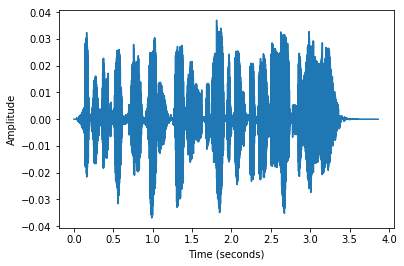

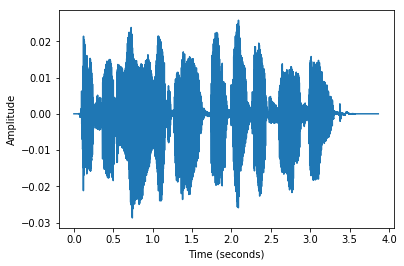

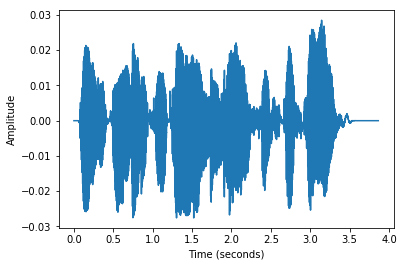

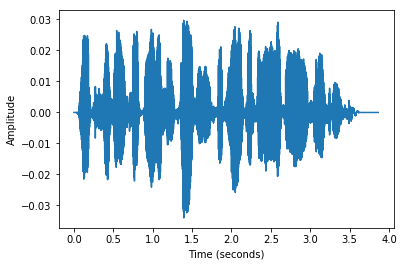

In [72]:
for row in S_2.T:
    #print(1)
    show_audio((samp_rate, row))

In [ ]:
W

In [32]:
torch.mm(W,X1).mean()

tensor(1.00000e-11 *
       -5.0036)

In [430]:
W

tensor([[ 1.0785,  0.0091,  0.0199, -0.0010],
        [ 0.0079,  1.0889,  0.0203,  0.0251],
        [ 0.0069,  0.0083,  1.0920, -0.0239],
        [-0.0073,  0.0222, -0.0226,  1.0880]])

In [ ]:
np.dot(W.detach().numpy().T, K).T.shape

In [ ]:
np.dot(np.dot(W.detach().numpy(), K.T), X.detach().numpy()).T

In [ ]:
K.shape

In [ ]:
for row in Y_pred.detach().numpy():
    display(Audio(row,rate=samp_rate))

In [ ]:
class LogLoss(torch.nn.Module):
    
    def __init__(self):
        super(LogLoss,self).__init__()
        
    def forward(self,W):
        S = torch.mm(W,X)
        return (1/S.shape[0])*torch.sum(torch.log(torch.cosh(S))) + torch.log(torch.abs(torch.det(W)))

In [ ]:
class ICALearner(torch.nn.Module):
    
    def __init__(self):
        super(ICALearner,self).__init__()
        self.linear = torch.nn.Linear(4, 4)
        

In [ ]:
ica.components_

In [ ]:
m = torch.nn.Linear(20,30)

In [ ]:
input = torch.randn(128,20)

In [ ]:
input

In [ ]:
output = m(input)

In [ ]:
output.shape

In [ ]:
L = LogLoss()

In [ ]:
L(W)

In [ ]:
%pdb

In [ ]:
optimizer = torch.optim.SGD(tst, lr=0.01)

In [ ]:
L.train()

In [ ]:
optimizer.step()

In [ ]:
L.backward()

In [ ]:
tst = [W]